In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import math

# Other packages
import numpy as np
import pandas as pd
import re
import scipy as sp
import xgboost as xgb
import matplotlib.pyplot as plt
from numpy import concatenate
from pandas import DataFrame, Series, read_csv, scatter_matrix


import time
import numpy as np
import pandas as pd

import datetime
import seaborn as sns

import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.decomposition import PCA

import math


from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import LabelEncoder 
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import minmax_scale
from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import Normalizer
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score

import xgboost as xgb
from sklearn.metrics import accuracy_score


from statsmodels.tsa.arima_model import ARIMA
from pandas import DataFrame
from pandas import datetime


In [2]:

SP500_TechIndicator = read_csv('SP500_tech_Indicator.csv')
SP500_TechIndicator = SP500_TechIndicator.drop(['Unnamed: 0'], axis=1)
SP500_TechIndicator.shape
SP500_TechIndicator

,Date,Activision_Blizzard_Open,Activision_Blizzard_Close,CBS_Open,CBS_Close,CenturyLink_Open,CenturyLink_Close,ATT_Open,ATT_Close,Alphabet_Inc_Class_A_Open,...,STDEV_Wec_Energy_Group,Open_Close_Wec_Energy_Group,SMA_Xcel_Energy,upper_band_Xcel_Energy,lower_band_Xcel_Energy,DIF_Xcel_Energy,MACD_Xcel_Energy,RSI_Xcel_Energy,STDEV_Xcel_Energy,Open_Close_Xcel_Energy
0,2013-12-31,17.800,17.830,63.66,63.74,31.94,31.85,35.17,35.16,1112.24,...,NaN,0.14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.06
1,2014-01-02,17.910,18.070,63.25,63.25,31.74,31.65,35.24,34.95,1115.46,...,NaN,0.69,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.40
2,2014-01-03,17.800,18.290,63.19,63.14,31.78,31.60,35.15,34.80,1115.00,...,NaN,0.07,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,-0.02
3,2014-01-06,18.380,18.080,63.71,63.01,31.73,31.67,35.01,34.96,1113.01,...,NaN,0.20,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.21
4,2014-01-07,18.200,18.315,63.29,63.38,31.76,31.41,35.13,34.95,1125.00,...,0.384148,-0.66,NaN,NaN,NaN,NaN,NaN,8.016647,0.245825,-0.37
5,2014-01-08,18.320,18.340,63.22,62.74,31.35,31.24,34.45,34.24,1146.00,...,0.245906,0.32,NaN,NaN,NaN,NaN,NaN,7.858668,0.186199,0.05
6,2014-01-09,18.410,18.300,63.00,62.49,31.25,30.79,34.24,33.54,1143.44,...,0.247043,-0.04,NaN,NaN,NaN,NaN,NaN,9.763912,0.208207,-0.06
7,2014-01-10,18.380,18.180,62.50,62.99,31.05,31.02,33.74,33.62,1139.08,...,0.417457,-0.46,NaN,NaN,NaN,NaN,NaN,16.955821,0.321481,-0.37
8,2014-01-13,18.020,17.870,62.49,60.94,30.99,30.87,33.59,33.30,1126.47,...,0.295347,0.43,NaN,NaN,NaN,NaN,NaN,16.277004,0.216264,0.19
9,2014-01-14,17.780,17.490,61.55,60.65,30.95,30.69,33.33,33.48,1137.95,...,0.295161,0.02,NaN,NaN,NaN,NaN,NaN,17.623091,0.220386,0.17


In [3]:
Activision_Blizzard_series = SP500_TechIndicator['Activision_Blizzard_Close']
Activision_Blizzard_series_model = ARIMA(Activision_Blizzard_series, order=(5, 1, 0))
Activision_Blizzard_model_fit = Activision_Blizzard_series_model.fit(disp=0)
print(Activision_Blizzard_model_fit.summary())

                                  ARIMA Model Results                                  
Dep. Variable:     D.Activision_Blizzard_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1214.584
Method:                                css-mle   S.D. of innovations              0.760
Date:                         Sun, 17 Mar 2019   AIC                           2443.168
Time:                                 10:20:03   BIC                           2477.937
Sample:                                      1   HQIC                          2456.345
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0461      0.020      2.273      0.023       0.006   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  


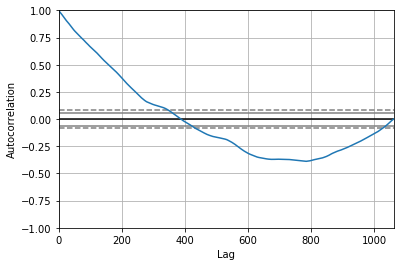

<Figure size 800x560 with 0 Axes>

In [4]:
from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Activision_Blizzard_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show() 

In [5]:
X = Activision_Blizzard_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Activision_Blizzard_predictions = list()
for t in range(len(test)):
    Activision_Blizzard_series_model = ARIMA(history, order=(5,1,0))
    Activision_Blizzard_series_model_fit = Activision_Blizzard_series_model.fit(disp=0)
    Activision_Blizzard_output = Activision_Blizzard_series_model_fit.forecast()
    yhat = Activision_Blizzard_output[0]
    Activision_Blizzard_predictions.append(yhat)
    obs = test[t]
    history.append(obs)

In [6]:
error = mean_squared_error(test, Activision_Blizzard_predictions)
print('Test MSE: %.3f' % error)

Test MSE: 1.186


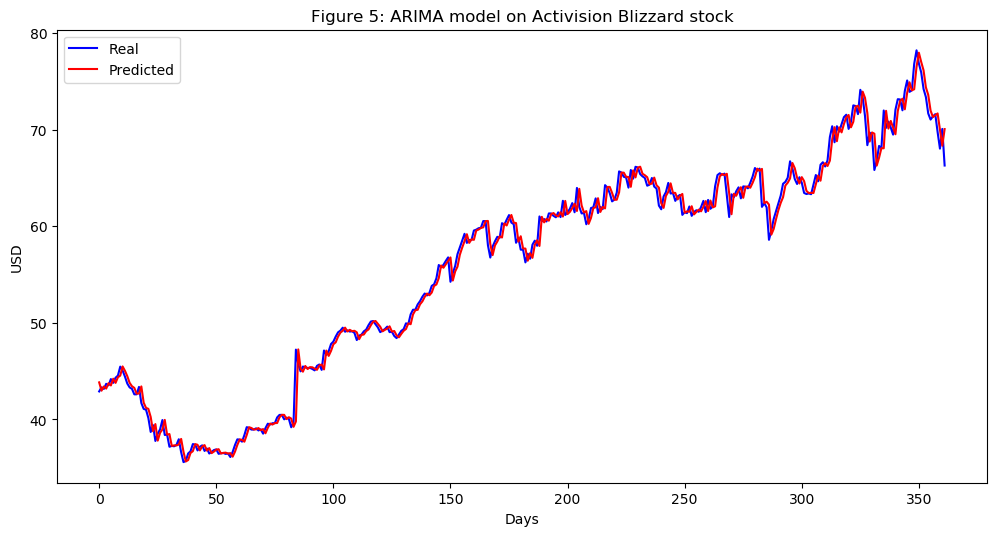

In [7]:
# Plot the predicted (from ARIMA) and real prices

plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Activision_Blizzard_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Activision Blizzard stock')
plt.legend()
plt.show()

In [8]:
#predictions

Activision_Blizzard_predictions = pd.DataFrame({'Activision_Blizzard_predictions':Activision_Blizzard_predictions})
#Activision_Blizzard_predictions.to_csv('Activision_Blizzard_predictions.csv')


In [9]:
Activision_Blizzard_predictions.to_csv('Activision_Blizzard_predictions.csv')

                                  ARIMA Model Results                                   
Dep. Variable:     D.Alphabet_Inc_Class_A_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -4709.045
Method:                                 css-mle   S.D. of innovations             20.478
Date:                          Sun, 17 Mar 2019   AIC                           9432.090
Time:                                  10:21:06   BIC                           9466.859
Sample:                                       1   HQIC                          9445.267
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                 -0.1098      0.652     -0.168      0.866    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


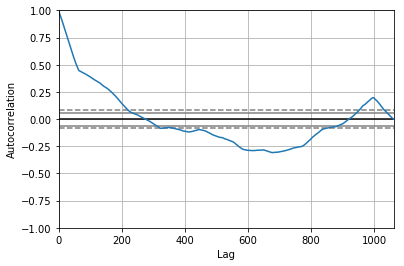

<Figure size 800x560 with 0 Axes>

Test MSE: 151.405


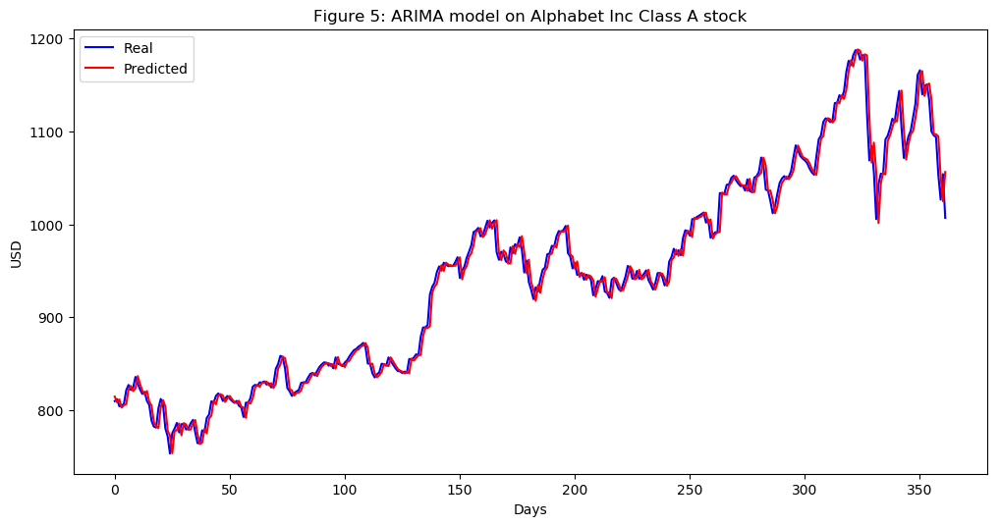

In [10]:


Alphabet_Inc_Class_A_series = SP500_TechIndicator['Alphabet_Inc_Class_A_Close']
Alphabet_Inc_Class_A_series_model = ARIMA(Alphabet_Inc_Class_A_series, order=(5, 1, 0))
Alphabet_Inc_Class_A_model_fit = Alphabet_Inc_Class_A_series_model.fit(disp=0)
print(Alphabet_Inc_Class_A_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Alphabet_Inc_Class_A_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Alphabet_Inc_Class_A_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Alphabet_Inc_Class_A_predictions = list()
for t in range(len(test)):
    Alphabet_Inc_Class_A_series_model = ARIMA(history, order=(5,1,0))
    Alphabet_Inc_Class_A_series_model_fit = Alphabet_Inc_Class_A_series_model.fit(disp=0)
    Alphabet_Inc_Class_A_output = Alphabet_Inc_Class_A_series_model_fit.forecast()
    yhat = Alphabet_Inc_Class_A_output[0]
    Alphabet_Inc_Class_A_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Alphabet_Inc_Class_A_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Alphabet_Inc_Class_A_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
Alphabet_Inc_Class_A_predictions = pd.DataFrame({'Alphabet_Inc_Class_A_predictions':Alphabet_Inc_Class_A_predictions})
#Alphabet_Inc_Class_A_predictions.to_csv('Alphabet_Inc_Class_A_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:            D.ATT_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -457.241
Method:                       css-mle   S.D. of innovations              0.372
Date:                Sun, 17 Mar 2019   AIC                            928.482
Time:                        10:22:27   BIC                            963.251
Sample:                             1   HQIC                           941.658
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                -0.0003      0.012     -0.022      0.982      -0.023       0.023
ar.L1.D.ATT_Close     0.0529      0.031      1.722      0.085      -0.007       0.113
ar.L2.D.ATT_Close    -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


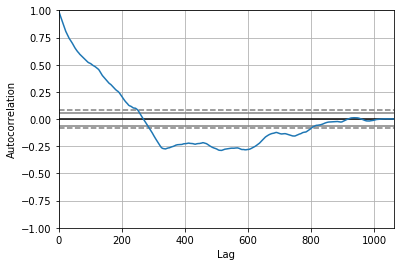

<Figure size 800x560 with 0 Axes>

Test MSE: 0.196


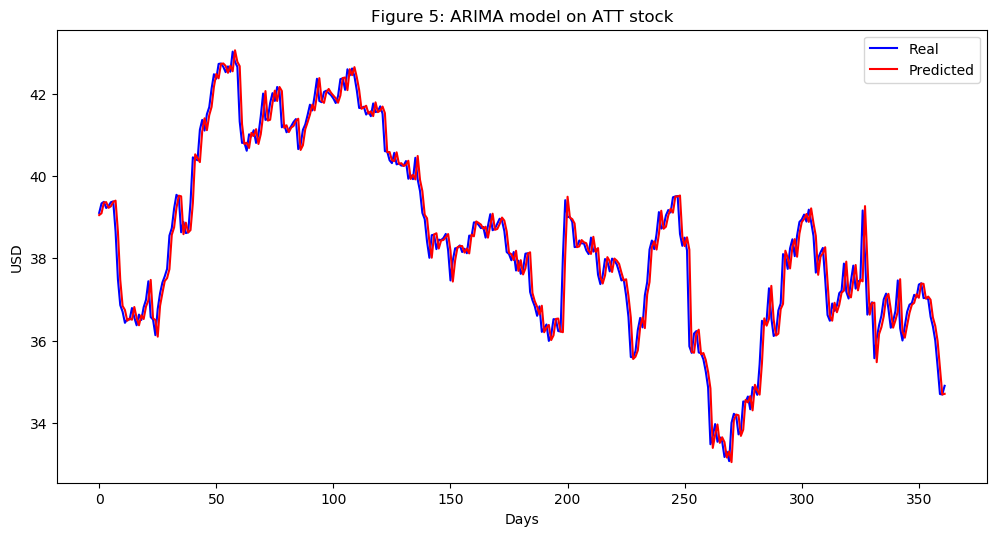

In [11]:
ATT_series = SP500_TechIndicator['ATT_Close']
ATT_series_model = ARIMA(ATT_series, order=(5, 1, 0))
ATT_model_fit = ATT_series_model.fit(disp=0)
print(ATT_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(ATT_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = ATT_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
ATT_predictions = list()
for t in range(len(test)):
    ATT_series_model = ARIMA(history, order=(5,1,0))
    ATT_series_model_fit = ATT_series_model.fit(disp=0)
    ATT_output = ATT_series_model_fit.forecast()
    yhat = ATT_output[0]
    ATT_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, ATT_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(ATT_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on ATT stock')
plt.legend()
plt.show()


#predictions
ATT_predictions = pd.DataFrame({'ATT_predictions':ATT_predictions})
#ATT_predictions.to_csv('ATT_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:            D.CBS_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1317.426
Method:                       css-mle   S.D. of innovations              0.838
Date:                Sun, 17 Mar 2019   AIC                           2648.852
Time:                        10:23:46   BIC                           2683.621
Sample:                             1   HQIC                          2662.028
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                -0.0108      0.024     -0.449      0.653      -0.058       0.036
ar.L1.D.CBS_Close    -0.0353      0.031     -1.149      0.251      -0.095       0.025
ar.L2.D.CBS_Close    -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


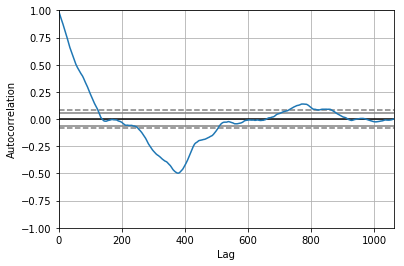

<Figure size 800x560 with 0 Axes>

Test MSE: 0.745


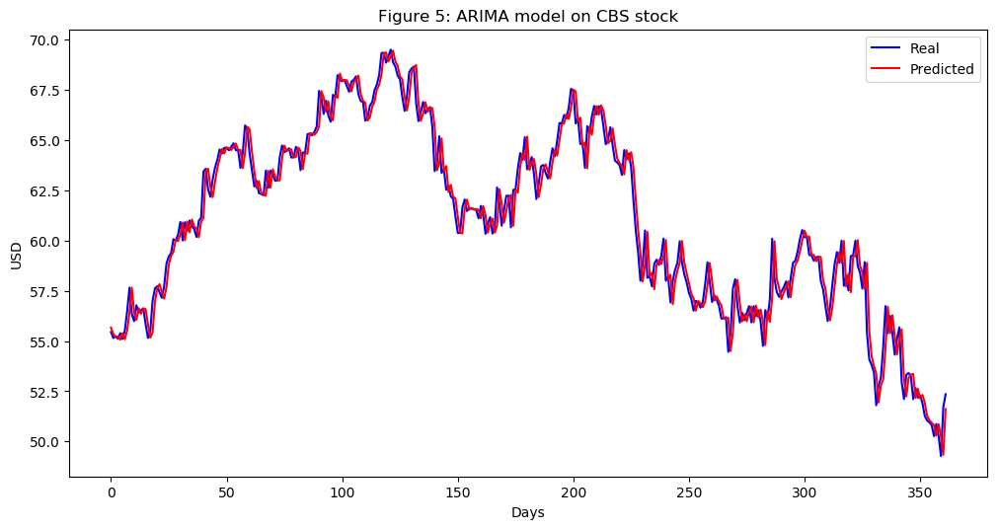

In [12]:


CBS_series = SP500_TechIndicator['CBS_Close']
CBS_series_model = ARIMA(CBS_series, order=(5, 1, 0))
CBS_model_fit = CBS_series_model.fit(disp=0)
print(CBS_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(CBS_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = CBS_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
CBS_predictions = list()
for t in range(len(test)):
    CBS_series_model = ARIMA(history, order=(5,1,0))
    CBS_series_model_fit = CBS_series_model.fit(disp=0)
    CBS_output = CBS_series_model_fit.forecast()
    yhat = CBS_output[0]
    CBS_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, CBS_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(CBS_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on CBS stock')
plt.legend()
plt.show()


#predictions
CBS_predictions = pd.DataFrame({'CBS_predictions':CBS_predictions})
#CBS_predictions.to_csv('CBS_predictions.csv')



                              ARIMA Model Results                              
Dep. Variable:     D.CenturyLink_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood                -749.880
Method:                        css-mle   S.D. of innovations              0.491
Date:                 Sun, 17 Mar 2019   AIC                           1513.761
Time:                         10:24:35   BIC                           1548.530
Sample:                              1   HQIC                          1526.937
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                        -0.0148      0.015     -1.022      0.307      -0.043       0.014
ar.L1.D.CenturyLink_Close     0.0421      0.031      1.371      0.171      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


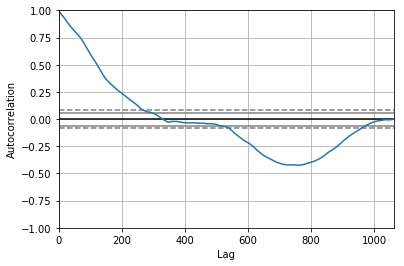

<Figure size 800x560 with 0 Axes>

Test MSE: 0.257


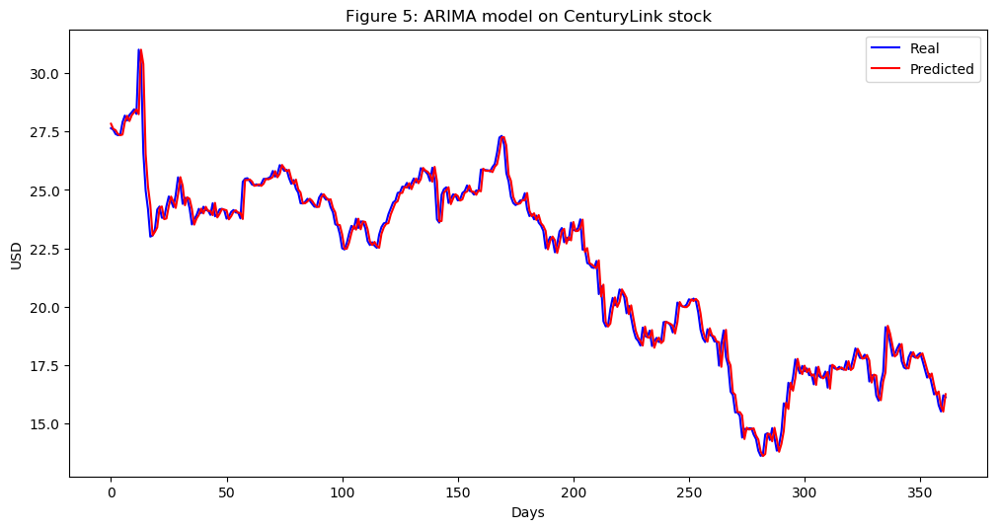

In [13]:


CenturyLink_series = SP500_TechIndicator['CenturyLink_Close']
CenturyLink_series_model = ARIMA(CenturyLink_series, order=(5, 1, 0))
CenturyLink_model_fit = CenturyLink_series_model.fit(disp=0)
print(CenturyLink_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(CenturyLink_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = CenturyLink_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
CenturyLink_predictions = list()
for t in range(len(test)):
    CenturyLink_series_model = ARIMA(history, order=(5,1,0))
    CenturyLink_series_model_fit = CenturyLink_series_model.fit(disp=0)
    CenturyLink_output = CenturyLink_series_model_fit.forecast()
    yhat = CenturyLink_output[0]
    CenturyLink_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, CenturyLink_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(CenturyLink_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on CenturyLink stock')
plt.legend()
plt.show()


#predictions
CenturyLink_predictions = pd.DataFrame({'CenturyLink_predictions':CenturyLink_predictions})
#CenturyLink_predictions.to_csv('CenturyLink_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Comcast_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1800.984
Method:                       css-mle   S.D. of innovations              1.321
Date:                Sun, 17 Mar 2019   AIC                           3615.967
Time:                        10:25:54   BIC                           3650.736
Sample:                             1   HQIC                          3629.144
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.0179      0.040     -0.446      0.656      -0.096       0.061
ar.L1.D.Comcast_Close     0.0117      0.031      0.380      0.704      -0.048       0.072
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


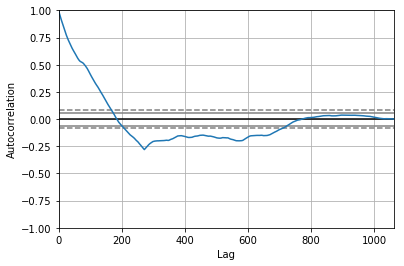

<Figure size 800x560 with 0 Axes>

Test MSE: 4.315


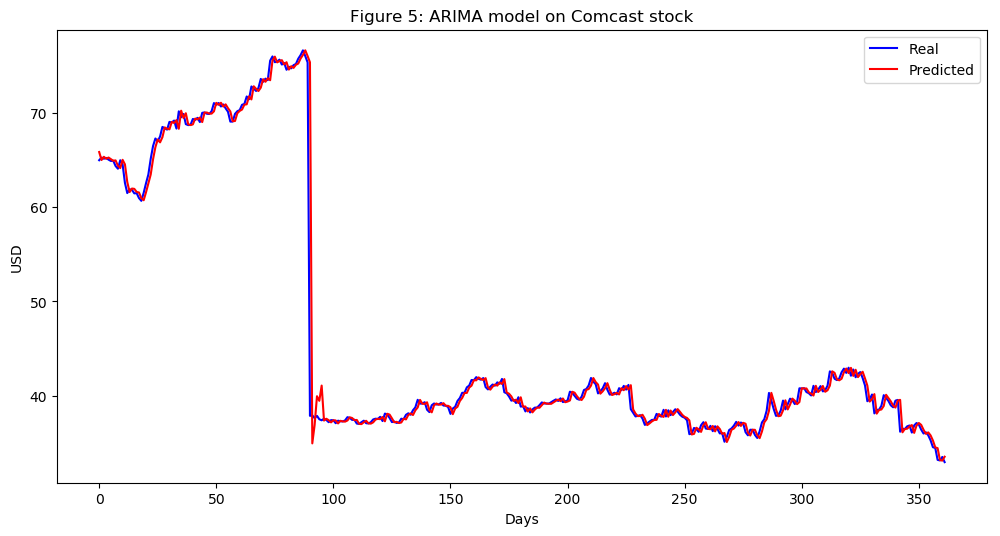

In [14]:


Comcast_series = SP500_TechIndicator['Comcast_Close']
Comcast_series_model = ARIMA(Comcast_series, order=(5, 1, 0))
Comcast_model_fit = Comcast_series_model.fit(disp=0)
print(Comcast_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Comcast_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Comcast_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Comcast_predictions = list()
for t in range(len(test)):
    Comcast_series_model = ARIMA(history, order=(5,1,0))
    Comcast_series_model_fit = Comcast_series_model.fit(disp=0)
    Comcast_output = Comcast_series_model_fit.forecast()
    yhat = Comcast_output[0]
    Comcast_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Comcast_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Comcast_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Comcast stock')
plt.legend()
plt.show()


#predictions
Comcast_predictions = pd.DataFrame({'Comcast_predictions':Comcast_predictions})
#Comcast_predictions.to_csv('Comcast_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Discovery_Class_A_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -1899.330
Method:                              css-mle   S.D. of innovations              1.449
Date:                       Sun, 17 Mar 2019   AIC                           3812.661
Time:                               10:26:51   BIC                           3847.430
Sample:                                    1   HQIC                          3825.837
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                              -0.0646      0.043     -1.498      0.134      -0.149       0.020
ar.L1.D.Disc

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


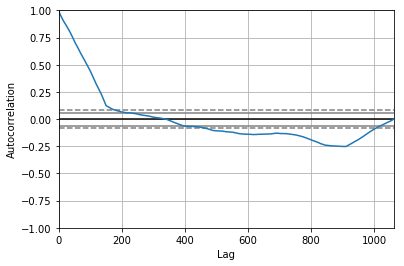

<Figure size 800x560 with 0 Axes>

Test MSE: 0.219


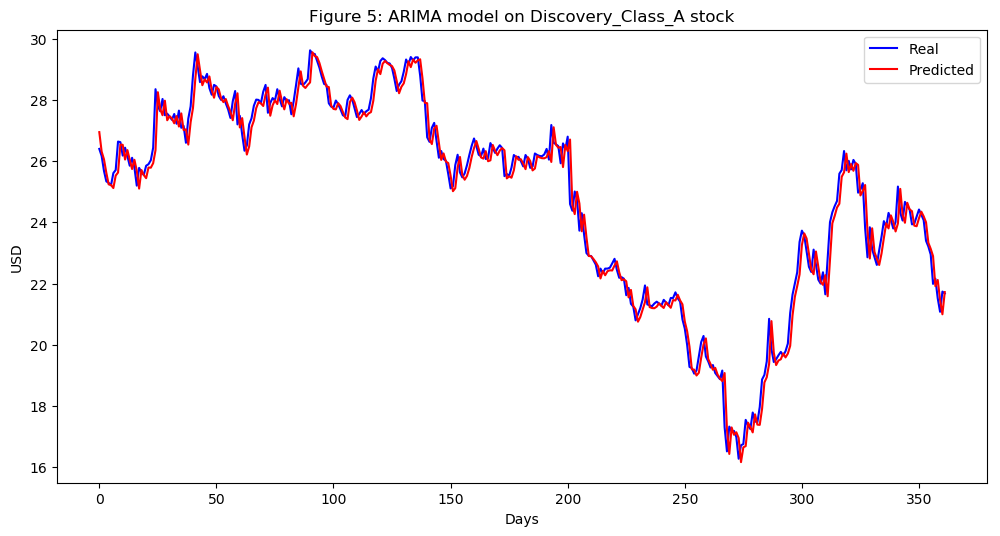

In [15]:


Discovery_Class_A_series = SP500_TechIndicator['Discovery_Class_A_Close']
Discovery_Class_A_series_model = ARIMA(Discovery_Class_A_series, order=(5, 1, 0))
Discovery_Class_A_model_fit = Discovery_Class_A_series_model.fit(disp=0)
print(Discovery_Class_A_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Discovery_Class_A_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Discovery_Class_A_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Discovery_Class_A_predictions = list()
for t in range(len(test)):
    Discovery_Class_A_series_model = ARIMA(history, order=(5,1,0))
    Discovery_Class_A_series_model_fit = Discovery_Class_A_series_model.fit(disp=0)
    Discovery_Class_A_output = Discovery_Class_A_series_model_fit.forecast()
    yhat = Discovery_Class_A_output[0]
    Discovery_Class_A_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Discovery_Class_A_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Discovery_Class_A_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Discovery_Class_A stock')
plt.legend()
plt.show()


#predictions
Discovery_Class_A_predictions = pd.DataFrame({'Discovery_Class_A_predictions':Discovery_Class_A_predictions})
#Discovery_Class_A_predictions.to_csv('Discovery_Class_A_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Discovery_Class_C_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -1872.278
Method:                              css-mle   S.D. of innovations              1.413
Date:                       Sun, 17 Mar 2019   AIC                           3758.556
Time:                               10:27:53   BIC                           3793.325
Sample:                                    1   HQIC                          3771.733
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                              -0.0604      0.044     -1.368      0.172      -0.147       0.026
ar.L1.D.Disc

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


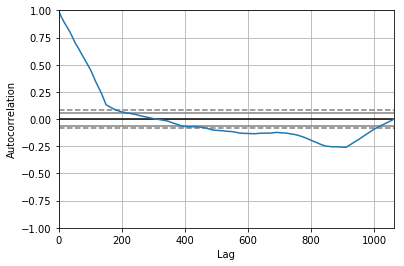

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.193


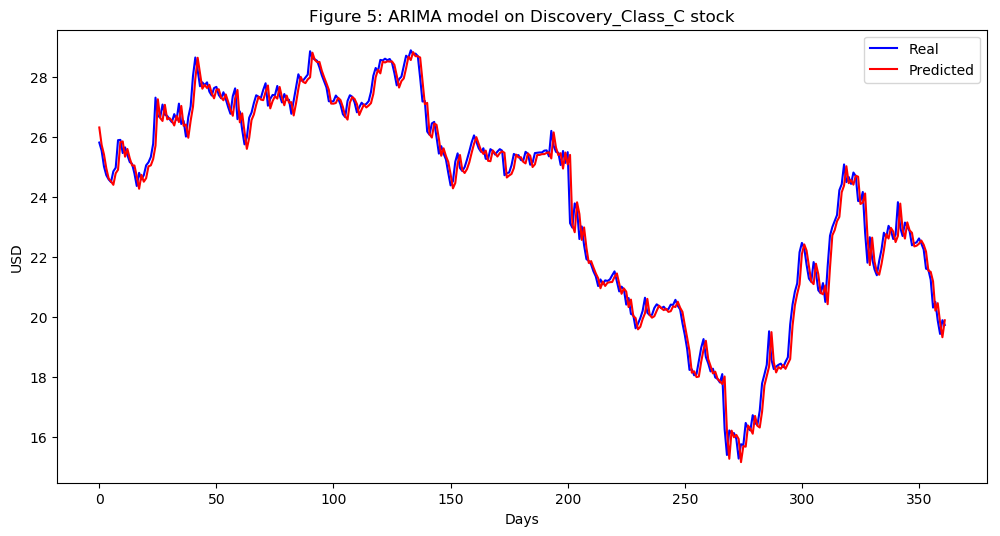

In [16]:


Discovery_Class_C_series = SP500_TechIndicator['Discovery_Class_C_Close']
Discovery_Class_C_series_model = ARIMA(Discovery_Class_C_series, order=(5, 1, 0))
Discovery_Class_C_model_fit = Discovery_Class_C_series_model.fit(disp=0)
print(Discovery_Class_C_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Discovery_Class_C_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Discovery_Class_C_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Discovery_Class_C_predictions = list()
for t in range(len(test)):
    Discovery_Class_C_series_model = ARIMA(history, order=(5,1,0))
    Discovery_Class_C_series_model_fit = Discovery_Class_C_series_model.fit(disp=0)
    Discovery_Class_C_output = Discovery_Class_C_series_model_fit.forecast()
    yhat = Discovery_Class_C_output[0]
    Discovery_Class_C_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Discovery_Class_C_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Discovery_Class_C_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Discovery_Class_C stock')
plt.legend()
plt.show()


#predictions
Discovery_Class_C_predictions = pd.DataFrame({'Discovery_Class_C_predictions':Discovery_Class_C_predictions})
#Discovery_Class_C_predictions.to_csv('Discovery_Class_C_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:           D.Dish_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1511.512
Method:                       css-mle   S.D. of innovations              1.006
Date:                Sun, 17 Mar 2019   AIC                           3037.024
Time:                        10:28:50   BIC                           3071.793
Sample:                             1   HQIC                          3050.201
                                                                              
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0194      0.030     -0.659      0.510      -0.077       0.038
ar.L1.D.Dish_Close     0.0226      0.031      0.736      0.462      -0.038       0.083
ar.L2.D.Dish_Close  

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


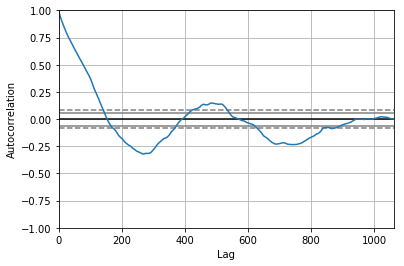

<Figure size 800x560 with 0 Axes>

Test MSE: 0.867


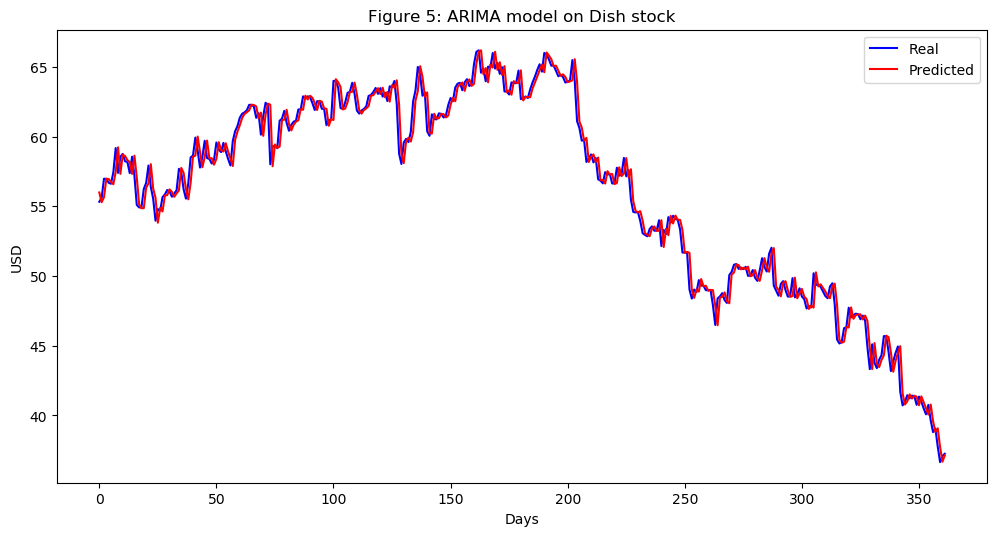

In [17]:


Dish_series = SP500_TechIndicator['Dish_Close']
Dish_series_model = ARIMA(Dish_series, order=(5, 1, 0))
Dish_model_fit = Dish_series_model.fit(disp=0)
print(Dish_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Dish_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Dish_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Dish_predictions = list()
for t in range(len(test)):
    Dish_series_model = ARIMA(history, order=(5,1,0))
    Dish_series_model_fit = Dish_series_model.fit(disp=0)
    Dish_output = Dish_series_model_fit.forecast()
    yhat = Dish_output[0]
    Dish_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Dish_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Dish_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Dish stock')
plt.legend()
plt.show()


#predictions
Dish_predictions = pd.DataFrame({'Dish_predictions':Dish_predictions})
#Dish_predictions.to_csv('Dish_predictions.csv')




                                ARIMA Model Results                                
Dep. Variable:     D.Electronic_Arts_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1819.485
Method:                            css-mle   S.D. of innovations              1.344
Date:                     Sun, 17 Mar 2019   AIC                           3652.970
Time:                             10:29:52   BIC                           3687.739
Sample:                                  1   HQIC                          3666.146
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0925      0.034      2.734      0.006       0.026       0.159
ar.L1.D.Electronic_Arts_Close    -

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


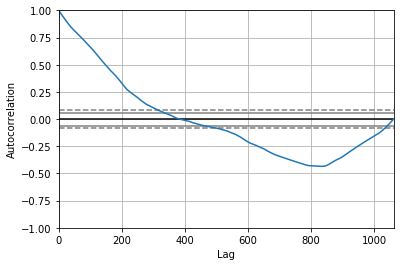

<Figure size 800x560 with 0 Axes>

Test MSE: 3.062


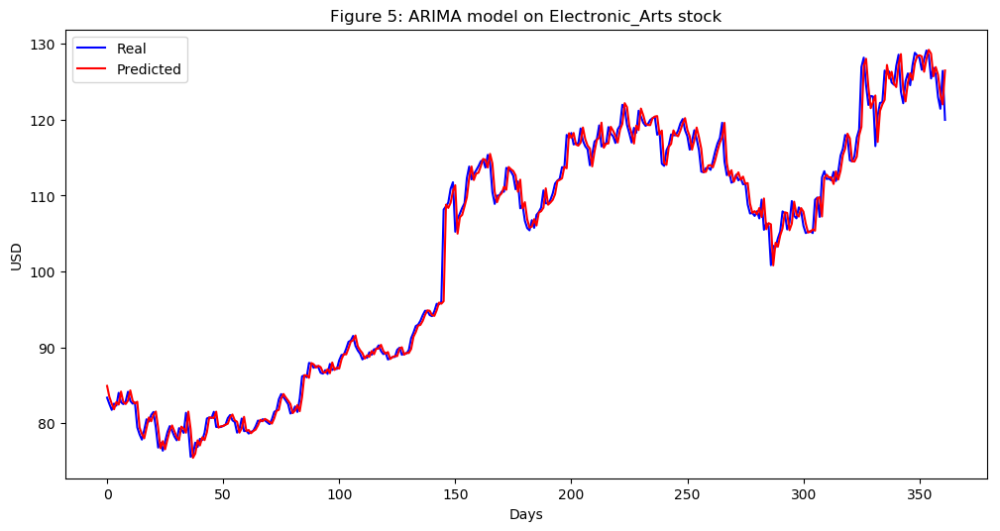

In [18]:


Electronic_Arts_series = SP500_TechIndicator['Electronic_Arts_Close']
Electronic_Arts_series_model = ARIMA(Electronic_Arts_series, order=(5, 1, 0))
Electronic_Arts_model_fit = Electronic_Arts_series_model.fit(disp=0)
print(Electronic_Arts_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Electronic_Arts_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Electronic_Arts_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Electronic_Arts_predictions = list()
for t in range(len(test)):
    Electronic_Arts_series_model = ARIMA(history, order=(5,1,0))
    Electronic_Arts_series_model_fit = Electronic_Arts_series_model.fit(disp=0)
    Electronic_Arts_output = Electronic_Arts_series_model_fit.forecast()
    yhat = Electronic_Arts_output[0]
    Electronic_Arts_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Electronic_Arts_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Electronic_Arts_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Electronic_Arts stock')
plt.legend()
plt.show()


#predictions
Electronic_Arts_predictions = pd.DataFrame({'Electronic_Arts_predictions':Electronic_Arts_predictions})
#Electronic_Arts_predictions.to_csv('Electronic_Arts_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:       D.Facebook_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2156.909
Method:                       css-mle   S.D. of innovations              1.848
Date:                Sun, 17 Mar 2019   AIC                           4327.817
Time:                        10:30:56   BIC                           4362.586
Sample:                             1   HQIC                          4340.994
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0933      0.050      1.850      0.065      -0.006       0.192
ar.L1.D.Facebook_Close     0.0057      0.031      0.183      0.855      -0.055       0.066
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


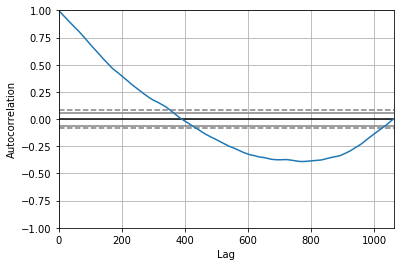

<Figure size 800x560 with 0 Axes>

Test MSE: 5.195


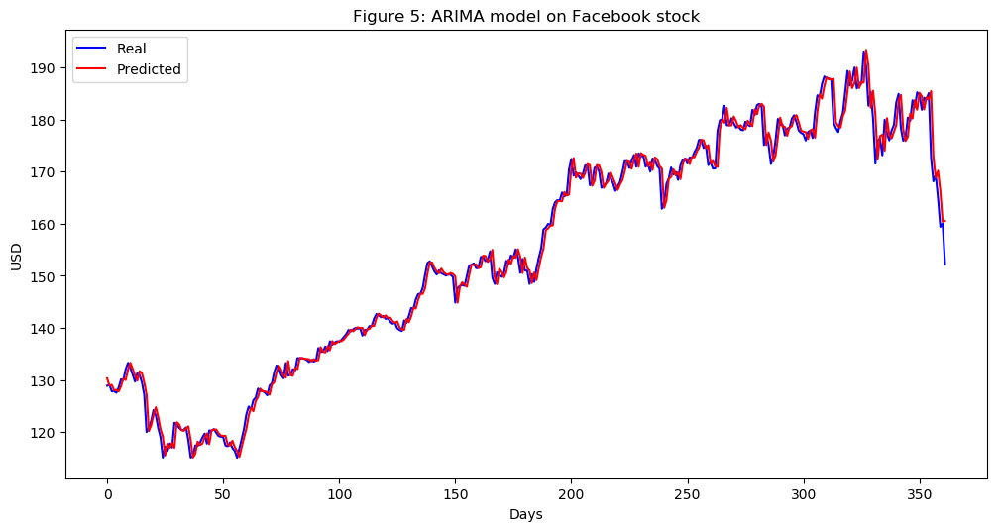

In [19]:


Facebook_series = SP500_TechIndicator['Facebook_Close']
Facebook_series_model = ARIMA(Facebook_series, order=(5, 1, 0))
Facebook_model_fit = Facebook_series_model.fit(disp=0)
print(Facebook_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Facebook_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Facebook_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Facebook_predictions = list()
for t in range(len(test)):
    Facebook_series_model = ARIMA(history, order=(5,1,0))
    Facebook_series_model_fit = Facebook_series_model.fit(disp=0)
    Facebook_output = Facebook_series_model_fit.forecast()
    yhat = Facebook_output[0]
    Facebook_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Facebook_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Facebook_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Facebook stock')
plt.legend()
plt.show()


#predictions
Facebook_predictions = pd.DataFrame({'Facebook_predictions':Facebook_predictions})
#Facebook_predictions.to_csv('Facebook_predictions.csv')




                                 ARIMA Model Results                                 
Dep. Variable:     D.Interpublic_Group_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood                -291.364
Method:                              css-mle   S.D. of innovations              0.318
Date:                       Sun, 17 Mar 2019   AIC                            596.728
Time:                               10:31:56   BIC                            631.496
Sample:                                    1   HQIC                           609.904
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0047      0.009      0.525      0.600      -0.013       0.022
ar.L1.D.Inte

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


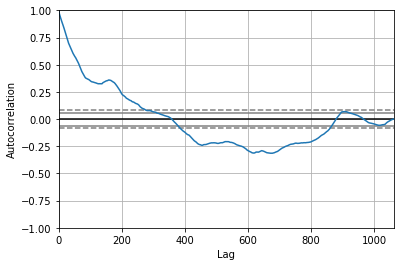

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.150


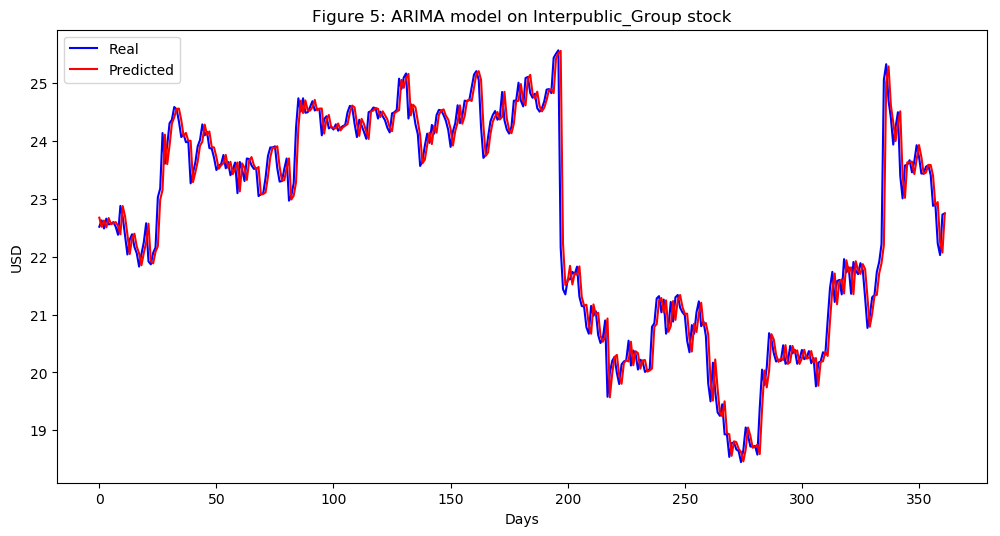

In [20]:


Interpublic_Group_series = SP500_TechIndicator['Interpublic_Group_Close']
Interpublic_Group_series_model = ARIMA(Interpublic_Group_series, order=(5, 1, 0))
Interpublic_Group_model_fit = Interpublic_Group_series_model.fit(disp=0)
print(Interpublic_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Interpublic_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Interpublic_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Interpublic_Group_predictions = list()
for t in range(len(test)):
    Interpublic_Group_series_model = ARIMA(history, order=(5,1,0))
    Interpublic_Group_series_model_fit = Interpublic_Group_series_model.fit(disp=0)
    Interpublic_Group_output = Interpublic_Group_series_model_fit.forecast()
    yhat = Interpublic_Group_output[0]
    Interpublic_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Interpublic_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Interpublic_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Interpublic_Group stock')
plt.legend()
plt.show()


#predictions
Interpublic_Group_predictions = pd.DataFrame({'Interpublic_Group_predictions':Interpublic_Group_predictions})
#Interpublic_Group_predictions.to_csv('Interpublic_Group_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:        D.Netflix_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -4683.258
Method:                       css-mle   S.D. of innovations             19.987
Date:                Sun, 17 Mar 2019   AIC                           9380.517
Time:                        10:33:15   BIC                           9415.286
Sample:                             1   HQIC                          9393.693
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.0628      0.581     -0.108      0.914      -1.201       1.075
ar.L1.D.Netflix_Close    -0.0068      0.031     -0.223      0.824      -0.067       0.053
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


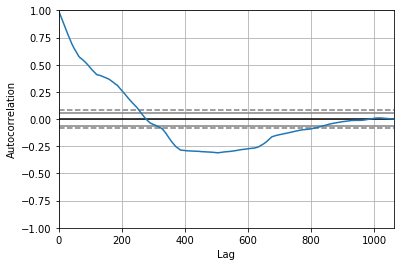

<Figure size 800x560 with 0 Axes>

Test MSE: 19.413


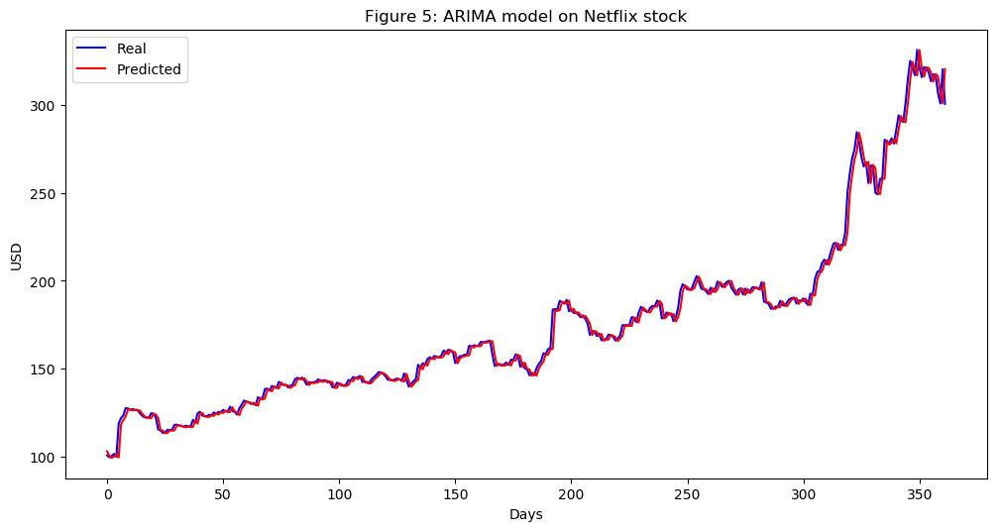

In [21]:


Netflix_series = SP500_TechIndicator['Netflix_Close']
Netflix_series_model = ARIMA(Netflix_series, order=(5, 1, 0))
Netflix_model_fit = Netflix_series_model.fit(disp=0)
print(Netflix_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Netflix_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Netflix_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Netflix_predictions = list()
for t in range(len(test)):
    Netflix_series_model = ARIMA(history, order=(5,1,0))
    Netflix_series_model_fit = Netflix_series_model.fit(disp=0)
    Netflix_output = Netflix_series_model_fit.forecast()
    yhat = Netflix_output[0]
    Netflix_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Netflix_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Netflix_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Netflix stock')
plt.legend()
plt.show()


#predictions
Netflix_predictions = pd.DataFrame({'Netflix_predictions':Netflix_predictions})
#Netflix_predictions.to_csv('Netflix_predictions.csv')




                                 ARIMA Model Results                                 
Dep. Variable:     D.News_Corp_Class_A_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood                 112.189
Method:                              css-mle   S.D. of innovations              0.218
Date:                       Sun, 17 Mar 2019   AIC                           -210.377
Time:                               10:34:46   BIC                           -175.609
Sample:                                    1   HQIC                          -197.201
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                              -0.0023      0.007     -0.341      0.733      -0.016       0.011
ar.L1.D.News

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


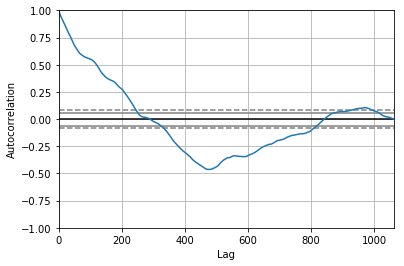

<Figure size 800x560 with 0 Axes>

Test MSE: 0.035


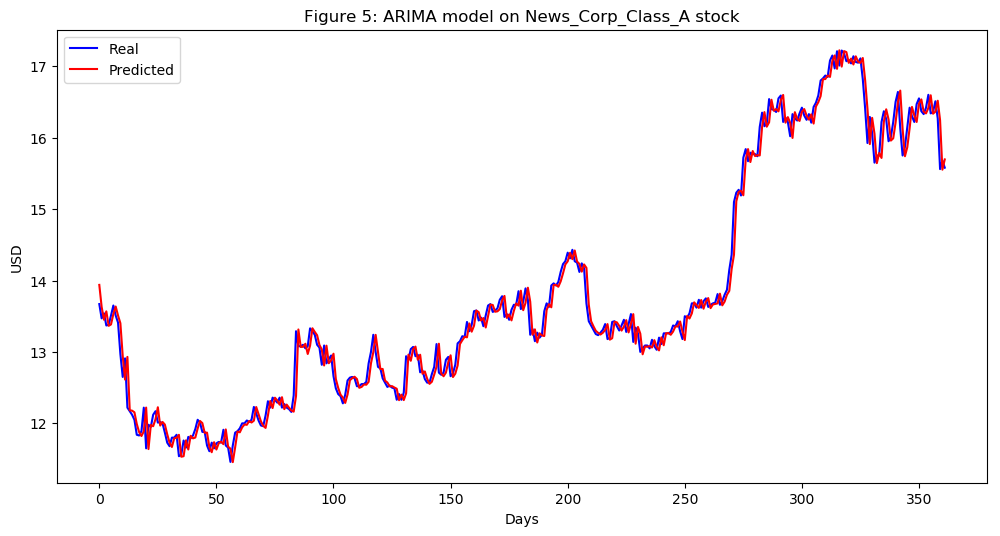

In [22]:


News_Corp_Class_A_series = SP500_TechIndicator['News_Corp_Class_A_Close']
News_Corp_Class_A_series_model = ARIMA(News_Corp_Class_A_series, order=(5, 1, 0))
News_Corp_Class_A_model_fit = News_Corp_Class_A_series_model.fit(disp=0)
print(News_Corp_Class_A_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(News_Corp_Class_A_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = News_Corp_Class_A_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
News_Corp_Class_A_predictions = list()
for t in range(len(test)):
    News_Corp_Class_A_series_model = ARIMA(history, order=(5,1,0))
    News_Corp_Class_A_series_model_fit = News_Corp_Class_A_series_model.fit(disp=0)
    News_Corp_Class_A_output = News_Corp_Class_A_series_model_fit.forecast()
    yhat = News_Corp_Class_A_output[0]
    News_Corp_Class_A_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, News_Corp_Class_A_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(News_Corp_Class_A_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on News_Corp_Class_A stock')
plt.legend()
plt.show()


#predictions
News_Corp_Class_A_predictions = pd.DataFrame({'News_Corp_Class_A_predictions':News_Corp_Class_A_predictions})
#News_Corp_Class_A_predictions.to_csv('News_Corp_Class_A_predictions.csv')




                                 ARIMA Model Results                                 
Dep. Variable:     D.News_Corp_Class_B_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood                 133.159
Method:                              css-mle   S.D. of innovations              0.213
Date:                       Sun, 17 Mar 2019   AIC                           -252.317
Time:                               10:36:02   BIC                           -217.548
Sample:                                    1   HQIC                          -239.141
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                              -0.0018      0.007     -0.268      0.789      -0.015       0.011
ar.L1.D.News

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


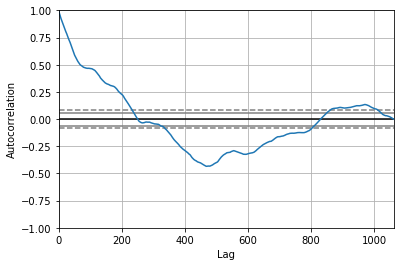

<Figure size 800x560 with 0 Axes>

Test MSE: 0.036


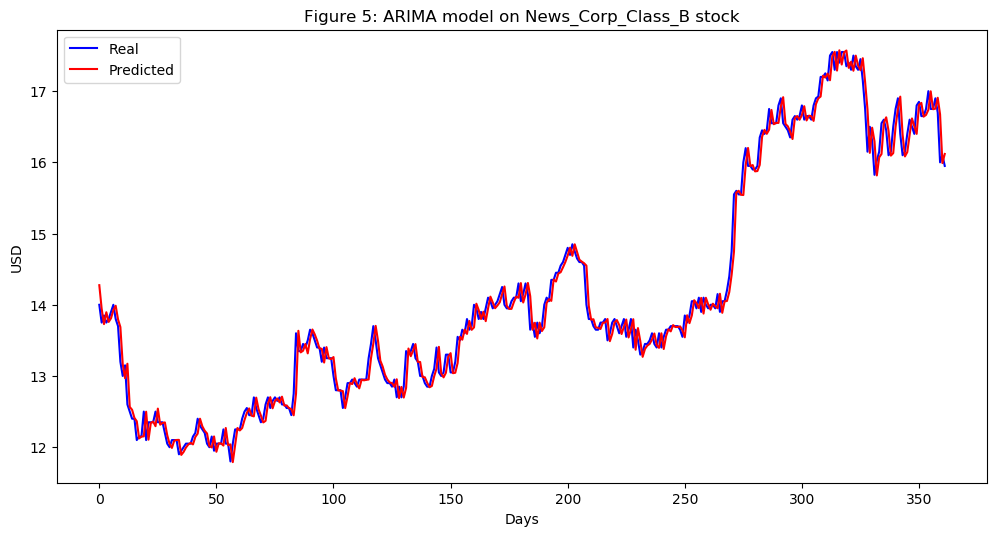

In [23]:


News_Corp_Class_B_series = SP500_TechIndicator['News_Corp_Class_B_Close']
News_Corp_Class_B_series_model = ARIMA(News_Corp_Class_B_series, order=(5, 1, 0))
News_Corp_Class_B_model_fit = News_Corp_Class_B_series_model.fit(disp=0)
print(News_Corp_Class_B_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(News_Corp_Class_B_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = News_Corp_Class_B_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
News_Corp_Class_B_predictions = list()
for t in range(len(test)):
    News_Corp_Class_B_series_model = ARIMA(history, order=(5,1,0))
    News_Corp_Class_B_series_model_fit = News_Corp_Class_B_series_model.fit(disp=0)
    News_Corp_Class_B_output = News_Corp_Class_B_series_model_fit.forecast()
    yhat = News_Corp_Class_B_output[0]
    News_Corp_Class_B_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, News_Corp_Class_B_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(News_Corp_Class_B_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on News_Corp_Class_B stock')
plt.legend()
plt.show()


#predictions
News_Corp_Class_B_predictions = pd.DataFrame({'News_Corp_Class_B_predictions':News_Corp_Class_B_predictions})
#News_Corp_Class_B_predictions.to_csv('News_Corp_Class_B_predictions.csv')




                               ARIMA Model Results                               
Dep. Variable:     D.Omnicom_Group_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -1350.963
Method:                          css-mle   S.D. of innovations              0.864
Date:                   Sun, 17 Mar 2019   AIC                           2715.926
Time:                           10:37:24   BIC                           2750.695
Sample:                                1   HQIC                          2729.103
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          -0.0017      0.025     -0.068      0.946      -0.050       0.046
ar.L1.D.Omnicom_Group_Close    -0.0671      0.031     -2

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


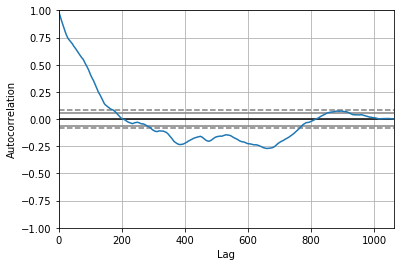

<Figure size 800x560 with 0 Axes>

Test MSE: 0.854


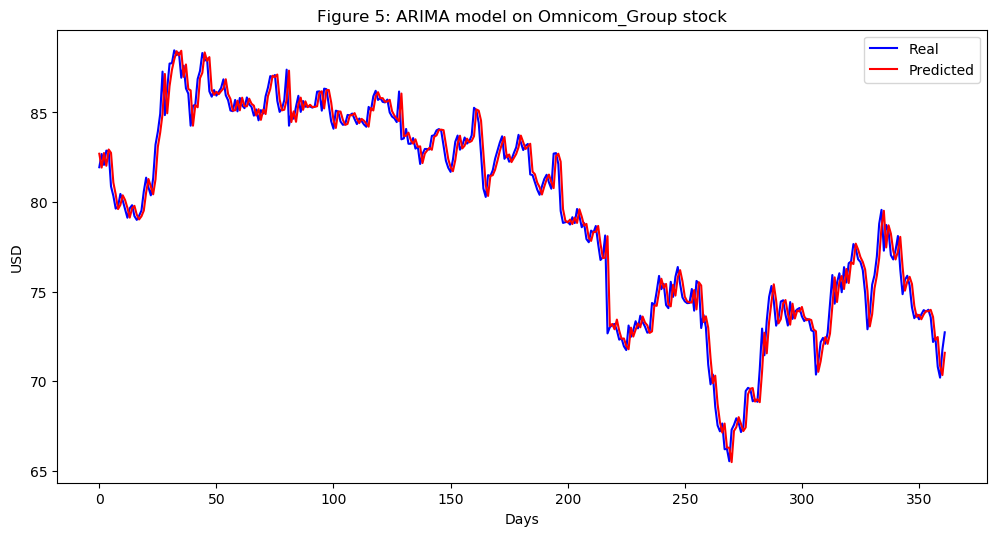

In [24]:


Omnicom_Group_series = SP500_TechIndicator['Omnicom_Group_Close']
Omnicom_Group_series_model = ARIMA(Omnicom_Group_series, order=(5, 1, 0))
Omnicom_Group_model_fit = Omnicom_Group_series_model.fit(disp=0)
print(Omnicom_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Omnicom_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Omnicom_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Omnicom_Group_predictions = list()
for t in range(len(test)):
    Omnicom_Group_series_model = ARIMA(history, order=(5,1,0))
    Omnicom_Group_series_model_fit = Omnicom_Group_series_model.fit(disp=0)
    Omnicom_Group_output = Omnicom_Group_series_model_fit.forecast()
    yhat = Omnicom_Group_output[0]
    Omnicom_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Omnicom_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Omnicom_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Omnicom_Group stock')
plt.legend()
plt.show()


#predictions
Omnicom_Group_predictions = pd.DataFrame({'Omnicom_Group_predictions':Omnicom_Group_predictions})
#Omnicom_Group_predictions.to_csv('Omnicom_Group_predictions.csv')




                                  ARIMA Model Results                                   
Dep. Variable:     D.Take_Two_Interactive_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -1668.853
Method:                                 css-mle   S.D. of innovations              1.166
Date:                          Sun, 17 Mar 2019   AIC                           3351.707
Time:                                  10:38:33   BIC                           3386.475
Sample:                                       1   HQIC                          3364.883
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0765      0.032      2.384      0.017    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


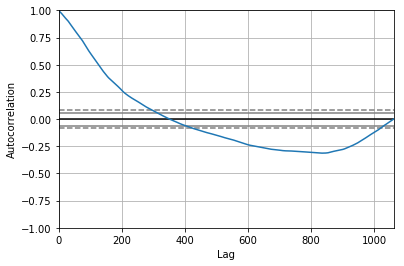

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 3.505


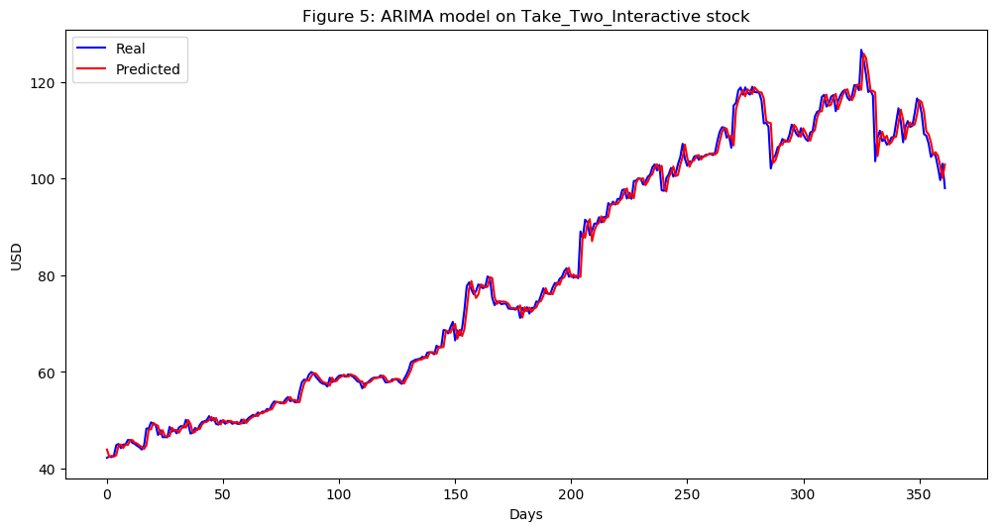

In [25]:


Take_Two_Interactive_series = SP500_TechIndicator['Take_Two_Interactive_Close']
Take_Two_Interactive_series_model = ARIMA(Take_Two_Interactive_series, order=(5, 1, 0))
Take_Two_Interactive_model_fit = Take_Two_Interactive_series_model.fit(disp=0)
print(Take_Two_Interactive_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Take_Two_Interactive_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Take_Two_Interactive_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Take_Two_Interactive_predictions = list()
for t in range(len(test)):
    Take_Two_Interactive_series_model = ARIMA(history, order=(5,1,0))
    Take_Two_Interactive_series_model_fit = Take_Two_Interactive_series_model.fit(disp=0)
    Take_Two_Interactive_output = Take_Two_Interactive_series_model_fit.forecast()
    yhat = Take_Two_Interactive_output[0]
    Take_Two_Interactive_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Take_Two_Interactive_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Take_Two_Interactive_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Take_Two_Interactive stock')
plt.legend()
plt.show()


#predictions
Take_Two_Interactive_predictions = pd.DataFrame({'Take_Two_Interactive_predictions':Take_Two_Interactive_predictions})
#Take_Two_Interactive_predictions.to_csv('Take_Two_Interactive_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:        D.Twitter_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1670.551
Method:                       css-mle   S.D. of innovations              1.168
Date:                Sun, 17 Mar 2019   AIC                           3355.101
Time:                        10:39:44   BIC                           3389.870
Sample:                             1   HQIC                          3368.278
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.0327      0.031     -1.056      0.291      -0.093       0.028
ar.L1.D.Twitter_Close    -0.0549      0.031     -1.777      0.076      -0.116       0.006
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


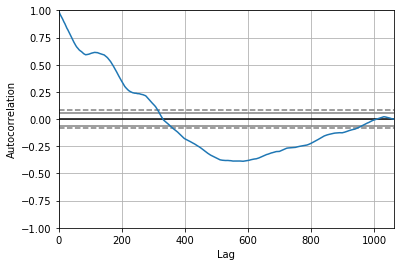

<Figure size 800x560 with 0 Axes>

Test MSE: 0.447


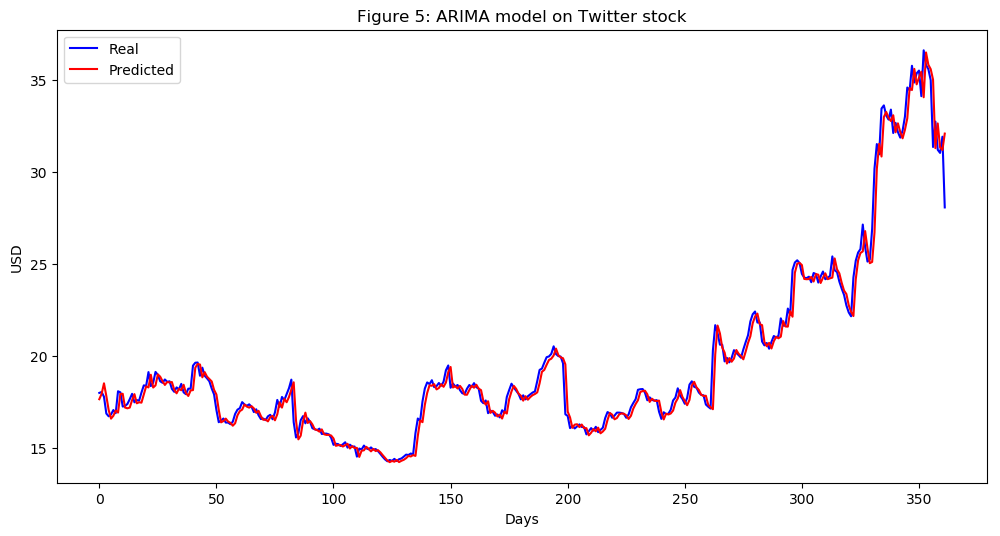

In [26]:


Twitter_series = SP500_TechIndicator['Twitter_Close']
Twitter_series_model = ARIMA(Twitter_series, order=(5, 1, 0))
Twitter_model_fit = Twitter_series_model.fit(disp=0)
print(Twitter_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Twitter_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Twitter_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Twitter_predictions = list()
for t in range(len(test)):
    Twitter_series_model = ARIMA(history, order=(5,1,0))
    Twitter_series_model_fit = Twitter_series_model.fit(disp=0)
    Twitter_output = Twitter_series_model_fit.forecast()
    yhat = Twitter_output[0]
    Twitter_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Twitter_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Twitter_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Twitter stock')
plt.legend()
plt.show()


#predictions
Twitter_predictions = pd.DataFrame({'Twitter_predictions':Twitter_predictions})
#Twitter_predictions.to_csv('Twitter_predictions.csv')




                                 ARIMA Model Results                                  
Dep. Variable:     D.Advance_Auto_Parts_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -2543.616
Method:                               css-mle   S.D. of innovations              2.660
Date:                        Sun, 17 Mar 2019   AIC                           5101.232
Time:                                10:40:52   BIC                           5136.000
Sample:                                     1   HQIC                          5114.408
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0038      0.076      0.049      0.961      -0.146       0.153
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


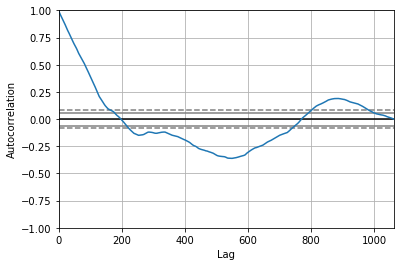

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 8.103


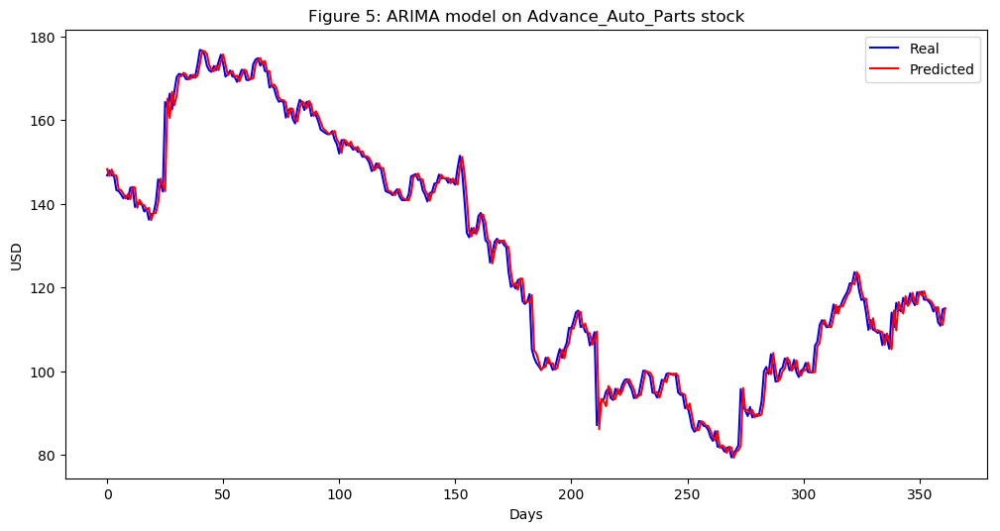

In [27]:


Advance_Auto_Parts_series = SP500_TechIndicator['Advance_Auto_Parts_Close']
Advance_Auto_Parts_series_model = ARIMA(Advance_Auto_Parts_series, order=(5, 1, 0))
Advance_Auto_Parts_model_fit = Advance_Auto_Parts_series_model.fit(disp=0)
print(Advance_Auto_Parts_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Advance_Auto_Parts_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Advance_Auto_Parts_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Advance_Auto_Parts_predictions = list()
for t in range(len(test)):
    Advance_Auto_Parts_series_model = ARIMA(history, order=(5,1,0))
    Advance_Auto_Parts_series_model_fit = Advance_Auto_Parts_series_model.fit(disp=0)
    Advance_Auto_Parts_output = Advance_Auto_Parts_series_model_fit.forecast()
    yhat = Advance_Auto_Parts_output[0]
    Advance_Auto_Parts_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Advance_Auto_Parts_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Advance_Auto_Parts_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Advance_Auto_Parts stock')
plt.legend()
plt.show()


#predictions
Advance_Auto_Parts_predictions = pd.DataFrame({'Advance_Auto_Parts_predictions':Advance_Auto_Parts_predictions})
#Advance_Auto_Parts_predictions.to_csv('Advance_Auto_Parts_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:         D.Amazon_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -4156.962
Method:                       css-mle   S.D. of innovations             12.171
Date:                Sun, 17 Mar 2019   AIC                           8327.924
Time:                        10:41:54   BIC                           8362.693
Sample:                             1   HQIC                          8341.101
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    1.0366      0.357      2.900      0.004       0.336       1.737
ar.L1.D.Amazon_Close    -0.0054      0.031     -0.173      0.863      -0.066       0.056
ar.L2.D.Amaz

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


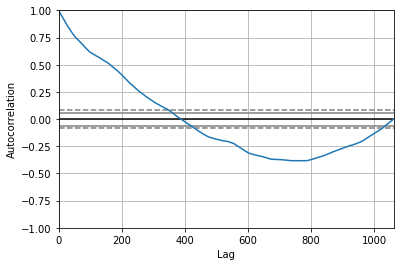

<Figure size 800x560 with 0 Axes>

Test MSE: 265.254


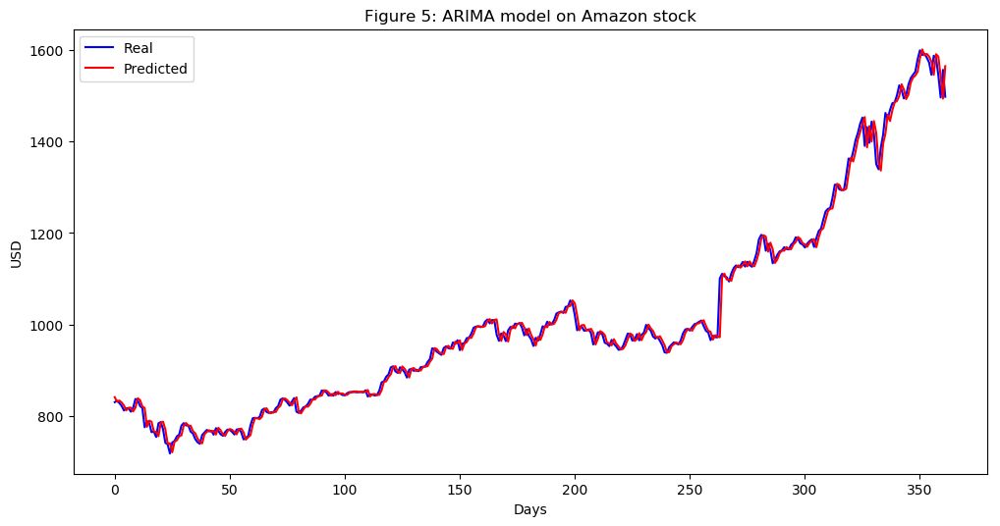

In [28]:
Amazon_series = SP500_TechIndicator['Amazon_Close']
Amazon_series_model = ARIMA(Amazon_series, order=(5, 1, 0))
Amazon_model_fit = Amazon_series_model.fit(disp=0)
print(Amazon_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Amazon_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Amazon_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Amazon_predictions = list()
for t in range(len(test)):
    Amazon_series_model = ARIMA(history, order=(5,1,0))
    Amazon_series_model_fit = Amazon_series_model.fit(disp=0)
    Amazon_output = Amazon_series_model_fit.forecast()
    yhat = Amazon_output[0]
    Amazon_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Amazon_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Amazon_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Amazon stock')
plt.legend()
plt.show()


#predictions
Amazon_predictions = pd.DataFrame({'Amazon_predictions':Amazon_predictions})
#Amazon_predictions.to_csv('Amazon_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:       D.AutoZone_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -3811.867
Method:                       css-mle   S.D. of innovations              8.791
Date:                Sun, 17 Mar 2019   AIC                           7637.734
Time:                        11:27:49   BIC                           7672.502
Sample:                             1   HQIC                          7650.910
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.1479      0.254      0.582      0.560      -0.350       0.646
ar.L1.D.AutoZone_Close    -0.0363      0.031     -1.181      0.238      -0.096       0.024
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


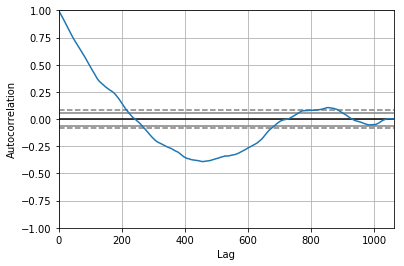

<Figure size 800x560 with 0 Axes>

Test MSE: 117.112


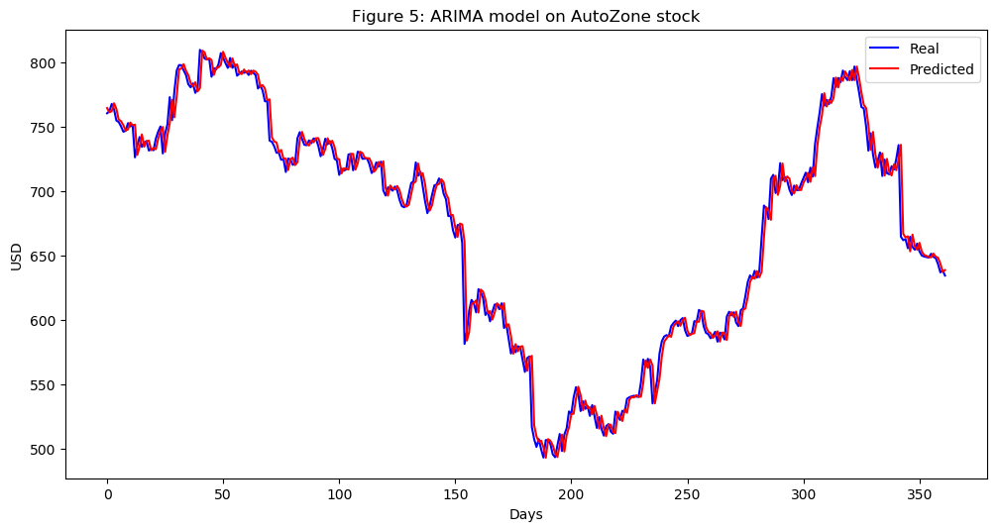

In [30]:


AutoZone_series = SP500_TechIndicator['AutoZone_Close']
AutoZone_series_model = ARIMA(AutoZone_series, order=(5, 1, 0))
AutoZone_model_fit = AutoZone_series_model.fit(disp=0)
print(AutoZone_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(AutoZone_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = AutoZone_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
AutoZone_predictions = list()
for t in range(len(test)):
    AutoZone_series_model = ARIMA(history, order=(5,1,0))
    AutoZone_series_model_fit = AutoZone_series_model.fit(disp=0)
    AutoZone_output = AutoZone_series_model_fit.forecast()
    yhat = AutoZone_output[0]
    AutoZone_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, AutoZone_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(AutoZone_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on AutoZone stock')
plt.legend()
plt.show()


#predictions
AutoZone_predictions = pd.DataFrame({'AutoZone_predictions':AutoZone_predictions})
#AutoZone_predictions.to_csv('AutoZone_predictions.csv')




                              ARIMA Model Results                              
Dep. Variable:     D.Best_Buy_Co_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -1493.949
Method:                        css-mle   S.D. of innovations              0.989
Date:                 Sun, 17 Mar 2019   AIC                           3001.898
Time:                         11:28:49   BIC                           3036.667
Sample:                              1   HQIC                          3015.075
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0264      0.029      0.918      0.359      -0.030       0.083
ar.L1.D.Best_Buy_Co_Close    -0.0527      0.031     -1.716      0.087      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


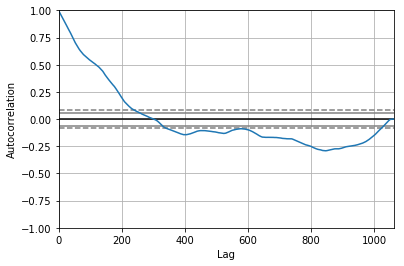

<Figure size 800x560 with 0 Axes>

Test MSE: 1.585


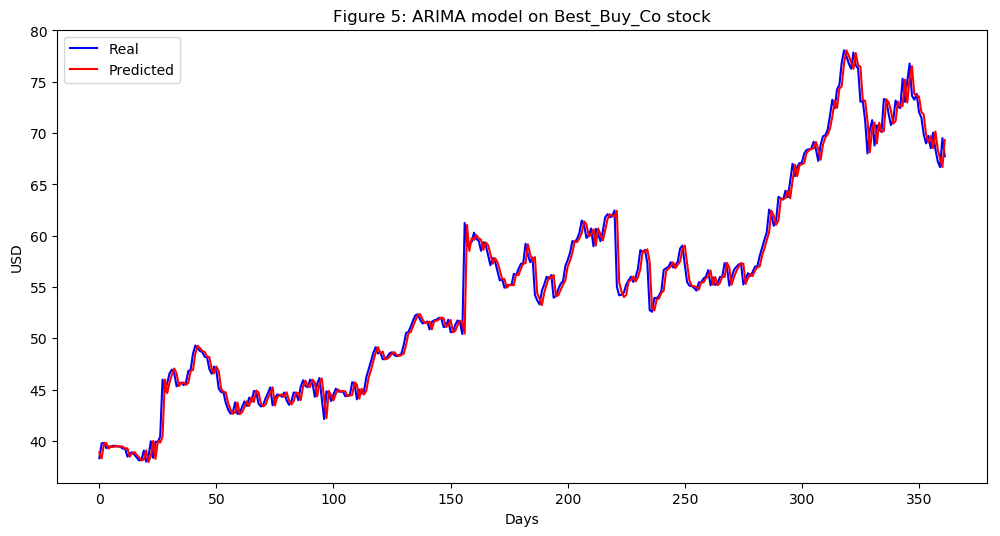

In [31]:


Best_Buy_Co_series = SP500_TechIndicator['Best_Buy_Co_Close']
Best_Buy_Co_series_model = ARIMA(Best_Buy_Co_series, order=(5, 1, 0))
Best_Buy_Co_model_fit = Best_Buy_Co_series_model.fit(disp=0)
print(Best_Buy_Co_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Best_Buy_Co_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Best_Buy_Co_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Best_Buy_Co_predictions = list()
for t in range(len(test)):
    Best_Buy_Co_series_model = ARIMA(history, order=(5,1,0))
    Best_Buy_Co_series_model_fit = Best_Buy_Co_series_model.fit(disp=0)
    Best_Buy_Co_output = Best_Buy_Co_series_model_fit.forecast()
    yhat = Best_Buy_Co_output[0]
    Best_Buy_Co_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Best_Buy_Co_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Best_Buy_Co_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Best_Buy_Co stock')
plt.legend()
plt.show()


#predictions
Best_Buy_Co_predictions = pd.DataFrame({'Best_Buy_Co_predictions':Best_Buy_Co_predictions})
#Best_Buy_Co_predictions.to_csv('Best_Buy_Co_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:        D.BlockHR_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -847.148
Method:                       css-mle   S.D. of innovations              0.538
Date:                Sun, 17 Mar 2019   AIC                           1708.296
Time:                        11:29:37   BIC                           1743.065
Sample:                             1   HQIC                          1721.473
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.0037      0.016     -0.239      0.811      -0.034       0.027
ar.L1.D.BlockHR_Close    -0.0443      0.031     -1.443      0.149      -0.105       0.016
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


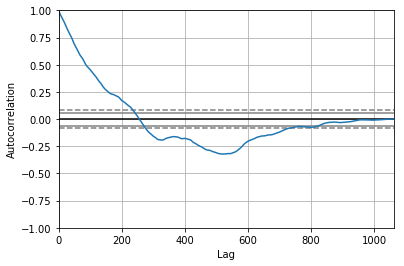

<Figure size 800x560 with 0 Axes>

Test MSE: 0.302


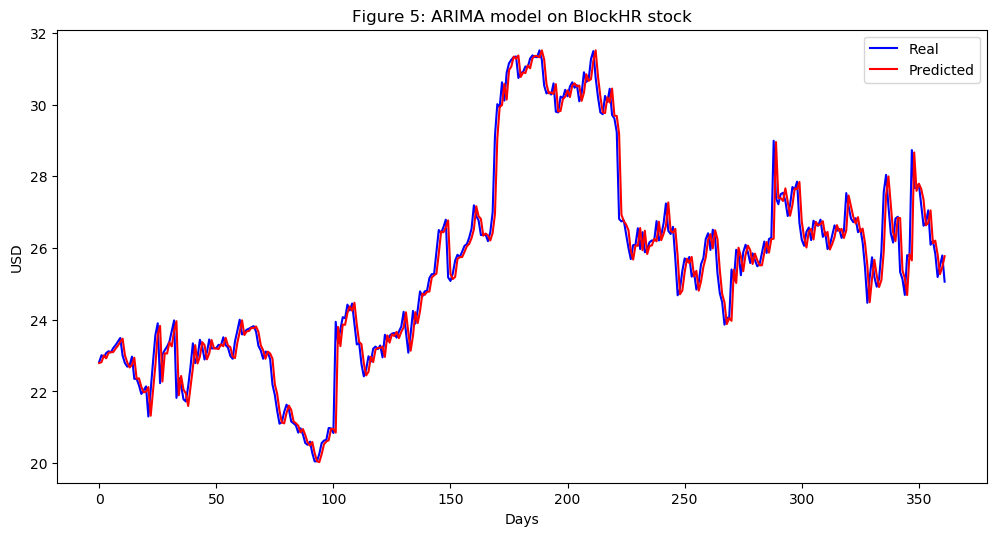

In [32]:


BlockHR_series = SP500_TechIndicator['BlockHR_Close']
BlockHR_series_model = ARIMA(BlockHR_series, order=(5, 1, 0))
BlockHR_model_fit = BlockHR_series_model.fit(disp=0)
print(BlockHR_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(BlockHR_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = BlockHR_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
BlockHR_predictions = list()
for t in range(len(test)):
    BlockHR_series_model = ARIMA(history, order=(5,1,0))
    BlockHR_series_model_fit = BlockHR_series_model.fit(disp=0)
    BlockHR_output = BlockHR_series_model_fit.forecast()
    yhat = BlockHR_output[0]
    BlockHR_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, BlockHR_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(BlockHR_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on BlockHR stock')
plt.legend()
plt.show()


#predictions
BlockHR_predictions = pd.DataFrame({'BlockHR_predictions':BlockHR_predictions})
#BlockHR_predictions.to_csv('BlockHR_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:     D.BorgWarner_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1303.037
Method:                       css-mle   S.D. of innovations              0.826
Date:                Sun, 17 Mar 2019   AIC                           2620.074
Time:                        11:30:42   BIC                           2654.843
Sample:                             1   HQIC                          2633.251
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                       -0.0063      0.026     -0.248      0.804      -0.056       0.044
ar.L1.D.BorgWarner_Close    -0.0104      0.031     -0.337      0.736      -0.071       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


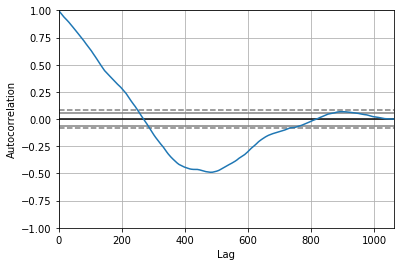

<Figure size 800x560 with 0 Axes>

Test MSE: 0.546


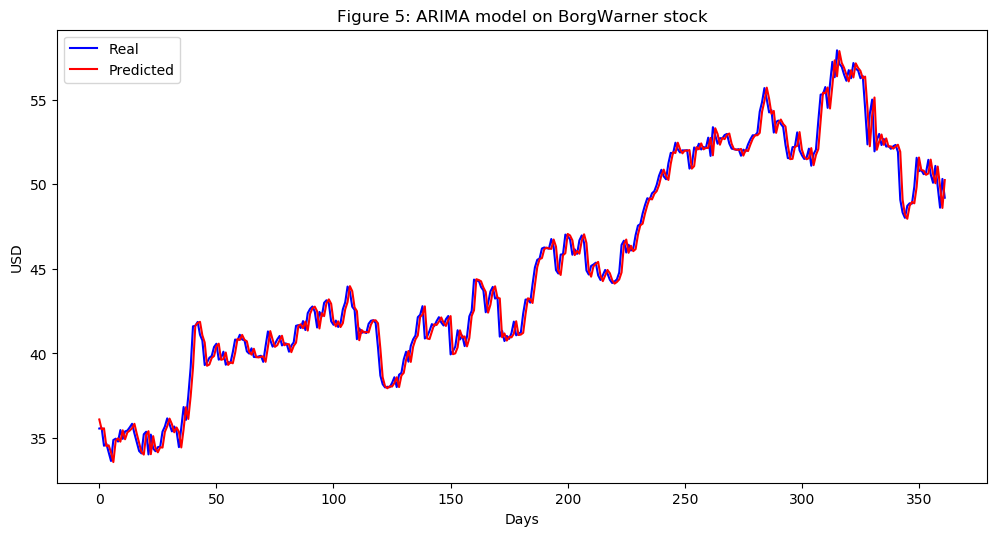

In [33]:


BorgWarner_series = SP500_TechIndicator['BorgWarner_Close']
BorgWarner_series_model = ARIMA(BorgWarner_series, order=(5, 1, 0))
BorgWarner_model_fit = BorgWarner_series_model.fit(disp=0)
print(BorgWarner_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(BorgWarner_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = BorgWarner_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
BorgWarner_predictions = list()
for t in range(len(test)):
    BorgWarner_series_model = ARIMA(history, order=(5,1,0))
    BorgWarner_series_model_fit = BorgWarner_series_model.fit(disp=0)
    BorgWarner_output = BorgWarner_series_model_fit.forecast()
    yhat = BorgWarner_output[0]
    BorgWarner_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, BorgWarner_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(BorgWarner_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on BorgWarner stock')
plt.legend()
plt.show()


#predictions
BorgWarner_predictions = pd.DataFrame({'BorgWarner_predictions':BorgWarner_predictions})
#BorgWarner_predictions.to_csv('BorgWarner_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:         D.Carmax_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1556.979
Method:                       css-mle   S.D. of innovations              1.050
Date:                Sun, 17 Mar 2019   AIC                           3127.957
Time:                        11:31:37   BIC                           3162.726
Sample:                             1   HQIC                          3141.134
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0120      0.031      0.382      0.703      -0.050       0.074
ar.L1.D.Carmax_Close    -0.0015      0.031     -0.049      0.961      -0.062       0.059
ar.L2.D.Carm

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


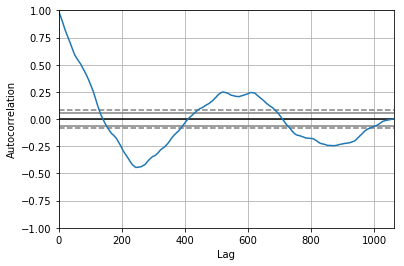

<Figure size 800x560 with 0 Axes>

Test MSE: 1.083


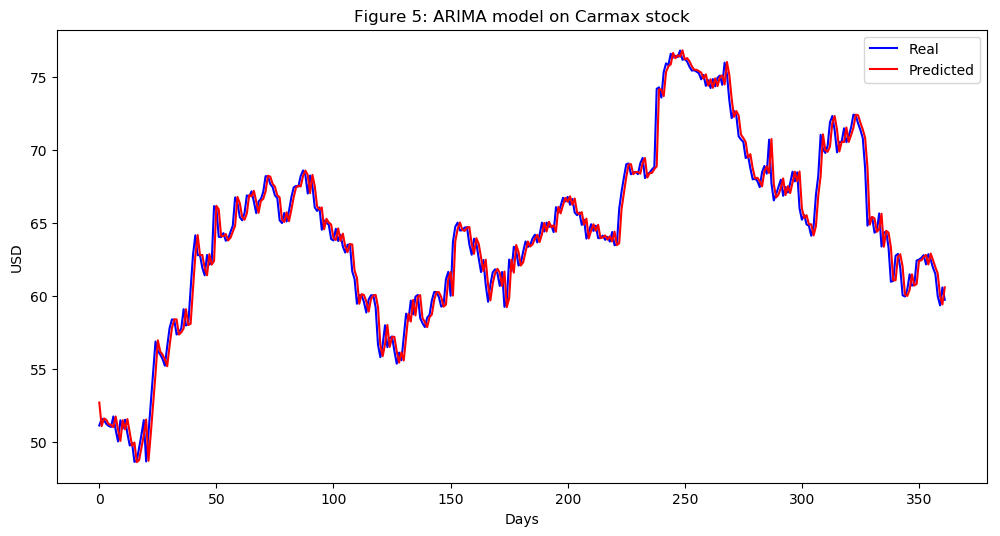

In [34]:


Carmax_series = SP500_TechIndicator['Carmax_Close']
Carmax_series_model = ARIMA(Carmax_series, order=(5, 1, 0))
Carmax_model_fit = Carmax_series_model.fit(disp=0)
print(Carmax_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Carmax_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Carmax_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Carmax_predictions = list()
for t in range(len(test)):
    Carmax_series_model = ARIMA(history, order=(5,1,0))
    Carmax_series_model_fit = Carmax_series_model.fit(disp=0)
    Carmax_output = Carmax_series_model_fit.forecast()
    yhat = Carmax_output[0]
    Carmax_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Carmax_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Carmax_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Carmax stock')
plt.legend()
plt.show()


#predictions
Carmax_predictions = pd.DataFrame({'Carmax_predictions':Carmax_predictions})
#Carmax_predictions.to_csv('Carmax_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:       D.Carnival_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1170.441
Method:                       css-mle   S.D. of innovations              0.729
Date:                Sun, 17 Mar 2019   AIC                           2354.881
Time:                        11:32:38   BIC                           2389.650
Sample:                             1   HQIC                          2368.058
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0243      0.018      1.324      0.186      -0.012       0.060
ar.L1.D.Carnival_Close    -0.0428      0.031     -1.397      0.163      -0.103       0.017
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


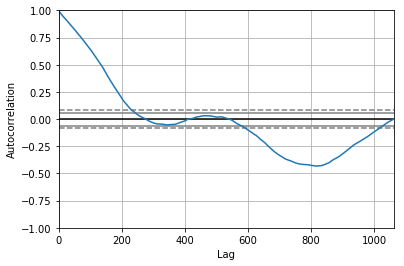

<Figure size 800x560 with 0 Axes>

Test MSE: 0.515


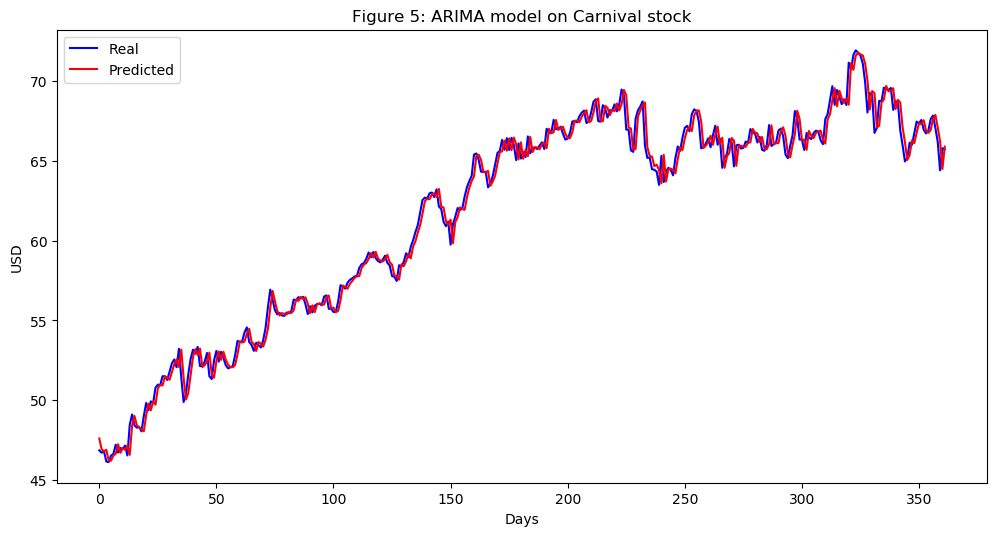

In [35]:


Carnival_series = SP500_TechIndicator['Carnival_Close']
Carnival_series_model = ARIMA(Carnival_series, order=(5, 1, 0))
Carnival_model_fit = Carnival_series_model.fit(disp=0)
print(Carnival_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Carnival_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Carnival_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Carnival_predictions = list()
for t in range(len(test)):
    Carnival_series_model = ARIMA(history, order=(5,1,0))
    Carnival_series_model_fit = Carnival_series_model.fit(disp=0)
    Carnival_output = Carnival_series_model_fit.forecast()
    yhat = Carnival_output[0]
    Carnival_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Carnival_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Carnival_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Carnival stock')
plt.legend()
plt.show()


#predictions
Carnival_predictions = pd.DataFrame({'Carnival_predictions':Carnival_predictions})
#Carnival_predictions.to_csv('Carnival_predictions.csv')




                                   ARIMA Model Results                                    
Dep. Variable:     D.Chipotle_Mexican_Grill_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -3917.476
Method:                                   css-mle   S.D. of innovations              9.711
Date:                            Sun, 17 Mar 2019   AIC                           7848.953
Time:                                    11:33:48   BIC                           7883.721
Sample:                                         1   HQIC                          7862.129
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                   -0.1982      0.287    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


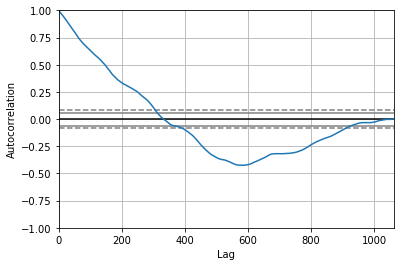

<Figure size 800x560 with 0 Axes>

Test MSE: 61.352


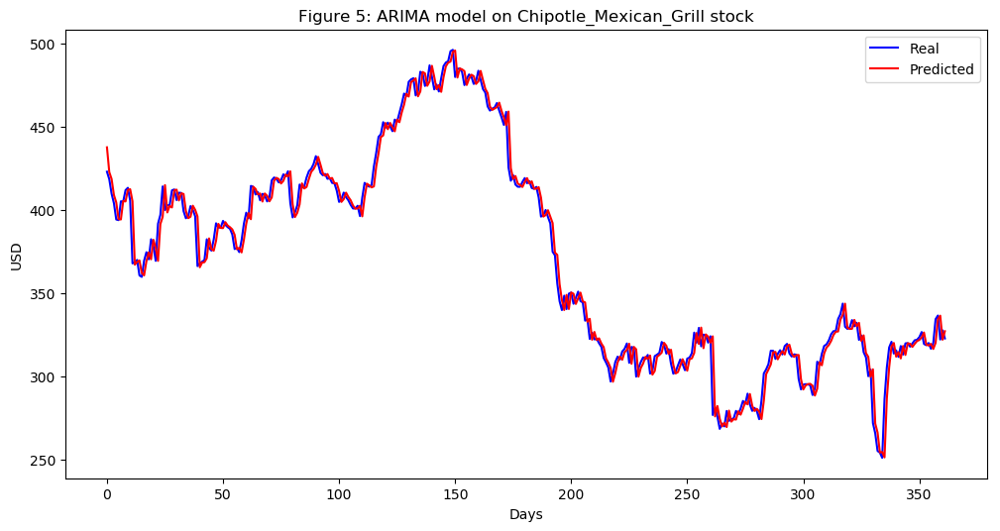

In [36]:


Chipotle_Mexican_Grill_series = SP500_TechIndicator['Chipotle_Mexican_Grill_Close']
Chipotle_Mexican_Grill_series_model = ARIMA(Chipotle_Mexican_Grill_series, order=(5, 1, 0))
Chipotle_Mexican_Grill_model_fit = Chipotle_Mexican_Grill_series_model.fit(disp=0)
print(Chipotle_Mexican_Grill_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Chipotle_Mexican_Grill_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Chipotle_Mexican_Grill_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Chipotle_Mexican_Grill_predictions = list()
for t in range(len(test)):
    Chipotle_Mexican_Grill_series_model = ARIMA(history, order=(5,1,0))
    Chipotle_Mexican_Grill_series_model_fit = Chipotle_Mexican_Grill_series_model.fit(disp=0)
    Chipotle_Mexican_Grill_output = Chipotle_Mexican_Grill_series_model_fit.forecast()
    yhat = Chipotle_Mexican_Grill_output[0]
    Chipotle_Mexican_Grill_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Chipotle_Mexican_Grill_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Chipotle_Mexican_Grill_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Chipotle_Mexican_Grill stock')
plt.legend()
plt.show()


#predictions
Chipotle_Mexican_Grill_predictions = pd.DataFrame({'Chipotle_Mexican_Grill_predictions':Chipotle_Mexican_Grill_predictions})
#Chipotle_Mexican_Grill_predictions.to_csv('Chipotle_Mexican_Grill_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:     D.D_R_Horton_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -792.894
Method:                       css-mle   S.D. of innovations              0.511
Date:                Sun, 17 Mar 2019   AIC                           1599.788
Time:                        11:34:53   BIC                           1634.557
Sample:                             1   HQIC                          1612.964
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0202      0.016      1.286      0.199      -0.011       0.051
ar.L1.D.D_R_Horton_Close    -0.0325      0.031     -1.058      0.290      -0.093       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


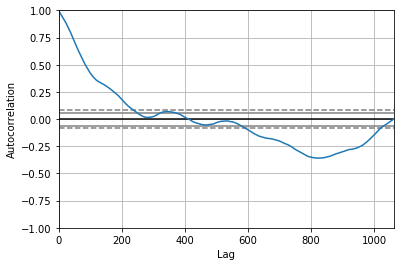

<Figure size 800x560 with 0 Axes>

Test MSE: 0.290


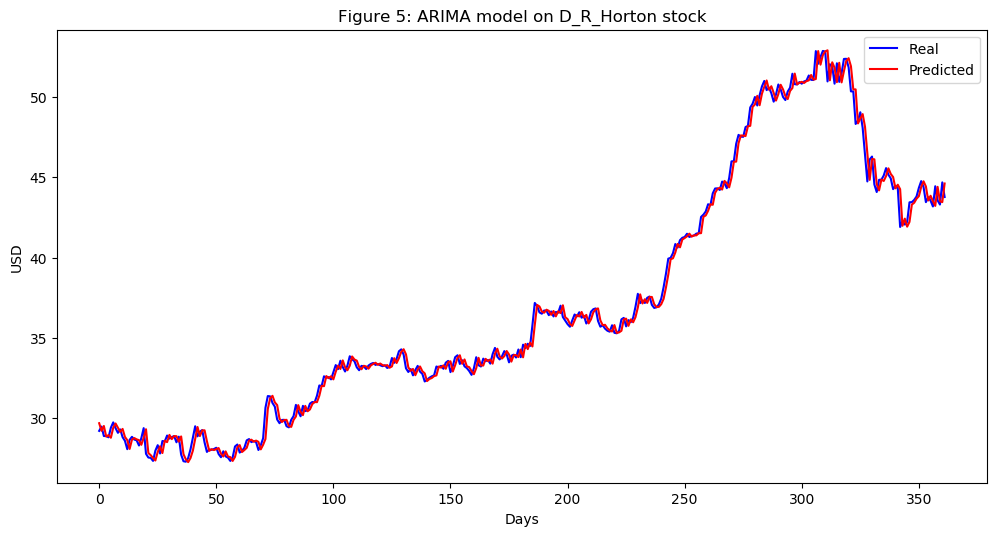

In [37]:


D_R_Horton_series = SP500_TechIndicator['D_R_Horton_Close']
D_R_Horton_series_model = ARIMA(D_R_Horton_series, order=(5, 1, 0))
D_R_Horton_model_fit = D_R_Horton_series_model.fit(disp=0)
print(D_R_Horton_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(D_R_Horton_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = D_R_Horton_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
D_R_Horton_predictions = list()
for t in range(len(test)):
    D_R_Horton_series_model = ARIMA(history, order=(5,1,0))
    D_R_Horton_series_model_fit = D_R_Horton_series_model.fit(disp=0)
    D_R_Horton_output = D_R_Horton_series_model_fit.forecast()
    yhat = D_R_Horton_output[0]
    D_R_Horton_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, D_R_Horton_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(D_R_Horton_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on D_R_Horton stock')
plt.legend()
plt.show()


#predictions
D_R_Horton_predictions = pd.DataFrame({'D_R_Horton_predictions':D_R_Horton_predictions})
#D_R_Horton_predictions.to_csv('D_R_Horton_predictions.csv')




                                 ARIMA Model Results                                  
Dep. Variable:     D.Darden_Restaurants_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1493.588
Method:                               css-mle   S.D. of innovations              0.989
Date:                        Sun, 17 Mar 2019   AIC                           3001.176
Time:                                11:36:25   BIC                           3035.945
Sample:                                     1   HQIC                          3014.353
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0276      0.031      0.901      0.368      -0.032       0.088
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


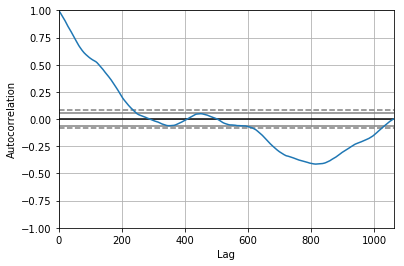

<Figure size 800x560 with 0 Axes>

Test MSE: 1.421


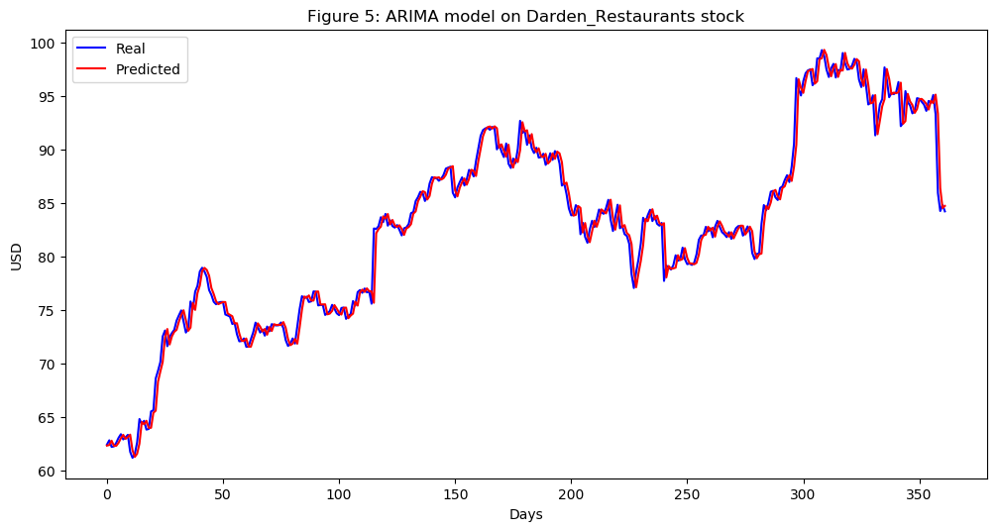

In [38]:


Darden_Restaurants_series = SP500_TechIndicator['Darden_Restaurants_Close']
Darden_Restaurants_series_model = ARIMA(Darden_Restaurants_series, order=(5, 1, 0))
Darden_Restaurants_model_fit = Darden_Restaurants_series_model.fit(disp=0)
print(Darden_Restaurants_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Darden_Restaurants_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Darden_Restaurants_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Darden_Restaurants_predictions = list()
for t in range(len(test)):
    Darden_Restaurants_series_model = ARIMA(history, order=(5,1,0))
    Darden_Restaurants_series_model_fit = Darden_Restaurants_series_model.fit(disp=0)
    Darden_Restaurants_output = Darden_Restaurants_series_model_fit.forecast()
    yhat = Darden_Restaurants_output[0]
    Darden_Restaurants_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Darden_Restaurants_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Darden_Restaurants_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Darden_Restaurants stock')
plt.legend()
plt.show()


#predictions
Darden_Restaurants_predictions = pd.DataFrame({'Darden_Restaurants_predictions':Darden_Restaurants_predictions})
#Darden_Restaurants_predictions.to_csv('Darden_Restaurants_predictions.csv')




                               ARIMA Model Results                                
Dep. Variable:     D.Dollar_General_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1704.125
Method:                           css-mle   S.D. of innovations              1.206
Date:                    Sun, 17 Mar 2019   AIC                           3422.250
Time:                            11:37:40   BIC                           3457.018
Sample:                                 1   HQIC                          3435.426
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0300      0.036      0.840      0.401      -0.040       0.100
ar.L1.D.Dollar_General_Close     0.0147      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


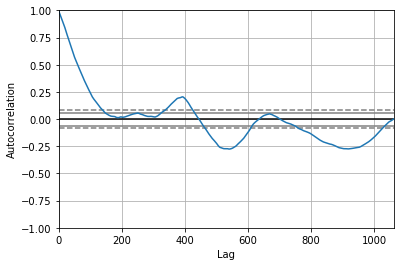

<Figure size 800x560 with 0 Axes>

Test MSE: 1.534


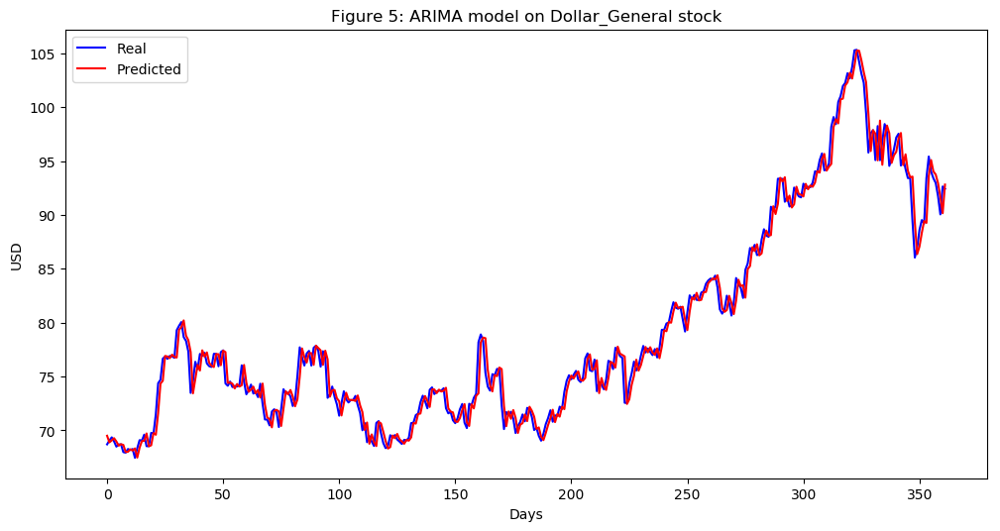

In [39]:


Dollar_General_series = SP500_TechIndicator['Dollar_General_Close']
Dollar_General_series_model = ARIMA(Dollar_General_series, order=(5, 1, 0))
Dollar_General_model_fit = Dollar_General_series_model.fit(disp=0)
print(Dollar_General_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Dollar_General_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Dollar_General_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Dollar_General_predictions = list()
for t in range(len(test)):
    Dollar_General_series_model = ARIMA(history, order=(5,1,0))
    Dollar_General_series_model_fit = Dollar_General_series_model.fit(disp=0)
    Dollar_General_output = Dollar_General_series_model_fit.forecast()
    yhat = Dollar_General_output[0]
    Dollar_General_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Dollar_General_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Dollar_General_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Dollar_General stock')
plt.legend()
plt.show()


#predictions
Dollar_General_predictions = pd.DataFrame({'Dollar_General_predictions':Dollar_General_predictions})
#Dollar_General_predictions.to_csv('Dollar_General_predictions.csv')




                              ARIMA Model Results                              
Dep. Variable:     D.Dollar_Tree_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -1792.517
Method:                        css-mle   S.D. of innovations              1.311
Date:                 Sun, 17 Mar 2019   AIC                           3599.035
Time:                         11:38:39   BIC                           3633.803
Sample:                              1   HQIC                          3612.211
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0350      0.040      0.878      0.380      -0.043       0.113
ar.L1.D.Dollar_Tree_Close    -0.0268      0.031     -0.871      0.384      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


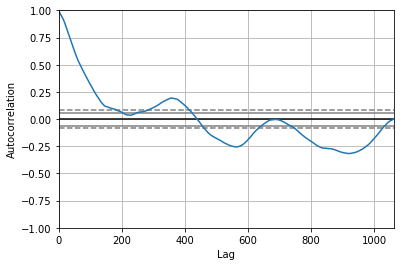

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 2.461


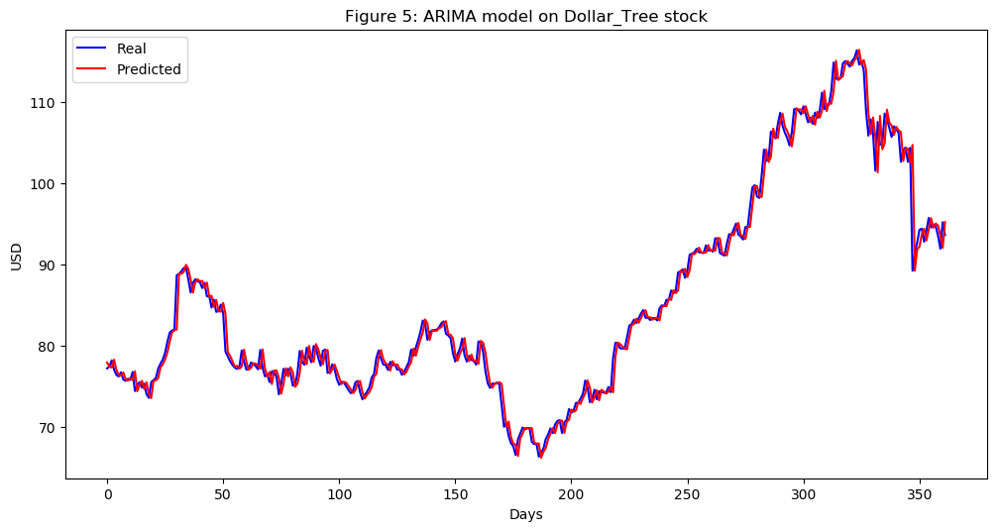

In [40]:


Dollar_Tree_series = SP500_TechIndicator['Dollar_Tree_Close']
Dollar_Tree_series_model = ARIMA(Dollar_Tree_series, order=(5, 1, 0))
Dollar_Tree_model_fit = Dollar_Tree_series_model.fit(disp=0)
print(Dollar_Tree_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Dollar_Tree_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Dollar_Tree_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Dollar_Tree_predictions = list()
for t in range(len(test)):
    Dollar_Tree_series_model = ARIMA(history, order=(5,1,0))
    Dollar_Tree_series_model_fit = Dollar_Tree_series_model.fit(disp=0)
    Dollar_Tree_output = Dollar_Tree_series_model_fit.forecast()
    yhat = Dollar_Tree_output[0]
    Dollar_Tree_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Dollar_Tree_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Dollar_Tree_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Dollar_Tree stock')
plt.legend()
plt.show()


#predictions
Dollar_Tree_predictions = pd.DataFrame({'Dollar_Tree_predictions':Dollar_Tree_predictions})
#Dollar_Tree_predictions.to_csv('Dollar_Tree_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:           D.eBay_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1796.526
Method:                       css-mle   S.D. of innovations              1.316
Date:                Sun, 17 Mar 2019   AIC                           3607.051
Time:                        11:43:49   BIC                           3641.820
Sample:                             1   HQIC                          3620.228
                                                                              
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0136      0.037     -0.373      0.709      -0.085       0.058
ar.L1.D.eBay_Close    -0.0266      0.031     -0.865      0.387      -0.087       0.034
ar.L2.D.eBay_Close  

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


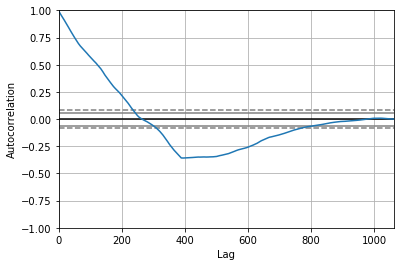

<Figure size 800x560 with 0 Axes>

Test MSE: 0.339


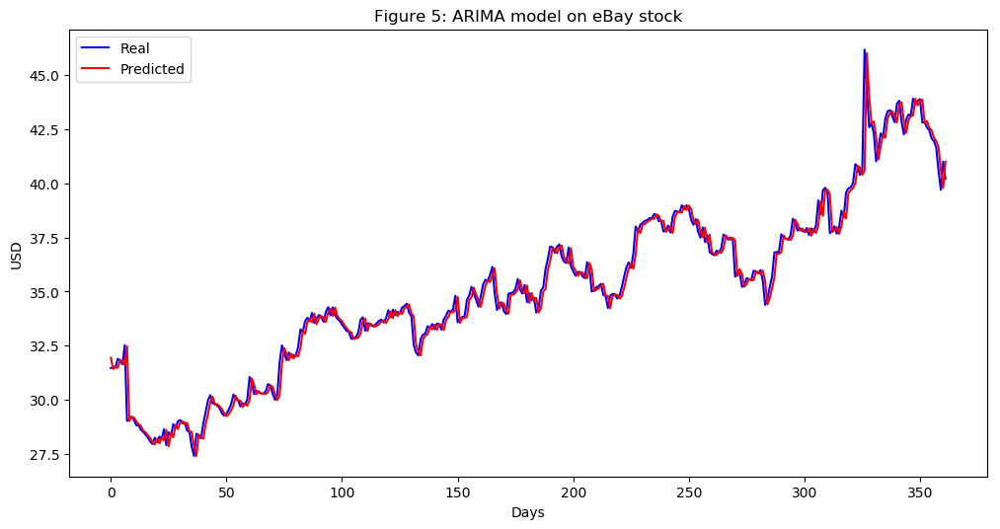

In [46]:


eBay_series = SP500_TechIndicator['eBay_Close']
eBay_series_model = ARIMA(eBay_series, order=(5, 1, 0))
eBay_model_fit = eBay_series_model.fit(disp=0)
print(eBay_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(eBay_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = eBay_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
eBay_predictions = list()
for t in range(len(test)):
    eBay_series_model = ARIMA(history, order=(5,1,0))
    eBay_series_model_fit = eBay_series_model.fit(disp=0)
    eBay_output = eBay_series_model_fit.forecast()
    yhat = eBay_output[0]
    eBay_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, eBay_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(eBay_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on eBay stock')
plt.legend()
plt.show()


#predictions
eBay_predictions = pd.DataFrame({'eBay_predictions':eBay_predictions})
#EBay_predictions.to_csv('EBay_predictions.csv')




                               ARIMA Model Results                               
Dep. Variable:     D.Expedia_Group_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -2338.680
Method:                          css-mle   S.D. of innovations              2.193
Date:                   Sun, 17 Mar 2019   AIC                           4691.359
Time:                           11:45:55   BIC                           4726.128
Sample:                                1   HQIC                          4704.536
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0340      0.062      0.549      0.583      -0.087       0.155
ar.L1.D.Expedia_Group_Close     0.0411      0.031      1

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


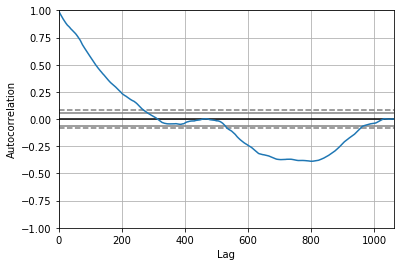

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 5.919


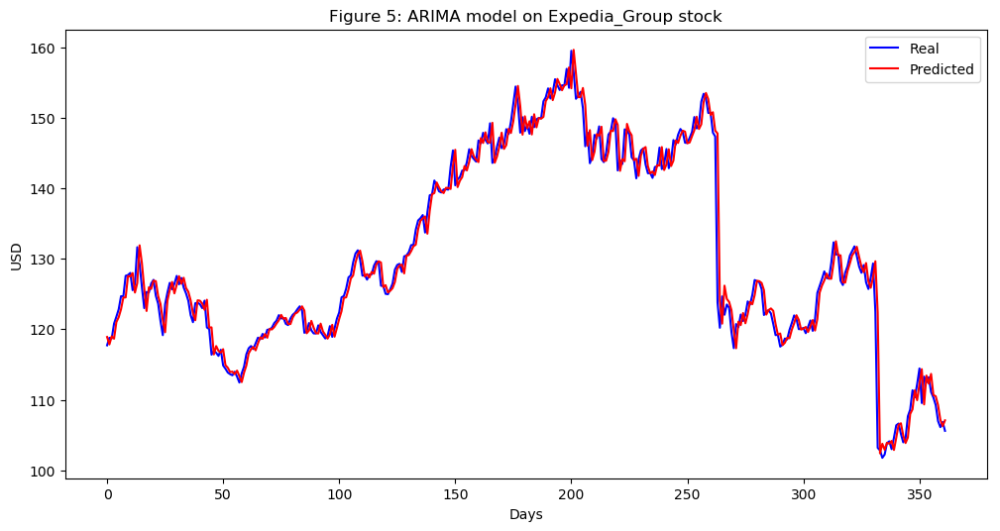

In [47]:


Expedia_Group_series = SP500_TechIndicator['Expedia_Group_Close']
Expedia_Group_series_model = ARIMA(Expedia_Group_series, order=(5, 1, 0))
Expedia_Group_model_fit = Expedia_Group_series_model.fit(disp=0)
print(Expedia_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Expedia_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Expedia_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Expedia_Group_predictions = list()
for t in range(len(test)):
    Expedia_Group_series_model = ARIMA(history, order=(5,1,0))
    Expedia_Group_series_model_fit = Expedia_Group_series_model.fit(disp=0)
    Expedia_Group_output = Expedia_Group_series_model_fit.forecast()
    yhat = Expedia_Group_output[0]
    Expedia_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Expedia_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Expedia_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Expedia_Group stock')
plt.legend()
plt.show()


#predictions
Expedia_Group_predictions = pd.DataFrame({'Expedia_Group_predictions':Expedia_Group_predictions})
#Expedia_Group_predictions.to_csv('Expedia_Group_predictions.csv')




                               ARIMA Model Results                               
Dep. Variable:     D.Expedia_Group_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -2338.680
Method:                          css-mle   S.D. of innovations              2.193
Date:                   Sun, 17 Mar 2019   AIC                           4691.359
Time:                           11:46:56   BIC                           4726.128
Sample:                                1   HQIC                          4704.536
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0340      0.062      0.549      0.583      -0.087       0.155
ar.L1.D.Expedia_Group_Close     0.0411      0.031      1

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


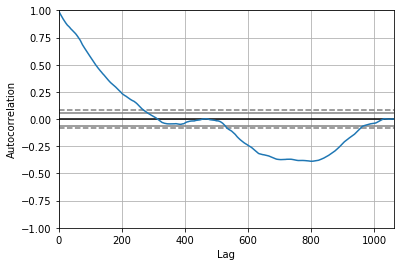

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 5.919


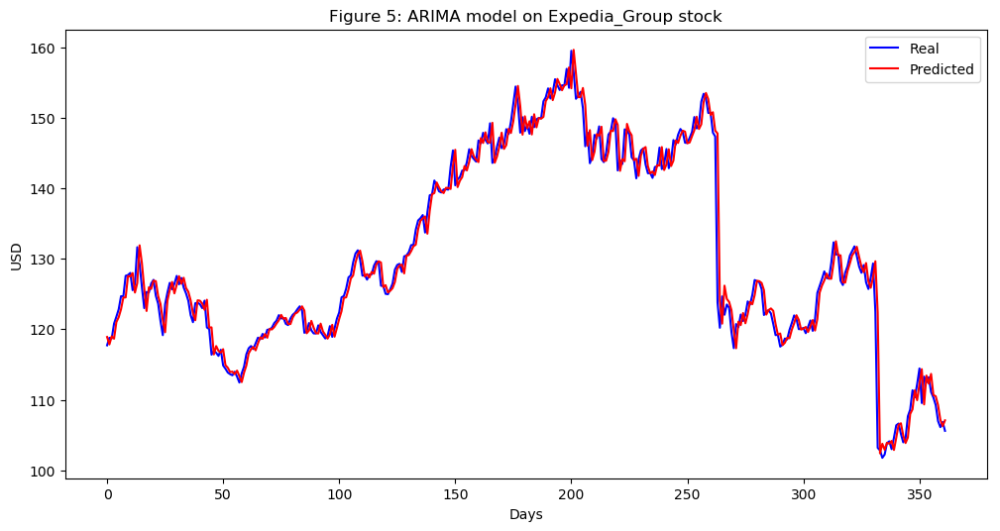

In [48]:


Expedia_Group_series = SP500_TechIndicator['Expedia_Group_Close']
Expedia_Group_series_model = ARIMA(Expedia_Group_series, order=(5, 1, 0))
Expedia_Group_model_fit = Expedia_Group_series_model.fit(disp=0)
print(Expedia_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Expedia_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Expedia_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Expedia_Group_predictions = list()
for t in range(len(test)):
    Expedia_Group_series_model = ARIMA(history, order=(5,1,0))
    Expedia_Group_series_model_fit = Expedia_Group_series_model.fit(disp=0)
    Expedia_Group_output = Expedia_Group_series_model_fit.forecast()
    yhat = Expedia_Group_output[0]
    Expedia_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Expedia_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Expedia_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Expedia_Group stock')
plt.legend()
plt.show()


#predictions
Expedia_Group_predictions = pd.DataFrame({'Expedia_Group_predictions':Expedia_Group_predictions})
#Expedia_Group_predictions.to_csv('Expedia_Group_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:     D.Ford_Motor_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                 237.061
Method:                       css-mle   S.D. of innovations              0.194
Date:                Sun, 17 Mar 2019   AIC                           -460.121
Time:                        11:47:50   BIC                           -425.353
Sample:                             1   HQIC                          -446.945
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                       -0.0043      0.006     -0.688      0.492      -0.017       0.008
ar.L1.D.Ford_Motor_Close     0.0606      0.031      1.974      0.049       0.000       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


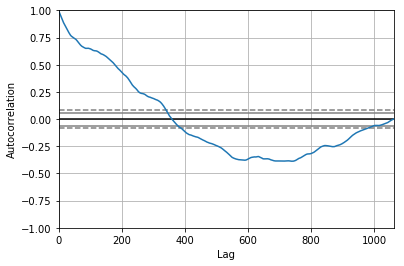

<Figure size 800x560 with 0 Axes>

Test MSE: 0.026


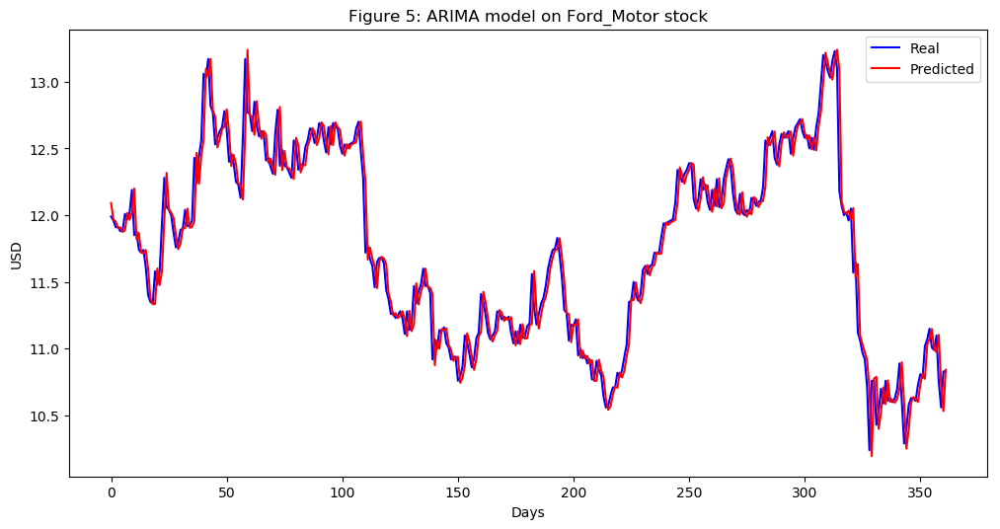

In [49]:


Ford_Motor_series = SP500_TechIndicator['Ford_Motor_Close']
Ford_Motor_series_model = ARIMA(Ford_Motor_series, order=(5, 1, 0))
Ford_Motor_model_fit = Ford_Motor_series_model.fit(disp=0)
print(Ford_Motor_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Ford_Motor_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Ford_Motor_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Ford_Motor_predictions = list()
for t in range(len(test)):
    Ford_Motor_series_model = ARIMA(history, order=(5,1,0))
    Ford_Motor_series_model_fit = Ford_Motor_series_model.fit(disp=0)
    Ford_Motor_output = Ford_Motor_series_model_fit.forecast()
    yhat = Ford_Motor_output[0]
    Ford_Motor_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Ford_Motor_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Ford_Motor_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Ford_Motor stock')
plt.legend()
plt.show()


#predictions
Ford_Motor_predictions = pd.DataFrame({'Ford_Motor_predictions':Ford_Motor_predictions})
#Ford_Motor_predictions.to_csv('Ford_Motor_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:            D.Gap_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1006.124
Method:                       css-mle   S.D. of innovations              0.625
Date:                Sun, 17 Mar 2019   AIC                           2026.247
Time:                        11:48:49   BIC                           2061.016
Sample:                             1   HQIC                          2039.424
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                -0.0081      0.019     -0.415      0.678      -0.046       0.030
ar.L1.D.Gap_Close     0.0020      0.031      0.065      0.949      -0.058       0.062
ar.L2.D.Gap_Close    -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


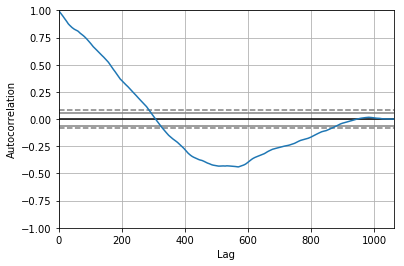

<Figure size 800x560 with 0 Axes>

Test MSE: 0.416


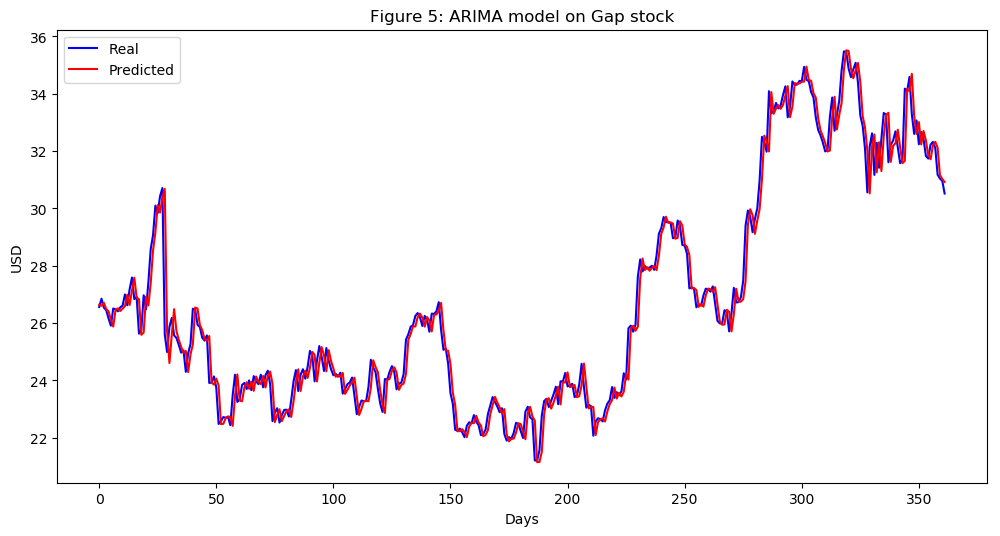

In [50]:


Gap_series = SP500_TechIndicator['Gap_Close']
Gap_series_model = ARIMA(Gap_series, order=(5, 1, 0))
Gap_model_fit = Gap_series_model.fit(disp=0)
print(Gap_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Gap_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Gap_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Gap_predictions = list()
for t in range(len(test)):
    Gap_series_model = ARIMA(history, order=(5,1,0))
    Gap_series_model_fit = Gap_series_model.fit(disp=0)
    Gap_output = Gap_series_model_fit.forecast()
    yhat = Gap_output[0]
    Gap_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Gap_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Gap_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Gap stock')
plt.legend()
plt.show()


#predictions
Gap_predictions = pd.DataFrame({'Gap_predictions':Gap_predictions})
#Gap_predictions.to_csv('Gap_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:         D.Garmin_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1259.121
Method:                       css-mle   S.D. of innovations              0.793
Date:                Sun, 17 Mar 2019   AIC                           2532.241
Time:                        11:49:43   BIC                           2567.010
Sample:                             1   HQIC                          2545.418
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0113      0.022      0.507      0.613      -0.033       0.055
ar.L1.D.Garmin_Close    -0.0174      0.031     -0.568      0.570      -0.078       0.043
ar.L2.D.Garm

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


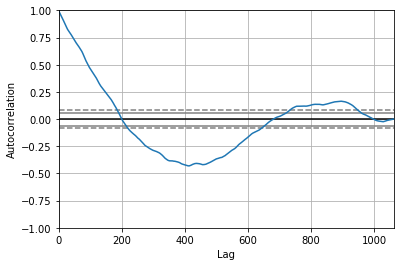

<Figure size 800x560 with 0 Axes>

Test MSE: 0.461


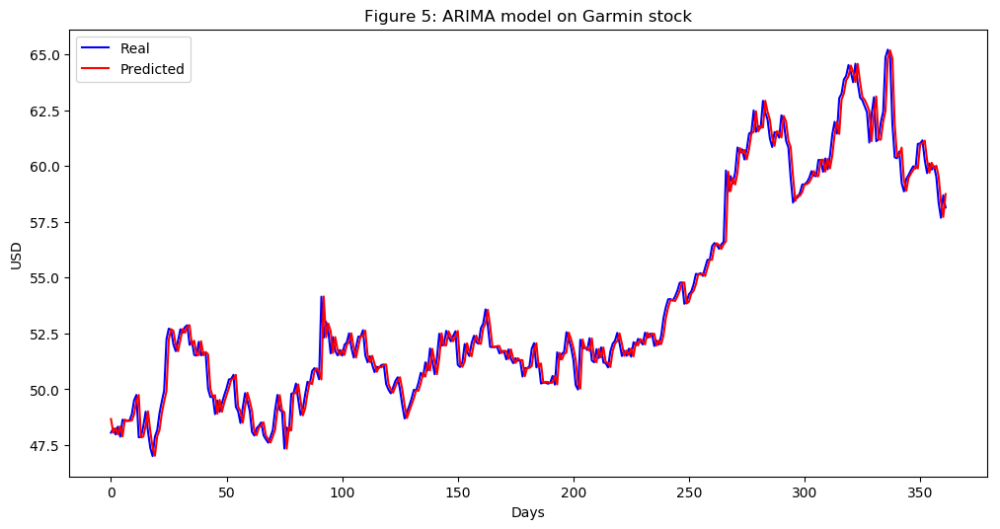

In [51]:


Garmin_series = SP500_TechIndicator['Garmin_Close']
Garmin_series_model = ARIMA(Garmin_series, order=(5, 1, 0))
Garmin_model_fit = Garmin_series_model.fit(disp=0)
print(Garmin_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Garmin_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Garmin_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Garmin_predictions = list()
for t in range(len(test)):
    Garmin_series_model = ARIMA(history, order=(5,1,0))
    Garmin_series_model_fit = Garmin_series_model.fit(disp=0)
    Garmin_output = Garmin_series_model_fit.forecast()
    yhat = Garmin_output[0]
    Garmin_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Garmin_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Garmin_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Garmin stock')
plt.legend()
plt.show()


#predictions
Garmin_predictions = pd.DataFrame({'Garmin_predictions':Garmin_predictions})
#Garmin_predictions.to_csv('Garmin_predictions.csv')




                               ARIMA Model Results                                
Dep. Variable:     D.General_Motors_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood                -836.840
Method:                           css-mle   S.D. of innovations              0.532
Date:                    Sun, 17 Mar 2019   AIC                           1687.679
Time:                            11:50:36   BIC                           1722.448
Sample:                                 1   HQIC                          1700.856
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           -0.0056      0.016     -0.346      0.730      -0.037       0.026
ar.L1.D.General_Motors_Close     0.0371      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


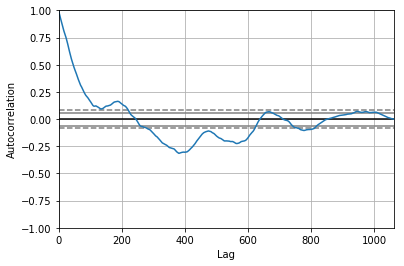

<Figure size 800x560 with 0 Axes>

Test MSE: 0.354


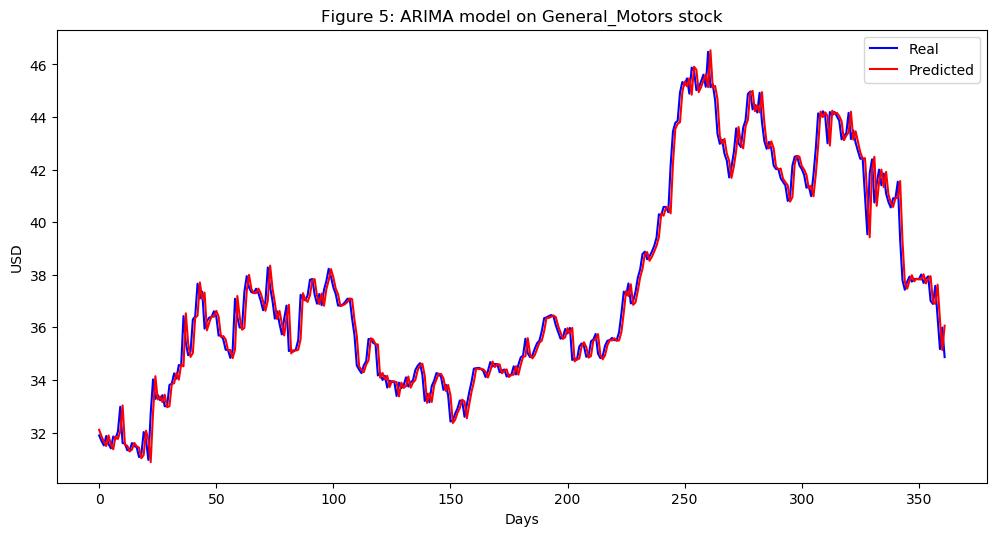

In [52]:


General_Motors_series = SP500_TechIndicator['General_Motors_Close']
General_Motors_series_model = ARIMA(General_Motors_series, order=(5, 1, 0))
General_Motors_model_fit = General_Motors_series_model.fit(disp=0)
print(General_Motors_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(General_Motors_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = General_Motors_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
General_Motors_predictions = list()
for t in range(len(test)):
    General_Motors_series_model = ARIMA(history, order=(5,1,0))
    General_Motors_series_model_fit = General_Motors_series_model.fit(disp=0)
    General_Motors_output = General_Motors_series_model_fit.forecast()
    yhat = General_Motors_output[0]
    General_Motors_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, General_Motors_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(General_Motors_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on General_Motors stock')
plt.legend()
plt.show()


#predictions
General_Motors_predictions = pd.DataFrame({'General_Motors_predictions':General_Motors_predictions})
#General_Motors_predictions.to_csv('General_Motors_predictions.csv')




                               ARIMA Model Results                               
Dep. Variable:     D.Genuine_Parts_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -1601.493
Method:                          css-mle   S.D. of innovations              1.095
Date:                   Sun, 17 Mar 2019   AIC                           3216.985
Time:                           11:51:38   BIC                           3251.754
Sample:                                1   HQIC                          3230.162
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0051      0.034      0.147      0.883      -0.062       0.073
ar.L1.D.Genuine_Parts_Close     0.0259      0.031      0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


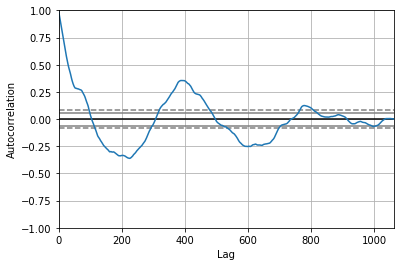

<Figure size 800x560 with 0 Axes>

Test MSE: 1.488


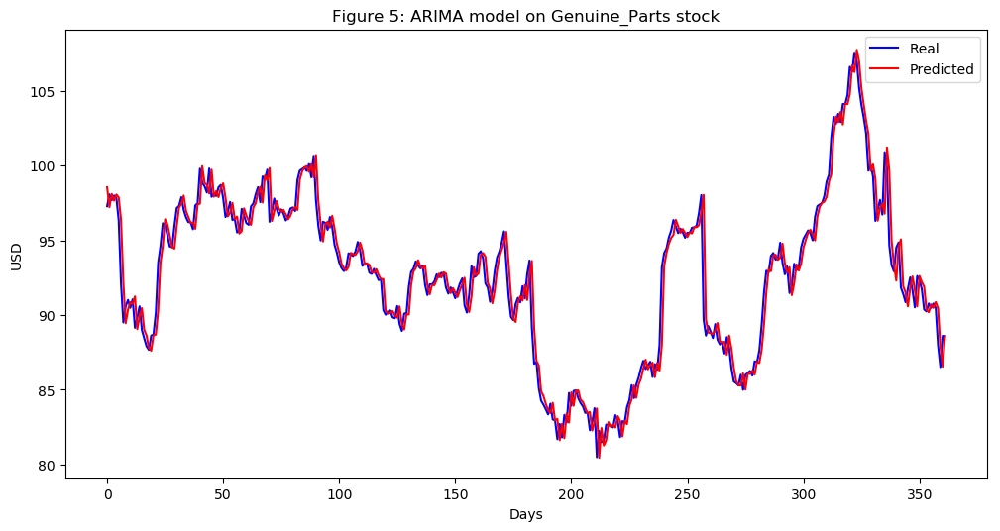

In [53]:


Genuine_Parts_series = SP500_TechIndicator['Genuine_Parts_Close']
Genuine_Parts_series_model = ARIMA(Genuine_Parts_series, order=(5, 1, 0))
Genuine_Parts_model_fit = Genuine_Parts_series_model.fit(disp=0)
print(Genuine_Parts_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Genuine_Parts_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Genuine_Parts_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Genuine_Parts_predictions = list()
for t in range(len(test)):
    Genuine_Parts_series_model = ARIMA(history, order=(5,1,0))
    Genuine_Parts_series_model_fit = Genuine_Parts_series_model.fit(disp=0)
    Genuine_Parts_output = Genuine_Parts_series_model_fit.forecast()
    yhat = Genuine_Parts_output[0]
    Genuine_Parts_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Genuine_Parts_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Genuine_Parts_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Genuine_Parts stock')
plt.legend()
plt.show()


#predictions
Genuine_Parts_predictions = pd.DataFrame({'Genuine_Parts_predictions':Genuine_Parts_predictions})
#Genuine_Parts_predictions.to_csv('Genuine_Parts_predictions.csv')




                                  ARIMA Model Results                                   
Dep. Variable:     D.Goodyear_Tire_Rubber_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood                -818.587
Method:                                 css-mle   S.D. of innovations              0.523
Date:                          Sun, 17 Mar 2019   AIC                           1651.174
Time:                                  11:52:32   BIC                           1685.943
Sample:                                       1   HQIC                          1664.351
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0027      0.018      0.152      0.879    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


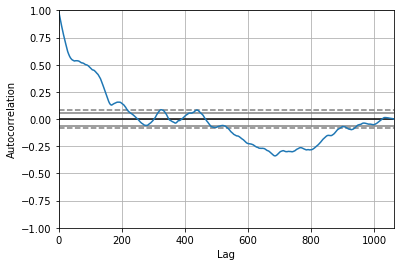

<Figure size 800x560 with 0 Axes>

Test MSE: 0.281


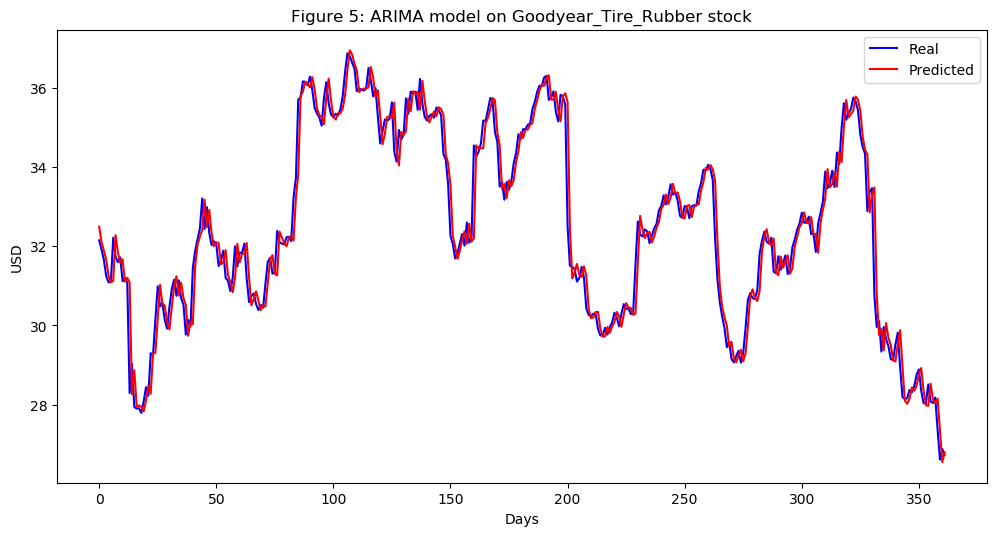

In [54]:


Goodyear_Tire_Rubber_series = SP500_TechIndicator['Goodyear_Tire_Rubber_Close']
Goodyear_Tire_Rubber_series_model = ARIMA(Goodyear_Tire_Rubber_series, order=(5, 1, 0))
Goodyear_Tire_Rubber_model_fit = Goodyear_Tire_Rubber_series_model.fit(disp=0)
print(Goodyear_Tire_Rubber_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Goodyear_Tire_Rubber_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Goodyear_Tire_Rubber_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Goodyear_Tire_Rubber_predictions = list()
for t in range(len(test)):
    Goodyear_Tire_Rubber_series_model = ARIMA(history, order=(5,1,0))
    Goodyear_Tire_Rubber_series_model_fit = Goodyear_Tire_Rubber_series_model.fit(disp=0)
    Goodyear_Tire_Rubber_output = Goodyear_Tire_Rubber_series_model_fit.forecast()
    yhat = Goodyear_Tire_Rubber_output[0]
    Goodyear_Tire_Rubber_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Goodyear_Tire_Rubber_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Goodyear_Tire_Rubber_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Goodyear_Tire_Rubber stock')
plt.legend()
plt.show()


#predictions
Goodyear_Tire_Rubber_predictions = pd.DataFrame({'Goodyear_Tire_Rubber_predictions':Goodyear_Tire_Rubber_predictions})
#Goodyear_Tire_Rubber_predictions.to_csv('Goodyear_Tire_Rubber_predictions.csv')




                              ARIMA Model Results                              
Dep. Variable:     D.Hanesbrands_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -2697.947
Method:                        css-mle   S.D. of innovations              3.077
Date:                 Sun, 17 Mar 2019   AIC                           5409.893
Time:                         11:53:52   BIC                           5444.662
Sample:                              1   HQIC                          5423.070
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                        -0.0484      0.088     -0.550      0.583      -0.221       0.124
ar.L1.D.Hanesbrands_Close     0.0069      0.031      0.225      0.822      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


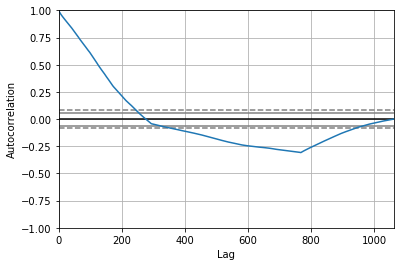

<Figure size 800x560 with 0 Axes>

Test MSE: 0.200


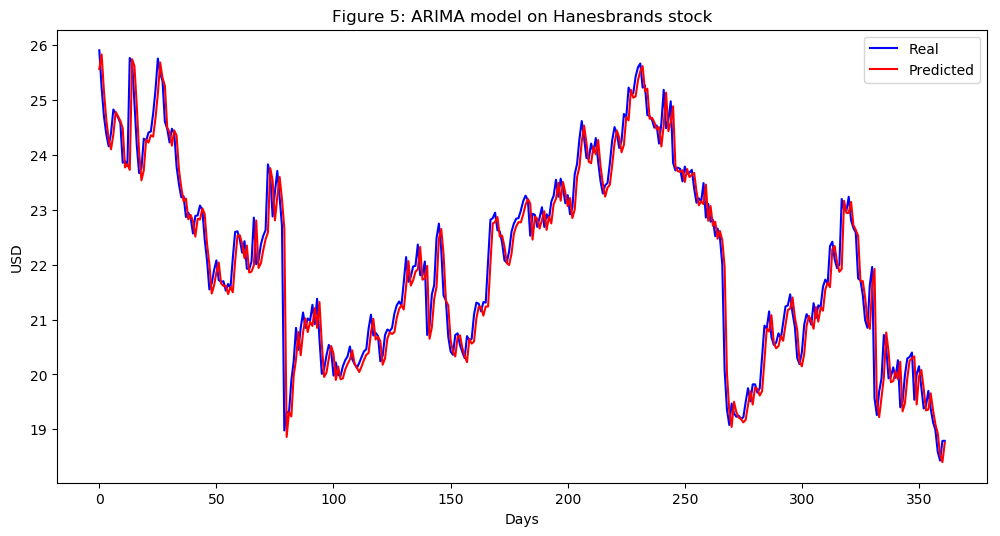

In [55]:


Hanesbrands_series = SP500_TechIndicator['Hanesbrands_Close']
Hanesbrands_series_model = ARIMA(Hanesbrands_series, order=(5, 1, 0))
Hanesbrands_model_fit = Hanesbrands_series_model.fit(disp=0)
print(Hanesbrands_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Hanesbrands_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Hanesbrands_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Hanesbrands_predictions = list()
for t in range(len(test)):
    Hanesbrands_series_model = ARIMA(history, order=(5,1,0))
    Hanesbrands_series_model_fit = Hanesbrands_series_model.fit(disp=0)
    Hanesbrands_output = Hanesbrands_series_model_fit.forecast()
    yhat = Hanesbrands_output[0]
    Hanesbrands_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Hanesbrands_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Hanesbrands_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Hanesbrands stock')
plt.legend()
plt.show()


#predictions
Hanesbrands_predictions = pd.DataFrame({'Hanesbrands_predictions':Hanesbrands_predictions})
#Hanesbrands_predictions.to_csv('Hanesbrands_predictions.csv')




                                ARIMA Model Results                                
Dep. Variable:     D.Harley_Davidson_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1474.305
Method:                            css-mle   S.D. of innovations              0.971
Date:                     Sun, 17 Mar 2019   AIC                           2962.611
Time:                             11:54:51   BIC                           2997.380
Sample:                                  1   HQIC                          2975.787
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                            -0.0256      0.024     -1.051      0.293      -0.073       0.022
ar.L1.D.Harley_Davidson_Close    -

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


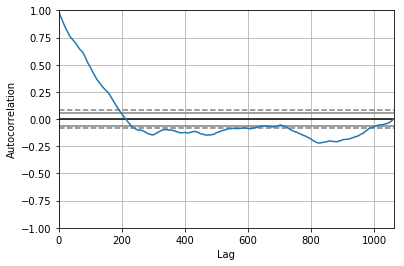

<Figure size 800x560 with 0 Axes>

Test MSE: 0.716


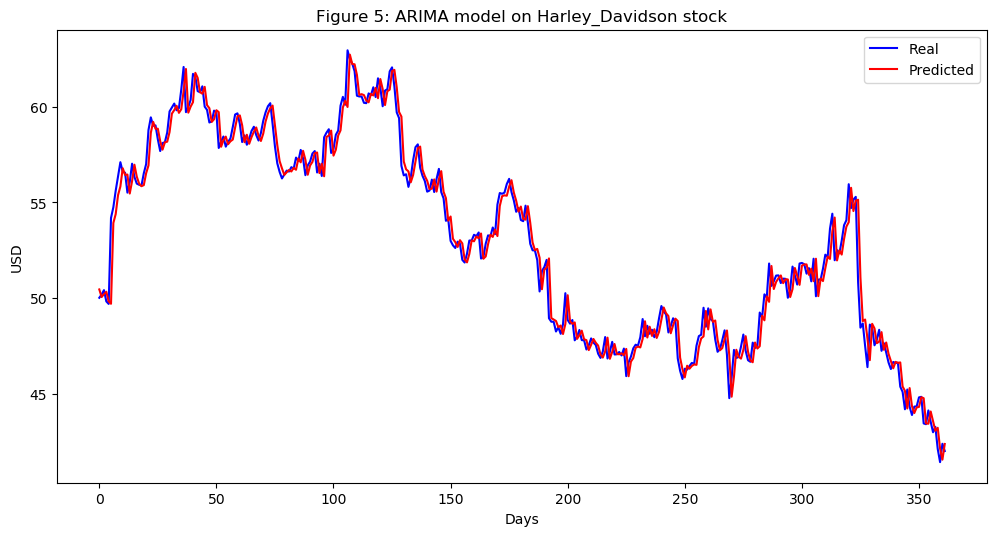

In [56]:


Harley_Davidson_series = SP500_TechIndicator['Harley_Davidson_Close']
Harley_Davidson_series_model = ARIMA(Harley_Davidson_series, order=(5, 1, 0))
Harley_Davidson_model_fit = Harley_Davidson_series_model.fit(disp=0)
print(Harley_Davidson_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Harley_Davidson_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Harley_Davidson_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Harley_Davidson_predictions = list()
for t in range(len(test)):
    Harley_Davidson_series_model = ARIMA(history, order=(5,1,0))
    Harley_Davidson_series_model_fit = Harley_Davidson_series_model.fit(disp=0)
    Harley_Davidson_output = Harley_Davidson_series_model_fit.forecast()
    yhat = Harley_Davidson_output[0]
    Harley_Davidson_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Harley_Davidson_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Harley_Davidson_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Harley_Davidson stock')
plt.legend()
plt.show()


#predictions
Harley_Davidson_predictions = pd.DataFrame({'Harley_Davidson_predictions':Harley_Davidson_predictions})
#Harley_Davidson_predictions.to_csv('Harley_Davidson_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:         D.Hasbro_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1749.772
Method:                       css-mle   S.D. of innovations              1.259
Date:                Sun, 17 Mar 2019   AIC                           3513.544
Time:                        11:55:49   BIC                           3548.313
Sample:                             1   HQIC                          3526.721
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0276      0.033      0.827      0.408      -0.038       0.093
ar.L1.D.Hasbro_Close    -0.0639      0.031     -2.080      0.038      -0.124      -0.004
ar.L2.D.Hasb

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


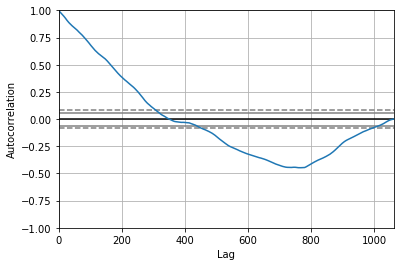

<Figure size 800x560 with 0 Axes>

Test MSE: 2.698


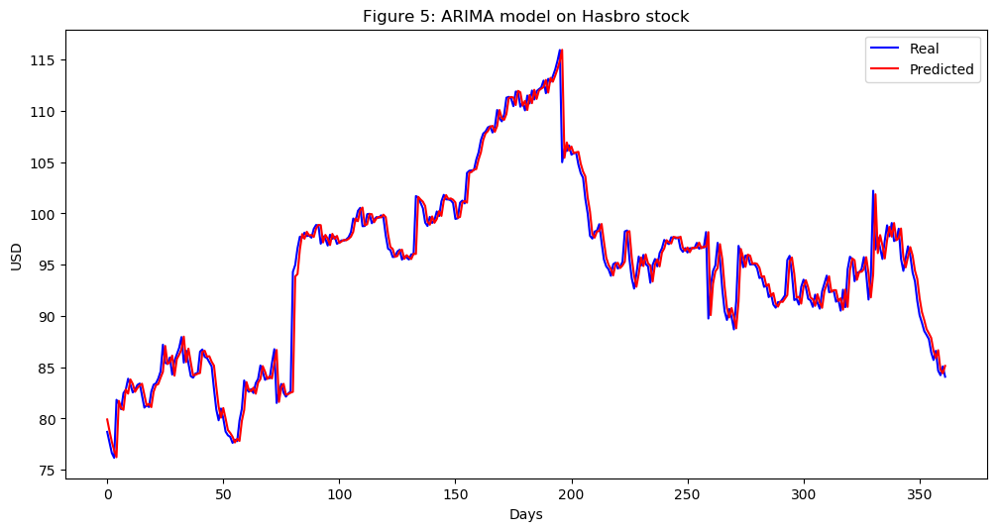

In [57]:


Hasbro_series = SP500_TechIndicator['Hasbro_Close']
Hasbro_series_model = ARIMA(Hasbro_series, order=(5, 1, 0))
Hasbro_model_fit = Hasbro_series_model.fit(disp=0)
print(Hasbro_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Hasbro_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Hasbro_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Hasbro_predictions = list()
for t in range(len(test)):
    Hasbro_series_model = ARIMA(history, order=(5,1,0))
    Hasbro_series_model_fit = Hasbro_series_model.fit(disp=0)
    Hasbro_output = Hasbro_series_model_fit.forecast()
    yhat = Hasbro_output[0]
    Hasbro_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Hasbro_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Hasbro_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Hasbro stock')
plt.legend()
plt.show()


#predictions
Hasbro_predictions = pd.DataFrame({'Hasbro_predictions':Hasbro_predictions})
#Hasbro_predictions.to_csv('Hasbro_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:     D.Home_Depot_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1911.398
Method:                       css-mle   S.D. of innovations              1.466
Date:                Sun, 17 Mar 2019   AIC                           3836.795
Time:                        11:56:48   BIC                           3871.564
Sample:                             1   HQIC                          3849.972
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0864      0.046      1.879      0.061      -0.004       0.177
ar.L1.D.Home_Depot_Close     0.0036      0.031      0.118      0.906      -0.057       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


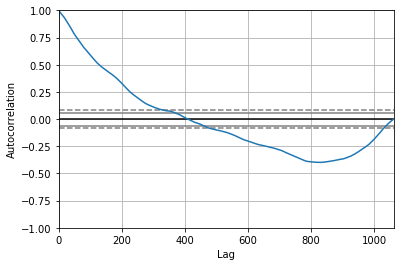

<Figure size 800x560 with 0 Axes>

Test MSE: 3.118


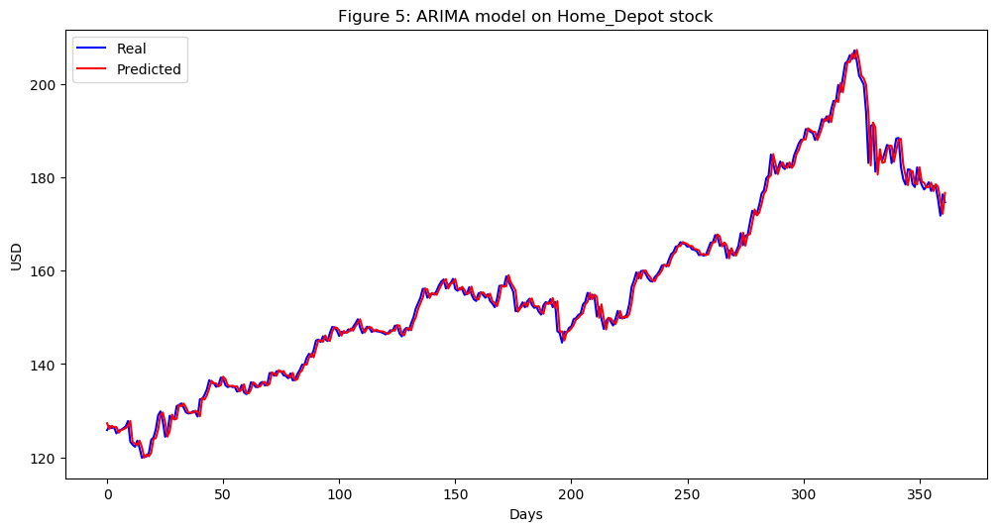

In [58]:


Home_Depot_series = SP500_TechIndicator['Home_Depot_Close']
Home_Depot_series_model = ARIMA(Home_Depot_series, order=(5, 1, 0))
Home_Depot_model_fit = Home_Depot_series_model.fit(disp=0)
print(Home_Depot_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Home_Depot_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Home_Depot_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Home_Depot_predictions = list()
for t in range(len(test)):
    Home_Depot_series_model = ARIMA(history, order=(5,1,0))
    Home_Depot_series_model_fit = Home_Depot_series_model.fit(disp=0)
    Home_Depot_output = Home_Depot_series_model_fit.forecast()
    yhat = Home_Depot_output[0]
    Home_Depot_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Home_Depot_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Home_Depot_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Home_Depot stock')
plt.legend()
plt.show()


#predictions
Home_Depot_predictions = pd.DataFrame({'Home_Depot_predictions':Home_Depot_predictions})
#Home_Depot_predictions.to_csv('Home_Depot_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:          D.Kohls_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1612.719
Method:                       css-mle   S.D. of innovations              1.106
Date:                Sun, 17 Mar 2019   AIC                           3239.438
Time:                        11:57:39   BIC                           3274.207
Sample:                             1   HQIC                          3252.615
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0055      0.035      0.158      0.874      -0.063       0.074
ar.L1.D.Kohls_Close    -0.0217      0.031     -0.706      0.480      -0.082       0.038
ar.L2.D.Kohls_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


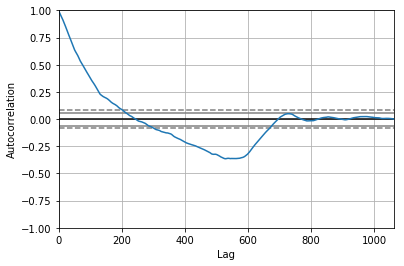

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 1.439


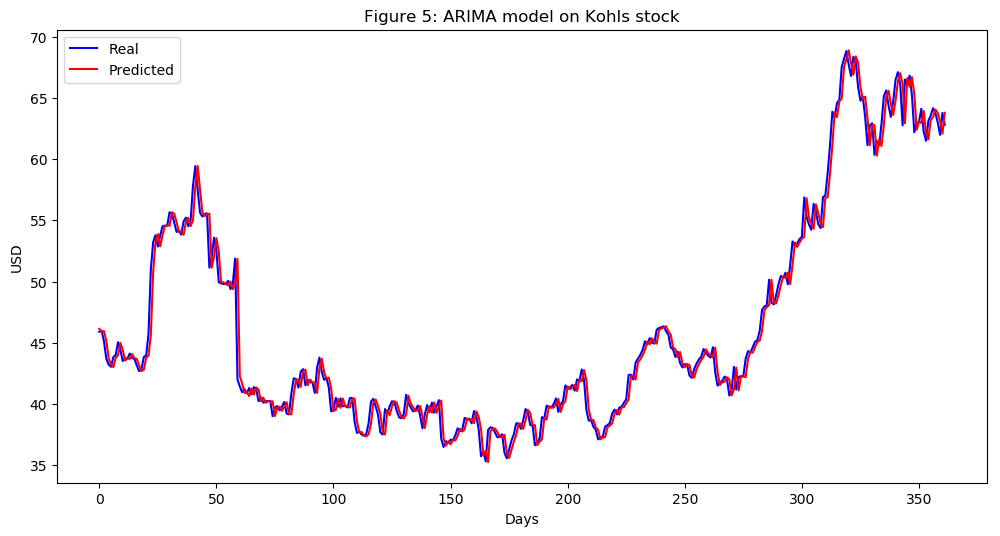

In [59]:


Kohls_series = SP500_TechIndicator['Kohls_Close']
Kohls_series_model = ARIMA(Kohls_series, order=(5, 1, 0))
Kohls_model_fit = Kohls_series_model.fit(disp=0)
print(Kohls_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Kohls_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Kohls_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Kohls_predictions = list()
for t in range(len(test)):
    Kohls_series_model = ARIMA(history, order=(5,1,0))
    Kohls_series_model_fit = Kohls_series_model.fit(disp=0)
    Kohls_output = Kohls_series_model_fit.forecast()
    yhat = Kohls_output[0]
    Kohls_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Kohls_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Kohls_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Kohls stock')
plt.legend()
plt.show()


#predictions
Kohls_predictions = pd.DataFrame({'Kohls_predictions':Kohls_predictions})
#Kohls_predictions.to_csv('Kohls_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:       D.L_Brands_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1760.763
Method:                       css-mle   S.D. of innovations              1.272
Date:                Sun, 17 Mar 2019   AIC                           3535.526
Time:                        11:58:31   BIC                           3570.295
Sample:                             1   HQIC                          3548.703
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     -0.0224      0.039     -0.573      0.567      -0.099       0.054
ar.L1.D.L_Brands_Close     0.0053      0.031      0.174      0.862      -0.055       0.065
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


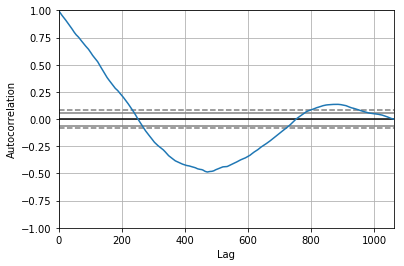

<Figure size 800x560 with 0 Axes>

Test MSE: 1.914


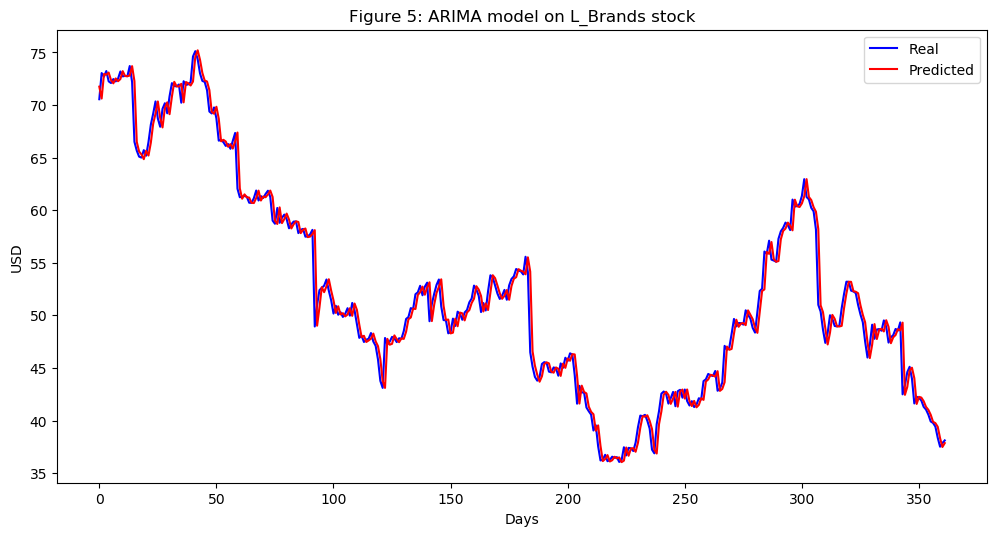

In [60]:


L_Brands_series = SP500_TechIndicator['L_Brands_Close']
L_Brands_series_model = ARIMA(L_Brands_series, order=(5, 1, 0))
L_Brands_model_fit = L_Brands_series_model.fit(disp=0)
print(L_Brands_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(L_Brands_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = L_Brands_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
L_Brands_predictions = list()
for t in range(len(test)):
    L_Brands_series_model = ARIMA(history, order=(5,1,0))
    L_Brands_series_model_fit = L_Brands_series_model.fit(disp=0)
    L_Brands_output = L_Brands_series_model_fit.forecast()
    yhat = L_Brands_output[0]
    L_Brands_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, L_Brands_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(L_Brands_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on L_Brands stock')
plt.legend()
plt.show()


#predictions
L_Brands_predictions = pd.DataFrame({'L_Brands_predictions':L_Brands_predictions})
#L_Brands_predictions.to_csv('L_Brands_predictions.csv')




                               ARIMA Model Results                               
Dep. Variable:     D.Leggett_Platt_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood                -875.026
Method:                          css-mle   S.D. of innovations              0.552
Date:                   Sun, 17 Mar 2019   AIC                           1764.052
Time:                           11:59:26   BIC                           1798.821
Sample:                                1   HQIC                          1777.229
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0119      0.017      0.719      0.473      -0.021       0.044
ar.L1.D.Leggett_Platt_Close    -0.0392      0.031     -1

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


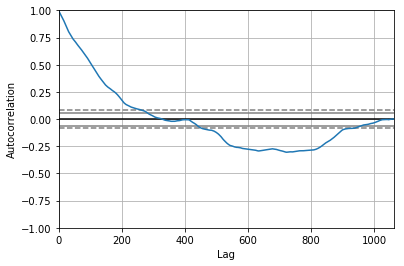

<Figure size 800x560 with 0 Axes>

Test MSE: 0.341


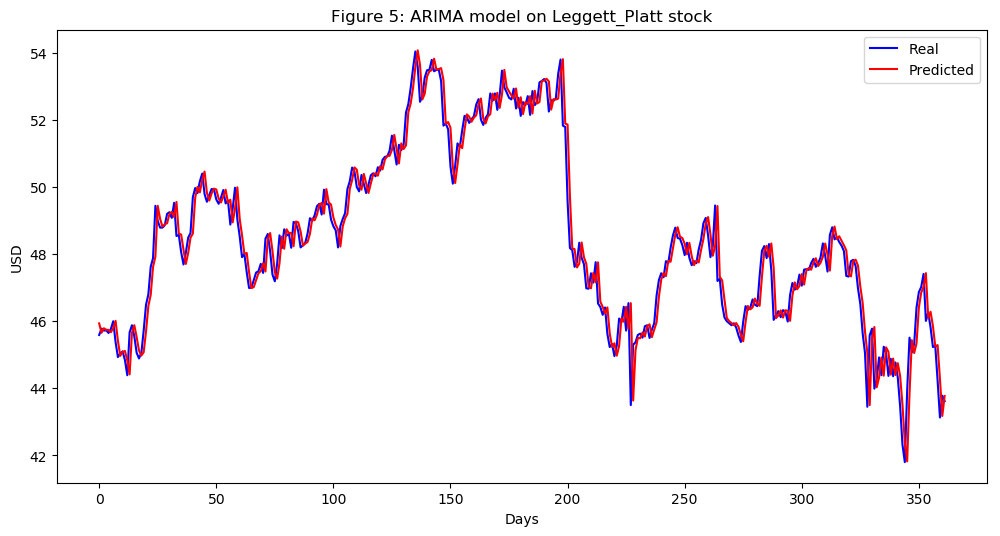

In [61]:


Leggett_Platt_series = SP500_TechIndicator['Leggett_Platt_Close']
Leggett_Platt_series_model = ARIMA(Leggett_Platt_series, order=(5, 1, 0))
Leggett_Platt_model_fit = Leggett_Platt_series_model.fit(disp=0)
print(Leggett_Platt_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Leggett_Platt_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Leggett_Platt_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Leggett_Platt_predictions = list()
for t in range(len(test)):
    Leggett_Platt_series_model = ARIMA(history, order=(5,1,0))
    Leggett_Platt_series_model_fit = Leggett_Platt_series_model.fit(disp=0)
    Leggett_Platt_output = Leggett_Platt_series_model_fit.forecast()
    yhat = Leggett_Platt_output[0]
    Leggett_Platt_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Leggett_Platt_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Leggett_Platt_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Leggett_Platt stock')
plt.legend()
plt.show()


#predictions
Leggett_Platt_predictions = pd.DataFrame({'Leggett_Platt_predictions':Leggett_Platt_predictions})
#Leggett_Platt_predictions.to_csv('Leggett_Platt_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:         D.Lennar_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1222.051
Method:                       css-mle   S.D. of innovations              0.766
Date:                Sun, 17 Mar 2019   AIC                           2458.102
Time:                        12:00:49   BIC                           2492.870
Sample:                             1   HQIC                          2471.278
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0180      0.023      0.777      0.437      -0.027       0.063
ar.L1.D.Lennar_Close     0.0310      0.031      1.010      0.313      -0.029       0.091
ar.L2.D.Lenn

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


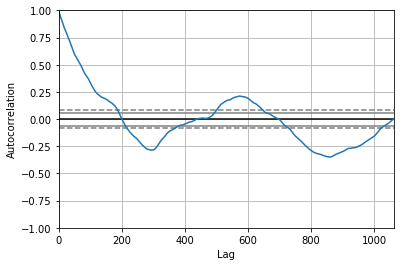

<Figure size 800x560 with 0 Axes>

Test MSE: 0.597


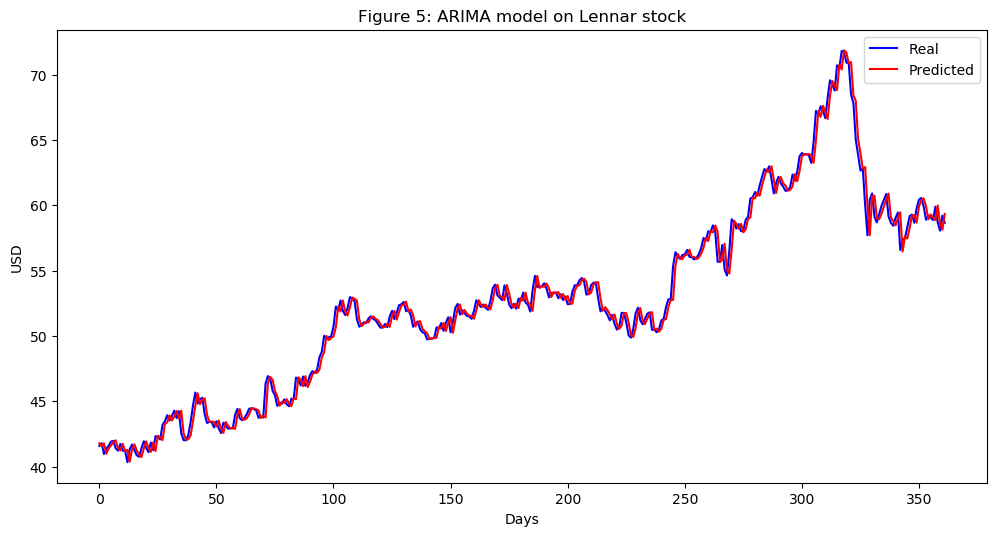

In [62]:


Lennar_series = SP500_TechIndicator['Lennar_Close']
Lennar_series_model = ARIMA(Lennar_series, order=(5, 1, 0))
Lennar_model_fit = Lennar_series_model.fit(disp=0)
print(Lennar_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Lennar_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Lennar_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Lennar_predictions = list()
for t in range(len(test)):
    Lennar_series_model = ARIMA(history, order=(5,1,0))
    Lennar_series_model_fit = Lennar_series_model.fit(disp=0)
    Lennar_output = Lennar_series_model_fit.forecast()
    yhat = Lennar_output[0]
    Lennar_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Lennar_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Lennar_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Lennar stock')
plt.legend()
plt.show()


#predictions
Lennar_predictions = pd.DataFrame({'Lennar_predictions':Lennar_predictions})
#Lennar_predictions.to_csv('Lennar_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:            D.LKQ_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -682.319
Method:                       css-mle   S.D. of innovations              0.460
Date:                Sun, 17 Mar 2019   AIC                           1378.638
Time:                        12:01:46   BIC                           1413.407
Sample:                             1   HQIC                          1391.815
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 0.0045      0.014      0.333      0.739      -0.022       0.031
ar.L1.D.LKQ_Close    -0.0076      0.031     -0.246      0.806      -0.068       0.053
ar.L2.D.LKQ_Close    -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


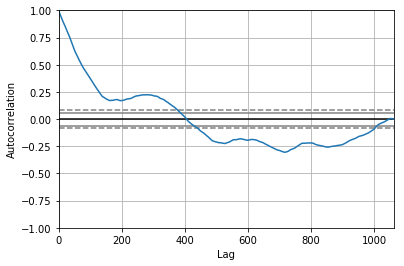

<Figure size 800x560 with 0 Axes>

Test MSE: 0.173


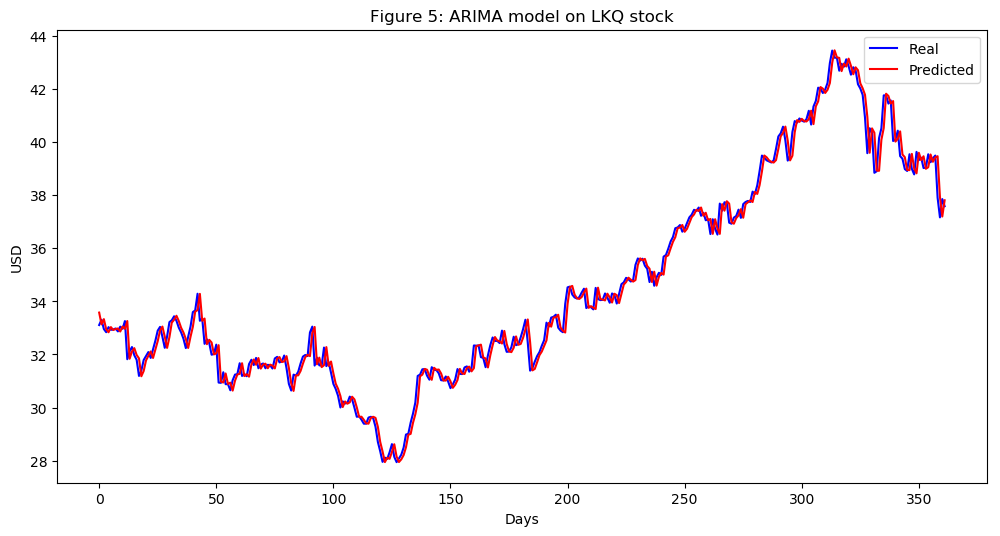

In [63]:


LKQ_series = SP500_TechIndicator['LKQ_Close']
LKQ_series_model = ARIMA(LKQ_series, order=(5, 1, 0))
LKQ_model_fit = LKQ_series_model.fit(disp=0)
print(LKQ_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(LKQ_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = LKQ_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
LKQ_predictions = list()
for t in range(len(test)):
    LKQ_series_model = ARIMA(history, order=(5,1,0))
    LKQ_series_model_fit = LKQ_series_model.fit(disp=0)
    LKQ_output = LKQ_series_model_fit.forecast()
    yhat = LKQ_output[0]
    LKQ_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, LKQ_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(LKQ_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on LKQ stock')
plt.legend()
plt.show()


#predictions
LKQ_predictions = pd.DataFrame({'LKQ_predictions':LKQ_predictions})
#LKQ_predictions.to_csv('LKQ_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:      D.Lowes_Cos_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1522.214
Method:                       css-mle   S.D. of innovations              1.016
Date:                Sun, 17 Mar 2019   AIC                           3058.428
Time:                        12:02:53   BIC                           3093.197
Sample:                             1   HQIC                          3071.604
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.0344      0.030      1.145      0.252      -0.024       0.093
ar.L1.D.Lowes_Cos_Close    -0.0644      0.031     -2.090      0.037      -0.125      -0.004


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


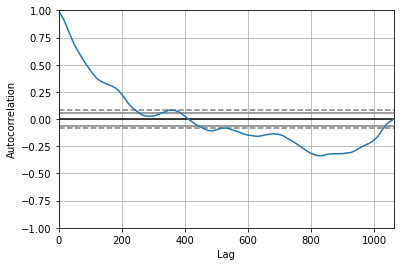

<Figure size 800x560 with 0 Axes>

Test MSE: 1.662


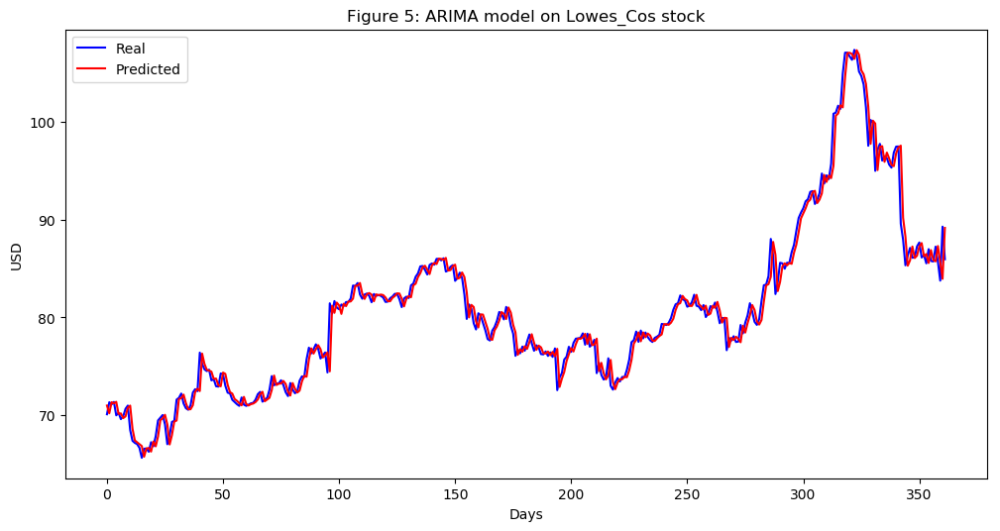

In [64]:


Lowes_Cos_series = SP500_TechIndicator['Lowes_Cos_Close']
Lowes_Cos_series_model = ARIMA(Lowes_Cos_series, order=(5, 1, 0))
Lowes_Cos_model_fit = Lowes_Cos_series_model.fit(disp=0)
print(Lowes_Cos_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Lowes_Cos_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Lowes_Cos_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Lowes_Cos_predictions = list()
for t in range(len(test)):
    Lowes_Cos_series_model = ARIMA(history, order=(5,1,0))
    Lowes_Cos_series_model_fit = Lowes_Cos_series_model.fit(disp=0)
    Lowes_Cos_output = Lowes_Cos_series_model_fit.forecast()
    yhat = Lowes_Cos_output[0]
    Lowes_Cos_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Lowes_Cos_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Lowes_Cos_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Lowes_Cos stock')
plt.legend()
plt.show()


#predictions
Lowes_Cos_predictions = pd.DataFrame({'Lowes_Cos_predictions':Lowes_Cos_predictions})
#Lowes_Cos_predictions.to_csv('Lowes_Cos_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:          D.Macys_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1348.487
Method:                       css-mle   S.D. of innovations              0.862
Date:                Sun, 17 Mar 2019   AIC                           2710.973
Time:                        12:03:49   BIC                           2745.742
Sample:                             1   HQIC                          2724.150
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                  -0.0242      0.029     -0.835      0.404      -0.081       0.033
ar.L1.D.Macys_Close     0.0180      0.031      0.586      0.558      -0.042       0.078
ar.L2.D.Macys_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


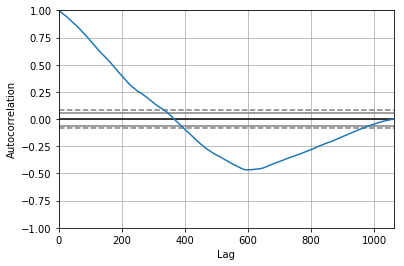

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.527


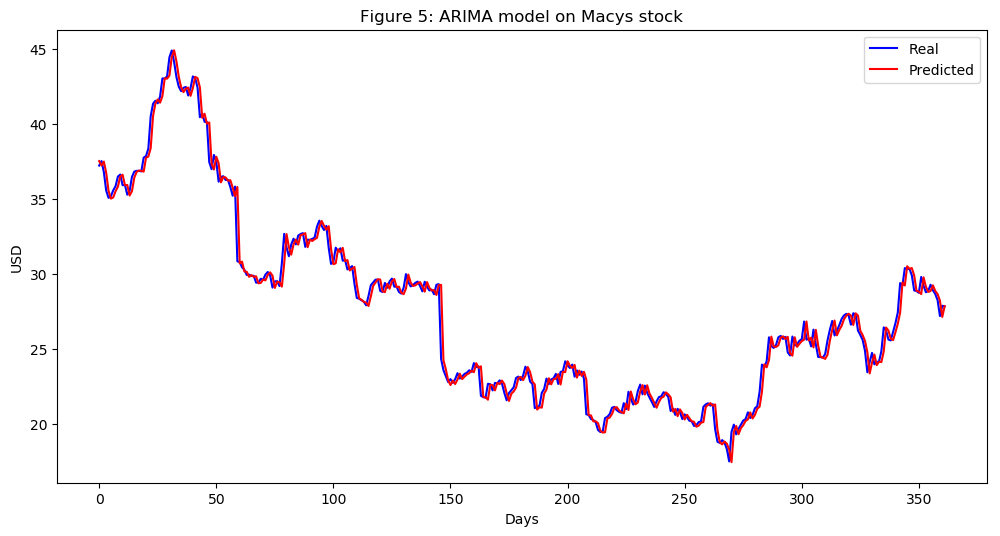

In [65]:


Macys_series = SP500_TechIndicator['Macys_Close']
Macys_series_model = ARIMA(Macys_series, order=(5, 1, 0))
Macys_model_fit = Macys_series_model.fit(disp=0)
print(Macys_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Macys_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Macys_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Macys_predictions = list()
for t in range(len(test)):
    Macys_series_model = ARIMA(history, order=(5,1,0))
    Macys_series_model_fit = Macys_series_model.fit(disp=0)
    Macys_output = Macys_series_model_fit.forecast()
    yhat = Macys_output[0]
    Macys_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Macys_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Macys_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Macys stock')
plt.legend()
plt.show()


#predictions
Macys_predictions = pd.DataFrame({'Macys_predictions':Macys_predictions})
#Macys_predictions.to_csv('Macys_predictions.csv')




                              ARIMA Model Results                               
Dep. Variable:     D.Marriott_Int_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -1641.230
Method:                         css-mle   S.D. of innovations              1.136
Date:                  Sun, 17 Mar 2019   AIC                           3296.461
Time:                          12:04:37   BIC                           3331.229
Sample:                               1   HQIC                          3309.637
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                          0.0813      0.034      2.421      0.016       0.015       0.147
ar.L1.D.Marriott_Int_Close    -0.0501      0.031     -1.627      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


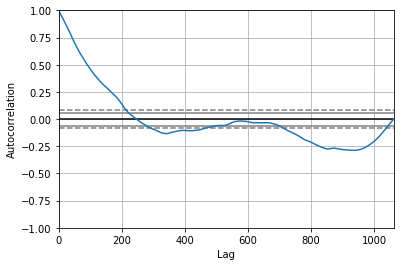

<Figure size 800x560 with 0 Axes>

Test MSE: 1.824


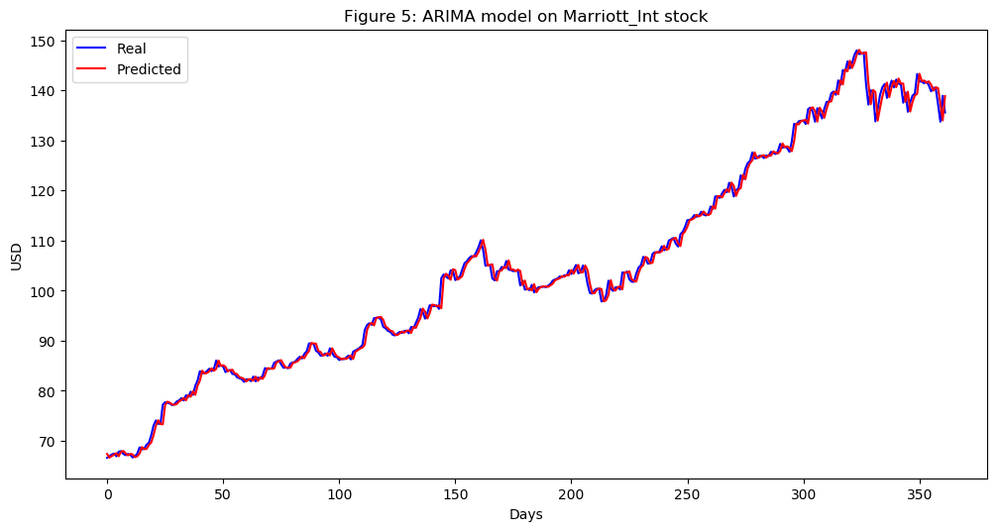

In [66]:


Marriott_Int_series = SP500_TechIndicator['Marriott_Int_Close']
Marriott_Int_series_model = ARIMA(Marriott_Int_series, order=(5, 1, 0))
Marriott_Int_model_fit = Marriott_Int_series_model.fit(disp=0)
print(Marriott_Int_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Marriott_Int_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Marriott_Int_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Marriott_Int_predictions = list()
for t in range(len(test)):
    Marriott_Int_series_model = ARIMA(history, order=(5,1,0))
    Marriott_Int_series_model_fit = Marriott_Int_series_model.fit(disp=0)
    Marriott_Int_output = Marriott_Int_series_model_fit.forecast()
    yhat = Marriott_Int_output[0]
    Marriott_Int_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Marriott_Int_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Marriott_Int_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Marriott_Int stock')
plt.legend()
plt.show()


#predictions
Marriott_Int_predictions = pd.DataFrame({'Marriott_Int_predictions':Marriott_Int_predictions})
#Marriott_Int_predictions.to_csv('Marriott_Int_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:         D.Mattel_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -873.615
Method:                       css-mle   S.D. of innovations              0.551
Date:                Sun, 17 Mar 2019   AIC                           1761.231
Time:                        12:05:31   BIC                           1795.999
Sample:                             1   HQIC                          1774.407
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -0.0324      0.016     -1.964      0.050      -0.065   -7.37e-05
ar.L1.D.Mattel_Close     0.0104      0.031      0.338      0.735      -0.050       0.071
ar.L2.D.Matt

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


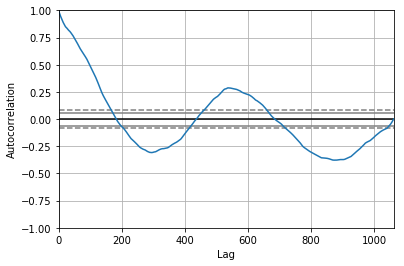

<Figure size 800x560 with 0 Axes>

Test MSE: 0.358


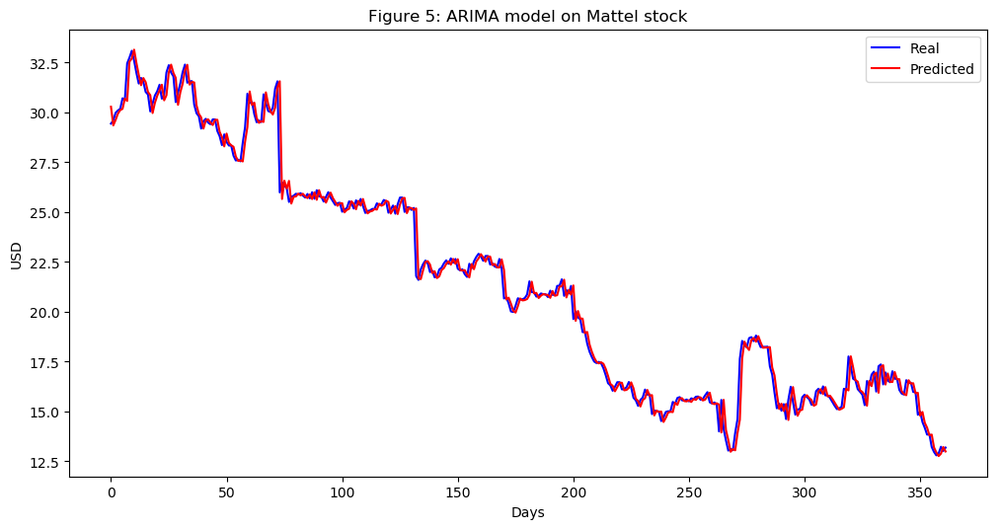

In [67]:


Mattel_series = SP500_TechIndicator['Mattel_Close']
Mattel_series_model = ARIMA(Mattel_series, order=(5, 1, 0))
Mattel_model_fit = Mattel_series_model.fit(disp=0)
print(Mattel_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Mattel_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Mattel_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Mattel_predictions = list()
for t in range(len(test)):
    Mattel_series_model = ARIMA(history, order=(5,1,0))
    Mattel_series_model_fit = Mattel_series_model.fit(disp=0)
    Mattel_output = Mattel_series_model_fit.forecast()
    yhat = Mattel_output[0]
    Mattel_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Mattel_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Mattel_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Mattel stock')
plt.legend()
plt.show()


#predictions
Mattel_predictions = pd.DataFrame({'Mattel_predictions':Mattel_predictions})
#Mattel_predictions.to_csv('Mattel_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:      D.McDonalds_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1706.903
Method:                       css-mle   S.D. of innovations              1.209
Date:                Sun, 17 Mar 2019   AIC                           3427.806
Time:                        12:06:45   BIC                           3462.575
Sample:                             1   HQIC                          3440.982
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.0571      0.033      1.724      0.085      -0.008       0.122
ar.L1.D.McDonalds_Close    -0.0266      0.031     -0.869      0.385      -0.087       0.033


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


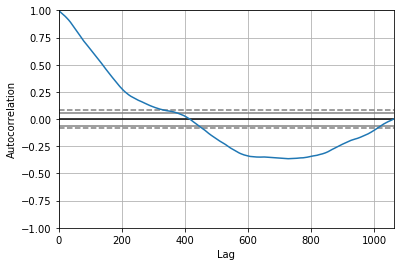

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 2.159


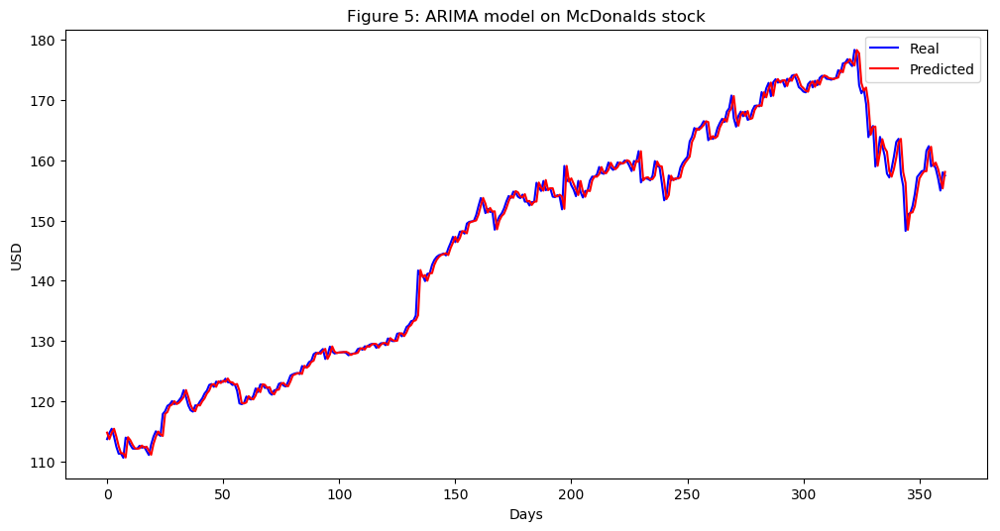

In [68]:


McDonalds_series = SP500_TechIndicator['McDonalds_Close']
McDonalds_series_model = ARIMA(McDonalds_series, order=(5, 1, 0))
McDonalds_model_fit = McDonalds_series_model.fit(disp=0)
print(McDonalds_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(McDonalds_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = McDonalds_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
McDonalds_predictions = list()
for t in range(len(test)):
    McDonalds_series_model = ARIMA(history, order=(5,1,0))
    McDonalds_series_model_fit = McDonalds_series_model.fit(disp=0)
    McDonalds_output = McDonalds_series_model_fit.forecast()
    yhat = McDonalds_output[0]
    McDonalds_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, McDonalds_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(McDonalds_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on McDonalds stock')
plt.legend()
plt.show()


#predictions
McDonalds_predictions = pd.DataFrame({'McDonalds_predictions':McDonalds_predictions})
#McDonalds_predictions.to_csv('McDonalds_predictions.csv')




                                     ARIMA Model Results                                     
Dep. Variable:     D.MGM_Resorts_International_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood                -737.050
Method:                                      css-mle   S.D. of innovations              0.485
Date:                               Sun, 17 Mar 2019   AIC                           1488.100
Time:                                       12:07:37   BIC                           1522.869
Sample:                                            1   HQIC                          1501.276
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


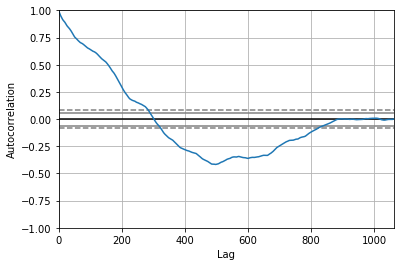

<Figure size 800x560 with 0 Axes>

Test MSE: 0.267


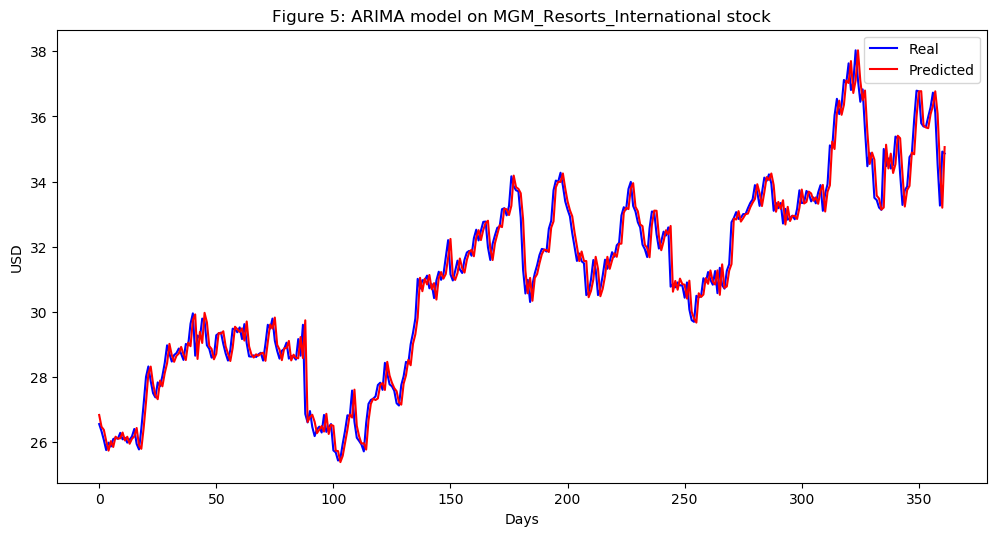

In [69]:


MGM_Resorts_International_series = SP500_TechIndicator['MGM_Resorts_International_Close']
MGM_Resorts_International_series_model = ARIMA(MGM_Resorts_International_series, order=(5, 1, 0))
MGM_Resorts_International_model_fit = MGM_Resorts_International_series_model.fit(disp=0)
print(MGM_Resorts_International_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(MGM_Resorts_International_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = MGM_Resorts_International_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
MGM_Resorts_International_predictions = list()
for t in range(len(test)):
    MGM_Resorts_International_series_model = ARIMA(history, order=(5,1,0))
    MGM_Resorts_International_series_model_fit = MGM_Resorts_International_series_model.fit(disp=0)
    MGM_Resorts_International_output = MGM_Resorts_International_series_model_fit.forecast()
    yhat = MGM_Resorts_International_output[0]
    MGM_Resorts_International_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, MGM_Resorts_International_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(MGM_Resorts_International_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on MGM_Resorts_International stock')
plt.legend()
plt.show()


#predictions
MGM_Resorts_International_predictions = pd.DataFrame({'MGM_Resorts_International_predictions':MGM_Resorts_International_predictions})
#MGM_Resorts_International_predictions.to_csv('MGM_Resorts_International_predictions.csv')




                                 ARIMA Model Results                                 
Dep. Variable:     D.Mohawk_Industries_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -2531.621
Method:                              css-mle   S.D. of innovations              2.630
Date:                       Sun, 17 Mar 2019   AIC                           5077.243
Time:                               12:09:00   BIC                           5112.011
Sample:                                    1   HQIC                          5090.419
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0749      0.076      0.981      0.327      -0.075       0.224
ar.L1.D.Moha

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


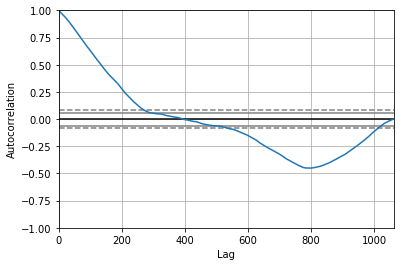

<Figure size 800x560 with 0 Axes>

Test MSE: 7.786


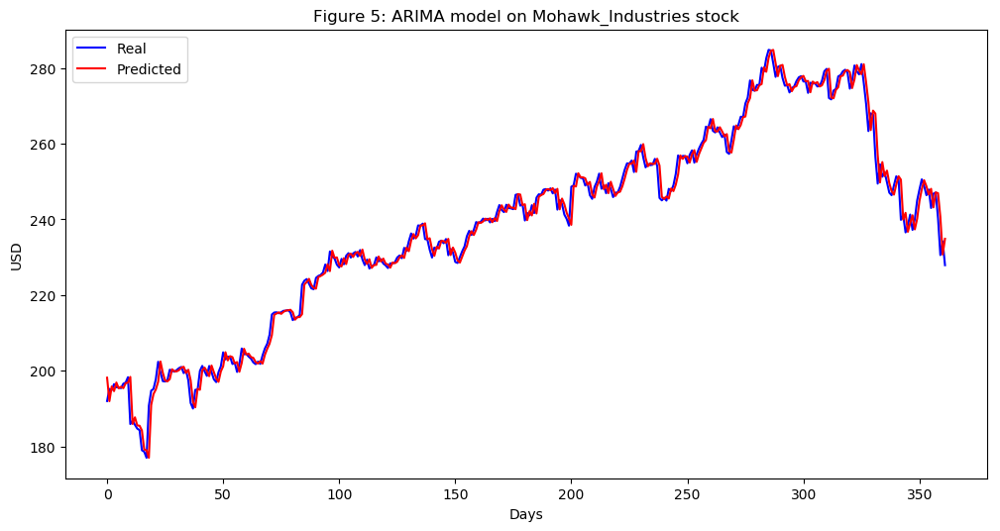

In [70]:


Mohawk_Industries_series = SP500_TechIndicator['Mohawk_Industries_Close']
Mohawk_Industries_series_model = ARIMA(Mohawk_Industries_series, order=(5, 1, 0))
Mohawk_Industries_model_fit = Mohawk_Industries_series_model.fit(disp=0)
print(Mohawk_Industries_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Mohawk_Industries_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Mohawk_Industries_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Mohawk_Industries_predictions = list()
for t in range(len(test)):
    Mohawk_Industries_series_model = ARIMA(history, order=(5,1,0))
    Mohawk_Industries_series_model_fit = Mohawk_Industries_series_model.fit(disp=0)
    Mohawk_Industries_output = Mohawk_Industries_series_model_fit.forecast()
    yhat = Mohawk_Industries_output[0]
    Mohawk_Industries_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Mohawk_Industries_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Mohawk_Industries_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Mohawk_Industries stock')
plt.legend()
plt.show()


#predictions
Mohawk_Industries_predictions = pd.DataFrame({'Mohawk_Industries_predictions':Mohawk_Industries_predictions})
#Mohawk_Industries_predictions.to_csv('Mohawk_Industries_predictions.csv')




                               ARIMA Model Results                               
Dep. Variable:     D.Newell_Brands_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -1194.160
Method:                          css-mle   S.D. of innovations              0.746
Date:                   Sun, 17 Mar 2019   AIC                           2402.321
Time:                           12:09:49   BIC                           2437.089
Sample:                                1   HQIC                          2415.497
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          -0.0067      0.021     -0.326      0.744      -0.047       0.034
ar.L1.D.Newell_Brands_Close     0.0316      0.031      1

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


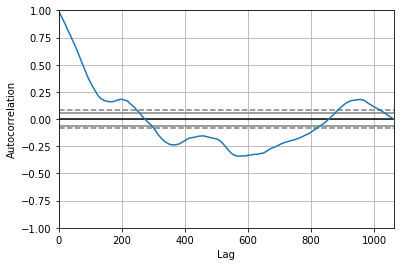

<Figure size 800x560 with 0 Axes>

Test MSE: 0.967


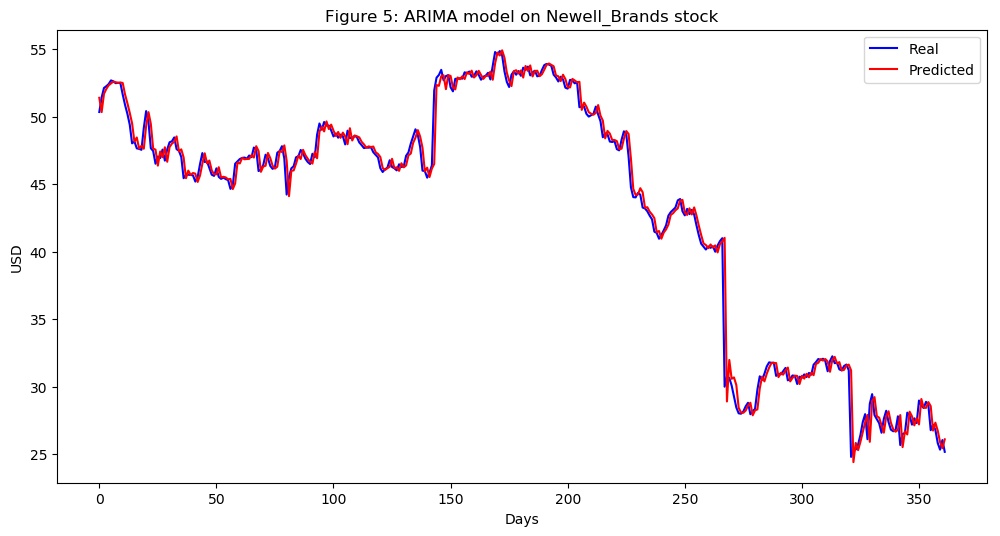

In [71]:


Newell_Brands_series = SP500_TechIndicator['Newell_Brands_Close']
Newell_Brands_series_model = ARIMA(Newell_Brands_series, order=(5, 1, 0))
Newell_Brands_model_fit = Newell_Brands_series_model.fit(disp=0)
print(Newell_Brands_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Newell_Brands_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Newell_Brands_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Newell_Brands_predictions = list()
for t in range(len(test)):
    Newell_Brands_series_model = ARIMA(history, order=(5,1,0))
    Newell_Brands_series_model_fit = Newell_Brands_series_model.fit(disp=0)
    Newell_Brands_output = Newell_Brands_series_model_fit.forecast()
    yhat = Newell_Brands_output[0]
    Newell_Brands_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Newell_Brands_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Newell_Brands_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Newell_Brands stock')
plt.legend()
plt.show()


#predictions
Newell_Brands_predictions = pd.DataFrame({'Newell_Brands_predictions':Newell_Brands_predictions})
#Newell_Brands_predictions.to_csv('Newell_Brands_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:           D.Nike_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2388.783
Method:                       css-mle   S.D. of innovations              2.299
Date:                Sun, 17 Mar 2019   AIC                           4791.566
Time:                        12:10:57   BIC                           4826.335
Sample:                             1   HQIC                          4804.742
                                                                              
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0118      0.071     -0.167      0.867      -0.151       0.127
ar.L1.D.Nike_Close     0.0174      0.031      0.567      0.571      -0.043       0.078
ar.L2.D.Nike_Close  

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


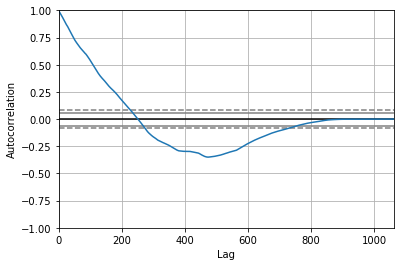

<Figure size 800x560 with 0 Axes>

Test MSE: 0.676


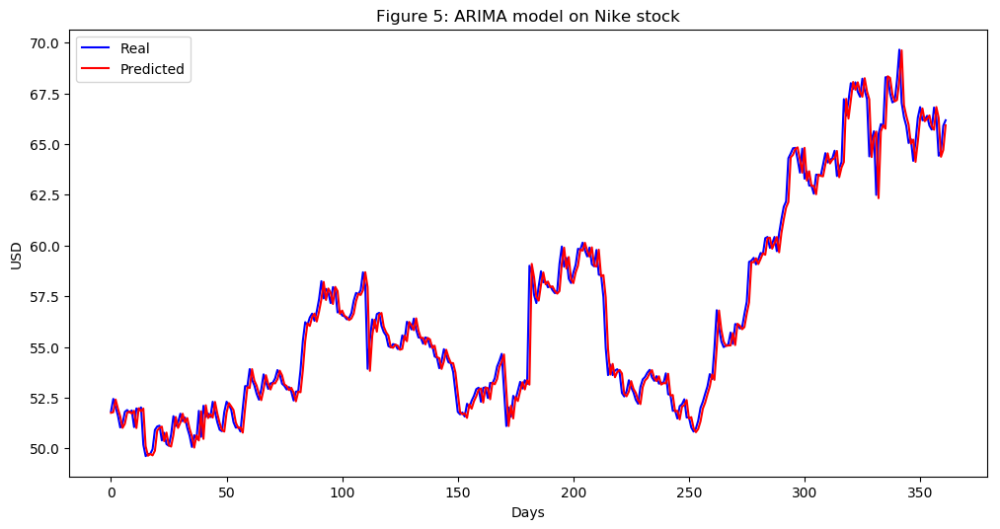

In [72]:


Nike_series = SP500_TechIndicator['Nike_Close']
Nike_series_model = ARIMA(Nike_series, order=(5, 1, 0))
Nike_model_fit = Nike_series_model.fit(disp=0)
print(Nike_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Nike_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Nike_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Nike_predictions = list()
for t in range(len(test)):
    Nike_series_model = ARIMA(history, order=(5,1,0))
    Nike_series_model_fit = Nike_series_model.fit(disp=0)
    Nike_output = Nike_series_model_fit.forecast()
    yhat = Nike_output[0]
    Nike_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Nike_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Nike_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Nike stock')
plt.legend()
plt.show()


#predictions
Nike_predictions = pd.DataFrame({'Nike_predictions':Nike_predictions})
#Nike_predictions.to_csv('Nike_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:      D.Nordstrom_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1595.147
Method:                       css-mle   S.D. of innovations              1.088
Date:                Sun, 17 Mar 2019   AIC                           3204.294
Time:                        12:11:41   BIC                           3239.063
Sample:                             1   HQIC                          3217.470
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                      -0.0138      0.032     -0.435      0.664      -0.076       0.048
ar.L1.D.Nordstrom_Close    -0.0201      0.031     -0.655      0.512      -0.080       0.040


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


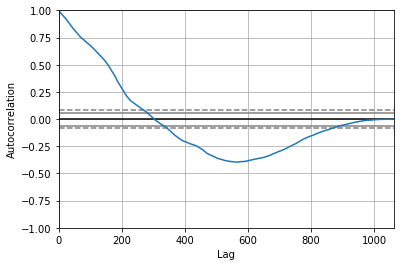

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 1.159


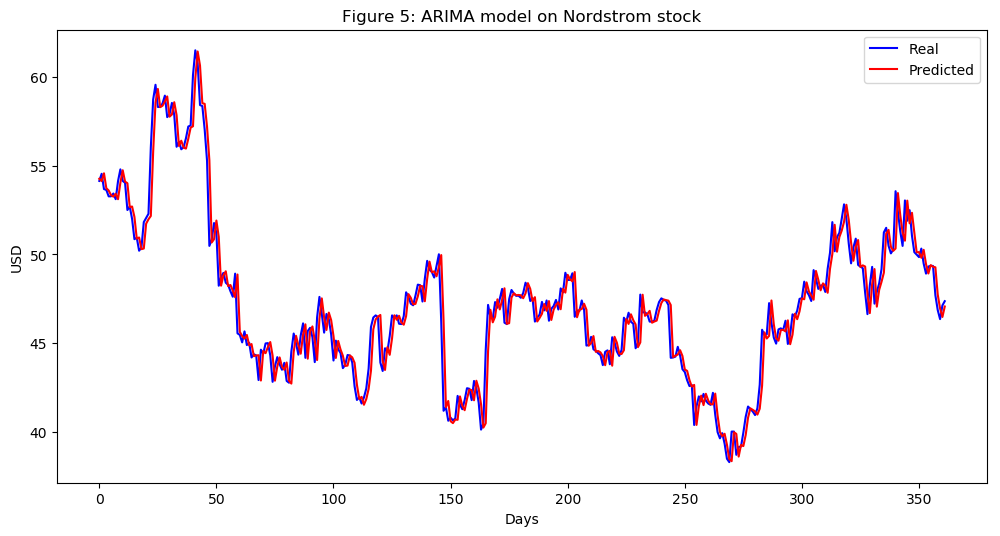

In [73]:


Nordstrom_series = SP500_TechIndicator['Nordstrom_Close']
Nordstrom_series_model = ARIMA(Nordstrom_series, order=(5, 1, 0))
Nordstrom_model_fit = Nordstrom_series_model.fit(disp=0)
print(Nordstrom_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Nordstrom_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Nordstrom_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Nordstrom_predictions = list()
for t in range(len(test)):
    Nordstrom_series_model = ARIMA(history, order=(5,1,0))
    Nordstrom_series_model_fit = Nordstrom_series_model.fit(disp=0)
    Nordstrom_output = Nordstrom_series_model_fit.forecast()
    yhat = Nordstrom_output[0]
    Nordstrom_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Nordstrom_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Nordstrom_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Nordstrom stock')
plt.legend()
plt.show()


#predictions
Nordstrom_predictions = pd.DataFrame({'Nordstrom_predictions':Nordstrom_predictions})
#Nordstrom_predictions.to_csv('Nordstrom_predictions.csv')




                                   ARIMA Model Results                                   
Dep. Variable:     D.Norwegian_Cruise_Line_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood               -1432.112
Method:                                  css-mle   S.D. of innovations              0.933
Date:                           Sun, 17 Mar 2019   AIC                           2878.224
Time:                                   12:12:28   BIC                           2912.992
Sample:                                        1   HQIC                          2891.400
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                   0.0162      0.028      0.583    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


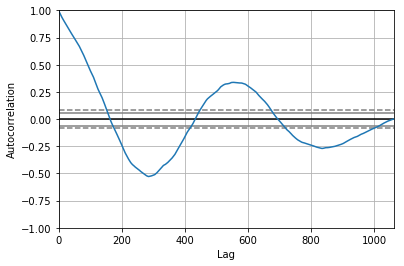

<Figure size 800x560 with 0 Axes>

Test MSE: 0.829


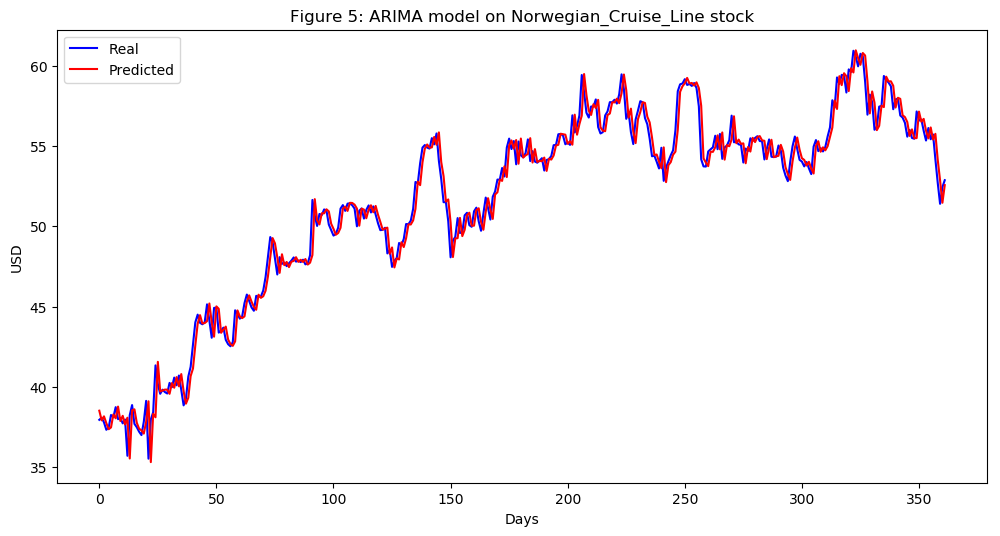

In [74]:


Norwegian_Cruise_Line_series = SP500_TechIndicator['Norwegian_Cruise_Line_Close']
Norwegian_Cruise_Line_series_model = ARIMA(Norwegian_Cruise_Line_series, order=(5, 1, 0))
Norwegian_Cruise_Line_model_fit = Norwegian_Cruise_Line_series_model.fit(disp=0)
print(Norwegian_Cruise_Line_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Norwegian_Cruise_Line_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Norwegian_Cruise_Line_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Norwegian_Cruise_Line_predictions = list()
for t in range(len(test)):
    Norwegian_Cruise_Line_series_model = ARIMA(history, order=(5,1,0))
    Norwegian_Cruise_Line_series_model_fit = Norwegian_Cruise_Line_series_model.fit(disp=0)
    Norwegian_Cruise_Line_output = Norwegian_Cruise_Line_series_model_fit.forecast()
    yhat = Norwegian_Cruise_Line_output[0]
    Norwegian_Cruise_Line_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Norwegian_Cruise_Line_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Norwegian_Cruise_Line_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Norwegian_Cruise_Line stock')
plt.legend()
plt.show()


#predictions
Norwegian_Cruise_Line_predictions = pd.DataFrame({'Norwegian_Cruise_Line_predictions':Norwegian_Cruise_Line_predictions})
#Norwegian_Cruise_Line_predictions.to_csv('Norwegian_Cruise_Line_predictions.csv')




                                 ARIMA Model Results                                  
Dep. Variable:     D.OReilly_Automotive_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -2831.257
Method:                               css-mle   S.D. of innovations              3.489
Date:                        Sun, 17 Mar 2019   AIC                           5676.514
Time:                                12:13:18   BIC                           5711.282
Sample:                                     1   HQIC                          5689.690
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.1039      0.102      1.017      0.309      -0.096       0.304
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


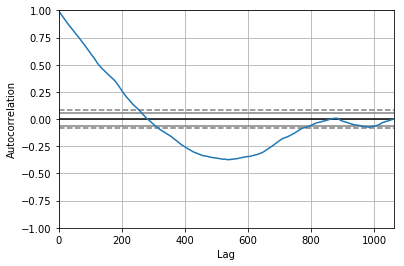

<Figure size 800x560 with 0 Axes>

Test MSE: 20.029


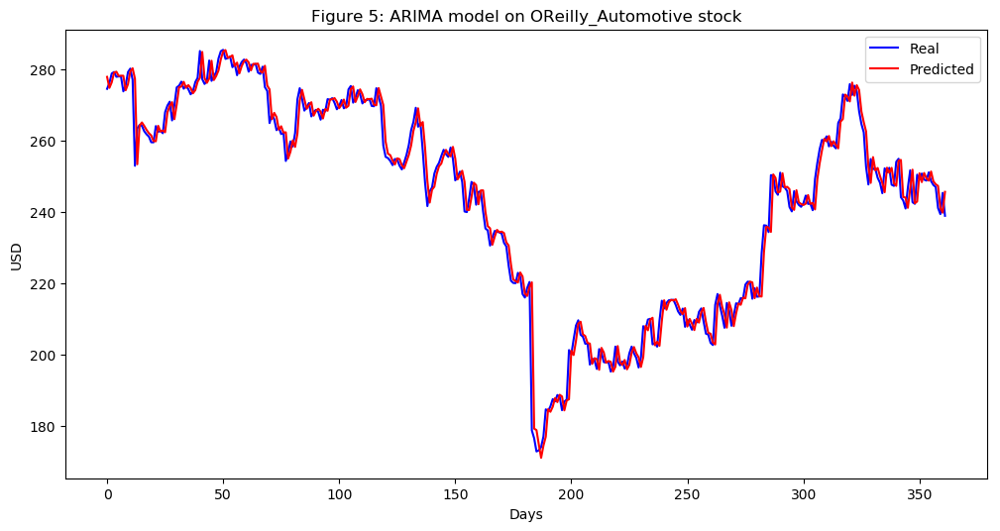

In [75]:


OReilly_Automotive_series = SP500_TechIndicator['OReilly_Automotive_Close']
OReilly_Automotive_series_model = ARIMA(OReilly_Automotive_series, order=(5, 1, 0))
OReilly_Automotive_model_fit = OReilly_Automotive_series_model.fit(disp=0)
print(OReilly_Automotive_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(OReilly_Automotive_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = OReilly_Automotive_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
OReilly_Automotive_predictions = list()
for t in range(len(test)):
    OReilly_Automotive_series_model = ARIMA(history, order=(5,1,0))
    OReilly_Automotive_series_model_fit = OReilly_Automotive_series_model.fit(disp=0)
    OReilly_Automotive_output = OReilly_Automotive_series_model_fit.forecast()
    yhat = OReilly_Automotive_output[0]
    OReilly_Automotive_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, OReilly_Automotive_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(OReilly_Automotive_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on OReilly_Automotive stock')
plt.legend()
plt.show()


#predictions
OReilly_Automotive_predictions = pd.DataFrame({'OReilly_Automotive_predictions':OReilly_Automotive_predictions})
#OReilly_Automotive_predictions.to_csv('OReilly_Automotive_predictions.csv')




                                 ARIMA Model Results                                 
Dep. Variable:     D.Polo_Ralph_Lauren_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -2369.317
Method:                              css-mle   S.D. of innovations              2.257
Date:                       Sun, 17 Mar 2019   AIC                           4752.634
Time:                               12:14:02   BIC                           4787.402
Sample:                                    1   HQIC                          4765.810
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                              -0.0630      0.072     -0.880      0.379      -0.203       0.077
ar.L1.D.Polo

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


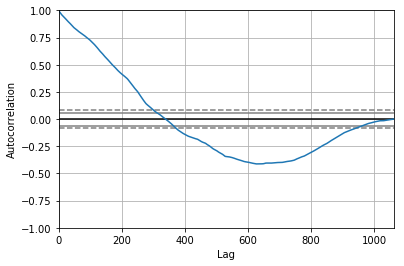

<Figure size 800x560 with 0 Axes>

Test MSE: 2.906


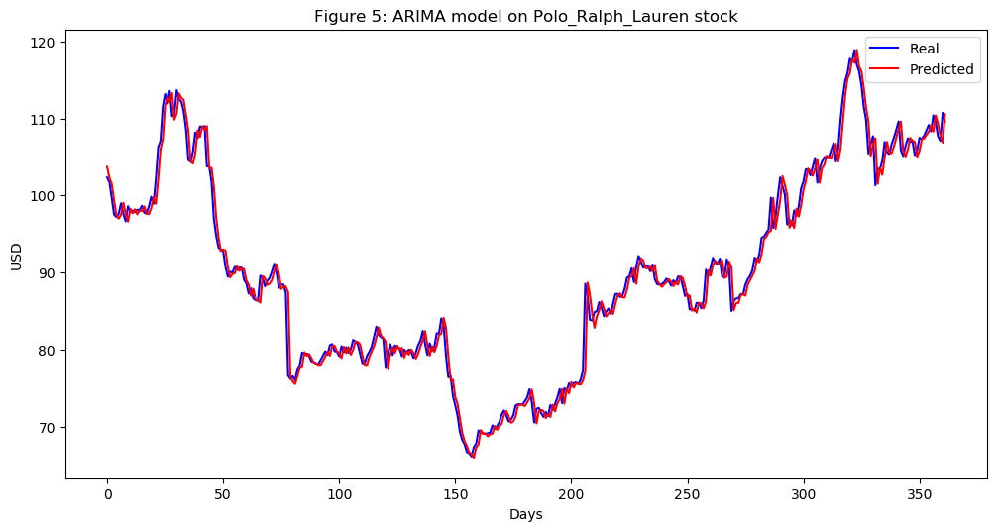

In [76]:


Polo_Ralph_Lauren_series = SP500_TechIndicator['Polo_Ralph_Lauren_Close']
Polo_Ralph_Lauren_series_model = ARIMA(Polo_Ralph_Lauren_series, order=(5, 1, 0))
Polo_Ralph_Lauren_model_fit = Polo_Ralph_Lauren_series_model.fit(disp=0)
print(Polo_Ralph_Lauren_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Polo_Ralph_Lauren_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Polo_Ralph_Lauren_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Polo_Ralph_Lauren_predictions = list()
for t in range(len(test)):
    Polo_Ralph_Lauren_series_model = ARIMA(history, order=(5,1,0))
    Polo_Ralph_Lauren_series_model_fit = Polo_Ralph_Lauren_series_model.fit(disp=0)
    Polo_Ralph_Lauren_output = Polo_Ralph_Lauren_series_model_fit.forecast()
    yhat = Polo_Ralph_Lauren_output[0]
    Polo_Ralph_Lauren_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Polo_Ralph_Lauren_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Polo_Ralph_Lauren_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Polo_Ralph_Lauren stock')
plt.legend()
plt.show()


#predictions
Polo_Ralph_Lauren_predictions = pd.DataFrame({'Polo_Ralph_Lauren_predictions':Polo_Ralph_Lauren_predictions})
#Polo_Ralph_Lauren_predictions.to_csv('Polo_Ralph_Lauren_predictions.csv')




                              ARIMA Model Results                              
Dep. Variable:     D.Pulte_Homes_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood                -375.440
Method:                        css-mle   S.D. of innovations              0.345
Date:                 Sun, 17 Mar 2019   AIC                            764.880
Time:                         12:14:51   BIC                            799.649
Sample:                              1   HQIC                           778.057
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0084      0.011      0.793      0.428      -0.012       0.029
ar.L1.D.Pulte_Homes_Close    -0.0114      0.031     -0.372      0.710      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


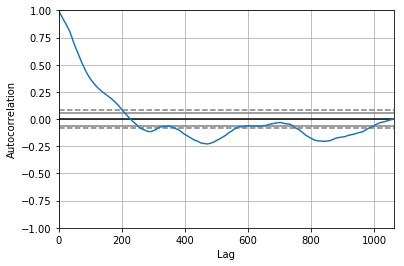

<Figure size 800x560 with 0 Axes>

Test MSE: 0.125


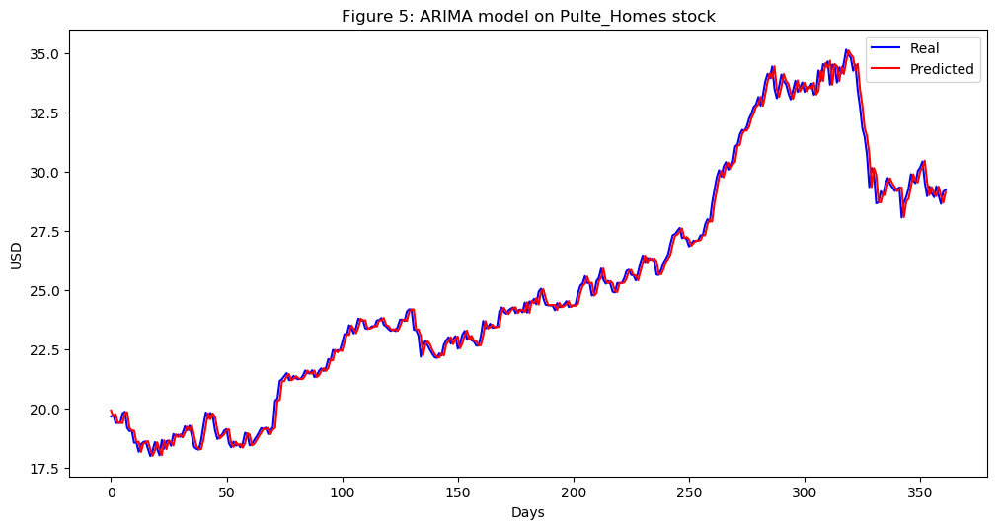

In [77]:


Pulte_Homes_series = SP500_TechIndicator['Pulte_Homes_Close']
Pulte_Homes_series_model = ARIMA(Pulte_Homes_series, order=(5, 1, 0))
Pulte_Homes_model_fit = Pulte_Homes_series_model.fit(disp=0)
print(Pulte_Homes_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Pulte_Homes_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Pulte_Homes_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Pulte_Homes_predictions = list()
for t in range(len(test)):
    Pulte_Homes_series_model = ARIMA(history, order=(5,1,0))
    Pulte_Homes_series_model_fit = Pulte_Homes_series_model.fit(disp=0)
    Pulte_Homes_output = Pulte_Homes_series_model_fit.forecast()
    yhat = Pulte_Homes_output[0]
    Pulte_Homes_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Pulte_Homes_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Pulte_Homes_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Pulte_Homes stock')
plt.legend()
plt.show()


#predictions
Pulte_Homes_predictions = pd.DataFrame({'Pulte_Homes_predictions':Pulte_Homes_predictions})
#Pulte_Homes_predictions.to_csv('Pulte_Homes_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:       D.PVH_Corp_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2189.946
Method:                       css-mle   S.D. of innovations              1.906
Date:                Sun, 17 Mar 2019   AIC                           4393.892
Time:                        12:15:47   BIC                           4428.661
Sample:                             1   HQIC                          4407.069
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0069      0.056      0.125      0.901      -0.102       0.116
ar.L1.D.PVH_Corp_Close    -0.0140      0.031     -0.457      0.648      -0.074       0.046
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


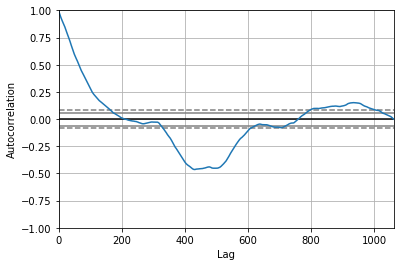

<Figure size 800x560 with 0 Axes>

Test MSE: 3.376


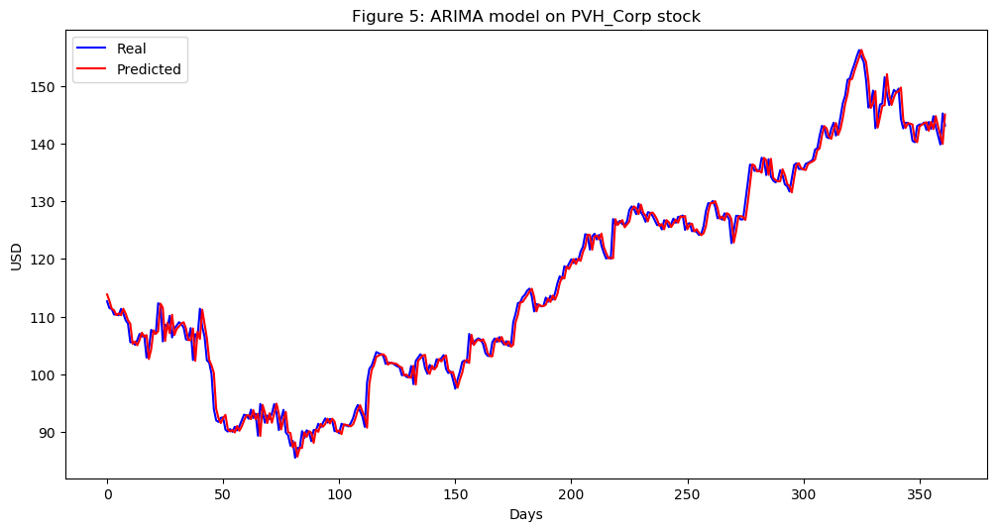

In [78]:


PVH_Corp_series = SP500_TechIndicator['PVH_Corp_Close']
PVH_Corp_series_model = ARIMA(PVH_Corp_series, order=(5, 1, 0))
PVH_Corp_model_fit = PVH_Corp_series_model.fit(disp=0)
print(PVH_Corp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(PVH_Corp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = PVH_Corp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
PVH_Corp_predictions = list()
for t in range(len(test)):
    PVH_Corp_series_model = ARIMA(history, order=(5,1,0))
    PVH_Corp_series_model_fit = PVH_Corp_series_model.fit(disp=0)
    PVH_Corp_output = PVH_Corp_series_model_fit.forecast()
    yhat = PVH_Corp_output[0]
    PVH_Corp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, PVH_Corp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(PVH_Corp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on PVH_Corp stock')
plt.legend()
plt.show()


#predictions
PVH_Corp_predictions = pd.DataFrame({'PVH_Corp_predictions':PVH_Corp_predictions})
#PVH_Corp_predictions.to_csv('PVH_Corp_predictions.csv')




                              ARIMA Model Results                              
Dep. Variable:     D.Ross_Stores_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -2131.196
Method:                        css-mle   S.D. of innovations              1.803
Date:                 Sun, 17 Mar 2019   AIC                           4276.392
Time:                         12:16:33   BIC                           4311.160
Sample:                              1   HQIC                          4289.568
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0019      0.052      0.036      0.971      -0.100       0.104
ar.L1.D.Ross_Stores_Close    -0.0125      0.031     -0.409      0.683      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


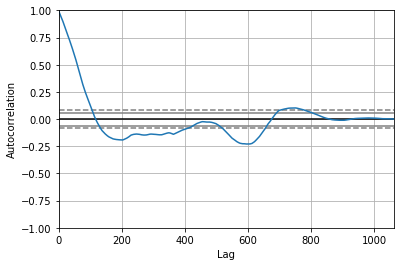

<Figure size 800x560 with 0 Axes>

Test MSE: 0.985


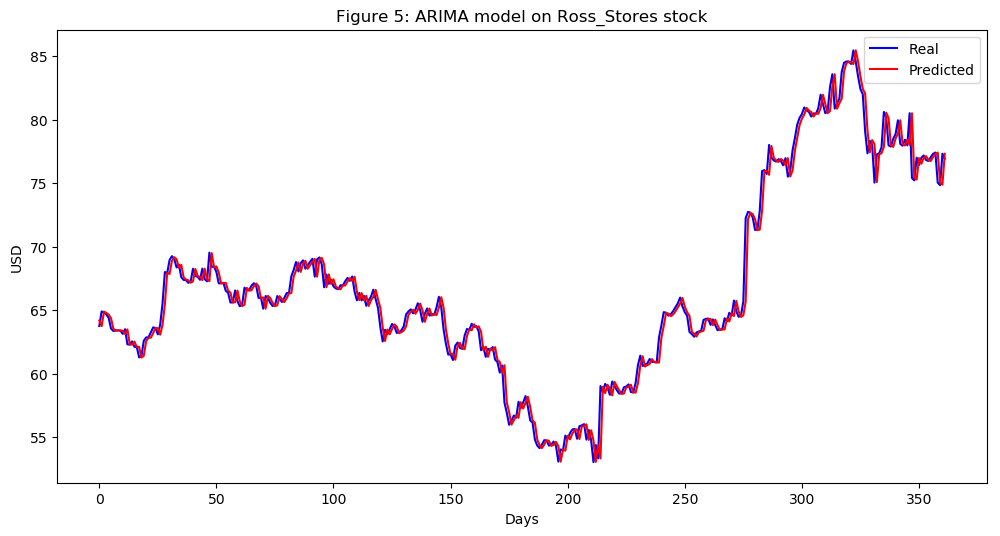

In [79]:


Ross_Stores_series = SP500_TechIndicator['Ross_Stores_Close']
Ross_Stores_series_model = ARIMA(Ross_Stores_series, order=(5, 1, 0))
Ross_Stores_model_fit = Ross_Stores_series_model.fit(disp=0)
print(Ross_Stores_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Ross_Stores_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Ross_Stores_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Ross_Stores_predictions = list()
for t in range(len(test)):
    Ross_Stores_series_model = ARIMA(history, order=(5,1,0))
    Ross_Stores_series_model_fit = Ross_Stores_series_model.fit(disp=0)
    Ross_Stores_output = Ross_Stores_series_model_fit.forecast()
    yhat = Ross_Stores_output[0]
    Ross_Stores_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Ross_Stores_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Ross_Stores_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Ross_Stores stock')
plt.legend()
plt.show()


#predictions
Ross_Stores_predictions = pd.DataFrame({'Ross_Stores_predictions':Ross_Stores_predictions})
#Ross_Stores_predictions.to_csv('Ross_Stores_predictions.csv')




                                    ARIMA Model Results                                    
Dep. Variable:     D.Royal_Caribbean_Cruises_Close   No. Observations:                 1061
Model:                              ARIMA(5, 1, 0)   Log Likelihood               -2012.063
Method:                                    css-mle   S.D. of innovations              1.612
Date:                             Sun, 17 Mar 2019   AIC                           4038.126
Time:                                     12:17:15   BIC                           4072.895
Sample:                                          1   HQIC                          4051.303
                                                                                           
                                            coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------
const                                     0.0673    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


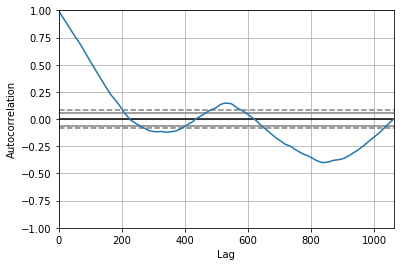

<Figure size 800x560 with 0 Axes>

Test MSE: 2.710


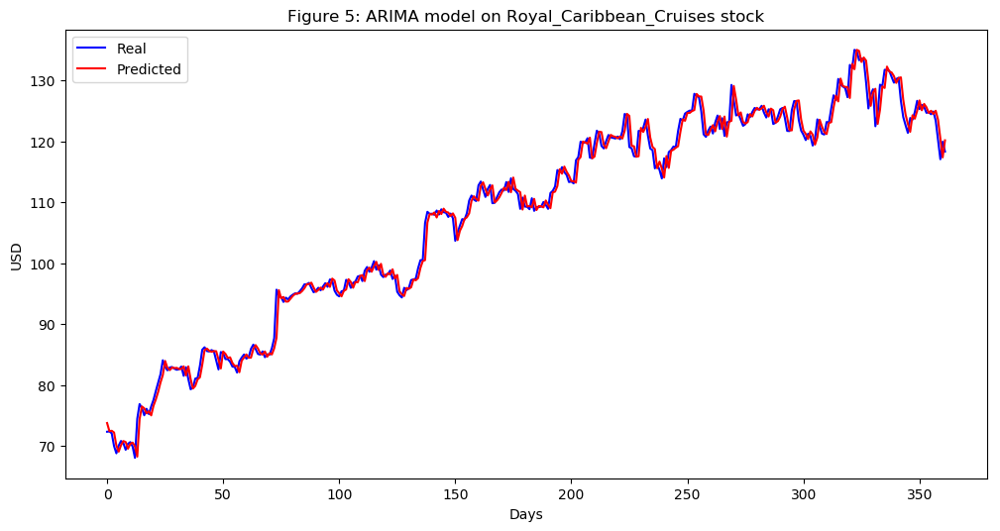

In [80]:


Royal_Caribbean_Cruises_series = SP500_TechIndicator['Royal_Caribbean_Cruises_Close']
Royal_Caribbean_Cruises_series_model = ARIMA(Royal_Caribbean_Cruises_series, order=(5, 1, 0))
Royal_Caribbean_Cruises_model_fit = Royal_Caribbean_Cruises_series_model.fit(disp=0)
print(Royal_Caribbean_Cruises_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Royal_Caribbean_Cruises_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Royal_Caribbean_Cruises_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Royal_Caribbean_Cruises_predictions = list()
for t in range(len(test)):
    Royal_Caribbean_Cruises_series_model = ARIMA(history, order=(5,1,0))
    Royal_Caribbean_Cruises_series_model_fit = Royal_Caribbean_Cruises_series_model.fit(disp=0)
    Royal_Caribbean_Cruises_output = Royal_Caribbean_Cruises_series_model_fit.forecast()
    yhat = Royal_Caribbean_Cruises_output[0]
    Royal_Caribbean_Cruises_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Royal_Caribbean_Cruises_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Royal_Caribbean_Cruises_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Royal_Caribbean_Cruises stock')
plt.legend()
plt.show()


#predictions
Royal_Caribbean_Cruises_predictions = pd.DataFrame({'Royal_Caribbean_Cruises_predictions':Royal_Caribbean_Cruises_predictions})
#Royal_Caribbean_Cruises_predictions.to_csv('Royal_Caribbean_Cruises_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:      D.Starbucks_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2036.856
Method:                       css-mle   S.D. of innovations              1.650
Date:                Sun, 17 Mar 2019   AIC                           4087.712
Time:                        12:18:00   BIC                           4122.481
Sample:                             1   HQIC                          4100.889
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                      -0.0197      0.049     -0.404      0.686      -0.115       0.076
ar.L1.D.Starbucks_Close    -0.0216      0.031     -0.704      0.482      -0.082       0.039


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


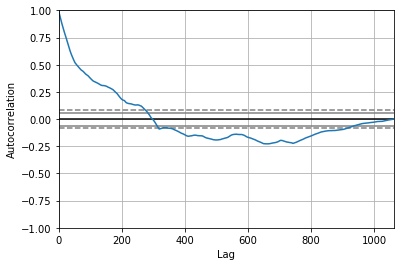

<Figure size 800x560 with 0 Axes>

Test MSE: 0.407


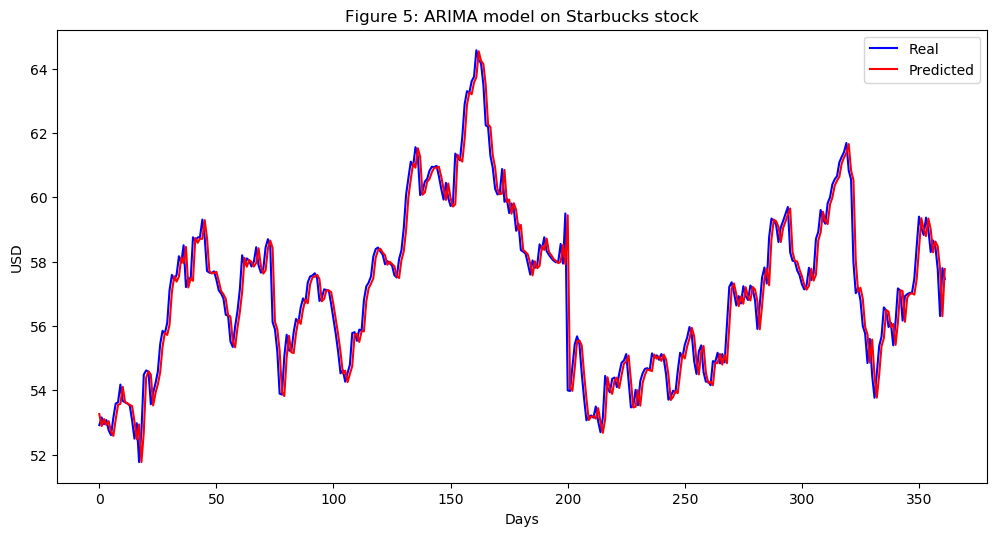

In [81]:


Starbucks_series = SP500_TechIndicator['Starbucks_Close']
Starbucks_series_model = ARIMA(Starbucks_series, order=(5, 1, 0))
Starbucks_model_fit = Starbucks_series_model.fit(disp=0)
print(Starbucks_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Starbucks_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Starbucks_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Starbucks_predictions = list()
for t in range(len(test)):
    Starbucks_series_model = ARIMA(history, order=(5,1,0))
    Starbucks_series_model_fit = Starbucks_series_model.fit(disp=0)
    Starbucks_output = Starbucks_series_model_fit.forecast()
    yhat = Starbucks_output[0]
    Starbucks_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Starbucks_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Starbucks_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Starbucks stock')
plt.legend()
plt.show()


#predictions
Starbucks_predictions = pd.DataFrame({'Starbucks_predictions':Starbucks_predictions})
#Starbucks_predictions.to_csv('Starbucks_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:         D.Target_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1541.372
Method:                       css-mle   S.D. of innovations              1.034
Date:                Sun, 17 Mar 2019   AIC                           3096.744
Time:                        12:18:43   BIC                           3131.513
Sample:                             1   HQIC                          3109.921
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0047      0.032      0.147      0.883      -0.058       0.067
ar.L1.D.Target_Close     0.0288      0.031      0.937      0.349      -0.031       0.089
ar.L2.D.Targ

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


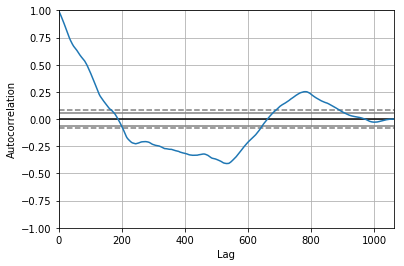

<Figure size 800x560 with 0 Axes>

Test MSE: 1.403


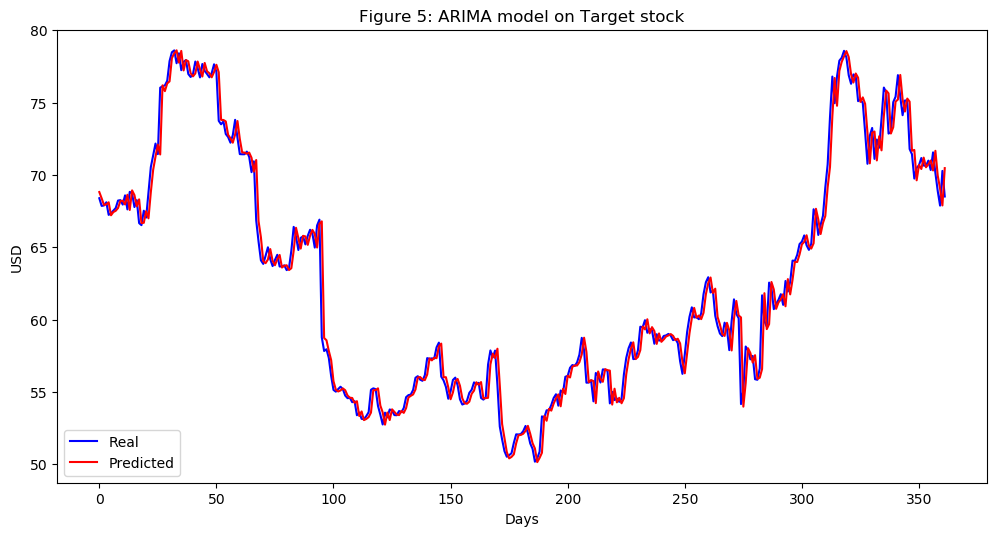

In [82]:


Target_series = SP500_TechIndicator['Target_Close']
Target_series_model = ARIMA(Target_series, order=(5, 1, 0))
Target_model_fit = Target_series_model.fit(disp=0)
print(Target_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Target_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Target_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Target_predictions = list()
for t in range(len(test)):
    Target_series_model = ARIMA(history, order=(5,1,0))
    Target_series_model_fit = Target_series_model.fit(disp=0)
    Target_output = Target_series_model_fit.forecast()
    yhat = Target_output[0]
    Target_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Target_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Target_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Target stock')
plt.legend()
plt.show()


#predictions
Target_predictions = pd.DataFrame({'Target_predictions':Target_predictions})
#Target_predictions.to_csv('Target_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:        D.Tiffany_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1832.225
Method:                       css-mle   S.D. of innovations              1.361
Date:                Sun, 17 Mar 2019   AIC                           3678.450
Time:                        12:19:32   BIC                           3713.219
Sample:                             1   HQIC                          3691.627
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0035      0.041      0.086      0.931      -0.077       0.084
ar.L1.D.Tiffany_Close     0.0080      0.031      0.260      0.795      -0.052       0.068
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


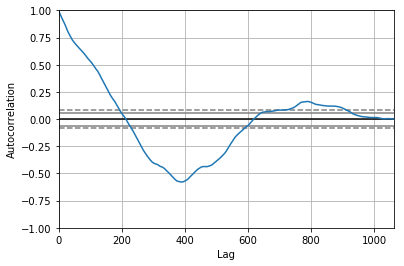

<Figure size 800x560 with 0 Axes>

Test MSE: 1.652


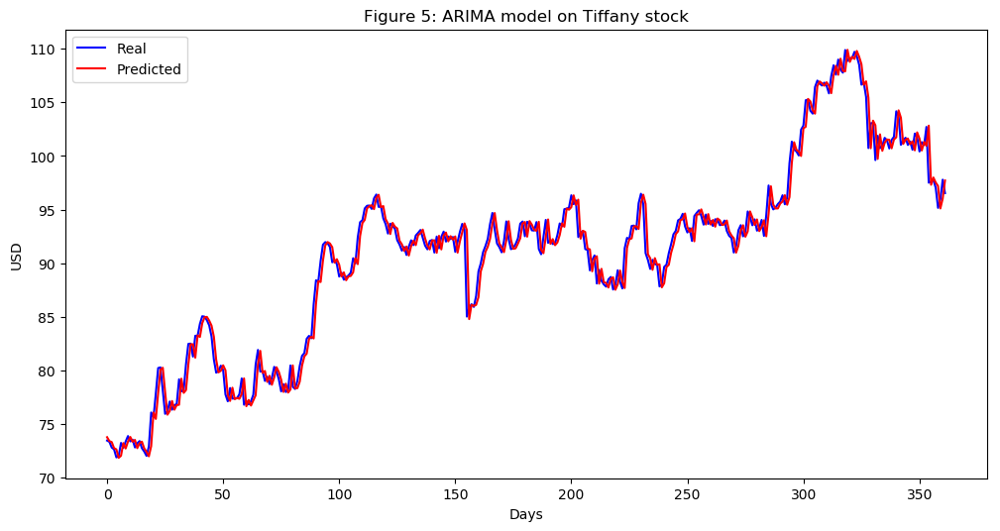

In [83]:


Tiffany_series = SP500_TechIndicator['Tiffany_Close']
Tiffany_series_model = ARIMA(Tiffany_series, order=(5, 1, 0))
Tiffany_model_fit = Tiffany_series_model.fit(disp=0)
print(Tiffany_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Tiffany_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Tiffany_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Tiffany_predictions = list()
for t in range(len(test)):
    Tiffany_series_model = ARIMA(history, order=(5,1,0))
    Tiffany_series_model_fit = Tiffany_series_model.fit(disp=0)
    Tiffany_output = Tiffany_series_model_fit.forecast()
    yhat = Tiffany_output[0]
    Tiffany_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Tiffany_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Tiffany_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Tiffany stock')
plt.legend()
plt.show()


#predictions
Tiffany_predictions = pd.DataFrame({'Tiffany_predictions':Tiffany_predictions})
#Tiffany_predictions.to_csv('Tiffany_predictions.csv')




                               ARIMA Model Results                               
Dep. Variable:     D.TJX_Companies_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -1361.662
Method:                          css-mle   S.D. of innovations              0.873
Date:                   Sun, 17 Mar 2019   AIC                           2737.324
Time:                           12:20:15   BIC                           2772.092
Sample:                                1   HQIC                          2750.500
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0160      0.022      0.739      0.460      -0.026       0.058
ar.L1.D.TJX_Companies_Close    -0.0733      0.031     -2

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


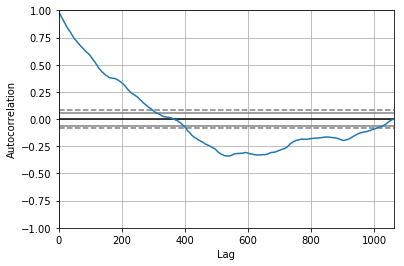

<Figure size 800x560 with 0 Axes>

Test MSE: 0.737


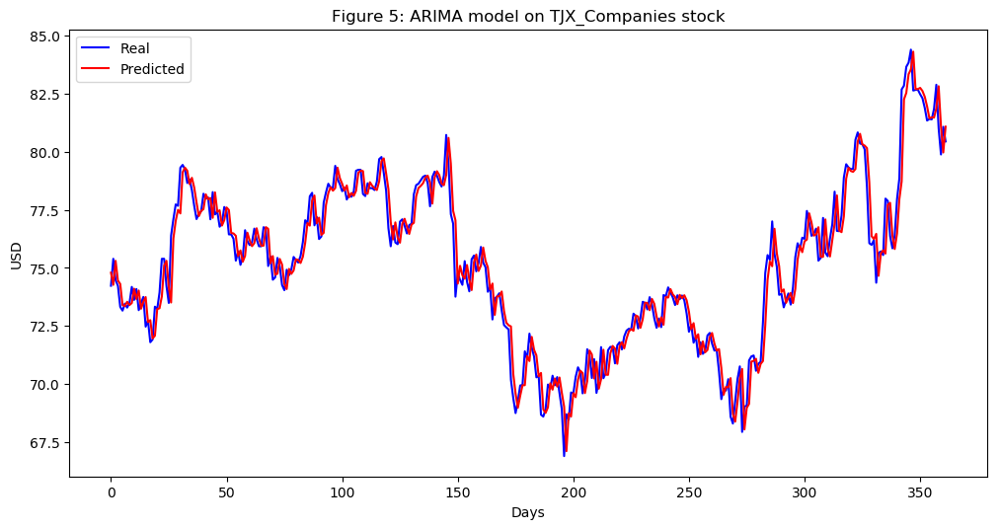

In [84]:


TJX_Companies_series = SP500_TechIndicator['TJX_Companies_Close']
TJX_Companies_series_model = ARIMA(TJX_Companies_series, order=(5, 1, 0))
TJX_Companies_model_fit = TJX_Companies_series_model.fit(disp=0)
print(TJX_Companies_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(TJX_Companies_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = TJX_Companies_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
TJX_Companies_predictions = list()
for t in range(len(test)):
    TJX_Companies_series_model = ARIMA(history, order=(5,1,0))
    TJX_Companies_series_model_fit = TJX_Companies_series_model.fit(disp=0)
    TJX_Companies_output = TJX_Companies_series_model_fit.forecast()
    yhat = TJX_Companies_output[0]
    TJX_Companies_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, TJX_Companies_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(TJX_Companies_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on TJX_Companies stock')
plt.legend()
plt.show()


#predictions
TJX_Companies_predictions = pd.DataFrame({'TJX_Companies_predictions':TJX_Companies_predictions})
#TJX_Companies_predictions.to_csv('TJX_Companies_predictions.csv')




                                   ARIMA Model Results                                    
Dep. Variable:     D.Tractor_Supply_Company_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -1743.037
Method:                                   css-mle   S.D. of innovations              1.251
Date:                            Sun, 17 Mar 2019   AIC                           3500.074
Time:                                    12:21:15   BIC                           3534.843
Sample:                                         1   HQIC                          3513.250
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                   -0.0170      0.039    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


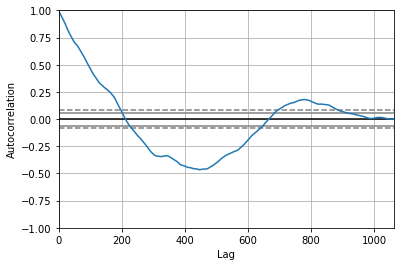

<Figure size 800x560 with 0 Axes>

Test MSE: 1.138


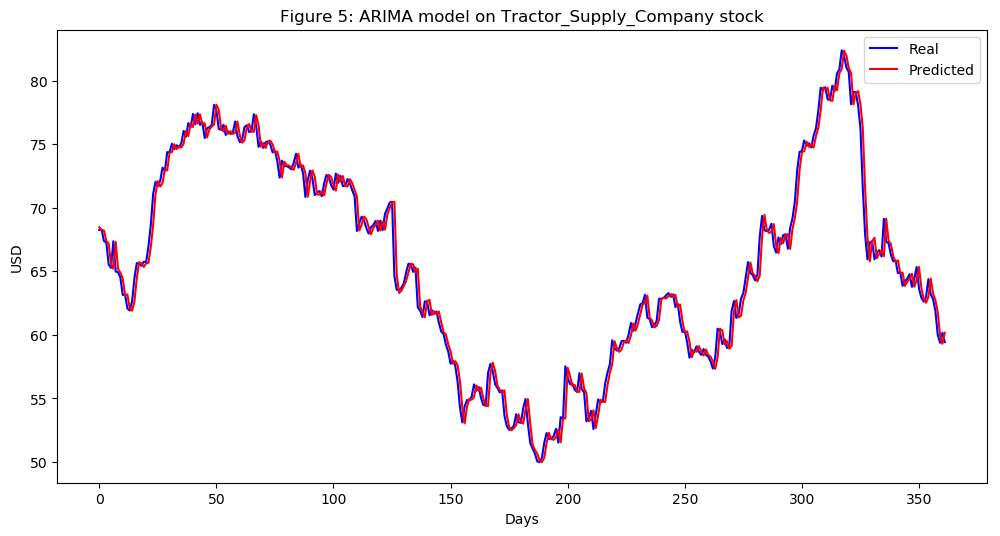

In [85]:


Tractor_Supply_Company_series = SP500_TechIndicator['Tractor_Supply_Company_Close']
Tractor_Supply_Company_series_model = ARIMA(Tractor_Supply_Company_series, order=(5, 1, 0))
Tractor_Supply_Company_model_fit = Tractor_Supply_Company_series_model.fit(disp=0)
print(Tractor_Supply_Company_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Tractor_Supply_Company_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Tractor_Supply_Company_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Tractor_Supply_Company_predictions = list()
for t in range(len(test)):
    Tractor_Supply_Company_series_model = ARIMA(history, order=(5,1,0))
    Tractor_Supply_Company_series_model_fit = Tractor_Supply_Company_series_model.fit(disp=0)
    Tractor_Supply_Company_output = Tractor_Supply_Company_series_model_fit.forecast()
    yhat = Tractor_Supply_Company_output[0]
    Tractor_Supply_Company_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Tractor_Supply_Company_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Tractor_Supply_Company_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Tractor_Supply_Company stock')
plt.legend()
plt.show()


#predictions
Tractor_Supply_Company_predictions = pd.DataFrame({'Tractor_Supply_Company_predictions':Tractor_Supply_Company_predictions})
#Tractor_Supply_Company_predictions.to_csv('Tractor_Supply_Company_predictions.csv')




                              ARIMA Model Results                              
Dep. Variable:     D.Ulta_Beauty_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -2837.475
Method:                        css-mle   S.D. of innovations              3.509
Date:                 Sun, 17 Mar 2019   AIC                           5688.950
Time:                         12:22:01   BIC                           5723.718
Sample:                              1   HQIC                          5702.126
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.1026      0.098      1.047      0.296      -0.090       0.295
ar.L1.D.Ulta_Beauty_Close    -0.0506      0.031     -1.650      0.099      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


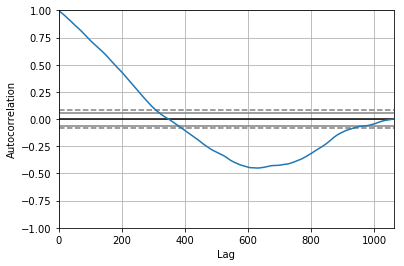

<Figure size 800x560 with 0 Axes>

Test MSE: 20.537


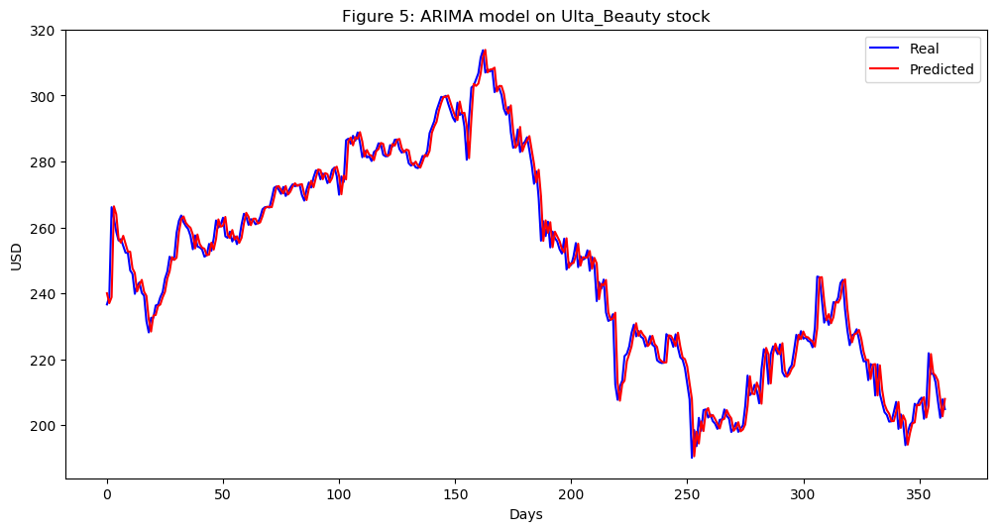

In [86]:


Ulta_Beauty_series = SP500_TechIndicator['Ulta_Beauty_Close']
Ulta_Beauty_series_model = ARIMA(Ulta_Beauty_series, order=(5, 1, 0))
Ulta_Beauty_model_fit = Ulta_Beauty_series_model.fit(disp=0)
print(Ulta_Beauty_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Ulta_Beauty_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Ulta_Beauty_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Ulta_Beauty_predictions = list()
for t in range(len(test)):
    Ulta_Beauty_series_model = ARIMA(history, order=(5,1,0))
    Ulta_Beauty_series_model_fit = Ulta_Beauty_series_model.fit(disp=0)
    Ulta_Beauty_output = Ulta_Beauty_series_model_fit.forecast()
    yhat = Ulta_Beauty_output[0]
    Ulta_Beauty_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Ulta_Beauty_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Ulta_Beauty_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Ulta_Beauty stock')
plt.legend()
plt.show()


#predictions
Ulta_Beauty_predictions = pd.DataFrame({'Ulta_Beauty_predictions':Ulta_Beauty_predictions})
#Ulta_Beauty_predictions.to_csv('Ulta_Beauty_predictions.csv')




                                  ARIMA Model Results                                   
Dep. Variable:     D.Under_Armour_Class_A_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -2488.942
Method:                                 css-mle   S.D. of innovations              2.527
Date:                          Sun, 17 Mar 2019   AIC                           4991.884
Time:                                  12:22:46   BIC                           5026.652
Sample:                                       1   HQIC                          5005.060
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                 -0.0669      0.074     -0.908      0.364    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


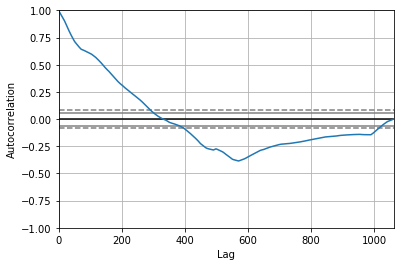

<Figure size 800x560 with 0 Axes>

Test MSE: 0.472


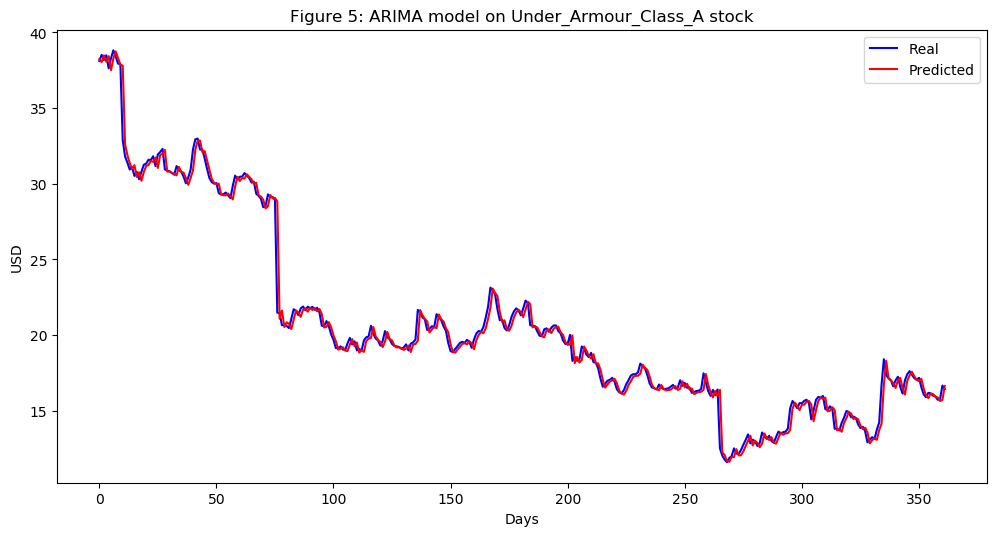

In [87]:


Under_Armour_Class_A_series = SP500_TechIndicator['Under_Armour_Class_A_Close']
Under_Armour_Class_A_series_model = ARIMA(Under_Armour_Class_A_series, order=(5, 1, 0))
Under_Armour_Class_A_model_fit = Under_Armour_Class_A_series_model.fit(disp=0)
print(Under_Armour_Class_A_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Under_Armour_Class_A_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Under_Armour_Class_A_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Under_Armour_Class_A_predictions = list()
for t in range(len(test)):
    Under_Armour_Class_A_series_model = ARIMA(history, order=(5,1,0))
    Under_Armour_Class_A_series_model_fit = Under_Armour_Class_A_series_model.fit(disp=0)
    Under_Armour_Class_A_output = Under_Armour_Class_A_series_model_fit.forecast()
    yhat = Under_Armour_Class_A_output[0]
    Under_Armour_Class_A_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Under_Armour_Class_A_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Under_Armour_Class_A_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Under_Armour_Class_A stock')
plt.legend()
plt.show()


#predictions
Under_Armour_Class_A_predictions = pd.DataFrame({'Under_Armour_Class_A_predictions':Under_Armour_Class_A_predictions})
#Under_Armour_Class_A_predictions.to_csv('Under_Armour_Class_A_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:      D.Whirlpool_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2626.006
Method:                       css-mle   S.D. of innovations              2.875
Date:                Sun, 17 Mar 2019   AIC                           5266.012
Time:                        12:23:31   BIC                           5300.781
Sample:                             1   HQIC                          5279.188
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                      -0.0037      0.084     -0.044      0.965      -0.168       0.161
ar.L1.D.Whirlpool_Close     0.0016      0.031      0.051      0.959      -0.059       0.062


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


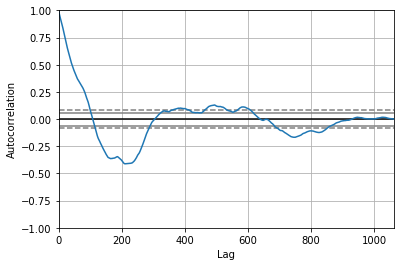

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 7.804


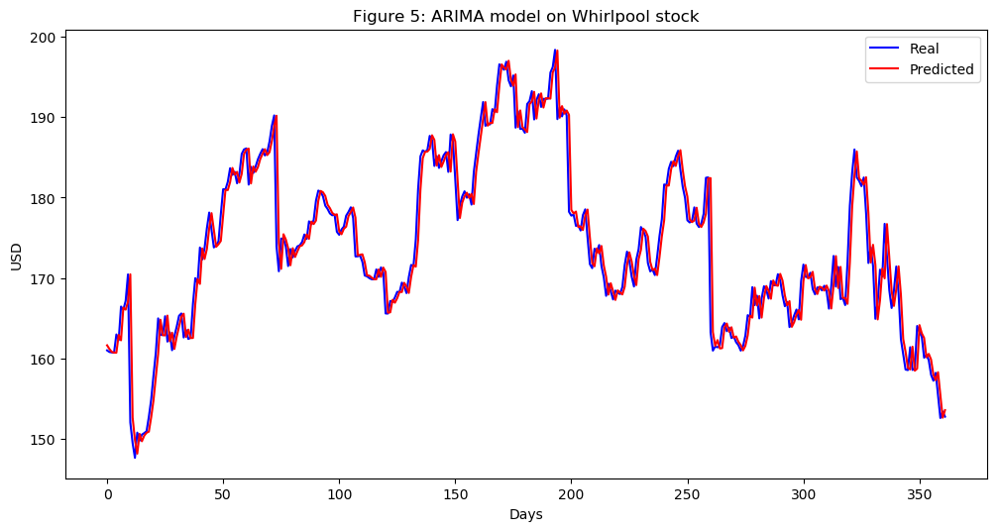

In [88]:


Whirlpool_series = SP500_TechIndicator['Whirlpool_Close']
Whirlpool_series_model = ARIMA(Whirlpool_series, order=(5, 1, 0))
Whirlpool_model_fit = Whirlpool_series_model.fit(disp=0)
print(Whirlpool_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Whirlpool_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Whirlpool_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Whirlpool_predictions = list()
for t in range(len(test)):
    Whirlpool_series_model = ARIMA(history, order=(5,1,0))
    Whirlpool_series_model_fit = Whirlpool_series_model.fit(disp=0)
    Whirlpool_output = Whirlpool_series_model_fit.forecast()
    yhat = Whirlpool_output[0]
    Whirlpool_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Whirlpool_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Whirlpool_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Whirlpool stock')
plt.legend()
plt.show()


#predictions
Whirlpool_predictions = pd.DataFrame({'Whirlpool_predictions':Whirlpool_predictions})
#Whirlpool_predictions.to_csv('Whirlpool_predictions.csv')




                              ARIMA Model Results                               
Dep. Variable:     D.Wynn_Resorts_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -2778.295
Method:                         css-mle   S.D. of innovations              3.319
Date:                  Sun, 17 Mar 2019   AIC                           5570.589
Time:                          12:24:20   BIC                           5605.358
Sample:                               1   HQIC                          5583.766
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                         -0.0160      0.093     -0.172      0.863      -0.198       0.166
ar.L1.D.Wynn_Resorts_Close     0.0037      0.031      0.120      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


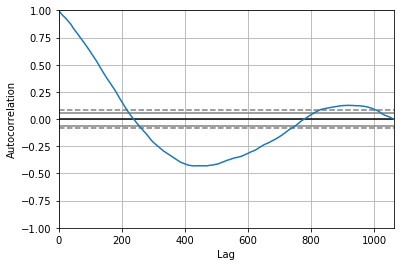

<Figure size 800x560 with 0 Axes>

Test MSE: 9.470


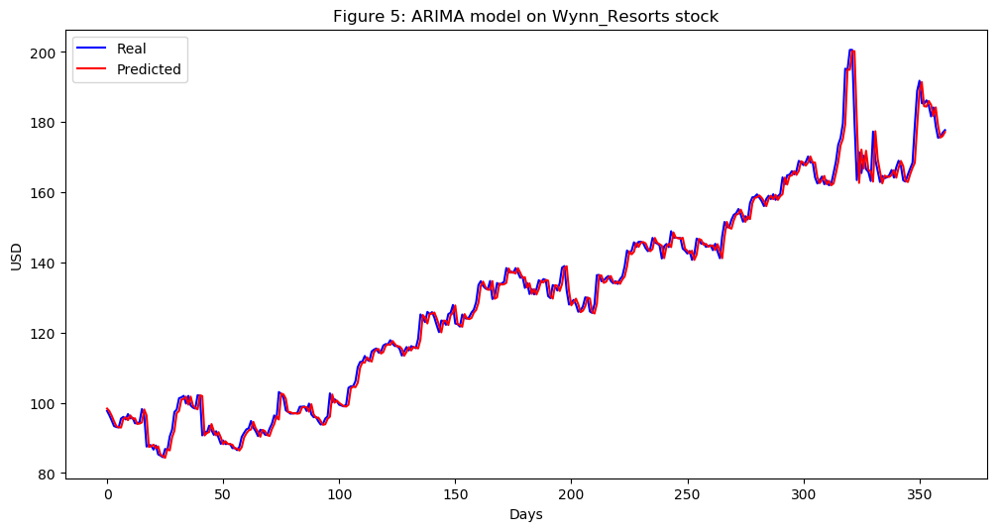

In [89]:


Wynn_Resorts_series = SP500_TechIndicator['Wynn_Resorts_Close']
Wynn_Resorts_series_model = ARIMA(Wynn_Resorts_series, order=(5, 1, 0))
Wynn_Resorts_model_fit = Wynn_Resorts_series_model.fit(disp=0)
print(Wynn_Resorts_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Wynn_Resorts_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Wynn_Resorts_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Wynn_Resorts_predictions = list()
for t in range(len(test)):
    Wynn_Resorts_series_model = ARIMA(history, order=(5,1,0))
    Wynn_Resorts_series_model_fit = Wynn_Resorts_series_model.fit(disp=0)
    Wynn_Resorts_output = Wynn_Resorts_series_model_fit.forecast()
    yhat = Wynn_Resorts_output[0]
    Wynn_Resorts_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Wynn_Resorts_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Wynn_Resorts_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Wynn_Resorts stock')
plt.legend()
plt.show()


#predictions
Wynn_Resorts_predictions = pd.DataFrame({'Wynn_Resorts_predictions':Wynn_Resorts_predictions})
#Wynn_Resorts_predictions.to_csv('Wynn_Resorts_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:       D.V_F_Corp_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1436.390
Method:                       css-mle   S.D. of innovations              0.937
Date:                Sun, 17 Mar 2019   AIC                           2886.781
Time:                        12:25:11   BIC                           2921.550
Sample:                             1   HQIC                          2899.957
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0108      0.024      0.451      0.652      -0.036       0.058
ar.L1.D.V_F_Corp_Close    -0.0180      0.031     -0.586      0.558      -0.078       0.042
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


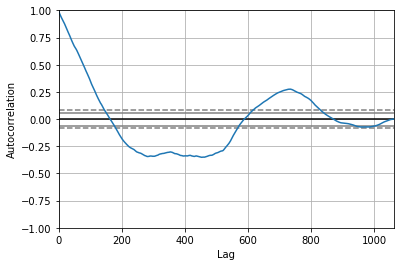

<Figure size 800x560 with 0 Axes>

Test MSE: 0.848


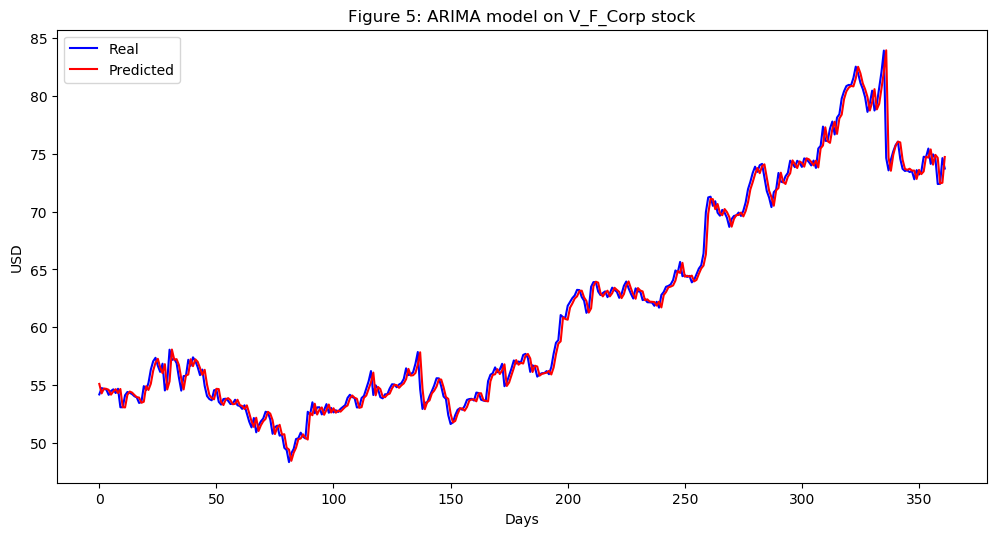

In [90]:
V_F_Corp_series = SP500_TechIndicator['V_F_Corp_Close']
V_F_Corp_series_model = ARIMA(V_F_Corp_series, order=(5, 1, 0))
V_F_Corp_model_fit = V_F_Corp_series_model.fit(disp=0)
print(V_F_Corp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(V_F_Corp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = V_F_Corp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
V_F_Corp_predictions = list()
for t in range(len(test)):
    V_F_Corp_series_model = ARIMA(history, order=(5,1,0))
    V_F_Corp_series_model_fit = V_F_Corp_series_model.fit(disp=0)
    V_F_Corp_output = V_F_Corp_series_model_fit.forecast()
    yhat = V_F_Corp_output[0]
    V_F_Corp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, V_F_Corp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(V_F_Corp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on V_F_Corp stock')
plt.legend()
plt.show()


#predictions
V_F_Corp_predictions = pd.DataFrame({'V_F_Corp_predictions':V_F_Corp_predictions})
#V_F_Corp_predictions.to_csv('V_F_Corp_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:     D.Yum_Brands_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1841.026
Method:                       css-mle   S.D. of innovations              1.372
Date:                Sun, 17 Mar 2019   AIC                           3696.053
Time:                        12:26:09   BIC                           3730.821
Sample:                             1   HQIC                          3709.229
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0076      0.037      0.205      0.837      -0.065       0.081
ar.L1.D.Yum_Brands_Close    -0.0290      0.031     -0.946      0.344      -0.089       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


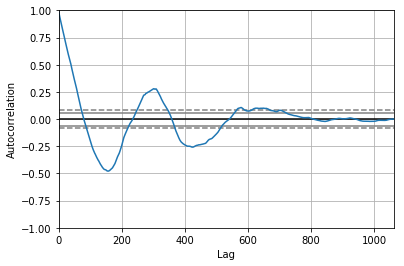

<Figure size 800x560 with 0 Axes>

Test MSE: 2.393


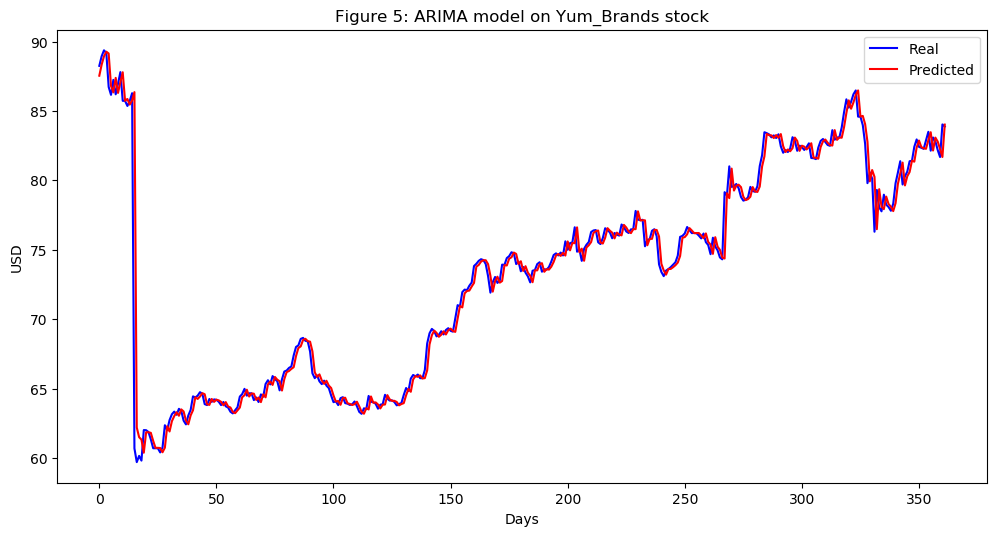

In [91]:
Yum_Brands_series = SP500_TechIndicator['Yum_Brands_Close']
Yum_Brands_series_model = ARIMA(Yum_Brands_series, order=(5, 1, 0))
Yum_Brands_model_fit = Yum_Brands_series_model.fit(disp=0)
print(Yum_Brands_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Yum_Brands_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Yum_Brands_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Yum_Brands_predictions = list()
for t in range(len(test)):
    Yum_Brands_series_model = ARIMA(history, order=(5,1,0))
    Yum_Brands_series_model_fit = Yum_Brands_series_model.fit(disp=0)
    Yum_Brands_output = Yum_Brands_series_model_fit.forecast()
    yhat = Yum_Brands_output[0]
    Yum_Brands_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Yum_Brands_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Yum_Brands_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Yum_Brands stock')
plt.legend()
plt.show()


#predictions
Yum_Brands_predictions = pd.DataFrame({'Yum_Brands_predictions':Yum_Brands_predictions})
#Yum_Brands_predictions.to_csv('Yum_Brands_predictions.csv')




                              ARIMA Model Results                               
Dep. Variable:     D.Altria_Group_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -1024.126
Method:                         css-mle   S.D. of innovations              0.635
Date:                  Sun, 17 Mar 2019   AIC                           2062.252
Time:                          12:26:54   BIC                           2097.021
Sample:                               1   HQIC                          2075.428
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                          0.0207      0.022      0.947      0.344      -0.022       0.064
ar.L1.D.Altria_Group_Close    -0.0170      0.031     -0.554      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


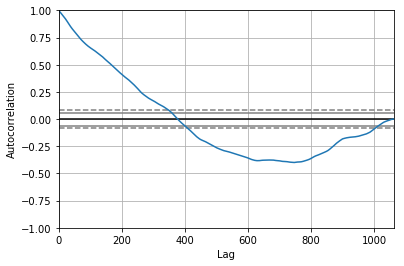

<Figure size 800x560 with 0 Axes>

Test MSE: 0.623


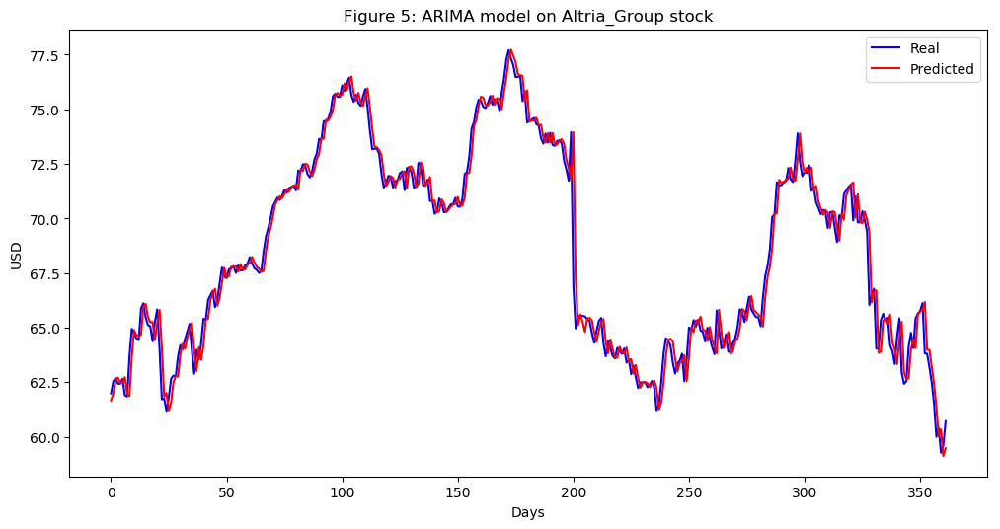

In [92]:
Altria_Group_series = SP500_TechIndicator['Altria_Group_Close']
Altria_Group_series_model = ARIMA(Altria_Group_series, order=(5, 1, 0))
Altria_Group_model_fit = Altria_Group_series_model.fit(disp=0)
print(Altria_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Altria_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Altria_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Altria_Group_predictions = list()
for t in range(len(test)):
    Altria_Group_series_model = ARIMA(history, order=(5,1,0))
    Altria_Group_series_model_fit = Altria_Group_series_model.fit(disp=0)
    Altria_Group_output = Altria_Group_series_model_fit.forecast()
    yhat = Altria_Group_output[0]
    Altria_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Altria_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Altria_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Altria_Group stock')
plt.legend()
plt.show()


#predictions
Altria_Group_predictions = pd.DataFrame({'Altria_Group_predictions':Altria_Group_predictions})
#Altria_Group_predictions.to_csv('Altria_Group_predictions.csv')




                                     ARIMA Model Results                                     
Dep. Variable:     D.Archer_Daniels_Midland_Co_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood                -998.313
Method:                                      css-mle   S.D. of innovations              0.620
Date:                               Sun, 17 Mar 2019   AIC                           2010.626
Time:                                       12:28:03   BIC                           2045.394
Sample:                                            1   HQIC                          2023.802
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


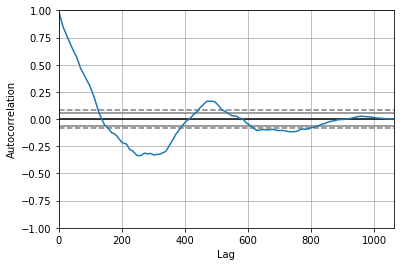

<Figure size 800x560 with 0 Axes>

Test MSE: 0.348


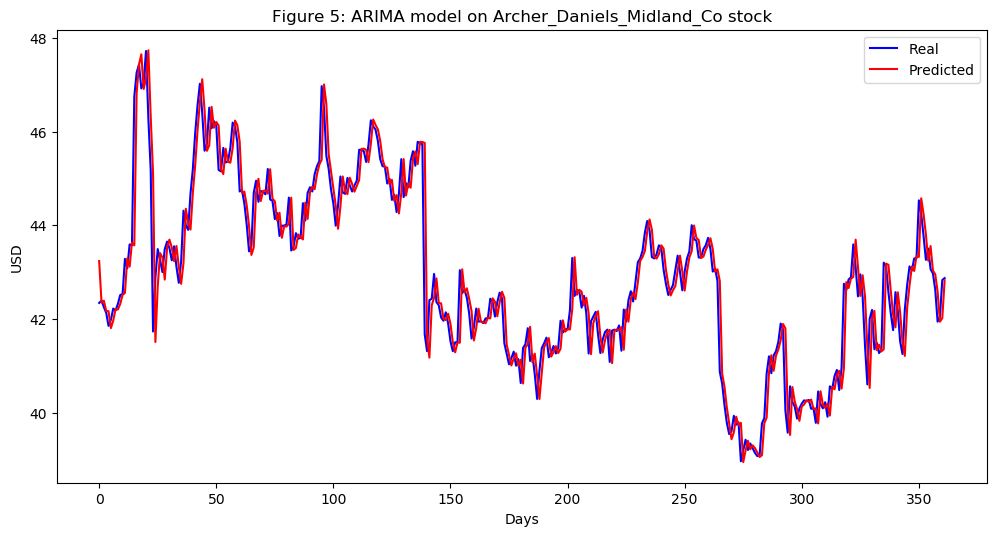

In [93]:
Archer_Daniels_Midland_Co_series = SP500_TechIndicator['Archer_Daniels_Midland_Co_Close']
Archer_Daniels_Midland_Co_series_model = ARIMA(Archer_Daniels_Midland_Co_series, order=(5, 1, 0))
Archer_Daniels_Midland_Co_model_fit = Archer_Daniels_Midland_Co_series_model.fit(disp=0)
print(Archer_Daniels_Midland_Co_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Archer_Daniels_Midland_Co_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Archer_Daniels_Midland_Co_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Archer_Daniels_Midland_Co_predictions = list()
for t in range(len(test)):
    Archer_Daniels_Midland_Co_series_model = ARIMA(history, order=(5,1,0))
    Archer_Daniels_Midland_Co_series_model_fit = Archer_Daniels_Midland_Co_series_model.fit(disp=0)
    Archer_Daniels_Midland_Co_output = Archer_Daniels_Midland_Co_series_model_fit.forecast()
    yhat = Archer_Daniels_Midland_Co_output[0]
    Archer_Daniels_Midland_Co_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Archer_Daniels_Midland_Co_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Archer_Daniels_Midland_Co_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Archer_Daniels_Midland_Co stock')
plt.legend()
plt.show()


#predictions
Archer_Daniels_Midland_Co_predictions = pd.DataFrame({'Archer_Daniels_Midland_Co_predictions':Archer_Daniels_Midland_Co_predictions})
#Archer_Daniels_Midland_Co_predictions.to_csv('Archer_Daniels_Midland_Co_predictions.csv')




                              ARIMA Model Results                               
Dep. Variable:     D.Brown_Forman_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -2150.567
Method:                         css-mle   S.D. of innovations              1.837
Date:                  Sun, 17 Mar 2019   AIC                           4315.134
Time:                          12:28:57   BIC                           4349.903
Sample:                               1   HQIC                          4328.311
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                         -0.0209      0.056     -0.376      0.707      -0.130       0.088
ar.L1.D.Brown_Forman_Close    -0.0131      0.031     -0.427      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


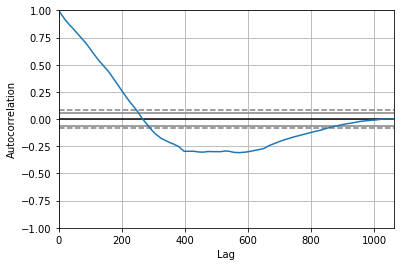

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 1.092


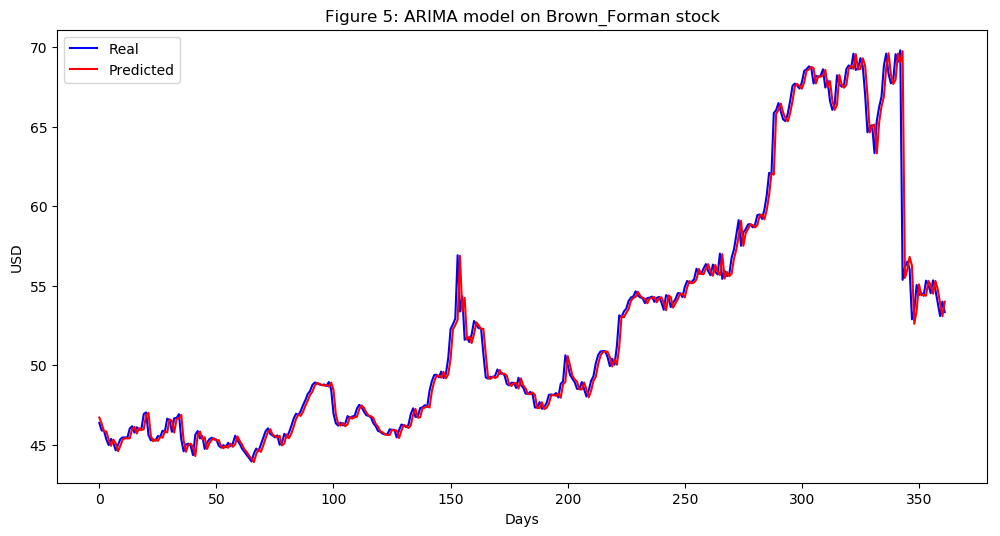

In [94]:
Brown_Forman_series = SP500_TechIndicator['Brown_Forman_Close']
Brown_Forman_series_model = ARIMA(Brown_Forman_series, order=(5, 1, 0))
Brown_Forman_model_fit = Brown_Forman_series_model.fit(disp=0)
print(Brown_Forman_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Brown_Forman_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Brown_Forman_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Brown_Forman_predictions = list()
for t in range(len(test)):
    Brown_Forman_series_model = ARIMA(history, order=(5,1,0))
    Brown_Forman_series_model_fit = Brown_Forman_series_model.fit(disp=0)
    Brown_Forman_output = Brown_Forman_series_model_fit.forecast()
    yhat = Brown_Forman_output[0]
    Brown_Forman_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Brown_Forman_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Brown_Forman_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Brown_Forman stock')
plt.legend()
plt.show()


#predictions
Brown_Forman_predictions = pd.DataFrame({'Brown_Forman_predictions':Brown_Forman_predictions})
#Brown_Forman_predictions.to_csv('Brown_Forman_predictions.csv')




                               ARIMA Model Results                               
Dep. Variable:     D.Campbell_Soup_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -1028.835
Method:                          css-mle   S.D. of innovations              0.638
Date:                   Sun, 17 Mar 2019   AIC                           2071.670
Time:                           12:29:41   BIC                           2106.439
Sample:                                1   HQIC                          2084.846
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          -0.0006      0.019     -0.030      0.976      -0.039       0.038
ar.L1.D.Campbell_Soup_Close    -0.0497      0.031     -1

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


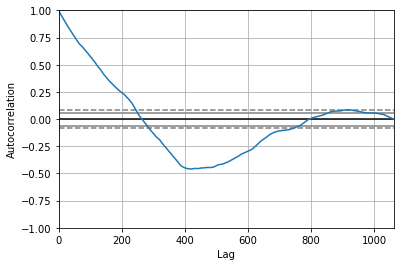

<Figure size 800x560 with 0 Axes>

Test MSE: 0.562


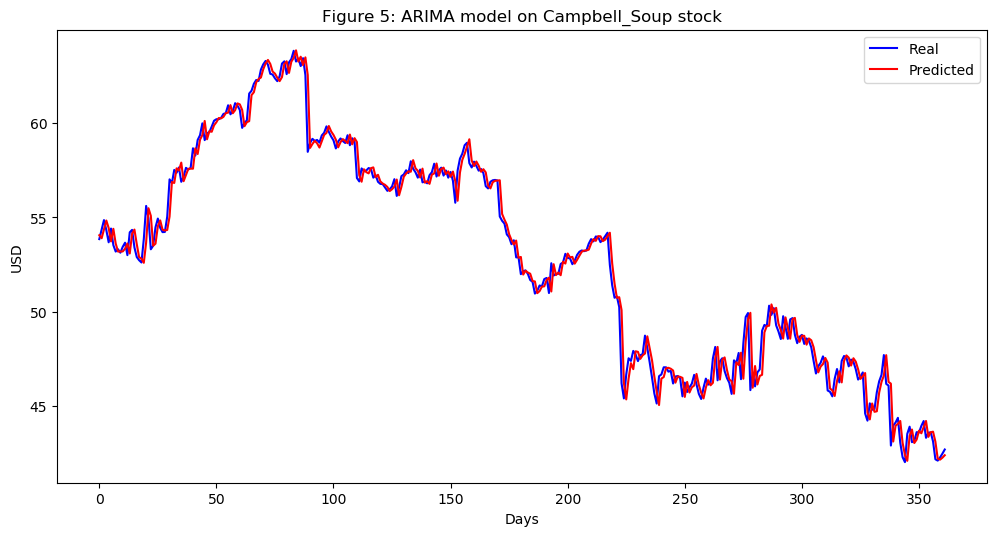

In [95]:
Campbell_Soup_series = SP500_TechIndicator['Campbell_Soup_Close']
Campbell_Soup_series_model = ARIMA(Campbell_Soup_series, order=(5, 1, 0))
Campbell_Soup_model_fit = Campbell_Soup_series_model.fit(disp=0)
print(Campbell_Soup_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Campbell_Soup_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Campbell_Soup_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Campbell_Soup_predictions = list()
for t in range(len(test)):
    Campbell_Soup_series_model = ARIMA(history, order=(5,1,0))
    Campbell_Soup_series_model_fit = Campbell_Soup_series_model.fit(disp=0)
    Campbell_Soup_output = Campbell_Soup_series_model_fit.forecast()
    yhat = Campbell_Soup_output[0]
    Campbell_Soup_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Campbell_Soup_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Campbell_Soup_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Campbell_Soup stock')
plt.legend()
plt.show()


#predictions
Campbell_Soup_predictions = pd.DataFrame({'Campbell_Soup_predictions':Campbell_Soup_predictions})
#Campbell_Soup_predictions.to_csv('Campbell_Soup_predictions.csv')




                               ARIMA Model Results                               
Dep. Variable:     D.Church_Dwight_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -2056.036
Method:                          css-mle   S.D. of innovations              1.680
Date:                   Sun, 17 Mar 2019   AIC                           4126.072
Time:                           12:30:33   BIC                           4160.841
Sample:                                1   HQIC                          4139.249
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          -0.0171      0.053     -0.324      0.746      -0.121       0.086
ar.L1.D.Church_Dwight_Close    -0.0209      0.031     -0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


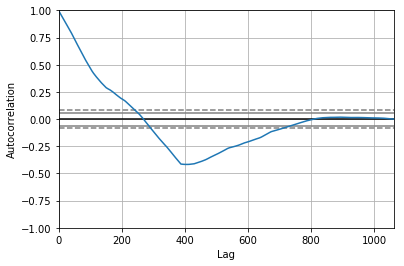

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.284


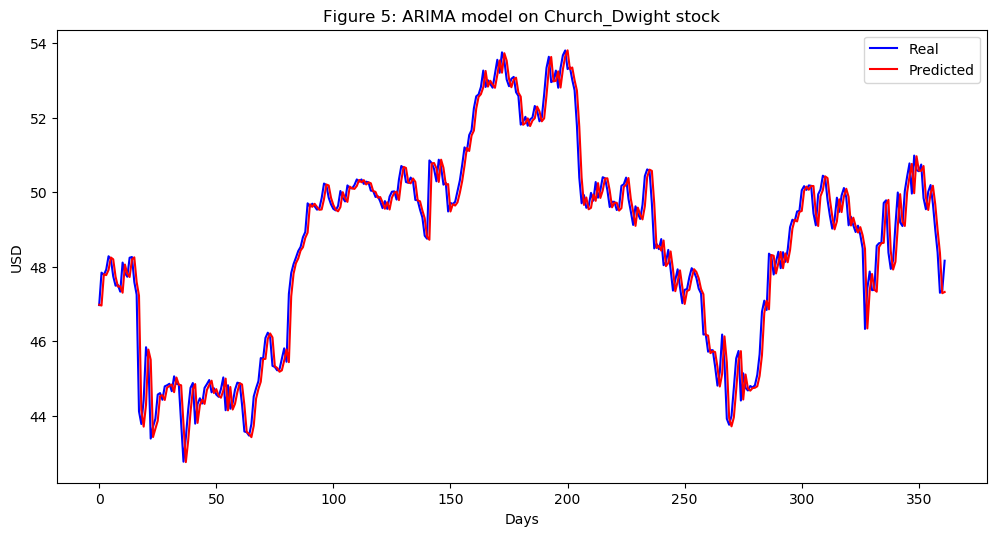

In [96]:
Church_Dwight_series = SP500_TechIndicator['Church_Dwight_Close']
Church_Dwight_series_model = ARIMA(Church_Dwight_series, order=(5, 1, 0))
Church_Dwight_model_fit = Church_Dwight_series_model.fit(disp=0)
print(Church_Dwight_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Church_Dwight_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Church_Dwight_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Church_Dwight_predictions = list()
for t in range(len(test)):
    Church_Dwight_series_model = ARIMA(history, order=(5,1,0))
    Church_Dwight_series_model_fit = Church_Dwight_series_model.fit(disp=0)
    Church_Dwight_output = Church_Dwight_series_model_fit.forecast()
    yhat = Church_Dwight_output[0]
    Church_Dwight_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Church_Dwight_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Church_Dwight_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Church_Dwight stock')
plt.legend()
plt.show()


#predictions
Church_Dwight_predictions = pd.DataFrame({'Church_Dwight_predictions':Church_Dwight_predictions})
#Church_Dwight_predictions.to_csv('Church_Dwight_predictions.csv')




                                 ARIMA Model Results                                  
Dep. Variable:     D.The_Clorox_Company_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1699.168
Method:                               css-mle   S.D. of innovations              1.200
Date:                        Sun, 17 Mar 2019   AIC                           3412.336
Time:                                12:31:16   BIC                           3447.105
Sample:                                     1   HQIC                          3425.513
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0315      0.035      0.910      0.363      -0.036       0.099
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


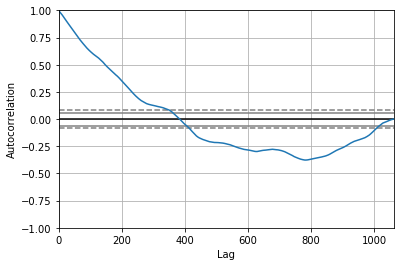

<Figure size 800x560 with 0 Axes>

Test MSE: 1.952


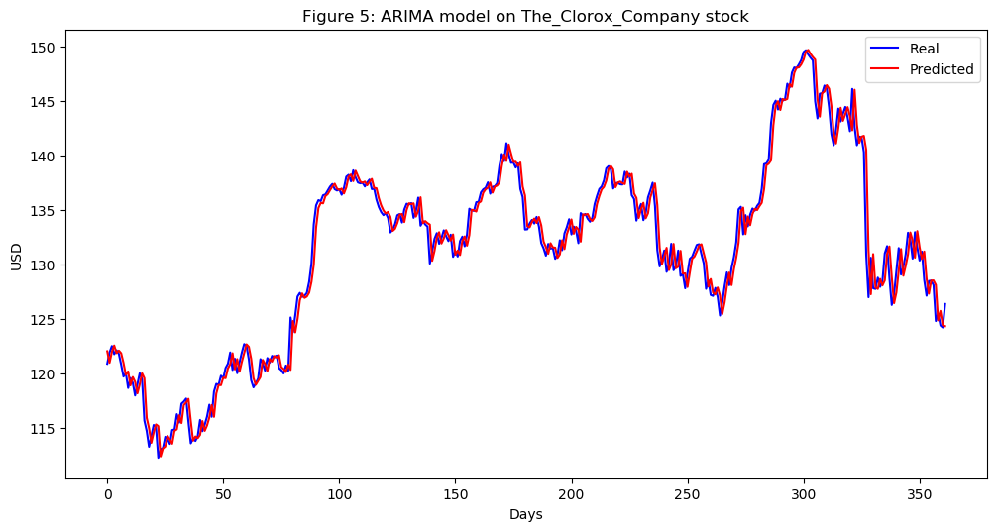

In [97]:
The_Clorox_Company_series = SP500_TechIndicator['The_Clorox_Company_Close']
The_Clorox_Company_series_model = ARIMA(The_Clorox_Company_series, order=(5, 1, 0))
The_Clorox_Company_model_fit = The_Clorox_Company_series_model.fit(disp=0)
print(The_Clorox_Company_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(The_Clorox_Company_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = The_Clorox_Company_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
The_Clorox_Company_predictions = list()
for t in range(len(test)):
    The_Clorox_Company_series_model = ARIMA(history, order=(5,1,0))
    The_Clorox_Company_series_model_fit = The_Clorox_Company_series_model.fit(disp=0)
    The_Clorox_Company_output = The_Clorox_Company_series_model_fit.forecast()
    yhat = The_Clorox_Company_output[0]
    The_Clorox_Company_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, The_Clorox_Company_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(The_Clorox_Company_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on The_Clorox_Company stock')
plt.legend()
plt.show()


#predictions
The_Clorox_Company_predictions = pd.DataFrame({'The_Clorox_Company_predictions':The_Clorox_Company_predictions})
#The_Clorox_Company_predictions.to_csv('The_Clorox_Company_predictions.csv')




                                 ARIMA Model Results                                 
Dep. Variable:     D.Coca_Cola_Company_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood                -438.394
Method:                              css-mle   S.D. of innovations              0.366
Date:                       Sun, 17 Mar 2019   AIC                            890.788
Time:                               12:32:12   BIC                            925.556
Sample:                                    1   HQIC                           903.964
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0015      0.011      0.129      0.898      -0.021       0.024
ar.L1.D.Coca

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


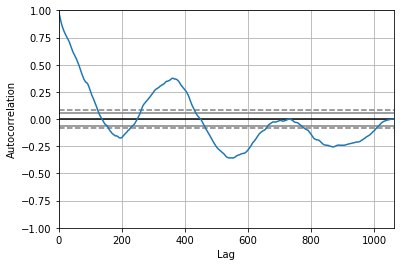

<Figure size 800x560 with 0 Axes>

Test MSE: 0.104


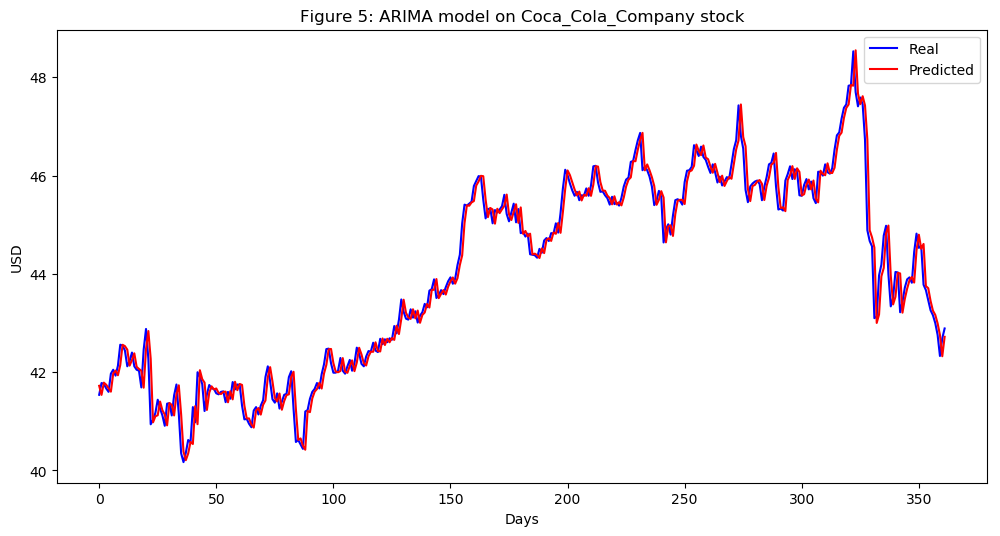

In [98]:
Coca_Cola_Company_series = SP500_TechIndicator['Coca_Cola_Company_Close']
Coca_Cola_Company_series_model = ARIMA(Coca_Cola_Company_series, order=(5, 1, 0))
Coca_Cola_Company_model_fit = Coca_Cola_Company_series_model.fit(disp=0)
print(Coca_Cola_Company_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Coca_Cola_Company_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Coca_Cola_Company_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Coca_Cola_Company_predictions = list()
for t in range(len(test)):
    Coca_Cola_Company_series_model = ARIMA(history, order=(5,1,0))
    Coca_Cola_Company_series_model_fit = Coca_Cola_Company_series_model.fit(disp=0)
    Coca_Cola_Company_output = Coca_Cola_Company_series_model_fit.forecast()
    yhat = Coca_Cola_Company_output[0]
    Coca_Cola_Company_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Coca_Cola_Company_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Coca_Cola_Company_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Coca_Cola_Company stock')
plt.legend()
plt.show()


#predictions
Coca_Cola_Company_predictions = pd.DataFrame({'Coca_Cola_Company_predictions':Coca_Cola_Company_predictions})
#Coca_Cola_Company_predictions.to_csv('Coca_Cola_Company_predictions.csv')




                                 ARIMA Model Results                                 
Dep. Variable:     D.Colgate_Palmolive_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -1093.065
Method:                              css-mle   S.D. of innovations              0.678
Date:                       Sun, 17 Mar 2019   AIC                           2200.130
Time:                               12:33:31   BIC                           2234.899
Sample:                                    1   HQIC                          2213.307
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0038      0.018      0.208      0.835      -0.032       0.039
ar.L1.D.Colg

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


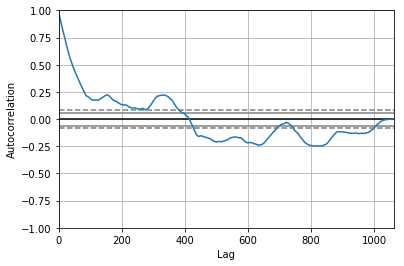

<Figure size 800x560 with 0 Axes>

Test MSE: 0.536


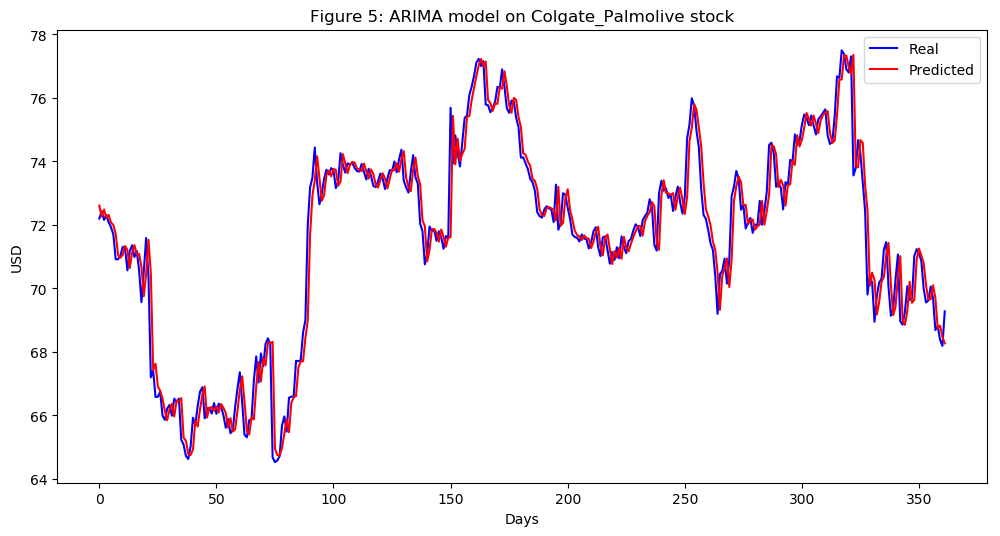

In [99]:
Colgate_Palmolive_series = SP500_TechIndicator['Colgate_Palmolive_Close']
Colgate_Palmolive_series_model = ARIMA(Colgate_Palmolive_series, order=(5, 1, 0))
Colgate_Palmolive_model_fit = Colgate_Palmolive_series_model.fit(disp=0)
print(Colgate_Palmolive_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Colgate_Palmolive_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Colgate_Palmolive_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Colgate_Palmolive_predictions = list()
for t in range(len(test)):
    Colgate_Palmolive_series_model = ARIMA(history, order=(5,1,0))
    Colgate_Palmolive_series_model_fit = Colgate_Palmolive_series_model.fit(disp=0)
    Colgate_Palmolive_output = Colgate_Palmolive_series_model_fit.forecast()
    yhat = Colgate_Palmolive_output[0]
    Colgate_Palmolive_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Colgate_Palmolive_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Colgate_Palmolive_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Colgate_Palmolive stock')
plt.legend()
plt.show()


#predictions
Colgate_Palmolive_predictions = pd.DataFrame({'Colgate_Palmolive_predictions':Colgate_Palmolive_predictions})
#Colgate_Palmolive_predictions.to_csv('Colgate_Palmolive_predictions.csv')




                                  ARIMA Model Results                                   
Dep. Variable:     D.Constellation_Brands_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -2146.450
Method:                                 css-mle   S.D. of innovations              1.830
Date:                          Sun, 17 Mar 2019   AIC                           4306.900
Time:                                  12:34:39   BIC                           4341.669
Sample:                                       1   HQIC                          4320.076
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.1405      0.046      3.075      0.002    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


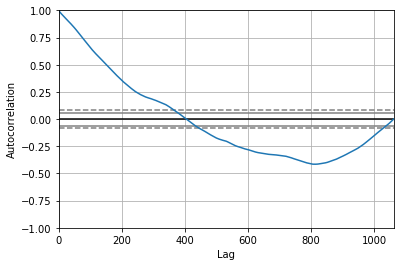

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 5.050


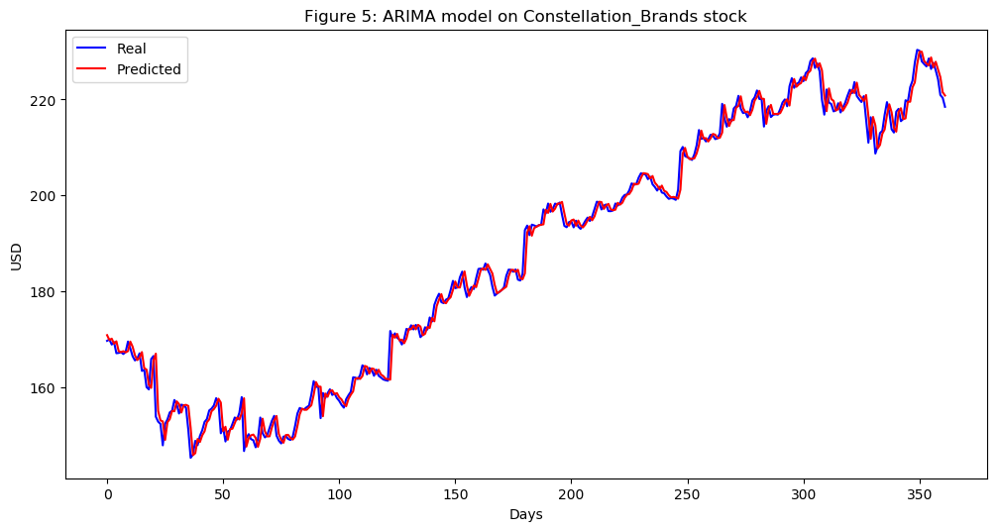

In [100]:
Constellation_Brands_series = SP500_TechIndicator['Constellation_Brands_Close']
Constellation_Brands_series_model = ARIMA(Constellation_Brands_series, order=(5, 1, 0))
Constellation_Brands_model_fit = Constellation_Brands_series_model.fit(disp=0)
print(Constellation_Brands_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Constellation_Brands_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Constellation_Brands_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Constellation_Brands_predictions = list()
for t in range(len(test)):
    Constellation_Brands_series_model = ARIMA(history, order=(5,1,0))
    Constellation_Brands_series_model_fit = Constellation_Brands_series_model.fit(disp=0)
    Constellation_Brands_output = Constellation_Brands_series_model_fit.forecast()
    yhat = Constellation_Brands_output[0]
    Constellation_Brands_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Constellation_Brands_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Constellation_Brands_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Constellation_Brands stock')
plt.legend()
plt.show()


#predictions
Constellation_Brands_predictions = pd.DataFrame({'Constellation_Brands_predictions':Constellation_Brands_predictions})
#Constellation_Brands_predictions.to_csv('Constellation_Brands_predictions.csv')




                                ARIMA Model Results                                 
Dep. Variable:     D.Costco_Wholesale_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -2090.079
Method:                             css-mle   S.D. of innovations              1.735
Date:                      Sun, 17 Mar 2019   AIC                           4194.158
Time:                              12:35:28   BIC                           4228.927
Sample:                                   1   HQIC                          4207.335
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0599      0.052      1.141      0.254      -0.043       0.163
ar.L1.D.Costco_Wholesal

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


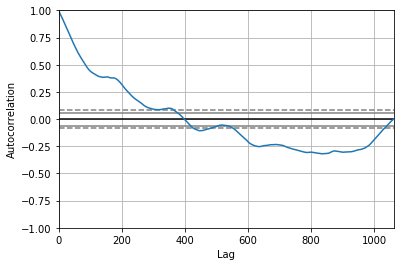

<Figure size 800x560 with 0 Axes>

Test MSE: 4.380


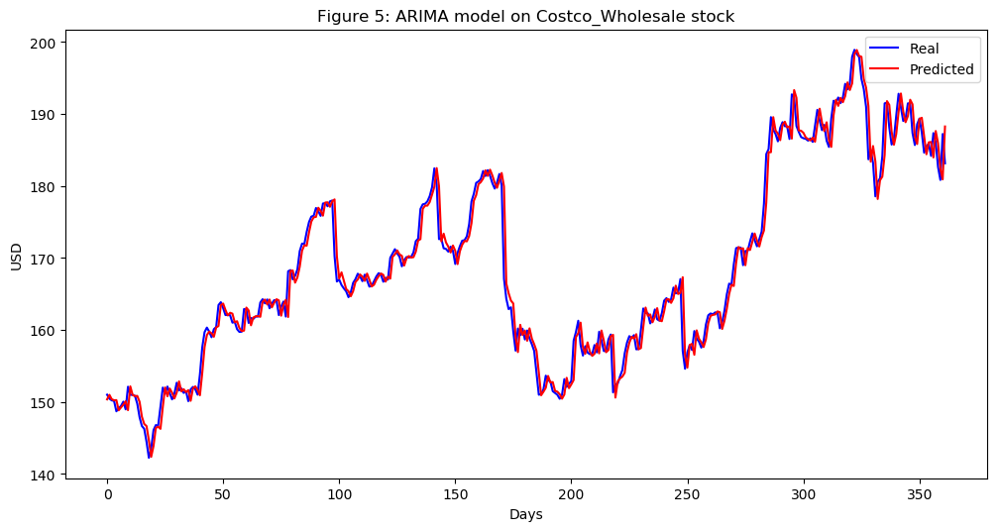

In [101]:
Costco_Wholesale_series = SP500_TechIndicator['Costco_Wholesale_Close']
Costco_Wholesale_series_model = ARIMA(Costco_Wholesale_series, order=(5, 1, 0))
Costco_Wholesale_model_fit = Costco_Wholesale_series_model.fit(disp=0)
print(Costco_Wholesale_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Costco_Wholesale_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Costco_Wholesale_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Costco_Wholesale_predictions = list()
for t in range(len(test)):
    Costco_Wholesale_series_model = ARIMA(history, order=(5,1,0))
    Costco_Wholesale_series_model_fit = Costco_Wholesale_series_model.fit(disp=0)
    Costco_Wholesale_output = Costco_Wholesale_series_model_fit.forecast()
    yhat = Costco_Wholesale_output[0]
    Costco_Wholesale_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Costco_Wholesale_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Costco_Wholesale_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Costco_Wholesale stock')
plt.legend()
plt.show()


#predictions
Costco_Wholesale_predictions = pd.DataFrame({'Costco_Wholesale_predictions':Costco_Wholesale_predictions})
#Costco_Wholesale_predictions.to_csv('Costco_Wholesale_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:           D.Coty_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -719.910
Method:                       css-mle   S.D. of innovations              0.477
Date:                Sun, 17 Mar 2019   AIC                           1453.820
Time:                        12:36:30   BIC                           1488.589
Sample:                             1   HQIC                          1466.996
                                                                              
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0028      0.015      0.186      0.852      -0.027       0.033
ar.L1.D.Coty_Close     0.0071      0.031      0.232      0.817      -0.053       0.067
ar.L2.D.Coty_Close  

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


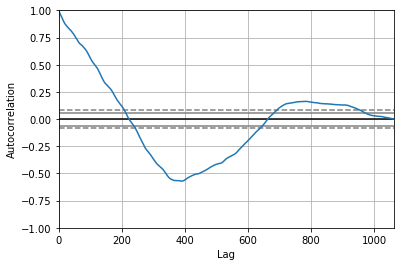

<Figure size 800x560 with 0 Axes>

Test MSE: 0.172


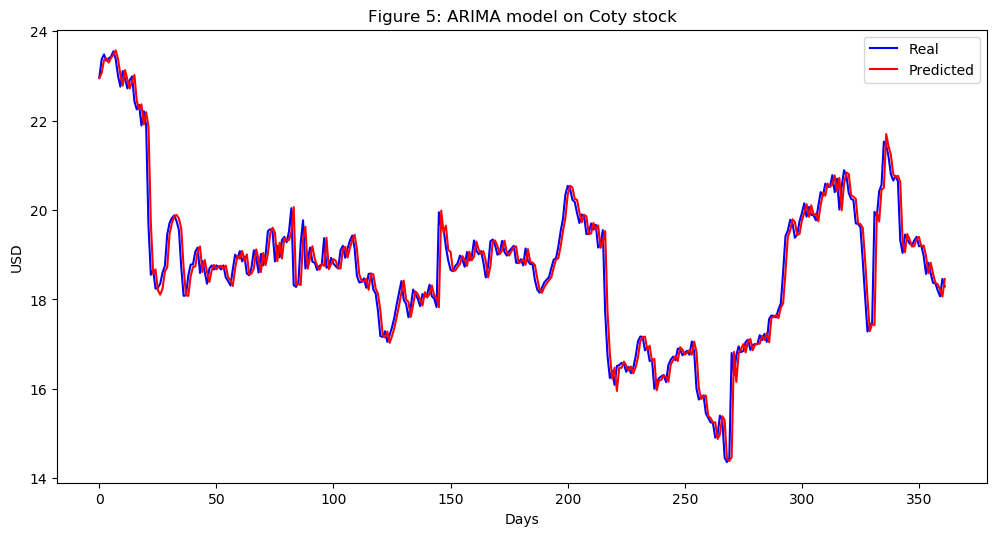

In [102]:
Coty_series = SP500_TechIndicator['Coty_Close']
Coty_series_model = ARIMA(Coty_series, order=(5, 1, 0))
Coty_model_fit = Coty_series_model.fit(disp=0)
print(Coty_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Coty_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Coty_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Coty_predictions = list()
for t in range(len(test)):
    Coty_series_model = ARIMA(history, order=(5,1,0))
    Coty_series_model_fit = Coty_series_model.fit(disp=0)
    Coty_output = Coty_series_model_fit.forecast()
    yhat = Coty_output[0]
    Coty_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Coty_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Coty_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Coty stock')
plt.legend()
plt.show()


#predictions
Coty_predictions = pd.DataFrame({'Coty_predictions':Coty_predictions})
#Coty_predictions.to_csv('Coty_predictions.csv')




                               ARIMA Model Results                               
Dep. Variable:     D.General_Mills_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -1008.096
Method:                          css-mle   S.D. of innovations              0.626
Date:                   Sun, 17 Mar 2019   AIC                           2030.191
Time:                           12:37:40   BIC                           2064.960
Sample:                                1   HQIC                          2043.368
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          -0.0044      0.019     -0.232      0.817      -0.042       0.033
ar.L1.D.General_Mills_Close     0.0041      0.031      0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


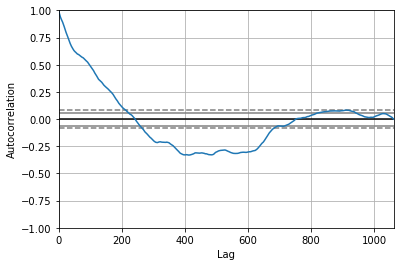

<Figure size 800x560 with 0 Axes>

Test MSE: 0.517


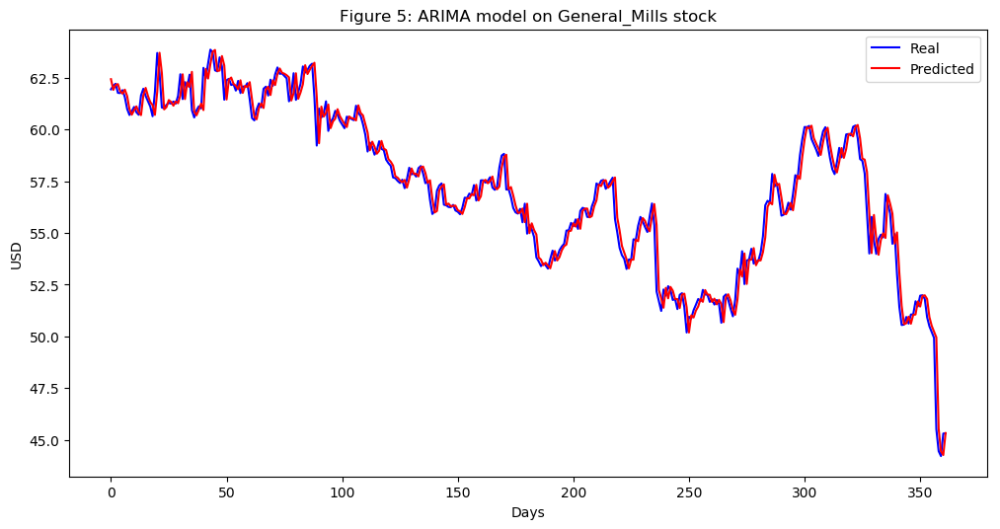

In [103]:
General_Mills_series = SP500_TechIndicator['General_Mills_Close']
General_Mills_series_model = ARIMA(General_Mills_series, order=(5, 1, 0))
General_Mills_model_fit = General_Mills_series_model.fit(disp=0)
print(General_Mills_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(General_Mills_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = General_Mills_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
General_Mills_predictions = list()
for t in range(len(test)):
    General_Mills_series_model = ARIMA(history, order=(5,1,0))
    General_Mills_series_model_fit = General_Mills_series_model.fit(disp=0)
    General_Mills_output = General_Mills_series_model_fit.forecast()
    yhat = General_Mills_output[0]
    General_Mills_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, General_Mills_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(General_Mills_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on General_Mills stock')
plt.legend()
plt.show()


#predictions
General_Mills_predictions = pd.DataFrame({'General_Mills_predictions':General_Mills_predictions})
#General_Mills_predictions.to_csv('General_Mills_predictions.csv')




                                  ARIMA Model Results                                  
Dep. Variable:     D.The_Hershey_Company_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1702.468
Method:                                css-mle   S.D. of innovations              1.204
Date:                         Sun, 17 Mar 2019   AIC                           3418.935
Time:                                 12:39:07   BIC                           3453.704
Sample:                                      1   HQIC                          3432.112
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0006      0.035      0.017      0.987      -0.068   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


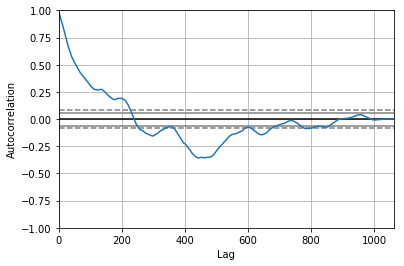

<Figure size 800x560 with 0 Axes>

Test MSE: 1.087


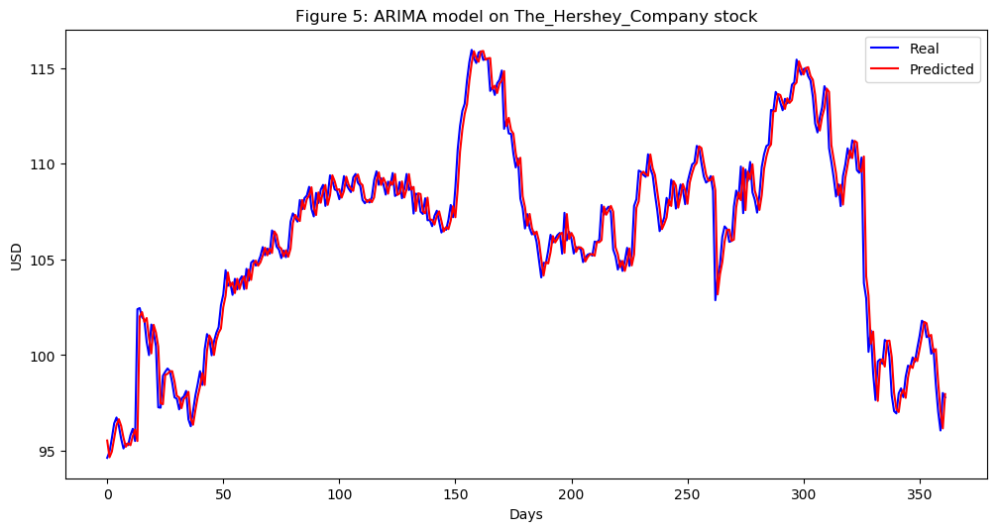

In [104]:
The_Hershey_Company_series = SP500_TechIndicator['The_Hershey_Company_Close']
The_Hershey_Company_series_model = ARIMA(The_Hershey_Company_series, order=(5, 1, 0))
The_Hershey_Company_model_fit = The_Hershey_Company_series_model.fit(disp=0)
print(The_Hershey_Company_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(The_Hershey_Company_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = The_Hershey_Company_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
The_Hershey_Company_predictions = list()
for t in range(len(test)):
    The_Hershey_Company_series_model = ARIMA(history, order=(5,1,0))
    The_Hershey_Company_series_model_fit = The_Hershey_Company_series_model.fit(disp=0)
    The_Hershey_Company_output = The_Hershey_Company_series_model_fit.forecast()
    yhat = The_Hershey_Company_output[0]
    The_Hershey_Company_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, The_Hershey_Company_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(The_Hershey_Company_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on The_Hershey_Company stock')
plt.legend()
plt.show()


#predictions
The_Hershey_Company_predictions = pd.DataFrame({'The_Hershey_Company_predictions':The_Hershey_Company_predictions})
#The_Hershey_Company_predictions.to_csv('The_Hershey_Company_predictions.csv')




                              ARIMA Model Results                               
Dep. Variable:     D.Hormel_Foods_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -1854.988
Method:                         css-mle   S.D. of innovations              1.390
Date:                  Sun, 17 Mar 2019   AIC                           3723.975
Time:                          12:40:13   BIC                           3758.744
Sample:                               1   HQIC                          3737.152
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                         -0.0110      0.040     -0.273      0.785      -0.090       0.068
ar.L1.D.Hormel_Foods_Close    -0.0257      0.031     -0.839      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


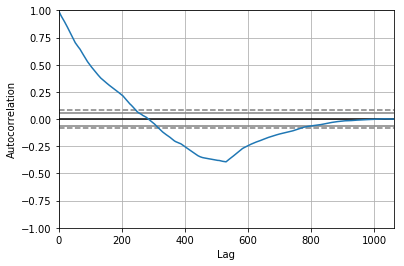

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.188


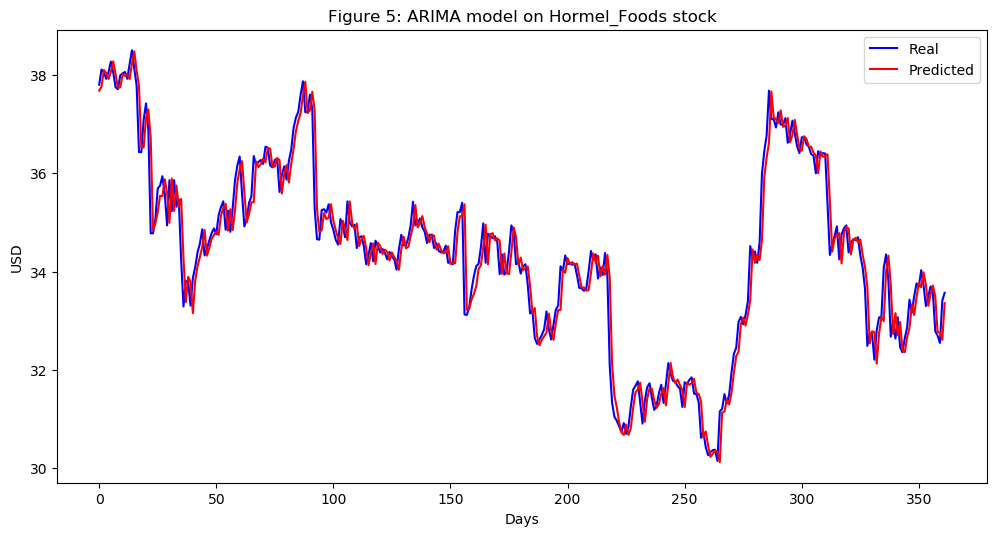

In [105]:
Hormel_Foods_series = SP500_TechIndicator['Hormel_Foods_Close']
Hormel_Foods_series_model = ARIMA(Hormel_Foods_series, order=(5, 1, 0))
Hormel_Foods_model_fit = Hormel_Foods_series_model.fit(disp=0)
print(Hormel_Foods_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Hormel_Foods_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Hormel_Foods_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Hormel_Foods_predictions = list()
for t in range(len(test)):
    Hormel_Foods_series_model = ARIMA(history, order=(5,1,0))
    Hormel_Foods_series_model_fit = Hormel_Foods_series_model.fit(disp=0)
    Hormel_Foods_output = Hormel_Foods_series_model_fit.forecast()
    yhat = Hormel_Foods_output[0]
    Hormel_Foods_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Hormel_Foods_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Hormel_Foods_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Hormel_Foods stock')
plt.legend()
plt.show()


#predictions
Hormel_Foods_predictions = pd.DataFrame({'Hormel_Foods_predictions':Hormel_Foods_predictions})
#Hormel_Foods_predictions.to_csv('Hormel_Foods_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:     D.JM_Smucker_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1902.562
Method:                       css-mle   S.D. of innovations              1.454
Date:                Sun, 17 Mar 2019   AIC                           3819.124
Time:                        12:41:37   BIC                           3853.893
Sample:                             1   HQIC                          3832.300
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0172      0.045      0.386      0.700      -0.070       0.105
ar.L1.D.JM_Smucker_Close    -0.0015      0.031     -0.048      0.962      -0.062       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


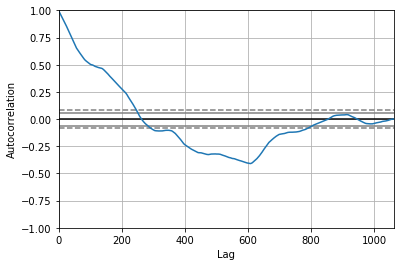

<Figure size 800x560 with 0 Axes>

Test MSE: 2.502


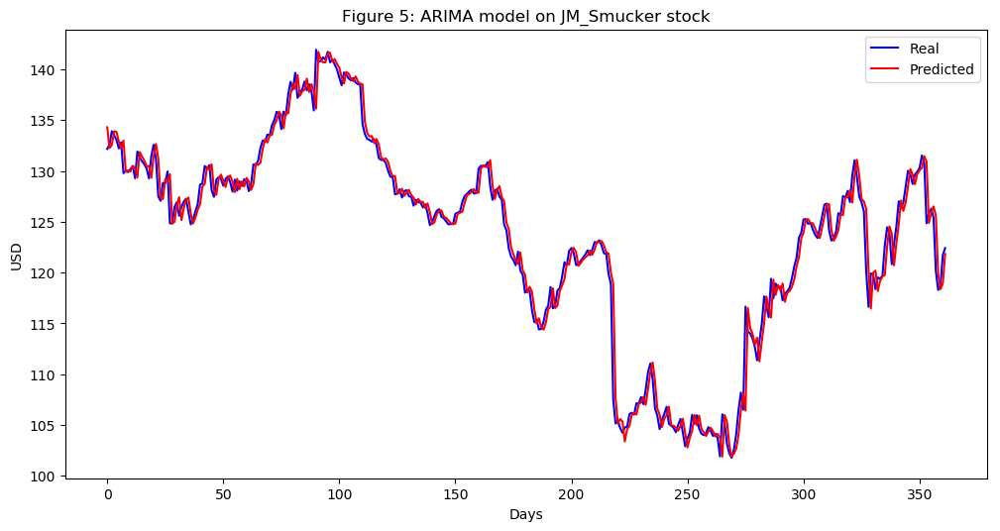

In [106]:
JM_Smucker_series = SP500_TechIndicator['JM_Smucker_Close']
JM_Smucker_series_model = ARIMA(JM_Smucker_series, order=(5, 1, 0))
JM_Smucker_model_fit = JM_Smucker_series_model.fit(disp=0)
print(JM_Smucker_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(JM_Smucker_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = JM_Smucker_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
JM_Smucker_predictions = list()
for t in range(len(test)):
    JM_Smucker_series_model = ARIMA(history, order=(5,1,0))
    JM_Smucker_series_model_fit = JM_Smucker_series_model.fit(disp=0)
    JM_Smucker_output = JM_Smucker_series_model_fit.forecast()
    yhat = JM_Smucker_output[0]
    JM_Smucker_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, JM_Smucker_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(JM_Smucker_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on JM_Smucker stock')
plt.legend()
plt.show()


#predictions
JM_Smucker_predictions = pd.DataFrame({'JM_Smucker_predictions':JM_Smucker_predictions})
#JM_Smucker_predictions.to_csv('JM_Smucker_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:        D.Kellogg_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1234.694
Method:                       css-mle   S.D. of innovations              0.775
Date:                Sun, 17 Mar 2019   AIC                           2483.389
Time:                        12:42:53   BIC                           2518.158
Sample:                             1   HQIC                          2496.565
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0030      0.021      0.141      0.888      -0.039       0.045
ar.L1.D.Kellogg_Close    -0.0632      0.031     -2.061      0.040      -0.123      -0.003
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


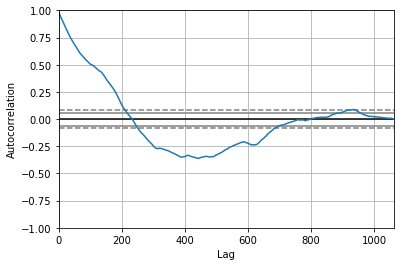

<Figure size 800x560 with 0 Axes>

Test MSE: 0.672


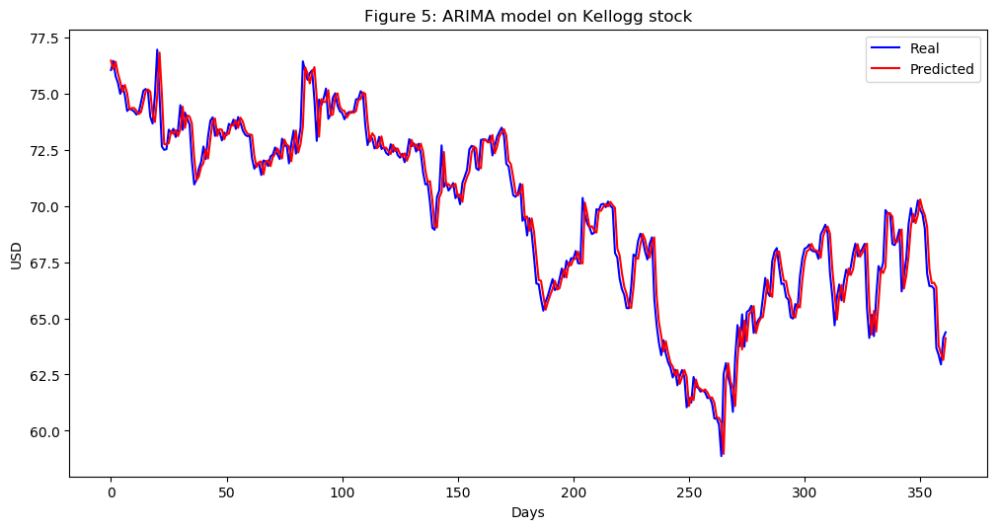

In [107]:
Kellogg_series = SP500_TechIndicator['Kellogg_Close']
Kellogg_series_model = ARIMA(Kellogg_series, order=(5, 1, 0))
Kellogg_model_fit = Kellogg_series_model.fit(disp=0)
print(Kellogg_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Kellogg_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Kellogg_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Kellogg_predictions = list()
for t in range(len(test)):
    Kellogg_series_model = ARIMA(history, order=(5,1,0))
    Kellogg_series_model_fit = Kellogg_series_model.fit(disp=0)
    Kellogg_output = Kellogg_series_model_fit.forecast()
    yhat = Kellogg_output[0]
    Kellogg_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Kellogg_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Kellogg_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Kellogg stock')
plt.legend()
plt.show()


#predictions
Kellogg_predictions = pd.DataFrame({'Kellogg_predictions':Kellogg_predictions})
#Kellogg_predictions.to_csv('Kellogg_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:         D.Kroger_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1811.600
Method:                       css-mle   S.D. of innovations              1.334
Date:                Sun, 17 Mar 2019   AIC                           3637.199
Time:                        12:48:38   BIC                           3671.968
Sample:                             1   HQIC                          3650.376
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -0.0151      0.038     -0.394      0.694      -0.090       0.060
ar.L1.D.Kroger_Close     0.0007      0.031      0.022      0.983      -0.059       0.061
ar.L2.D.Krog

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


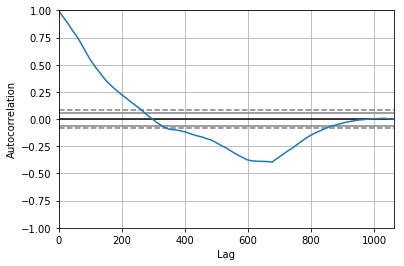

<Figure size 800x560 with 0 Axes>

Test MSE: 0.354


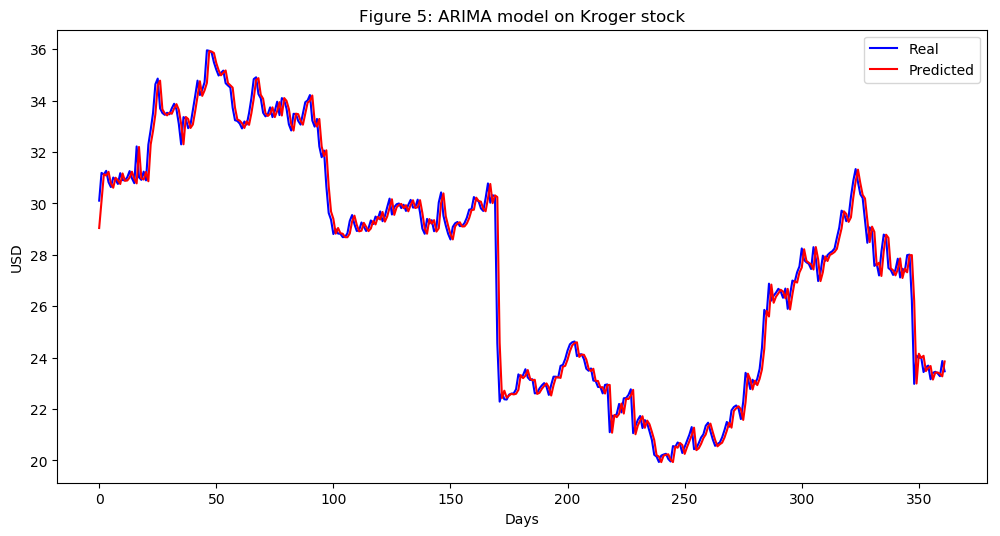

In [109]:
Kroger_series = SP500_TechIndicator['Kroger_Close']
Kroger_series_model = ARIMA(Kroger_series, order=(5, 1, 0))
Kroger_model_fit = Kroger_series_model.fit(disp=0)
print(Kroger_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Kroger_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Kroger_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Kroger_predictions = list()
for t in range(len(test)):
    Kroger_series_model = ARIMA(history, order=(5,1,0))
    Kroger_series_model_fit = Kroger_series_model.fit(disp=0)
    Kroger_output = Kroger_series_model_fit.forecast()
    yhat = Kroger_output[0]
    Kroger_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Kroger_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Kroger_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Kroger stock')
plt.legend()
plt.show()


#predictions
Kroger_predictions = pd.DataFrame({'Kroger_predictions':Kroger_predictions})
#Kroger_predictions.to_csv('Kroger_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:      D.McCormick_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1431.818
Method:                       css-mle   S.D. of innovations              0.933
Date:                Sun, 17 Mar 2019   AIC                           2877.635
Time:                        12:49:35   BIC                           2912.404
Sample:                             1   HQIC                          2890.812
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.0362      0.026      1.368      0.172      -0.016       0.088
ar.L1.D.McCormick_Close    -0.0094      0.031     -0.306      0.760      -0.070       0.051


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


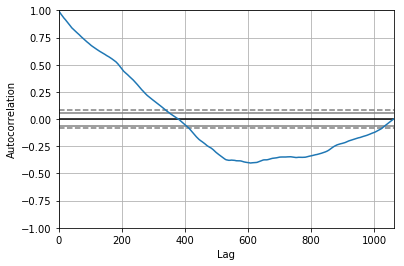

<Figure size 800x560 with 0 Axes>

Test MSE: 1.172


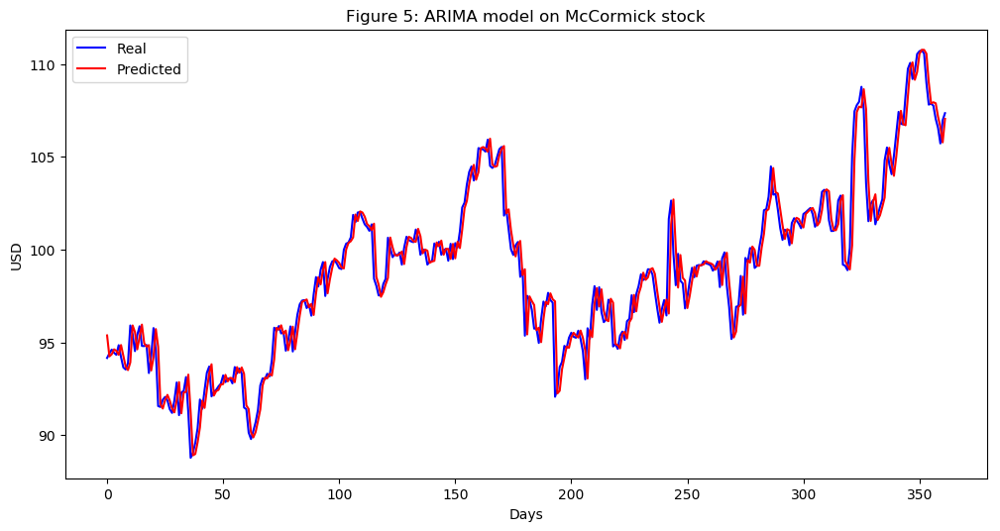

In [110]:
McCormick_series = SP500_TechIndicator['McCormick_Close']
McCormick_series_model = ARIMA(McCormick_series, order=(5, 1, 0))
McCormick_model_fit = McCormick_series_model.fit(disp=0)
print(McCormick_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(McCormick_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = McCormick_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
McCormick_predictions = list()
for t in range(len(test)):
    McCormick_series_model = ARIMA(history, order=(5,1,0))
    McCormick_series_model_fit = McCormick_series_model.fit(disp=0)
    McCormick_output = McCormick_series_model_fit.forecast()
    yhat = McCormick_output[0]
    McCormick_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, McCormick_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(McCormick_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on McCormick stock')
plt.legend()
plt.show()


#predictions
McCormick_predictions = pd.DataFrame({'McCormick_predictions':McCormick_predictions})
#McCormick_predictions.to_csv('McCormick_predictions.csv')




                                      ARIMA Model Results                                       
Dep. Variable:     D.Molson_Coors_Brewing_Company_Close   No. Observations:                 1061
Model:                                   ARIMA(5, 1, 0)   Log Likelihood               -1678.977
Method:                                         css-mle   S.D. of innovations              1.178
Date:                                  Sun, 17 Mar 2019   AIC                           3371.954
Time:                                          12:50:35   BIC                           3406.722
Sample:                                               1   HQIC                          3385.130
                                                                                                
                                                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------------
co

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


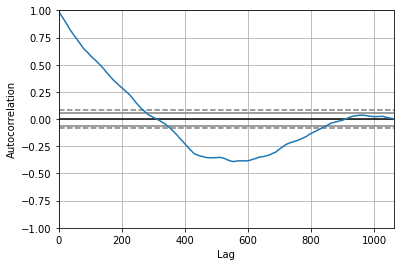

<Figure size 800x560 with 0 Axes>

Test MSE: 1.212


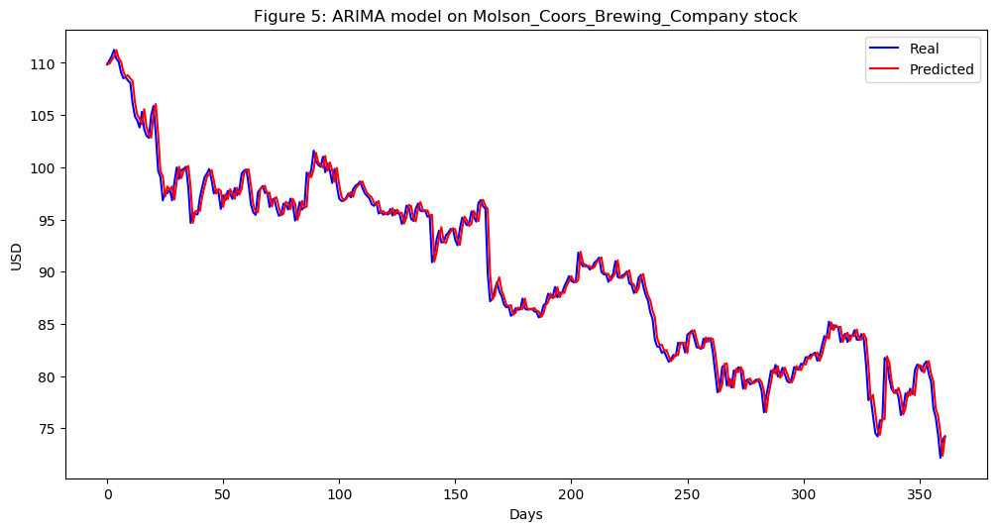

In [111]:
Molson_Coors_Brewing_Company_series = SP500_TechIndicator['Molson_Coors_Brewing_Company_Close']
Molson_Coors_Brewing_Company_series_model = ARIMA(Molson_Coors_Brewing_Company_series, order=(5, 1, 0))
Molson_Coors_Brewing_Company_model_fit = Molson_Coors_Brewing_Company_series_model.fit(disp=0)
print(Molson_Coors_Brewing_Company_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Molson_Coors_Brewing_Company_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Molson_Coors_Brewing_Company_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Molson_Coors_Brewing_Company_predictions = list()
for t in range(len(test)):
    Molson_Coors_Brewing_Company_series_model = ARIMA(history, order=(5,1,0))
    Molson_Coors_Brewing_Company_series_model_fit = Molson_Coors_Brewing_Company_series_model.fit(disp=0)
    Molson_Coors_Brewing_Company_output = Molson_Coors_Brewing_Company_series_model_fit.forecast()
    yhat = Molson_Coors_Brewing_Company_output[0]
    Molson_Coors_Brewing_Company_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Molson_Coors_Brewing_Company_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Molson_Coors_Brewing_Company_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Molson_Coors_Brewing_Company stock')
plt.legend()
plt.show()


#predictions
Molson_Coors_Brewing_Company_predictions = pd.DataFrame({'Molson_Coors_Brewing_Company_predictions':Molson_Coors_Brewing_Company_predictions})
#Molson_Coors_Brewing_Company_predictions.to_csv('Molson_Coors_Brewing_Company_predictions.csv')




                                   ARIMA Model Results                                    
Dep. Variable:     D.Mondelez_International_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood                -859.557
Method:                                   css-mle   S.D. of innovations              0.544
Date:                            Sun, 17 Mar 2019   AIC                           1733.114
Time:                                    12:51:37   BIC                           1767.882
Sample:                                         1   HQIC                          1746.290
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0054      0.015    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


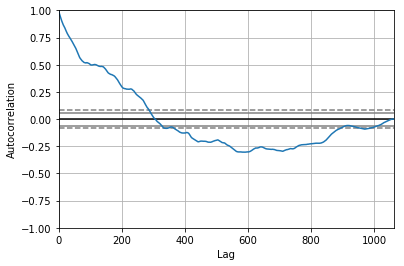

<Figure size 800x560 with 0 Axes>

Test MSE: 0.298


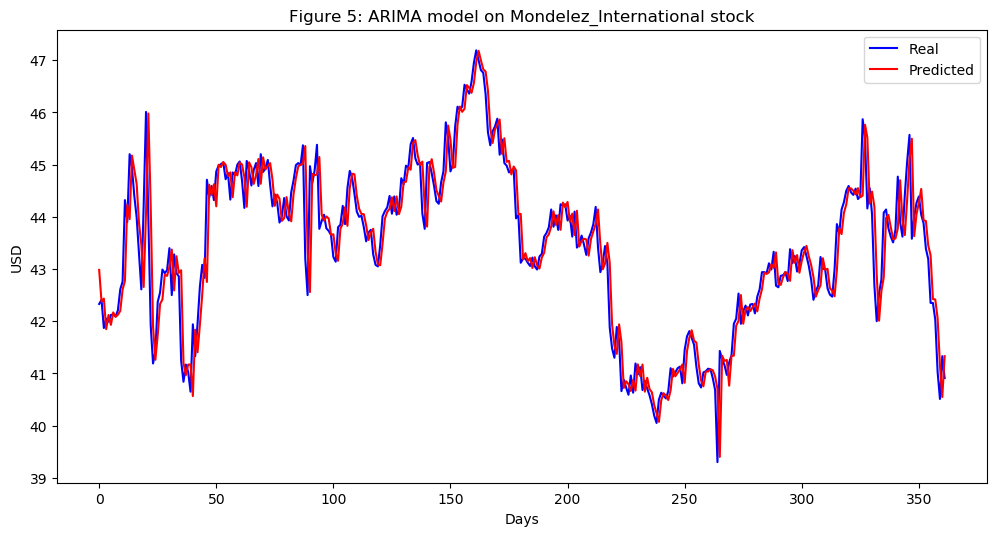

In [112]:
Mondelez_International_series = SP500_TechIndicator['Mondelez_International_Close']
Mondelez_International_series_model = ARIMA(Mondelez_International_series, order=(5, 1, 0))
Mondelez_International_model_fit = Mondelez_International_series_model.fit(disp=0)
print(Mondelez_International_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Mondelez_International_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Mondelez_International_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Mondelez_International_predictions = list()
for t in range(len(test)):
    Mondelez_International_series_model = ARIMA(history, order=(5,1,0))
    Mondelez_International_series_model_fit = Mondelez_International_series_model.fit(disp=0)
    Mondelez_International_output = Mondelez_International_series_model_fit.forecast()
    yhat = Mondelez_International_output[0]
    Mondelez_International_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Mondelez_International_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Mondelez_International_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Mondelez_International stock')
plt.legend()
plt.show()


#predictions
Mondelez_International_predictions = pd.DataFrame({'Mondelez_International_predictions':Mondelez_International_predictions})
#Mondelez_International_predictions.to_csv('Mondelez_International_predictions.csv')




                                ARIMA Model Results                                 
Dep. Variable:     D.Monster_Beverage_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -2813.762
Method:                             css-mle   S.D. of innovations              3.432
Date:                      Sun, 17 Mar 2019   AIC                           5641.524
Time:                              12:53:27   BIC                           5676.293
Sample:                                   1   HQIC                          5654.701
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                             -0.0109      0.110     -0.099      0.921      -0.226       0.204
ar.L1.D.Monster_Beverag

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


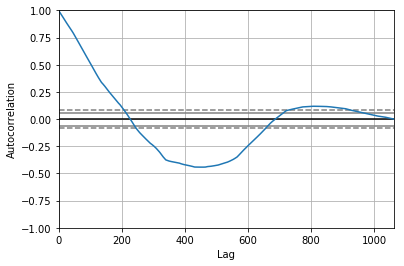

<Figure size 800x560 with 0 Axes>

Test MSE: 24.174


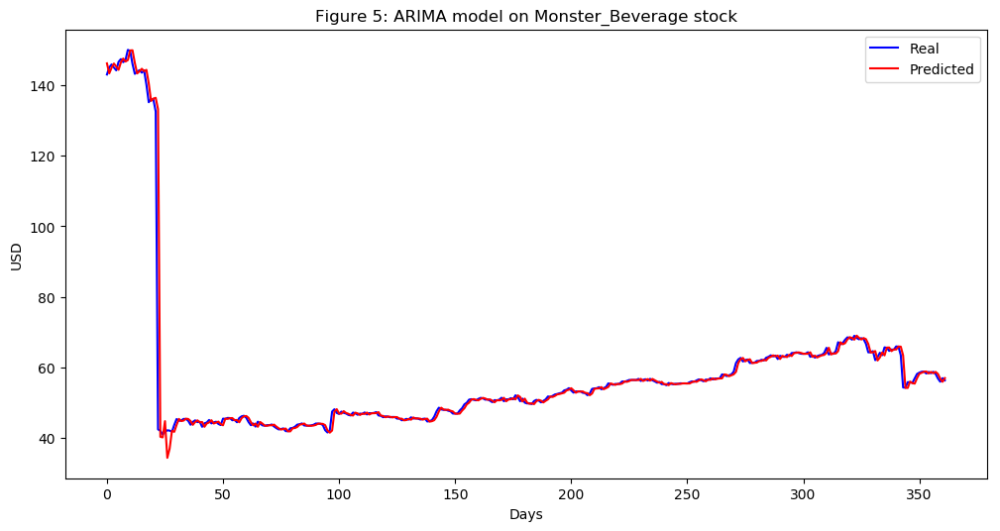

In [113]:
Monster_Beverage_series = SP500_TechIndicator['Monster_Beverage_Close']
Monster_Beverage_series_model = ARIMA(Monster_Beverage_series, order=(5, 1, 0))
Monster_Beverage_model_fit = Monster_Beverage_series_model.fit(disp=0)
print(Monster_Beverage_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Monster_Beverage_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Monster_Beverage_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Monster_Beverage_predictions = list()
for t in range(len(test)):
    Monster_Beverage_series_model = ARIMA(history, order=(5,1,0))
    Monster_Beverage_series_model_fit = Monster_Beverage_series_model.fit(disp=0)
    Monster_Beverage_output = Monster_Beverage_series_model_fit.forecast()
    yhat = Monster_Beverage_output[0]
    Monster_Beverage_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Monster_Beverage_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Monster_Beverage_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Monster_Beverage stock')
plt.legend()
plt.show()


#predictions
Monster_Beverage_predictions = pd.DataFrame({'Monster_Beverage_predictions':Monster_Beverage_predictions})
#Monster_Beverage_predictions.to_csv('Monster_Beverage_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:        D.PepsiCo_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1312.674
Method:                       css-mle   S.D. of innovations              0.834
Date:                Sun, 17 Mar 2019   AIC                           2639.347
Time:                        12:54:50   BIC                           2674.116
Sample:                             1   HQIC                          2652.524
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0233      0.025      0.941      0.347      -0.025       0.072
ar.L1.D.PepsiCo_Close    -0.0003      0.031     -0.010      0.992      -0.060       0.060
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


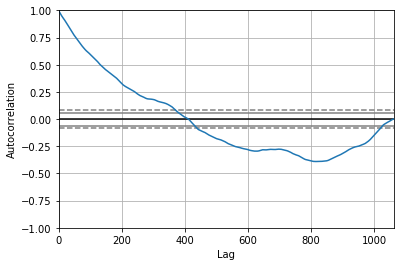

<Figure size 800x560 with 0 Axes>

Test MSE: 0.710


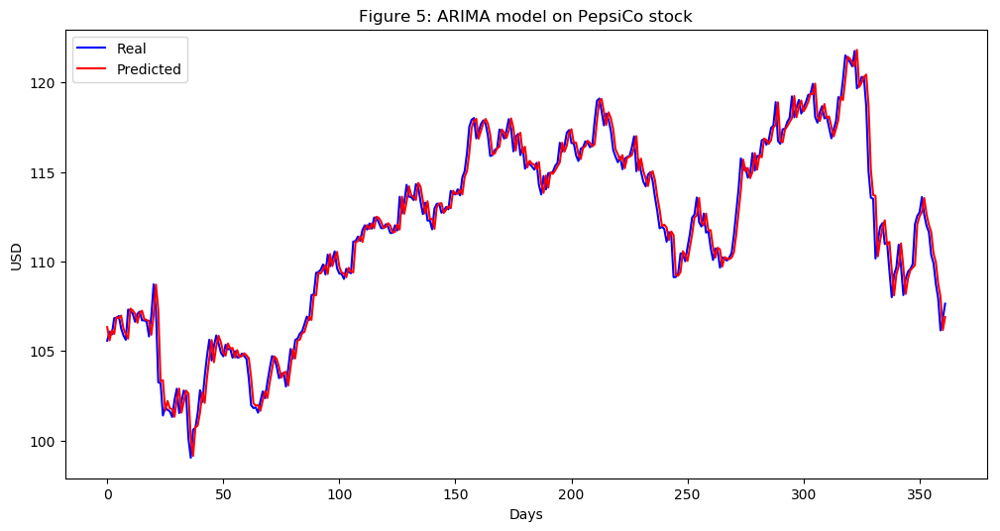

In [114]:
PepsiCo_series = SP500_TechIndicator['PepsiCo_Close']
PepsiCo_series_model = ARIMA(PepsiCo_series, order=(5, 1, 0))
PepsiCo_model_fit = PepsiCo_series_model.fit(disp=0)
print(PepsiCo_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(PepsiCo_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = PepsiCo_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
PepsiCo_predictions = list()
for t in range(len(test)):
    PepsiCo_series_model = ARIMA(history, order=(5,1,0))
    PepsiCo_series_model_fit = PepsiCo_series_model.fit(disp=0)
    PepsiCo_output = PepsiCo_series_model_fit.forecast()
    yhat = PepsiCo_output[0]
    PepsiCo_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, PepsiCo_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(PepsiCo_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on PepsiCo stock')
plt.legend()
plt.show()


#predictions
PepsiCo_predictions = pd.DataFrame({'PepsiCo_predictions':PepsiCo_predictions})
#PepsiCo_predictions.to_csv('PepsiCo_predictions.csv')




                                      ARIMA Model Results                                      
Dep. Variable:     D.Philip_Morris_International_Close   No. Observations:                 1061
Model:                                  ARIMA(5, 1, 0)   Log Likelihood               -1493.314
Method:                                        css-mle   S.D. of innovations              0.989
Date:                                 Sun, 17 Mar 2019   AIC                           3000.627
Time:                                         12:56:13   BIC                           3035.396
Sample:                                              1   HQIC                          3013.804
                                                                                               
                                                coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------------
const       

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


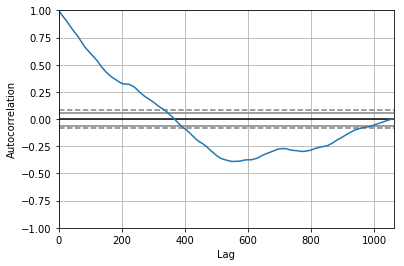

<Figure size 800x560 with 0 Axes>

Test MSE: 1.287


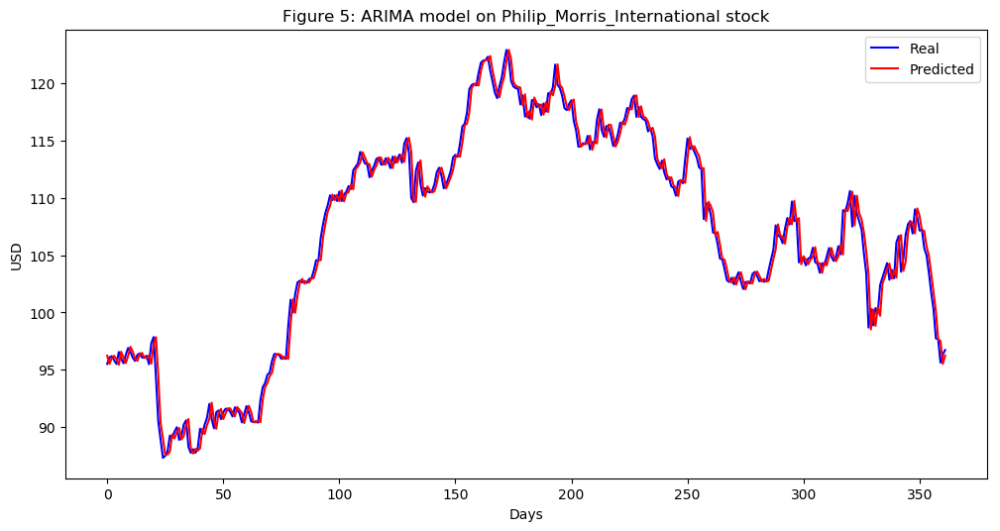

In [115]:
Philip_Morris_International_series = SP500_TechIndicator['Philip_Morris_International_Close']
Philip_Morris_International_series_model = ARIMA(Philip_Morris_International_series, order=(5, 1, 0))
Philip_Morris_International_model_fit = Philip_Morris_International_series_model.fit(disp=0)
print(Philip_Morris_International_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Philip_Morris_International_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Philip_Morris_International_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Philip_Morris_International_predictions = list()
for t in range(len(test)):
    Philip_Morris_International_series_model = ARIMA(history, order=(5,1,0))
    Philip_Morris_International_series_model_fit = Philip_Morris_International_series_model.fit(disp=0)
    Philip_Morris_International_output = Philip_Morris_International_series_model_fit.forecast()
    yhat = Philip_Morris_International_output[0]
    Philip_Morris_International_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Philip_Morris_International_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Philip_Morris_International_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Philip_Morris_International stock')
plt.legend()
plt.show()


#predictions
Philip_Morris_International_predictions = pd.DataFrame({'Philip_Morris_International_predictions':Philip_Morris_International_predictions})
#Philip_Morris_International_predictions.to_csv('Philip_Morris_International_predictions.csv')




                               ARIMA Model Results                                
Dep. Variable:     D.Procter_Gamble_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1155.792
Method:                           css-mle   S.D. of innovations              0.719
Date:                    Sun, 17 Mar 2019   AIC                           2325.584
Time:                            12:57:45   BIC                           2360.353
Sample:                                 1   HQIC                          2338.761
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           -0.0036      0.021     -0.171      0.864      -0.044       0.037
ar.L1.D.Procter_Gamble_Close    -0.0218      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


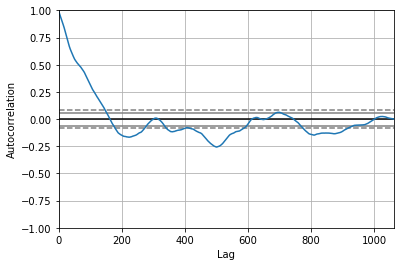

<Figure size 800x560 with 0 Axes>

Test MSE: 0.545


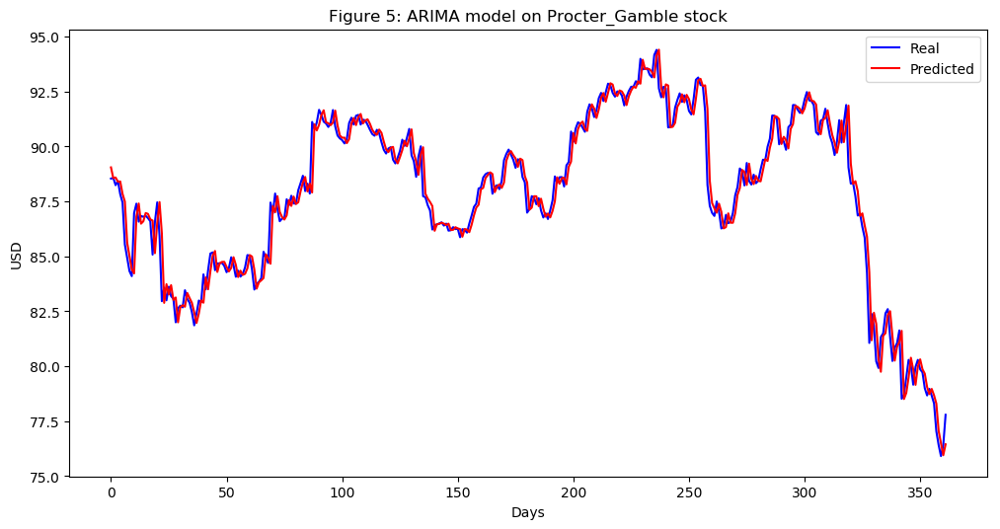

In [116]:
Procter_Gamble_series = SP500_TechIndicator['Procter_Gamble_Close']
Procter_Gamble_series_model = ARIMA(Procter_Gamble_series, order=(5, 1, 0))
Procter_Gamble_model_fit = Procter_Gamble_series_model.fit(disp=0)
print(Procter_Gamble_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Procter_Gamble_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Procter_Gamble_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Procter_Gamble_predictions = list()
for t in range(len(test)):
    Procter_Gamble_series_model = ARIMA(history, order=(5,1,0))
    Procter_Gamble_series_model_fit = Procter_Gamble_series_model.fit(disp=0)
    Procter_Gamble_output = Procter_Gamble_series_model_fit.forecast()
    yhat = Procter_Gamble_output[0]
    Procter_Gamble_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Procter_Gamble_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Procter_Gamble_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Procter_Gamble stock')
plt.legend()
plt.show()


#predictions
Procter_Gamble_predictions = pd.DataFrame({'Procter_Gamble_predictions':Procter_Gamble_predictions})
#Procter_Gamble_predictions.to_csv('Procter_Gamble_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:          D.Sysco_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -785.422
Method:                       css-mle   S.D. of innovations              0.507
Date:                Sun, 17 Mar 2019   AIC                           1584.844
Time:                        12:59:21   BIC                           1619.612
Sample:                             1   HQIC                          1598.020
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0220      0.015      1.482      0.139      -0.007       0.051
ar.L1.D.Sysco_Close    -0.0741      0.031     -2.413      0.016      -0.134      -0.014
ar.L2.D.Sysco_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


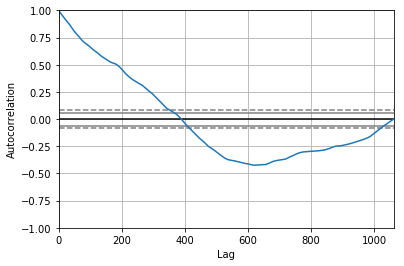

<Figure size 800x560 with 0 Axes>

Test MSE: 0.414


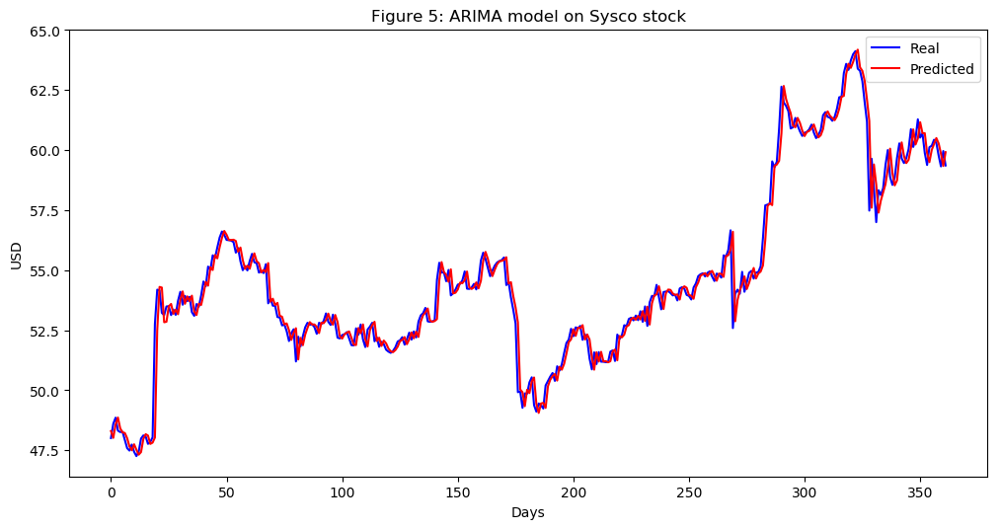

In [117]:
Sysco_series = SP500_TechIndicator['Sysco_Close']
Sysco_series_model = ARIMA(Sysco_series, order=(5, 1, 0))
Sysco_model_fit = Sysco_series_model.fit(disp=0)
print(Sysco_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Sysco_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Sysco_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Sysco_predictions = list()
for t in range(len(test)):
    Sysco_series_model = ARIMA(history, order=(5,1,0))
    Sysco_series_model_fit = Sysco_series_model.fit(disp=0)
    Sysco_output = Sysco_series_model_fit.forecast()
    yhat = Sysco_output[0]
    Sysco_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Sysco_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Sysco_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Sysco stock')
plt.legend()
plt.show()


#predictions
Sysco_predictions = pd.DataFrame({'Sysco_predictions':Sysco_predictions})
#Sysco_predictions.to_csv('Sysco_predictions.csv')




                              ARIMA Model Results                              
Dep. Variable:     D.Tyson_Foods_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -1383.394
Method:                        css-mle   S.D. of innovations              0.891
Date:                 Sun, 17 Mar 2019   AIC                           2780.788
Time:                         13:01:03   BIC                           2815.557
Sample:                              1   HQIC                          2793.965
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0383      0.026      1.477      0.140      -0.013       0.089
ar.L1.D.Tyson_Foods_Close    -0.0456      0.031     -1.487      0.137      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


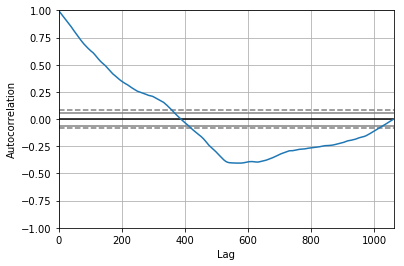

<Figure size 800x560 with 0 Axes>

Test MSE: 0.989


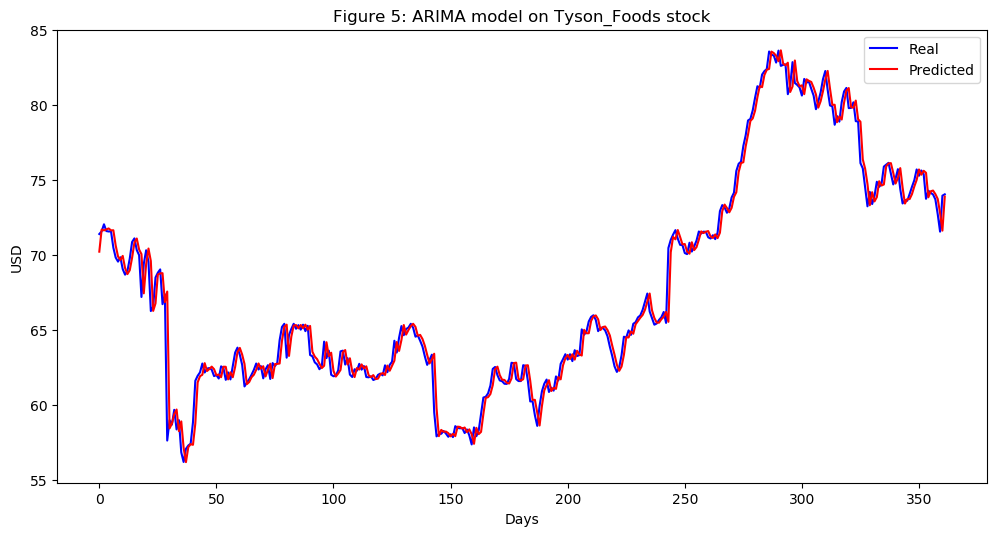

In [118]:
Tyson_Foods_series = SP500_TechIndicator['Tyson_Foods_Close']
Tyson_Foods_series_model = ARIMA(Tyson_Foods_series, order=(5, 1, 0))
Tyson_Foods_model_fit = Tyson_Foods_series_model.fit(disp=0)
print(Tyson_Foods_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Tyson_Foods_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Tyson_Foods_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Tyson_Foods_predictions = list()
for t in range(len(test)):
    Tyson_Foods_series_model = ARIMA(history, order=(5,1,0))
    Tyson_Foods_series_model_fit = Tyson_Foods_series_model.fit(disp=0)
    Tyson_Foods_output = Tyson_Foods_series_model_fit.forecast()
    yhat = Tyson_Foods_output[0]
    Tyson_Foods_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Tyson_Foods_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Tyson_Foods_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Tyson_Foods stock')
plt.legend()
plt.show()


#predictions
Tyson_Foods_predictions = pd.DataFrame({'Tyson_Foods_predictions':Tyson_Foods_predictions})
#Tyson_Foods_predictions.to_csv('Tyson_Foods_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:        D.Walmart_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1440.243
Method:                       css-mle   S.D. of innovations              0.940
Date:                Sun, 17 Mar 2019   AIC                           2894.486
Time:                        13:01:58   BIC                           2929.255
Sample:                             1   HQIC                          2907.663
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0069      0.027      0.258      0.796      -0.045       0.059
ar.L1.D.Walmart_Close    -0.0260      0.031     -0.847      0.397      -0.086       0.034
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


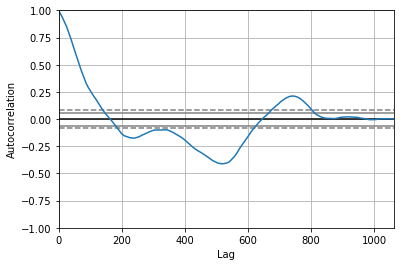

<Figure size 800x560 with 0 Axes>

Test MSE: 1.312


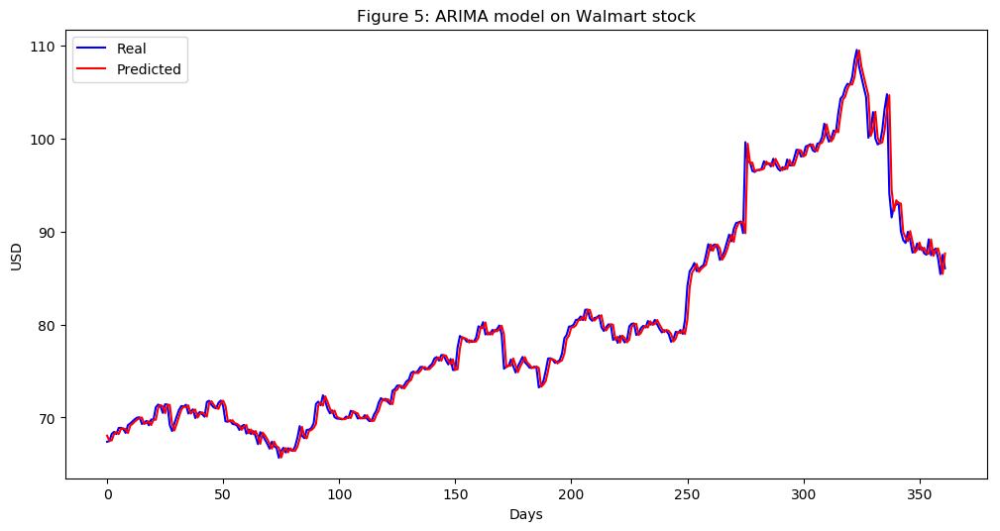

In [119]:
Walmart_series = SP500_TechIndicator['Walmart_Close']
Walmart_series_model = ARIMA(Walmart_series, order=(5, 1, 0))
Walmart_model_fit = Walmart_series_model.fit(disp=0)
print(Walmart_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Walmart_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Walmart_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Walmart_predictions = list()
for t in range(len(test)):
    Walmart_series_model = ARIMA(history, order=(5,1,0))
    Walmart_series_model_fit = Walmart_series_model.fit(disp=0)
    Walmart_output = Walmart_series_model_fit.forecast()
    yhat = Walmart_output[0]
    Walmart_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Walmart_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Walmart_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Walmart stock')
plt.legend()
plt.show()


#predictions
Walmart_predictions = pd.DataFrame({'Walmart_predictions':Walmart_predictions})
#Walmart_predictions.to_csv('Walmart_predictions.csv')




                                    ARIMA Model Results                                     
Dep. Variable:     D.Walgreens_Boots_Alliance_Close   No. Observations:                 1061
Model:                               ARIMA(5, 1, 0)   Log Likelihood               -1687.848
Method:                                     css-mle   S.D. of innovations              1.188
Date:                              Sun, 17 Mar 2019   AIC                           3389.695
Time:                                      13:03:06   BIC                           3424.464
Sample:                                           1   HQIC                          3402.872
                                                                                            
                                             coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------------
const                                     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


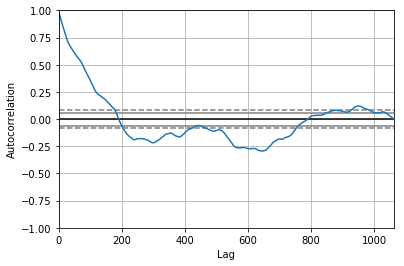

<Figure size 800x560 with 0 Axes>

Test MSE: 0.970


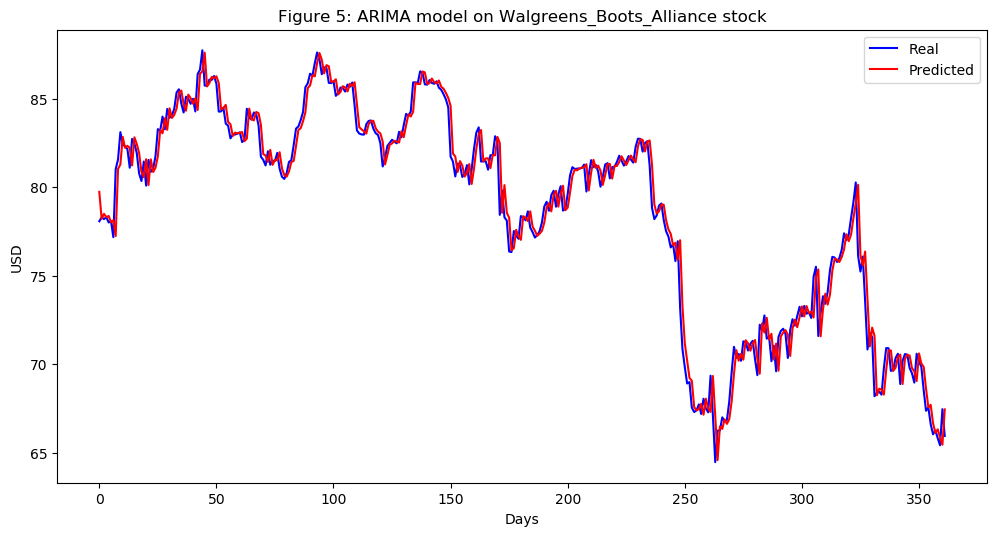

In [120]:
Walgreens_Boots_Alliance_series = SP500_TechIndicator['Walgreens_Boots_Alliance_Close']
Walgreens_Boots_Alliance_series_model = ARIMA(Walgreens_Boots_Alliance_series, order=(5, 1, 0))
Walgreens_Boots_Alliance_model_fit = Walgreens_Boots_Alliance_series_model.fit(disp=0)
print(Walgreens_Boots_Alliance_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Walgreens_Boots_Alliance_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Walgreens_Boots_Alliance_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Walgreens_Boots_Alliance_predictions = list()
for t in range(len(test)):
    Walgreens_Boots_Alliance_series_model = ARIMA(history, order=(5,1,0))
    Walgreens_Boots_Alliance_series_model_fit = Walgreens_Boots_Alliance_series_model.fit(disp=0)
    Walgreens_Boots_Alliance_output = Walgreens_Boots_Alliance_series_model_fit.forecast()
    yhat = Walgreens_Boots_Alliance_output[0]
    Walgreens_Boots_Alliance_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Walgreens_Boots_Alliance_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Walgreens_Boots_Alliance_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Walgreens_Boots_Alliance stock')
plt.legend()
plt.show()


#predictions
Walgreens_Boots_Alliance_predictions = pd.DataFrame({'Walgreens_Boots_Alliance_predictions':Walgreens_Boots_Alliance_predictions})
#Walgreens_Boots_Alliance_predictions.to_csv('Walgreens_Boots_Alliance_predictions.csv')




                                 ARIMA Model Results                                  
Dep. Variable:     D.Anadarko_Petroleum_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1933.411
Method:                               css-mle   S.D. of innovations              1.497
Date:                        Sun, 17 Mar 2019   AIC                           3880.822
Time:                                13:04:02   BIC                           3915.591
Sample:                                     1   HQIC                          3893.999
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -0.0175      0.044     -0.400      0.689      -0.103       0.068
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


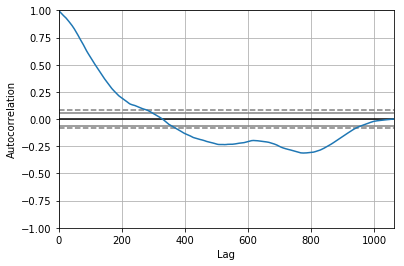

<Figure size 800x560 with 0 Axes>

Test MSE: 1.193


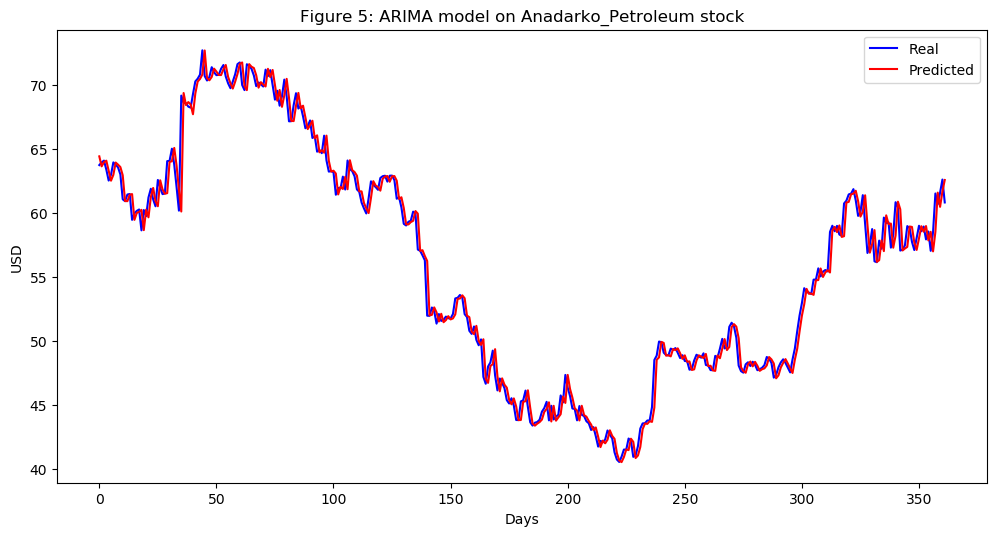

In [121]:
Anadarko_Petroleum_series = SP500_TechIndicator['Anadarko_Petroleum_Close']
Anadarko_Petroleum_series_model = ARIMA(Anadarko_Petroleum_series, order=(5, 1, 0))
Anadarko_Petroleum_model_fit = Anadarko_Petroleum_series_model.fit(disp=0)
print(Anadarko_Petroleum_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Anadarko_Petroleum_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Anadarko_Petroleum_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Anadarko_Petroleum_predictions = list()
for t in range(len(test)):
    Anadarko_Petroleum_series_model = ARIMA(history, order=(5,1,0))
    Anadarko_Petroleum_series_model_fit = Anadarko_Petroleum_series_model.fit(disp=0)
    Anadarko_Petroleum_output = Anadarko_Petroleum_series_model_fit.forecast()
    yhat = Anadarko_Petroleum_output[0]
    Anadarko_Petroleum_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Anadarko_Petroleum_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Anadarko_Petroleum_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Anadarko_Petroleum stock')
plt.legend()
plt.show()


#predictions
Anadarko_Petroleum_predictions = pd.DataFrame({'Anadarko_Petroleum_predictions':Anadarko_Petroleum_predictions})
#Anadarko_Petroleum_predictions.to_csv('Anadarko_Petroleum_predictions.csv')




                                 ARIMA Model Results                                  
Dep. Variable:     D.Apache_Corporation_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1767.596
Method:                               css-mle   S.D. of innovations              1.280
Date:                        Sun, 17 Mar 2019   AIC                           3549.192
Time:                                13:05:27   BIC                           3583.960
Sample:                                     1   HQIC                          3562.368
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -0.0457      0.040     -1.148      0.251      -0.124       0.032
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


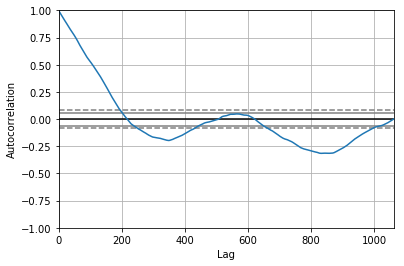

<Figure size 800x560 with 0 Axes>

Test MSE: 1.038


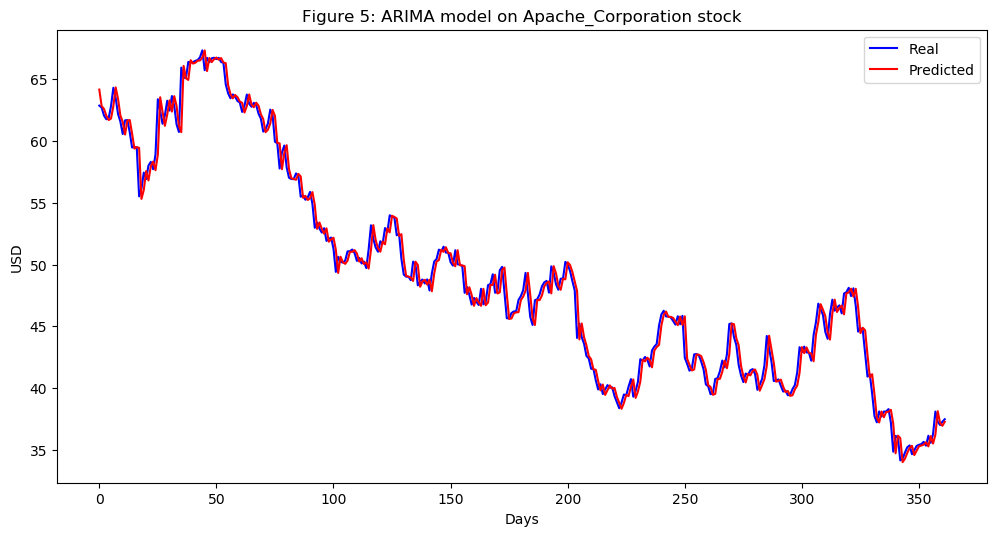

In [122]:
Apache_Corporation_series = SP500_TechIndicator['Apache_Corporation_Close']
Apache_Corporation_series_model = ARIMA(Apache_Corporation_series, order=(5, 1, 0))
Apache_Corporation_model_fit = Apache_Corporation_series_model.fit(disp=0)
print(Apache_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Apache_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Apache_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Apache_Corporation_predictions = list()
for t in range(len(test)):
    Apache_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Apache_Corporation_series_model_fit = Apache_Corporation_series_model.fit(disp=0)
    Apache_Corporation_output = Apache_Corporation_series_model_fit.forecast()
    yhat = Apache_Corporation_output[0]
    Apache_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Apache_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Apache_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Apache_Corporation stock')
plt.legend()
plt.show()


#predictions
Apache_Corporation_predictions = pd.DataFrame({'Apache_Corporation_predictions':Apache_Corporation_predictions})
#Apache_Corporation_predictions.to_csv('Apache_Corporation_predictions.csv')




                               ARIMA Model Results                               
Dep. Variable:     D.Cabot_Oil_Gas_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood                -878.630
Method:                          css-mle   S.D. of innovations              0.554
Date:                   Sun, 17 Mar 2019   AIC                           1771.260
Time:                           13:07:07   BIC                           1806.029
Sample:                                1   HQIC                          1784.437
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          -0.0141      0.016     -0.888      0.375      -0.045       0.017
ar.L1.D.Cabot_Oil_Gas_Close    -0.0536      0.031     -1

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


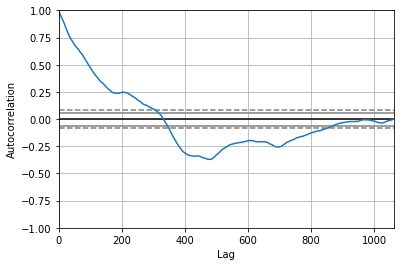

<Figure size 800x560 with 0 Axes>

Test MSE: 0.219


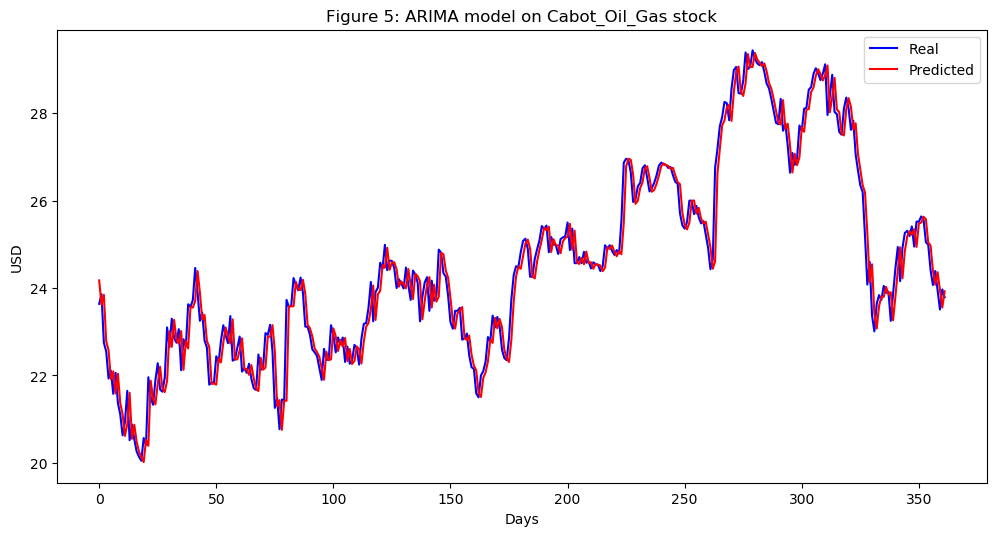

In [123]:
Cabot_Oil_Gas_series = SP500_TechIndicator['Cabot_Oil_Gas_Close']
Cabot_Oil_Gas_series_model = ARIMA(Cabot_Oil_Gas_series, order=(5, 1, 0))
Cabot_Oil_Gas_model_fit = Cabot_Oil_Gas_series_model.fit(disp=0)
print(Cabot_Oil_Gas_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Cabot_Oil_Gas_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Cabot_Oil_Gas_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Cabot_Oil_Gas_predictions = list()
for t in range(len(test)):
    Cabot_Oil_Gas_series_model = ARIMA(history, order=(5,1,0))
    Cabot_Oil_Gas_series_model_fit = Cabot_Oil_Gas_series_model.fit(disp=0)
    Cabot_Oil_Gas_output = Cabot_Oil_Gas_series_model_fit.forecast()
    yhat = Cabot_Oil_Gas_output[0]
    Cabot_Oil_Gas_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Cabot_Oil_Gas_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Cabot_Oil_Gas_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Cabot_Oil_Gas stock')
plt.legend()
plt.show()


#predictions
Cabot_Oil_Gas_predictions = pd.DataFrame({'Cabot_Oil_Gas_predictions':Cabot_Oil_Gas_predictions})
#Cabot_Oil_Gas_predictions.to_csv('Cabot_Oil_Gas_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:        D.Chevron_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1853.365
Method:                       css-mle   S.D. of innovations              1.388
Date:                Sun, 17 Mar 2019   AIC                           3720.730
Time:                        13:08:38   BIC                           3755.499
Sample:                             1   HQIC                          3733.907
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.0096      0.041     -0.235      0.814      -0.090       0.071
ar.L1.D.Chevron_Close     0.0132      0.031      0.430      0.668      -0.047       0.073
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


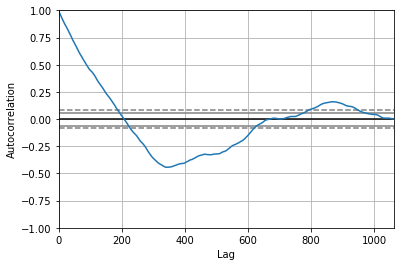

<Figure size 800x560 with 0 Axes>

Test MSE: 1.595


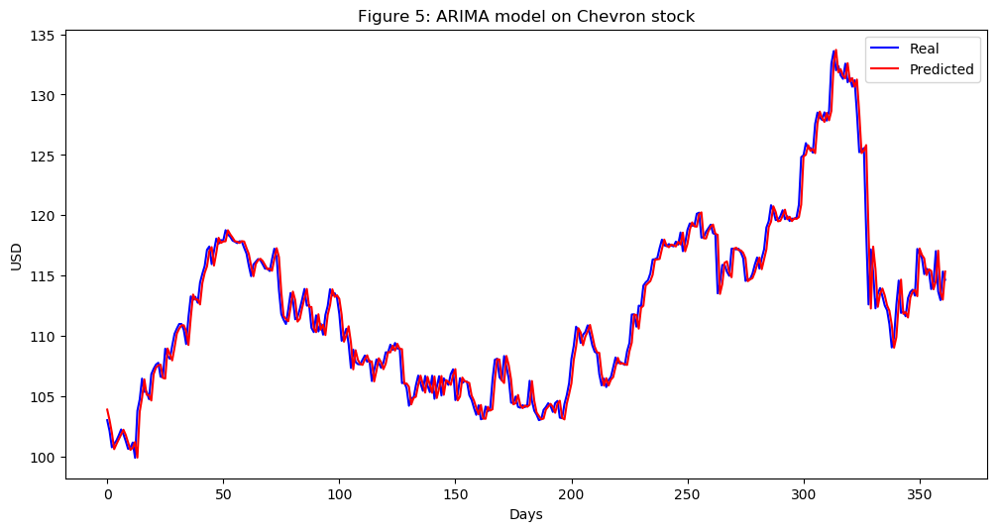

In [124]:
Chevron_series = SP500_TechIndicator['Chevron_Close']
Chevron_series_model = ARIMA(Chevron_series, order=(5, 1, 0))
Chevron_model_fit = Chevron_series_model.fit(disp=0)
print(Chevron_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Chevron_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Chevron_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Chevron_predictions = list()
for t in range(len(test)):
    Chevron_series_model = ARIMA(history, order=(5,1,0))
    Chevron_series_model_fit = Chevron_series_model.fit(disp=0)
    Chevron_output = Chevron_series_model_fit.forecast()
    yhat = Chevron_output[0]
    Chevron_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Chevron_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Chevron_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Chevron stock')
plt.legend()
plt.show()


#predictions
Chevron_predictions = pd.DataFrame({'Chevron_predictions':Chevron_predictions})
#Chevron_predictions.to_csv('Chevron_predictions.csv')





                               ARIMA Model Results                                
Dep. Variable:     D.Cimarex_Energy_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -2453.700
Method:                           css-mle   S.D. of innovations              2.444
Date:                    Sun, 17 Mar 2019   AIC                           4921.400
Time:                            13:09:46   BIC                           4956.168
Sample:                                 1   HQIC                          4934.576
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           -0.0103      0.071     -0.146      0.884      -0.149       0.128
ar.L1.D.Cimarex_Energy_Close    -0.0679      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


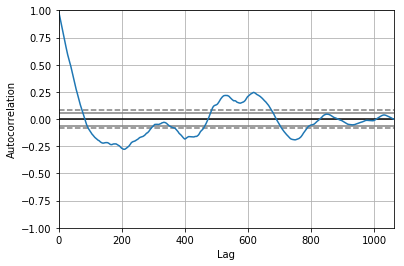

<Figure size 800x560 with 0 Axes>

Test MSE: 4.039


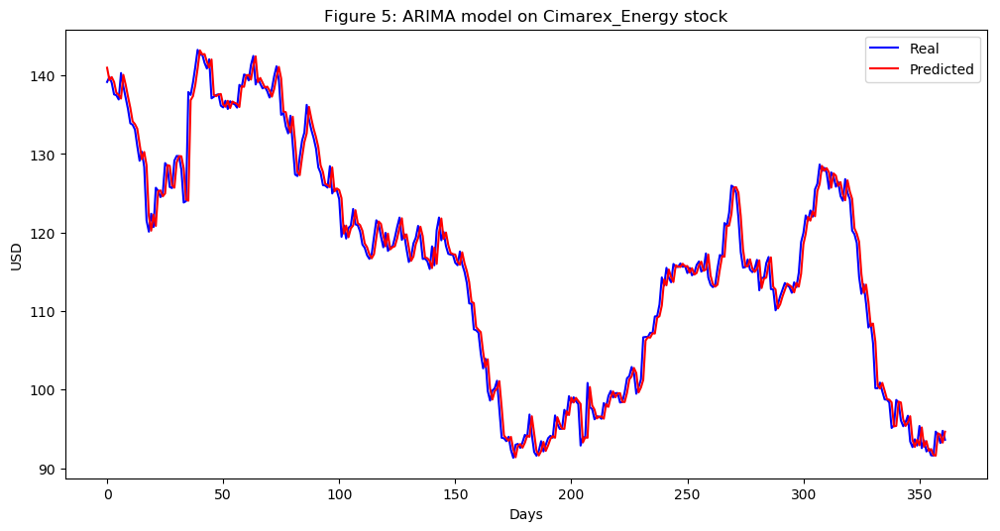

In [125]:
Cimarex_Energy_series = SP500_TechIndicator['Cimarex_Energy_Close']
Cimarex_Energy_series_model = ARIMA(Cimarex_Energy_series, order=(5, 1, 0))
Cimarex_Energy_model_fit = Cimarex_Energy_series_model.fit(disp=0)
print(Cimarex_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Cimarex_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Cimarex_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Cimarex_Energy_predictions = list()
for t in range(len(test)):
    Cimarex_Energy_series_model = ARIMA(history, order=(5,1,0))
    Cimarex_Energy_series_model_fit = Cimarex_Energy_series_model.fit(disp=0)
    Cimarex_Energy_output = Cimarex_Energy_series_model_fit.forecast()
    yhat = Cimarex_Energy_output[0]
    Cimarex_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Cimarex_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Cimarex_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Cimarex_Energy stock')
plt.legend()
plt.show()


#predictions
Cimarex_Energy_predictions = pd.DataFrame({'Cimarex_Energy_predictions':Cimarex_Energy_predictions})
#Cimarex_Energy_predictions.to_csv('Cimarex_Energy_predictions.csv')





                                ARIMA Model Results                                 
Dep. Variable:     D.Concho_Resources_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -2535.762
Method:                             css-mle   S.D. of innovations              2.641
Date:                      Sun, 17 Mar 2019   AIC                           5085.525
Time:                              13:10:47   BIC                           5120.294
Sample:                                   1   HQIC                          5098.702
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0464      0.075      0.618      0.537      -0.101       0.194
ar.L1.D.Concho_Resource

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


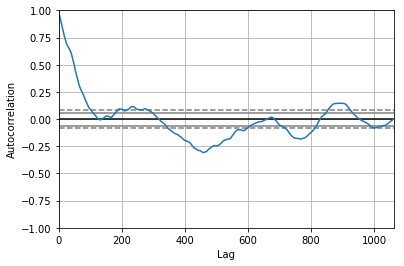

<Figure size 800x560 with 0 Axes>

Test MSE: 5.558


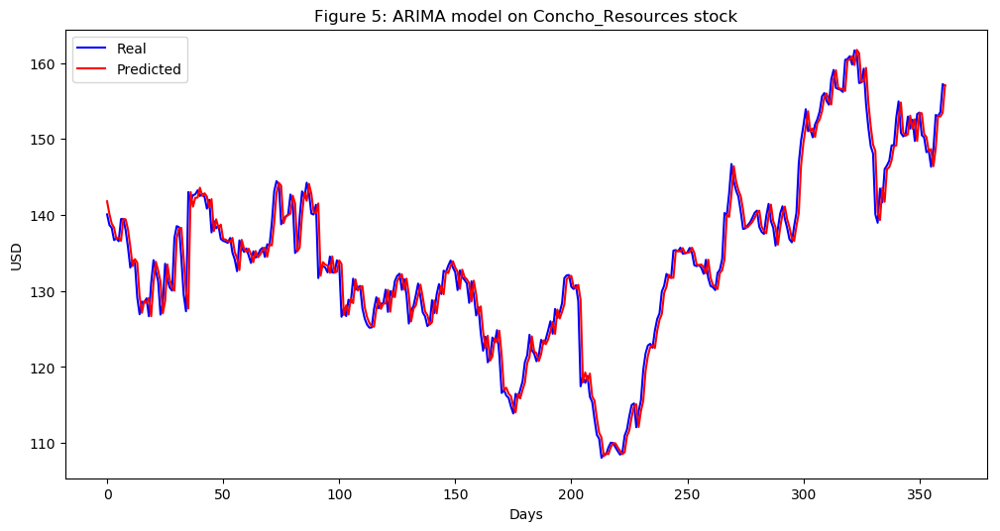

In [126]:
Concho_Resources_series = SP500_TechIndicator['Concho_Resources_Close']
Concho_Resources_series_model = ARIMA(Concho_Resources_series, order=(5, 1, 0))
Concho_Resources_model_fit = Concho_Resources_series_model.fit(disp=0)
print(Concho_Resources_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Concho_Resources_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Concho_Resources_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Concho_Resources_predictions = list()
for t in range(len(test)):
    Concho_Resources_series_model = ARIMA(history, order=(5,1,0))
    Concho_Resources_series_model_fit = Concho_Resources_series_model.fit(disp=0)
    Concho_Resources_output = Concho_Resources_series_model_fit.forecast()
    yhat = Concho_Resources_output[0]
    Concho_Resources_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Concho_Resources_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Concho_Resources_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Concho_Resources stock')
plt.legend()
plt.show()


#predictions
Concho_Resources_predictions = pd.DataFrame({'Concho_Resources_predictions':Concho_Resources_predictions})
#Concho_Resources_predictions.to_csv('Concho_Resources_predictions.csv')





                               ARIMA Model Results                                
Dep. Variable:     D.ConocoPhillips_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1480.427
Method:                           css-mle   S.D. of innovations              0.977
Date:                    Sun, 17 Mar 2019   AIC                           2974.854
Time:                            13:11:43   BIC                           3009.623
Sample:                                 1   HQIC                          2988.030
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           -0.0110      0.030     -0.364      0.716      -0.070       0.048
ar.L1.D.ConocoPhillips_Close     0.0427      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


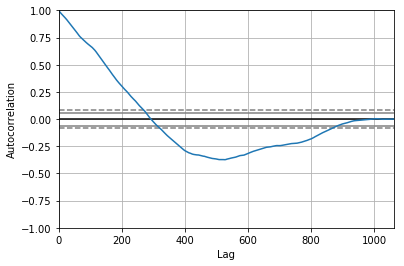

<Figure size 800x560 with 0 Axes>

Test MSE: 0.661


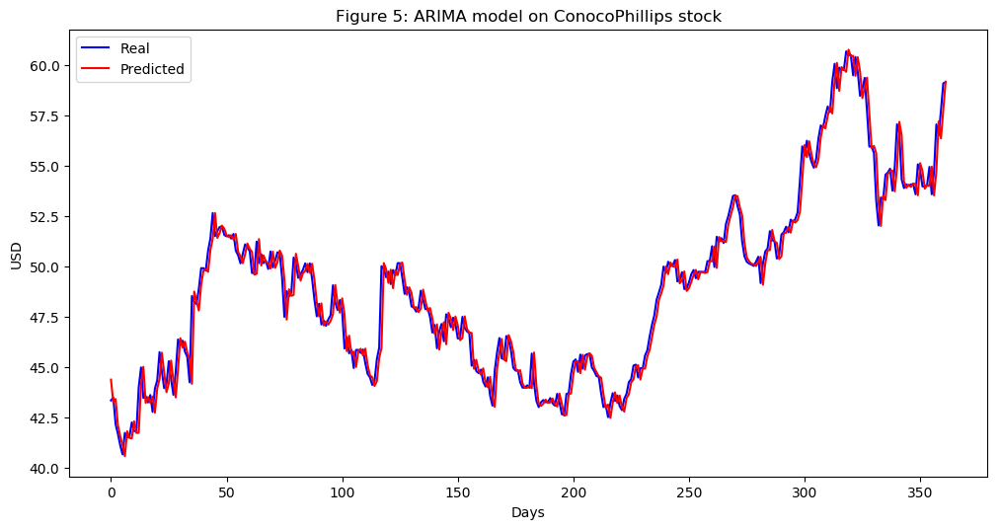

In [127]:
ConocoPhillips_series = SP500_TechIndicator['ConocoPhillips_Close']
ConocoPhillips_series_model = ARIMA(ConocoPhillips_series, order=(5, 1, 0))
ConocoPhillips_model_fit = ConocoPhillips_series_model.fit(disp=0)
print(ConocoPhillips_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(ConocoPhillips_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = ConocoPhillips_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
ConocoPhillips_predictions = list()
for t in range(len(test)):
    ConocoPhillips_series_model = ARIMA(history, order=(5,1,0))
    ConocoPhillips_series_model_fit = ConocoPhillips_series_model.fit(disp=0)
    ConocoPhillips_output = ConocoPhillips_series_model_fit.forecast()
    yhat = ConocoPhillips_output[0]
    ConocoPhillips_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, ConocoPhillips_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(ConocoPhillips_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on ConocoPhillips stock')
plt.legend()
plt.show()


#predictions
ConocoPhillips_predictions = pd.DataFrame({'ConocoPhillips_predictions':ConocoPhillips_predictions})
#ConocoPhillips_predictions.to_csv('ConocoPhillips_predictions.csv')





                              ARIMA Model Results                               
Dep. Variable:     D.Devon_Energy_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -1584.396
Method:                         css-mle   S.D. of innovations              1.077
Date:                  Sun, 17 Mar 2019   AIC                           3182.791
Time:                          13:12:43   BIC                           3217.560
Sample:                               1   HQIC                          3195.968
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                         -0.0285      0.033     -0.861      0.389      -0.093       0.036
ar.L1.D.Devon_Energy_Close    -0.0153      0.031     -0.499      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


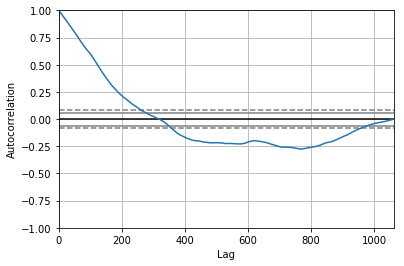

<Figure size 800x560 with 0 Axes>

Test MSE: 0.757


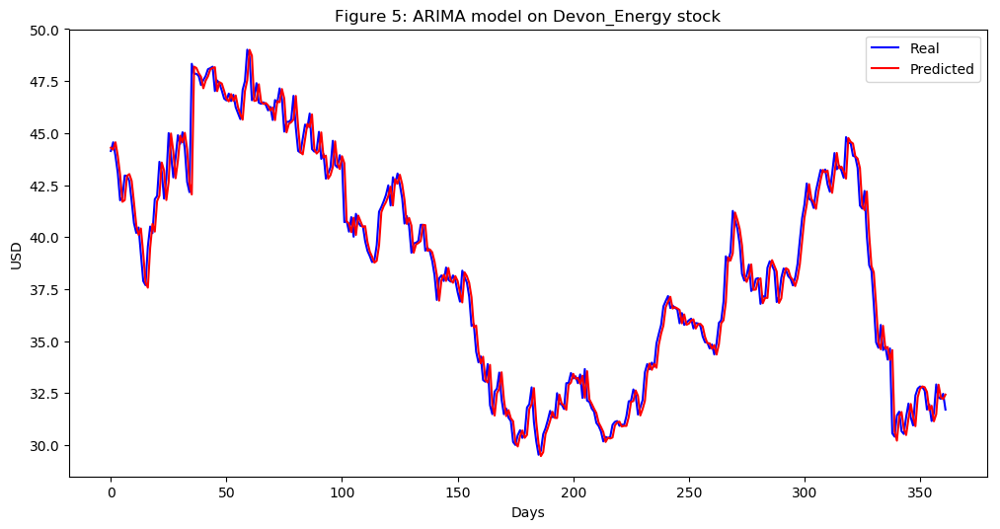

In [128]:
Devon_Energy_series = SP500_TechIndicator['Devon_Energy_Close']
Devon_Energy_series_model = ARIMA(Devon_Energy_series, order=(5, 1, 0))
Devon_Energy_model_fit = Devon_Energy_series_model.fit(disp=0)
print(Devon_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Devon_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Devon_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Devon_Energy_predictions = list()
for t in range(len(test)):
    Devon_Energy_series_model = ARIMA(history, order=(5,1,0))
    Devon_Energy_series_model_fit = Devon_Energy_series_model.fit(disp=0)
    Devon_Energy_output = Devon_Energy_series_model_fit.forecast()
    yhat = Devon_Energy_output[0]
    Devon_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Devon_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Devon_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Devon_Energy stock')
plt.legend()
plt.show()


#predictions
Devon_Energy_predictions = pd.DataFrame({'Devon_Energy_predictions':Devon_Energy_predictions})
#Devon_Energy_predictions.to_csv('Devon_Energy_predictions.csv')





                                 ARIMA Model Results                                  
Dep. Variable:     D.Diamondback_Energy_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -2218.798
Method:                               css-mle   S.D. of innovations              1.959
Date:                        Sun, 17 Mar 2019   AIC                           4451.596
Time:                                13:13:38   BIC                           4486.365
Sample:                                     1   HQIC                          4464.772
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0725      0.051      1.430      0.153      -0.027       0.172
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


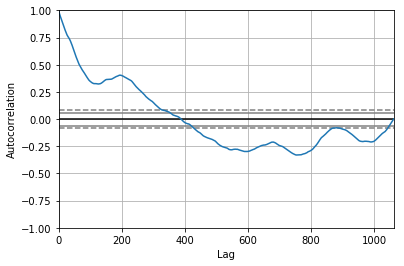

<Figure size 800x560 with 0 Axes>

Test MSE: 4.613


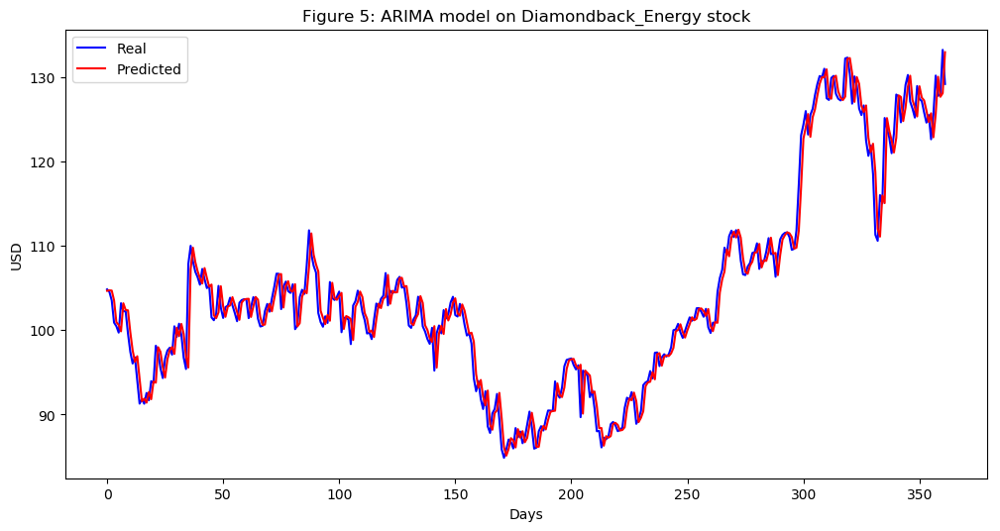

In [129]:
Diamondback_Energy_series = SP500_TechIndicator['Diamondback_Energy_Close']
Diamondback_Energy_series_model = ARIMA(Diamondback_Energy_series, order=(5, 1, 0))
Diamondback_Energy_model_fit = Diamondback_Energy_series_model.fit(disp=0)
print(Diamondback_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Diamondback_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Diamondback_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Diamondback_Energy_predictions = list()
for t in range(len(test)):
    Diamondback_Energy_series_model = ARIMA(history, order=(5,1,0))
    Diamondback_Energy_series_model_fit = Diamondback_Energy_series_model.fit(disp=0)
    Diamondback_Energy_output = Diamondback_Energy_series_model_fit.forecast()
    yhat = Diamondback_Energy_output[0]
    Diamondback_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Diamondback_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Diamondback_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Diamondback_Energy stock')
plt.legend()
plt.show()


#predictions
Diamondback_Energy_predictions = pd.DataFrame({'Diamondback_Energy_predictions':Diamondback_Energy_predictions})
#Diamondback_Energy_predictions.to_csv('Diamondback_Energy_predictions.csv')





                               ARIMA Model Results                               
Dep. Variable:     D.EOG_Resources_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -2822.196
Method:                          css-mle   S.D. of innovations              3.459
Date:                   Sun, 17 Mar 2019   AIC                           5658.392
Time:                           13:14:29   BIC                           5693.161
Sample:                                1   HQIC                          5671.569
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          -0.0579      0.098     -0.589      0.556      -0.251       0.135
ar.L1.D.EOG_Resources_Close     0.0010      0.031      0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


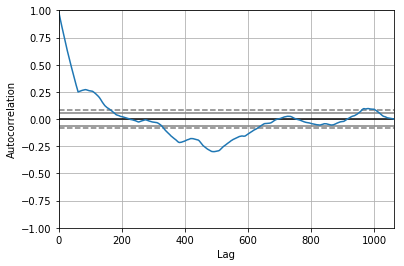

<Figure size 800x560 with 0 Axes>

Test MSE: 2.197


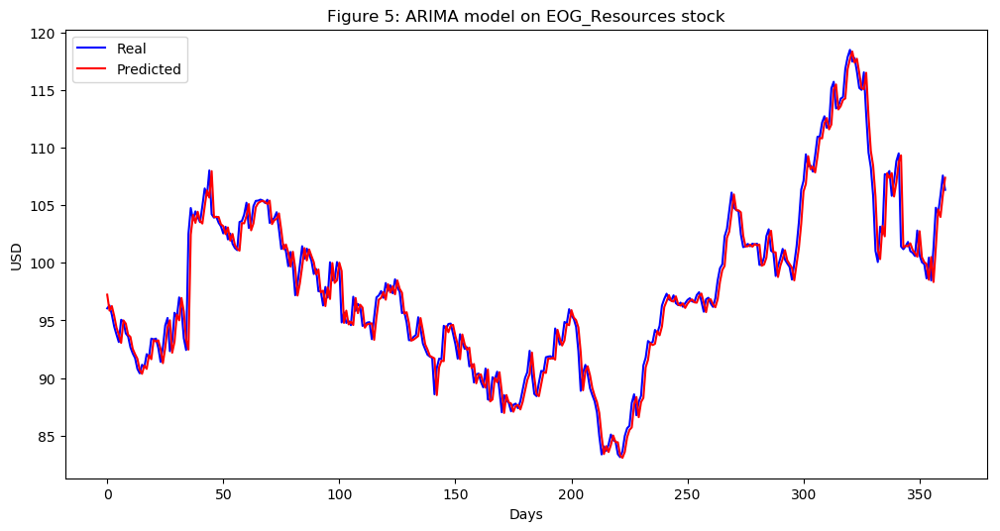

In [130]:
EOG_Resources_series = SP500_TechIndicator['EOG_Resources_Close']
EOG_Resources_series_model = ARIMA(EOG_Resources_series, order=(5, 1, 0))
EOG_Resources_model_fit = EOG_Resources_series_model.fit(disp=0)
print(EOG_Resources_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(EOG_Resources_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = EOG_Resources_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
EOG_Resources_predictions = list()
for t in range(len(test)):
    EOG_Resources_series_model = ARIMA(history, order=(5,1,0))
    EOG_Resources_series_model_fit = EOG_Resources_series_model.fit(disp=0)
    EOG_Resources_output = EOG_Resources_series_model_fit.forecast()
    yhat = EOG_Resources_output[0]
    EOG_Resources_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, EOG_Resources_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(EOG_Resources_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on EOG_Resources stock')
plt.legend()
plt.show()


#predictions
EOG_Resources_predictions = pd.DataFrame({'EOG_Resources_predictions':EOG_Resources_predictions})
#EOG_Resources_predictions.to_csv('EOG_Resources_predictions.csv')





                              ARIMA Model Results                              
Dep. Variable:     D.Exxon_Mobil_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -1479.922
Method:                        css-mle   S.D. of innovations              0.976
Date:                 Sun, 17 Mar 2019   AIC                           2973.844
Time:                         13:15:29   BIC                           3008.613
Sample:                              1   HQIC                          2987.021
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                        -0.0258      0.027     -0.973      0.331      -0.078       0.026
ar.L1.D.Exxon_Mobil_Close    -0.0051      0.031     -0.165      0.869      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


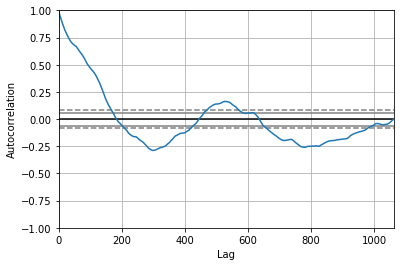

<Figure size 800x560 with 0 Axes>

Test MSE: 0.625


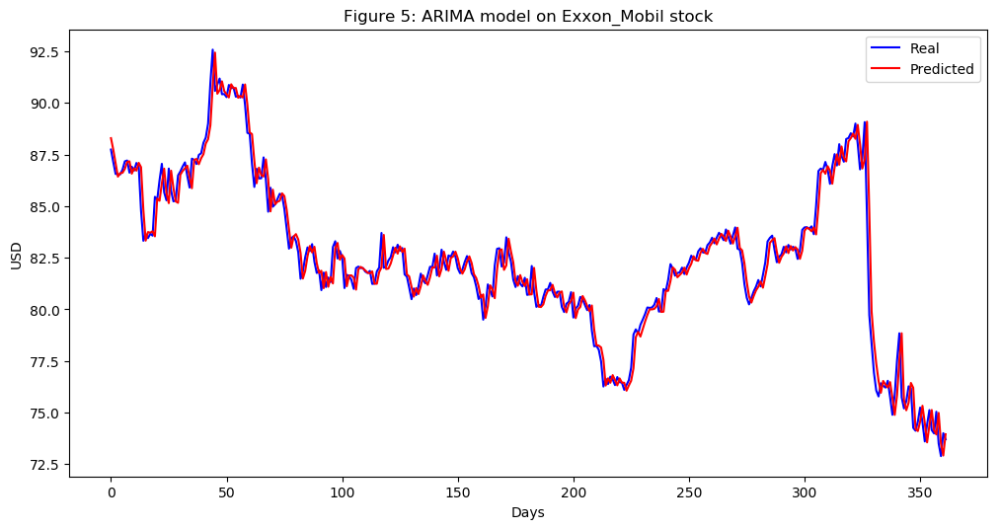

In [131]:
Exxon_Mobil_series = SP500_TechIndicator['Exxon_Mobil_Close']
Exxon_Mobil_series_model = ARIMA(Exxon_Mobil_series, order=(5, 1, 0))
Exxon_Mobil_model_fit = Exxon_Mobil_series_model.fit(disp=0)
print(Exxon_Mobil_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Exxon_Mobil_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Exxon_Mobil_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Exxon_Mobil_predictions = list()
for t in range(len(test)):
    Exxon_Mobil_series_model = ARIMA(history, order=(5,1,0))
    Exxon_Mobil_series_model_fit = Exxon_Mobil_series_model.fit(disp=0)
    Exxon_Mobil_output = Exxon_Mobil_series_model_fit.forecast()
    yhat = Exxon_Mobil_output[0]
    Exxon_Mobil_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Exxon_Mobil_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Exxon_Mobil_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Exxon_Mobil stock')
plt.legend()
plt.show()


#predictions
Exxon_Mobil_predictions = pd.DataFrame({'Exxon_Mobil_predictions':Exxon_Mobil_predictions})
#Exxon_Mobil_predictions.to_csv('Exxon_Mobil_predictions.csv')





                              ARIMA Model Results                              
Dep. Variable:     D.Halliburton_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -1387.849
Method:                        css-mle   S.D. of innovations              0.895
Date:                 Sun, 17 Mar 2019   AIC                           2789.698
Time:                         13:16:24   BIC                           2824.466
Sample:                              1   HQIC                          2802.874
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                        -0.0036      0.026     -0.138      0.890      -0.055       0.048
ar.L1.D.Halliburton_Close     0.0326      0.031      1.060      0.289      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


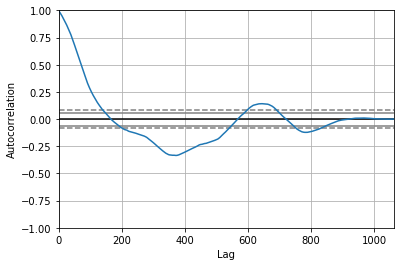

<Figure size 800x560 with 0 Axes>

Test MSE: 0.627


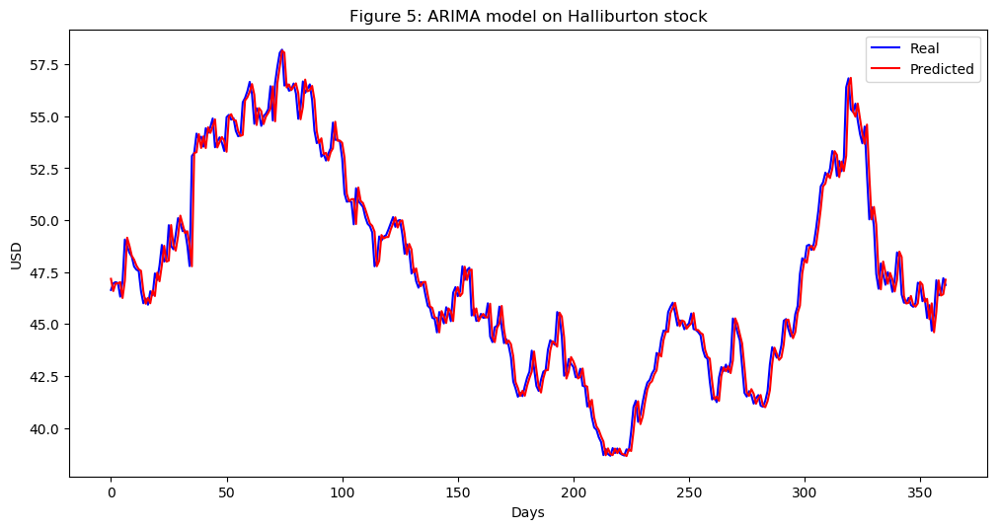

In [132]:
Halliburton_series = SP500_TechIndicator['Halliburton_Close']
Halliburton_series_model = ARIMA(Halliburton_series, order=(5, 1, 0))
Halliburton_model_fit = Halliburton_series_model.fit(disp=0)
print(Halliburton_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Halliburton_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Halliburton_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Halliburton_predictions = list()
for t in range(len(test)):
    Halliburton_series_model = ARIMA(history, order=(5,1,0))
    Halliburton_series_model_fit = Halliburton_series_model.fit(disp=0)
    Halliburton_output = Halliburton_series_model_fit.forecast()
    yhat = Halliburton_output[0]
    Halliburton_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Halliburton_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Halliburton_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Halliburton stock')
plt.legend()
plt.show()


#predictions
Halliburton_predictions = pd.DataFrame({'Halliburton_predictions':Halliburton_predictions})
#Halliburton_predictions.to_csv('Halliburton_predictions.csv')





                                ARIMA Model Results                                
Dep. Variable:     D.Helmerich_Payne_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1999.871
Method:                            css-mle   S.D. of innovations              1.594
Date:                     Sun, 17 Mar 2019   AIC                           4013.743
Time:                             13:17:16   BIC                           4048.512
Sample:                                  1   HQIC                          4026.919
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                            -0.0165      0.046     -0.356      0.722      -0.107       0.074
ar.L1.D.Helmerich_Payne_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


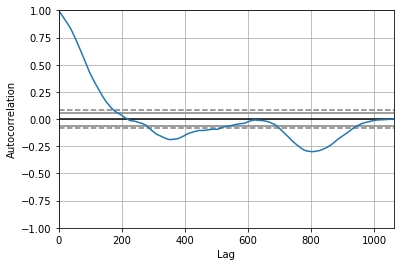

<Figure size 800x560 with 0 Axes>

Test MSE: 1.647


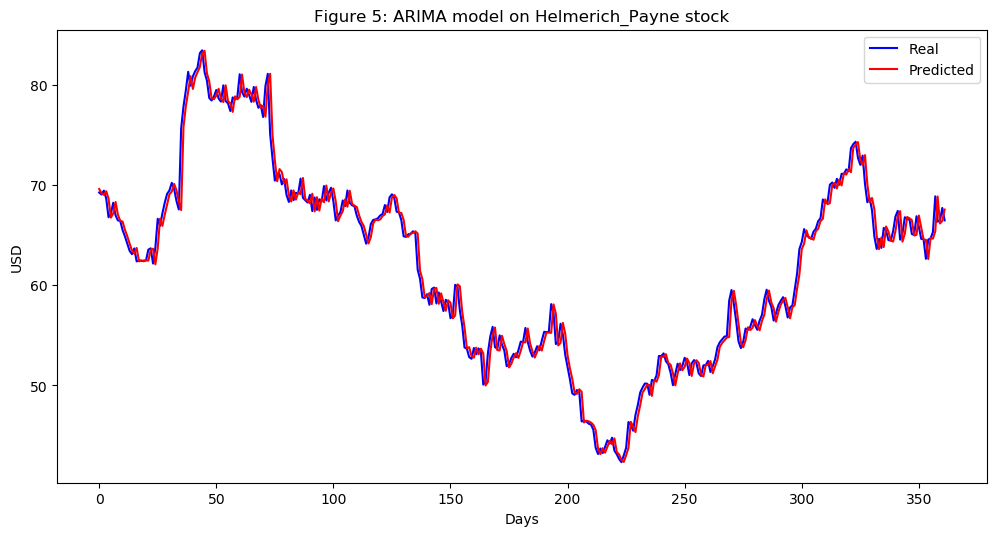

In [133]:
Helmerich_Payne_series = SP500_TechIndicator['Helmerich_Payne_Close']
Helmerich_Payne_series_model = ARIMA(Helmerich_Payne_series, order=(5, 1, 0))
Helmerich_Payne_model_fit = Helmerich_Payne_series_model.fit(disp=0)
print(Helmerich_Payne_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Helmerich_Payne_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Helmerich_Payne_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Helmerich_Payne_predictions = list()
for t in range(len(test)):
    Helmerich_Payne_series_model = ARIMA(history, order=(5,1,0))
    Helmerich_Payne_series_model_fit = Helmerich_Payne_series_model.fit(disp=0)
    Helmerich_Payne_output = Helmerich_Payne_series_model_fit.forecast()
    yhat = Helmerich_Payne_output[0]
    Helmerich_Payne_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Helmerich_Payne_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Helmerich_Payne_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Helmerich_Payne stock')
plt.legend()
plt.show()


#predictions
Helmerich_Payne_predictions = pd.DataFrame({'Helmerich_Payne_predictions':Helmerich_Payne_predictions})
#Helmerich_Payne_predictions.to_csv('Helmerich_Payne_predictions.csv')





                                ARIMA Model Results                                 
Dep. Variable:     D.Hess_Corporation_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -1763.799
Method:                             css-mle   S.D. of innovations              1.276
Date:                      Sun, 17 Mar 2019   AIC                           3541.598
Time:                              13:18:04   BIC                           3576.367
Sample:                                   1   HQIC                          3554.774
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                             -0.0314      0.040     -0.785      0.432      -0.110       0.047
ar.L1.D.Hess_Corporatio

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


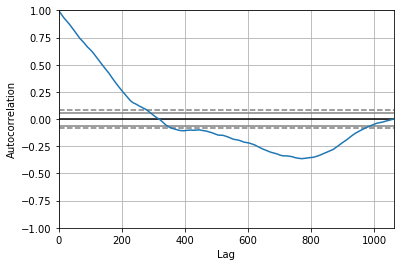

<Figure size 800x560 with 0 Axes>

Test MSE: 1.129


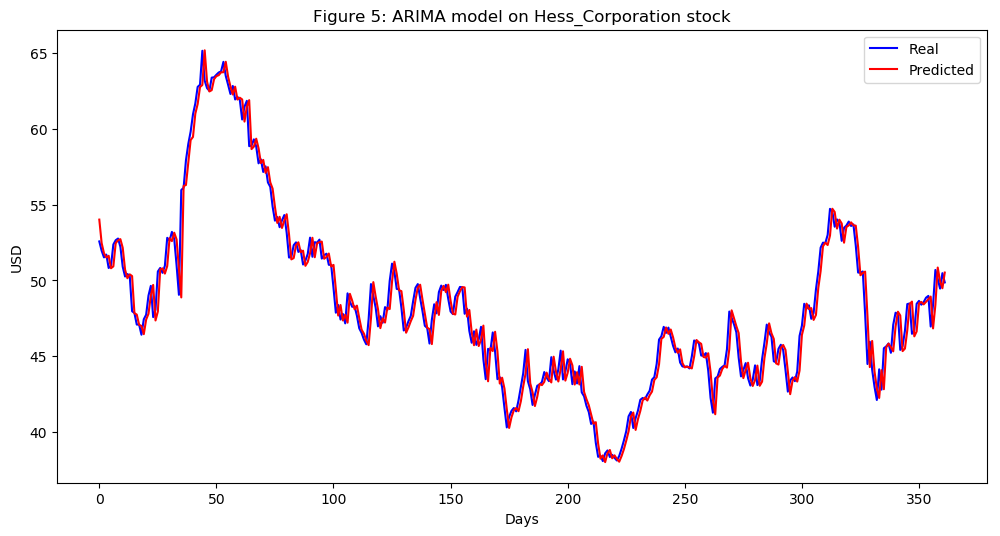

In [134]:
Hess_Corporation_series = SP500_TechIndicator['Hess_Corporation_Close']
Hess_Corporation_series_model = ARIMA(Hess_Corporation_series, order=(5, 1, 0))
Hess_Corporation_model_fit = Hess_Corporation_series_model.fit(disp=0)
print(Hess_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Hess_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Hess_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Hess_Corporation_predictions = list()
for t in range(len(test)):
    Hess_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Hess_Corporation_series_model_fit = Hess_Corporation_series_model.fit(disp=0)
    Hess_Corporation_output = Hess_Corporation_series_model_fit.forecast()
    yhat = Hess_Corporation_output[0]
    Hess_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Hess_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Hess_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Hess_Corporation stock')
plt.legend()
plt.show()


#predictions
Hess_Corporation_predictions = pd.DataFrame({'Hess_Corporation_predictions':Hess_Corporation_predictions})
#Hess_Corporation_predictions.to_csv('Hess_Corporation_predictions.csv')





                               ARIMA Model Results                               
Dep. Variable:     D.Kinder_Morgan_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood                -710.372
Method:                          css-mle   S.D. of innovations              0.473
Date:                   Sun, 17 Mar 2019   AIC                           1434.744
Time:                           13:18:57   BIC                           1469.513
Sample:                                1   HQIC                          1447.921
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          -0.0197      0.016     -1.220      0.223      -0.051       0.012
ar.L1.D.Kinder_Morgan_Close     0.0606      0.031      1

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


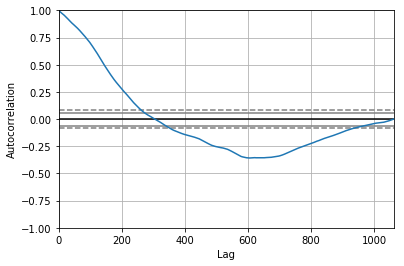

<Figure size 800x560 with 0 Axes>

Test MSE: 0.074


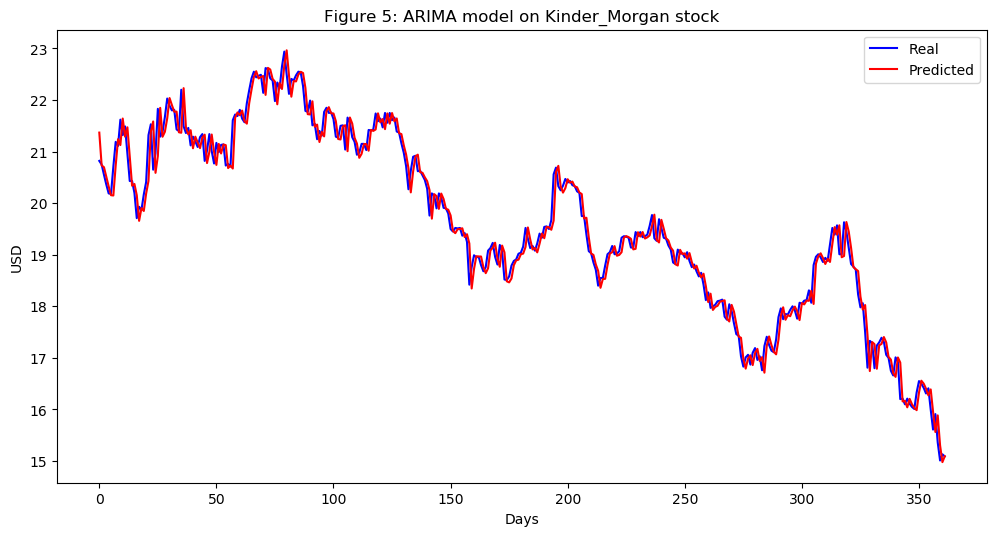

In [135]:
Kinder_Morgan_series = SP500_TechIndicator['Kinder_Morgan_Close']
Kinder_Morgan_series_model = ARIMA(Kinder_Morgan_series, order=(5, 1, 0))
Kinder_Morgan_model_fit = Kinder_Morgan_series_model.fit(disp=0)
print(Kinder_Morgan_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Kinder_Morgan_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Kinder_Morgan_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Kinder_Morgan_predictions = list()
for t in range(len(test)):
    Kinder_Morgan_series_model = ARIMA(history, order=(5,1,0))
    Kinder_Morgan_series_model_fit = Kinder_Morgan_series_model.fit(disp=0)
    Kinder_Morgan_output = Kinder_Morgan_series_model_fit.forecast()
    yhat = Kinder_Morgan_output[0]
    Kinder_Morgan_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Kinder_Morgan_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Kinder_Morgan_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Kinder_Morgan stock')
plt.legend()
plt.show()


#predictions
Kinder_Morgan_predictions = pd.DataFrame({'Kinder_Morgan_predictions':Kinder_Morgan_predictions})
#Kinder_Morgan_predictions.to_csv('Kinder_Morgan_predictions.csv')



                              ARIMA Model Results                               
Dep. Variable:     D.Marathon_Oil_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood                -766.483
Method:                         css-mle   S.D. of innovations              0.498
Date:                  Sun, 17 Mar 2019   AIC                           1546.965
Time:                          13:19:56   BIC                           1581.734
Sample:                               1   HQIC                          1560.142
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                         -0.0184      0.016     -1.181      0.238      -0.049       0.012
ar.L1.D.Marathon_Oil_Close     0.0044      0.031      0.144      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


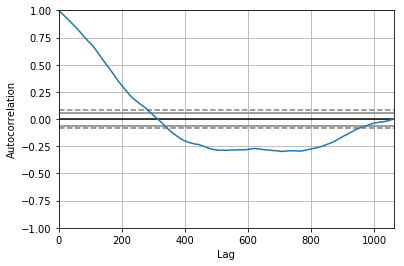

<Figure size 800x560 with 0 Axes>

Test MSE: 0.150


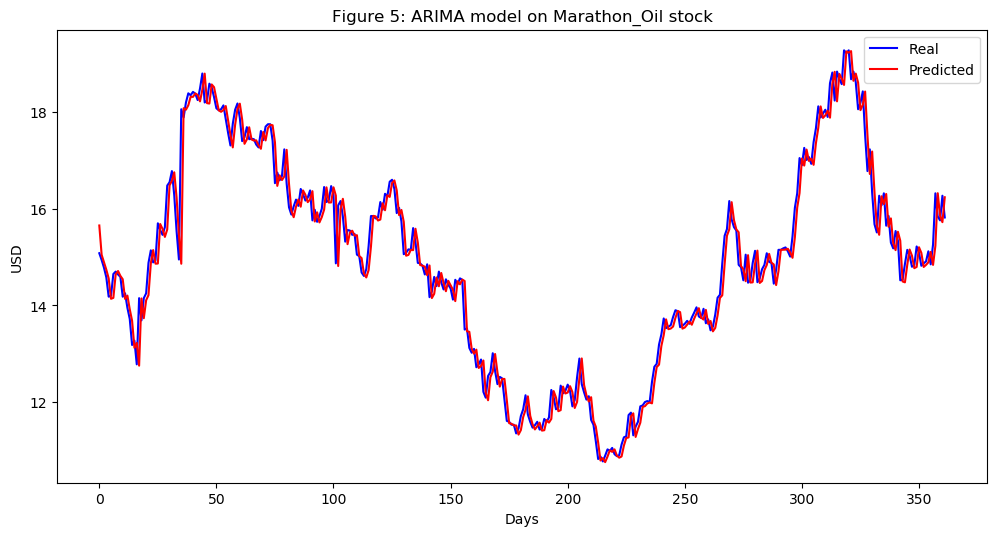

In [136]:
Marathon_Oil_series = SP500_TechIndicator['Marathon_Oil_Close']
Marathon_Oil_series_model = ARIMA(Marathon_Oil_series, order=(5, 1, 0))
Marathon_Oil_model_fit = Marathon_Oil_series_model.fit(disp=0)
print(Marathon_Oil_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Marathon_Oil_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Marathon_Oil_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Marathon_Oil_predictions = list()
for t in range(len(test)):
    Marathon_Oil_series_model = ARIMA(history, order=(5,1,0))
    Marathon_Oil_series_model_fit = Marathon_Oil_series_model.fit(disp=0)
    Marathon_Oil_output = Marathon_Oil_series_model_fit.forecast()
    yhat = Marathon_Oil_output[0]
    Marathon_Oil_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Marathon_Oil_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Marathon_Oil_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Marathon_Oil stock')
plt.legend()
plt.show()


#predictions
Marathon_Oil_predictions = pd.DataFrame({'Marathon_Oil_predictions':Marathon_Oil_predictions})
#Marathon_Oil_predictions.to_csv('Marathon_Oil_predictions.csv')


                                 ARIMA Model Results                                  
Dep. Variable:     D.Marathon_Petroleum_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -2221.120
Method:                               css-mle   S.D. of innovations              1.963
Date:                        Sun, 17 Mar 2019   AIC                           4456.240
Time:                                13:21:06   BIC                           4491.009
Sample:                                     1   HQIC                          4469.417
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -0.0178      0.062     -0.285      0.775      -0.140       0.104
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


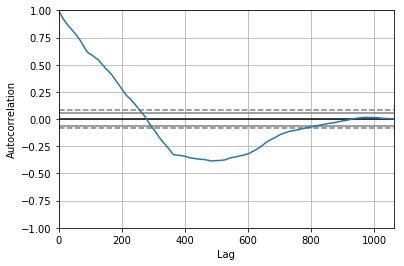

<Figure size 800x560 with 0 Axes>

Test MSE: 0.701


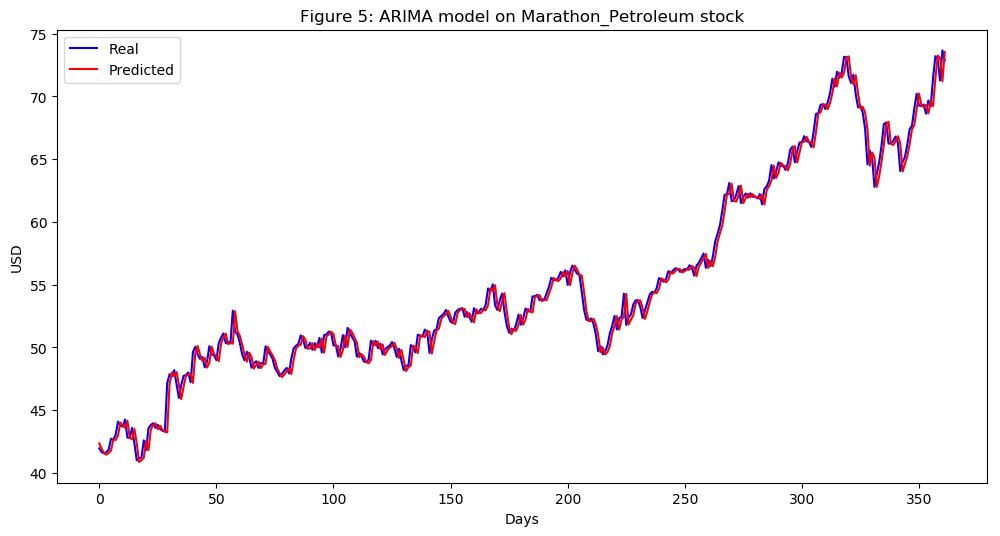

In [137]:
Marathon_Petroleum_series = SP500_TechIndicator['Marathon_Petroleum_Close']
Marathon_Petroleum_series_model = ARIMA(Marathon_Petroleum_series, order=(5, 1, 0))
Marathon_Petroleum_model_fit = Marathon_Petroleum_series_model.fit(disp=0)
print(Marathon_Petroleum_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Marathon_Petroleum_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Marathon_Petroleum_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Marathon_Petroleum_predictions = list()
for t in range(len(test)):
    Marathon_Petroleum_series_model = ARIMA(history, order=(5,1,0))
    Marathon_Petroleum_series_model_fit = Marathon_Petroleum_series_model.fit(disp=0)
    Marathon_Petroleum_output = Marathon_Petroleum_series_model_fit.forecast()
    yhat = Marathon_Petroleum_output[0]
    Marathon_Petroleum_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Marathon_Petroleum_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Marathon_Petroleum_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Marathon_Petroleum stock')
plt.legend()
plt.show()


#predictions
Marathon_Petroleum_predictions = pd.DataFrame({'Marathon_Petroleum_predictions':Marathon_Petroleum_predictions})
#Marathon_Petroleum_predictions.to_csv('Marathon_Petroleum_predictions.csv')





                                   ARIMA Model Results                                    
Dep. Variable:     D.National_Oilwell_Varco_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -1443.317
Method:                                   css-mle   S.D. of innovations              0.943
Date:                            Sun, 17 Mar 2019   AIC                           2900.635
Time:                                    13:21:53   BIC                           2935.404
Sample:                                         1   HQIC                          2913.811
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                   -0.0401      0.025    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


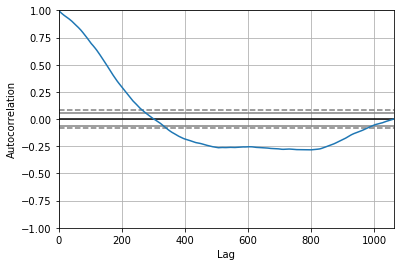

<Figure size 800x560 with 0 Axes>

Test MSE: 0.445


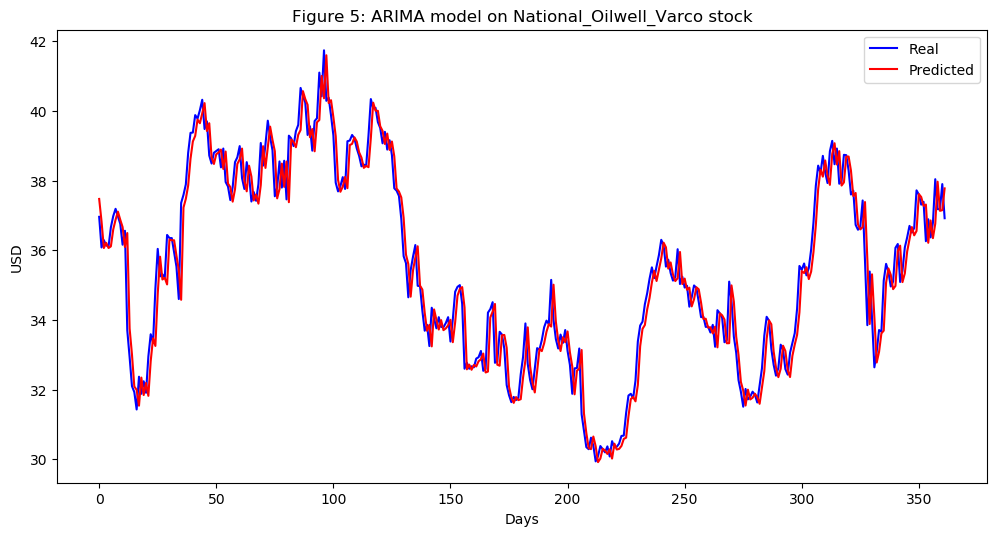

In [138]:
National_Oilwell_Varco_series = SP500_TechIndicator['National_Oilwell_Varco_Close']
National_Oilwell_Varco_series_model = ARIMA(National_Oilwell_Varco_series, order=(5, 1, 0))
National_Oilwell_Varco_model_fit = National_Oilwell_Varco_series_model.fit(disp=0)
print(National_Oilwell_Varco_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(National_Oilwell_Varco_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = National_Oilwell_Varco_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
National_Oilwell_Varco_predictions = list()
for t in range(len(test)):
    National_Oilwell_Varco_series_model = ARIMA(history, order=(5,1,0))
    National_Oilwell_Varco_series_model_fit = National_Oilwell_Varco_series_model.fit(disp=0)
    National_Oilwell_Varco_output = National_Oilwell_Varco_series_model_fit.forecast()
    yhat = National_Oilwell_Varco_output[0]
    National_Oilwell_Varco_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, National_Oilwell_Varco_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(National_Oilwell_Varco_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on National_Oilwell_Varco stock')
plt.legend()
plt.show()


#predictions
National_Oilwell_Varco_predictions = pd.DataFrame({'National_Oilwell_Varco_predictions':National_Oilwell_Varco_predictions})
#National_Oilwell_Varco_predictions.to_csv('National_Oilwell_Varco_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Newfield_Exploration_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -1407.541
Method:                                 css-mle   S.D. of innovations              0.912
Date:                          Sun, 17 Mar 2019   AIC                           2829.081
Time:                                  13:22:50   BIC                           2863.850
Sample:                                       1   HQIC                          2842.258
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                 -0.0009      0.028     -0.033      0.974    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


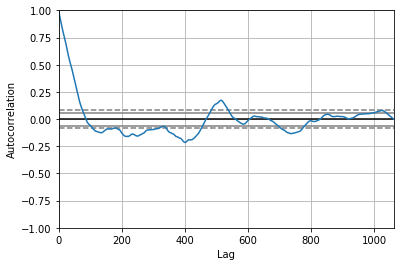

<Figure size 800x560 with 0 Axes>

Test MSE: 0.722


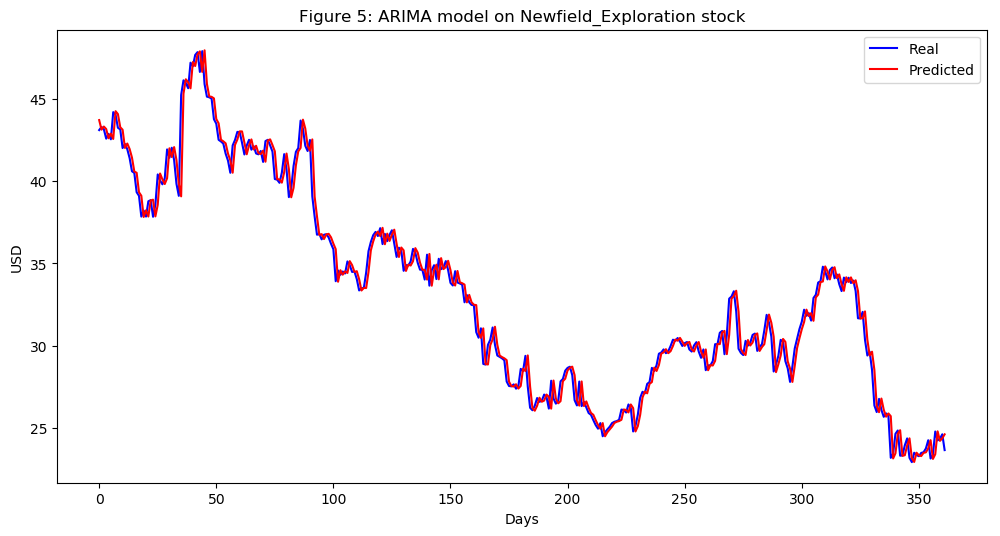

In [139]:
Newfield_Exploration_series = SP500_TechIndicator['Newfield_Exploration_Close']
Newfield_Exploration_series_model = ARIMA(Newfield_Exploration_series, order=(5, 1, 0))
Newfield_Exploration_model_fit = Newfield_Exploration_series_model.fit(disp=0)
print(Newfield_Exploration_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Newfield_Exploration_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Newfield_Exploration_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Newfield_Exploration_predictions = list()
for t in range(len(test)):
    Newfield_Exploration_series_model = ARIMA(history, order=(5,1,0))
    Newfield_Exploration_series_model_fit = Newfield_Exploration_series_model.fit(disp=0)
    Newfield_Exploration_output = Newfield_Exploration_series_model_fit.forecast()
    yhat = Newfield_Exploration_output[0]
    Newfield_Exploration_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Newfield_Exploration_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Newfield_Exploration_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Newfield_Exploration stock')
plt.legend()
plt.show()


#predictions
Newfield_Exploration_predictions = pd.DataFrame({'Newfield_Exploration_predictions':Newfield_Exploration_predictions})
#Newfield_Exploration_predictions.to_csv('Newfield_Exploration_predictions.csv')



                              ARIMA Model Results                               
Dep. Variable:     D.Noble_Energy_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -1398.317
Method:                         css-mle   S.D. of innovations              0.904
Date:                  Sun, 17 Mar 2019   AIC                           2810.635
Time:                          13:23:45   BIC                           2845.403
Sample:                               1   HQIC                          2823.811
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                         -0.0357      0.027     -1.313      0.189      -0.089       0.018
ar.L1.D.Noble_Energy_Close     0.0455      0.031      1.482      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


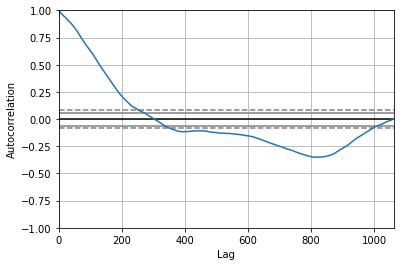

<Figure size 800x560 with 0 Axes>

Test MSE: 0.414


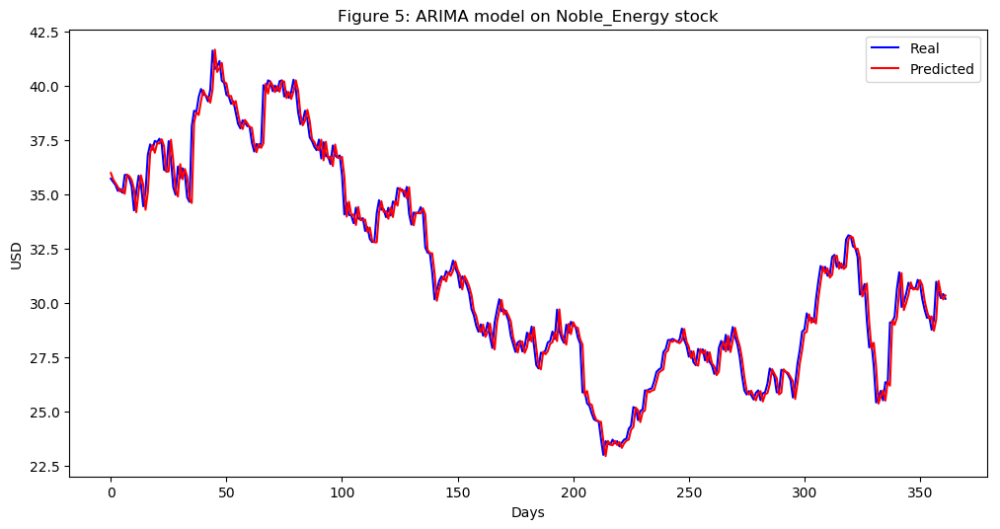

In [140]:
Noble_Energy_series = SP500_TechIndicator['Noble_Energy_Close']
Noble_Energy_series_model = ARIMA(Noble_Energy_series, order=(5, 1, 0))
Noble_Energy_model_fit = Noble_Energy_series_model.fit(disp=0)
print(Noble_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Noble_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Noble_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Noble_Energy_predictions = list()
for t in range(len(test)):
    Noble_Energy_series_model = ARIMA(history, order=(5,1,0))
    Noble_Energy_series_model_fit = Noble_Energy_series_model.fit(disp=0)
    Noble_Energy_output = Noble_Energy_series_model_fit.forecast()
    yhat = Noble_Energy_output[0]
    Noble_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Noble_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Noble_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Noble_Energy stock')
plt.legend()
plt.show()


#predictions
Noble_Energy_predictions = pd.DataFrame({'Noble_Energy_predictions':Noble_Energy_predictions})
#Noble_Energy_predictions.to_csv('Noble_Energy_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Occidental_Petroleum_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -1609.043
Method:                                 css-mle   S.D. of innovations              1.103
Date:                          Sun, 17 Mar 2019   AIC                           3232.087
Time:                                  13:24:44   BIC                           3266.855
Sample:                                       1   HQIC                          3245.263
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                 -0.0275      0.030     -0.909      0.363    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


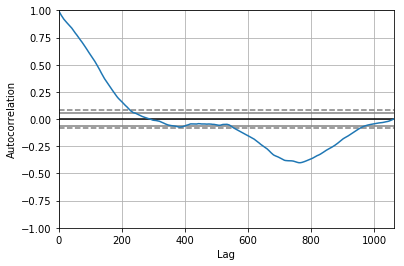

<Figure size 800x560 with 0 Axes>

Test MSE: 0.736


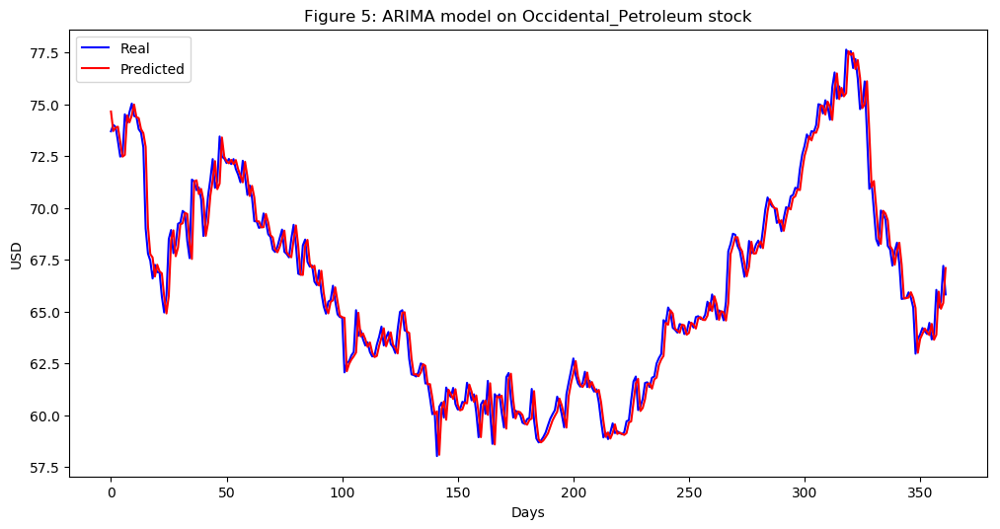

In [141]:
Occidental_Petroleum_series = SP500_TechIndicator['Occidental_Petroleum_Close']
Occidental_Petroleum_series_model = ARIMA(Occidental_Petroleum_series, order=(5, 1, 0))
Occidental_Petroleum_model_fit = Occidental_Petroleum_series_model.fit(disp=0)
print(Occidental_Petroleum_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Occidental_Petroleum_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Occidental_Petroleum_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Occidental_Petroleum_predictions = list()
for t in range(len(test)):
    Occidental_Petroleum_series_model = ARIMA(history, order=(5,1,0))
    Occidental_Petroleum_series_model_fit = Occidental_Petroleum_series_model.fit(disp=0)
    Occidental_Petroleum_output = Occidental_Petroleum_series_model_fit.forecast()
    yhat = Occidental_Petroleum_output[0]
    Occidental_Petroleum_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Occidental_Petroleum_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Occidental_Petroleum_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Occidental_Petroleum stock')
plt.legend()
plt.show()


#predictions
Occidental_Petroleum_predictions = pd.DataFrame({'Occidental_Petroleum_predictions':Occidental_Petroleum_predictions})
#Occidental_Petroleum_predictions.to_csv('Occidental_Petroleum_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.ONEOK_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1474.055
Method:                       css-mle   S.D. of innovations              0.971
Date:                Sun, 17 Mar 2019   AIC                           2962.111
Time:                        13:25:40   BIC                           2996.879
Sample:                             1   HQIC                          2975.287
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                  -0.0049      0.030     -0.164      0.869      -0.064       0.054
ar.L1.D.ONEOK_Close    -0.0048      0.031     -0.157      0.875      -0.065       0.055
ar.L2.D.ONEOK_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


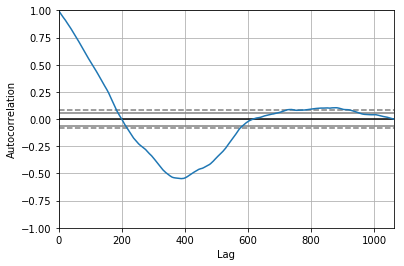

<Figure size 800x560 with 0 Axes>

Test MSE: 0.655


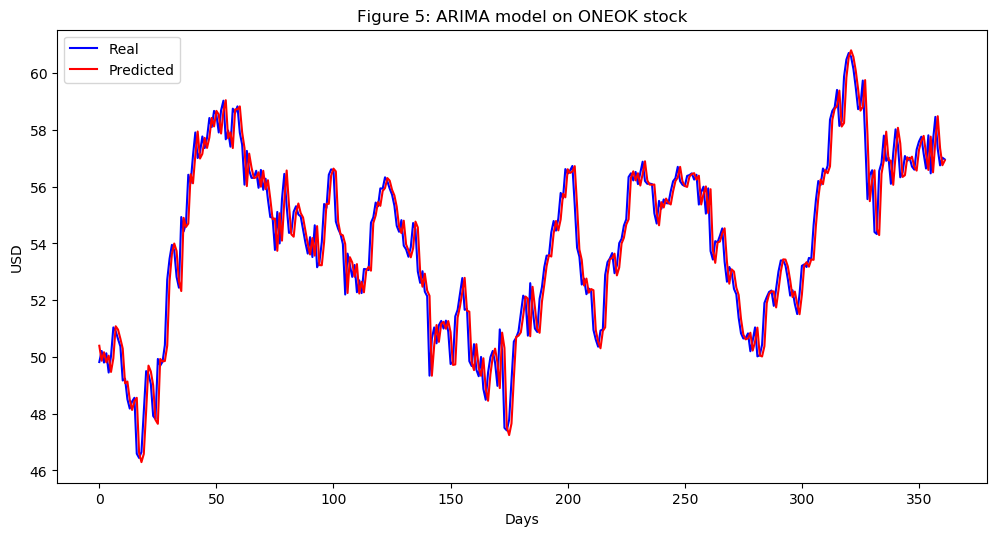

In [142]:
ONEOK_series = SP500_TechIndicator['ONEOK_Close']
ONEOK_series_model = ARIMA(ONEOK_series, order=(5, 1, 0))
ONEOK_model_fit = ONEOK_series_model.fit(disp=0)
print(ONEOK_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(ONEOK_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = ONEOK_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
ONEOK_predictions = list()
for t in range(len(test)):
    ONEOK_series_model = ARIMA(history, order=(5,1,0))
    ONEOK_series_model_fit = ONEOK_series_model.fit(disp=0)
    ONEOK_output = ONEOK_series_model_fit.forecast()
    yhat = ONEOK_output[0]
    ONEOK_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, ONEOK_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(ONEOK_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on ONEOK stock')
plt.legend()
plt.show()


#predictions
ONEOK_predictions = pd.DataFrame({'ONEOK_predictions':ONEOK_predictions})
#ONEOK_predictions.to_csv('ONEOK_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Phillips_SixtySix_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -1687.468
Method:                              css-mle   S.D. of innovations              1.187
Date:                       Sun, 17 Mar 2019   AIC                           3388.936
Time:                               13:26:32   BIC                           3423.705
Sample:                                    1   HQIC                          3402.113
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0175      0.036      0.486      0.627      -0.053       0.088
ar.L1.D.Phil

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


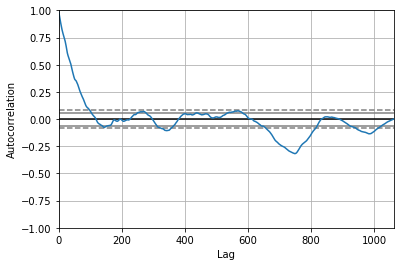

<Figure size 800x560 with 0 Axes>

Test MSE: 0.901


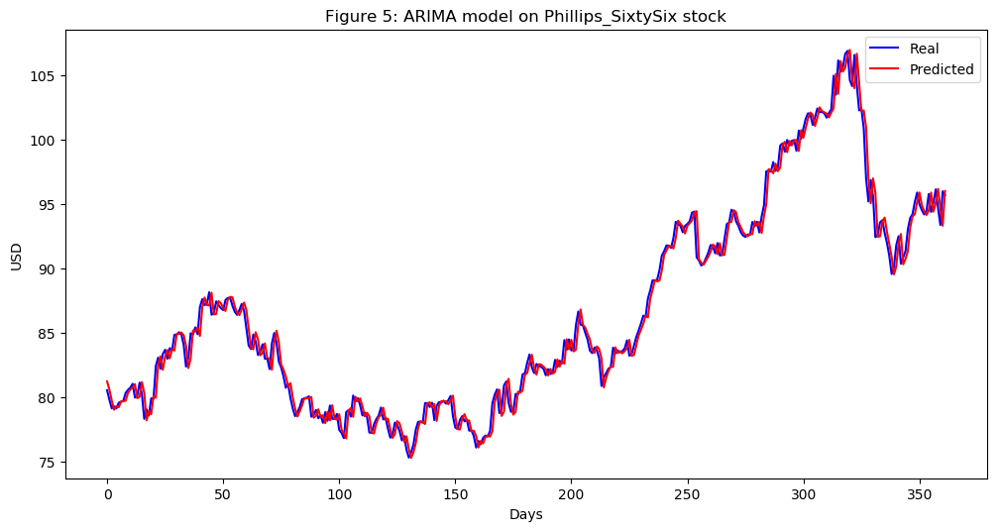

In [143]:
Phillips_SixtySix_series = SP500_TechIndicator['Phillips_SixtySix_Close']
Phillips_SixtySix_series_model = ARIMA(Phillips_SixtySix_series, order=(5, 1, 0))
Phillips_SixtySix_model_fit = Phillips_SixtySix_series_model.fit(disp=0)
print(Phillips_SixtySix_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Phillips_SixtySix_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Phillips_SixtySix_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Phillips_SixtySix_predictions = list()
for t in range(len(test)):
    Phillips_SixtySix_series_model = ARIMA(history, order=(5,1,0))
    Phillips_SixtySix_series_model_fit = Phillips_SixtySix_series_model.fit(disp=0)
    Phillips_SixtySix_output = Phillips_SixtySix_series_model_fit.forecast()
    yhat = Phillips_SixtySix_output[0]
    Phillips_SixtySix_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Phillips_SixtySix_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Phillips_SixtySix_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Phillips_SixtySix stock')
plt.legend()
plt.show()


#predictions
Phillips_SixtySix_predictions = pd.DataFrame({'Phillips_SixtySix_predictions':Phillips_SixtySix_predictions})
#Phillips_SixtySix_predictions.to_csv('Phillips_SixtySix_predictions.csv')



                              ARIMA Model Results                               
Dep. Variable:     D.Schlumberger_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -1693.765
Method:                         css-mle   S.D. of innovations              1.194
Date:                  Sun, 17 Mar 2019   AIC                           3401.529
Time:                          13:27:23   BIC                           3436.298
Sample:                               1   HQIC                          3414.706
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                         -0.0239      0.036     -0.674      0.501      -0.094       0.046
ar.L1.D.Schlumberger_Close     0.0198      0.031      0.643      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


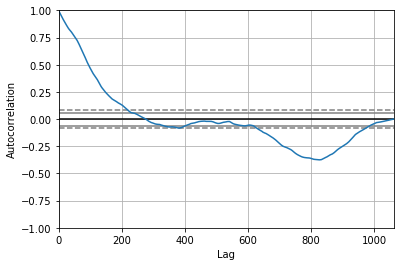

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.866


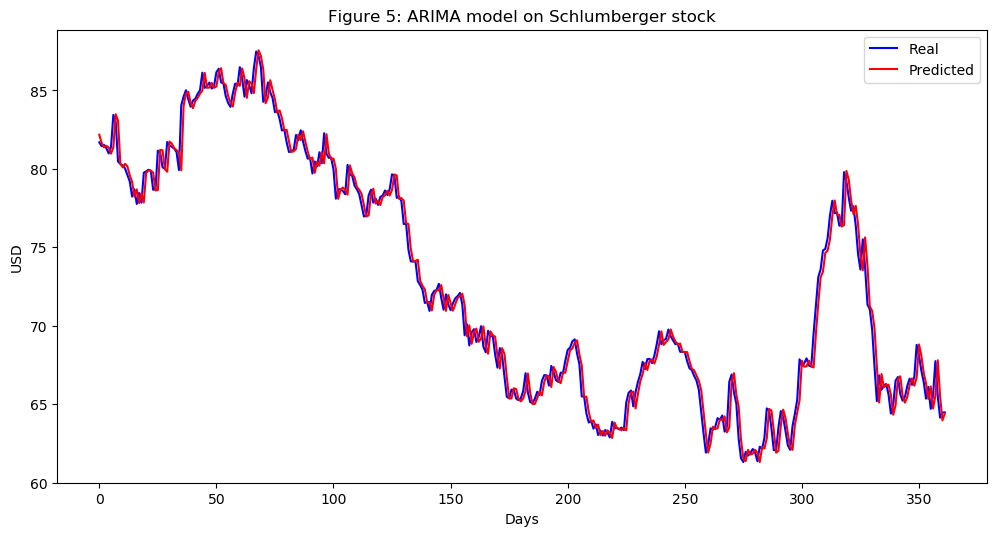

In [144]:
Schlumberger_series = SP500_TechIndicator['Schlumberger_Close']
Schlumberger_series_model = ARIMA(Schlumberger_series, order=(5, 1, 0))
Schlumberger_model_fit = Schlumberger_series_model.fit(disp=0)
print(Schlumberger_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Schlumberger_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Schlumberger_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Schlumberger_predictions = list()
for t in range(len(test)):
    Schlumberger_series_model = ARIMA(history, order=(5,1,0))
    Schlumberger_series_model_fit = Schlumberger_series_model.fit(disp=0)
    Schlumberger_output = Schlumberger_series_model_fit.forecast()
    yhat = Schlumberger_output[0]
    Schlumberger_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Schlumberger_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Schlumberger_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Schlumberger stock')
plt.legend()
plt.show()


#predictions
Schlumberger_predictions = pd.DataFrame({'Schlumberger_predictions':Schlumberger_predictions})
#Schlumberger_predictions.to_csv('Schlumberger_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:     D.TechnipFMC_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1175.355
Method:                       css-mle   S.D. of innovations              0.733
Date:                Sun, 17 Mar 2019   AIC                           2364.711
Time:                        13:28:18   BIC                           2399.479
Sample:                             1   HQIC                          2377.887
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                       -0.0217      0.021     -1.055      0.291      -0.062       0.019
ar.L1.D.TechnipFMC_Close    -0.0278      0.031     -0.905      0.366      -0.088       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


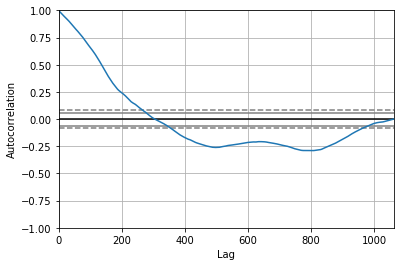

<Figure size 800x560 with 0 Axes>

Test MSE: 0.302


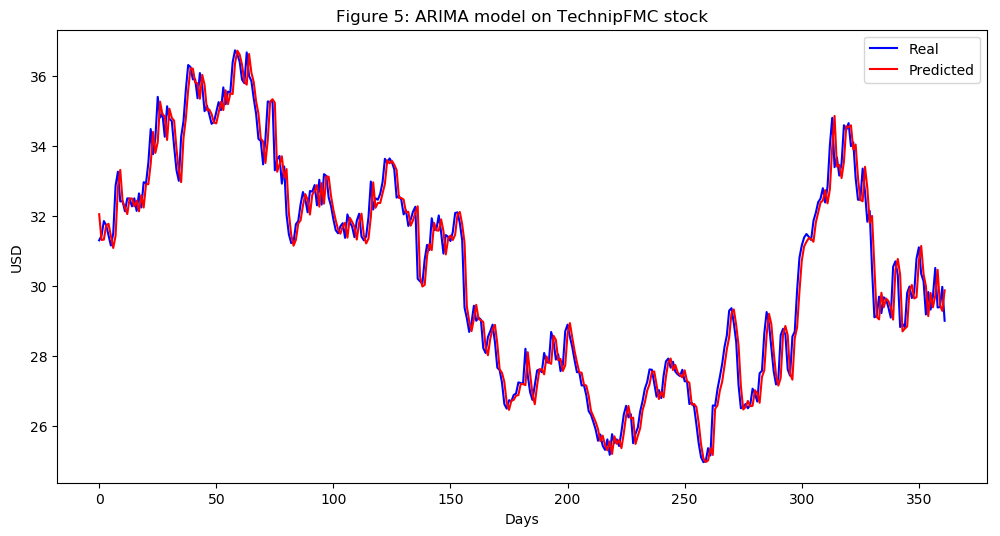

In [145]:
TechnipFMC_series = SP500_TechIndicator['TechnipFMC_Close']
TechnipFMC_series_model = ARIMA(TechnipFMC_series, order=(5, 1, 0))
TechnipFMC_model_fit = TechnipFMC_series_model.fit(disp=0)
print(TechnipFMC_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(TechnipFMC_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = TechnipFMC_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
TechnipFMC_predictions = list()
for t in range(len(test)):
    TechnipFMC_series_model = ARIMA(history, order=(5,1,0))
    TechnipFMC_series_model_fit = TechnipFMC_series_model.fit(disp=0)
    TechnipFMC_output = TechnipFMC_series_model_fit.forecast()
    yhat = TechnipFMC_output[0]
    TechnipFMC_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, TechnipFMC_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(TechnipFMC_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on TechnipFMC stock')
plt.legend()
plt.show()


#predictions
TechnipFMC_predictions = pd.DataFrame({'TechnipFMC_predictions':TechnipFMC_predictions})
#TechnipFMC_predictions.to_csv('TechnipFMC_predictions.csv')



                               ARIMA Model Results                               
Dep. Variable:     D.Valero_Energy_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -1613.600
Method:                          css-mle   S.D. of innovations              1.107
Date:                   Sun, 17 Mar 2019   AIC                           3241.201
Time:                           13:29:19   BIC                           3275.970
Sample:                                1   HQIC                          3254.377
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0396      0.033      1.187      0.235      -0.026       0.105
ar.L1.D.Valero_Energy_Close    -0.0550      0.031     -1

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


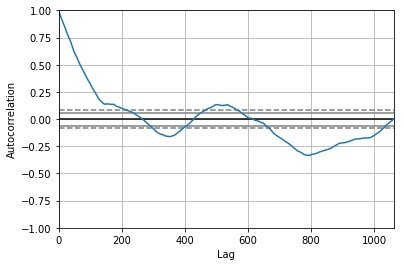

<Figure size 800x560 with 0 Axes>

Test MSE: 0.979


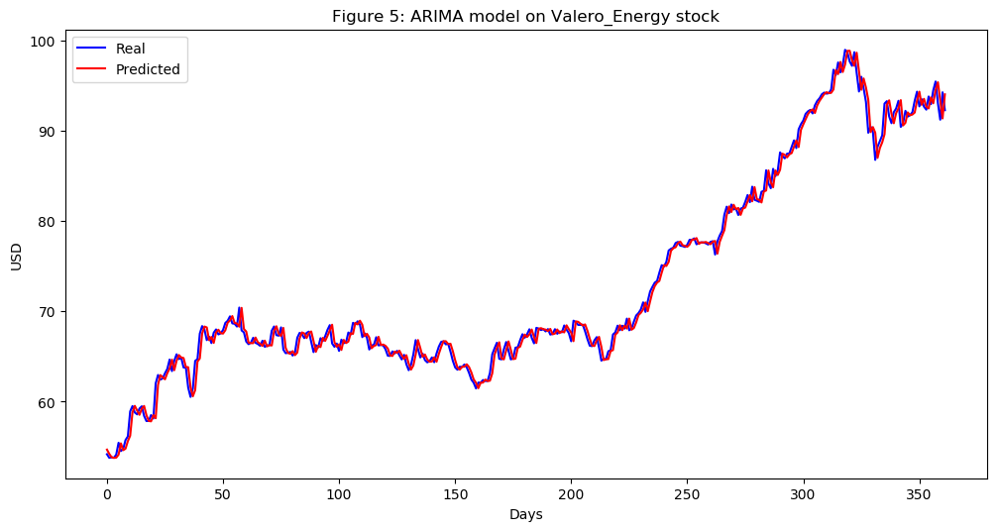

In [146]:
Valero_Energy_series = SP500_TechIndicator['Valero_Energy_Close']
Valero_Energy_series_model = ARIMA(Valero_Energy_series, order=(5, 1, 0))
Valero_Energy_model_fit = Valero_Energy_series_model.fit(disp=0)
print(Valero_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Valero_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Valero_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Valero_Energy_predictions = list()
for t in range(len(test)):
    Valero_Energy_series_model = ARIMA(history, order=(5,1,0))
    Valero_Energy_series_model_fit = Valero_Energy_series_model.fit(disp=0)
    Valero_Energy_output = Valero_Energy_series_model_fit.forecast()
    yhat = Valero_Energy_output[0]
    Valero_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Valero_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Valero_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Valero_Energy stock')
plt.legend()
plt.show()


#predictions
Valero_Energy_predictions = pd.DataFrame({'Valero_Energy_predictions':Valero_Energy_predictions})
#Valero_Energy_predictions.to_csv('Valero_Energy_predictions.csv')



                              ARIMA Model Results                               
Dep. Variable:     D.Williams_Cos_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -1444.697
Method:                         css-mle   S.D. of innovations              0.944
Date:                  Sun, 17 Mar 2019   AIC                           2903.394
Time:                          13:30:12   BIC                           2938.162
Sample:                               1   HQIC                          2916.570
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                         -0.0126      0.030     -0.425      0.671      -0.071       0.046
ar.L1.D.Williams_Cos_Close     0.0534      0.031      1.739      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


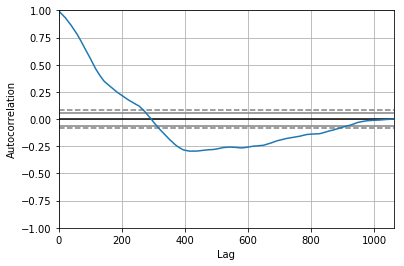

<Figure size 800x560 with 0 Axes>

Test MSE: 0.228


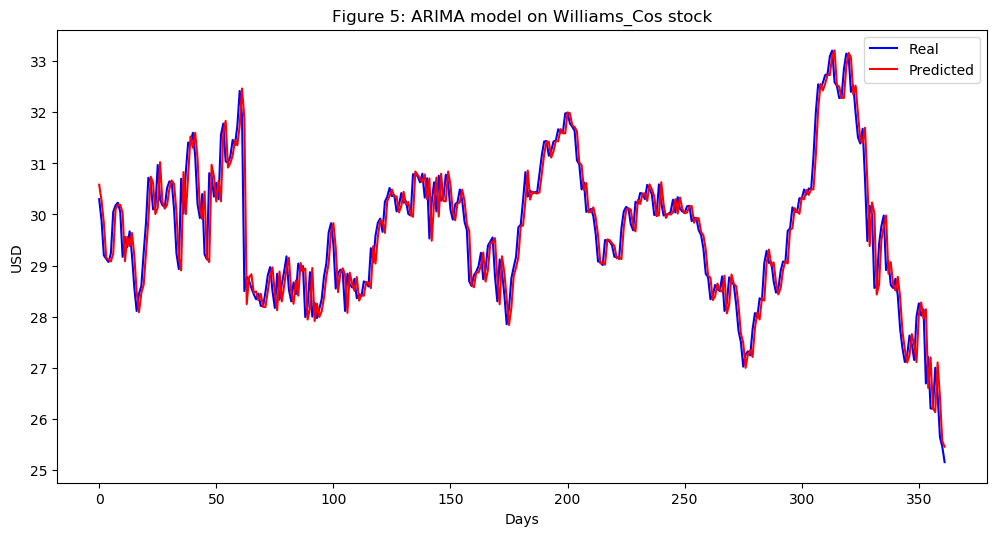

In [147]:
Williams_Cos_series = SP500_TechIndicator['Williams_Cos_Close']
Williams_Cos_series_model = ARIMA(Williams_Cos_series, order=(5, 1, 0))
Williams_Cos_model_fit = Williams_Cos_series_model.fit(disp=0)
print(Williams_Cos_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Williams_Cos_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Williams_Cos_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Williams_Cos_predictions = list()
for t in range(len(test)):
    Williams_Cos_series_model = ARIMA(history, order=(5,1,0))
    Williams_Cos_series_model_fit = Williams_Cos_series_model.fit(disp=0)
    Williams_Cos_output = Williams_Cos_series_model_fit.forecast()
    yhat = Williams_Cos_output[0]
    Williams_Cos_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Williams_Cos_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Williams_Cos_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Williams_Cos stock')
plt.legend()
plt.show()


#predictions
Williams_Cos_predictions = pd.DataFrame({'Williams_Cos_predictions':Williams_Cos_predictions})
#Williams_Cos_predictions.to_csv('Williams_Cos_predictions.csv')



                                     ARIMA Model Results                                     
Dep. Variable:     D.Affiliated_Managers_Group_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood               -2674.864
Method:                                      css-mle   S.D. of innovations              3.011
Date:                               Sun, 17 Mar 2019   AIC                           5363.728
Time:                                       13:31:05   BIC                           5398.497
Sample:                                            1   HQIC                          5376.905
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


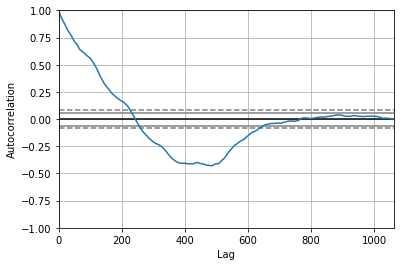

<Figure size 800x560 with 0 Axes>

Test MSE: 6.277


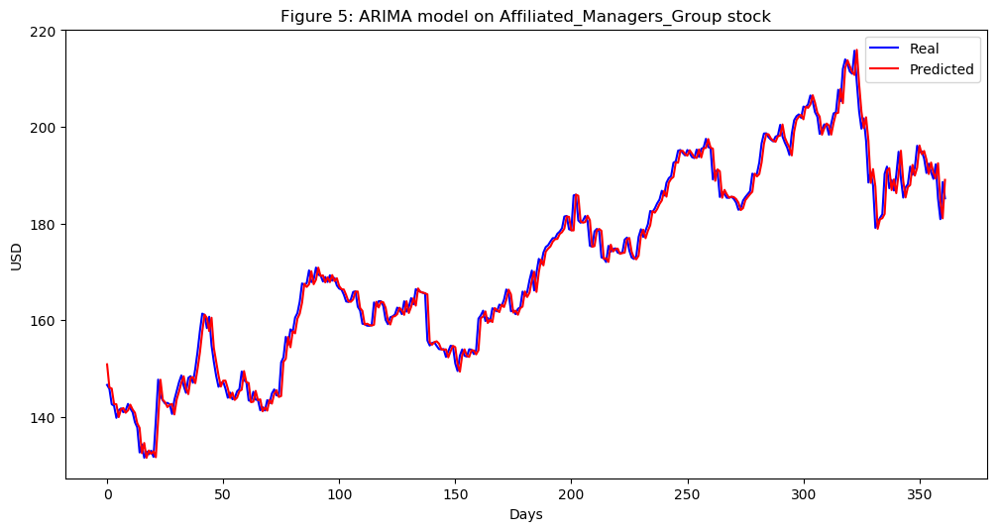

In [148]:
Affiliated_Managers_Group_series = SP500_TechIndicator['Affiliated_Managers_Group_Close']
Affiliated_Managers_Group_series_model = ARIMA(Affiliated_Managers_Group_series, order=(5, 1, 0))
Affiliated_Managers_Group_model_fit = Affiliated_Managers_Group_series_model.fit(disp=0)
print(Affiliated_Managers_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Affiliated_Managers_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Affiliated_Managers_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Affiliated_Managers_Group_predictions = list()
for t in range(len(test)):
    Affiliated_Managers_Group_series_model = ARIMA(history, order=(5,1,0))
    Affiliated_Managers_Group_series_model_fit = Affiliated_Managers_Group_series_model.fit(disp=0)
    Affiliated_Managers_Group_output = Affiliated_Managers_Group_series_model_fit.forecast()
    yhat = Affiliated_Managers_Group_output[0]
    Affiliated_Managers_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Affiliated_Managers_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Affiliated_Managers_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Affiliated_Managers_Group stock')
plt.legend()
plt.show()


#predictions
Affiliated_Managers_Group_predictions = pd.DataFrame({'Affiliated_Managers_Group_predictions':Affiliated_Managers_Group_predictions})
#Affiliated_Managers_Group_predictions.to_csv('Affiliated_Managers_Group_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.AFLAC_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1980.881
Method:                       css-mle   S.D. of innovations              1.565
Date:                Sun, 17 Mar 2019   AIC                           3975.763
Time:                        13:32:07   BIC                           4010.532
Sample:                             1   HQIC                          3988.939
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                  -0.0220      0.048     -0.457      0.647      -0.116       0.072
ar.L1.D.AFLAC_Close    -0.0250      0.031     -0.813      0.416      -0.085       0.035
ar.L2.D.AFLAC_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


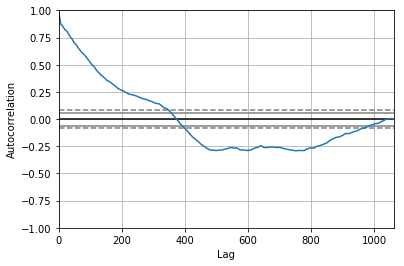

<Figure size 800x560 with 0 Axes>

Test MSE: 6.466


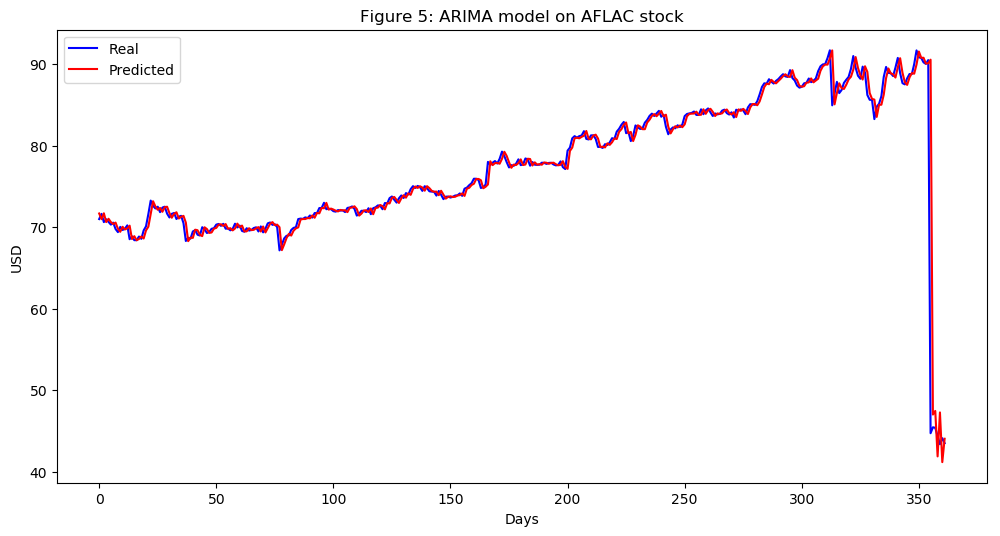

In [149]:
AFLAC_series = SP500_TechIndicator['AFLAC_Close']
AFLAC_series_model = ARIMA(AFLAC_series, order=(5, 1, 0))
AFLAC_model_fit = AFLAC_series_model.fit(disp=0)
print(AFLAC_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(AFLAC_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = AFLAC_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
AFLAC_predictions = list()
for t in range(len(test)):
    AFLAC_series_model = ARIMA(history, order=(5,1,0))
    AFLAC_series_model_fit = AFLAC_series_model.fit(disp=0)
    AFLAC_output = AFLAC_series_model_fit.forecast()
    yhat = AFLAC_output[0]
    AFLAC_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, AFLAC_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(AFLAC_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on AFLAC stock')
plt.legend()
plt.show()


#predictions
AFLAC_predictions = pd.DataFrame({'AFLAC_predictions':AFLAC_predictions})
#AFLAC_predictions.to_csv('AFLAC_predictions.csv')



                               ARIMA Model Results                               
Dep. Variable:     D.Allstate_Corp_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -1207.353
Method:                          css-mle   S.D. of innovations              0.755
Date:                   Sun, 17 Mar 2019   AIC                           2428.706
Time:                           13:33:19   BIC                           2463.475
Sample:                                1   HQIC                          2441.882
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0369      0.020      1.802      0.072      -0.003       0.077
ar.L1.D.Allstate_Corp_Close    -0.0435      0.031     -1

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


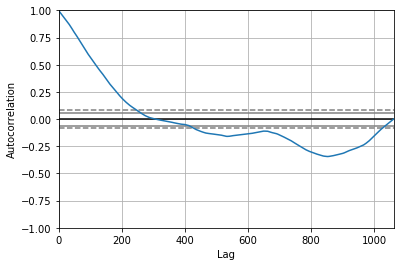

<Figure size 800x560 with 0 Axes>

Test MSE: 0.830


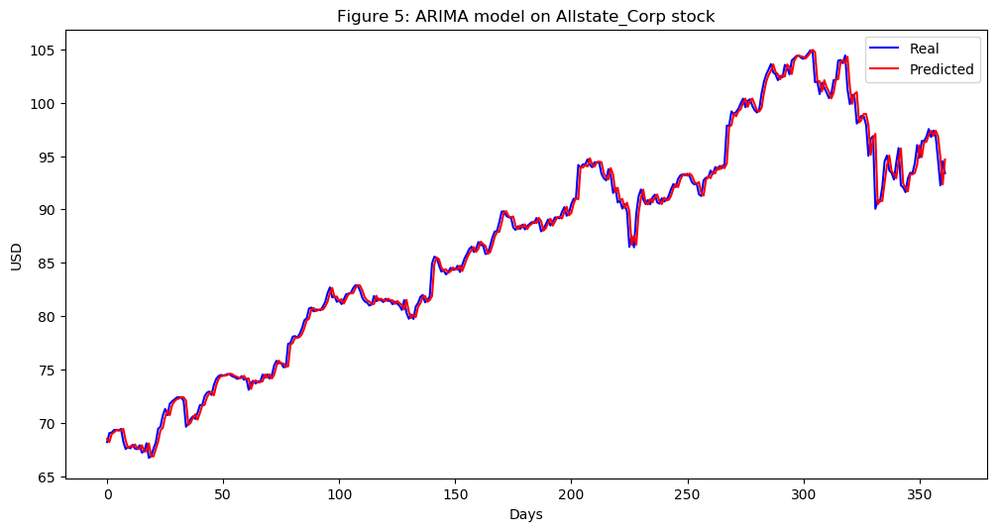

In [150]:
Allstate_Corp_series = SP500_TechIndicator['Allstate_Corp_Close']
Allstate_Corp_series_model = ARIMA(Allstate_Corp_series, order=(5, 1, 0))
Allstate_Corp_model_fit = Allstate_Corp_series_model.fit(disp=0)
print(Allstate_Corp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Allstate_Corp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Allstate_Corp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Allstate_Corp_predictions = list()
for t in range(len(test)):
    Allstate_Corp_series_model = ARIMA(history, order=(5,1,0))
    Allstate_Corp_series_model_fit = Allstate_Corp_series_model.fit(disp=0)
    Allstate_Corp_output = Allstate_Corp_series_model_fit.forecast()
    yhat = Allstate_Corp_output[0]
    Allstate_Corp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Allstate_Corp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Allstate_Corp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Allstate_Corp stock')
plt.legend()
plt.show()


#predictions
Allstate_Corp_predictions = pd.DataFrame({'Allstate_Corp_predictions':Allstate_Corp_predictions})
#Allstate_Corp_predictions.to_csv('Allstate_Corp_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.American_Express_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -1499.811
Method:                             css-mle   S.D. of innovations              0.995
Date:                      Sun, 17 Mar 2019   AIC                           3013.623
Time:                              13:34:31   BIC                           3048.391
Sample:                                   1   HQIC                          3026.799
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0008      0.029      0.027      0.978      -0.055       0.057
ar.L1.D.American_Expres

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


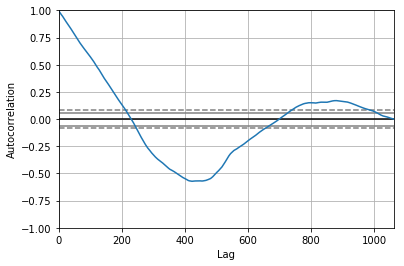

<Figure size 800x560 with 0 Axes>

Test MSE: 0.965


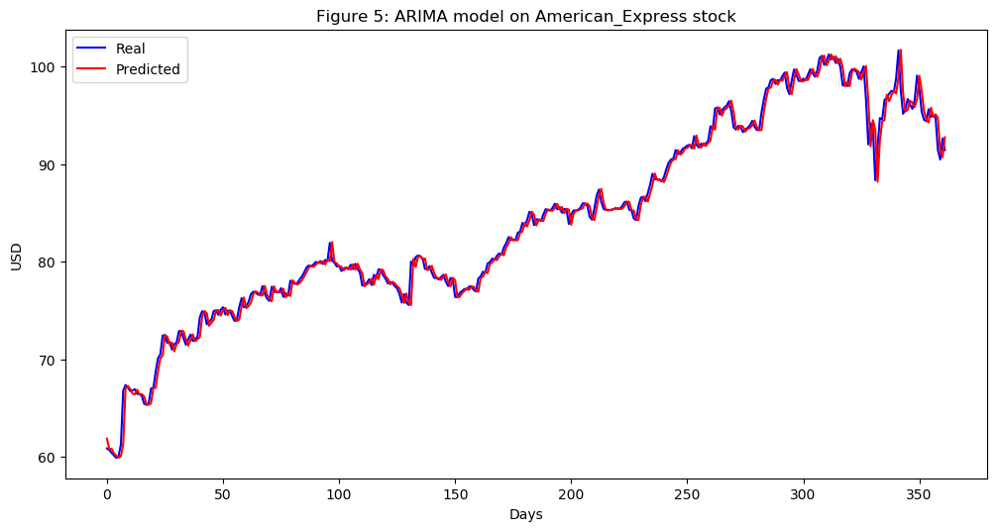

In [151]:
American_Express_series = SP500_TechIndicator['American_Express_Close']
American_Express_series_model = ARIMA(American_Express_series, order=(5, 1, 0))
American_Express_model_fit = American_Express_series_model.fit(disp=0)
print(American_Express_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(American_Express_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = American_Express_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
American_Express_predictions = list()
for t in range(len(test)):
    American_Express_series_model = ARIMA(history, order=(5,1,0))
    American_Express_series_model_fit = American_Express_series_model.fit(disp=0)
    American_Express_output = American_Express_series_model_fit.forecast()
    yhat = American_Express_output[0]
    American_Express_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, American_Express_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(American_Express_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on American_Express stock')
plt.legend()
plt.show()


#predictions
American_Express_predictions = pd.DataFrame({'American_Express_predictions':American_Express_predictions})
#American_Express_predictions.to_csv('American_Express_predictions.csv')



                                      ARIMA Model Results                                       
Dep. Variable:     D.American_International_Group_Close   No. Observations:                 1061
Model:                                   ARIMA(5, 1, 0)   Log Likelihood               -1125.850
Method:                                         css-mle   S.D. of innovations              0.699
Date:                                  Sun, 17 Mar 2019   AIC                           2265.701
Time:                                          13:35:20   BIC                           2300.470
Sample:                                               1   HQIC                          2278.877
                                                                                                
                                                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------------
co

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


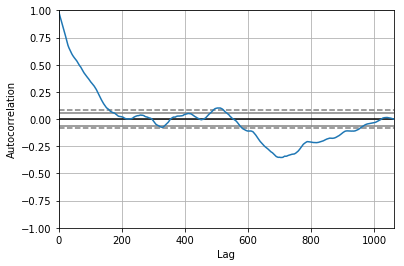

<Figure size 800x560 with 0 Axes>

Test MSE: 0.491


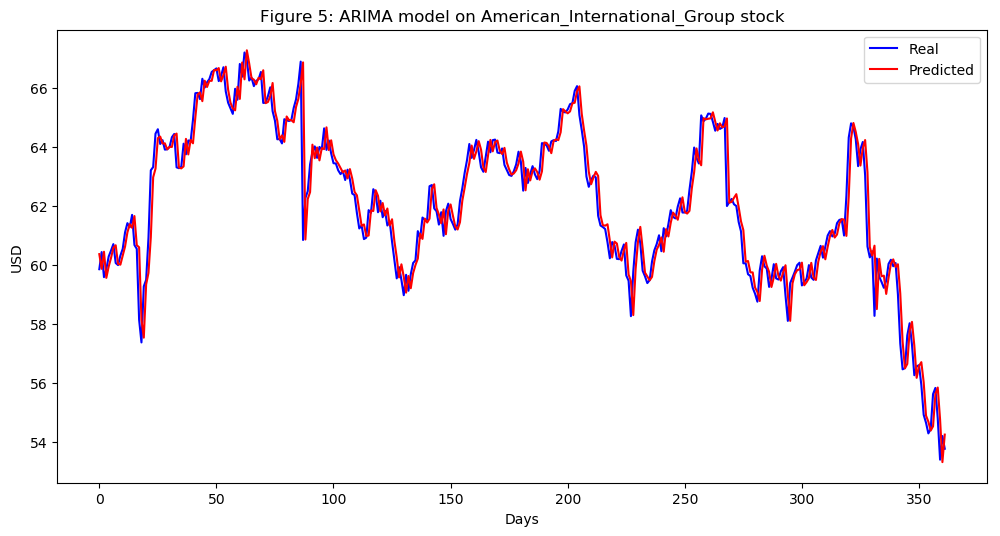

In [152]:
American_International_Group_series = SP500_TechIndicator['American_International_Group_Close']
American_International_Group_series_model = ARIMA(American_International_Group_series, order=(5, 1, 0))
American_International_Group_model_fit = American_International_Group_series_model.fit(disp=0)
print(American_International_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(American_International_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = American_International_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
American_International_Group_predictions = list()
for t in range(len(test)):
    American_International_Group_series_model = ARIMA(history, order=(5,1,0))
    American_International_Group_series_model_fit = American_International_Group_series_model.fit(disp=0)
    American_International_Group_output = American_International_Group_series_model_fit.forecast()
    yhat = American_International_Group_output[0]
    American_International_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, American_International_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(American_International_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on American_International_Group stock')
plt.legend()
plt.show()


#predictions
American_International_Group_predictions = pd.DataFrame({'American_International_Group_predictions':American_International_Group_predictions})
#American_International_Group_predictions.to_csv('American_International_Group_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Ameriprise_Financial_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -2149.234
Method:                                 css-mle   S.D. of innovations              1.834
Date:                          Sun, 17 Mar 2019   AIC                           4312.468
Time:                                  13:36:20   BIC                           4347.237
Sample:                                       1   HQIC                          4325.645
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0304      0.057      0.533      0.594    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


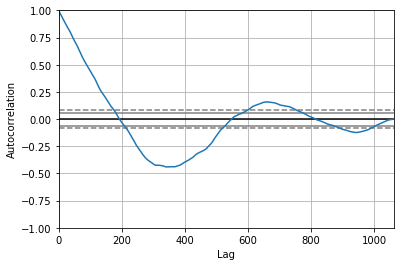

<Figure size 800x560 with 0 Axes>

Test MSE: 4.460


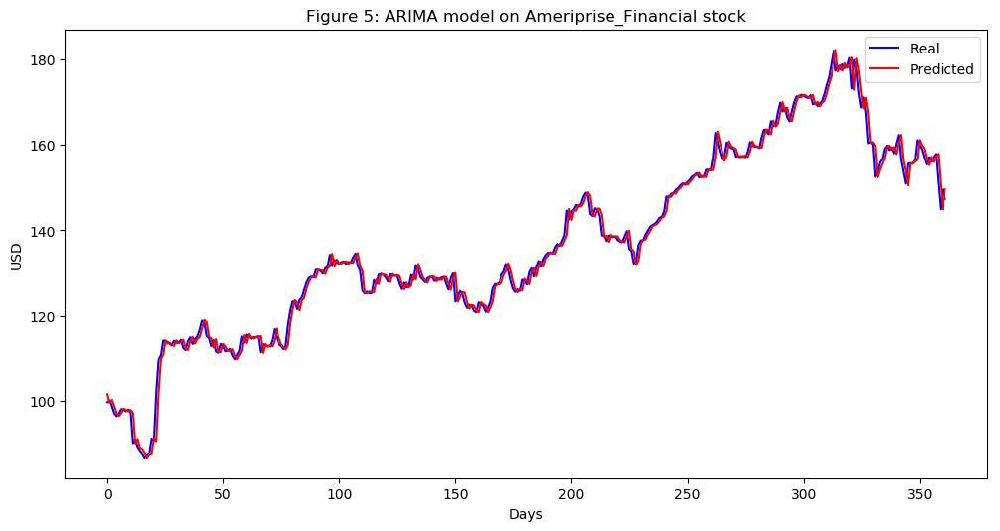

In [153]:
Ameriprise_Financial_series = SP500_TechIndicator['Ameriprise_Financial_Close']
Ameriprise_Financial_series_model = ARIMA(Ameriprise_Financial_series, order=(5, 1, 0))
Ameriprise_Financial_model_fit = Ameriprise_Financial_series_model.fit(disp=0)
print(Ameriprise_Financial_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Ameriprise_Financial_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Ameriprise_Financial_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Ameriprise_Financial_predictions = list()
for t in range(len(test)):
    Ameriprise_Financial_series_model = ARIMA(history, order=(5,1,0))
    Ameriprise_Financial_series_model_fit = Ameriprise_Financial_series_model.fit(disp=0)
    Ameriprise_Financial_output = Ameriprise_Financial_series_model_fit.forecast()
    yhat = Ameriprise_Financial_output[0]
    Ameriprise_Financial_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Ameriprise_Financial_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Ameriprise_Financial_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Ameriprise_Financial stock')
plt.legend()
plt.show()


#predictions
Ameriprise_Financial_predictions = pd.DataFrame({'Ameriprise_Financial_predictions':Ameriprise_Financial_predictions})
#Ameriprise_Financial_predictions.to_csv('Ameriprise_Financial_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:            D.Aon_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1621.048
Method:                       css-mle   S.D. of innovations              1.115
Date:                Sun, 17 Mar 2019   AIC                           3256.096
Time:                        13:37:05   BIC                           3290.865
Sample:                             1   HQIC                          3269.273
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 0.0520      0.031      1.701      0.089      -0.008       0.112
ar.L1.D.Aon_Close     0.0086      0.031      0.280      0.780      -0.052       0.069
ar.L2.D.Aon_Close    -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


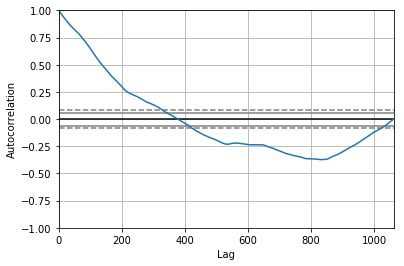

<Figure size 800x560 with 0 Axes>

Test MSE: 1.566


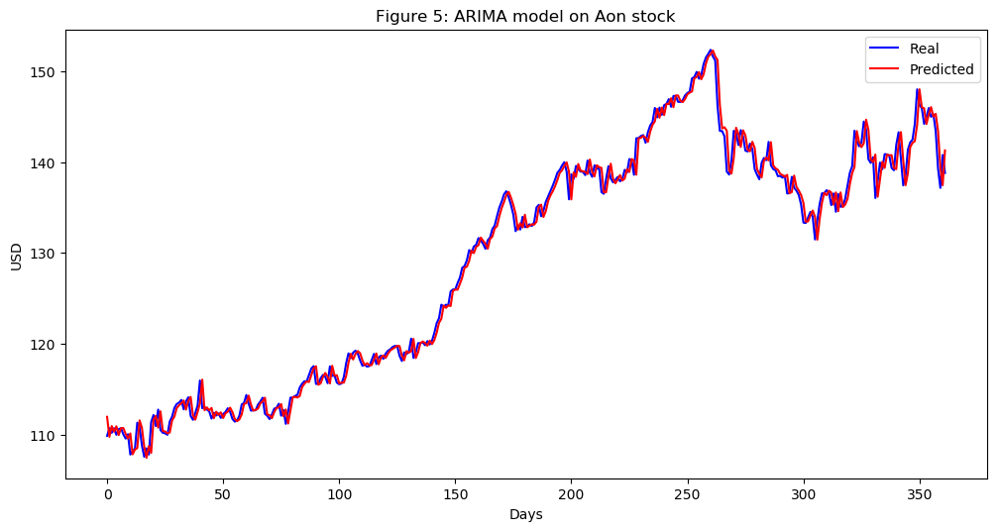

In [154]:
Aon_series = SP500_TechIndicator['Aon_Close']
Aon_series_model = ARIMA(Aon_series, order=(5, 1, 0))
Aon_model_fit = Aon_series_model.fit(disp=0)
print(Aon_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Aon_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Aon_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Aon_predictions = list()
for t in range(len(test)):
    Aon_series_model = ARIMA(history, order=(5,1,0))
    Aon_series_model_fit = Aon_series_model.fit(disp=0)
    Aon_output = Aon_series_model_fit.forecast()
    yhat = Aon_output[0]
    Aon_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Aon_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Aon_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Aon stock')
plt.legend()
plt.show()


#predictions
Aon_predictions = pd.DataFrame({'Aon_predictions':Aon_predictions})
#Aon_predictions.to_csv('Aon_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Arthur_J_Gallagher_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood                -782.358
Method:                               css-mle   S.D. of innovations              0.506
Date:                        Sun, 17 Mar 2019   AIC                           1578.715
Time:                                13:37:57   BIC                           1613.484
Sample:                                     1   HQIC                          1591.892
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0195      0.015      1.282      0.200      -0.010       0.049
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


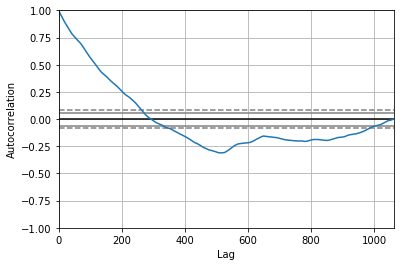

<Figure size 800x560 with 0 Axes>

Test MSE: 0.370


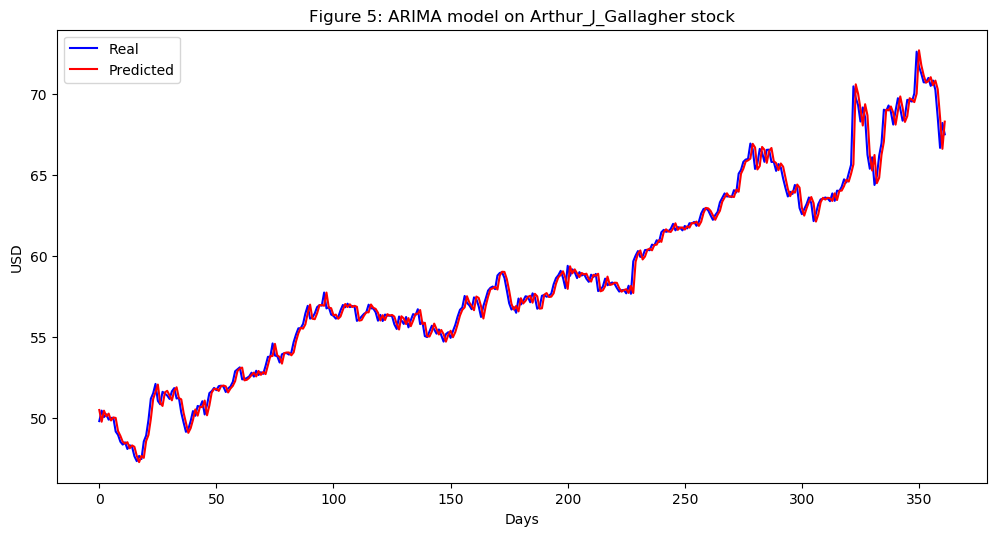

In [155]:
Arthur_J_Gallagher_series = SP500_TechIndicator['Arthur_J_Gallagher_Close']
Arthur_J_Gallagher_series_model = ARIMA(Arthur_J_Gallagher_series, order=(5, 1, 0))
Arthur_J_Gallagher_model_fit = Arthur_J_Gallagher_series_model.fit(disp=0)
print(Arthur_J_Gallagher_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Arthur_J_Gallagher_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Arthur_J_Gallagher_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Arthur_J_Gallagher_predictions = list()
for t in range(len(test)):
    Arthur_J_Gallagher_series_model = ARIMA(history, order=(5,1,0))
    Arthur_J_Gallagher_series_model_fit = Arthur_J_Gallagher_series_model.fit(disp=0)
    Arthur_J_Gallagher_output = Arthur_J_Gallagher_series_model_fit.forecast()
    yhat = Arthur_J_Gallagher_output[0]
    Arthur_J_Gallagher_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Arthur_J_Gallagher_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Arthur_J_Gallagher_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Arthur_J_Gallagher stock')
plt.legend()
plt.show()


#predictions
Arthur_J_Gallagher_predictions = pd.DataFrame({'Arthur_J_Gallagher_predictions':Arthur_J_Gallagher_predictions})
#Arthur_J_Gallagher_predictions.to_csv('Arthur_J_Gallagher_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Assurant_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1582.183
Method:                       css-mle   S.D. of innovations              1.075
Date:                Sun, 17 Mar 2019   AIC                           3178.365
Time:                        13:38:59   BIC                           3213.134
Sample:                             1   HQIC                          3191.542
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0221      0.030      0.731      0.465      -0.037       0.081
ar.L1.D.Assurant_Close    -0.0240      0.031     -0.781      0.435      -0.084       0.036
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


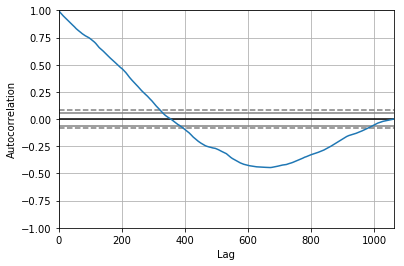

<Figure size 800x560 with 0 Axes>

Test MSE: 1.609


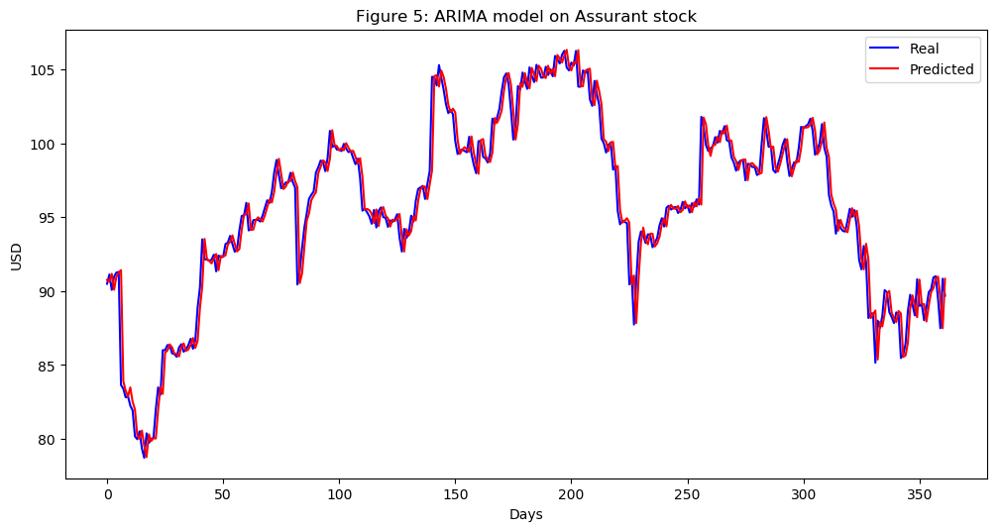

In [156]:
Assurant_series = SP500_TechIndicator['Assurant_Close']
Assurant_series_model = ARIMA(Assurant_series, order=(5, 1, 0))
Assurant_model_fit = Assurant_series_model.fit(disp=0)
print(Assurant_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Assurant_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Assurant_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Assurant_predictions = list()
for t in range(len(test)):
    Assurant_series_model = ARIMA(history, order=(5,1,0))
    Assurant_series_model_fit = Assurant_series_model.fit(disp=0)
    Assurant_output = Assurant_series_model_fit.forecast()
    yhat = Assurant_output[0]
    Assurant_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Assurant_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Assurant_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Assurant stock')
plt.legend()
plt.show()


#predictions
Assurant_predictions = pd.DataFrame({'Assurant_predictions':Assurant_predictions})
#Assurant_predictions.to_csv('Assurant_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.Bank_of_America_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood                -232.918
Method:                            css-mle   S.D. of innovations              0.301
Date:                     Sun, 17 Mar 2019   AIC                            479.836
Time:                             13:39:51   BIC                            514.605
Sample:                                  1   HQIC                           493.013
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0131      0.009      1.459      0.145      -0.005       0.031
ar.L1.D.Bank_of_America_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


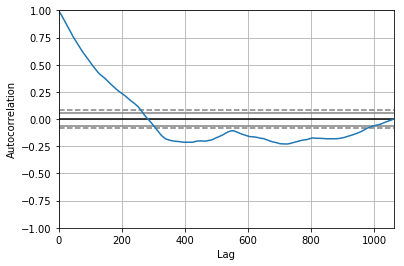

<Figure size 800x560 with 0 Axes>

Test MSE: 0.143


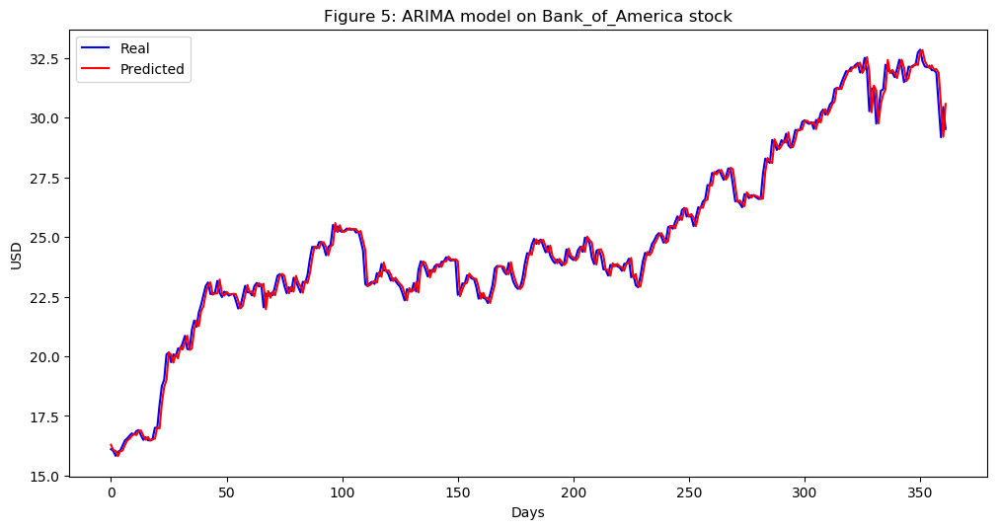

In [157]:
Bank_of_America_series = SP500_TechIndicator['Bank_of_America_Close']
Bank_of_America_series_model = ARIMA(Bank_of_America_series, order=(5, 1, 0))
Bank_of_America_model_fit = Bank_of_America_series_model.fit(disp=0)
print(Bank_of_America_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Bank_of_America_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Bank_of_America_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Bank_of_America_predictions = list()
for t in range(len(test)):
    Bank_of_America_series_model = ARIMA(history, order=(5,1,0))
    Bank_of_America_series_model_fit = Bank_of_America_series_model.fit(disp=0)
    Bank_of_America_output = Bank_of_America_series_model_fit.forecast()
    yhat = Bank_of_America_output[0]
    Bank_of_America_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Bank_of_America_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Bank_of_America_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Bank_of_America stock')
plt.legend()
plt.show()


#predictions
Bank_of_America_predictions = pd.DataFrame({'Bank_of_America_predictions':Bank_of_America_predictions})
#Bank_of_America_predictions.to_csv('Bank_of_America_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.The_Bank_of_NewYork_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood                -892.369
Method:                                css-mle   S.D. of innovations              0.561
Date:                         Sun, 17 Mar 2019   AIC                           1798.738
Time:                                 13:40:48   BIC                           1833.507
Sample:                                      1   HQIC                          1811.915
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0149      0.016      0.943      0.346      -0.016   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


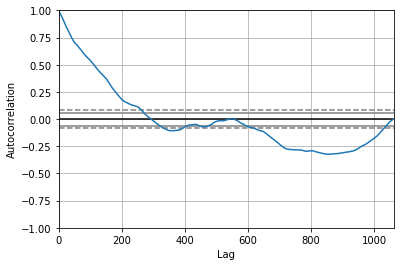

<Figure size 800x560 with 0 Axes>

Test MSE: 0.366


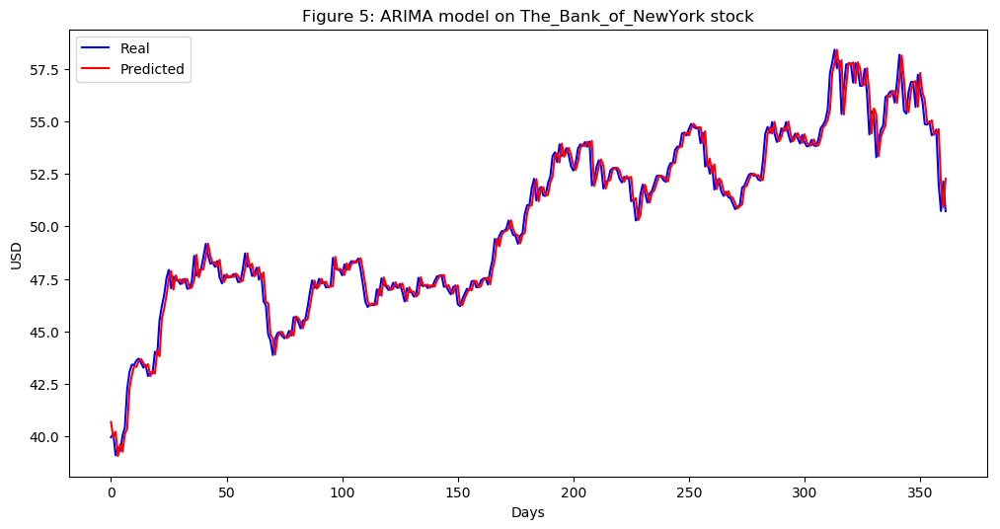

In [158]:
The_Bank_of_NewYork_series = SP500_TechIndicator['The_Bank_of_NewYork_Close']
The_Bank_of_NewYork_series_model = ARIMA(The_Bank_of_NewYork_series, order=(5, 1, 0))
The_Bank_of_NewYork_model_fit = The_Bank_of_NewYork_series_model.fit(disp=0)
print(The_Bank_of_NewYork_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(The_Bank_of_NewYork_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = The_Bank_of_NewYork_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
The_Bank_of_NewYork_predictions = list()
for t in range(len(test)):
    The_Bank_of_NewYork_series_model = ARIMA(history, order=(5,1,0))
    The_Bank_of_NewYork_series_model_fit = The_Bank_of_NewYork_series_model.fit(disp=0)
    The_Bank_of_NewYork_output = The_Bank_of_NewYork_series_model_fit.forecast()
    yhat = The_Bank_of_NewYork_output[0]
    The_Bank_of_NewYork_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, The_Bank_of_NewYork_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(The_Bank_of_NewYork_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on The_Bank_of_NewYork stock')
plt.legend()
plt.show()


#predictions
The_Bank_of_NewYork_predictions = pd.DataFrame({'The_Bank_of_NewYork_predictions':The_Bank_of_NewYork_predictions})
#The_Bank_of_NewYork_predictions.to_csv('The_Bank_of_NewYork_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:            D.BBT_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -781.917
Method:                       css-mle   S.D. of innovations              0.506
Date:                Sun, 17 Mar 2019   AIC                           1577.834
Time:                        13:41:52   BIC                           1612.603
Sample:                             1   HQIC                          1591.011
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 0.0135      0.014      0.935      0.350      -0.015       0.042
ar.L1.D.BBT_Close     0.0196      0.031      0.637      0.524      -0.041       0.080
ar.L2.D.BBT_Close    -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


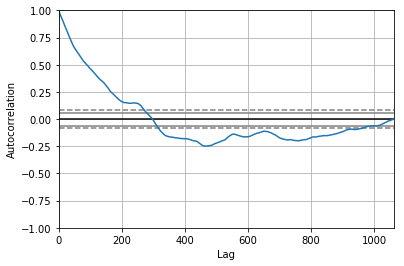

<Figure size 800x560 with 0 Axes>

Test MSE: 0.334


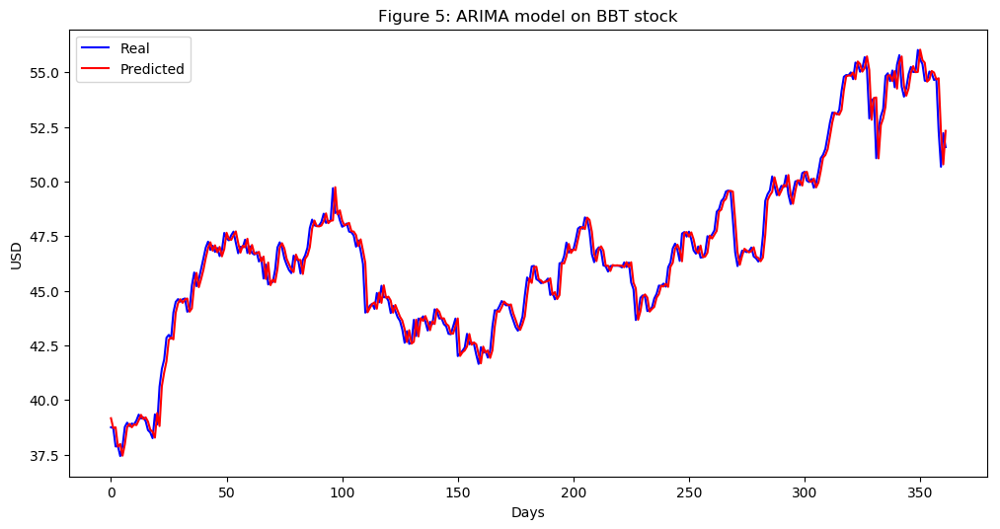

In [159]:
BBT_series = SP500_TechIndicator['BBT_Close']
BBT_series_model = ARIMA(BBT_series, order=(5, 1, 0))
BBT_model_fit = BBT_series_model.fit(disp=0)
print(BBT_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(BBT_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = BBT_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
BBT_predictions = list()
for t in range(len(test)):
    BBT_series_model = ARIMA(history, order=(5,1,0))
    BBT_series_model_fit = BBT_series_model.fit(disp=0)
    BBT_output = BBT_series_model_fit.forecast()
    yhat = BBT_output[0]
    BBT_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, BBT_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(BBT_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on BBT stock')
plt.legend()
plt.show()


#predictions
BBT_predictions = pd.DataFrame({'BBT_predictions':BBT_predictions})
#BBT_predictions.to_csv('BBT_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Berkshire_Hathaway_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1947.337
Method:                               css-mle   S.D. of innovations              1.517
Date:                        Sun, 17 Mar 2019   AIC                           3908.673
Time:                                13:43:02   BIC                           3943.442
Sample:                                     1   HQIC                          3921.850
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0730      0.043      1.695      0.090      -0.011       0.157
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


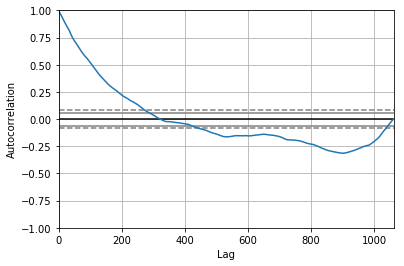

<Figure size 800x560 with 0 Axes>

Test MSE: 3.562


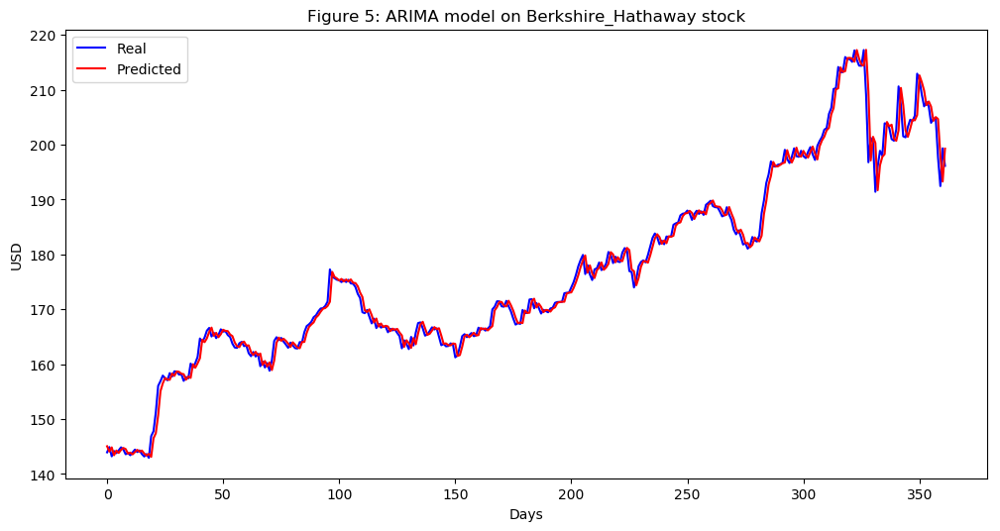

In [160]:
Berkshire_Hathaway_series = SP500_TechIndicator['Berkshire_Hathaway_Close']
Berkshire_Hathaway_series_model = ARIMA(Berkshire_Hathaway_series, order=(5, 1, 0))
Berkshire_Hathaway_model_fit = Berkshire_Hathaway_series_model.fit(disp=0)
print(Berkshire_Hathaway_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Berkshire_Hathaway_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Berkshire_Hathaway_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Berkshire_Hathaway_predictions = list()
for t in range(len(test)):
    Berkshire_Hathaway_series_model = ARIMA(history, order=(5,1,0))
    Berkshire_Hathaway_series_model_fit = Berkshire_Hathaway_series_model.fit(disp=0)
    Berkshire_Hathaway_output = Berkshire_Hathaway_series_model_fit.forecast()
    yhat = Berkshire_Hathaway_output[0]
    Berkshire_Hathaway_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Berkshire_Hathaway_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Berkshire_Hathaway_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Berkshire_Hathaway stock')
plt.legend()
plt.show()


#predictions
Berkshire_Hathaway_predictions = pd.DataFrame({'Berkshire_Hathaway_predictions':Berkshire_Hathaway_predictions})
#Berkshire_Hathaway_predictions.to_csv('Berkshire_Hathaway_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:      D.BlackRock_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -3210.711
Method:                       css-mle   S.D. of innovations              4.989
Date:                Sun, 17 Mar 2019   AIC                           6435.422
Time:                        14:05:32   BIC                           6470.191
Sample:                             1   HQIC                          6448.598
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.2011      0.156      1.291      0.197      -0.104       0.506
ar.L1.D.BlackRock_Close    -0.0087      0.031     -0.282      0.778      -0.069       0.052


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


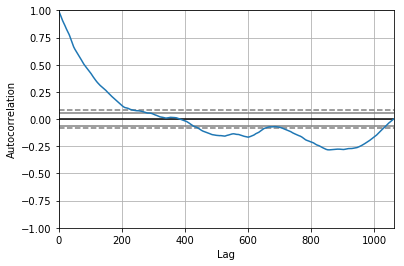

<Figure size 800x560 with 0 Axes>

Test MSE: 30.835


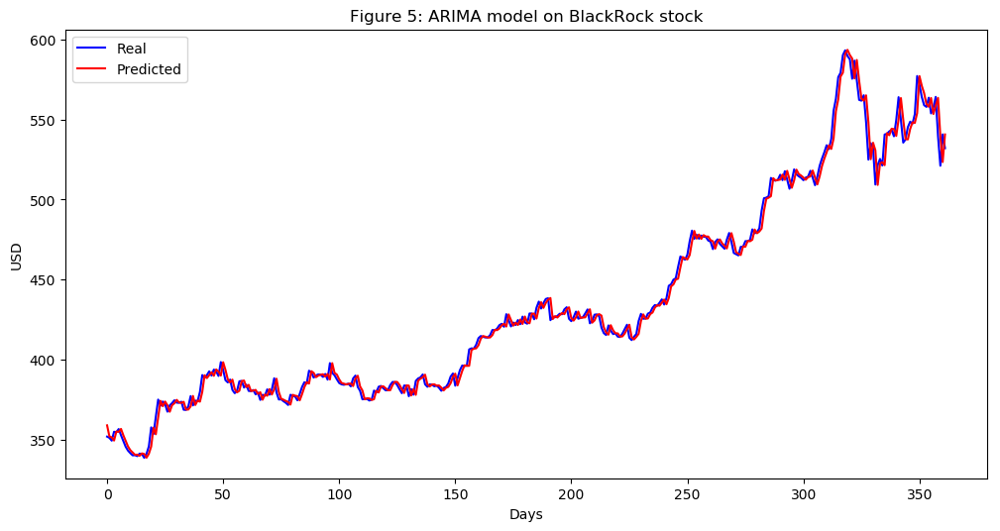

In [161]:
BlackRock_series = SP500_TechIndicator['BlackRock_Close']
BlackRock_series_model = ARIMA(BlackRock_series, order=(5, 1, 0))
BlackRock_model_fit = BlackRock_series_model.fit(disp=0)
print(BlackRock_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(BlackRock_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = BlackRock_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
BlackRock_predictions = list()
for t in range(len(test)):
    BlackRock_series_model = ARIMA(history, order=(5,1,0))
    BlackRock_series_model_fit = BlackRock_series_model.fit(disp=0)
    BlackRock_output = BlackRock_series_model_fit.forecast()
    yhat = BlackRock_output[0]
    BlackRock_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, BlackRock_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(BlackRock_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on BlackRock stock')
plt.legend()
plt.show()


#predictions
BlackRock_predictions = pd.DataFrame({'BlackRock_predictions':BlackRock_predictions})
#BlackRock_predictions.to_csv('BlackRock_predictions.csv')



                                   ARIMA Model Results                                   
Dep. Variable:     D.Capital_One_Financial_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood               -1678.150
Method:                                  css-mle   S.D. of innovations              1.177
Date:                           Sun, 17 Mar 2019   AIC                           3370.299
Time:                                   14:06:31   BIC                           3405.068
Sample:                                        1   HQIC                          3383.476
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                   0.0160      0.034      0.465    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


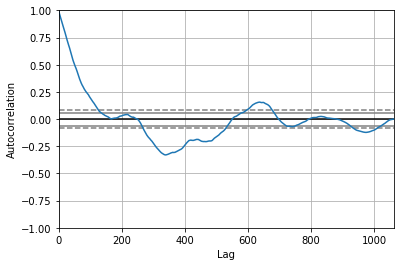

<Figure size 800x560 with 0 Axes>

Test MSE: 1.613


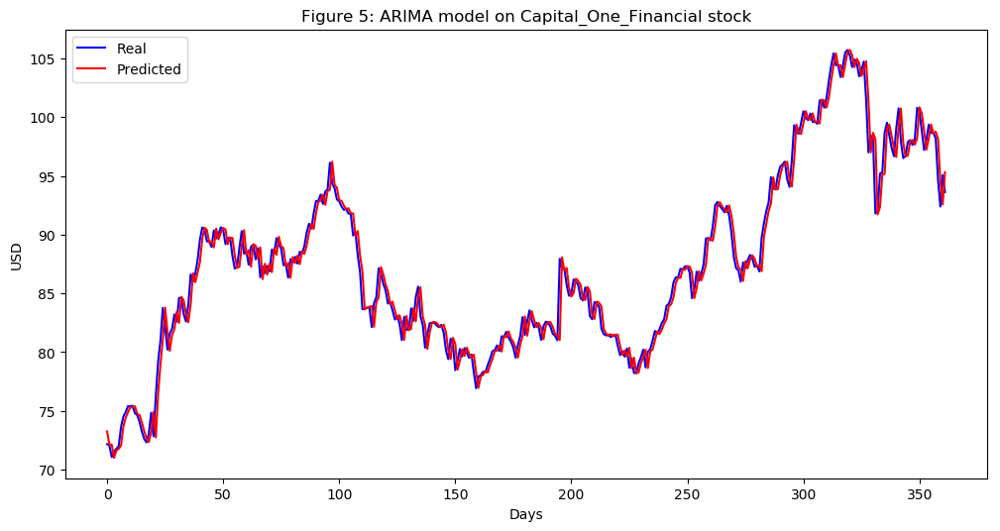

In [162]:
Capital_One_Financial_series = SP500_TechIndicator['Capital_One_Financial_Close']
Capital_One_Financial_series_model = ARIMA(Capital_One_Financial_series, order=(5, 1, 0))
Capital_One_Financial_model_fit = Capital_One_Financial_series_model.fit(disp=0)
print(Capital_One_Financial_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Capital_One_Financial_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Capital_One_Financial_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Capital_One_Financial_predictions = list()
for t in range(len(test)):
    Capital_One_Financial_series_model = ARIMA(history, order=(5,1,0))
    Capital_One_Financial_series_model_fit = Capital_One_Financial_series_model.fit(disp=0)
    Capital_One_Financial_output = Capital_One_Financial_series_model_fit.forecast()
    yhat = Capital_One_Financial_output[0]
    Capital_One_Financial_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Capital_One_Financial_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Capital_One_Financial_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Capital_One_Financial stock')
plt.legend()
plt.show()


#predictions
Capital_One_Financial_predictions = pd.DataFrame({'Capital_One_Financial_predictions':Capital_One_Financial_predictions})
#Capital_One_Financial_predictions.to_csv('Capital_One_Financial_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.Cboe_Global_Markets_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1517.955
Method:                                css-mle   S.D. of innovations              1.012
Date:                         Sun, 17 Mar 2019   AIC                           3049.909
Time:                                 14:07:32   BIC                           3084.678
Sample:                                      1   HQIC                          3063.086
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0564      0.035      1.611      0.108      -0.012   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


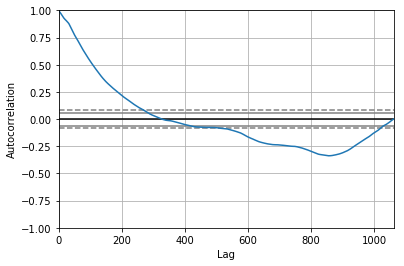

<Figure size 800x560 with 0 Axes>

Test MSE: 2.003


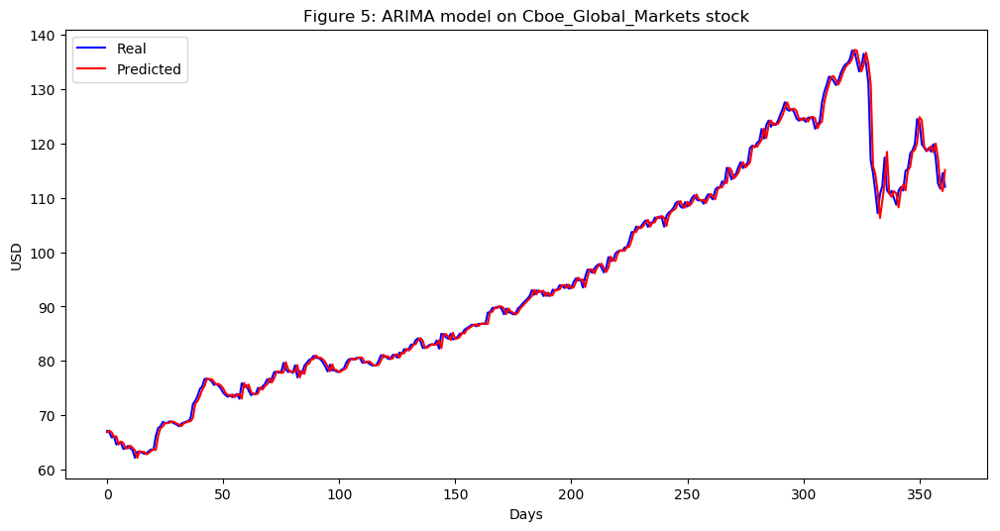

In [163]:
Cboe_Global_Markets_series = SP500_TechIndicator['Cboe_Global_Markets_Close']
Cboe_Global_Markets_series_model = ARIMA(Cboe_Global_Markets_series, order=(5, 1, 0))
Cboe_Global_Markets_model_fit = Cboe_Global_Markets_series_model.fit(disp=0)
print(Cboe_Global_Markets_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Cboe_Global_Markets_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Cboe_Global_Markets_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Cboe_Global_Markets_predictions = list()
for t in range(len(test)):
    Cboe_Global_Markets_series_model = ARIMA(history, order=(5,1,0))
    Cboe_Global_Markets_series_model_fit = Cboe_Global_Markets_series_model.fit(disp=0)
    Cboe_Global_Markets_output = Cboe_Global_Markets_series_model_fit.forecast()
    yhat = Cboe_Global_Markets_output[0]
    Cboe_Global_Markets_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Cboe_Global_Markets_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Cboe_Global_Markets_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Cboe_Global_Markets stock')
plt.legend()
plt.show()


#predictions
Cboe_Global_Markets_predictions = pd.DataFrame({'Cboe_Global_Markets_predictions':Cboe_Global_Markets_predictions})
#Cboe_Global_Markets_predictions.to_csv('Cboe_Global_Markets_predictions.csv')



                                     ARIMA Model Results                                      
Dep. Variable:     D.Charles_Schwab_Corporation_Close   No. Observations:                 1061
Model:                                 ARIMA(5, 1, 0)   Log Likelihood                -953.999
Method:                                       css-mle   S.D. of innovations              0.595
Date:                                Sun, 17 Mar 2019   AIC                           1921.999
Time:                                        14:08:46   BIC                           1956.767
Sample:                                             1   HQIC                          1935.175
                                                                                              
                                               coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------
const                 

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


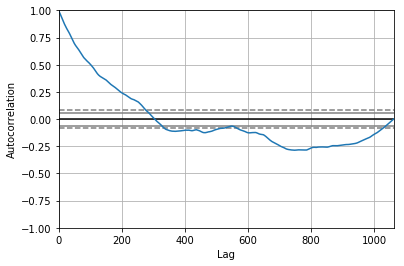

<Figure size 800x560 with 0 Axes>

Test MSE: 0.459


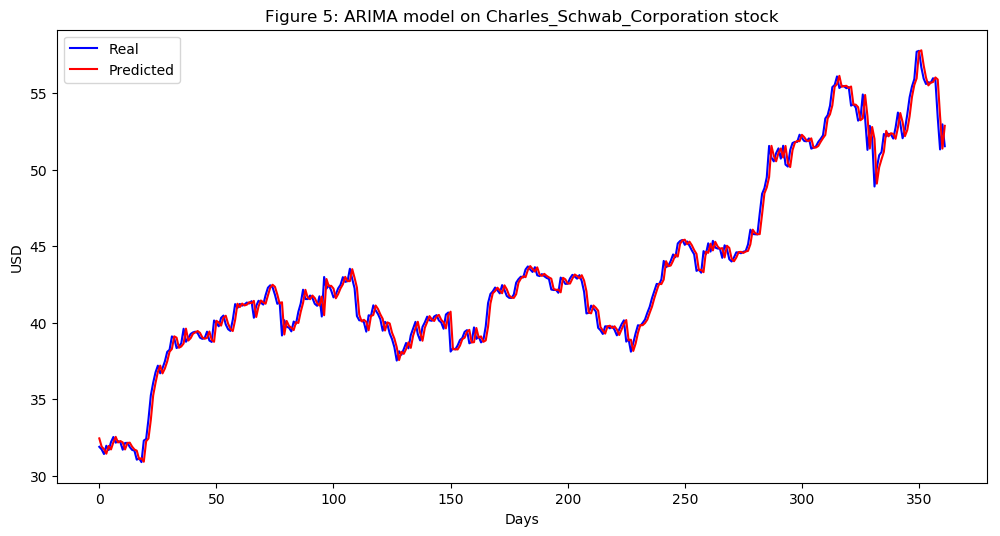

In [164]:
Charles_Schwab_Corporation_series = SP500_TechIndicator['Charles_Schwab_Corporation_Close']
Charles_Schwab_Corporation_series_model = ARIMA(Charles_Schwab_Corporation_series, order=(5, 1, 0))
Charles_Schwab_Corporation_model_fit = Charles_Schwab_Corporation_series_model.fit(disp=0)
print(Charles_Schwab_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Charles_Schwab_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Charles_Schwab_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Charles_Schwab_Corporation_predictions = list()
for t in range(len(test)):
    Charles_Schwab_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Charles_Schwab_Corporation_series_model_fit = Charles_Schwab_Corporation_series_model.fit(disp=0)
    Charles_Schwab_Corporation_output = Charles_Schwab_Corporation_series_model_fit.forecast()
    yhat = Charles_Schwab_Corporation_output[0]
    Charles_Schwab_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Charles_Schwab_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Charles_Schwab_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Charles_Schwab_Corporation stock')
plt.legend()
plt.show()


#predictions
Charles_Schwab_Corporation_predictions = pd.DataFrame({'Charles_Schwab_Corporation_predictions':Charles_Schwab_Corporation_predictions})
#Charles_Schwab_Corporation_predictions.to_csv('Charles_Schwab_Corporation_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Chubb_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1894.715
Method:                       css-mle   S.D. of innovations              1.443
Date:                Sun, 17 Mar 2019   AIC                           3803.430
Time:                        14:09:56   BIC                           3838.199
Sample:                             1   HQIC                          3816.607
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0378      0.042      0.897      0.370      -0.045       0.120
ar.L1.D.Chubb_Close     0.0006      0.031      0.019      0.984      -0.060       0.061
ar.L2.D.Chubb_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


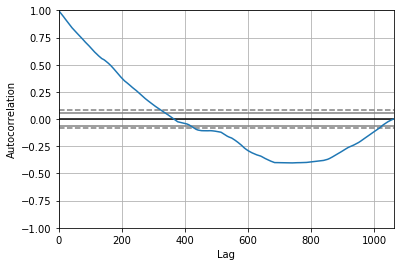

<Figure size 800x560 with 0 Axes>

Test MSE: 1.806


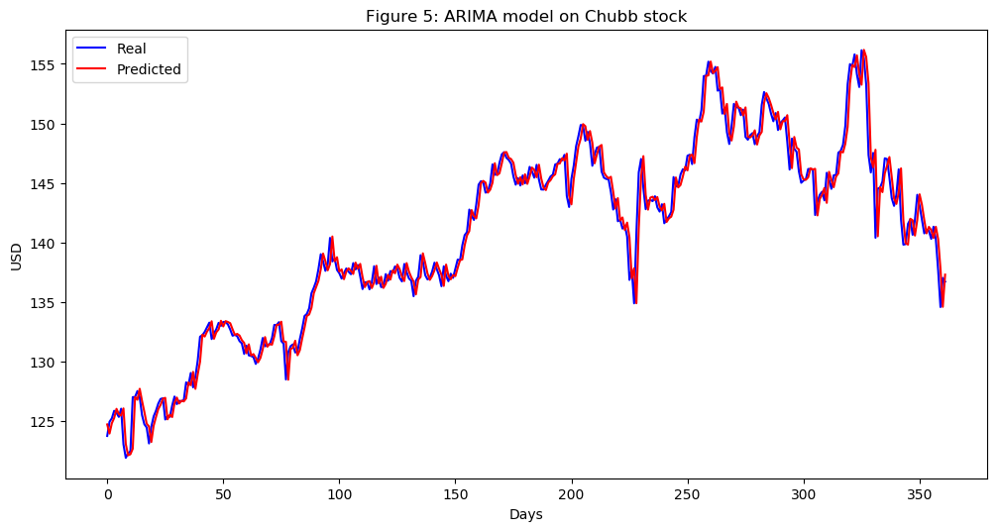

In [165]:
Chubb_series = SP500_TechIndicator['Chubb_Close']
Chubb_series_model = ARIMA(Chubb_series, order=(5, 1, 0))
Chubb_model_fit = Chubb_series_model.fit(disp=0)
print(Chubb_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Chubb_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Chubb_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Chubb_predictions = list()
for t in range(len(test)):
    Chubb_series_model = ARIMA(history, order=(5,1,0))
    Chubb_series_model_fit = Chubb_series_model.fit(disp=0)
    Chubb_output = Chubb_series_model_fit.forecast()
    yhat = Chubb_output[0]
    Chubb_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Chubb_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Chubb_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Chubb stock')
plt.legend()
plt.show()


#predictions
Chubb_predictions = pd.DataFrame({'Chubb_predictions':Chubb_predictions})
#Chubb_predictions.to_csv('Chubb_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Cincinnati_Financial_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -1096.686
Method:                                 css-mle   S.D. of innovations              0.680
Date:                          Sun, 17 Mar 2019   AIC                           2207.372
Time:                                  14:10:56   BIC                           2242.141
Sample:                                       1   HQIC                          2220.548
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0196      0.020      1.005      0.315    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


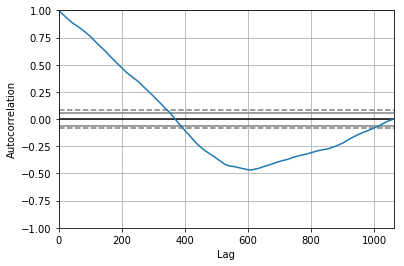

<Figure size 800x560 with 0 Axes>

Test MSE: 0.740


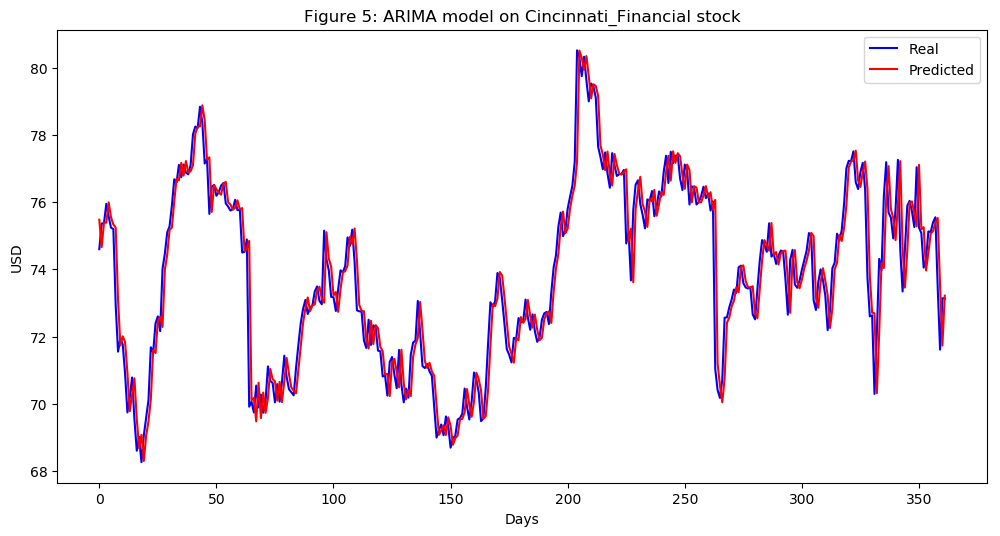

In [166]:
Cincinnati_Financial_series = SP500_TechIndicator['Cincinnati_Financial_Close']
Cincinnati_Financial_series_model = ARIMA(Cincinnati_Financial_series, order=(5, 1, 0))
Cincinnati_Financial_model_fit = Cincinnati_Financial_series_model.fit(disp=0)
print(Cincinnati_Financial_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Cincinnati_Financial_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Cincinnati_Financial_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Cincinnati_Financial_predictions = list()
for t in range(len(test)):
    Cincinnati_Financial_series_model = ARIMA(history, order=(5,1,0))
    Cincinnati_Financial_series_model_fit = Cincinnati_Financial_series_model.fit(disp=0)
    Cincinnati_Financial_output = Cincinnati_Financial_series_model_fit.forecast()
    yhat = Cincinnati_Financial_output[0]
    Cincinnati_Financial_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Cincinnati_Financial_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Cincinnati_Financial_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Cincinnati_Financial stock')
plt.legend()
plt.show()


#predictions
Cincinnati_Financial_predictions = pd.DataFrame({'Cincinnati_Financial_predictions':Cincinnati_Financial_predictions})
#Cincinnati_Financial_predictions.to_csv('Cincinnati_Financial_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:      D.Citigroup_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1262.068
Method:                       css-mle   S.D. of innovations              0.795
Date:                Sun, 17 Mar 2019   AIC                           2538.135
Time:                        14:12:24   BIC                           2572.904
Sample:                             1   HQIC                          2551.312
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.0152      0.023      0.649      0.516      -0.031       0.061
ar.L1.D.Citigroup_Close     0.0536      0.031      1.744      0.081      -0.007       0.114


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


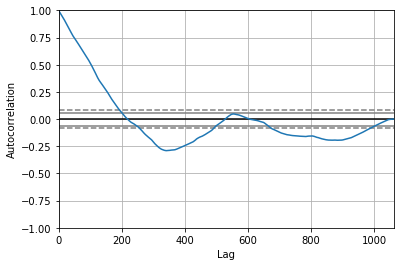

<Figure size 800x560 with 0 Axes>

Test MSE: 0.682


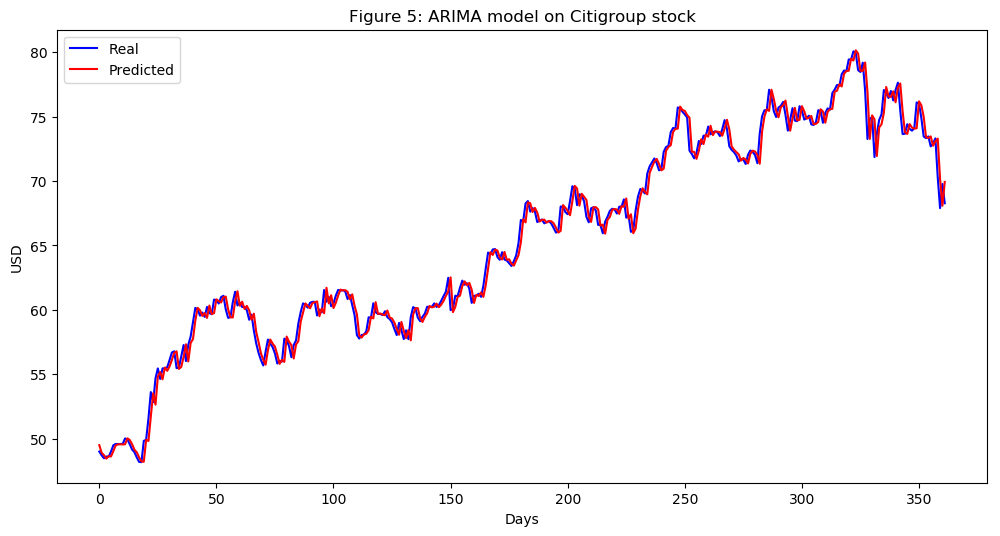

In [167]:
Citigroup_series = SP500_TechIndicator['Citigroup_Close']
Citigroup_series_model = ARIMA(Citigroup_series, order=(5, 1, 0))
Citigroup_model_fit = Citigroup_series_model.fit(disp=0)
print(Citigroup_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Citigroup_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Citigroup_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Citigroup_predictions = list()
for t in range(len(test)):
    Citigroup_series_model = ARIMA(history, order=(5,1,0))
    Citigroup_series_model_fit = Citigroup_series_model.fit(disp=0)
    Citigroup_output = Citigroup_series_model_fit.forecast()
    yhat = Citigroup_output[0]
    Citigroup_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Citigroup_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Citigroup_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Citigroup stock')
plt.legend()
plt.show()


#predictions
Citigroup_predictions = pd.DataFrame({'Citigroup_predictions':Citigroup_predictions})
#Citigroup_predictions.to_csv('Citigroup_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:      D.CME_Group_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1764.588
Method:                       css-mle   S.D. of innovations              1.277
Date:                Sun, 17 Mar 2019   AIC                           3543.177
Time:                        14:13:59   BIC                           3577.946
Sample:                             1   HQIC                          3556.353
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.0759      0.038      1.994      0.046       0.001       0.151
ar.L1.D.CME_Group_Close    -0.0708      0.031     -2.303      0.021      -0.131      -0.011


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


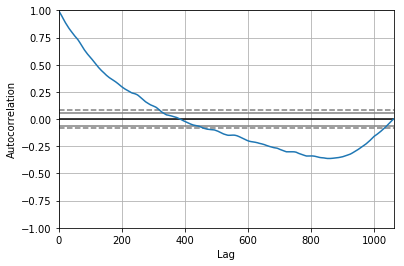

<Figure size 800x560 with 0 Axes>

Test MSE: 2.427


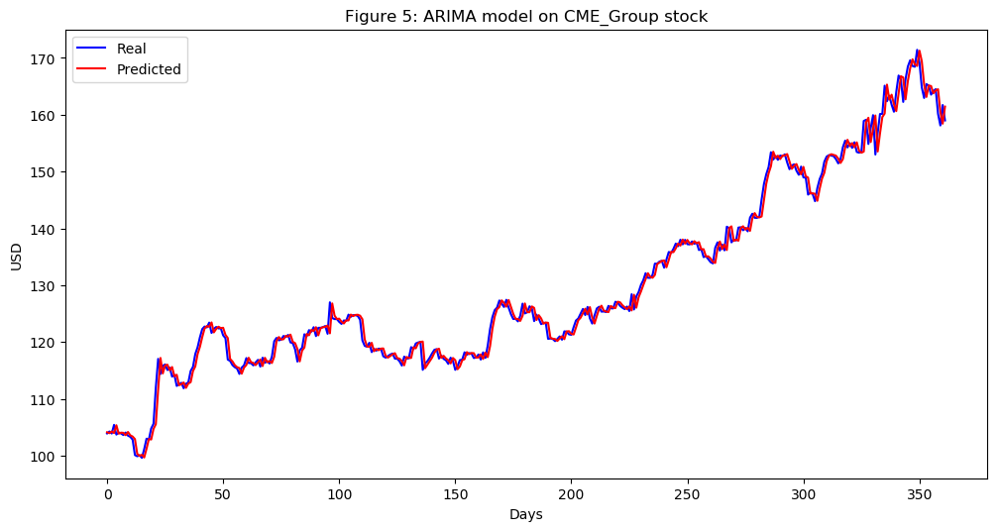

In [168]:
CME_Group_series = SP500_TechIndicator['CME_Group_Close']
CME_Group_series_model = ARIMA(CME_Group_series, order=(5, 1, 0))
CME_Group_model_fit = CME_Group_series_model.fit(disp=0)
print(CME_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(CME_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = CME_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
CME_Group_predictions = list()
for t in range(len(test)):
    CME_Group_series_model = ARIMA(history, order=(5,1,0))
    CME_Group_series_model_fit = CME_Group_series_model.fit(disp=0)
    CME_Group_output = CME_Group_series_model_fit.forecast()
    yhat = CME_Group_output[0]
    CME_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, CME_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(CME_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on CME_Group stock')
plt.legend()
plt.show()


#predictions
CME_Group_predictions = pd.DataFrame({'CME_Group_predictions':CME_Group_predictions})
#CME_Group_predictions.to_csv('CME_Group_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Comerica_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1402.945
Method:                       css-mle   S.D. of innovations              0.908
Date:                Sun, 17 Mar 2019   AIC                           2819.890
Time:                        14:15:06   BIC                           2854.659
Sample:                             1   HQIC                          2833.066
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0442      0.026      1.683      0.093      -0.007       0.096
ar.L1.D.Comerica_Close     0.0203      0.031      0.660      0.510      -0.040       0.081
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


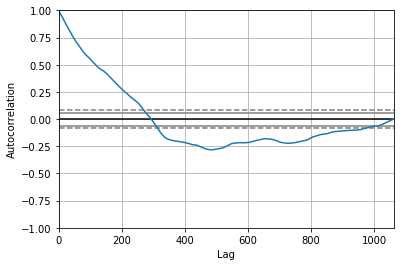

<Figure size 800x560 with 0 Axes>

Test MSE: 1.346


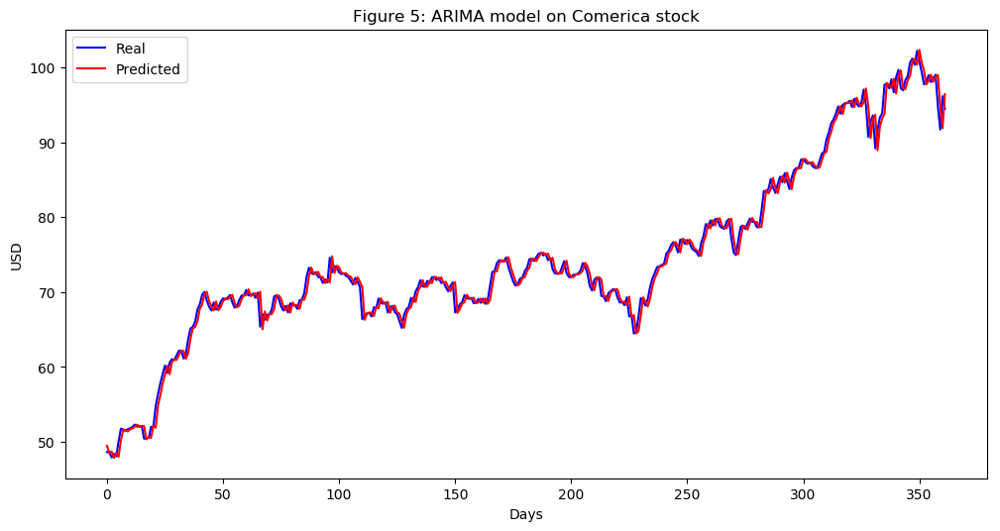

In [169]:
Comerica_series = SP500_TechIndicator['Comerica_Close']
Comerica_series_model = ARIMA(Comerica_series, order=(5, 1, 0))
Comerica_model_fit = Comerica_series_model.fit(disp=0)
print(Comerica_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Comerica_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Comerica_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Comerica_predictions = list()
for t in range(len(test)):
    Comerica_series_model = ARIMA(history, order=(5,1,0))
    Comerica_series_model_fit = Comerica_series_model.fit(disp=0)
    Comerica_output = Comerica_series_model_fit.forecast()
    yhat = Comerica_output[0]
    Comerica_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Comerica_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Comerica_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Comerica stock')
plt.legend()
plt.show()


#predictions
Comerica_predictions = pd.DataFrame({'Comerica_predictions':Comerica_predictions})
#Comerica_predictions.to_csv('Comerica_predictions.csv')



                                      ARIMA Model Results                                      
Dep. Variable:     D.Discover_Financial_Services_Close   No. Observations:                 1061
Model:                                  ARIMA(5, 1, 0)   Log Likelihood               -1288.405
Method:                                        css-mle   S.D. of innovations              0.815
Date:                                 Sun, 17 Mar 2019   AIC                           2590.809
Time:                                         14:16:06   BIC                           2625.578
Sample:                                              1   HQIC                          2603.986
                                                                                               
                                                coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------------
const       

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


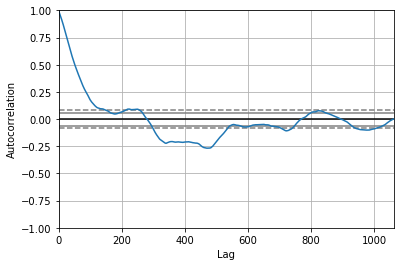

<Figure size 800x560 with 0 Axes>

Test MSE: 0.852


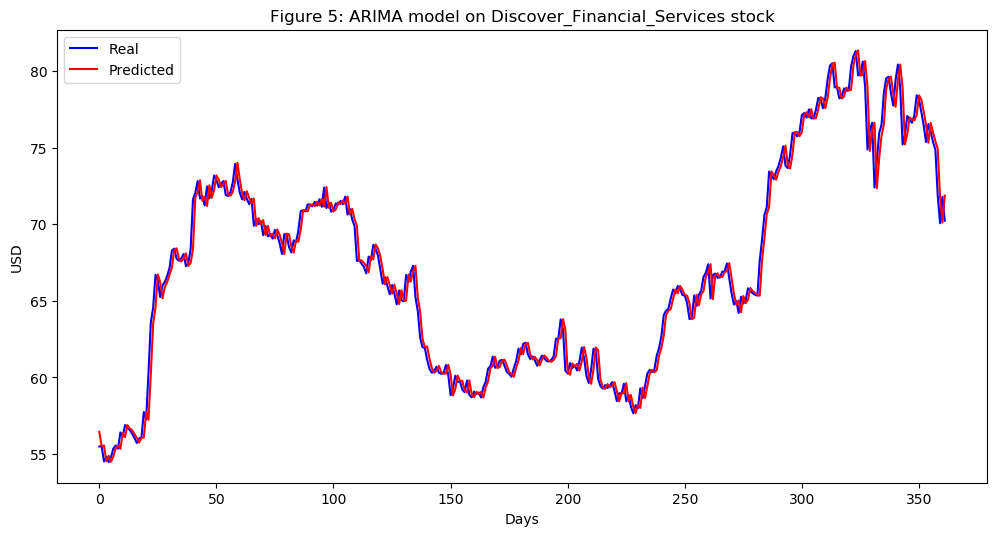

In [170]:
Discover_Financial_Services_series = SP500_TechIndicator['Discover_Financial_Services_Close']
Discover_Financial_Services_series_model = ARIMA(Discover_Financial_Services_series, order=(5, 1, 0))
Discover_Financial_Services_model_fit = Discover_Financial_Services_series_model.fit(disp=0)
print(Discover_Financial_Services_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Discover_Financial_Services_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Discover_Financial_Services_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Discover_Financial_Services_predictions = list()
for t in range(len(test)):
    Discover_Financial_Services_series_model = ARIMA(history, order=(5,1,0))
    Discover_Financial_Services_series_model_fit = Discover_Financial_Services_series_model.fit(disp=0)
    Discover_Financial_Services_output = Discover_Financial_Services_series_model_fit.forecast()
    yhat = Discover_Financial_Services_output[0]
    Discover_Financial_Services_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Discover_Financial_Services_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Discover_Financial_Services_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Discover_Financial_Services stock')
plt.legend()
plt.show()


#predictions
Discover_Financial_Services_predictions = pd.DataFrame({'Discover_Financial_Services_predictions':Discover_Financial_Services_predictions})
#Discover_Financial_Services_predictions.to_csv('Discover_Financial_Services_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.ETrade_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -909.230
Method:                       css-mle   S.D. of innovations              0.570
Date:                Sun, 17 Mar 2019   AIC                           1832.460
Time:                        14:17:04   BIC                           1867.229
Sample:                             1   HQIC                          1845.637
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0325      0.016      2.016      0.044       0.001       0.064
ar.L1.D.ETrade_Close    -0.0223      0.031     -0.726      0.468      -0.083       0.038
ar.L2.D.ETra

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


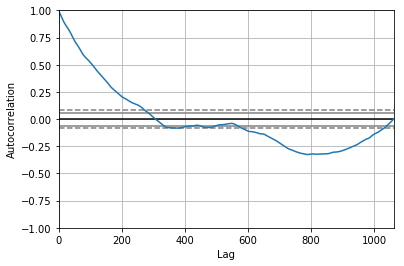

<Figure size 800x560 with 0 Axes>

Test MSE: 0.460


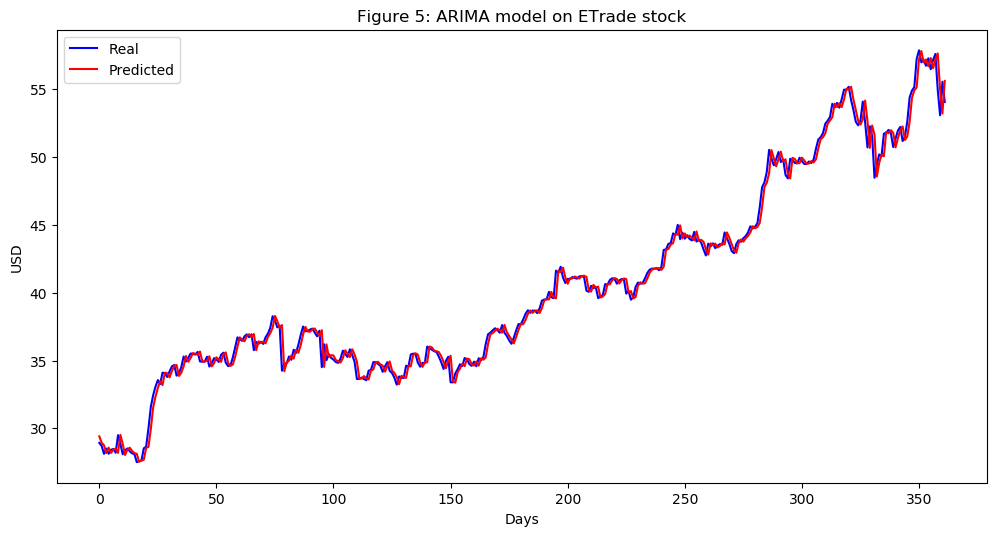

In [171]:
ETrade_series = SP500_TechIndicator['ETrade_Close']
ETrade_series_model = ARIMA(ETrade_series, order=(5, 1, 0))
ETrade_model_fit = ETrade_series_model.fit(disp=0)
print(ETrade_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(ETrade_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = ETrade_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
ETrade_predictions = list()
for t in range(len(test)):
    ETrade_series_model = ARIMA(history, order=(5,1,0))
    ETrade_series_model_fit = ETrade_series_model.fit(disp=0)
    ETrade_output = ETrade_series_model_fit.forecast()
    yhat = ETrade_output[0]
    ETrade_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, ETrade_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(ETrade_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on ETrade stock')
plt.legend()
plt.show()


#predictions
ETrade_predictions = pd.DataFrame({'ETrade_predictions':ETrade_predictions})
#ETrade_predictions.to_csv('ETrade_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Everest_Re_Group_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -2386.199
Method:                             css-mle   S.D. of innovations              2.293
Date:                      Sun, 17 Mar 2019   AIC                           4786.398
Time:                              14:18:18   BIC                           4821.167
Sample:                                   1   HQIC                          4799.574
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0904      0.061      1.487      0.137      -0.029       0.210
ar.L1.D.Everest_Re_Grou

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


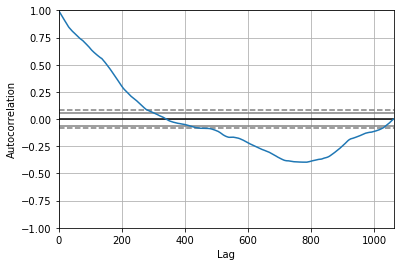

<Figure size 800x560 with 0 Axes>

Test MSE: 9.799


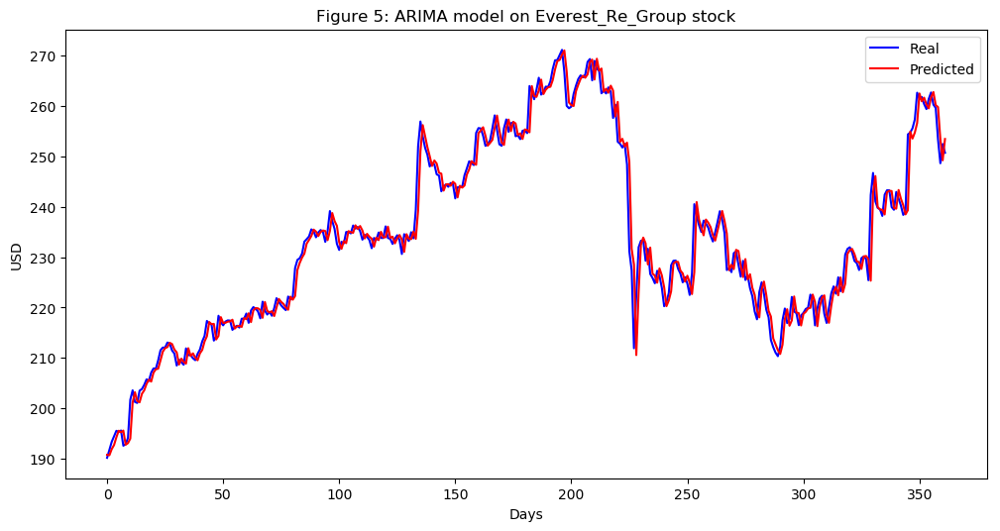

In [172]:
Everest_Re_Group_series = SP500_TechIndicator['Everest_Re_Group_Close']
Everest_Re_Group_series_model = ARIMA(Everest_Re_Group_series, order=(5, 1, 0))
Everest_Re_Group_model_fit = Everest_Re_Group_series_model.fit(disp=0)
print(Everest_Re_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Everest_Re_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Everest_Re_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Everest_Re_Group_predictions = list()
for t in range(len(test)):
    Everest_Re_Group_series_model = ARIMA(history, order=(5,1,0))
    Everest_Re_Group_series_model_fit = Everest_Re_Group_series_model.fit(disp=0)
    Everest_Re_Group_output = Everest_Re_Group_series_model_fit.forecast()
    yhat = Everest_Re_Group_output[0]
    Everest_Re_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Everest_Re_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Everest_Re_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Everest_Re_Group stock')
plt.legend()
plt.show()


#predictions
Everest_Re_Group_predictions = pd.DataFrame({'Everest_Re_Group_predictions':Everest_Re_Group_predictions})
#Everest_Re_Group_predictions.to_csv('Everest_Re_Group_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.Fifth_Third_Bancorp_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood                -337.173
Method:                                css-mle   S.D. of innovations              0.332
Date:                         Sun, 17 Mar 2019   AIC                            688.345
Time:                                 14:19:09   BIC                            723.114
Sample:                                      1   HQIC                           701.522
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0098      0.010      1.017      0.310      -0.009   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


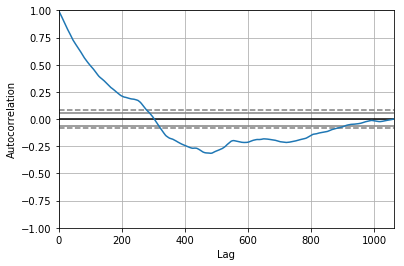

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.158


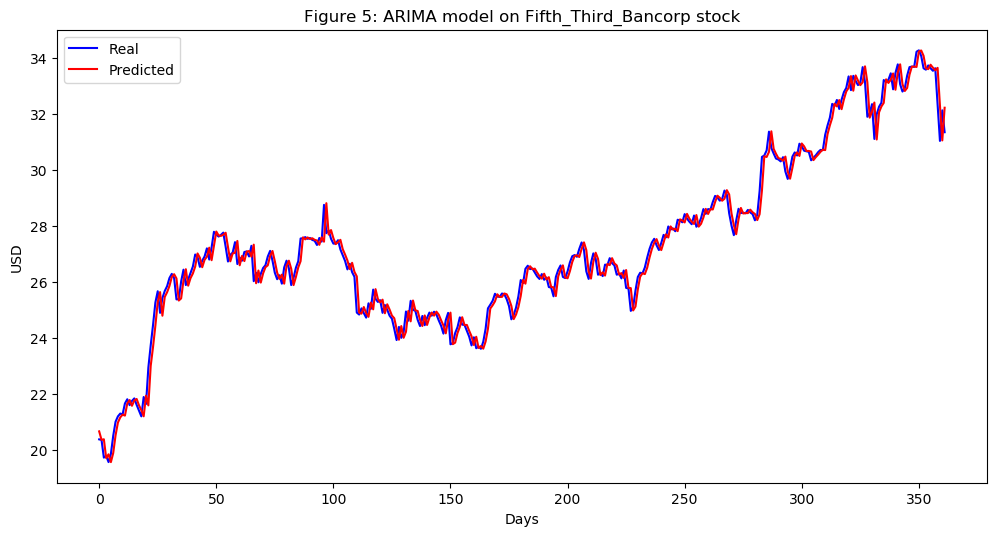

In [173]:
Fifth_Third_Bancorp_series = SP500_TechIndicator['Fifth_Third_Bancorp_Close']
Fifth_Third_Bancorp_series_model = ARIMA(Fifth_Third_Bancorp_series, order=(5, 1, 0))
Fifth_Third_Bancorp_model_fit = Fifth_Third_Bancorp_series_model.fit(disp=0)
print(Fifth_Third_Bancorp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Fifth_Third_Bancorp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Fifth_Third_Bancorp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Fifth_Third_Bancorp_predictions = list()
for t in range(len(test)):
    Fifth_Third_Bancorp_series_model = ARIMA(history, order=(5,1,0))
    Fifth_Third_Bancorp_series_model_fit = Fifth_Third_Bancorp_series_model.fit(disp=0)
    Fifth_Third_Bancorp_output = Fifth_Third_Bancorp_series_model_fit.forecast()
    yhat = Fifth_Third_Bancorp_output[0]
    Fifth_Third_Bancorp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Fifth_Third_Bancorp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Fifth_Third_Bancorp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Fifth_Third_Bancorp stock')
plt.legend()
plt.show()


#predictions
Fifth_Third_Bancorp_predictions = pd.DataFrame({'Fifth_Third_Bancorp_predictions':Fifth_Third_Bancorp_predictions})
#Fifth_Third_Bancorp_predictions.to_csv('Fifth_Third_Bancorp_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.First_Republic_Bank_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1555.857
Method:                                css-mle   S.D. of innovations              1.049
Date:                         Sun, 17 Mar 2019   AIC                           3125.714
Time:                                 14:20:02   BIC                           3160.482
Sample:                                      1   HQIC                          3138.890
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0366      0.029      1.280      0.201      -0.019   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


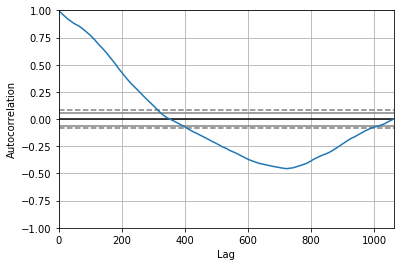

<Figure size 800x560 with 0 Axes>

Test MSE: 1.659


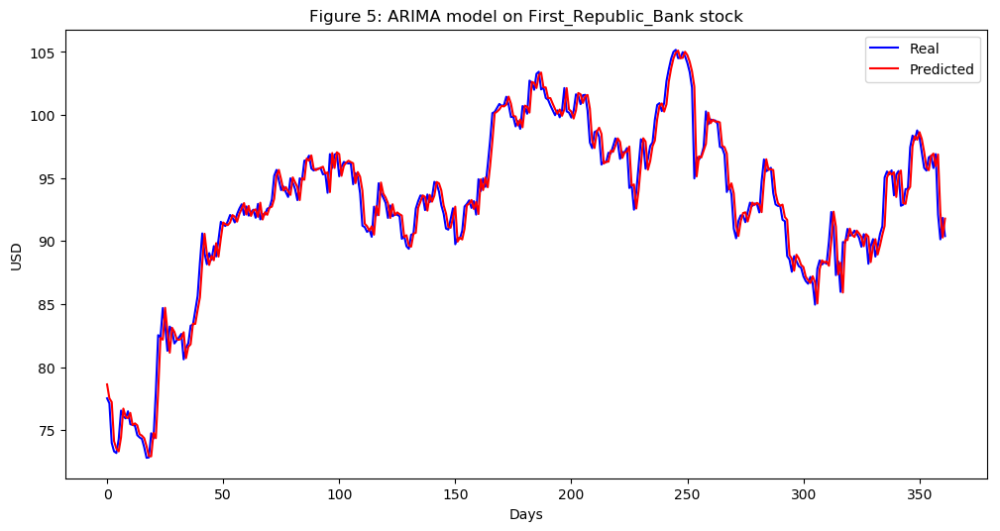

In [174]:
First_Republic_Bank_series = SP500_TechIndicator['First_Republic_Bank_Close']
First_Republic_Bank_series_model = ARIMA(First_Republic_Bank_series, order=(5, 1, 0))
First_Republic_Bank_model_fit = First_Republic_Bank_series_model.fit(disp=0)
print(First_Republic_Bank_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(First_Republic_Bank_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = First_Republic_Bank_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
First_Republic_Bank_predictions = list()
for t in range(len(test)):
    First_Republic_Bank_series_model = ARIMA(history, order=(5,1,0))
    First_Republic_Bank_series_model_fit = First_Republic_Bank_series_model.fit(disp=0)
    First_Republic_Bank_output = First_Republic_Bank_series_model_fit.forecast()
    yhat = First_Republic_Bank_output[0]
    First_Republic_Bank_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, First_Republic_Bank_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(First_Republic_Bank_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on First_Republic_Bank stock')
plt.legend()
plt.show()


#predictions
First_Republic_Bank_predictions = pd.DataFrame({'First_Republic_Bank_predictions':First_Republic_Bank_predictions})
#First_Republic_Bank_predictions.to_csv('First_Republic_Bank_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Franklin_Resources_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1003.282
Method:                               css-mle   S.D. of innovations              0.623
Date:                        Sun, 17 Mar 2019   AIC                           2020.565
Time:                                14:20:54   BIC                           2055.334
Sample:                                     1   HQIC                          2033.741
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -0.0190      0.020     -0.965      0.335      -0.057       0.020
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


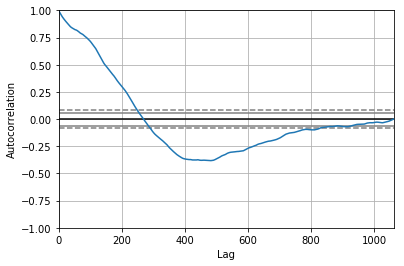

<Figure size 800x560 with 0 Axes>

Test MSE: 0.325


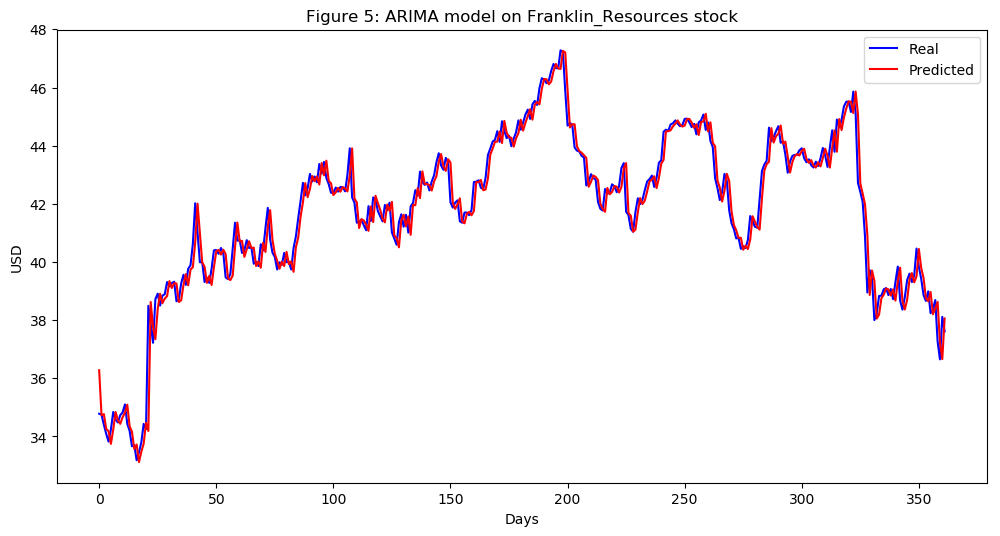

In [175]:
Franklin_Resources_series = SP500_TechIndicator['Franklin_Resources_Close']
Franklin_Resources_series_model = ARIMA(Franklin_Resources_series, order=(5, 1, 0))
Franklin_Resources_model_fit = Franklin_Resources_series_model.fit(disp=0)
print(Franklin_Resources_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Franklin_Resources_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Franklin_Resources_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Franklin_Resources_predictions = list()
for t in range(len(test)):
    Franklin_Resources_series_model = ARIMA(history, order=(5,1,0))
    Franklin_Resources_series_model_fit = Franklin_Resources_series_model.fit(disp=0)
    Franklin_Resources_output = Franklin_Resources_series_model_fit.forecast()
    yhat = Franklin_Resources_output[0]
    Franklin_Resources_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Franklin_Resources_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Franklin_Resources_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Franklin_Resources stock')
plt.legend()
plt.show()


#predictions
Franklin_Resources_predictions = pd.DataFrame({'Franklin_Resources_predictions':Franklin_Resources_predictions})
#Franklin_Resources_predictions.to_csv('Franklin_Resources_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.Goldman_Sachs_Group_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -2591.429
Method:                                css-mle   S.D. of innovations              2.783
Date:                         Sun, 17 Mar 2019   AIC                           5196.857
Time:                                 14:21:46   BIC                           5231.626
Sample:                                      1   HQIC                          5210.034
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0667      0.078      0.854      0.393      -0.086   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


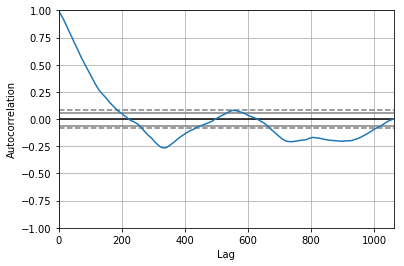

<Figure size 800x560 with 0 Axes>

Test MSE: 11.671


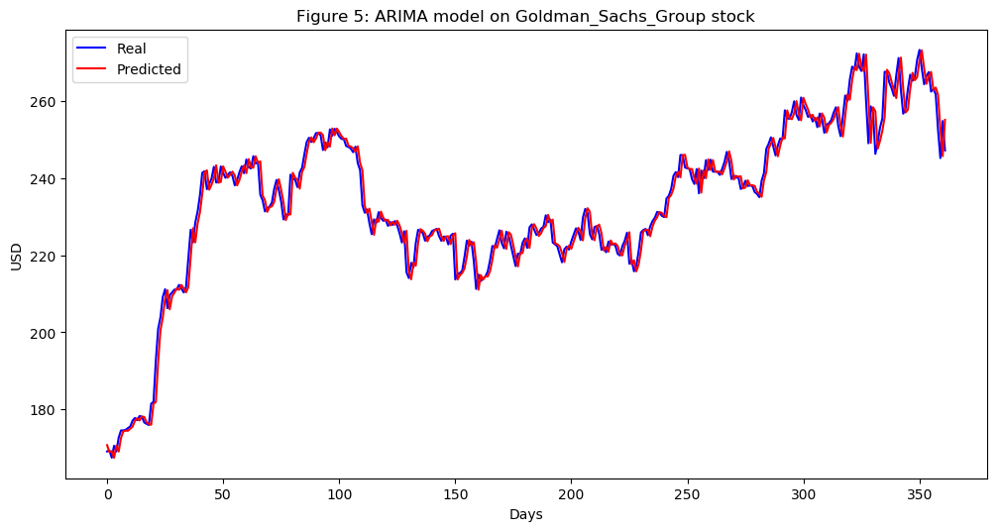

In [176]:
Goldman_Sachs_Group_series = SP500_TechIndicator['Goldman_Sachs_Group_Close']
Goldman_Sachs_Group_series_model = ARIMA(Goldman_Sachs_Group_series, order=(5, 1, 0))
Goldman_Sachs_Group_model_fit = Goldman_Sachs_Group_series_model.fit(disp=0)
print(Goldman_Sachs_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Goldman_Sachs_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Goldman_Sachs_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Goldman_Sachs_Group_predictions = list()
for t in range(len(test)):
    Goldman_Sachs_Group_series_model = ARIMA(history, order=(5,1,0))
    Goldman_Sachs_Group_series_model_fit = Goldman_Sachs_Group_series_model.fit(disp=0)
    Goldman_Sachs_Group_output = Goldman_Sachs_Group_series_model_fit.forecast()
    yhat = Goldman_Sachs_Group_output[0]
    Goldman_Sachs_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Goldman_Sachs_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Goldman_Sachs_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Goldman_Sachs_Group stock')
plt.legend()
plt.show()


#predictions
Goldman_Sachs_Group_predictions = pd.DataFrame({'Goldman_Sachs_Group_predictions':Goldman_Sachs_Group_predictions})
#Goldman_Sachs_Group_predictions.to_csv('Goldman_Sachs_Group_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Hartford_Financial_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood                -886.760
Method:                               css-mle   S.D. of innovations              0.558
Date:                        Sun, 17 Mar 2019   AIC                           1787.520
Time:                                14:22:51   BIC                           1822.288
Sample:                                     1   HQIC                          1800.696
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0143      0.014      1.028      0.304      -0.013       0.041
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


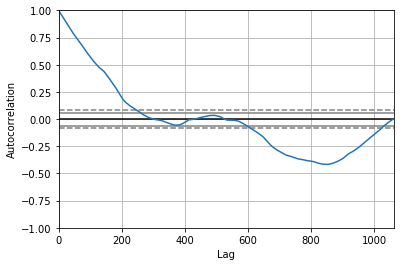

<Figure size 800x560 with 0 Axes>

Test MSE: 0.310


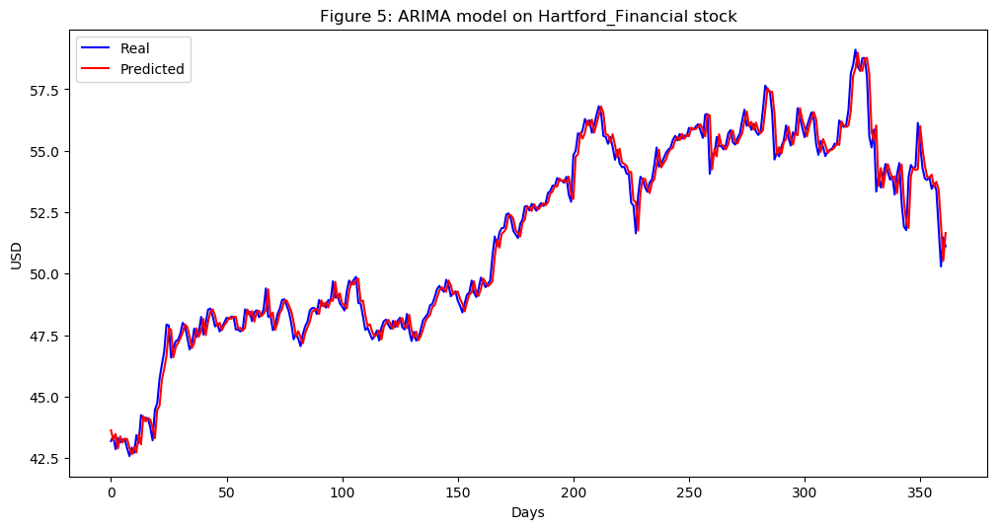

In [177]:
Hartford_Financial_series = SP500_TechIndicator['Hartford_Financial_Close']
Hartford_Financial_series_model = ARIMA(Hartford_Financial_series, order=(5, 1, 0))
Hartford_Financial_model_fit = Hartford_Financial_series_model.fit(disp=0)
print(Hartford_Financial_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Hartford_Financial_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Hartford_Financial_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Hartford_Financial_predictions = list()
for t in range(len(test)):
    Hartford_Financial_series_model = ARIMA(history, order=(5,1,0))
    Hartford_Financial_series_model_fit = Hartford_Financial_series_model.fit(disp=0)
    Hartford_Financial_output = Hartford_Financial_series_model_fit.forecast()
    yhat = Hartford_Financial_output[0]
    Hartford_Financial_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Hartford_Financial_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Hartford_Financial_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Hartford_Financial stock')
plt.legend()
plt.show()


#predictions
Hartford_Financial_predictions = pd.DataFrame({'Hartford_Financial_predictions':Hartford_Financial_predictions})
#Hartford_Financial_predictions.to_csv('Hartford_Financial_predictions.csv')



                                   ARIMA Model Results                                   
Dep. Variable:     D.Huntington_Bancshares_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood                 369.517
Method:                                  css-mle   S.D. of innovations              0.171
Date:                           Sun, 17 Mar 2019   AIC                           -725.035
Time:                                   14:24:03   BIC                           -690.266
Sample:                                        1   HQIC                          -711.858
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                   0.0050      0.005      1.000    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


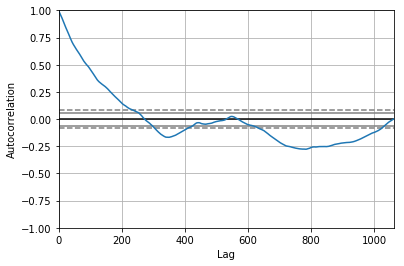

<Figure size 800x560 with 0 Axes>

Test MSE: 0.042


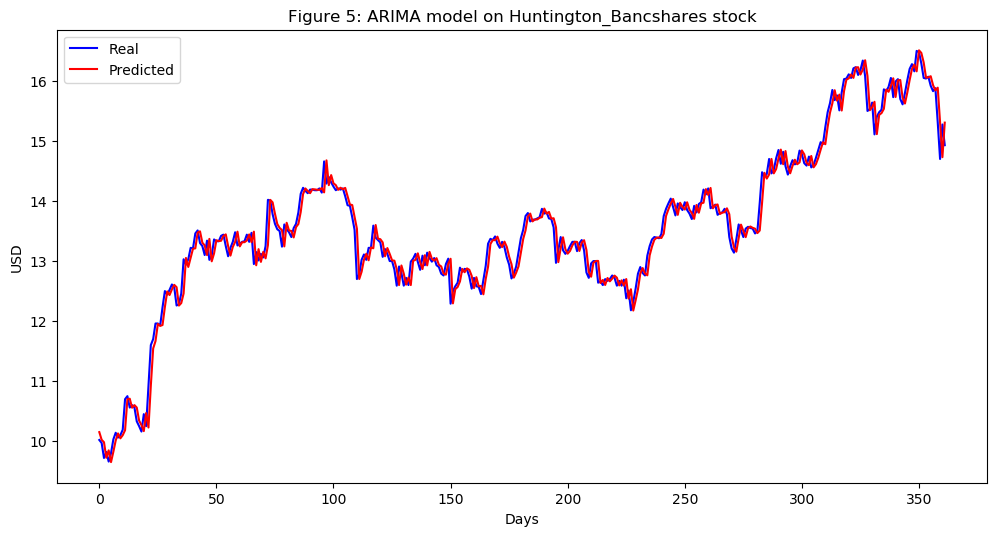

In [178]:
Huntington_Bancshares_series = SP500_TechIndicator['Huntington_Bancshares_Close']
Huntington_Bancshares_series_model = ARIMA(Huntington_Bancshares_series, order=(5, 1, 0))
Huntington_Bancshares_model_fit = Huntington_Bancshares_series_model.fit(disp=0)
print(Huntington_Bancshares_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Huntington_Bancshares_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Huntington_Bancshares_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Huntington_Bancshares_predictions = list()
for t in range(len(test)):
    Huntington_Bancshares_series_model = ARIMA(history, order=(5,1,0))
    Huntington_Bancshares_series_model_fit = Huntington_Bancshares_series_model.fit(disp=0)
    Huntington_Bancshares_output = Huntington_Bancshares_series_model_fit.forecast()
    yhat = Huntington_Bancshares_output[0]
    Huntington_Bancshares_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Huntington_Bancshares_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Huntington_Bancshares_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Huntington_Bancshares stock')
plt.legend()
plt.show()


#predictions
Huntington_Bancshares_predictions = pd.DataFrame({'Huntington_Bancshares_predictions':Huntington_Bancshares_predictions})
#Huntington_Bancshares_predictions.to_csv('Huntington_Bancshares_predictions.csv')



                                     ARIMA Model Results                                     
Dep. Variable:     D.Intercontinental_Exchange_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood               -3590.138
Method:                                      css-mle   S.D. of innovations              7.133
Date:                               Sun, 17 Mar 2019   AIC                           7194.277
Time:                                       14:25:03   BIC                           7229.046
Sample:                                            1   HQIC                          7207.453
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


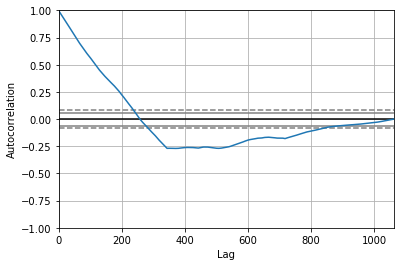

<Figure size 800x560 with 0 Axes>

Test MSE: 144.108


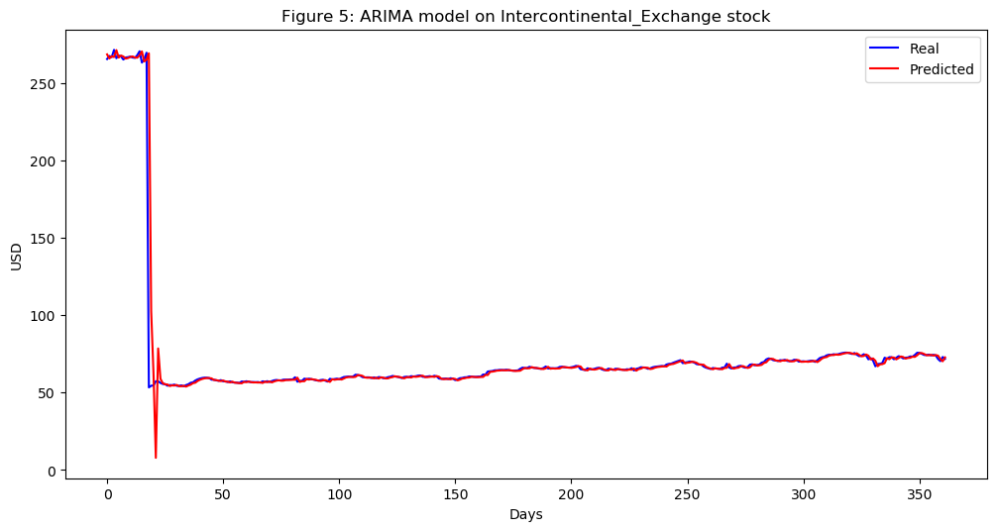

In [179]:
Intercontinental_Exchange_series = SP500_TechIndicator['Intercontinental_Exchange_Close']
Intercontinental_Exchange_series_model = ARIMA(Intercontinental_Exchange_series, order=(5, 1, 0))
Intercontinental_Exchange_model_fit = Intercontinental_Exchange_series_model.fit(disp=0)
print(Intercontinental_Exchange_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Intercontinental_Exchange_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Intercontinental_Exchange_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Intercontinental_Exchange_predictions = list()
for t in range(len(test)):
    Intercontinental_Exchange_series_model = ARIMA(history, order=(5,1,0))
    Intercontinental_Exchange_series_model_fit = Intercontinental_Exchange_series_model.fit(disp=0)
    Intercontinental_Exchange_output = Intercontinental_Exchange_series_model_fit.forecast()
    yhat = Intercontinental_Exchange_output[0]
    Intercontinental_Exchange_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Intercontinental_Exchange_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Intercontinental_Exchange_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Intercontinental_Exchange stock')
plt.legend()
plt.show()


#predictions
Intercontinental_Exchange_predictions = pd.DataFrame({'Intercontinental_Exchange_predictions':Intercontinental_Exchange_predictions})
#Intercontinental_Exchange_predictions.to_csv('Intercontinental_Exchange_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Invesco_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -820.381
Method:                       css-mle   S.D. of innovations              0.524
Date:                Sun, 17 Mar 2019   AIC                           1654.761
Time:                        14:26:12   BIC                           1689.530
Sample:                             1   HQIC                          1667.938
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.0048      0.016     -0.291      0.771      -0.037       0.027
ar.L1.D.Invesco_Close     0.0172      0.031      0.559      0.576      -0.043       0.077
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


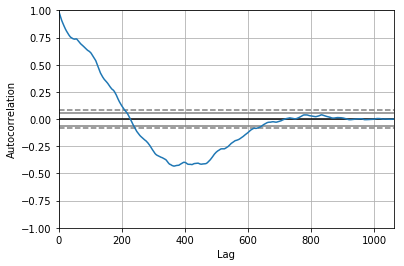

<Figure size 800x560 with 0 Axes>

Test MSE: 0.221


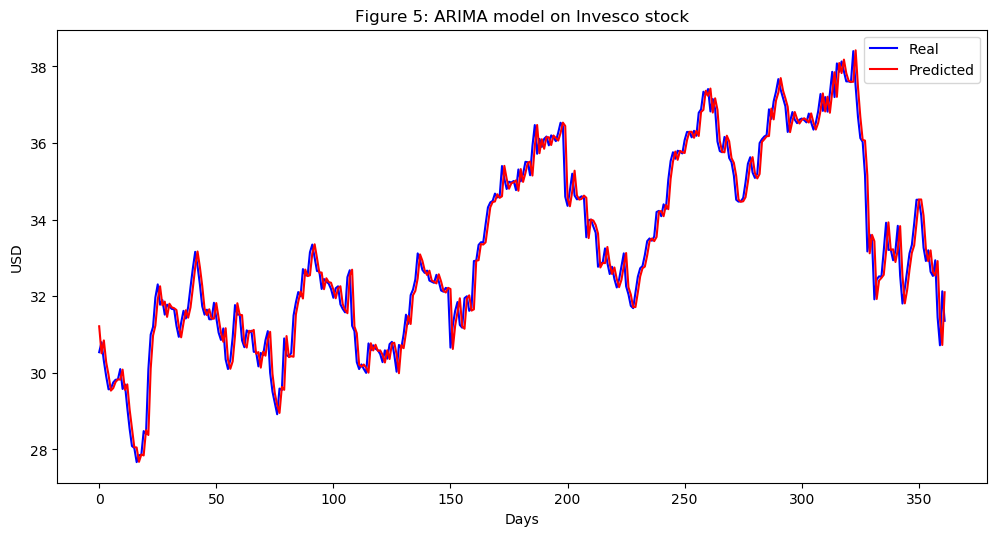

In [180]:
Invesco_series = SP500_TechIndicator['Invesco_Close']
Invesco_series_model = ARIMA(Invesco_series, order=(5, 1, 0))
Invesco_model_fit = Invesco_series_model.fit(disp=0)
print(Invesco_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Invesco_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Invesco_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Invesco_predictions = list()
for t in range(len(test)):
    Invesco_series_model = ARIMA(history, order=(5,1,0))
    Invesco_series_model_fit = Invesco_series_model.fit(disp=0)
    Invesco_output = Invesco_series_model_fit.forecast()
    yhat = Invesco_output[0]
    Invesco_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Invesco_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Invesco_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Invesco stock')
plt.legend()
plt.show()


#predictions
Invesco_predictions = pd.DataFrame({'Invesco_predictions':Invesco_predictions})
#Invesco_predictions.to_csv('Invesco_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.JPMorgan_Chase_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1443.440
Method:                           css-mle   S.D. of innovations              0.943
Date:                    Sun, 17 Mar 2019   AIC                           2900.880
Time:                            14:27:28   BIC                           2935.649
Sample:                                 1   HQIC                          2914.057
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0471      0.027      1.759      0.079      -0.005       0.100
ar.L1.D.JPMorgan_Chase_Close     0.0128      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


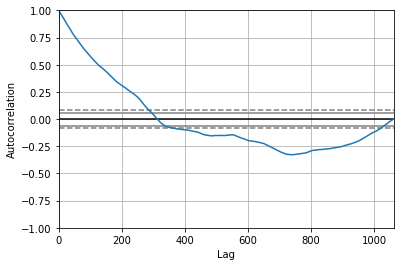

<Figure size 800x560 with 0 Axes>

Test MSE: 1.302


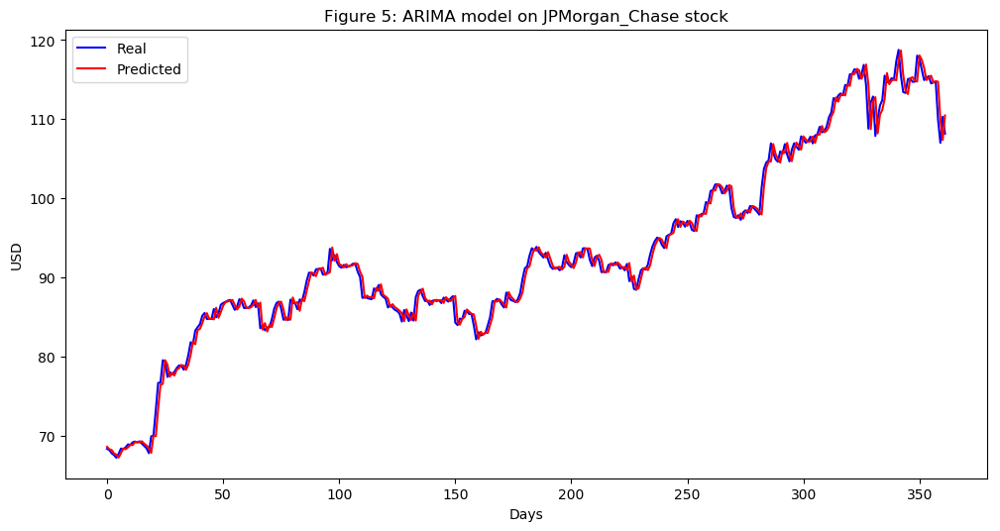

In [181]:
JPMorgan_Chase_series = SP500_TechIndicator['JPMorgan_Chase_Close']
JPMorgan_Chase_series_model = ARIMA(JPMorgan_Chase_series, order=(5, 1, 0))
JPMorgan_Chase_model_fit = JPMorgan_Chase_series_model.fit(disp=0)
print(JPMorgan_Chase_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(JPMorgan_Chase_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = JPMorgan_Chase_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
JPMorgan_Chase_predictions = list()
for t in range(len(test)):
    JPMorgan_Chase_series_model = ARIMA(history, order=(5,1,0))
    JPMorgan_Chase_series_model_fit = JPMorgan_Chase_series_model.fit(disp=0)
    JPMorgan_Chase_output = JPMorgan_Chase_series_model_fit.forecast()
    yhat = JPMorgan_Chase_output[0]
    JPMorgan_Chase_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, JPMorgan_Chase_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(JPMorgan_Chase_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on JPMorgan_Chase stock')
plt.legend()
plt.show()


#predictions
JPMorgan_Chase_predictions = pd.DataFrame({'JPMorgan_Chase_predictions':JPMorgan_Chase_predictions})
#JPMorgan_Chase_predictions.to_csv('JPMorgan_Chase_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.KeyCorp_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                  26.104
Method:                       css-mle   S.D. of innovations              0.236
Date:                Sun, 17 Mar 2019   AIC                            -38.209
Time:                        14:28:23   BIC                             -3.440
Sample:                             1   HQIC                           -25.032
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0056      0.006      0.875      0.382      -0.007       0.018
ar.L1.D.KeyCorp_Close    -0.0150      0.031     -0.489      0.625      -0.075       0.045
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


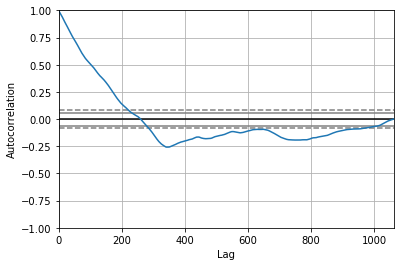

<Figure size 800x560 with 0 Axes>

Test MSE: 0.082


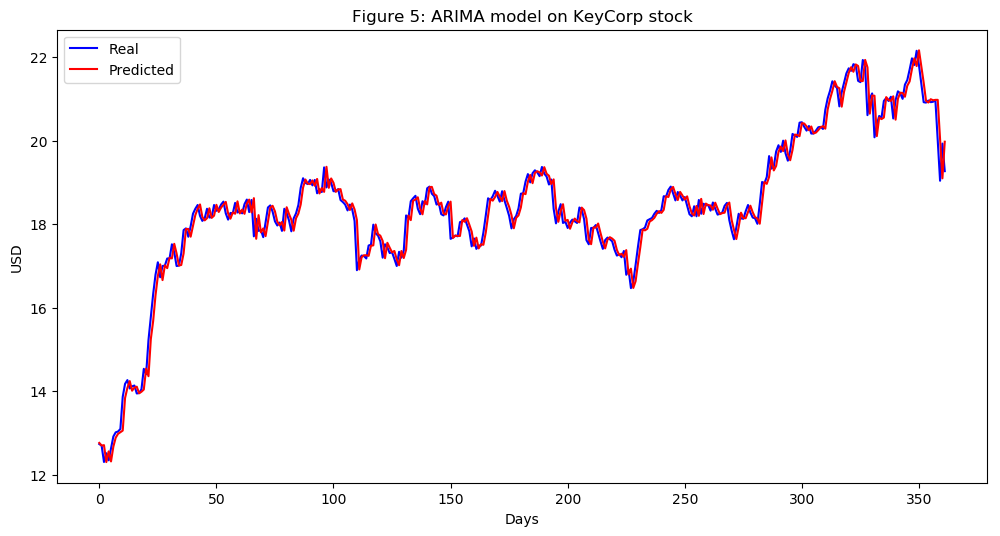

In [182]:
KeyCorp_series = SP500_TechIndicator['KeyCorp_Close']
KeyCorp_series_model = ARIMA(KeyCorp_series, order=(5, 1, 0))
KeyCorp_model_fit = KeyCorp_series_model.fit(disp=0)
print(KeyCorp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(KeyCorp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = KeyCorp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
KeyCorp_predictions = list()
for t in range(len(test)):
    KeyCorp_series_model = ARIMA(history, order=(5,1,0))
    KeyCorp_series_model_fit = KeyCorp_series_model.fit(disp=0)
    KeyCorp_output = KeyCorp_series_model_fit.forecast()
    yhat = KeyCorp_output[0]
    KeyCorp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, KeyCorp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(KeyCorp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on KeyCorp stock')
plt.legend()
plt.show()


#predictions
KeyCorp_predictions = pd.DataFrame({'KeyCorp_predictions':KeyCorp_predictions})
#KeyCorp_predictions.to_csv('KeyCorp_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Lincoln_National_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -1455.153
Method:                             css-mle   S.D. of innovations              0.954
Date:                      Sun, 17 Mar 2019   AIC                           2924.306
Time:                              14:29:35   BIC                           2959.075
Sample:                                   1   HQIC                          2937.482
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0192      0.029      0.653      0.514      -0.039       0.077
ar.L1.D.Lincoln_Nationa

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


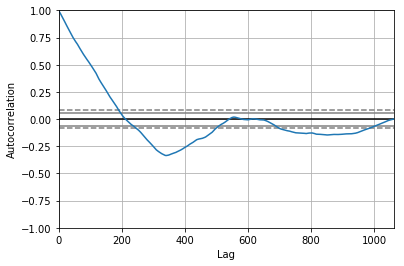

<Figure size 800x560 with 0 Axes>

Test MSE: 1.161


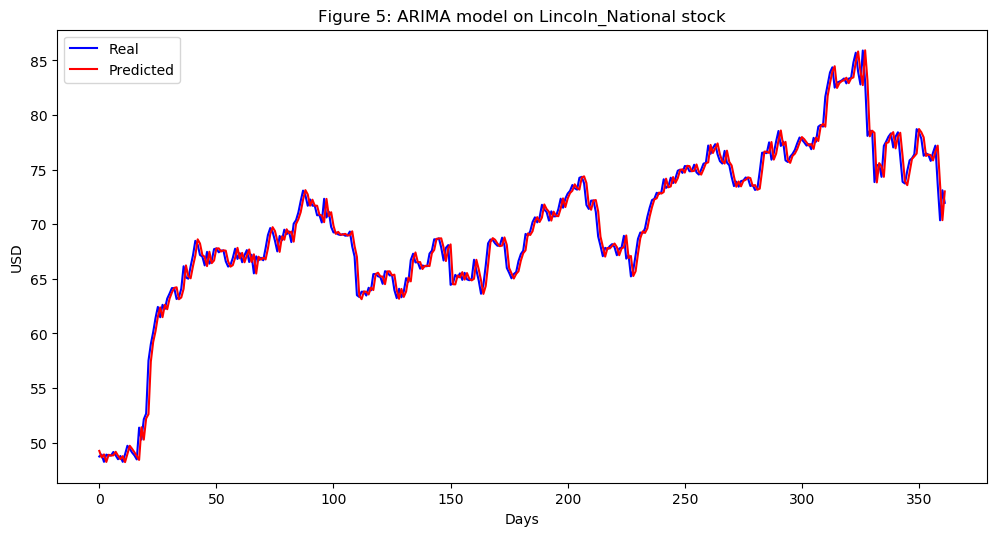

In [183]:
Lincoln_National_series = SP500_TechIndicator['Lincoln_National_Close']
Lincoln_National_series_model = ARIMA(Lincoln_National_series, order=(5, 1, 0))
Lincoln_National_model_fit = Lincoln_National_series_model.fit(disp=0)
print(Lincoln_National_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Lincoln_National_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Lincoln_National_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Lincoln_National_predictions = list()
for t in range(len(test)):
    Lincoln_National_series_model = ARIMA(history, order=(5,1,0))
    Lincoln_National_series_model_fit = Lincoln_National_series_model.fit(disp=0)
    Lincoln_National_output = Lincoln_National_series_model_fit.forecast()
    yhat = Lincoln_National_output[0]
    Lincoln_National_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Lincoln_National_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Lincoln_National_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Lincoln_National stock')
plt.legend()
plt.show()


#predictions
Lincoln_National_predictions = pd.DataFrame({'Lincoln_National_predictions':Lincoln_National_predictions})
#Lincoln_National_predictions.to_csv('Lincoln_National_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Loews_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -596.207
Method:                       css-mle   S.D. of innovations              0.424
Date:                Sun, 17 Mar 2019   AIC                           1206.415
Time:                        14:31:01   BIC                           1241.184
Sample:                             1   HQIC                          1219.591
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0011      0.012      0.088      0.930      -0.022       0.025
ar.L1.D.Loews_Close    -0.0003      0.031     -0.009      0.993      -0.061       0.060
ar.L2.D.Loews_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


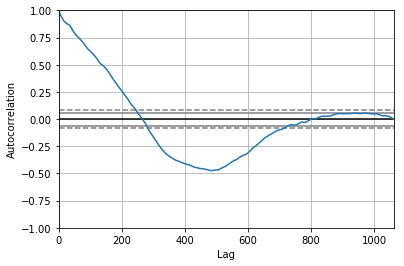

<Figure size 800x560 with 0 Axes>

Test MSE: 0.199


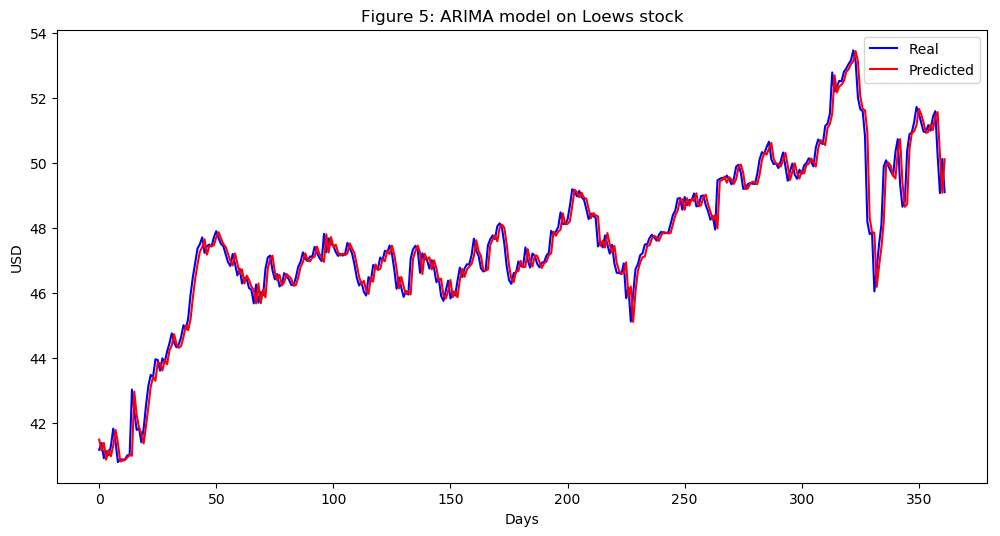

In [184]:
Loews_series = SP500_TechIndicator['Loews_Close']
Loews_series_model = ARIMA(Loews_series, order=(5, 1, 0))
Loews_model_fit = Loews_series_model.fit(disp=0)
print(Loews_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Loews_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Loews_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Loews_predictions = list()
for t in range(len(test)):
    Loews_series_model = ARIMA(history, order=(5,1,0))
    Loews_series_model_fit = Loews_series_model.fit(disp=0)
    Loews_output = Loews_series_model_fit.forecast()
    yhat = Loews_output[0]
    Loews_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Loews_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Loews_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Loews stock')
plt.legend()
plt.show()


#predictions
Loews_predictions = pd.DataFrame({'Loews_predictions':Loews_predictions})
#Loews_predictions.to_csv('Loews_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.MT_Bank_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2084.785
Method:                       css-mle   S.D. of innovations              1.726
Date:                Sun, 17 Mar 2019   AIC                           4183.570
Time:                        14:32:36   BIC                           4218.339
Sample:                             1   HQIC                          4196.747
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0604      0.048      1.249      0.212      -0.034       0.155
ar.L1.D.MT_Bank_Close    -0.0004      0.031     -0.011      0.991      -0.061       0.060
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


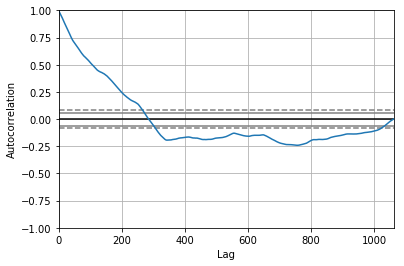

<Figure size 800x560 with 0 Axes>

Test MSE: 4.241


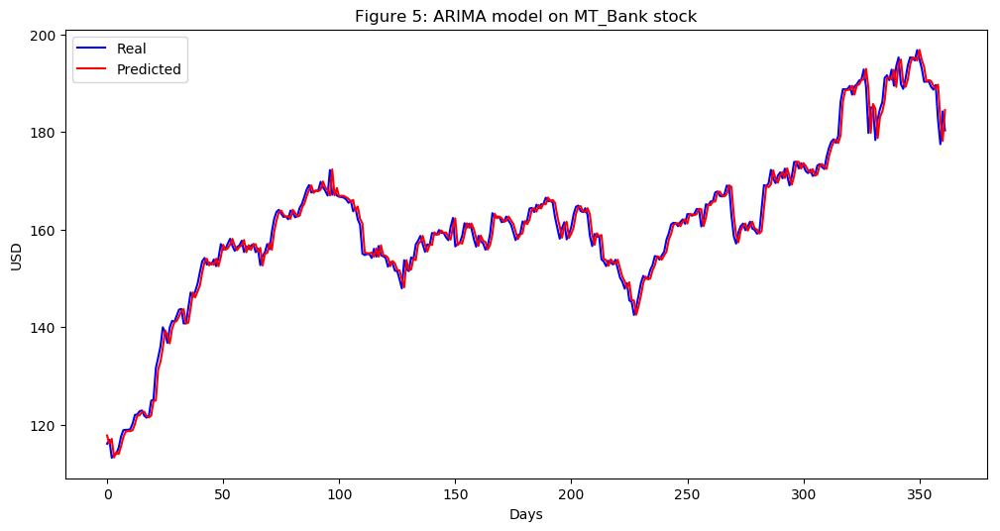

In [185]:
MT_Bank_series = SP500_TechIndicator['MT_Bank_Close']
MT_Bank_series_model = ARIMA(MT_Bank_series, order=(5, 1, 0))
MT_Bank_model_fit = MT_Bank_series_model.fit(disp=0)
print(MT_Bank_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(MT_Bank_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = MT_Bank_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
MT_Bank_predictions = list()
for t in range(len(test)):
    MT_Bank_series_model = ARIMA(history, order=(5,1,0))
    MT_Bank_series_model_fit = MT_Bank_series_model.fit(disp=0)
    MT_Bank_output = MT_Bank_series_model_fit.forecast()
    yhat = MT_Bank_output[0]
    MT_Bank_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, MT_Bank_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(MT_Bank_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on MT_Bank stock')
plt.legend()
plt.show()


#predictions
MT_Bank_predictions = pd.DataFrame({'MT_Bank_predictions':MT_Bank_predictions})
#MT_Bank_predictions.to_csv('MT_Bank_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.Marsh_McLennan_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood                -966.426
Method:                           css-mle   S.D. of innovations              0.602
Date:                    Sun, 17 Mar 2019   AIC                           1946.853
Time:                            14:33:24   BIC                           1981.621
Sample:                                 1   HQIC                          1960.029
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0313      0.016      1.954      0.051   -9.12e-05       0.063
ar.L1.D.Marsh_McLennan_Close    -0.0332      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


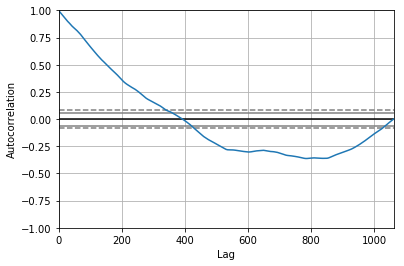

<Figure size 800x560 with 0 Axes>

Test MSE: 0.490


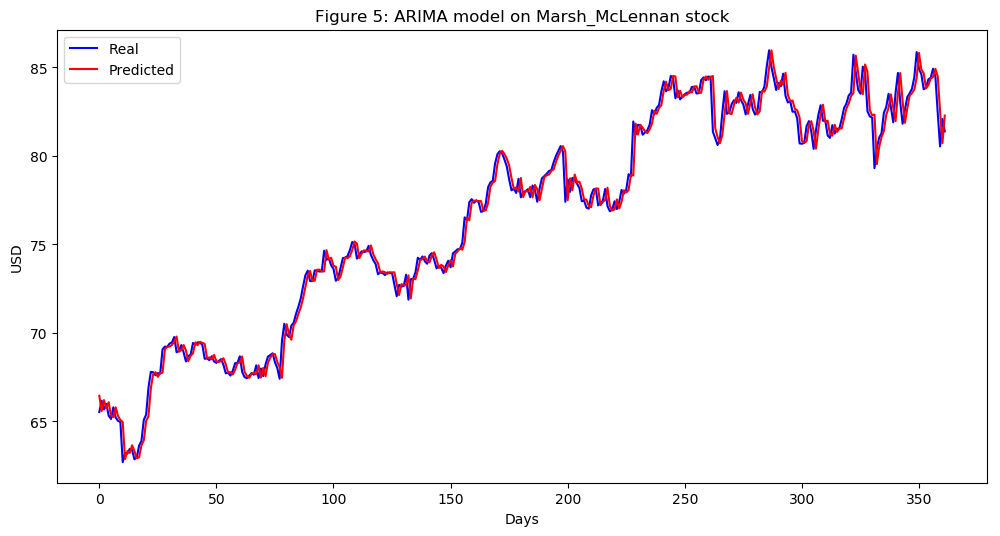

In [186]:
Marsh_McLennan_series = SP500_TechIndicator['Marsh_McLennan_Close']
Marsh_McLennan_series_model = ARIMA(Marsh_McLennan_series, order=(5, 1, 0))
Marsh_McLennan_model_fit = Marsh_McLennan_series_model.fit(disp=0)
print(Marsh_McLennan_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Marsh_McLennan_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Marsh_McLennan_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Marsh_McLennan_predictions = list()
for t in range(len(test)):
    Marsh_McLennan_series_model = ARIMA(history, order=(5,1,0))
    Marsh_McLennan_series_model_fit = Marsh_McLennan_series_model.fit(disp=0)
    Marsh_McLennan_output = Marsh_McLennan_series_model_fit.forecast()
    yhat = Marsh_McLennan_output[0]
    Marsh_McLennan_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Marsh_McLennan_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Marsh_McLennan_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Marsh_McLennan stock')
plt.legend()
plt.show()


#predictions
Marsh_McLennan_predictions = pd.DataFrame({'Marsh_McLennan_predictions':Marsh_McLennan_predictions})
#Marsh_McLennan_predictions.to_csv('Marsh_McLennan_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Moodys_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1846.523
Method:                       css-mle   S.D. of innovations              1.379
Date:                Sun, 17 Mar 2019   AIC                           3707.046
Time:                        14:35:06   BIC                           3741.814
Sample:                             1   HQIC                          3720.222
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0768      0.039      1.954      0.051      -0.000       0.154
ar.L1.D.Moodys_Close     0.0030      0.031      0.097      0.922      -0.057       0.063
ar.L2.D.Mood

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


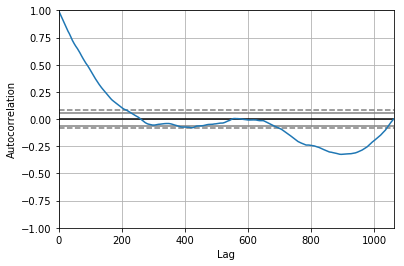

<Figure size 800x560 with 0 Axes>

Test MSE: 2.259


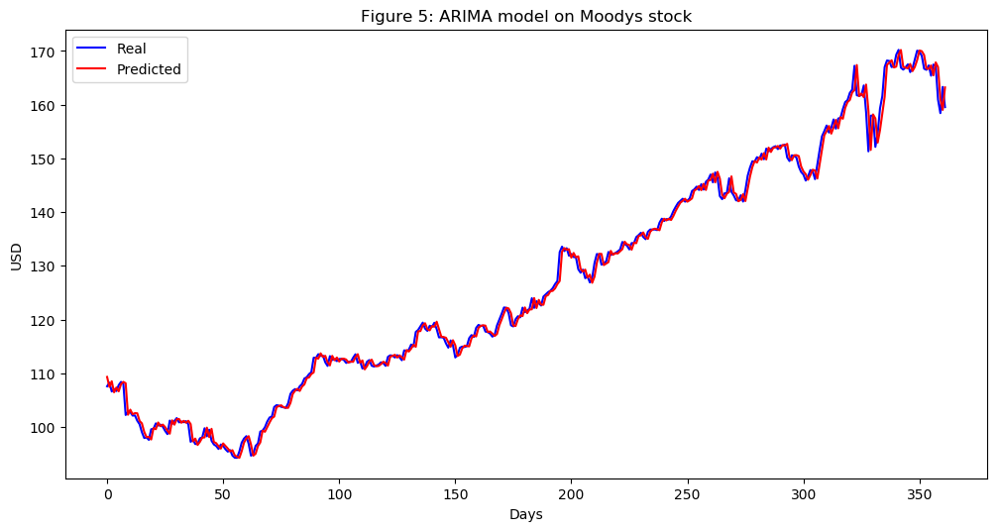

In [187]:
Moodys_series = SP500_TechIndicator['Moodys_Close']
Moodys_series_model = ARIMA(Moodys_series, order=(5, 1, 0))
Moodys_model_fit = Moodys_series_model.fit(disp=0)
print(Moodys_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Moodys_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Moodys_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Moodys_predictions = list()
for t in range(len(test)):
    Moodys_series_model = ARIMA(history, order=(5,1,0))
    Moodys_series_model_fit = Moodys_series_model.fit(disp=0)
    Moodys_output = Moodys_series_model_fit.forecast()
    yhat = Moodys_output[0]
    Moodys_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Moodys_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Moodys_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Moodys stock')
plt.legend()
plt.show()


#predictions
Moodys_predictions = pd.DataFrame({'Moodys_predictions':Moodys_predictions})
#Moodys_predictions.to_csv('Moodys_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.Morgan_Stanley_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood                -944.210
Method:                           css-mle   S.D. of innovations              0.589
Date:                    Sun, 17 Mar 2019   AIC                           1902.421
Time:                            14:36:09   BIC                           1937.190
Sample:                                 1   HQIC                          1915.597
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0206      0.017      1.216      0.224      -0.013       0.054
ar.L1.D.Morgan_Stanley_Close     0.0213      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


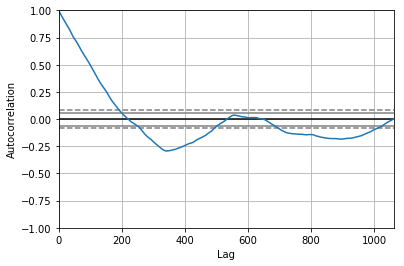

<Figure size 800x560 with 0 Axes>

Test MSE: 0.494


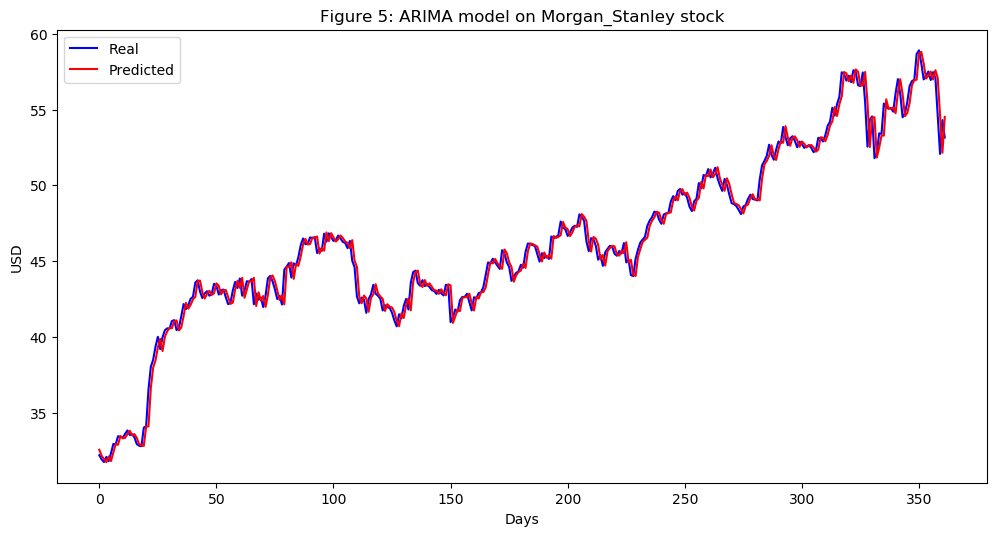

In [188]:
Morgan_Stanley_series = SP500_TechIndicator['Morgan_Stanley_Close']
Morgan_Stanley_series_model = ARIMA(Morgan_Stanley_series, order=(5, 1, 0))
Morgan_Stanley_model_fit = Morgan_Stanley_series_model.fit(disp=0)
print(Morgan_Stanley_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Morgan_Stanley_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Morgan_Stanley_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Morgan_Stanley_predictions = list()
for t in range(len(test)):
    Morgan_Stanley_series_model = ARIMA(history, order=(5,1,0))
    Morgan_Stanley_series_model_fit = Morgan_Stanley_series_model.fit(disp=0)
    Morgan_Stanley_output = Morgan_Stanley_series_model_fit.forecast()
    yhat = Morgan_Stanley_output[0]
    Morgan_Stanley_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Morgan_Stanley_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Morgan_Stanley_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Morgan_Stanley stock')
plt.legend()
plt.show()


#predictions
Morgan_Stanley_predictions = pd.DataFrame({'Morgan_Stanley_predictions':Morgan_Stanley_predictions})
#Morgan_Stanley_predictions.to_csv('Morgan_Stanley_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:           D.MSCI_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1603.690
Method:                       css-mle   S.D. of innovations              1.097
Date:                Sun, 17 Mar 2019   AIC                           3221.381
Time:                        14:37:19   BIC                           3256.149
Sample:                             1   HQIC                          3234.557
                                                                              
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.1046      0.028      3.782      0.000       0.050       0.159
ar.L1.D.MSCI_Close    -0.0551      0.031     -1.779      0.075      -0.116       0.006
ar.L2.D.MSCI_Close  

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


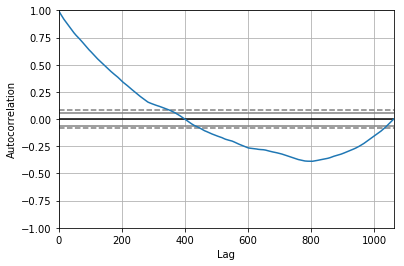

<Figure size 800x560 with 0 Axes>

Test MSE: 2.430


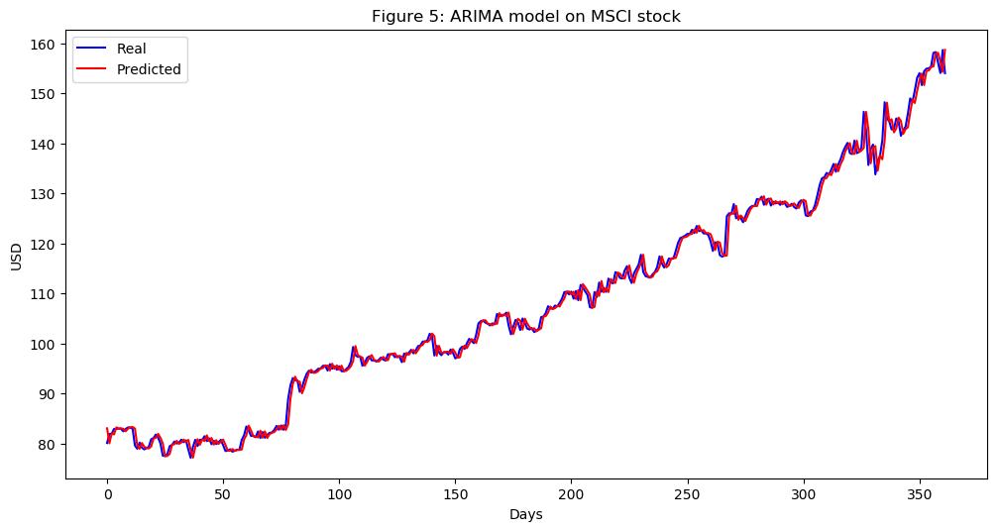

In [189]:
MSCI_series = SP500_TechIndicator['MSCI_Close']
MSCI_series_model = ARIMA(MSCI_series, order=(5, 1, 0))
MSCI_model_fit = MSCI_series_model.fit(disp=0)
print(MSCI_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(MSCI_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = MSCI_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
MSCI_predictions = list()
for t in range(len(test)):
    MSCI_series_model = ARIMA(history, order=(5,1,0))
    MSCI_series_model_fit = MSCI_series_model.fit(disp=0)
    MSCI_output = MSCI_series_model_fit.forecast()
    yhat = MSCI_output[0]
    MSCI_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, MSCI_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(MSCI_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on MSCI stock')
plt.legend()
plt.show()


#predictions
MSCI_predictions = pd.DataFrame({'MSCI_predictions':MSCI_predictions})
#MSCI_predictions.to_csv('MSCI_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Nasdaq_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1093.610
Method:                       css-mle   S.D. of innovations              0.678
Date:                Sun, 17 Mar 2019   AIC                           2201.219
Time:                        14:38:38   BIC                           2235.988
Sample:                             1   HQIC                          2214.396
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0397      0.020      2.028      0.043       0.001       0.078
ar.L1.D.Nasdaq_Close    -0.0274      0.031     -0.890      0.373      -0.088       0.033
ar.L2.D.Nasd

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


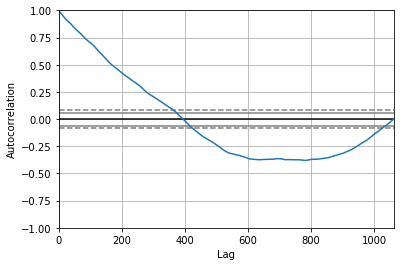

<Figure size 800x560 with 0 Axes>

Test MSE: 0.527


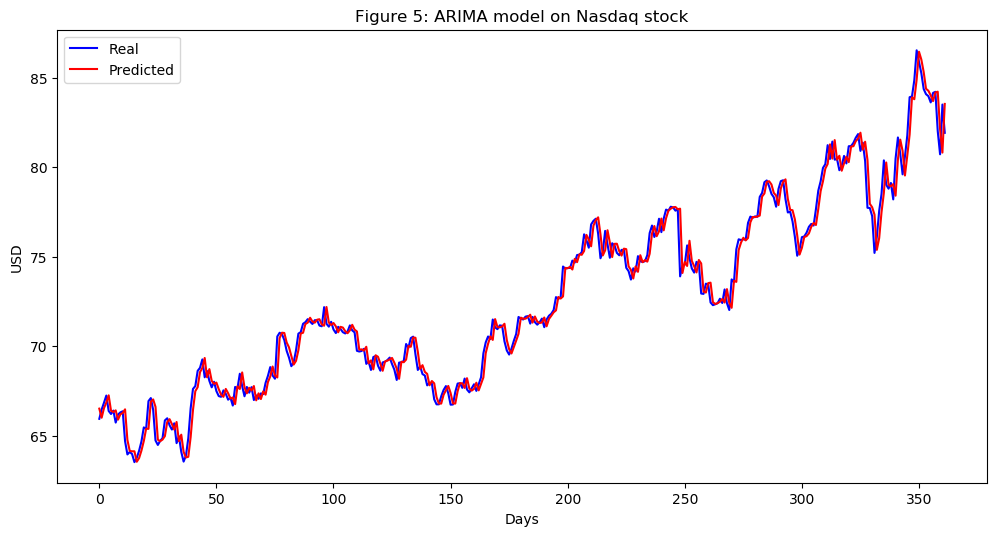

In [190]:
Nasdaq_series = SP500_TechIndicator['Nasdaq_Close']
Nasdaq_series_model = ARIMA(Nasdaq_series, order=(5, 1, 0))
Nasdaq_model_fit = Nasdaq_series_model.fit(disp=0)
print(Nasdaq_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Nasdaq_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Nasdaq_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Nasdaq_predictions = list()
for t in range(len(test)):
    Nasdaq_series_model = ARIMA(history, order=(5,1,0))
    Nasdaq_series_model_fit = Nasdaq_series_model.fit(disp=0)
    Nasdaq_output = Nasdaq_series_model_fit.forecast()
    yhat = Nasdaq_output[0]
    Nasdaq_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Nasdaq_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Nasdaq_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Nasdaq stock')
plt.legend()
plt.show()


#predictions
Nasdaq_predictions = pd.DataFrame({'Nasdaq_predictions':Nasdaq_predictions})
#Nasdaq_predictions.to_csv('Nasdaq_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.Northern_Trust_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1571.977
Method:                           css-mle   S.D. of innovations              1.065
Date:                    Sun, 17 Mar 2019   AIC                           3157.954
Time:                            14:39:54   BIC                           3192.722
Sample:                                 1   HQIC                          3171.130
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0375      0.030      1.246      0.213      -0.021       0.096
ar.L1.D.Northern_Trust_Close     0.0390      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


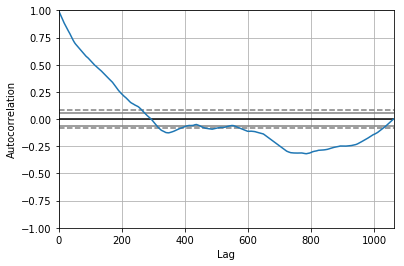

<Figure size 800x560 with 0 Axes>

Test MSE: 1.544


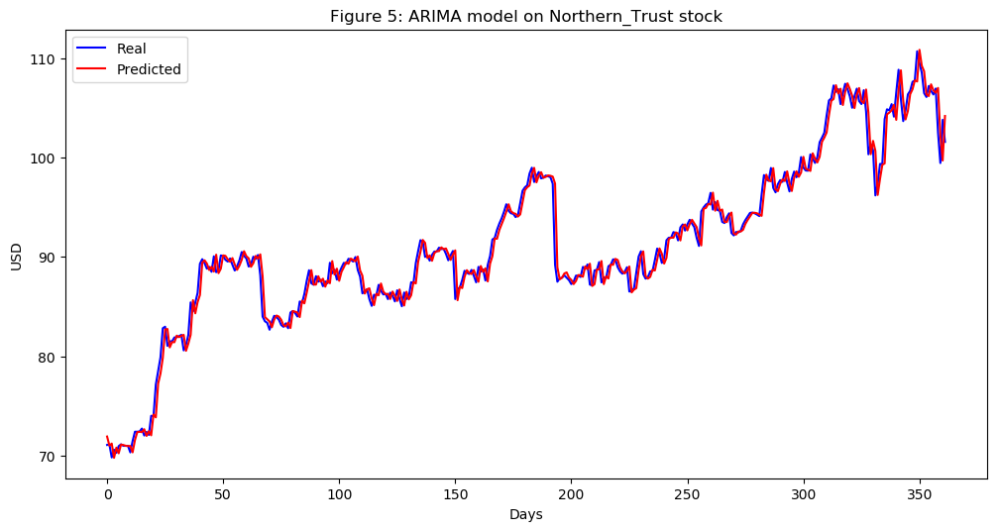

In [191]:
Northern_Trust_series = SP500_TechIndicator['Northern_Trust_Close']
Northern_Trust_series_model = ARIMA(Northern_Trust_series, order=(5, 1, 0))
Northern_Trust_model_fit = Northern_Trust_series_model.fit(disp=0)
print(Northern_Trust_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Northern_Trust_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Northern_Trust_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Northern_Trust_predictions = list()
for t in range(len(test)):
    Northern_Trust_series_model = ARIMA(history, order=(5,1,0))
    Northern_Trust_series_model_fit = Northern_Trust_series_model.fit(disp=0)
    Northern_Trust_output = Northern_Trust_series_model_fit.forecast()
    yhat = Northern_Trust_output[0]
    Northern_Trust_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Northern_Trust_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Northern_Trust_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Northern_Trust stock')
plt.legend()
plt.show()


#predictions
Northern_Trust_predictions = pd.DataFrame({'Northern_Trust_predictions':Northern_Trust_predictions})
#Northern_Trust_predictions.to_csv('Northern_Trust_predictions.csv')



                                    ARIMA Model Results                                     
Dep. Variable:     D.Peoples_United_Financial_Close   No. Observations:                 1061
Model:                               ARIMA(5, 1, 0)   Log Likelihood                 240.030
Method:                                     css-mle   S.D. of innovations              0.193
Date:                              Sun, 17 Mar 2019   AIC                           -466.059
Time:                                      14:40:50   BIC                           -431.290
Sample:                                           1   HQIC                          -452.883
                                                                                            
                                             coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------------
const                                     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


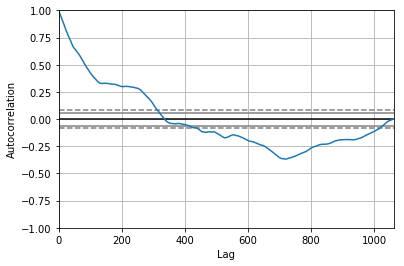

<Figure size 800x560 with 0 Axes>

Test MSE: 0.050


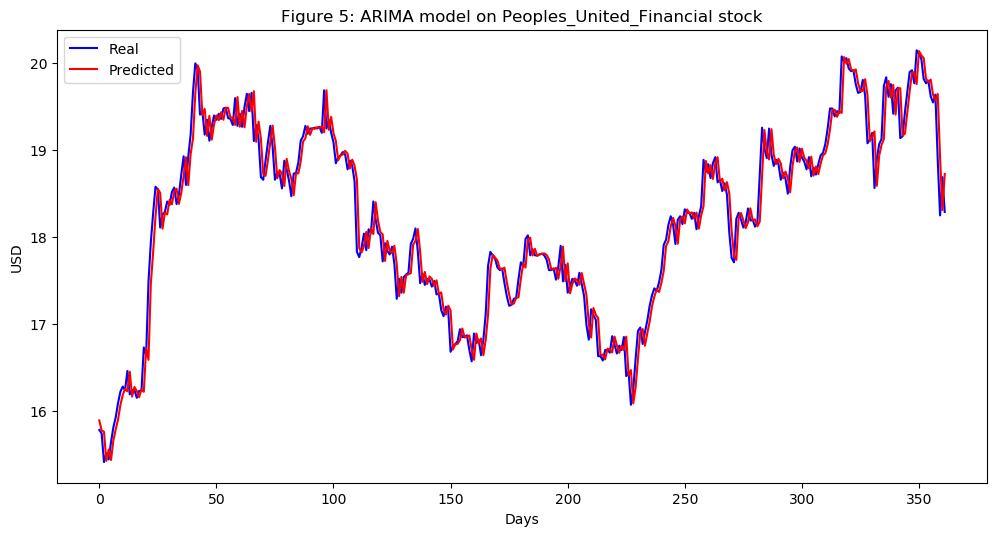

In [192]:
Peoples_United_Financial_series = SP500_TechIndicator['Peoples_United_Financial_Close']
Peoples_United_Financial_series_model = ARIMA(Peoples_United_Financial_series, order=(5, 1, 0))
Peoples_United_Financial_model_fit = Peoples_United_Financial_series_model.fit(disp=0)
print(Peoples_United_Financial_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Peoples_United_Financial_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Peoples_United_Financial_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Peoples_United_Financial_predictions = list()
for t in range(len(test)):
    Peoples_United_Financial_series_model = ARIMA(history, order=(5,1,0))
    Peoples_United_Financial_series_model_fit = Peoples_United_Financial_series_model.fit(disp=0)
    Peoples_United_Financial_output = Peoples_United_Financial_series_model_fit.forecast()
    yhat = Peoples_United_Financial_output[0]
    Peoples_United_Financial_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Peoples_United_Financial_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Peoples_United_Financial_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Peoples_United_Financial stock')
plt.legend()
plt.show()


#predictions
Peoples_United_Financial_predictions = pd.DataFrame({'Peoples_United_Financial_predictions':Peoples_United_Financial_predictions})
#Peoples_United_Financial_predictions.to_csv('Peoples_United_Financial_predictions.csv')



                                   ARIMA Model Results                                    
Dep. Variable:     D.PNC_Financial_Services_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -1791.652
Method:                                   css-mle   S.D. of innovations              1.310
Date:                            Sun, 17 Mar 2019   AIC                           3597.303
Time:                                    14:41:51   BIC                           3632.072
Sample:                                         1   HQIC                          3610.480
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0681      0.036    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


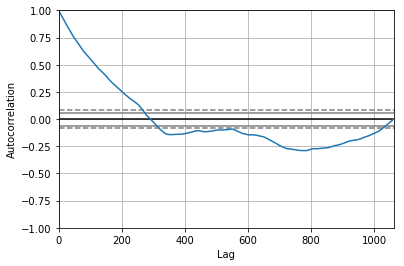

<Figure size 800x560 with 0 Axes>

Test MSE: 2.702


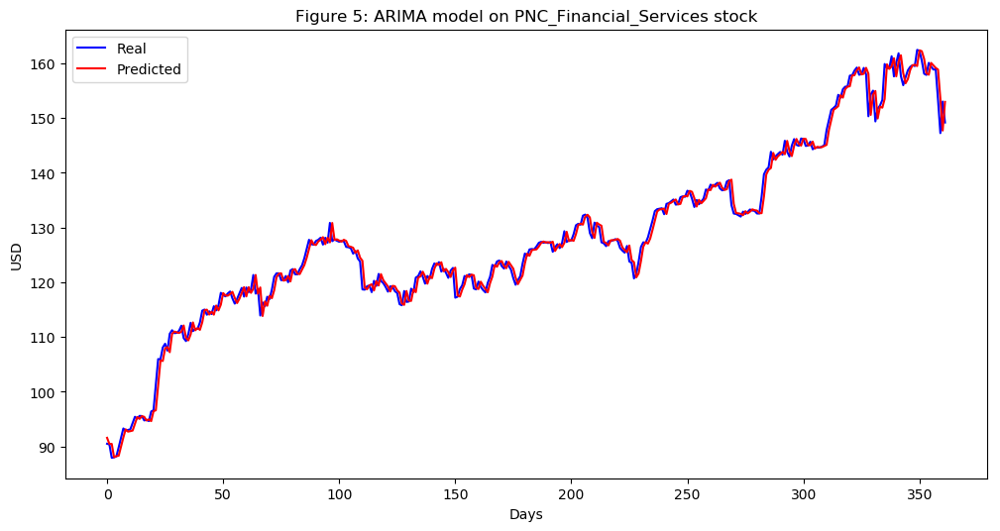

In [193]:
PNC_Financial_Services_series = SP500_TechIndicator['PNC_Financial_Services_Close']
PNC_Financial_Services_series_model = ARIMA(PNC_Financial_Services_series, order=(5, 1, 0))
PNC_Financial_Services_model_fit = PNC_Financial_Services_series_model.fit(disp=0)
print(PNC_Financial_Services_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(PNC_Financial_Services_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = PNC_Financial_Services_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
PNC_Financial_Services_predictions = list()
for t in range(len(test)):
    PNC_Financial_Services_series_model = ARIMA(history, order=(5,1,0))
    PNC_Financial_Services_series_model_fit = PNC_Financial_Services_series_model.fit(disp=0)
    PNC_Financial_Services_output = PNC_Financial_Services_series_model_fit.forecast()
    yhat = PNC_Financial_Services_output[0]
    PNC_Financial_Services_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, PNC_Financial_Services_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(PNC_Financial_Services_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on PNC_Financial_Services stock')
plt.legend()
plt.show()


#predictions
PNC_Financial_Services_predictions = pd.DataFrame({'PNC_Financial_Services_predictions':PNC_Financial_Services_predictions})
#PNC_Financial_Services_predictions.to_csv('PNC_Financial_Services_predictions.csv')



                                     ARIMA Model Results                                     
Dep. Variable:     D.Principal_Financial_Group_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood               -1213.985
Method:                                      css-mle   S.D. of innovations              0.760
Date:                               Sun, 17 Mar 2019   AIC                           2441.969
Time:                                       14:42:40   BIC                           2476.738
Sample:                                            1   HQIC                          2455.146
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


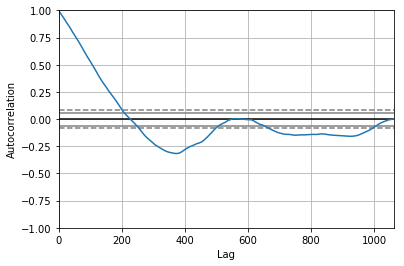

<Figure size 800x560 with 0 Axes>

Test MSE: 0.620


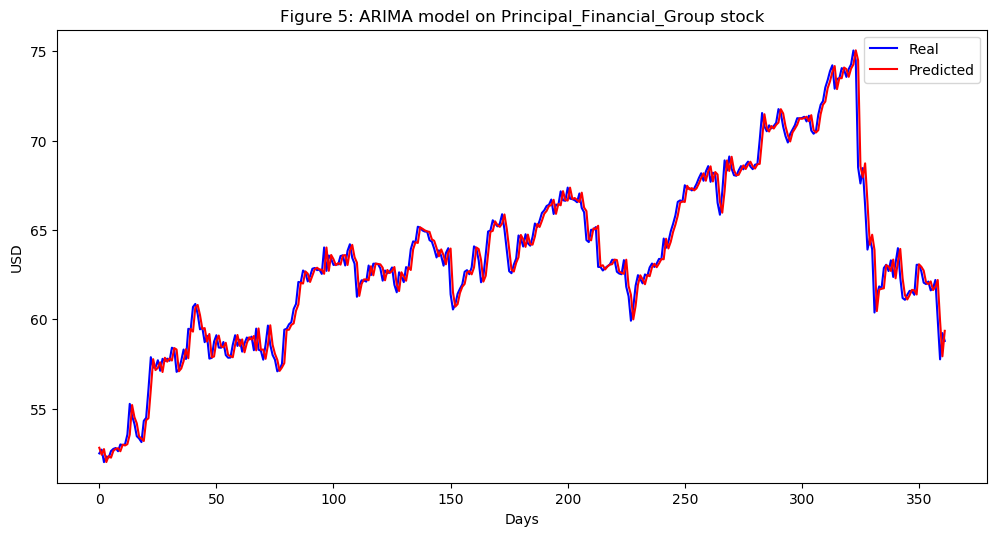

In [194]:
Principal_Financial_Group_series = SP500_TechIndicator['Principal_Financial_Group_Close']
Principal_Financial_Group_series_model = ARIMA(Principal_Financial_Group_series, order=(5, 1, 0))
Principal_Financial_Group_model_fit = Principal_Financial_Group_series_model.fit(disp=0)
print(Principal_Financial_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Principal_Financial_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Principal_Financial_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Principal_Financial_Group_predictions = list()
for t in range(len(test)):
    Principal_Financial_Group_series_model = ARIMA(history, order=(5,1,0))
    Principal_Financial_Group_series_model_fit = Principal_Financial_Group_series_model.fit(disp=0)
    Principal_Financial_Group_output = Principal_Financial_Group_series_model_fit.forecast()
    yhat = Principal_Financial_Group_output[0]
    Principal_Financial_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Principal_Financial_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Principal_Financial_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Principal_Financial_Group stock')
plt.legend()
plt.show()


#predictions
Principal_Financial_Group_predictions = pd.DataFrame({'Principal_Financial_Group_predictions':Principal_Financial_Group_predictions})
#Principal_Financial_Group_predictions.to_csv('Principal_Financial_Group_predictions.csv')



                              ARIMA Model Results                              
Dep. Variable:     D.Progressive_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood                -490.107
Method:                        css-mle   S.D. of innovations              0.384
Date:                 Sun, 17 Mar 2019   AIC                            994.214
Time:                         14:43:29   BIC                           1028.982
Sample:                              1   HQIC                          1007.390
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0308      0.013      2.382      0.017       0.005       0.056
ar.L1.D.Progressive_Close     0.0150      0.031      0.491      0.624      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


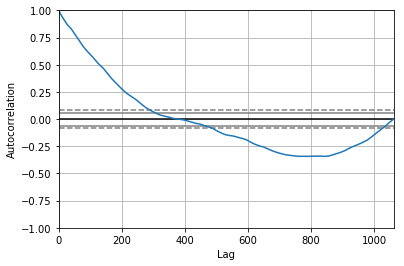

<Figure size 800x560 with 0 Axes>

Test MSE: 0.266


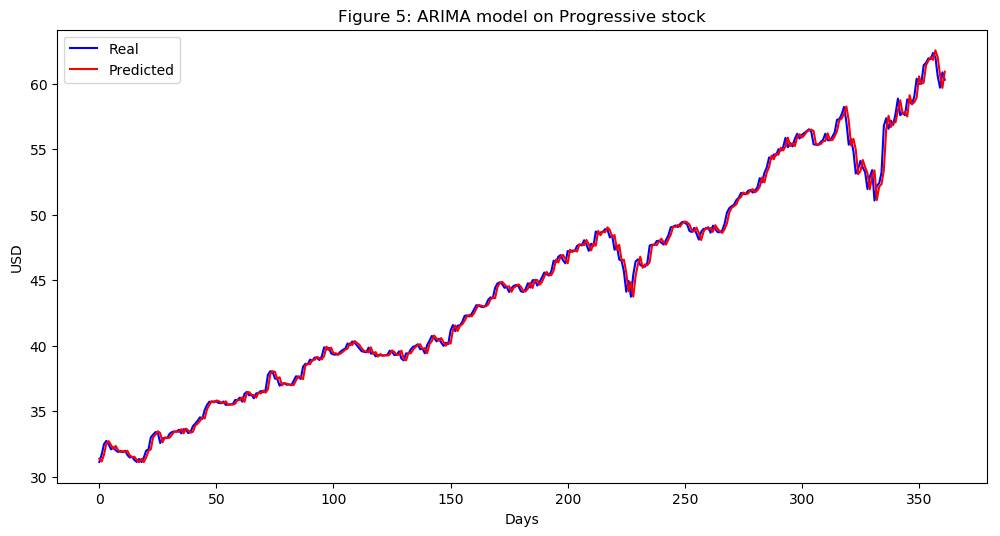

In [195]:
Progressive_series = SP500_TechIndicator['Progressive_Close']
Progressive_series_model = ARIMA(Progressive_series, order=(5, 1, 0))
Progressive_model_fit = Progressive_series_model.fit(disp=0)
print(Progressive_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Progressive_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Progressive_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Progressive_predictions = list()
for t in range(len(test)):
    Progressive_series_model = ARIMA(history, order=(5,1,0))
    Progressive_series_model_fit = Progressive_series_model.fit(disp=0)
    Progressive_output = Progressive_series_model_fit.forecast()
    yhat = Progressive_output[0]
    Progressive_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Progressive_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Progressive_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Progressive stock')
plt.legend()
plt.show()


#predictions
Progressive_predictions = pd.DataFrame({'Progressive_predictions':Progressive_predictions})
#Progressive_predictions.to_csv('Progressive_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Prudential_Financial_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -1822.443
Method:                                 css-mle   S.D. of innovations              1.348
Date:                          Sun, 17 Mar 2019   AIC                           3658.885
Time:                                  14:44:47   BIC                           3693.654
Sample:                                       1   HQIC                          3672.062
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0099      0.039      0.253      0.801    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


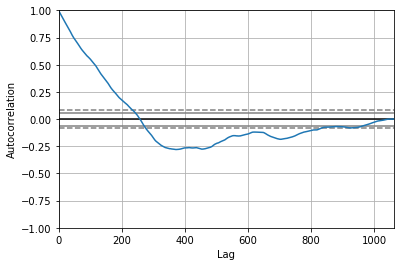

<Figure size 800x560 with 0 Axes>

Test MSE: 2.006


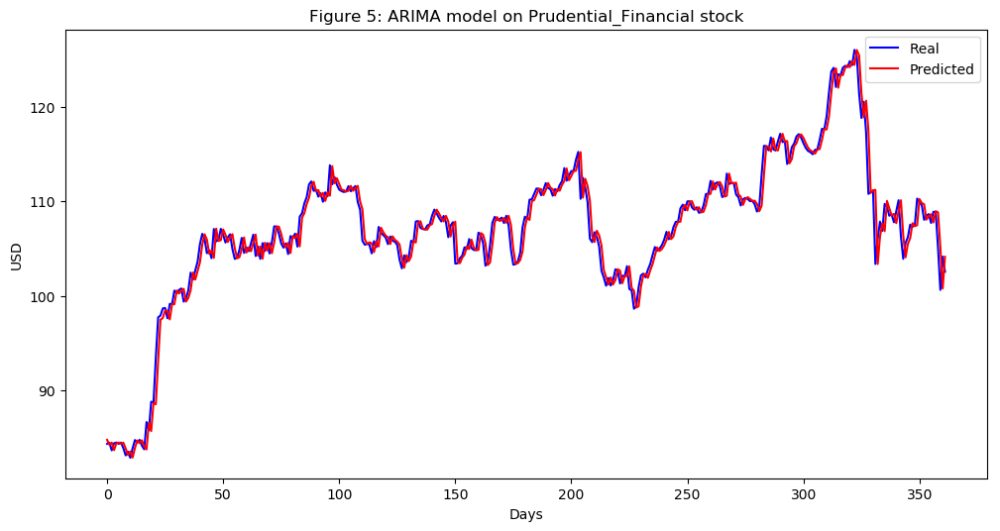

In [196]:
Prudential_Financial_series = SP500_TechIndicator['Prudential_Financial_Close']
Prudential_Financial_series_model = ARIMA(Prudential_Financial_series, order=(5, 1, 0))
Prudential_Financial_model_fit = Prudential_Financial_series_model.fit(disp=0)
print(Prudential_Financial_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Prudential_Financial_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Prudential_Financial_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Prudential_Financial_predictions = list()
for t in range(len(test)):
    Prudential_Financial_series_model = ARIMA(history, order=(5,1,0))
    Prudential_Financial_series_model_fit = Prudential_Financial_series_model.fit(disp=0)
    Prudential_Financial_output = Prudential_Financial_series_model_fit.forecast()
    yhat = Prudential_Financial_output[0]
    Prudential_Financial_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Prudential_Financial_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Prudential_Financial_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Prudential_Financial stock')
plt.legend()
plt.show()


#predictions
Prudential_Financial_predictions = pd.DataFrame({'Prudential_Financial_predictions':Prudential_Financial_predictions})
#Prudential_Financial_predictions.to_csv('Prudential_Financial_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Regions_Financial_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood                 242.110
Method:                              css-mle   S.D. of innovations              0.193
Date:                       Sun, 17 Mar 2019   AIC                           -470.221
Time:                               14:45:31   BIC                           -435.452
Sample:                                    1   HQIC                          -457.044
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0080      0.006      1.393      0.164      -0.003       0.019
ar.L1.D.Regi

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


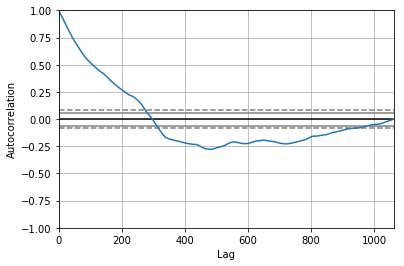

<Figure size 800x560 with 0 Axes>

Test MSE: 0.060


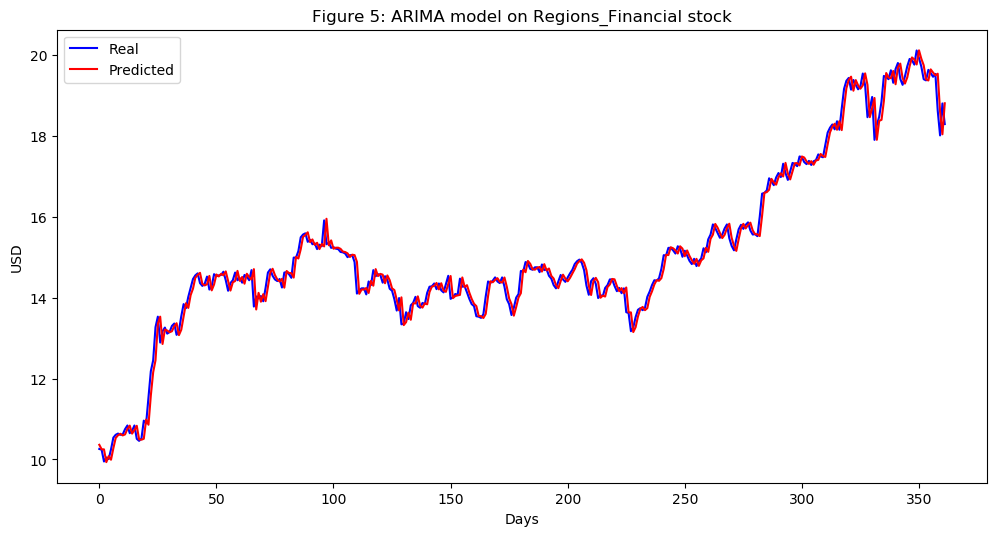

In [197]:
Regions_Financial_series = SP500_TechIndicator['Regions_Financial_Close']
Regions_Financial_series_model = ARIMA(Regions_Financial_series, order=(5, 1, 0))
Regions_Financial_model_fit = Regions_Financial_series_model.fit(disp=0)
print(Regions_Financial_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Regions_Financial_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Regions_Financial_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Regions_Financial_predictions = list()
for t in range(len(test)):
    Regions_Financial_series_model = ARIMA(history, order=(5,1,0))
    Regions_Financial_series_model_fit = Regions_Financial_series_model.fit(disp=0)
    Regions_Financial_output = Regions_Financial_series_model_fit.forecast()
    yhat = Regions_Financial_output[0]
    Regions_Financial_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Regions_Financial_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Regions_Financial_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Regions_Financial stock')
plt.legend()
plt.show()


#predictions
Regions_Financial_predictions = pd.DataFrame({'Regions_Financial_predictions':Regions_Financial_predictions})
#Regions_Financial_predictions.to_csv('Regions_Financial_predictions.csv')



                              ARIMA Model Results                               
Dep. Variable:     D.State_Street_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -1615.498
Method:                         css-mle   S.D. of innovations              1.109
Date:                  Sun, 17 Mar 2019   AIC                           3244.996
Time:                          14:46:29   BIC                           3279.765
Sample:                               1   HQIC                          3258.173
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                          0.0242      0.033      0.743      0.458      -0.040       0.088
ar.L1.D.State_Street_Close     0.0262      0.031      0.852      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


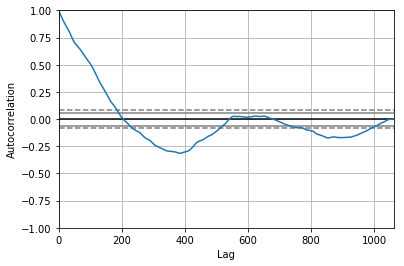

<Figure size 800x560 with 0 Axes>

Test MSE: 1.406


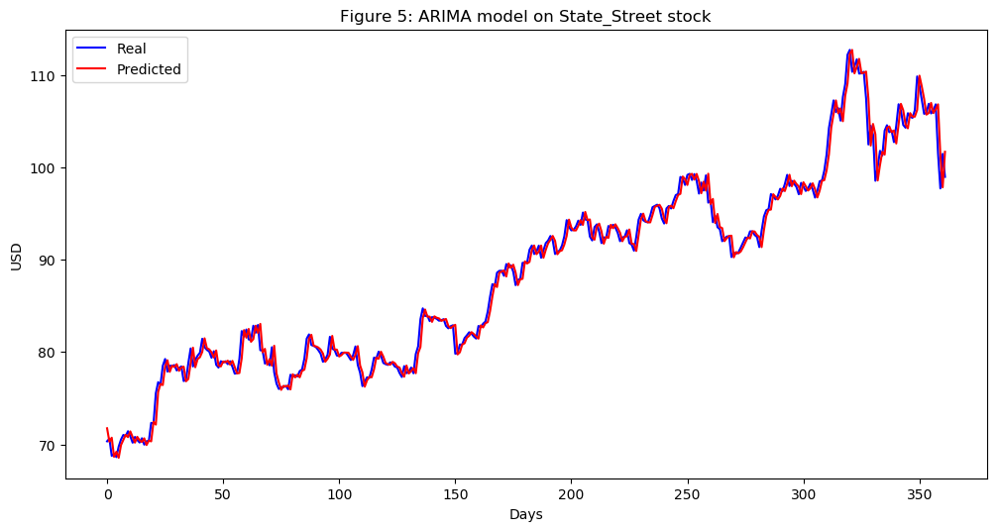

In [198]:
State_Street_series = SP500_TechIndicator['State_Street_Close']
State_Street_series_model = ARIMA(State_Street_series, order=(5, 1, 0))
State_Street_model_fit = State_Street_series_model.fit(disp=0)
print(State_Street_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(State_Street_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = State_Street_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
State_Street_predictions = list()
for t in range(len(test)):
    State_Street_series_model = ARIMA(history, order=(5,1,0))
    State_Street_series_model_fit = State_Street_series_model.fit(disp=0)
    State_Street_output = State_Street_series_model_fit.forecast()
    yhat = State_Street_output[0]
    State_Street_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, State_Street_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(State_Street_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on State_Street stock')
plt.legend()
plt.show()


#predictions
State_Street_predictions = pd.DataFrame({'State_Street_predictions':State_Street_predictions})
#State_Street_predictions.to_csv('State_Street_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.SunTrust_Banks_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1099.013
Method:                           css-mle   S.D. of innovations              0.682
Date:                    Sun, 17 Mar 2019   AIC                           2212.026
Time:                            14:47:18   BIC                           2246.795
Sample:                                 1   HQIC                          2225.203
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0283      0.019      1.454      0.146      -0.010       0.067
ar.L1.D.SunTrust_Banks_Close     0.0092      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


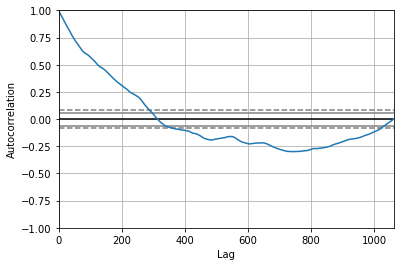

<Figure size 800x560 with 0 Axes>

Test MSE: 0.694


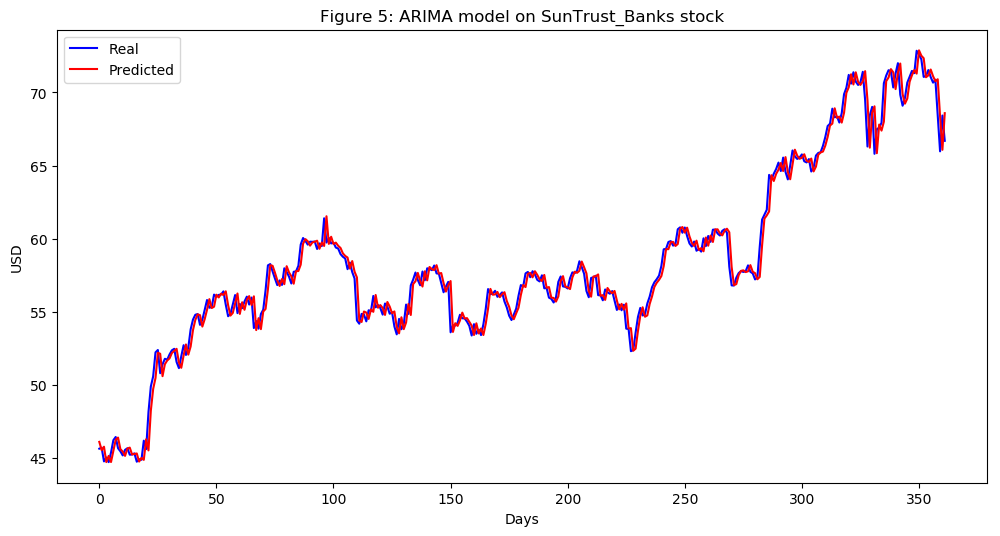

In [199]:
SunTrust_Banks_series = SP500_TechIndicator['SunTrust_Banks_Close']
SunTrust_Banks_series_model = ARIMA(SunTrust_Banks_series, order=(5, 1, 0))
SunTrust_Banks_model_fit = SunTrust_Banks_series_model.fit(disp=0)
print(SunTrust_Banks_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(SunTrust_Banks_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = SunTrust_Banks_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
SunTrust_Banks_predictions = list()
for t in range(len(test)):
    SunTrust_Banks_series_model = ARIMA(history, order=(5,1,0))
    SunTrust_Banks_series_model_fit = SunTrust_Banks_series_model.fit(disp=0)
    SunTrust_Banks_output = SunTrust_Banks_series_model_fit.forecast()
    yhat = SunTrust_Banks_output[0]
    SunTrust_Banks_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, SunTrust_Banks_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(SunTrust_Banks_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on SunTrust_Banks stock')
plt.legend()
plt.show()


#predictions
SunTrust_Banks_predictions = pd.DataFrame({'SunTrust_Banks_predictions':SunTrust_Banks_predictions})
#SunTrust_Banks_predictions.to_csv('SunTrust_Banks_predictions.csv')



                               ARIMA Model Results                               
Dep. Variable:     D.SVB_Financial_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -2656.443
Method:                          css-mle   S.D. of innovations              2.959
Date:                   Sun, 17 Mar 2019   AIC                           5326.886
Time:                           14:48:20   BIC                           5361.655
Sample:                                1   HQIC                          5340.062
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.1276      0.086      1.475      0.140      -0.042       0.297
ar.L1.D.SVB_Financial_Close     0.0299      0.031      0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


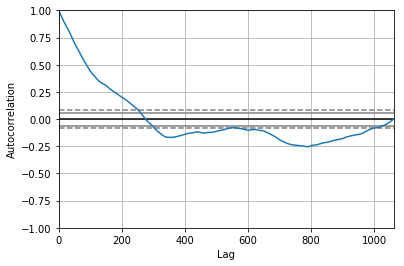

<Figure size 800x560 with 0 Axes>

Test MSE: 14.945


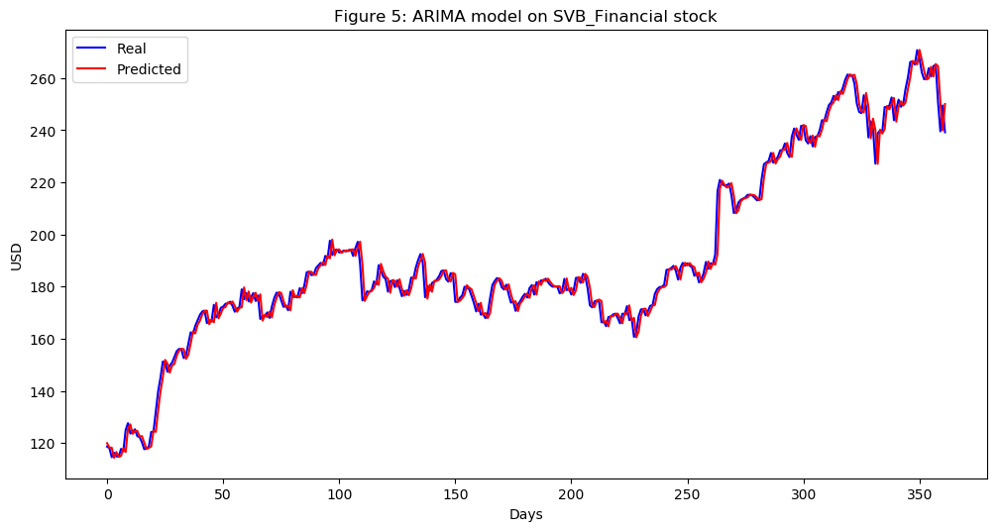

In [200]:
SVB_Financial_series = SP500_TechIndicator['SVB_Financial_Close']
SVB_Financial_series_model = ARIMA(SVB_Financial_series, order=(5, 1, 0))
SVB_Financial_model_fit = SVB_Financial_series_model.fit(disp=0)
print(SVB_Financial_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(SVB_Financial_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = SVB_Financial_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
SVB_Financial_predictions = list()
for t in range(len(test)):
    SVB_Financial_series_model = ARIMA(history, order=(5,1,0))
    SVB_Financial_series_model_fit = SVB_Financial_series_model.fit(disp=0)
    SVB_Financial_output = SVB_Financial_series_model_fit.forecast()
    yhat = SVB_Financial_output[0]
    SVB_Financial_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, SVB_Financial_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(SVB_Financial_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on SVB_Financial stock')
plt.legend()
plt.show()


#predictions
SVB_Financial_predictions = pd.DataFrame({'SVB_Financial_predictions':SVB_Financial_predictions})
#SVB_Financial_predictions.to_csv('SVB_Financial_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.T_Rowe_Price_Group_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1517.876
Method:                               css-mle   S.D. of innovations              1.012
Date:                        Sun, 17 Mar 2019   AIC                           3049.752
Time:                                14:49:12   BIC                           3084.521
Sample:                                     1   HQIC                          3062.929
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0205      0.034      0.603      0.547      -0.046       0.087
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


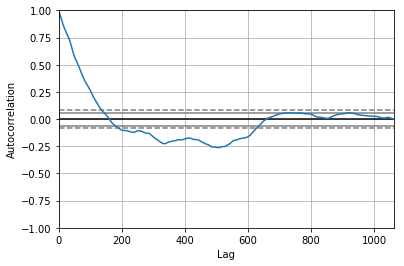

<Figure size 800x560 with 0 Axes>

Test MSE: 1.374


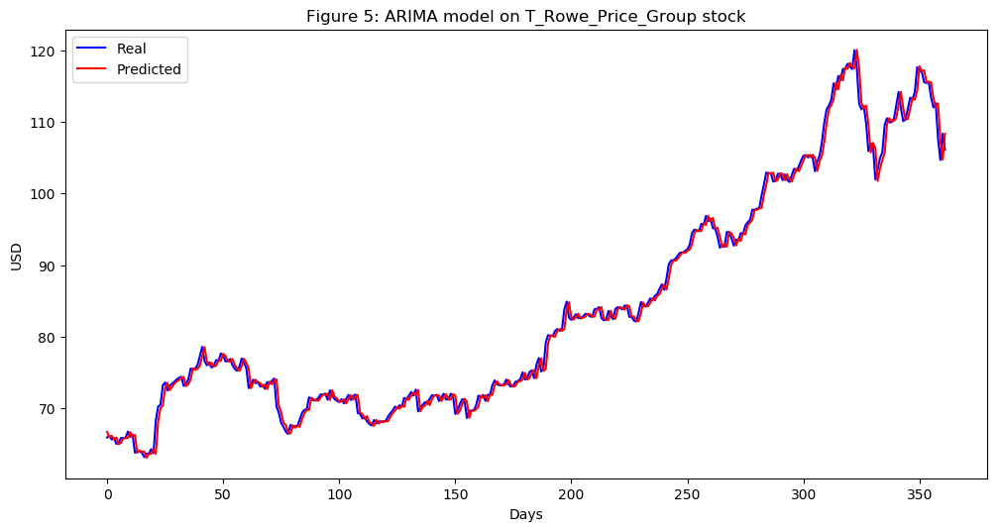

In [201]:
T_Rowe_Price_Group_series = SP500_TechIndicator['T_Rowe_Price_Group_Close']
T_Rowe_Price_Group_series_model = ARIMA(T_Rowe_Price_Group_series, order=(5, 1, 0))
T_Rowe_Price_Group_model_fit = T_Rowe_Price_Group_series_model.fit(disp=0)
print(T_Rowe_Price_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(T_Rowe_Price_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = T_Rowe_Price_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
T_Rowe_Price_Group_predictions = list()
for t in range(len(test)):
    T_Rowe_Price_Group_series_model = ARIMA(history, order=(5,1,0))
    T_Rowe_Price_Group_series_model_fit = T_Rowe_Price_Group_series_model.fit(disp=0)
    T_Rowe_Price_Group_output = T_Rowe_Price_Group_series_model_fit.forecast()
    yhat = T_Rowe_Price_Group_output[0]
    T_Rowe_Price_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, T_Rowe_Price_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(T_Rowe_Price_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on T_Rowe_Price_Group stock')
plt.legend()
plt.show()


#predictions
T_Rowe_Price_Group_predictions = pd.DataFrame({'T_Rowe_Price_Group_predictions':T_Rowe_Price_Group_predictions})
#T_Rowe_Price_Group_predictions.to_csv('T_Rowe_Price_Group_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:      D.Torchmark_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1591.253
Method:                       css-mle   S.D. of innovations              1.084
Date:                Sun, 17 Mar 2019   AIC                           3196.505
Time:                        14:50:11   BIC                           3231.274
Sample:                             1   HQIC                          3209.682
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.0048      0.031      0.152      0.879      -0.057       0.066
ar.L1.D.Torchmark_Close    -0.0151      0.031     -0.492      0.623      -0.075       0.045


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


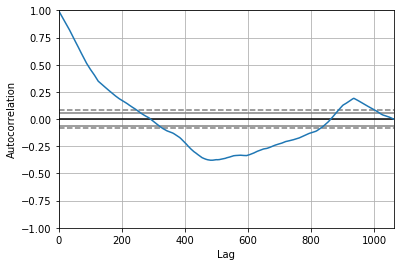

<Figure size 800x560 with 0 Axes>

Test MSE: 0.542


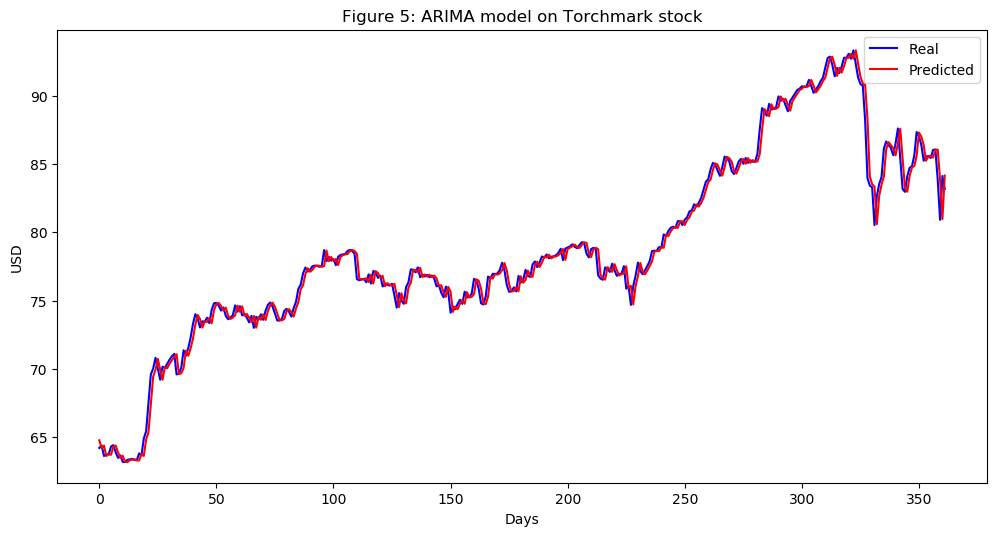

In [202]:
Torchmark_series = SP500_TechIndicator['Torchmark_Close']
Torchmark_series_model = ARIMA(Torchmark_series, order=(5, 1, 0))
Torchmark_model_fit = Torchmark_series_model.fit(disp=0)
print(Torchmark_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Torchmark_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Torchmark_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Torchmark_predictions = list()
for t in range(len(test)):
    Torchmark_series_model = ARIMA(history, order=(5,1,0))
    Torchmark_series_model_fit = Torchmark_series_model.fit(disp=0)
    Torchmark_output = Torchmark_series_model_fit.forecast()
    yhat = Torchmark_output[0]
    Torchmark_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Torchmark_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Torchmark_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Torchmark stock')
plt.legend()
plt.show()


#predictions
Torchmark_predictions = pd.DataFrame({'Torchmark_predictions':Torchmark_predictions})
#Torchmark_predictions.to_csv('Torchmark_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:     D.US_Bancorp_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -785.547
Method:                       css-mle   S.D. of innovations              0.507
Date:                Sun, 17 Mar 2019   AIC                           1585.095
Time:                        14:51:20   BIC                           1619.863
Sample:                             1   HQIC                          1598.271
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0090      0.014      0.651      0.515      -0.018       0.036
ar.L1.D.US_Bancorp_Close     0.0002      0.031      0.005      0.996      -0.060       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


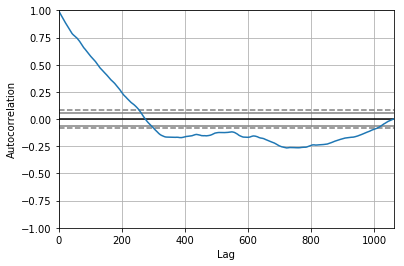

<Figure size 800x560 with 0 Axes>

Test MSE: 0.300


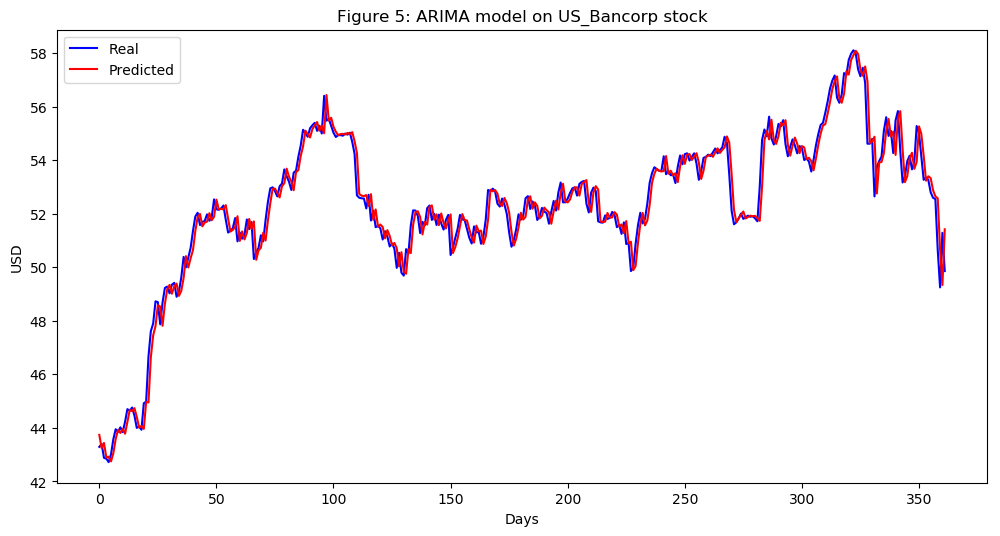

In [203]:
US_Bancorp_series = SP500_TechIndicator['US_Bancorp_Close']
US_Bancorp_series_model = ARIMA(US_Bancorp_series, order=(5, 1, 0))
US_Bancorp_model_fit = US_Bancorp_series_model.fit(disp=0)
print(US_Bancorp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(US_Bancorp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = US_Bancorp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
US_Bancorp_predictions = list()
for t in range(len(test)):
    US_Bancorp_series_model = ARIMA(history, order=(5,1,0))
    US_Bancorp_series_model_fit = US_Bancorp_series_model.fit(disp=0)
    US_Bancorp_output = US_Bancorp_series_model_fit.forecast()
    yhat = US_Bancorp_output[0]
    US_Bancorp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, US_Bancorp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(US_Bancorp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on US_Bancorp stock')
plt.legend()
plt.show()


#predictions
US_Bancorp_predictions = pd.DataFrame({'US_Bancorp_predictions':US_Bancorp_predictions})
#US_Bancorp_predictions.to_csv('US_Bancorp_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:     D.Unum_Group_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -846.494
Method:                       css-mle   S.D. of innovations              0.537
Date:                Sun, 17 Mar 2019   AIC                           1706.989
Time:                        14:52:52   BIC                           1741.757
Sample:                             1   HQIC                          1720.165
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0118      0.016      0.740      0.460      -0.019       0.043
ar.L1.D.Unum_Group_Close     0.0111      0.031      0.363      0.717      -0.049       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


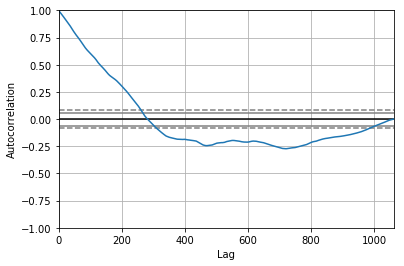

<Figure size 800x560 with 0 Axes>

Test MSE: 0.387


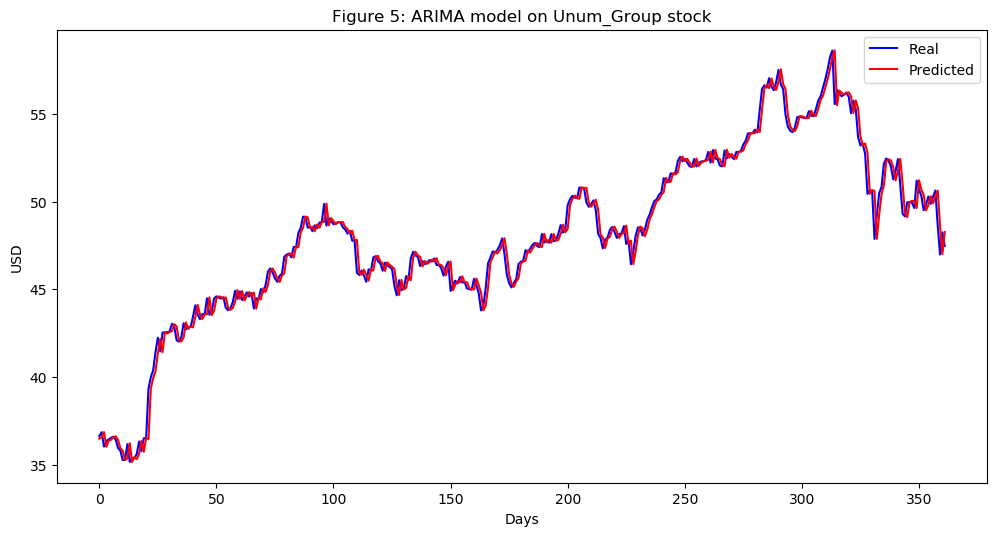

In [204]:
Unum_Group_series = SP500_TechIndicator['Unum_Group_Close']
Unum_Group_series_model = ARIMA(Unum_Group_series, order=(5, 1, 0))
Unum_Group_model_fit = Unum_Group_series_model.fit(disp=0)
print(Unum_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Unum_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Unum_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Unum_Group_predictions = list()
for t in range(len(test)):
    Unum_Group_series_model = ARIMA(history, order=(5,1,0))
    Unum_Group_series_model_fit = Unum_Group_series_model.fit(disp=0)
    Unum_Group_output = Unum_Group_series_model_fit.forecast()
    yhat = Unum_Group_output[0]
    Unum_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Unum_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Unum_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Unum_Group stock')
plt.legend()
plt.show()


#predictions
Unum_Group_predictions = pd.DataFrame({'Unum_Group_predictions':Unum_Group_predictions})
#Unum_Group_predictions.to_csv('Unum_Group_predictions.csv')



                              ARIMA Model Results                              
Dep. Variable:     D.Wells_Fargo_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -1074.115
Method:                        css-mle   S.D. of innovations              0.666
Date:                 Sun, 17 Mar 2019   AIC                           2162.230
Time:                         14:54:14   BIC                           2196.999
Sample:                              1   HQIC                          2175.407
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0054      0.021      0.259      0.796      -0.035       0.046
ar.L1.D.Wells_Fargo_Close     0.0594      0.031      1.934      0.053      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


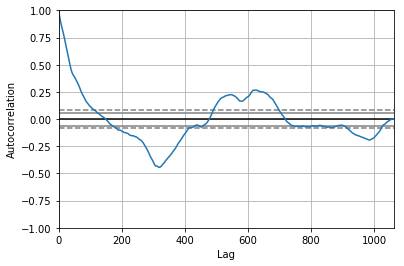

<Figure size 800x560 with 0 Axes>

Test MSE: 0.600


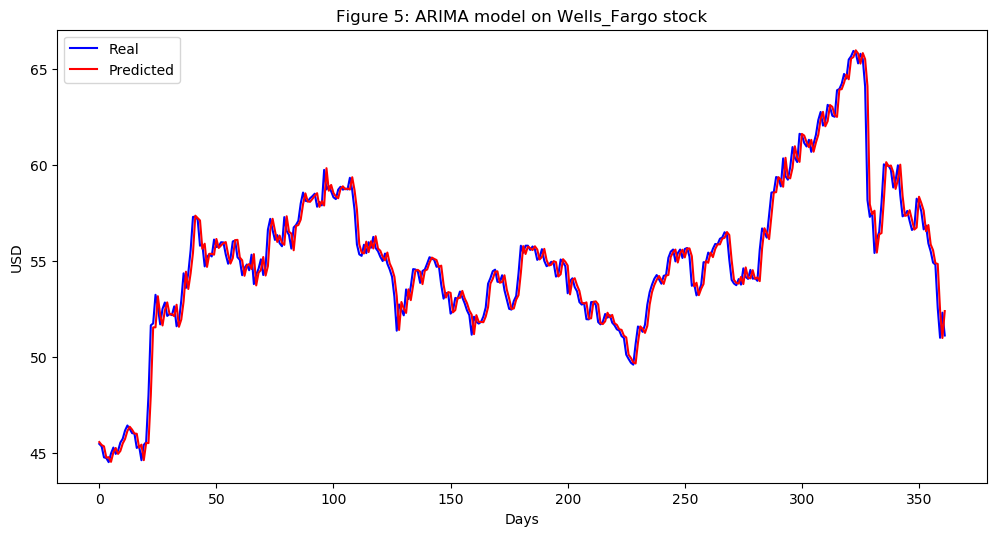

In [205]:
Wells_Fargo_series = SP500_TechIndicator['Wells_Fargo_Close']
Wells_Fargo_series_model = ARIMA(Wells_Fargo_series, order=(5, 1, 0))
Wells_Fargo_model_fit = Wells_Fargo_series_model.fit(disp=0)
print(Wells_Fargo_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Wells_Fargo_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Wells_Fargo_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Wells_Fargo_predictions = list()
for t in range(len(test)):
    Wells_Fargo_series_model = ARIMA(history, order=(5,1,0))
    Wells_Fargo_series_model_fit = Wells_Fargo_series_model.fit(disp=0)
    Wells_Fargo_output = Wells_Fargo_series_model_fit.forecast()
    yhat = Wells_Fargo_output[0]
    Wells_Fargo_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Wells_Fargo_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Wells_Fargo_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Wells_Fargo stock')
plt.legend()
plt.show()


#predictions
Wells_Fargo_predictions = pd.DataFrame({'Wells_Fargo_predictions':Wells_Fargo_predictions})
#Wells_Fargo_predictions.to_csv('Wells_Fargo_predictions.csv')



                               ARIMA Model Results                               
Dep. Variable:     D.Zions_Bancorp_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood                -897.732
Method:                          css-mle   S.D. of innovations              0.564
Date:                   Sun, 17 Mar 2019   AIC                           1809.464
Time:                           14:55:42   BIC                           1844.233
Sample:                                1   HQIC                          1822.641
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0209      0.016      1.298      0.195      -0.011       0.052
ar.L1.D.Zions_Bancorp_Close    -0.0033      0.031     -0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


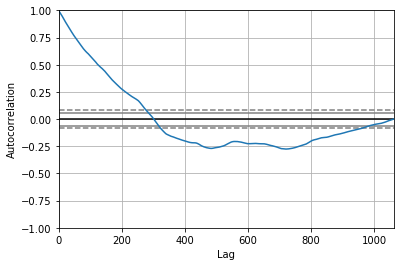

<Figure size 800x560 with 0 Axes>

Test MSE: 0.523


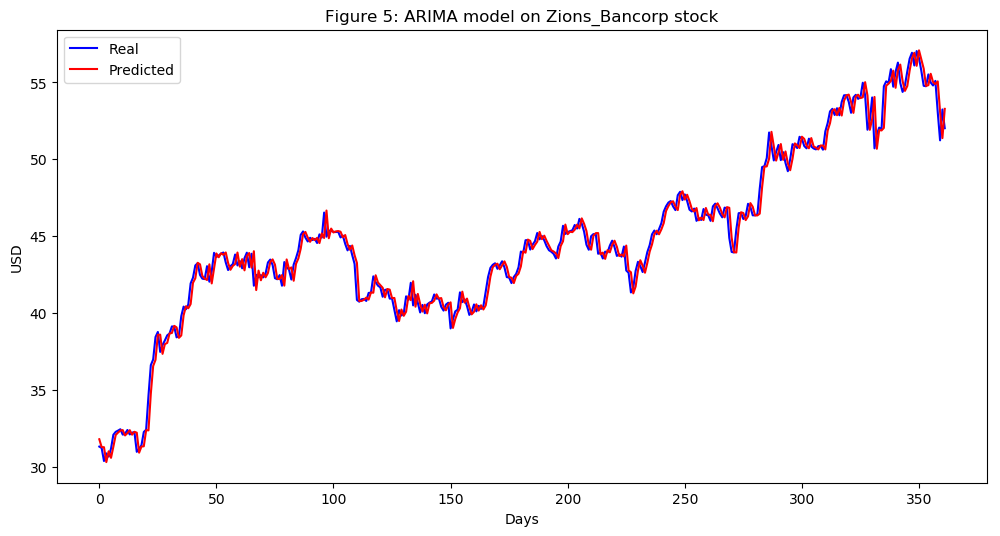

In [206]:
Zions_Bancorp_series = SP500_TechIndicator['Zions_Bancorp_Close']
Zions_Bancorp_series_model = ARIMA(Zions_Bancorp_series, order=(5, 1, 0))
Zions_Bancorp_model_fit = Zions_Bancorp_series_model.fit(disp=0)
print(Zions_Bancorp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Zions_Bancorp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Zions_Bancorp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Zions_Bancorp_predictions = list()
for t in range(len(test)):
    Zions_Bancorp_series_model = ARIMA(history, order=(5,1,0))
    Zions_Bancorp_series_model_fit = Zions_Bancorp_series_model.fit(disp=0)
    Zions_Bancorp_output = Zions_Bancorp_series_model_fit.forecast()
    yhat = Zions_Bancorp_output[0]
    Zions_Bancorp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Zions_Bancorp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Zions_Bancorp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Zions_Bancorp stock')
plt.legend()
plt.show()


#predictions
Zions_Bancorp_predictions = pd.DataFrame({'Zions_Bancorp_predictions':Zions_Bancorp_predictions})
#Zions_Bancorp_predictions.to_csv('Zions_Bancorp_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.Abbott_Laboratories_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood                -891.084
Method:                                css-mle   S.D. of innovations              0.560
Date:                         Sun, 17 Mar 2019   AIC                           1796.167
Time:                                 14:56:58   BIC                           1830.936
Sample:                                      1   HQIC                          1809.344
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0207      0.017      1.196      0.232      -0.013   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


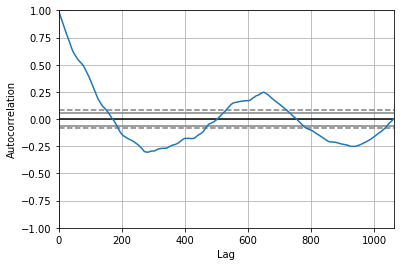

<Figure size 800x560 with 0 Axes>

Test MSE: 0.327


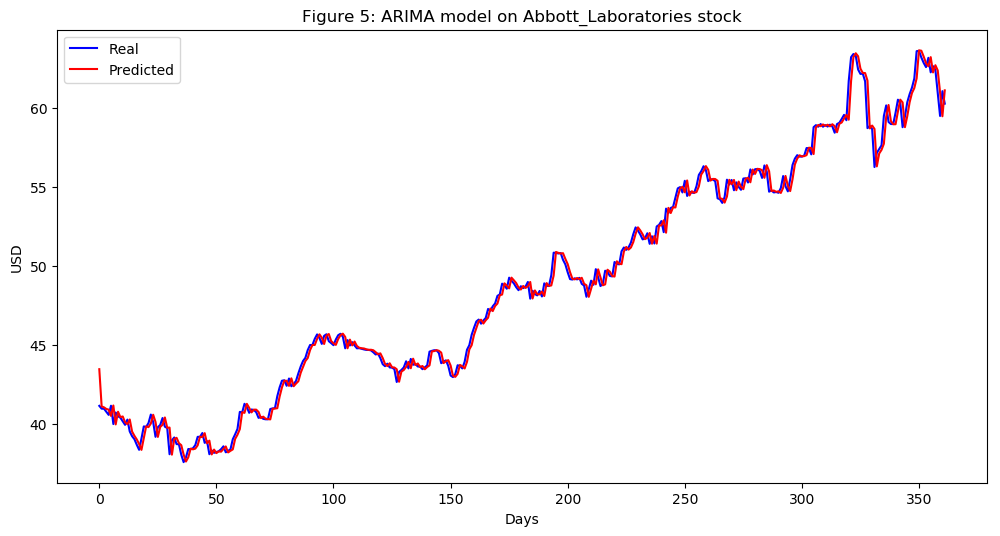

In [207]:
Abbott_Laboratories_series = SP500_TechIndicator['Abbott_Laboratories_Close']
Abbott_Laboratories_series_model = ARIMA(Abbott_Laboratories_series, order=(5, 1, 0))
Abbott_Laboratories_model_fit = Abbott_Laboratories_series_model.fit(disp=0)
print(Abbott_Laboratories_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Abbott_Laboratories_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Abbott_Laboratories_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Abbott_Laboratories_predictions = list()
for t in range(len(test)):
    Abbott_Laboratories_series_model = ARIMA(history, order=(5,1,0))
    Abbott_Laboratories_series_model_fit = Abbott_Laboratories_series_model.fit(disp=0)
    Abbott_Laboratories_output = Abbott_Laboratories_series_model_fit.forecast()
    yhat = Abbott_Laboratories_output[0]
    Abbott_Laboratories_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Abbott_Laboratories_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Abbott_Laboratories_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Abbott_Laboratories stock')
plt.legend()
plt.show()


#predictions
Abbott_Laboratories_predictions = pd.DataFrame({'Abbott_Laboratories_predictions':Abbott_Laboratories_predictions})
#Abbott_Laboratories_predictions.to_csv('Abbott_Laboratories_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.AbbVie_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1761.926
Method:                       css-mle   S.D. of innovations              1.273
Date:                Sun, 17 Mar 2019   AIC                           3537.852
Time:                        14:58:36   BIC                           3572.620
Sample:                             1   HQIC                          3551.028
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0350      0.043      0.809      0.419      -0.050       0.120
ar.L1.D.AbbVie_Close     0.0463      0.031      1.507      0.132      -0.014       0.107
ar.L2.D.AbbV

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


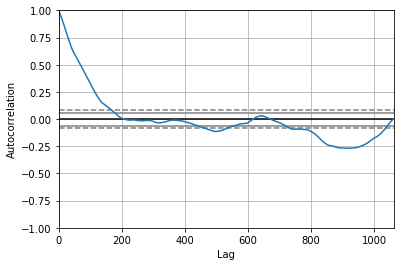

<Figure size 800x560 with 0 Axes>

Test MSE: 2.829


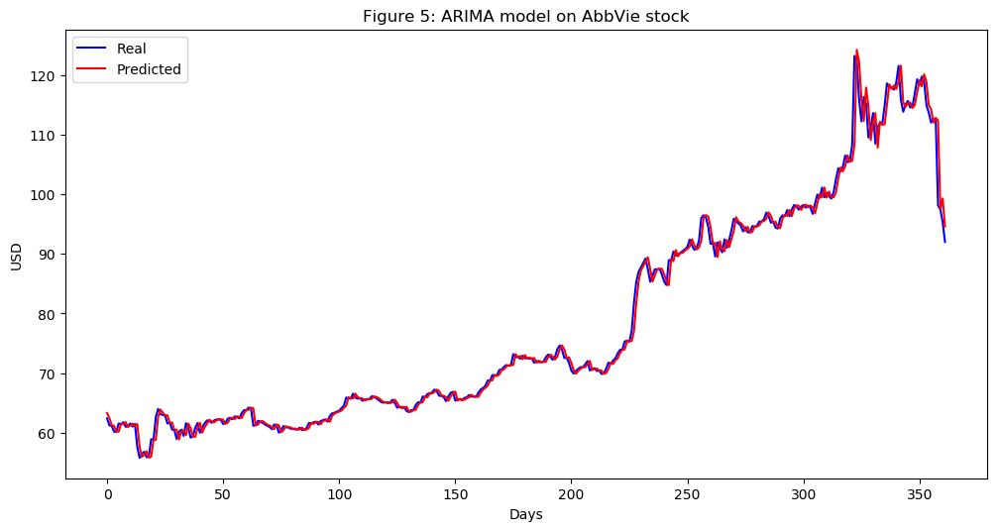

In [208]:
AbbVie_series = SP500_TechIndicator['AbbVie_Close']
AbbVie_series_model = ARIMA(AbbVie_series, order=(5, 1, 0))
AbbVie_model_fit = AbbVie_series_model.fit(disp=0)
print(AbbVie_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(AbbVie_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = AbbVie_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
AbbVie_predictions = list()
for t in range(len(test)):
    AbbVie_series_model = ARIMA(history, order=(5,1,0))
    AbbVie_series_model_fit = AbbVie_series_model.fit(disp=0)
    AbbVie_output = AbbVie_series_model_fit.forecast()
    yhat = AbbVie_output[0]
    AbbVie_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, AbbVie_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(AbbVie_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on AbbVie stock')
plt.legend()
plt.show()


#predictions
AbbVie_predictions = pd.DataFrame({'AbbVie_predictions':AbbVie_predictions})
#AbbVie_predictions.to_csv('AbbVie_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.ABIOMED_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2509.460
Method:                       css-mle   S.D. of innovations              2.576
Date:                Sun, 17 Mar 2019   AIC                           5032.920
Time:                        14:59:54   BIC                           5067.689
Sample:                             1   HQIC                          5046.097
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.2446      0.078      3.152      0.002       0.093       0.397
ar.L1.D.ABIOMED_Close    -0.0299      0.031     -0.969      0.333      -0.090       0.031
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


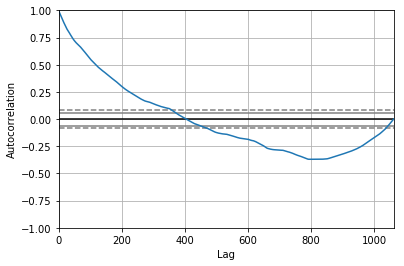

<Figure size 800x560 with 0 Axes>

Test MSE: 10.859


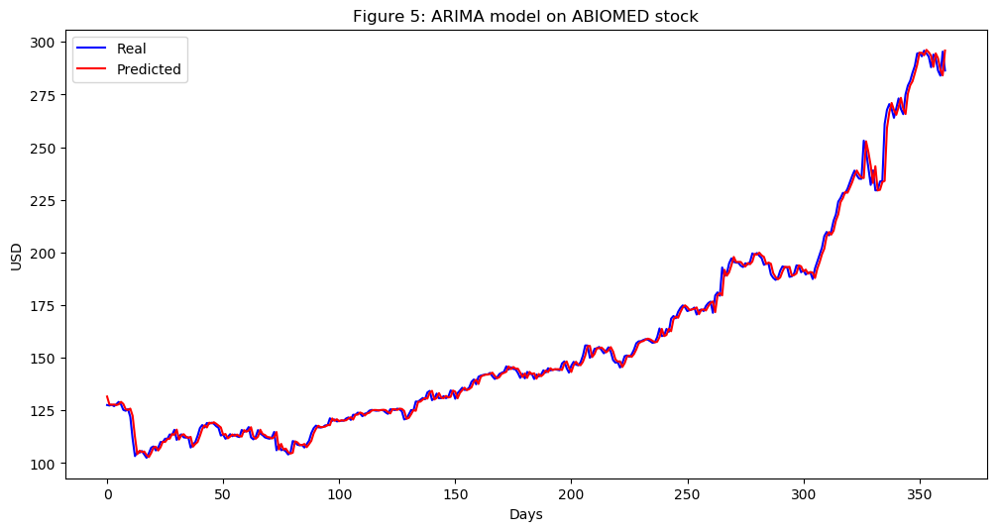

In [209]:
ABIOMED_series = SP500_TechIndicator['ABIOMED_Close']
ABIOMED_series_model = ARIMA(ABIOMED_series, order=(5, 1, 0))
ABIOMED_model_fit = ABIOMED_series_model.fit(disp=0)
print(ABIOMED_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(ABIOMED_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = ABIOMED_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
ABIOMED_predictions = list()
for t in range(len(test)):
    ABIOMED_series_model = ARIMA(history, order=(5,1,0))
    ABIOMED_series_model_fit = ABIOMED_series_model.fit(disp=0)
    ABIOMED_output = ABIOMED_series_model_fit.forecast()
    yhat = ABIOMED_output[0]
    ABIOMED_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, ABIOMED_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(ABIOMED_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on ABIOMED stock')
plt.legend()
plt.show()


#predictions
ABIOMED_predictions = pd.DataFrame({'ABIOMED_predictions':ABIOMED_predictions})
#ABIOMED_predictions.to_csv('ABIOMED_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Agilent_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1280.685
Method:                       css-mle   S.D. of innovations              0.809
Date:                Sun, 17 Mar 2019   AIC                           2575.371
Time:                        15:00:55   BIC                           2610.140
Sample:                             1   HQIC                          2588.547
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0095      0.022      0.437      0.662      -0.033       0.052
ar.L1.D.Agilent_Close    -0.0462      0.031     -1.507      0.132      -0.106       0.014
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


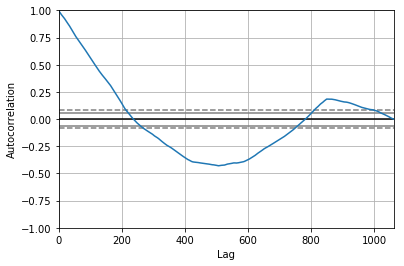

<Figure size 800x560 with 0 Axes>

Test MSE: 0.552


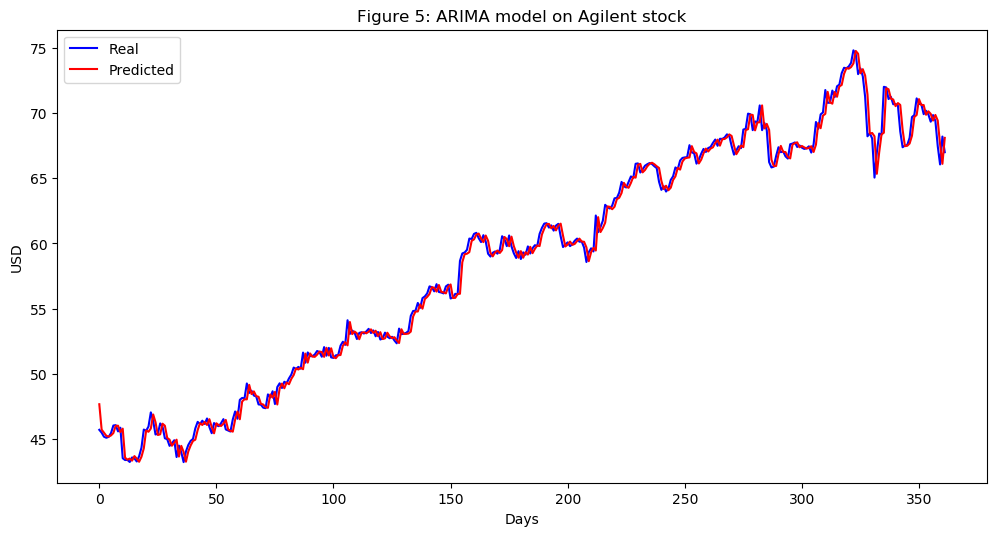

In [210]:
Agilent_series = SP500_TechIndicator['Agilent_Close']
Agilent_series_model = ARIMA(Agilent_series, order=(5, 1, 0))
Agilent_model_fit = Agilent_series_model.fit(disp=0)
print(Agilent_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Agilent_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Agilent_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Agilent_predictions = list()
for t in range(len(test)):
    Agilent_series_model = ARIMA(history, order=(5,1,0))
    Agilent_series_model_fit = Agilent_series_model.fit(disp=0)
    Agilent_output = Agilent_series_model_fit.forecast()
    yhat = Agilent_output[0]
    Agilent_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Agilent_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Agilent_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Agilent stock')
plt.legend()
plt.show()


#predictions
Agilent_predictions = pd.DataFrame({'Agilent_predictions':Agilent_predictions})
#Agilent_predictions.to_csv('Agilent_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Align_Technology_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -2559.415
Method:                             css-mle   S.D. of innovations              2.700
Date:                      Sun, 17 Mar 2019   AIC                           5132.830
Time:                              15:02:17   BIC                           5167.598
Sample:                                   1   HQIC                          5146.006
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.1791      0.088      2.028      0.043       0.006       0.352
ar.L1.D.Align_Technolog

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


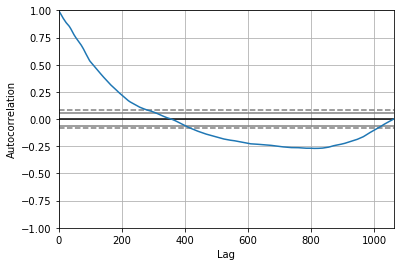

<Figure size 800x560 with 0 Axes>

Test MSE: 19.499


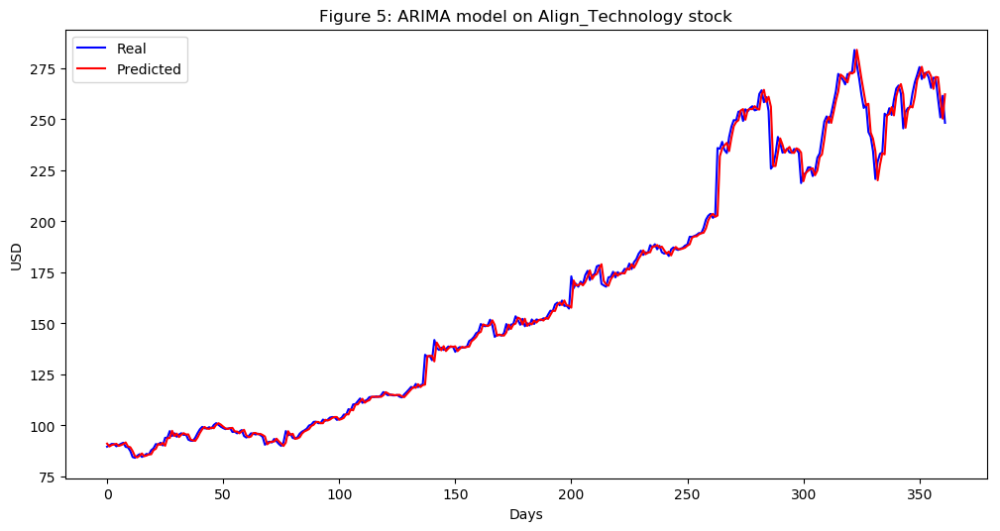

In [211]:
Align_Technology_series = SP500_TechIndicator['Align_Technology_Close']
Align_Technology_series_model = ARIMA(Align_Technology_series, order=(5, 1, 0))
Align_Technology_model_fit = Align_Technology_series_model.fit(disp=0)
print(Align_Technology_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Align_Technology_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Align_Technology_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Align_Technology_predictions = list()
for t in range(len(test)):
    Align_Technology_series_model = ARIMA(history, order=(5,1,0))
    Align_Technology_series_model_fit = Align_Technology_series_model.fit(disp=0)
    Align_Technology_output = Align_Technology_series_model_fit.forecast()
    yhat = Align_Technology_output[0]
    Align_Technology_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Align_Technology_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Align_Technology_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Align_Technology stock')
plt.legend()
plt.show()


#predictions
Align_Technology_predictions = pd.DataFrame({'Align_Technology_predictions':Align_Technology_predictions})
#Align_Technology_predictions.to_csv('Align_Technology_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Allergan_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -3098.026
Method:                       css-mle   S.D. of innovations              4.486
Date:                Sun, 17 Mar 2019   AIC                           6210.051
Time:                        15:03:22   BIC                           6244.820
Sample:                             1   HQIC                          6223.228
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     -0.0070      0.131     -0.053      0.958      -0.265       0.251
ar.L1.D.Allergan_Close     0.0154      0.031      0.502      0.616      -0.045       0.076
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


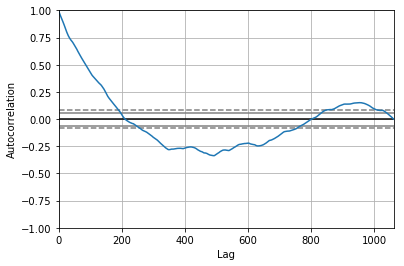

<Figure size 800x560 with 0 Axes>

Test MSE: 11.078


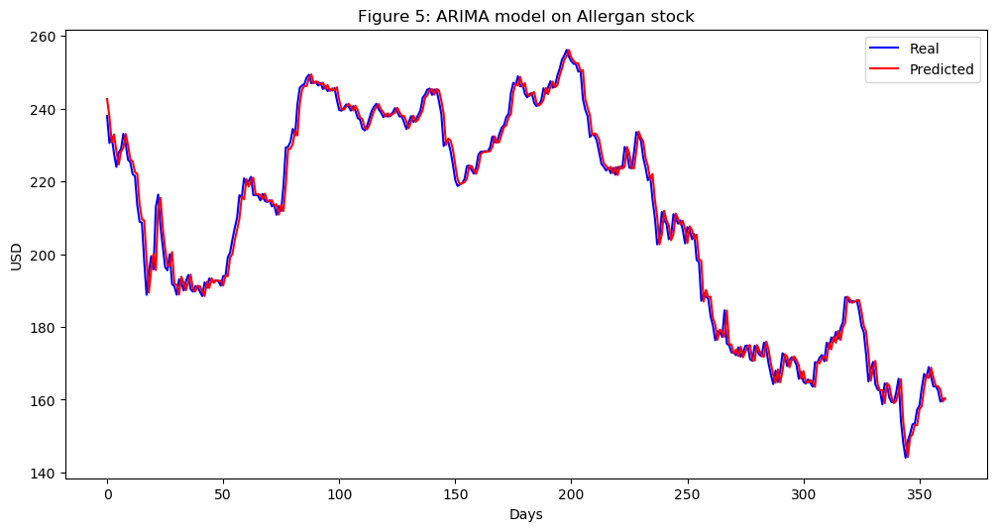

In [212]:
Allergan_series = SP500_TechIndicator['Allergan_Close']
Allergan_series_model = ARIMA(Allergan_series, order=(5, 1, 0))
Allergan_model_fit = Allergan_series_model.fit(disp=0)
print(Allergan_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Allergan_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Allergan_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Allergan_predictions = list()
for t in range(len(test)):
    Allergan_series_model = ARIMA(history, order=(5,1,0))
    Allergan_series_model_fit = Allergan_series_model.fit(disp=0)
    Allergan_output = Allergan_series_model_fit.forecast()
    yhat = Allergan_output[0]
    Allergan_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Allergan_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Allergan_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Allergan stock')
plt.legend()
plt.show()


#predictions
Allergan_predictions = pd.DataFrame({'Allergan_predictions':Allergan_predictions})
#Allergan_predictions.to_csv('Allergan_predictions.csv')



                                   ARIMA Model Results                                    
Dep. Variable:     D.AmerisourceBergen_Corp_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -1762.646
Method:                                   css-mle   S.D. of innovations              1.274
Date:                            Sun, 17 Mar 2019   AIC                           3539.293
Time:                                    15:04:23   BIC                           3574.061
Sample:                                         1   HQIC                          3552.469
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0122      0.049    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


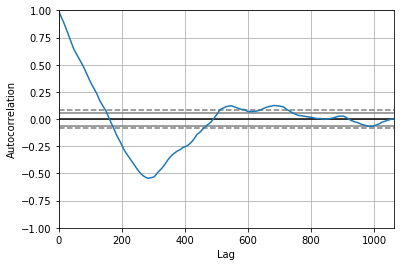

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 2.929


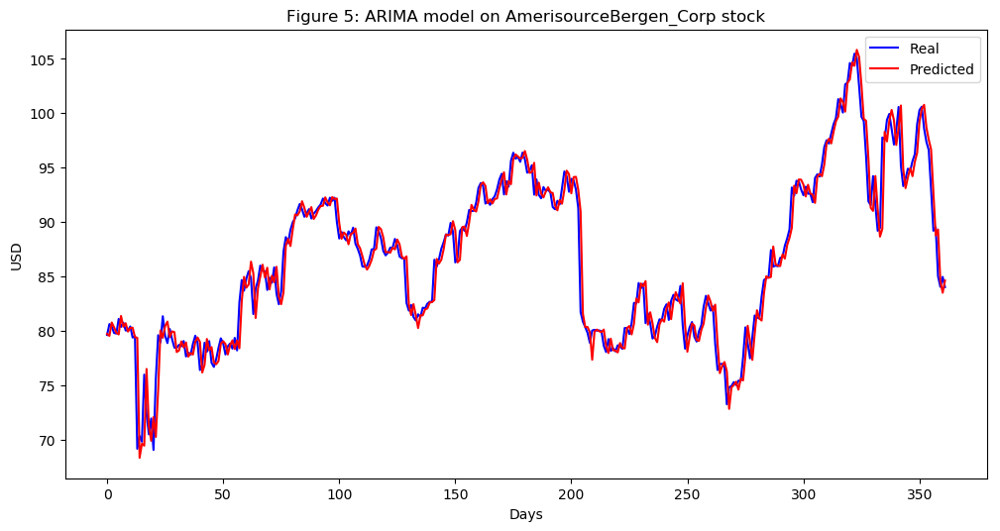

In [213]:
AmerisourceBergen_Corp_series = SP500_TechIndicator['AmerisourceBergen_Corp_Close']
AmerisourceBergen_Corp_series_model = ARIMA(AmerisourceBergen_Corp_series, order=(5, 1, 0))
AmerisourceBergen_Corp_model_fit = AmerisourceBergen_Corp_series_model.fit(disp=0)
print(AmerisourceBergen_Corp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(AmerisourceBergen_Corp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = AmerisourceBergen_Corp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
AmerisourceBergen_Corp_predictions = list()
for t in range(len(test)):
    AmerisourceBergen_Corp_series_model = ARIMA(history, order=(5,1,0))
    AmerisourceBergen_Corp_series_model_fit = AmerisourceBergen_Corp_series_model.fit(disp=0)
    AmerisourceBergen_Corp_output = AmerisourceBergen_Corp_series_model_fit.forecast()
    yhat = AmerisourceBergen_Corp_output[0]
    AmerisourceBergen_Corp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, AmerisourceBergen_Corp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(AmerisourceBergen_Corp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on AmerisourceBergen_Corp stock')
plt.legend()
plt.show()


#predictions
AmerisourceBergen_Corp_predictions = pd.DataFrame({'AmerisourceBergen_Corp_predictions':AmerisourceBergen_Corp_predictions})
#AmerisourceBergen_Corp_predictions.to_csv('AmerisourceBergen_Corp_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Amgen_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2418.874
Method:                       css-mle   S.D. of innovations              2.365
Date:                Sun, 17 Mar 2019   AIC                           4851.749
Time:                        15:05:41   BIC                           4886.517
Sample:                             1   HQIC                          4864.925
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0531      0.076      0.700      0.484      -0.096       0.202
ar.L1.D.Amgen_Close    -0.0010      0.031     -0.033      0.974      -0.061       0.059
ar.L2.D.Amgen_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


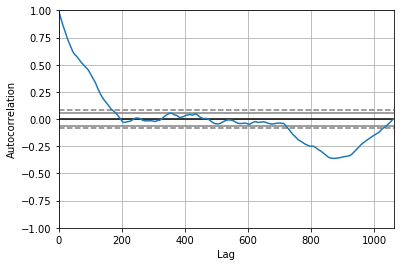

<Figure size 800x560 with 0 Axes>

Test MSE: 5.658


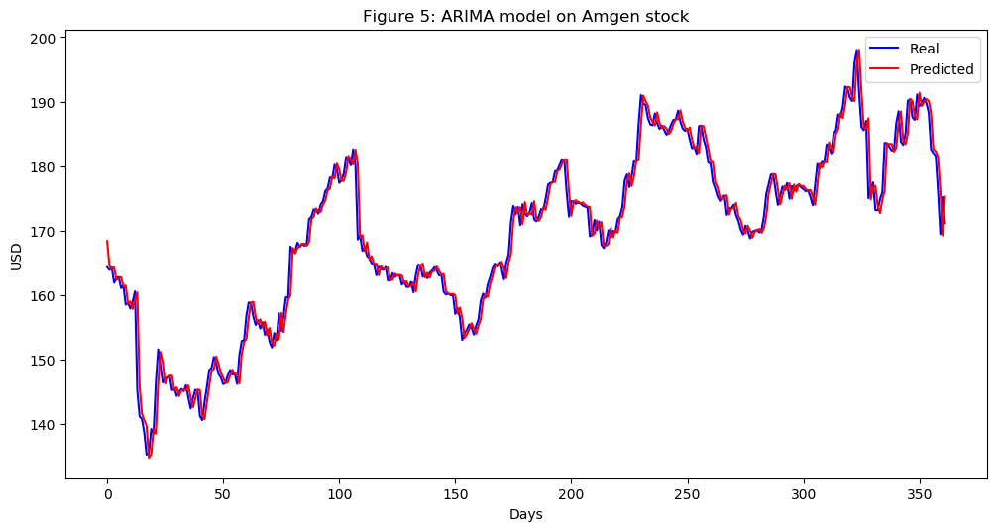

In [214]:
Amgen_series = SP500_TechIndicator['Amgen_Close']
Amgen_series_model = ARIMA(Amgen_series, order=(5, 1, 0))
Amgen_model_fit = Amgen_series_model.fit(disp=0)
print(Amgen_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Amgen_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Amgen_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Amgen_predictions = list()
for t in range(len(test)):
    Amgen_series_model = ARIMA(history, order=(5,1,0))
    Amgen_series_model_fit = Amgen_series_model.fit(disp=0)
    Amgen_output = Amgen_series_model_fit.forecast()
    yhat = Amgen_output[0]
    Amgen_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Amgen_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Amgen_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Amgen stock')
plt.legend()
plt.show()


#predictions
Amgen_predictions = pd.DataFrame({'Amgen_predictions':Amgen_predictions})
#Amgen_predictions.to_csv('Amgen_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Baxter_International_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -1640.350
Method:                                 css-mle   S.D. of innovations              1.136
Date:                          Sun, 17 Mar 2019   AIC                           3294.700
Time:                                  15:06:48   BIC                           3329.468
Sample:                                       1   HQIC                          3307.876
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                 -0.0044      0.037     -0.119      0.905    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


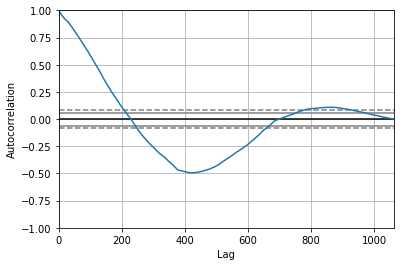

<Figure size 800x560 with 0 Axes>

Test MSE: 0.418


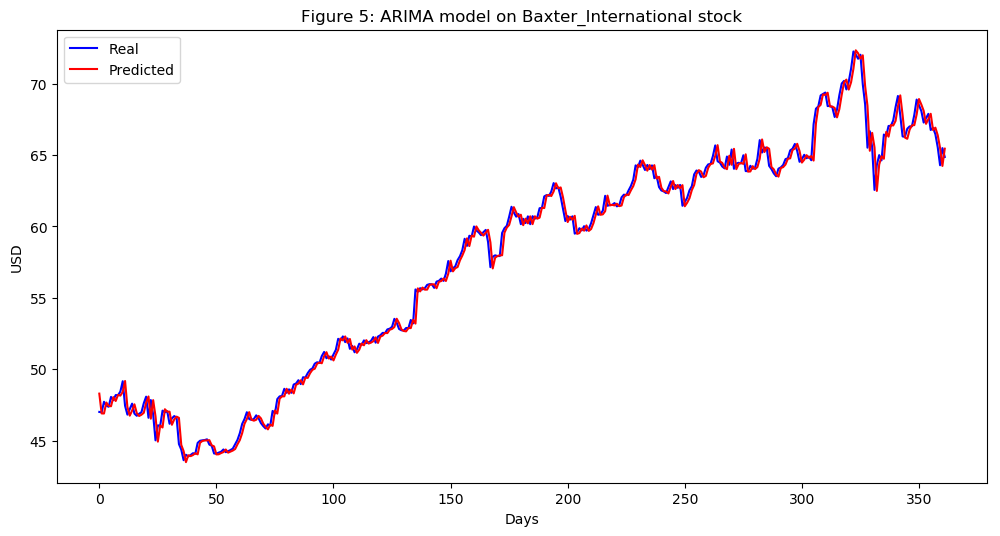

In [215]:
Baxter_International_series = SP500_TechIndicator['Baxter_International_Close']
Baxter_International_series_model = ARIMA(Baxter_International_series, order=(5, 1, 0))
Baxter_International_model_fit = Baxter_International_series_model.fit(disp=0)
print(Baxter_International_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Baxter_International_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Baxter_International_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Baxter_International_predictions = list()
for t in range(len(test)):
    Baxter_International_series_model = ARIMA(history, order=(5,1,0))
    Baxter_International_series_model_fit = Baxter_International_series_model.fit(disp=0)
    Baxter_International_output = Baxter_International_series_model_fit.forecast()
    yhat = Baxter_International_output[0]
    Baxter_International_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Baxter_International_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Baxter_International_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Baxter_International stock')
plt.legend()
plt.show()


#predictions
Baxter_International_predictions = pd.DataFrame({'Baxter_International_predictions':Baxter_International_predictions})
#Baxter_International_predictions.to_csv('Baxter_International_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Becton_Dickinson_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -2162.384
Method:                             css-mle   S.D. of innovations              1.857
Date:                      Sun, 17 Mar 2019   AIC                           4338.769
Time:                              15:07:56   BIC                           4373.537
Sample:                                   1   HQIC                          4351.945
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0971      0.053      1.844      0.065      -0.006       0.200
ar.L1.D.Becton_Dickinso

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


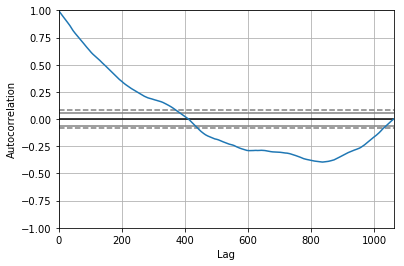

<Figure size 800x560 with 0 Axes>

Test MSE: 5.609


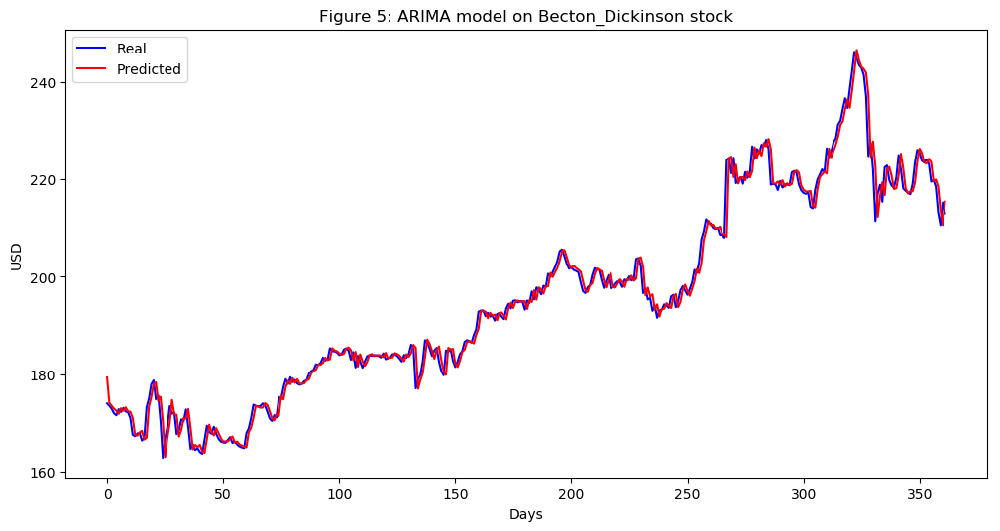

In [216]:
Becton_Dickinson_series = SP500_TechIndicator['Becton_Dickinson_Close']
Becton_Dickinson_series_model = ARIMA(Becton_Dickinson_series, order=(5, 1, 0))
Becton_Dickinson_model_fit = Becton_Dickinson_series_model.fit(disp=0)
print(Becton_Dickinson_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Becton_Dickinson_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Becton_Dickinson_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Becton_Dickinson_predictions = list()
for t in range(len(test)):
    Becton_Dickinson_series_model = ARIMA(history, order=(5,1,0))
    Becton_Dickinson_series_model_fit = Becton_Dickinson_series_model.fit(disp=0)
    Becton_Dickinson_output = Becton_Dickinson_series_model_fit.forecast()
    yhat = Becton_Dickinson_output[0]
    Becton_Dickinson_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Becton_Dickinson_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Becton_Dickinson_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Becton_Dickinson stock')
plt.legend()
plt.show()


#predictions
Becton_Dickinson_predictions = pd.DataFrame({'Becton_Dickinson_predictions':Becton_Dickinson_predictions})
#Becton_Dickinson_predictions.to_csv('Becton_Dickinson_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Biogen_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -3558.829
Method:                       css-mle   S.D. of innovations              6.926
Date:                Sun, 17 Mar 2019   AIC                           7131.658
Time:                        15:09:05   BIC                           7166.427
Sample:                             1   HQIC                          7144.835
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -0.0135      0.204     -0.066      0.947      -0.414       0.387
ar.L1.D.Biogen_Close    -0.0060      0.031     -0.197      0.844      -0.066       0.054
ar.L2.D.Biog

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


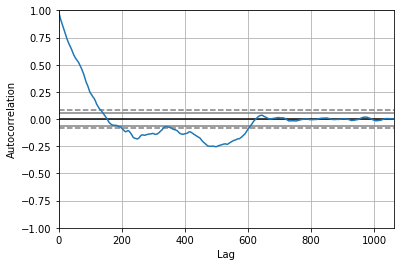

<Figure size 800x560 with 0 Axes>

Test MSE: 25.364


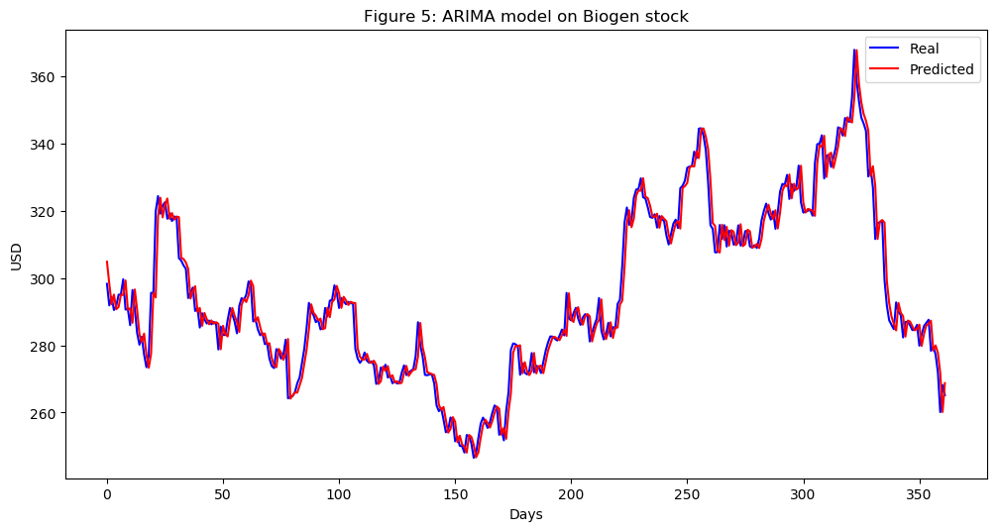

In [217]:
Biogen_series = SP500_TechIndicator['Biogen_Close']
Biogen_series_model = ARIMA(Biogen_series, order=(5, 1, 0))
Biogen_model_fit = Biogen_series_model.fit(disp=0)
print(Biogen_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Biogen_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Biogen_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Biogen_predictions = list()
for t in range(len(test)):
    Biogen_series_model = ARIMA(history, order=(5,1,0))
    Biogen_series_model_fit = Biogen_series_model.fit(disp=0)
    Biogen_output = Biogen_series_model_fit.forecast()
    yhat = Biogen_output[0]
    Biogen_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Biogen_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Biogen_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Biogen stock')
plt.legend()
plt.show()


#predictions
Biogen_predictions = pd.DataFrame({'Biogen_predictions':Biogen_predictions})
#Biogen_predictions.to_csv('Biogen_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Boston_Scientific_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood                -215.208
Method:                              css-mle   S.D. of innovations              0.296
Date:                       Sun, 17 Mar 2019   AIC                            444.416
Time:                               15:10:14   BIC                            479.185
Sample:                                    1   HQIC                           457.593
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0142      0.008      1.721      0.085      -0.002       0.030
ar.L1.D.Bost

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


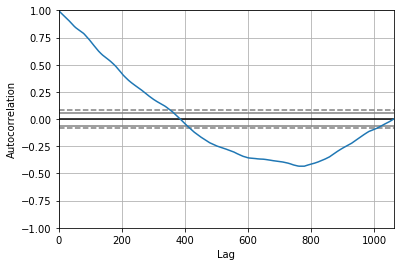

<Figure size 800x560 with 0 Axes>

Test MSE: 0.120


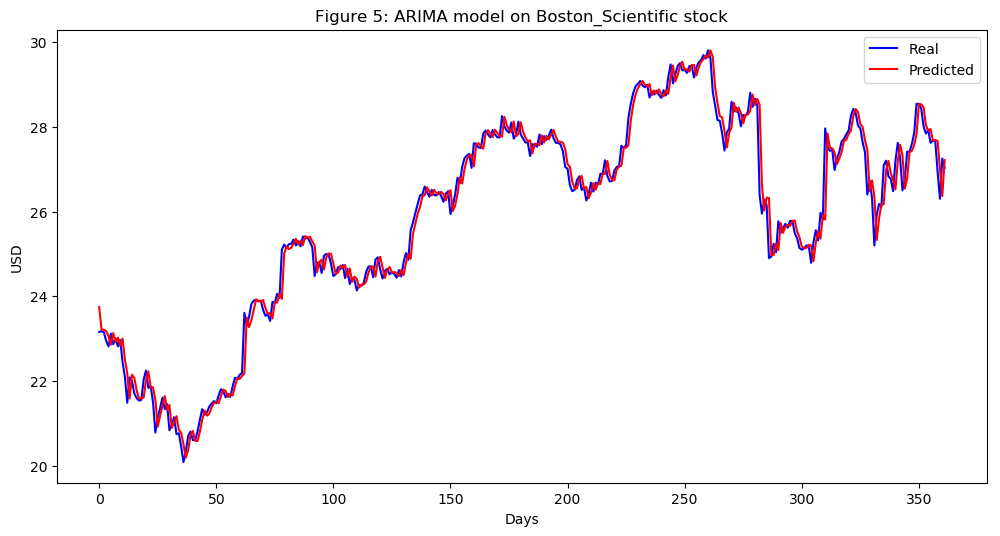

In [218]:
Boston_Scientific_series = SP500_TechIndicator['Boston_Scientific_Close']
Boston_Scientific_series_model = ARIMA(Boston_Scientific_series, order=(5, 1, 0))
Boston_Scientific_model_fit = Boston_Scientific_series_model.fit(disp=0)
print(Boston_Scientific_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Boston_Scientific_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Boston_Scientific_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Boston_Scientific_predictions = list()
for t in range(len(test)):
    Boston_Scientific_series_model = ARIMA(history, order=(5,1,0))
    Boston_Scientific_series_model_fit = Boston_Scientific_series_model.fit(disp=0)
    Boston_Scientific_output = Boston_Scientific_series_model_fit.forecast()
    yhat = Boston_Scientific_output[0]
    Boston_Scientific_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Boston_Scientific_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Boston_Scientific_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Boston_Scientific stock')
plt.legend()
plt.show()


#predictions
Boston_Scientific_predictions = pd.DataFrame({'Boston_Scientific_predictions':Boston_Scientific_predictions})
#Boston_Scientific_predictions.to_csv('Boston_Scientific_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Bristol_Myers_Squibb_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -1472.447
Method:                                 css-mle   S.D. of innovations              0.969
Date:                          Sun, 17 Mar 2019   AIC                           2958.893
Time:                                  15:11:34   BIC                           2993.662
Sample:                                       1   HQIC                          2972.070
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0087      0.029      0.299      0.765    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


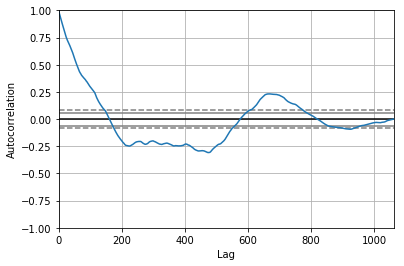

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.798


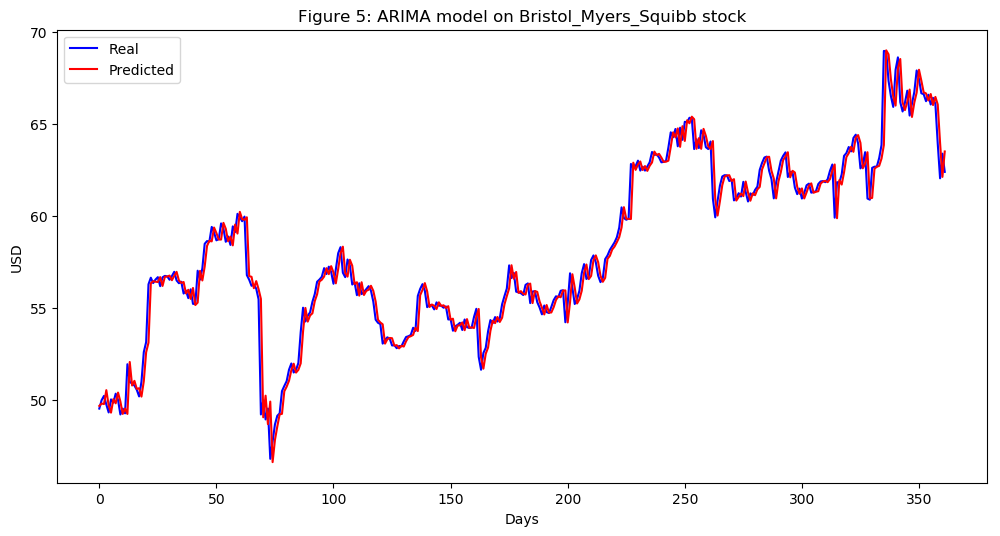

In [219]:
Bristol_Myers_Squibb_series = SP500_TechIndicator['Bristol_Myers_Squibb_Close']
Bristol_Myers_Squibb_series_model = ARIMA(Bristol_Myers_Squibb_series, order=(5, 1, 0))
Bristol_Myers_Squibb_model_fit = Bristol_Myers_Squibb_series_model.fit(disp=0)
print(Bristol_Myers_Squibb_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Bristol_Myers_Squibb_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Bristol_Myers_Squibb_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Bristol_Myers_Squibb_predictions = list()
for t in range(len(test)):
    Bristol_Myers_Squibb_series_model = ARIMA(history, order=(5,1,0))
    Bristol_Myers_Squibb_series_model_fit = Bristol_Myers_Squibb_series_model.fit(disp=0)
    Bristol_Myers_Squibb_output = Bristol_Myers_Squibb_series_model_fit.forecast()
    yhat = Bristol_Myers_Squibb_output[0]
    Bristol_Myers_Squibb_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Bristol_Myers_Squibb_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Bristol_Myers_Squibb_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Bristol_Myers_Squibb stock')
plt.legend()
plt.show()


#predictions
Bristol_Myers_Squibb_predictions = pd.DataFrame({'Bristol_Myers_Squibb_predictions':Bristol_Myers_Squibb_predictions})
#Bristol_Myers_Squibb_predictions.to_csv('Bristol_Myers_Squibb_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.Cardinal_Health_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1623.558
Method:                            css-mle   S.D. of innovations              1.118
Date:                     Sun, 17 Mar 2019   AIC                           3261.116
Time:                             15:12:43   BIC                           3295.885
Sample:                                  1   HQIC                          3274.292
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                            -0.0055      0.036     -0.152      0.879      -0.077       0.066
ar.L1.D.Cardinal_Health_Close    -

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


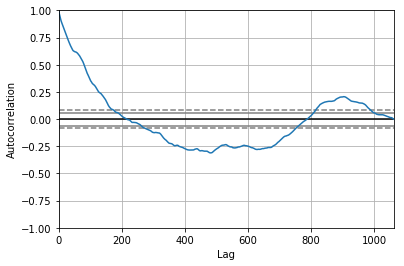

<Figure size 800x560 with 0 Axes>

Test MSE: 1.498


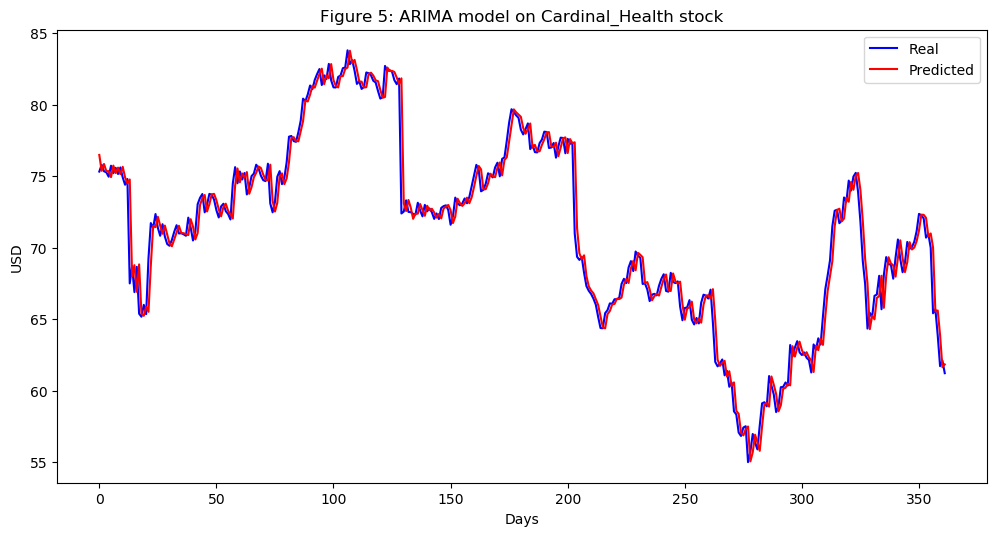

In [220]:
Cardinal_Health_series = SP500_TechIndicator['Cardinal_Health_Close']
Cardinal_Health_series_model = ARIMA(Cardinal_Health_series, order=(5, 1, 0))
Cardinal_Health_model_fit = Cardinal_Health_series_model.fit(disp=0)
print(Cardinal_Health_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Cardinal_Health_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Cardinal_Health_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Cardinal_Health_predictions = list()
for t in range(len(test)):
    Cardinal_Health_series_model = ARIMA(history, order=(5,1,0))
    Cardinal_Health_series_model_fit = Cardinal_Health_series_model.fit(disp=0)
    Cardinal_Health_output = Cardinal_Health_series_model_fit.forecast()
    yhat = Cardinal_Health_output[0]
    Cardinal_Health_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Cardinal_Health_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Cardinal_Health_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Cardinal_Health stock')
plt.legend()
plt.show()


#predictions
Cardinal_Health_predictions = pd.DataFrame({'Cardinal_Health_predictions':Cardinal_Health_predictions})
#Cardinal_Health_predictions.to_csv('Cardinal_Health_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Celgene_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2837.238
Method:                       css-mle   S.D. of innovations              3.508
Date:                Sun, 17 Mar 2019   AIC                           5688.476
Time:                        15:13:45   BIC                           5723.245
Sample:                             1   HQIC                          5701.653
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.0781      0.099     -0.786      0.432      -0.273       0.117
ar.L1.D.Celgene_Close    -0.0114      0.031     -0.372      0.710      -0.072       0.049
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


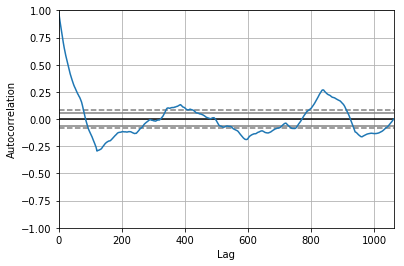

<Figure size 800x560 with 0 Axes>

Test MSE: 4.987


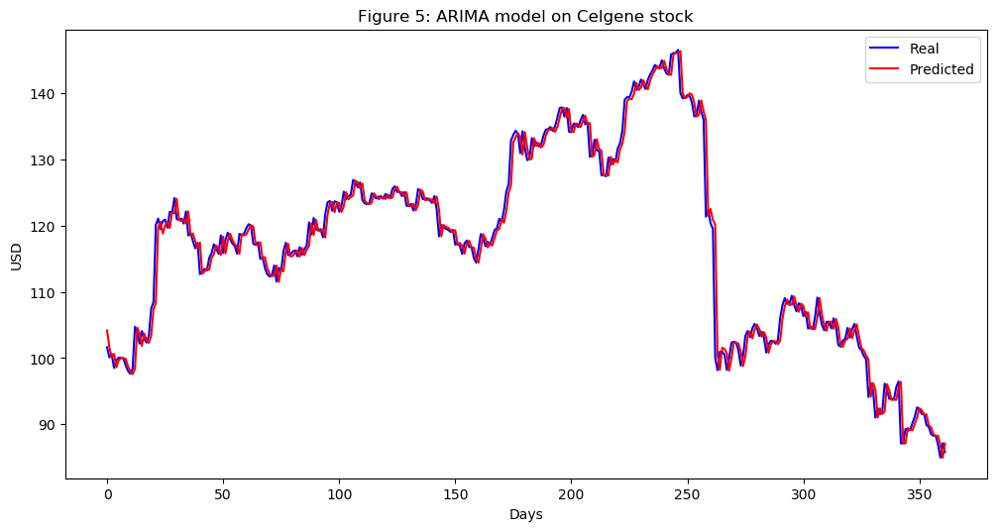

In [221]:
Celgene_series = SP500_TechIndicator['Celgene_Close']
Celgene_series_model = ARIMA(Celgene_series, order=(5, 1, 0))
Celgene_model_fit = Celgene_series_model.fit(disp=0)
print(Celgene_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Celgene_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Celgene_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Celgene_predictions = list()
for t in range(len(test)):
    Celgene_series_model = ARIMA(history, order=(5,1,0))
    Celgene_series_model_fit = Celgene_series_model.fit(disp=0)
    Celgene_output = Celgene_series_model_fit.forecast()
    yhat = Celgene_output[0]
    Celgene_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Celgene_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Celgene_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Celgene stock')
plt.legend()
plt.show()


#predictions
Celgene_predictions = pd.DataFrame({'Celgene_predictions':Celgene_predictions})
#Celgene_predictions.to_csv('Celgene_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.Centene_Corporation_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -2426.796
Method:                                css-mle   S.D. of innovations              2.383
Date:                         Sun, 17 Mar 2019   AIC                           4867.591
Time:                                 15:15:00   BIC                           4902.360
Sample:                                      1   HQIC                          4880.768
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0399      0.066      0.600      0.549      -0.090   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


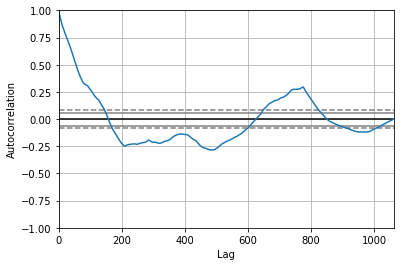

<Figure size 800x560 with 0 Axes>

Test MSE: 2.574


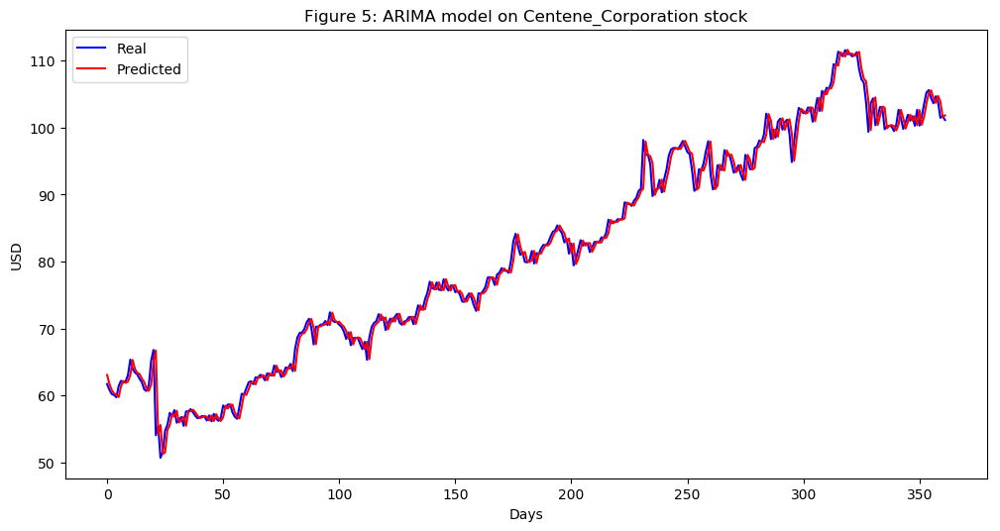

In [222]:
Centene_Corporation_series = SP500_TechIndicator['Centene_Corporation_Close']
Centene_Corporation_series_model = ARIMA(Centene_Corporation_series, order=(5, 1, 0))
Centene_Corporation_model_fit = Centene_Corporation_series_model.fit(disp=0)
print(Centene_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Centene_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Centene_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Centene_Corporation_predictions = list()
for t in range(len(test)):
    Centene_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Centene_Corporation_series_model_fit = Centene_Corporation_series_model.fit(disp=0)
    Centene_Corporation_output = Centene_Corporation_series_model_fit.forecast()
    yhat = Centene_Corporation_output[0]
    Centene_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Centene_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Centene_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Centene_Corporation stock')
plt.legend()
plt.show()


#predictions
Centene_Corporation_predictions = pd.DataFrame({'Centene_Corporation_predictions':Centene_Corporation_predictions})
#Centene_Corporation_predictions.to_csv('Centene_Corporation_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Cerner_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1396.198
Method:                       css-mle   S.D. of innovations              0.902
Date:                Sun, 17 Mar 2019   AIC                           2806.396
Time:                        15:16:00   BIC                           2841.165
Sample:                             1   HQIC                          2819.572
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0018      0.028      0.064      0.949      -0.053       0.057
ar.L1.D.Cerner_Close    -0.0012      0.031     -0.038      0.970      -0.061       0.059
ar.L2.D.Cern

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


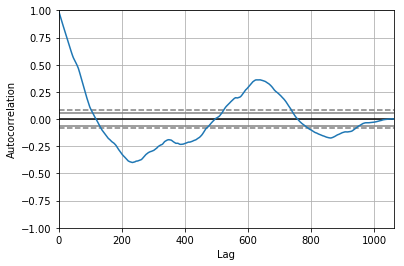

<Figure size 800x560 with 0 Axes>

Test MSE: 0.840


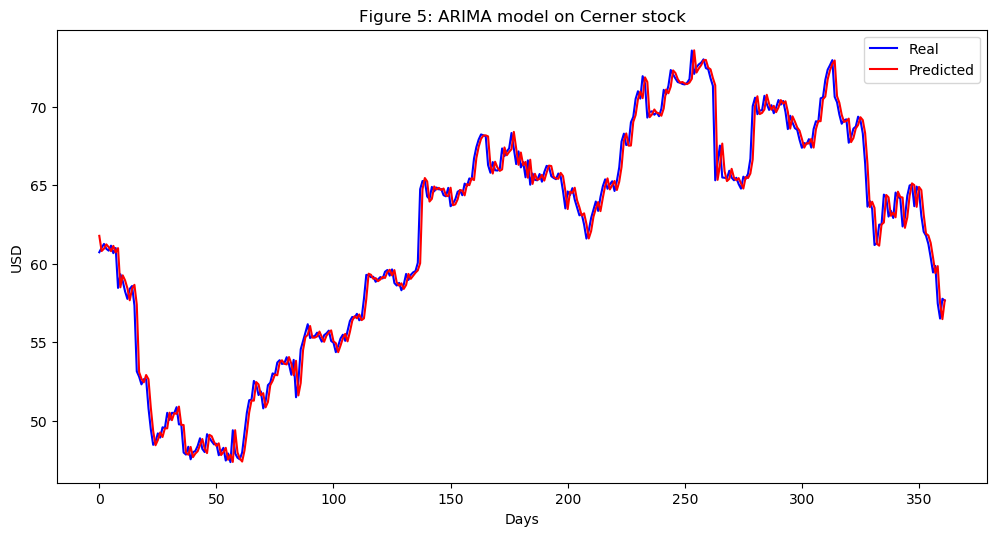

In [223]:
Cerner_series = SP500_TechIndicator['Cerner_Close']
Cerner_series_model = ARIMA(Cerner_series, order=(5, 1, 0))
Cerner_model_fit = Cerner_series_model.fit(disp=0)
print(Cerner_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Cerner_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Cerner_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Cerner_predictions = list()
for t in range(len(test)):
    Cerner_series_model = ARIMA(history, order=(5,1,0))
    Cerner_series_model_fit = Cerner_series_model.fit(disp=0)
    Cerner_output = Cerner_series_model_fit.forecast()
    yhat = Cerner_output[0]
    Cerner_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Cerner_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Cerner_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Cerner stock')
plt.legend()
plt.show()


#predictions
Cerner_predictions = pd.DataFrame({'Cerner_predictions':Cerner_predictions})
#Cerner_predictions.to_csv('Cerner_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.CIGNA_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2326.022
Method:                       css-mle   S.D. of innovations              2.167
Date:                Sun, 17 Mar 2019   AIC                           4666.045
Time:                        15:17:05   BIC                           4700.814
Sample:                             1   HQIC                          4679.221
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0737      0.064      1.155      0.249      -0.051       0.199
ar.L1.D.CIGNA_Close    -0.0246      0.031     -0.802      0.423      -0.085       0.036
ar.L2.D.CIGNA_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


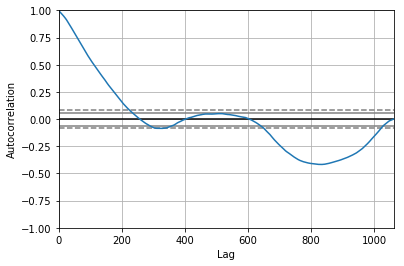

<Figure size 800x560 with 0 Axes>

Test MSE: 6.227


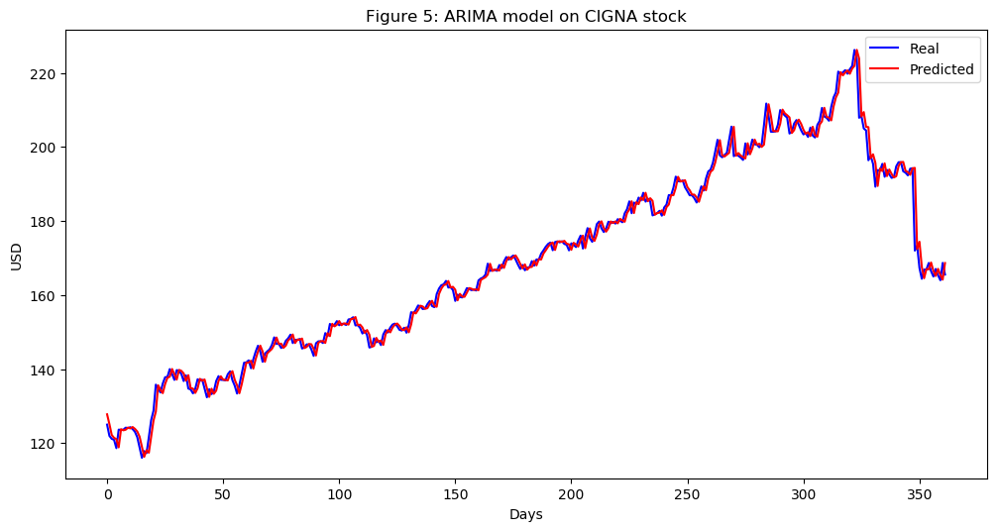

In [224]:
CIGNA_series = SP500_TechIndicator['CIGNA_Close']
CIGNA_series_model = ARIMA(CIGNA_series, order=(5, 1, 0))
CIGNA_model_fit = CIGNA_series_model.fit(disp=0)
print(CIGNA_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(CIGNA_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = CIGNA_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
CIGNA_predictions = list()
for t in range(len(test)):
    CIGNA_series_model = ARIMA(history, order=(5,1,0))
    CIGNA_series_model_fit = CIGNA_series_model.fit(disp=0)
    CIGNA_output = CIGNA_series_model_fit.forecast()
    yhat = CIGNA_output[0]
    CIGNA_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, CIGNA_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(CIGNA_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on CIGNA stock')
plt.legend()
plt.show()


#predictions
CIGNA_predictions = pd.DataFrame({'CIGNA_predictions':CIGNA_predictions})
#CIGNA_predictions.to_csv('CIGNA_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.The_Cooper_Companies_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -2486.091
Method:                                 css-mle   S.D. of innovations              2.520
Date:                          Sun, 17 Mar 2019   AIC                           4986.182
Time:                                  15:18:10   BIC                           5020.951
Sample:                                       1   HQIC                          4999.359
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0956      0.069      1.379      0.168    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


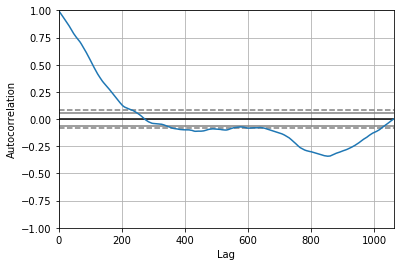

<Figure size 800x560 with 0 Axes>

Test MSE: 9.758


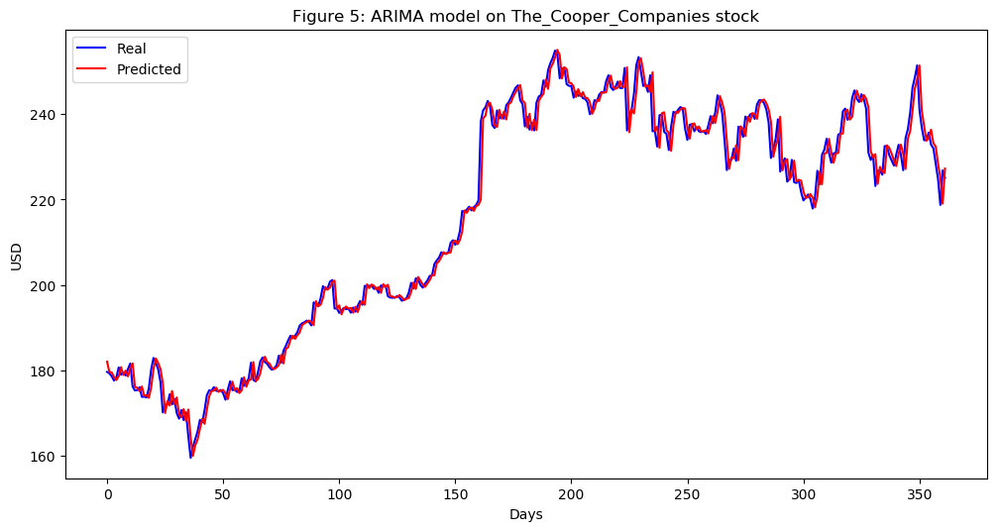

In [225]:
The_Cooper_Companies_series = SP500_TechIndicator['The_Cooper_Companies_Close']
The_Cooper_Companies_series_model = ARIMA(The_Cooper_Companies_series, order=(5, 1, 0))
The_Cooper_Companies_model_fit = The_Cooper_Companies_series_model.fit(disp=0)
print(The_Cooper_Companies_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(The_Cooper_Companies_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = The_Cooper_Companies_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
The_Cooper_Companies_predictions = list()
for t in range(len(test)):
    The_Cooper_Companies_series_model = ARIMA(history, order=(5,1,0))
    The_Cooper_Companies_series_model_fit = The_Cooper_Companies_series_model.fit(disp=0)
    The_Cooper_Companies_output = The_Cooper_Companies_series_model_fit.forecast()
    yhat = The_Cooper_Companies_output[0]
    The_Cooper_Companies_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, The_Cooper_Companies_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(The_Cooper_Companies_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on The_Cooper_Companies stock')
plt.legend()
plt.show()


#predictions
The_Cooper_Companies_predictions = pd.DataFrame({'The_Cooper_Companies_predictions':The_Cooper_Companies_predictions})
#The_Cooper_Companies_predictions.to_csv('The_Cooper_Companies_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:     D.CVS_Health_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1592.853
Method:                       css-mle   S.D. of innovations              1.086
Date:                Sun, 17 Mar 2019   AIC                           3199.707
Time:                        15:19:32   BIC                           3234.476
Sample:                             1   HQIC                          3212.883
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                       -0.0103      0.032     -0.317      0.751      -0.074       0.053
ar.L1.D.CVS_Health_Close    -0.0384      0.031     -1.249      0.212      -0.099       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


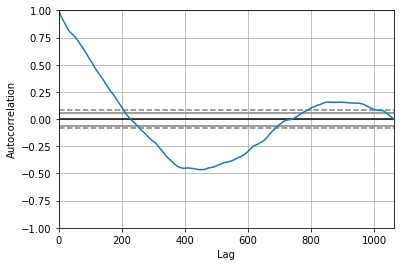

<Figure size 800x560 with 0 Axes>

Test MSE: 1.486


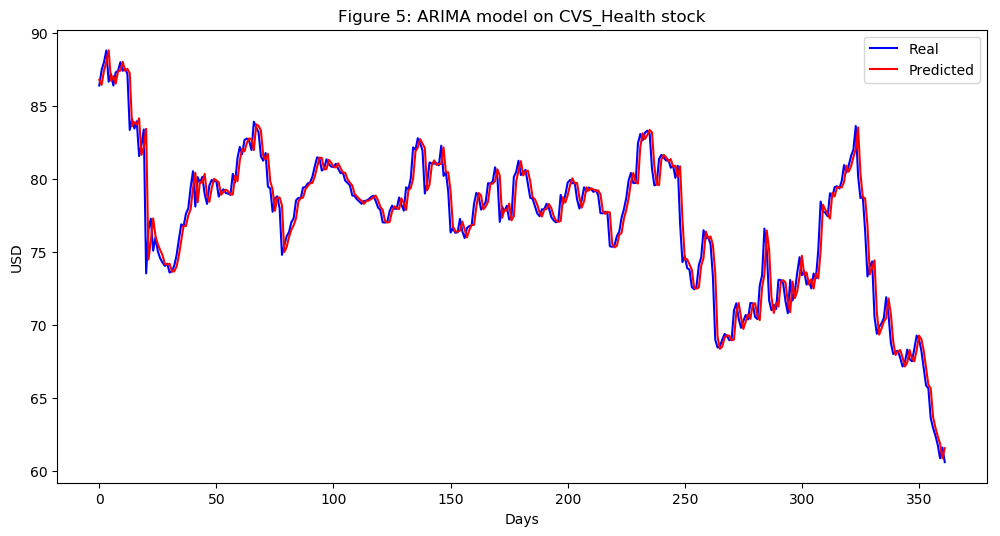

In [226]:
CVS_Health_series = SP500_TechIndicator['CVS_Health_Close']
CVS_Health_series_model = ARIMA(CVS_Health_series, order=(5, 1, 0))
CVS_Health_model_fit = CVS_Health_series_model.fit(disp=0)
print(CVS_Health_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(CVS_Health_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = CVS_Health_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
CVS_Health_predictions = list()
for t in range(len(test)):
    CVS_Health_series_model = ARIMA(history, order=(5,1,0))
    CVS_Health_series_model_fit = CVS_Health_series_model.fit(disp=0)
    CVS_Health_output = CVS_Health_series_model_fit.forecast()
    yhat = CVS_Health_output[0]
    CVS_Health_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, CVS_Health_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(CVS_Health_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on CVS_Health stock')
plt.legend()
plt.show()


#predictions
CVS_Health_predictions = pd.DataFrame({'CVS_Health_predictions':CVS_Health_predictions})
#CVS_Health_predictions.to_csv('CVS_Health_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Danaher_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1614.965
Method:                       css-mle   S.D. of innovations              1.109
Date:                Sun, 17 Mar 2019   AIC                           3243.930
Time:                        15:20:50   BIC                           3278.699
Sample:                             1   HQIC                          3257.106
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0191      0.030      0.637      0.524      -0.040       0.078
ar.L1.D.Danaher_Close    -0.0389      0.031     -1.268      0.205      -0.099       0.021
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


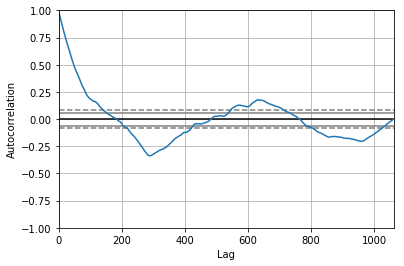

<Figure size 800x560 with 0 Axes>

Test MSE: 0.841


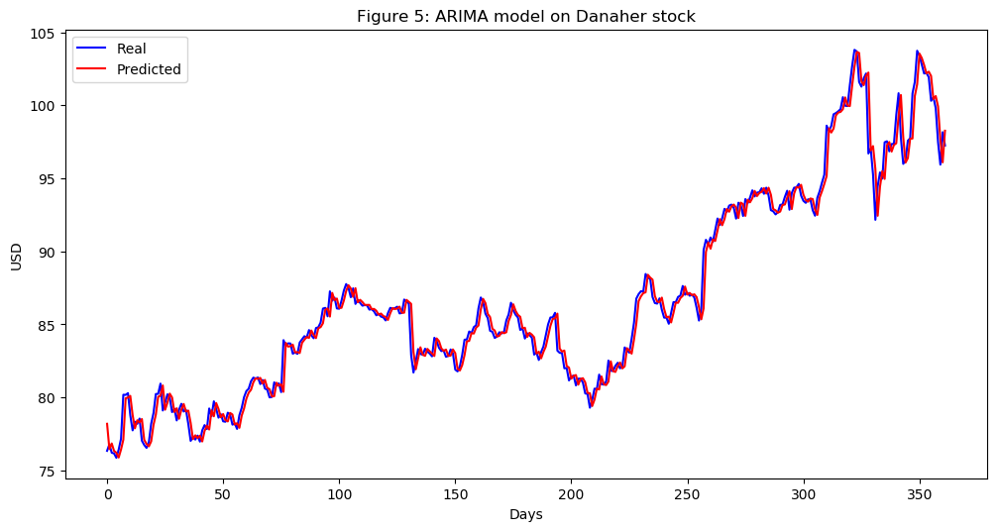

In [227]:
Danaher_series = SP500_TechIndicator['Danaher_Close']
Danaher_series_model = ARIMA(Danaher_series, order=(5, 1, 0))
Danaher_model_fit = Danaher_series_model.fit(disp=0)
print(Danaher_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Danaher_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Danaher_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Danaher_predictions = list()
for t in range(len(test)):
    Danaher_series_model = ARIMA(history, order=(5,1,0))
    Danaher_series_model_fit = Danaher_series_model.fit(disp=0)
    Danaher_output = Danaher_series_model_fit.forecast()
    yhat = Danaher_output[0]
    Danaher_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Danaher_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Danaher_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Danaher stock')
plt.legend()
plt.show()


#predictions
Danaher_predictions = pd.DataFrame({'Danaher_predictions':Danaher_predictions})
#Danaher_predictions.to_csv('Danaher_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.DaVita_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1387.329
Method:                       css-mle   S.D. of innovations              0.895
Date:                Sun, 17 Mar 2019   AIC                           2788.658
Time:                        15:21:55   BIC                           2823.427
Sample:                             1   HQIC                          2801.835
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0019      0.029      0.065      0.949      -0.056       0.059
ar.L1.D.DaVita_Close    -0.0241      0.031     -0.783      0.434      -0.084       0.036
ar.L2.D.DaVi

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


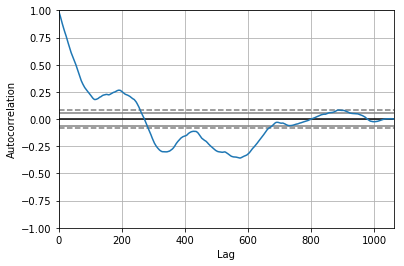

<Figure size 800x560 with 0 Axes>

Test MSE: 1.236


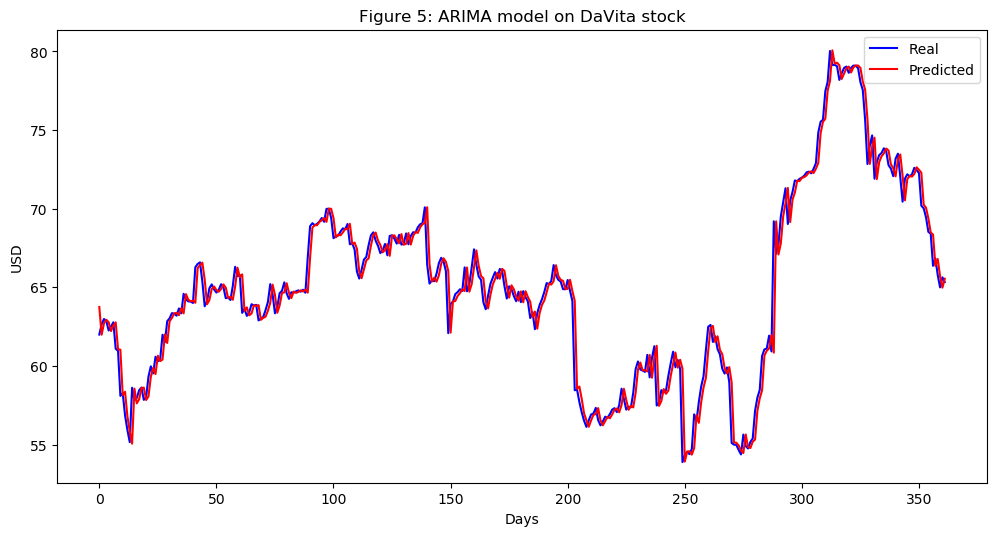

In [228]:
DaVita_series = SP500_TechIndicator['DaVita_Close']
DaVita_series_model = ARIMA(DaVita_series, order=(5, 1, 0))
DaVita_model_fit = DaVita_series_model.fit(disp=0)
print(DaVita_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(DaVita_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = DaVita_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
DaVita_predictions = list()
for t in range(len(test)):
    DaVita_series_model = ARIMA(history, order=(5,1,0))
    DaVita_series_model_fit = DaVita_series_model.fit(disp=0)
    DaVita_output = DaVita_series_model_fit.forecast()
    yhat = DaVita_output[0]
    DaVita_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, DaVita_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(DaVita_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on DaVita stock')
plt.legend()
plt.show()


#predictions
DaVita_predictions = pd.DataFrame({'DaVita_predictions':DaVita_predictions})
#DaVita_predictions.to_csv('DaVita_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.Dentsply_Sirona_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1117.295
Method:                            css-mle   S.D. of innovations              0.694
Date:                     Sun, 17 Mar 2019   AIC                           2248.591
Time:                             15:23:08   BIC                           2283.360
Sample:                                  1   HQIC                          2261.767
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0015      0.022      0.067      0.947      -0.041       0.044
ar.L1.D.Dentsply_Sirona_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


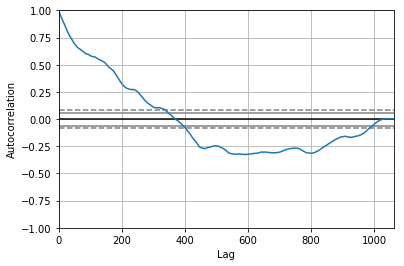

<Figure size 800x560 with 0 Axes>

Test MSE: 0.648


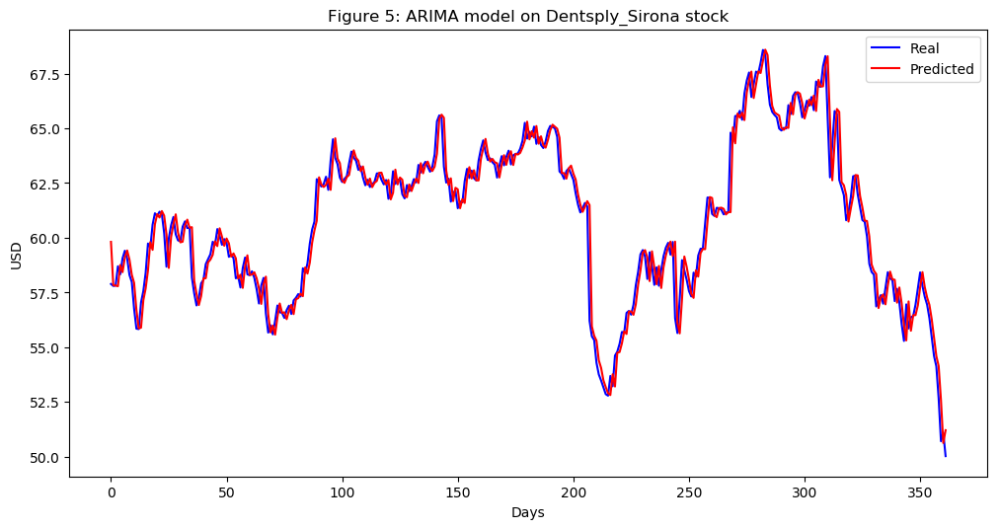

In [229]:
Dentsply_Sirona_series = SP500_TechIndicator['Dentsply_Sirona_Close']
Dentsply_Sirona_series_model = ARIMA(Dentsply_Sirona_series, order=(5, 1, 0))
Dentsply_Sirona_model_fit = Dentsply_Sirona_series_model.fit(disp=0)
print(Dentsply_Sirona_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Dentsply_Sirona_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Dentsply_Sirona_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Dentsply_Sirona_predictions = list()
for t in range(len(test)):
    Dentsply_Sirona_series_model = ARIMA(history, order=(5,1,0))
    Dentsply_Sirona_series_model_fit = Dentsply_Sirona_series_model.fit(disp=0)
    Dentsply_Sirona_output = Dentsply_Sirona_series_model_fit.forecast()
    yhat = Dentsply_Sirona_output[0]
    Dentsply_Sirona_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Dentsply_Sirona_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Dentsply_Sirona_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Dentsply_Sirona stock')
plt.legend()
plt.show()


#predictions
Dentsply_Sirona_predictions = pd.DataFrame({'Dentsply_Sirona_predictions':Dentsply_Sirona_predictions})
#Dentsply_Sirona_predictions.to_csv('Dentsply_Sirona_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Edwards_Lifesciences_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -2722.977
Method:                                 css-mle   S.D. of innovations              3.150
Date:                          Sun, 17 Mar 2019   AIC                           5459.953
Time:                                  15:24:21   BIC                           5494.722
Sample:                                       1   HQIC                          5473.130
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0679      0.097      0.703      0.482    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


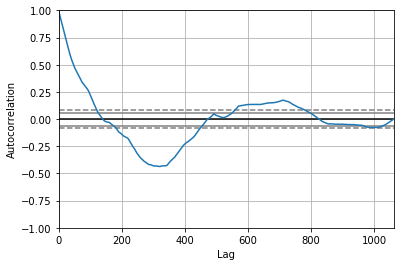

<Figure size 800x560 with 0 Axes>

Test MSE: 4.098


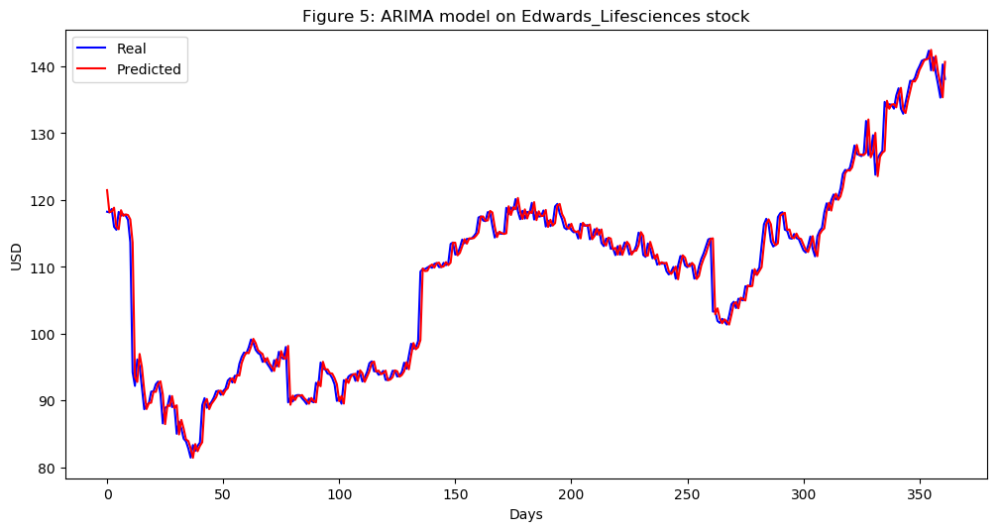

In [230]:
Edwards_Lifesciences_series = SP500_TechIndicator['Edwards_Lifesciences_Close']
Edwards_Lifesciences_series_model = ARIMA(Edwards_Lifesciences_series, order=(5, 1, 0))
Edwards_Lifesciences_model_fit = Edwards_Lifesciences_series_model.fit(disp=0)
print(Edwards_Lifesciences_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Edwards_Lifesciences_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Edwards_Lifesciences_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Edwards_Lifesciences_predictions = list()
for t in range(len(test)):
    Edwards_Lifesciences_series_model = ARIMA(history, order=(5,1,0))
    Edwards_Lifesciences_series_model_fit = Edwards_Lifesciences_series_model.fit(disp=0)
    Edwards_Lifesciences_output = Edwards_Lifesciences_series_model_fit.forecast()
    yhat = Edwards_Lifesciences_output[0]
    Edwards_Lifesciences_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Edwards_Lifesciences_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Edwards_Lifesciences_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Edwards_Lifesciences stock')
plt.legend()
plt.show()


#predictions
Edwards_Lifesciences_predictions = pd.DataFrame({'Edwards_Lifesciences_predictions':Edwards_Lifesciences_predictions})
#Edwards_Lifesciences_predictions.to_csv('Edwards_Lifesciences_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.Gilead_Sciences_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -2011.151
Method:                            css-mle   S.D. of innovations              1.611
Date:                     Sun, 17 Mar 2019   AIC                           4036.303
Time:                             15:25:36   BIC                           4071.072
Sample:                                  1   HQIC                          4049.479
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                            -0.0009      0.047     -0.018      0.985      -0.093       0.091
ar.L1.D.Gilead_Sciences_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


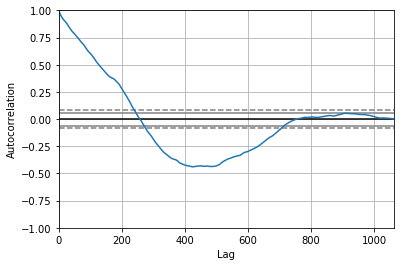

<Figure size 800x560 with 0 Axes>

Test MSE: 1.294


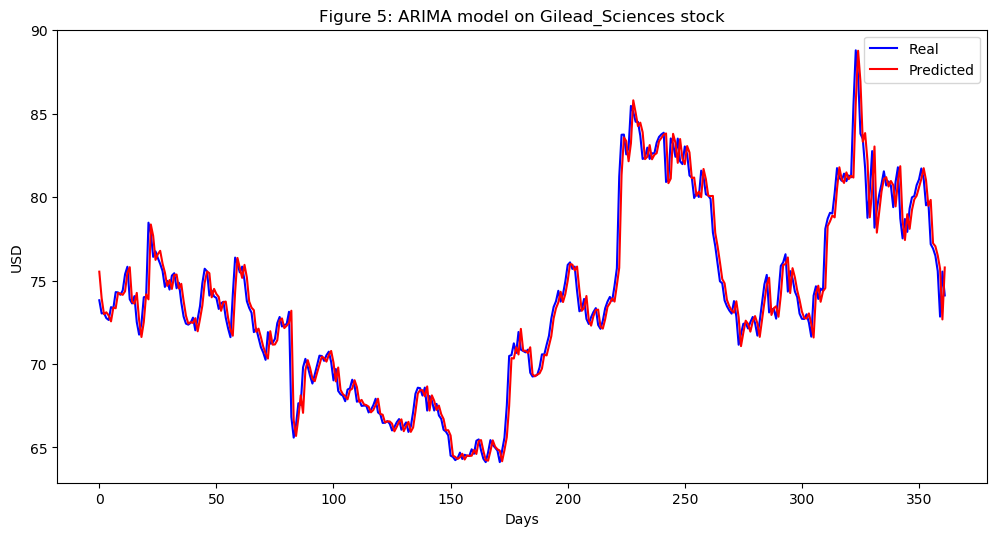

In [231]:
Gilead_Sciences_series = SP500_TechIndicator['Gilead_Sciences_Close']
Gilead_Sciences_series_model = ARIMA(Gilead_Sciences_series, order=(5, 1, 0))
Gilead_Sciences_model_fit = Gilead_Sciences_series_model.fit(disp=0)
print(Gilead_Sciences_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Gilead_Sciences_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Gilead_Sciences_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Gilead_Sciences_predictions = list()
for t in range(len(test)):
    Gilead_Sciences_series_model = ARIMA(history, order=(5,1,0))
    Gilead_Sciences_series_model_fit = Gilead_Sciences_series_model.fit(disp=0)
    Gilead_Sciences_output = Gilead_Sciences_series_model_fit.forecast()
    yhat = Gilead_Sciences_output[0]
    Gilead_Sciences_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Gilead_Sciences_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Gilead_Sciences_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Gilead_Sciences stock')
plt.legend()
plt.show()


#predictions
Gilead_Sciences_predictions = pd.DataFrame({'Gilead_Sciences_predictions':Gilead_Sciences_predictions})
#Gilead_Sciences_predictions.to_csv('Gilead_Sciences_predictions.csv')



                              ARIMA Model Results                               
Dep. Variable:     D.HCA_Holdings_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -1702.027
Method:                         css-mle   S.D. of innovations              1.203
Date:                  Sun, 17 Mar 2019   AIC                           3418.053
Time:                          15:26:49   BIC                           3452.822
Sample:                               1   HQIC                          3431.230
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                          0.0470      0.032      1.460      0.145      -0.016       0.110
ar.L1.D.HCA_Holdings_Close    -0.0236      0.031     -0.769      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


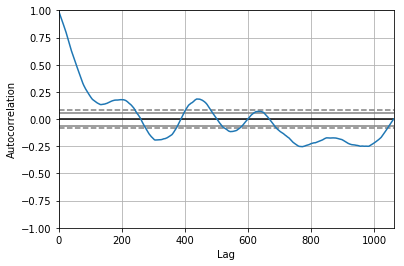

<Figure size 800x560 with 0 Axes>

Test MSE: 1.628


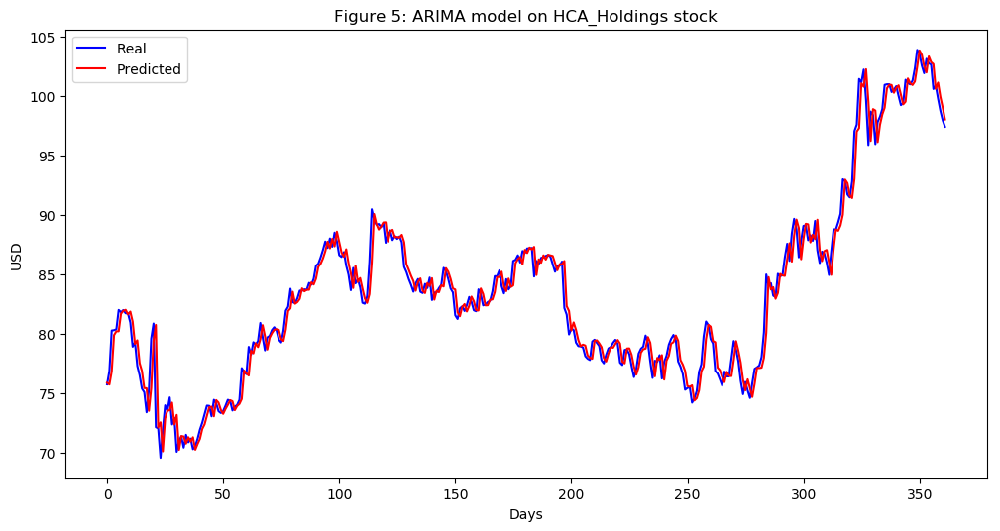

In [232]:
HCA_Holdings_series = SP500_TechIndicator['HCA_Holdings_Close']
HCA_Holdings_series_model = ARIMA(HCA_Holdings_series, order=(5, 1, 0))
HCA_Holdings_model_fit = HCA_Holdings_series_model.fit(disp=0)
print(HCA_Holdings_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(HCA_Holdings_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = HCA_Holdings_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
HCA_Holdings_predictions = list()
for t in range(len(test)):
    HCA_Holdings_series_model = ARIMA(history, order=(5,1,0))
    HCA_Holdings_series_model_fit = HCA_Holdings_series_model.fit(disp=0)
    HCA_Holdings_output = HCA_Holdings_series_model_fit.forecast()
    yhat = HCA_Holdings_output[0]
    HCA_Holdings_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, HCA_Holdings_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(HCA_Holdings_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on HCA_Holdings stock')
plt.legend()
plt.show()


#predictions
HCA_Holdings_predictions = pd.DataFrame({'HCA_Holdings_predictions':HCA_Holdings_predictions})
#HCA_Holdings_predictions.to_csv('HCA_Holdings_predictions.csv')



                              ARIMA Model Results                               
Dep. Variable:     D.Henry_Schein_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -2640.435
Method:                         css-mle   S.D. of innovations              2.914
Date:                  Sun, 17 Mar 2019   AIC                           5294.870
Time:                          15:28:06   BIC                           5329.639
Sample:                               1   HQIC                          5308.047
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                         -0.0465      0.099     -0.470      0.638      -0.240       0.147
ar.L1.D.Henry_Schein_Close     0.0658      0.031      2.146      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


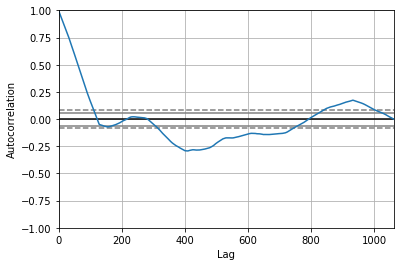

<Figure size 800x560 with 0 Axes>

Test MSE: 21.349


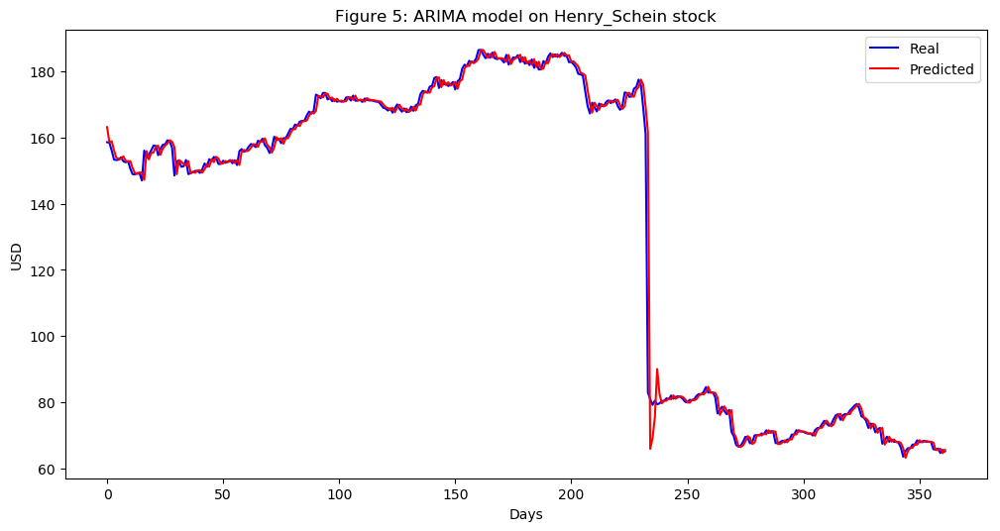

In [233]:
Henry_Schein_series = SP500_TechIndicator['Henry_Schein_Close']
Henry_Schein_series_model = ARIMA(Henry_Schein_series, order=(5, 1, 0))
Henry_Schein_model_fit = Henry_Schein_series_model.fit(disp=0)
print(Henry_Schein_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Henry_Schein_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Henry_Schein_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Henry_Schein_predictions = list()
for t in range(len(test)):
    Henry_Schein_series_model = ARIMA(history, order=(5,1,0))
    Henry_Schein_series_model_fit = Henry_Schein_series_model.fit(disp=0)
    Henry_Schein_output = Henry_Schein_series_model_fit.forecast()
    yhat = Henry_Schein_output[0]
    Henry_Schein_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Henry_Schein_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Henry_Schein_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Henry_Schein stock')
plt.legend()
plt.show()


#predictions
Henry_Schein_predictions = pd.DataFrame({'Henry_Schein_predictions':Henry_Schein_predictions})
#Henry_Schein_predictions.to_csv('Henry_Schein_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Hologic_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -817.179
Method:                       css-mle   S.D. of innovations              0.523
Date:                Sun, 17 Mar 2019   AIC                           1648.357
Time:                        15:29:20   BIC                           1683.126
Sample:                             1   HQIC                          1661.534
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0144      0.015      0.960      0.337      -0.015       0.044
ar.L1.D.Hologic_Close     0.0005      0.031      0.017      0.987      -0.060       0.061
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


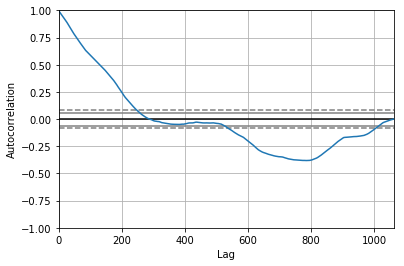

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.294


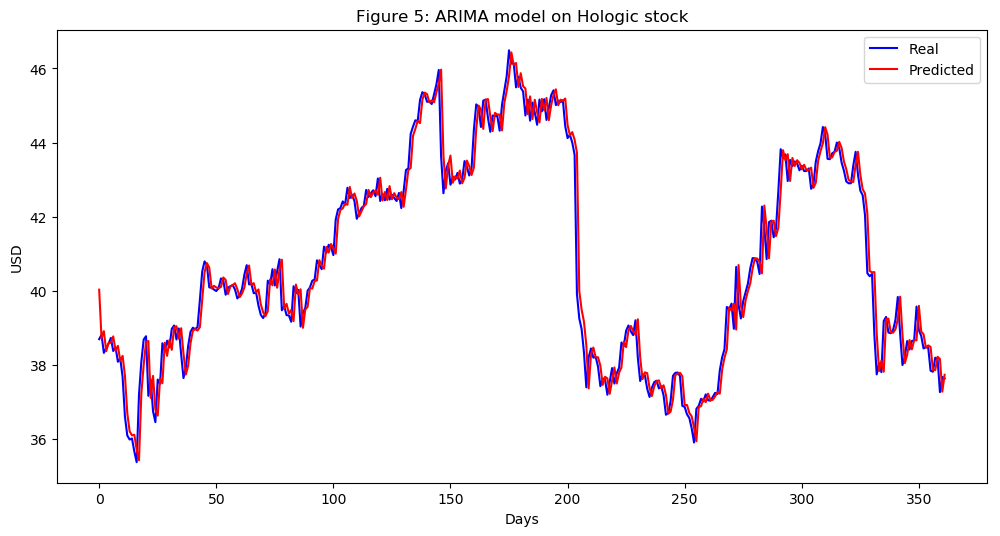

In [234]:
Hologic_series = SP500_TechIndicator['Hologic_Close']
Hologic_series_model = ARIMA(Hologic_series, order=(5, 1, 0))
Hologic_model_fit = Hologic_series_model.fit(disp=0)
print(Hologic_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Hologic_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Hologic_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Hologic_predictions = list()
for t in range(len(test)):
    Hologic_series_model = ARIMA(history, order=(5,1,0))
    Hologic_series_model_fit = Hologic_series_model.fit(disp=0)
    Hologic_output = Hologic_series_model_fit.forecast()
    yhat = Hologic_output[0]
    Hologic_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Hologic_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Hologic_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Hologic stock')
plt.legend()
plt.show()


#predictions
Hologic_predictions = pd.DataFrame({'Hologic_predictions':Hologic_predictions})
#Hologic_predictions.to_csv('Hologic_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Humana_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2649.392
Method:                       css-mle   S.D. of innovations              2.939
Date:                Sun, 17 Mar 2019   AIC                           5312.784
Time:                        15:30:58   BIC                           5347.553
Sample:                             1   HQIC                          5325.961
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.1547      0.096      1.608      0.108      -0.034       0.343
ar.L1.D.Humana_Close     0.0292      0.031      0.952      0.341      -0.031       0.089
ar.L2.D.Huma

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


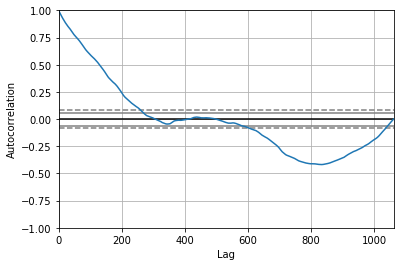

<Figure size 800x560 with 0 Axes>

Test MSE: 8.505


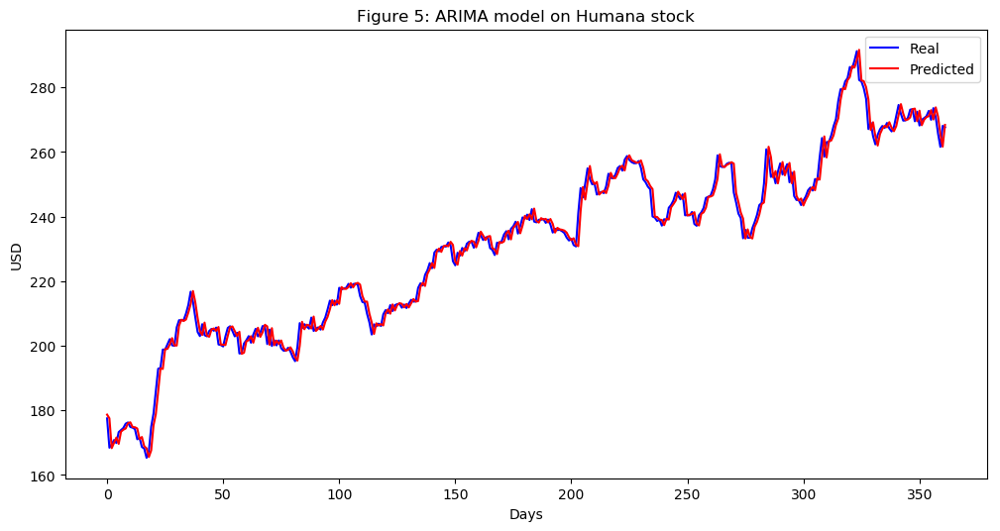

In [235]:
Humana_series = SP500_TechIndicator['Humana_Close']
Humana_series_model = ARIMA(Humana_series, order=(5, 1, 0))
Humana_model_fit = Humana_series_model.fit(disp=0)
print(Humana_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Humana_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Humana_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Humana_predictions = list()
for t in range(len(test)):
    Humana_series_model = ARIMA(history, order=(5,1,0))
    Humana_series_model_fit = Humana_series_model.fit(disp=0)
    Humana_output = Humana_series_model_fit.forecast()
    yhat = Humana_output[0]
    Humana_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Humana_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Humana_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Humana stock')
plt.legend()
plt.show()


#predictions
Humana_predictions = pd.DataFrame({'Humana_predictions':Humana_predictions})
#Humana_predictions.to_csv('Humana_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.IDEXX_Laboratories_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -2646.596
Method:                               css-mle   S.D. of innovations              2.931
Date:                        Sun, 17 Mar 2019   AIC                           5307.193
Time:                                15:32:14   BIC                           5341.962
Sample:                                     1   HQIC                          5320.369
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0795      0.094      0.847      0.397      -0.104       0.263
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


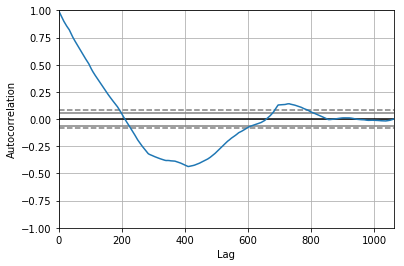

<Figure size 800x560 with 0 Axes>

Test MSE: 6.025


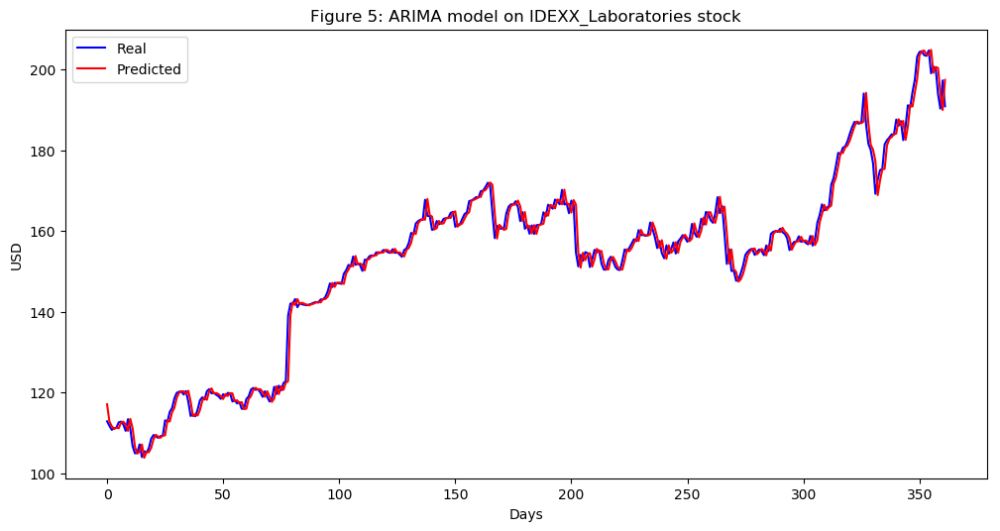

In [236]:
IDEXX_Laboratories_series = SP500_TechIndicator['IDEXX_Laboratories_Close']
IDEXX_Laboratories_series_model = ARIMA(IDEXX_Laboratories_series, order=(5, 1, 0))
IDEXX_Laboratories_model_fit = IDEXX_Laboratories_series_model.fit(disp=0)
print(IDEXX_Laboratories_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(IDEXX_Laboratories_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = IDEXX_Laboratories_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
IDEXX_Laboratories_predictions = list()
for t in range(len(test)):
    IDEXX_Laboratories_series_model = ARIMA(history, order=(5,1,0))
    IDEXX_Laboratories_series_model_fit = IDEXX_Laboratories_series_model.fit(disp=0)
    IDEXX_Laboratories_output = IDEXX_Laboratories_series_model_fit.forecast()
    yhat = IDEXX_Laboratories_output[0]
    IDEXX_Laboratories_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, IDEXX_Laboratories_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(IDEXX_Laboratories_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on IDEXX_Laboratories stock')
plt.legend()
plt.show()


#predictions
IDEXX_Laboratories_predictions = pd.DataFrame({'IDEXX_Laboratories_predictions':IDEXX_Laboratories_predictions})
#IDEXX_Laboratories_predictions.to_csv('IDEXX_Laboratories_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Illumina_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -3041.221
Method:                       css-mle   S.D. of innovations              4.252
Date:                Sun, 17 Mar 2019   AIC                           6096.441
Time:                        15:33:27   BIC                           6131.210
Sample:                             1   HQIC                          6109.618
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.1196      0.125      0.955      0.340      -0.126       0.365
ar.L1.D.Illumina_Close    -0.0202      0.031     -0.657      0.512      -0.080       0.040
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


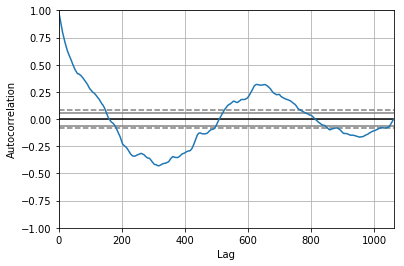

<Figure size 800x560 with 0 Axes>

Test MSE: 18.208


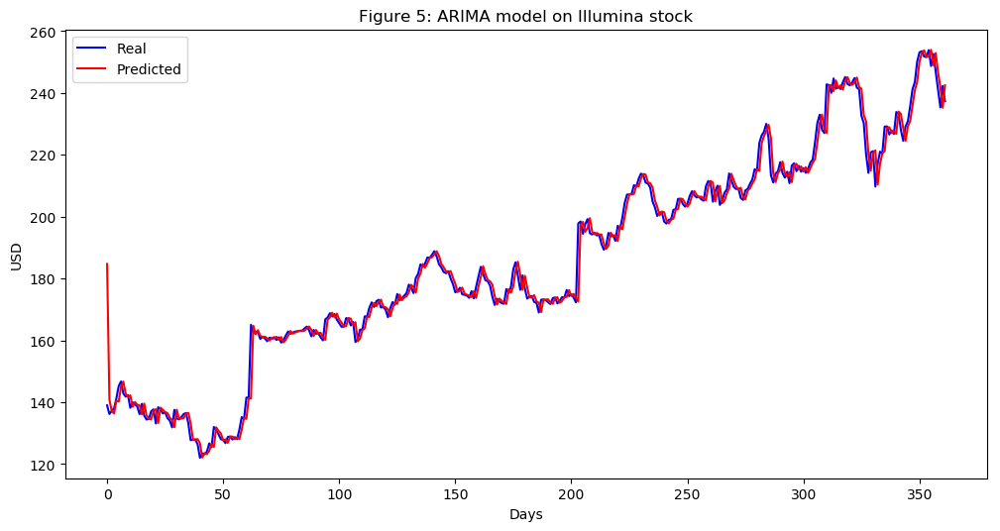

In [237]:
Illumina_series = SP500_TechIndicator['Illumina_Close']
Illumina_series_model = ARIMA(Illumina_series, order=(5, 1, 0))
Illumina_model_fit = Illumina_series_model.fit(disp=0)
print(Illumina_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Illumina_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Illumina_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Illumina_predictions = list()
for t in range(len(test)):
    Illumina_series_model = ARIMA(history, order=(5,1,0))
    Illumina_series_model_fit = Illumina_series_model.fit(disp=0)
    Illumina_output = Illumina_series_model_fit.forecast()
    yhat = Illumina_output[0]
    Illumina_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Illumina_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Illumina_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Illumina stock')
plt.legend()
plt.show()


#predictions
Illumina_predictions = pd.DataFrame({'Illumina_predictions':Illumina_predictions})
#Illumina_predictions.to_csv('Illumina_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Incyte_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2533.639
Method:                       css-mle   S.D. of innovations              2.635
Date:                Sun, 17 Mar 2019   AIC                           5081.279
Time:                        15:34:40   BIC                           5116.048
Sample:                             1   HQIC                          5094.455
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0325      0.076      0.430      0.667      -0.116       0.181
ar.L1.D.Incyte_Close     0.0377      0.031      1.230      0.219      -0.022       0.098
ar.L2.D.Incy

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


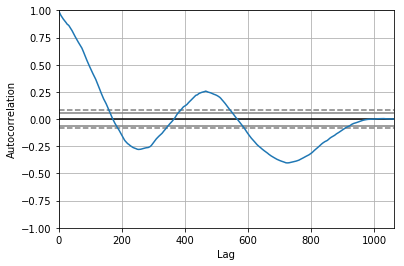

<Figure size 800x560 with 0 Axes>

Test MSE: 8.343


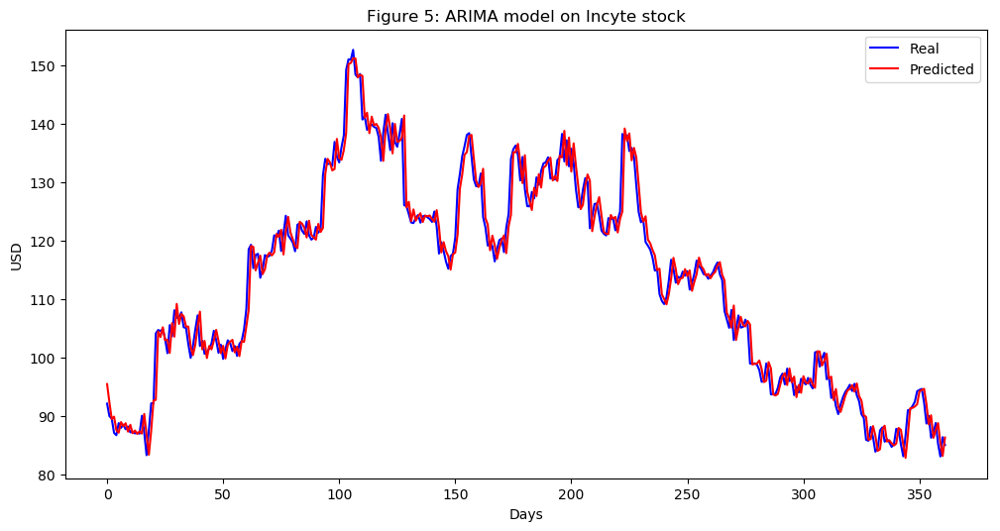

In [238]:
Incyte_series = SP500_TechIndicator['Incyte_Close']
Incyte_series_model = ARIMA(Incyte_series, order=(5, 1, 0))
Incyte_model_fit = Incyte_series_model.fit(disp=0)
print(Incyte_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Incyte_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Incyte_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Incyte_predictions = list()
for t in range(len(test)):
    Incyte_series_model = ARIMA(history, order=(5,1,0))
    Incyte_series_model_fit = Incyte_series_model.fit(disp=0)
    Incyte_output = Incyte_series_model_fit.forecast()
    yhat = Incyte_output[0]
    Incyte_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Incyte_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Incyte_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Incyte stock')
plt.legend()
plt.show()


#predictions
Incyte_predictions = pd.DataFrame({'Incyte_predictions':Incyte_predictions})
#Incyte_predictions.to_csv('Incyte_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Intuitive_Surgical_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -4875.823
Method:                               css-mle   S.D. of innovations             23.964
Date:                        Sun, 17 Mar 2019   AIC                           9765.645
Time:                                15:35:51   BIC                           9800.414
Sample:                                     1   HQIC                          9778.822
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0216      0.684      0.032      0.975      -1.318       1.362
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


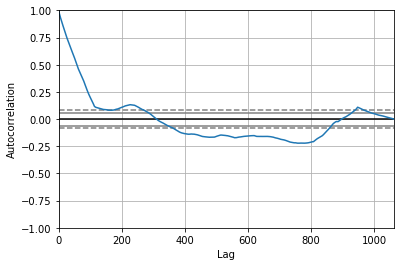

<Figure size 800x560 with 0 Axes>

Test MSE: 1679.958


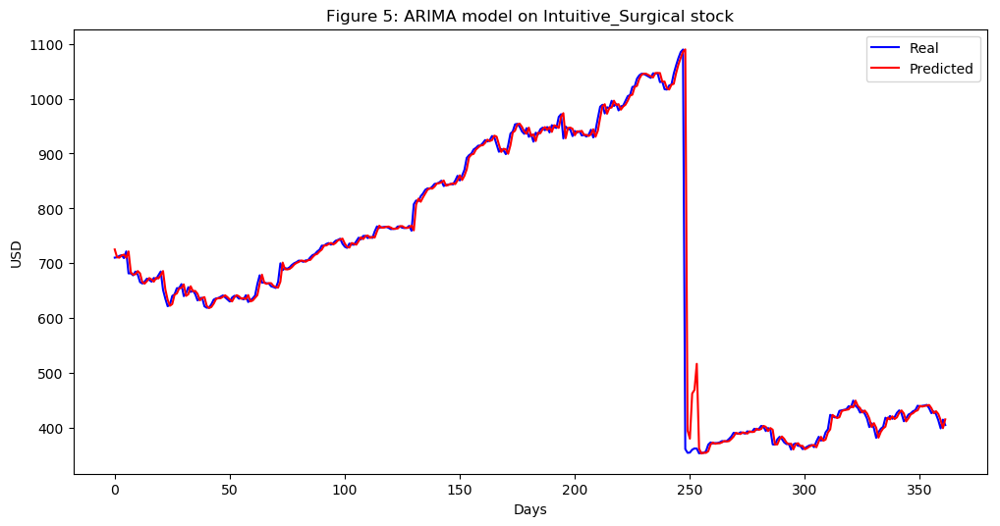

In [239]:
Intuitive_Surgical_series = SP500_TechIndicator['Intuitive_Surgical_Close']
Intuitive_Surgical_series_model = ARIMA(Intuitive_Surgical_series, order=(5, 1, 0))
Intuitive_Surgical_model_fit = Intuitive_Surgical_series_model.fit(disp=0)
print(Intuitive_Surgical_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Intuitive_Surgical_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Intuitive_Surgical_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Intuitive_Surgical_predictions = list()
for t in range(len(test)):
    Intuitive_Surgical_series_model = ARIMA(history, order=(5,1,0))
    Intuitive_Surgical_series_model_fit = Intuitive_Surgical_series_model.fit(disp=0)
    Intuitive_Surgical_output = Intuitive_Surgical_series_model_fit.forecast()
    yhat = Intuitive_Surgical_output[0]
    Intuitive_Surgical_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Intuitive_Surgical_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Intuitive_Surgical_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Intuitive_Surgical stock')
plt.legend()
plt.show()


#predictions
Intuitive_Surgical_predictions = pd.DataFrame({'Intuitive_Surgical_predictions':Intuitive_Surgical_predictions})
#Intuitive_Surgical_predictions.to_csv('Intuitive_Surgical_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.Johnson_Johnson_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1558.748
Method:                            css-mle   S.D. of innovations              1.051
Date:                     Sun, 17 Mar 2019   AIC                           3131.496
Time:                             15:37:16   BIC                           3166.265
Sample:                                  1   HQIC                          3144.673
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0336      0.033      1.008      0.314      -0.032       0.099
ar.L1.D.Johnson_Johnson_Close    -

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


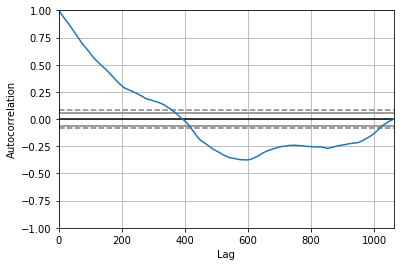

<Figure size 800x560 with 0 Axes>

Test MSE: 1.553


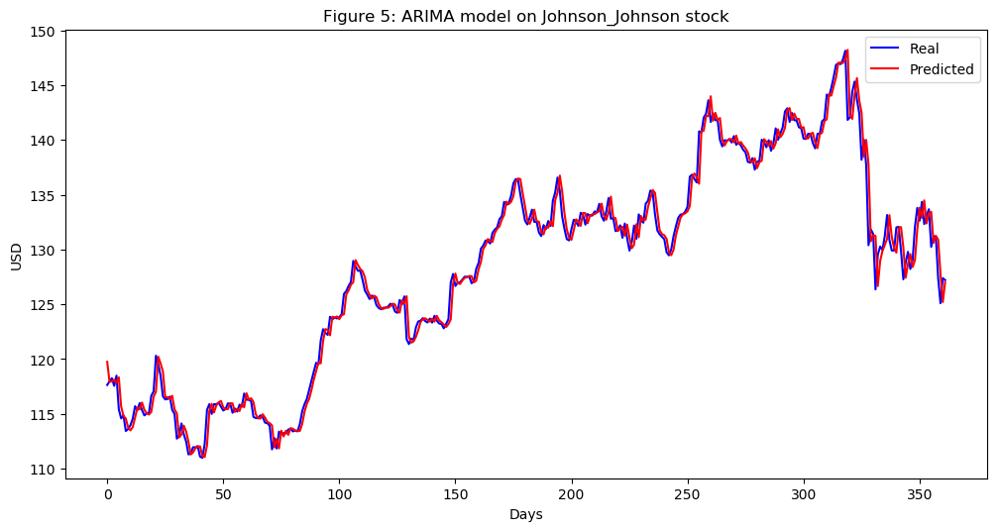

In [240]:
Johnson_Johnson_series = SP500_TechIndicator['Johnson_Johnson_Close']
Johnson_Johnson_series_model = ARIMA(Johnson_Johnson_series, order=(5, 1, 0))
Johnson_Johnson_model_fit = Johnson_Johnson_series_model.fit(disp=0)
print(Johnson_Johnson_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Johnson_Johnson_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Johnson_Johnson_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Johnson_Johnson_predictions = list()
for t in range(len(test)):
    Johnson_Johnson_series_model = ARIMA(history, order=(5,1,0))
    Johnson_Johnson_series_model_fit = Johnson_Johnson_series_model.fit(disp=0)
    Johnson_Johnson_output = Johnson_Johnson_series_model_fit.forecast()
    yhat = Johnson_Johnson_output[0]
    Johnson_Johnson_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Johnson_Johnson_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Johnson_Johnson_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Johnson_Johnson stock')
plt.legend()
plt.show()


#predictions
Johnson_Johnson_predictions = pd.DataFrame({'Johnson_Johnson_predictions':Johnson_Johnson_predictions})
#Johnson_Johnson_predictions.to_csv('Johnson_Johnson_predictions.csv')



                                     ARIMA Model Results                                      
Dep. Variable:     D.Laboratory_America_Holding_Close   No. Observations:                 1061
Model:                                 ARIMA(5, 1, 0)   Log Likelihood               -1955.248
Method:                                       css-mle   S.D. of innovations              1.528
Date:                                Sun, 17 Mar 2019   AIC                           3924.497
Time:                                        15:38:32   BIC                           3959.265
Sample:                                             1   HQIC                          3937.673
                                                                                              
                                               coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------
const                 

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


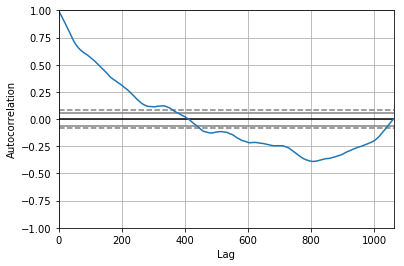

<Figure size 800x560 with 0 Axes>

Test MSE: 3.159


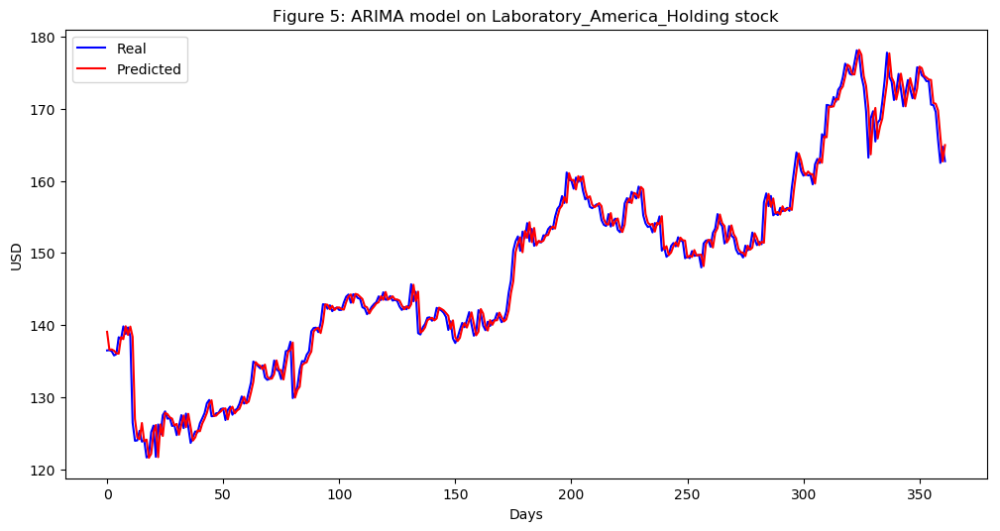

In [241]:
Laboratory_America_Holding_series = SP500_TechIndicator['Laboratory_America_Holding_Close']
Laboratory_America_Holding_series_model = ARIMA(Laboratory_America_Holding_series, order=(5, 1, 0))
Laboratory_America_Holding_model_fit = Laboratory_America_Holding_series_model.fit(disp=0)
print(Laboratory_America_Holding_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Laboratory_America_Holding_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Laboratory_America_Holding_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Laboratory_America_Holding_predictions = list()
for t in range(len(test)):
    Laboratory_America_Holding_series_model = ARIMA(history, order=(5,1,0))
    Laboratory_America_Holding_series_model_fit = Laboratory_America_Holding_series_model.fit(disp=0)
    Laboratory_America_Holding_output = Laboratory_America_Holding_series_model_fit.forecast()
    yhat = Laboratory_America_Holding_output[0]
    Laboratory_America_Holding_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Laboratory_America_Holding_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Laboratory_America_Holding_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Laboratory_America_Holding stock')
plt.legend()
plt.show()


#predictions
Laboratory_America_Holding_predictions = pd.DataFrame({'Laboratory_America_Holding_predictions':Laboratory_America_Holding_predictions})
#Laboratory_America_Holding_predictions.to_csv('Laboratory_America_Holding_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Lilly_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1558.620
Method:                       css-mle   S.D. of innovations              1.051
Date:                Sun, 17 Mar 2019   AIC                           3131.240
Time:                        15:39:38   BIC                           3166.009
Sample:                             1   HQIC                          3144.417
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0232      0.030      0.774      0.439      -0.036       0.082
ar.L1.D.Lilly_Close    -0.0620      0.031     -2.023      0.043      -0.122      -0.002
ar.L2.D.Lilly_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


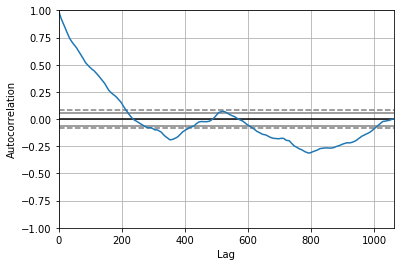

<Figure size 800x560 with 0 Axes>

Test MSE: 1.083


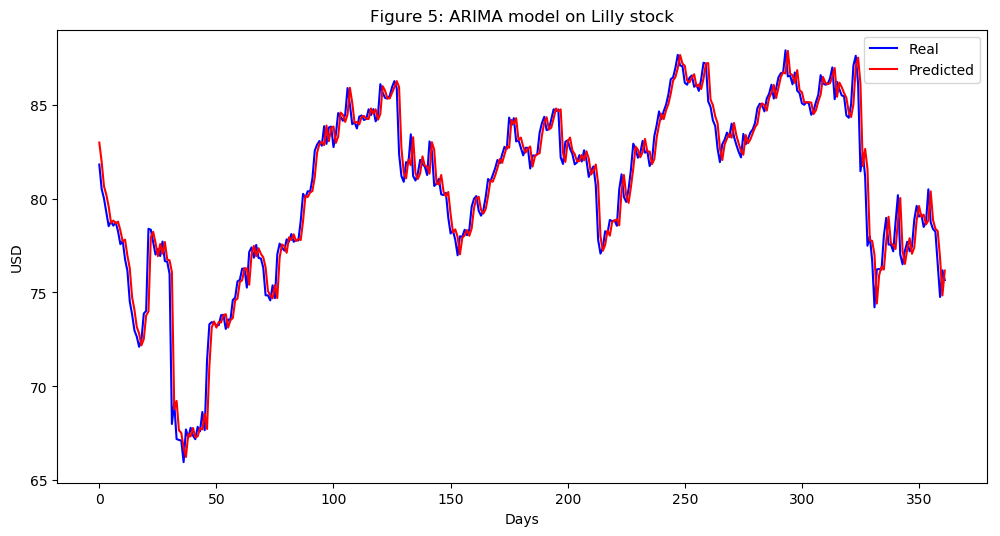

In [242]:
Lilly_series = SP500_TechIndicator['Lilly_Close']
Lilly_series_model = ARIMA(Lilly_series, order=(5, 1, 0))
Lilly_model_fit = Lilly_series_model.fit(disp=0)
print(Lilly_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Lilly_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Lilly_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Lilly_predictions = list()
for t in range(len(test)):
    Lilly_series_model = ARIMA(history, order=(5,1,0))
    Lilly_series_model_fit = Lilly_series_model.fit(disp=0)
    Lilly_output = Lilly_series_model_fit.forecast()
    yhat = Lilly_output[0]
    Lilly_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Lilly_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Lilly_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Lilly stock')
plt.legend()
plt.show()


#predictions
Lilly_predictions = pd.DataFrame({'Lilly_predictions':Lilly_predictions})
#Lilly_predictions.to_csv('Lilly_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.McKesson_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2616.883
Method:                       css-mle   S.D. of innovations              2.850
Date:                Sun, 17 Mar 2019   AIC                           5247.766
Time:                        15:40:35   BIC                           5282.535
Sample:                             1   HQIC                          5260.943
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     -0.0214      0.089     -0.239      0.811      -0.197       0.154
ar.L1.D.McKesson_Close    -0.0152      0.031     -0.495      0.621      -0.075       0.045
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


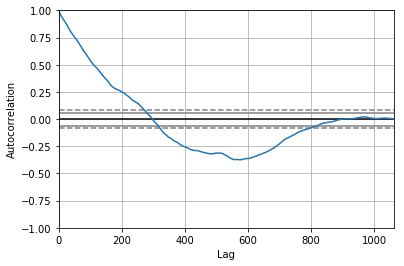

<Figure size 800x560 with 0 Axes>

Test MSE: 9.784


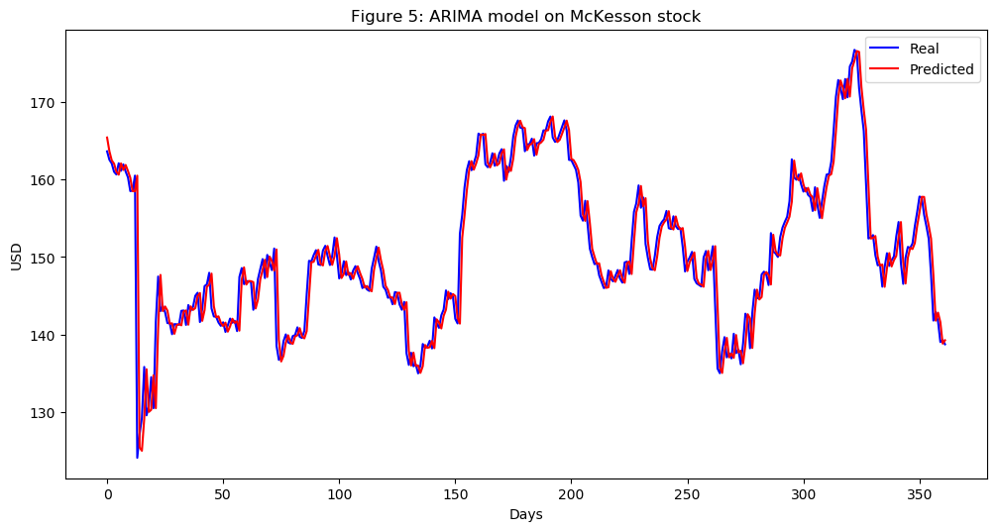

In [243]:
McKesson_series = SP500_TechIndicator['McKesson_Close']
McKesson_series_model = ARIMA(McKesson_series, order=(5, 1, 0))
McKesson_model_fit = McKesson_series_model.fit(disp=0)
print(McKesson_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(McKesson_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = McKesson_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
McKesson_predictions = list()
for t in range(len(test)):
    McKesson_series_model = ARIMA(history, order=(5,1,0))
    McKesson_series_model_fit = McKesson_series_model.fit(disp=0)
    McKesson_output = McKesson_series_model_fit.forecast()
    yhat = McKesson_output[0]
    McKesson_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, McKesson_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(McKesson_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on McKesson stock')
plt.legend()
plt.show()


#predictions
McKesson_predictions = pd.DataFrame({'McKesson_predictions':McKesson_predictions})
#McKesson_predictions.to_csv('McKesson_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:      D.Medtronic_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1370.900
Method:                       css-mle   S.D. of innovations              0.881
Date:                Sun, 17 Mar 2019   AIC                           2755.800
Time:                        15:41:23   BIC                           2790.569
Sample:                             1   HQIC                          2768.977
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.0195      0.023      0.838      0.402      -0.026       0.065
ar.L1.D.Medtronic_Close    -0.0361      0.031     -1.177      0.239      -0.096       0.024


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


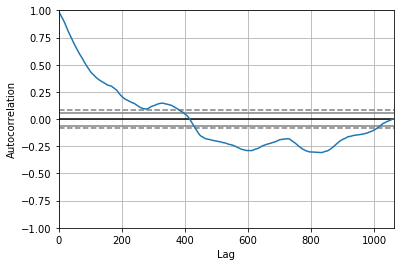

<Figure size 800x560 with 0 Axes>

Test MSE: 0.906


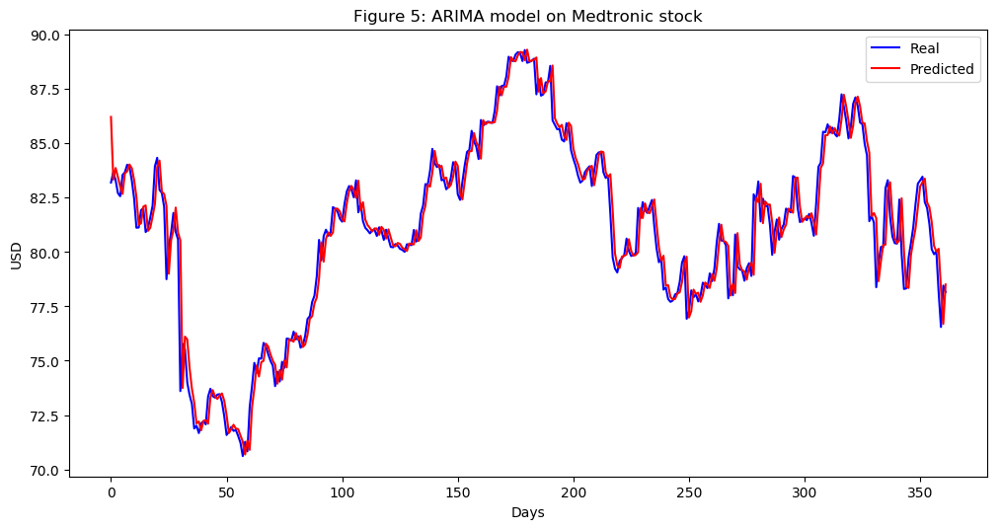

In [244]:
Medtronic_series = SP500_TechIndicator['Medtronic_Close']
Medtronic_series_model = ARIMA(Medtronic_series, order=(5, 1, 0))
Medtronic_model_fit = Medtronic_series_model.fit(disp=0)
print(Medtronic_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Medtronic_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Medtronic_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Medtronic_predictions = list()
for t in range(len(test)):
    Medtronic_series_model = ARIMA(history, order=(5,1,0))
    Medtronic_series_model_fit = Medtronic_series_model.fit(disp=0)
    Medtronic_output = Medtronic_series_model_fit.forecast()
    yhat = Medtronic_output[0]
    Medtronic_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Medtronic_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Medtronic_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Medtronic stock')
plt.legend()
plt.show()


#predictions
Medtronic_predictions = pd.DataFrame({'Medtronic_predictions':Medtronic_predictions})
#Medtronic_predictions.to_csv('Medtronic_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Merck_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1149.690
Method:                       css-mle   S.D. of innovations              0.715
Date:                Sun, 17 Mar 2019   AIC                           2313.381
Time:                        15:42:21   BIC                           2348.149
Sample:                             1   HQIC                          2326.557
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0035      0.021      0.169      0.866      -0.037       0.044
ar.L1.D.Merck_Close     0.0013      0.031      0.043      0.966      -0.059       0.061
ar.L2.D.Merck_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


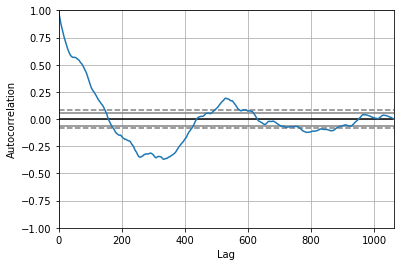

<Figure size 800x560 with 0 Axes>

Test MSE: 0.498


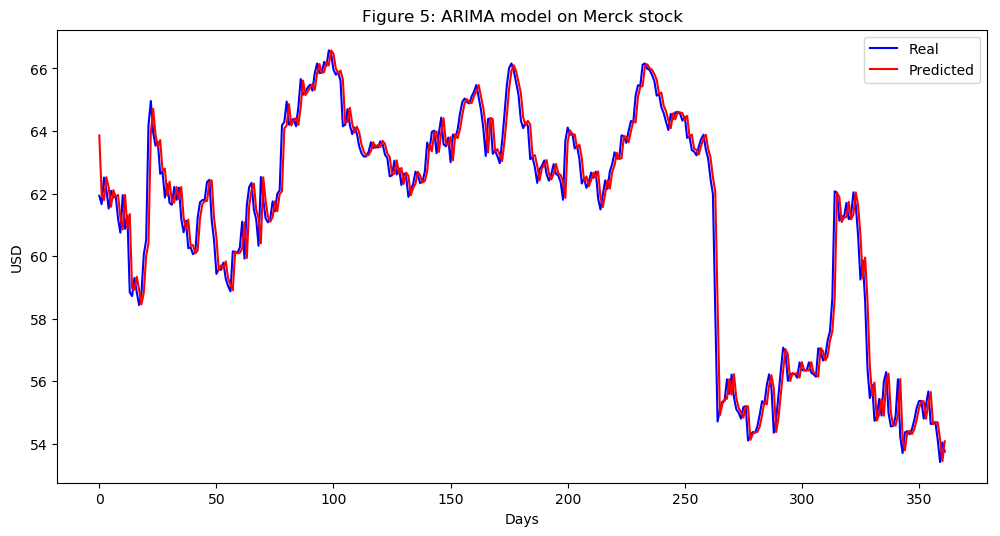

In [245]:
Merck_series = SP500_TechIndicator['Merck_Close']
Merck_series_model = ARIMA(Merck_series, order=(5, 1, 0))
Merck_model_fit = Merck_series_model.fit(disp=0)
print(Merck_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Merck_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Merck_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Merck_predictions = list()
for t in range(len(test)):
    Merck_series_model = ARIMA(history, order=(5,1,0))
    Merck_series_model_fit = Merck_series_model.fit(disp=0)
    Merck_output = Merck_series_model_fit.forecast()
    yhat = Merck_output[0]
    Merck_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Merck_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Merck_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Merck stock')
plt.legend()
plt.show()


#predictions
Merck_predictions = pd.DataFrame({'Merck_predictions':Merck_predictions})
#Merck_predictions.to_csv('Merck_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Mylan_NV_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1607.901
Method:                       css-mle   S.D. of innovations              1.101
Date:                Sun, 17 Mar 2019   AIC                           3229.802
Time:                        15:43:12   BIC                           3264.570
Sample:                             1   HQIC                          3242.978
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     -0.0035      0.033     -0.108      0.914      -0.068       0.061
ar.L1.D.Mylan_NV_Close     0.0110      0.031      0.358      0.720      -0.049       0.071
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


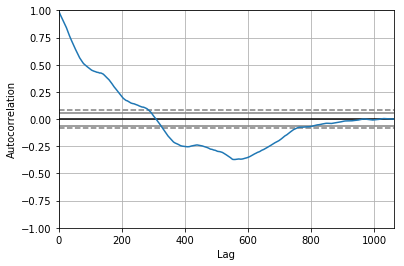

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.574


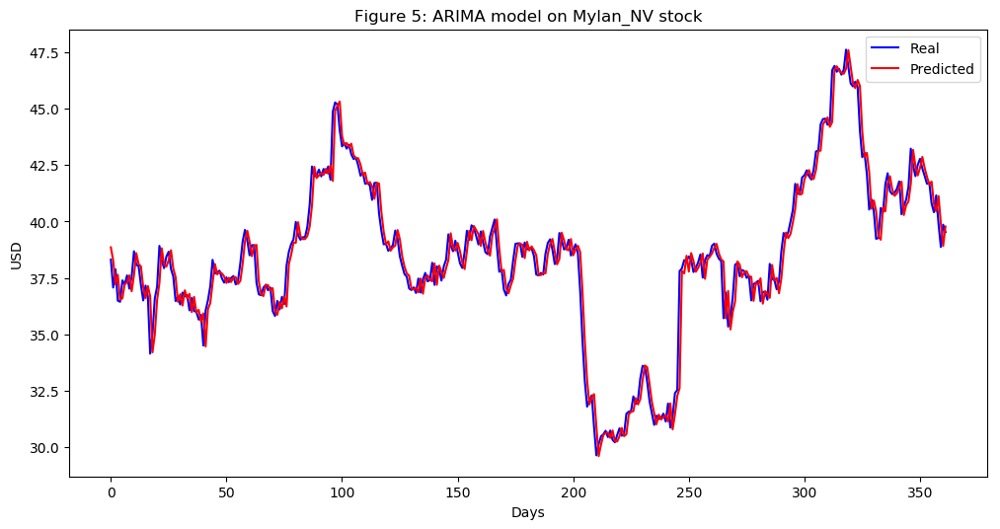

In [246]:
Mylan_NV_series = SP500_TechIndicator['Mylan_NV_Close']
Mylan_NV_series_model = ARIMA(Mylan_NV_series, order=(5, 1, 0))
Mylan_NV_model_fit = Mylan_NV_series_model.fit(disp=0)
print(Mylan_NV_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Mylan_NV_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Mylan_NV_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Mylan_NV_predictions = list()
for t in range(len(test)):
    Mylan_NV_series_model = ARIMA(history, order=(5,1,0))
    Mylan_NV_series_model_fit = Mylan_NV_series_model.fit(disp=0)
    Mylan_NV_output = Mylan_NV_series_model_fit.forecast()
    yhat = Mylan_NV_output[0]
    Mylan_NV_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Mylan_NV_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Mylan_NV_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Mylan_NV stock')
plt.legend()
plt.show()


#predictions
Mylan_NV_predictions = pd.DataFrame({'Mylan_NV_predictions':Mylan_NV_predictions})
#Mylan_NV_predictions.to_csv('Mylan_NV_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.Nektar_Therapeutics_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1570.327
Method:                                css-mle   S.D. of innovations              1.063
Date:                         Sun, 17 Mar 2019   AIC                           3154.655
Time:                                 15:44:02   BIC                           3189.423
Sample:                                      1   HQIC                          3167.831
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0872      0.040      2.204      0.028       0.010   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


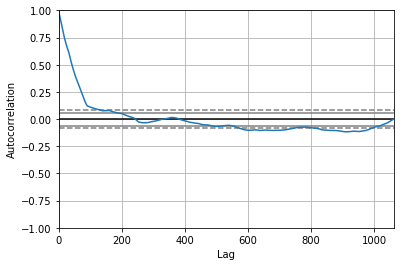

<Figure size 800x560 with 0 Axes>

Test MSE: 3.170


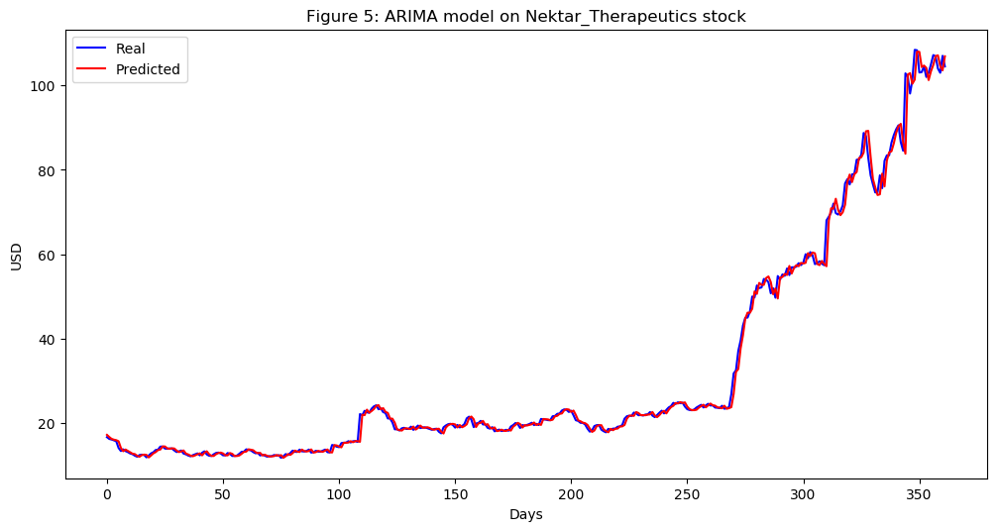

In [247]:
Nektar_Therapeutics_series = SP500_TechIndicator['Nektar_Therapeutics_Close']
Nektar_Therapeutics_series_model = ARIMA(Nektar_Therapeutics_series, order=(5, 1, 0))
Nektar_Therapeutics_model_fit = Nektar_Therapeutics_series_model.fit(disp=0)
print(Nektar_Therapeutics_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Nektar_Therapeutics_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Nektar_Therapeutics_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Nektar_Therapeutics_predictions = list()
for t in range(len(test)):
    Nektar_Therapeutics_series_model = ARIMA(history, order=(5,1,0))
    Nektar_Therapeutics_series_model_fit = Nektar_Therapeutics_series_model.fit(disp=0)
    Nektar_Therapeutics_output = Nektar_Therapeutics_series_model_fit.forecast()
    yhat = Nektar_Therapeutics_output[0]
    Nektar_Therapeutics_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Nektar_Therapeutics_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Nektar_Therapeutics_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Nektar_Therapeutics stock')
plt.legend()
plt.show()


#predictions
Nektar_Therapeutics_predictions = pd.DataFrame({'Nektar_Therapeutics_predictions':Nektar_Therapeutics_predictions})
#Nektar_Therapeutics_predictions.to_csv('Nektar_Therapeutics_predictions.csv')



                              ARIMA Model Results                              
Dep. Variable:     D.PerkinElmer_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -1104.891
Method:                        css-mle   S.D. of innovations              0.686
Date:                 Sun, 17 Mar 2019   AIC                           2223.781
Time:                         15:45:11   BIC                           2258.550
Sample:                              1   HQIC                          2236.958
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0323      0.020      1.585      0.113      -0.008       0.072
ar.L1.D.PerkinElmer_Close     0.0234      0.031      0.763      0.446      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


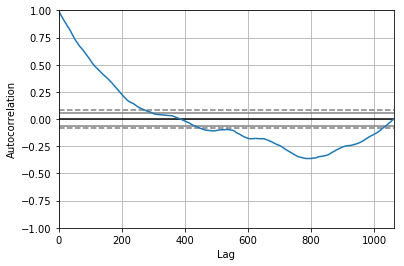

<Figure size 800x560 with 0 Axes>

Test MSE: 0.575


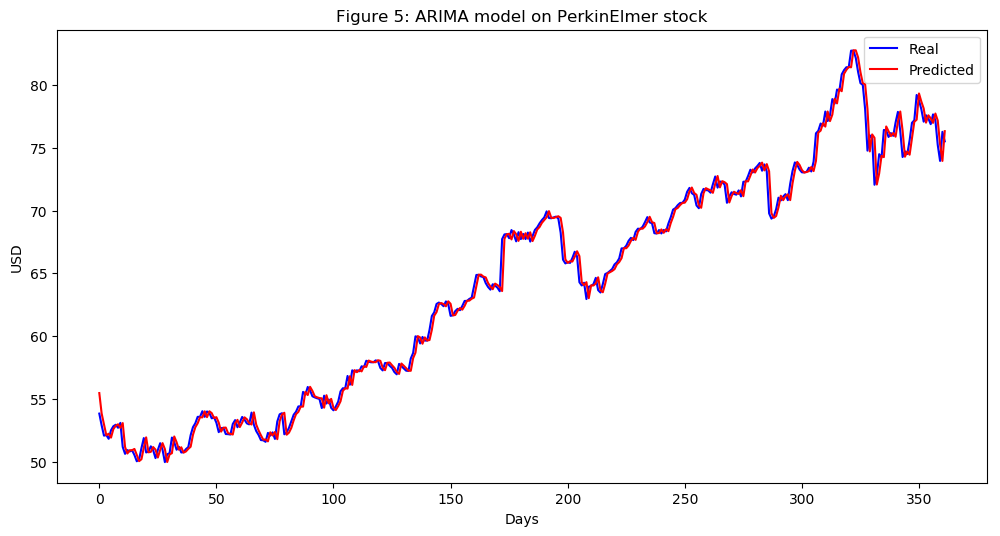

In [248]:
PerkinElmer_series = SP500_TechIndicator['PerkinElmer_Close']
PerkinElmer_series_model = ARIMA(PerkinElmer_series, order=(5, 1, 0))
PerkinElmer_model_fit = PerkinElmer_series_model.fit(disp=0)
print(PerkinElmer_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(PerkinElmer_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = PerkinElmer_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
PerkinElmer_predictions = list()
for t in range(len(test)):
    PerkinElmer_series_model = ARIMA(history, order=(5,1,0))
    PerkinElmer_series_model_fit = PerkinElmer_series_model.fit(disp=0)
    PerkinElmer_output = PerkinElmer_series_model_fit.forecast()
    yhat = PerkinElmer_output[0]
    PerkinElmer_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, PerkinElmer_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(PerkinElmer_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on PerkinElmer stock')
plt.legend()
plt.show()


#predictions
PerkinElmer_predictions = pd.DataFrame({'PerkinElmer_predictions':PerkinElmer_predictions})
#PerkinElmer_predictions.to_csv('PerkinElmer_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Perrigo_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2545.601
Method:                       css-mle   S.D. of innovations              2.665
Date:                Sun, 17 Mar 2019   AIC                           5105.203
Time:                        15:46:12   BIC                           5139.972
Sample:                             1   HQIC                          5118.379
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.0679      0.072     -0.942      0.347      -0.209       0.073
ar.L1.D.Perrigo_Close     0.0175      0.031      0.571      0.568      -0.043       0.077
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


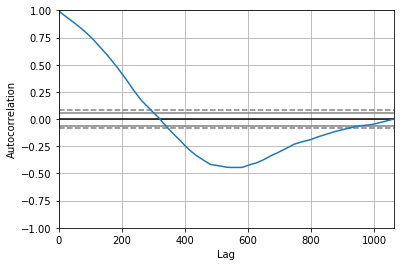

<Figure size 800x560 with 0 Axes>

Test MSE: 2.827


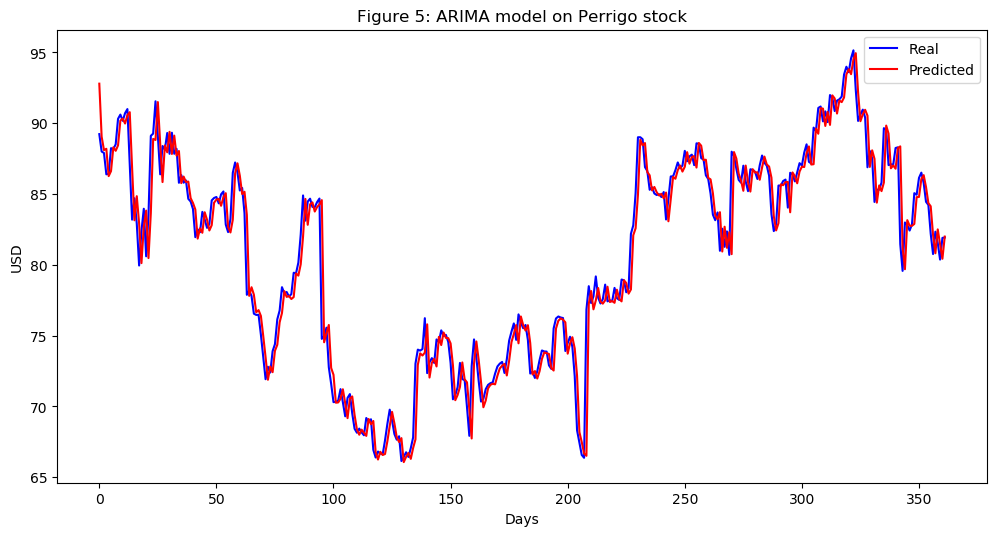

In [249]:
Perrigo_series = SP500_TechIndicator['Perrigo_Close']
Perrigo_series_model = ARIMA(Perrigo_series, order=(5, 1, 0))
Perrigo_model_fit = Perrigo_series_model.fit(disp=0)
print(Perrigo_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Perrigo_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Perrigo_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Perrigo_predictions = list()
for t in range(len(test)):
    Perrigo_series_model = ARIMA(history, order=(5,1,0))
    Perrigo_series_model_fit = Perrigo_series_model.fit(disp=0)
    Perrigo_output = Perrigo_series_model_fit.forecast()
    yhat = Perrigo_output[0]
    Perrigo_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Perrigo_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Perrigo_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Perrigo stock')
plt.legend()
plt.show()


#predictions
Perrigo_predictions = pd.DataFrame({'Perrigo_predictions':Perrigo_predictions})
#Perrigo_predictions.to_csv('Perrigo_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Pfizer_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -420.016
Method:                       css-mle   S.D. of innovations              0.359
Date:                Sun, 17 Mar 2019   AIC                            854.032
Time:                        15:46:59   BIC                            888.800
Sample:                             1   HQIC                           867.208
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0041      0.010      0.396      0.692      -0.016       0.025
ar.L1.D.Pfizer_Close     0.0690      0.031      2.247      0.025       0.009       0.129
ar.L2.D.Pfiz

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


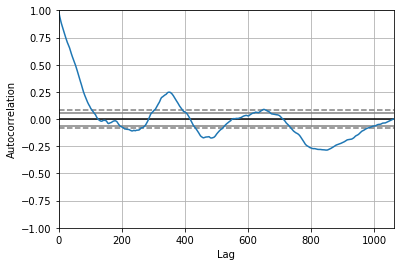

<Figure size 800x560 with 0 Axes>

Test MSE: 0.126


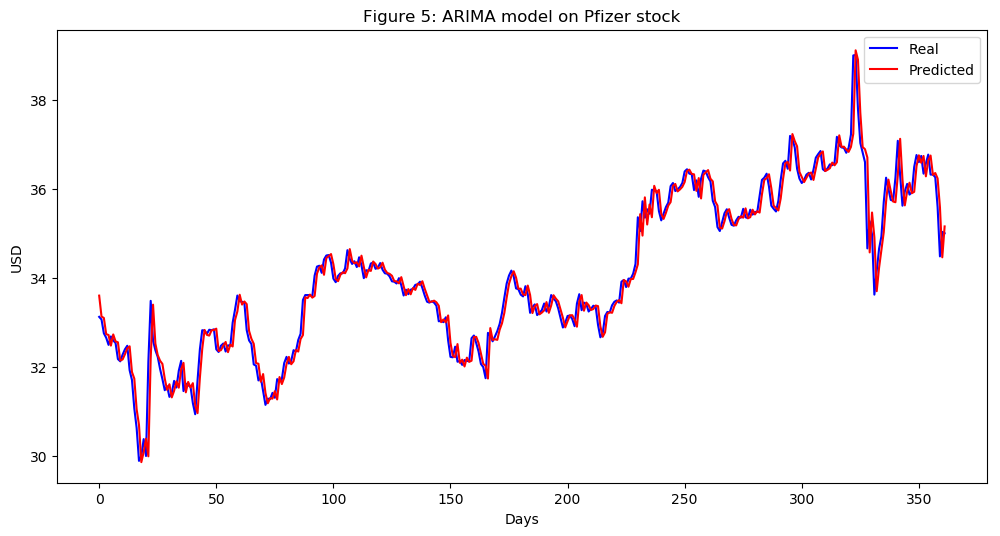

In [250]:
Pfizer_series = SP500_TechIndicator['Pfizer_Close']
Pfizer_series_model = ARIMA(Pfizer_series, order=(5, 1, 0))
Pfizer_model_fit = Pfizer_series_model.fit(disp=0)
print(Pfizer_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Pfizer_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Pfizer_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Pfizer_predictions = list()
for t in range(len(test)):
    Pfizer_series_model = ARIMA(history, order=(5,1,0))
    Pfizer_series_model_fit = Pfizer_series_model.fit(disp=0)
    Pfizer_output = Pfizer_series_model_fit.forecast()
    yhat = Pfizer_output[0]
    Pfizer_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Pfizer_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Pfizer_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Pfizer stock')
plt.legend()
plt.show()


#predictions
Pfizer_predictions = pd.DataFrame({'Pfizer_predictions':Pfizer_predictions})
#Pfizer_predictions.to_csv('Pfizer_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Quest_Diagnostics_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -1438.784
Method:                              css-mle   S.D. of innovations              0.939
Date:                       Sun, 17 Mar 2019   AIC                           2891.568
Time:                               15:48:04   BIC                           2926.337
Sample:                                    1   HQIC                          2904.744
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0437      0.028      1.536      0.125      -0.012       0.099
ar.L1.D.Ques

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


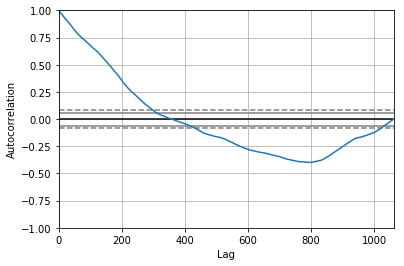

<Figure size 800x560 with 0 Axes>

Test MSE: 1.114


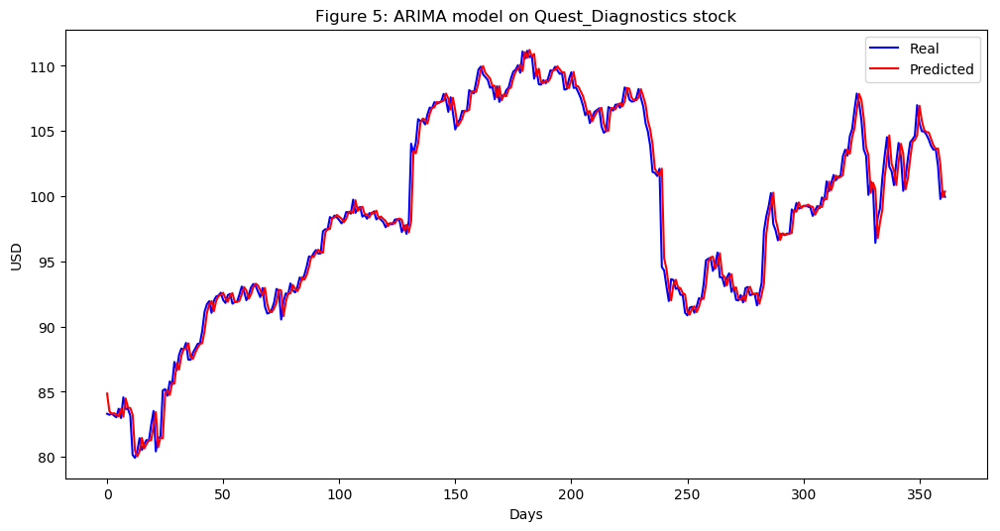

In [251]:
Quest_Diagnostics_series = SP500_TechIndicator['Quest_Diagnostics_Close']
Quest_Diagnostics_series_model = ARIMA(Quest_Diagnostics_series, order=(5, 1, 0))
Quest_Diagnostics_model_fit = Quest_Diagnostics_series_model.fit(disp=0)
print(Quest_Diagnostics_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Quest_Diagnostics_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Quest_Diagnostics_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Quest_Diagnostics_predictions = list()
for t in range(len(test)):
    Quest_Diagnostics_series_model = ARIMA(history, order=(5,1,0))
    Quest_Diagnostics_series_model_fit = Quest_Diagnostics_series_model.fit(disp=0)
    Quest_Diagnostics_output = Quest_Diagnostics_series_model_fit.forecast()
    yhat = Quest_Diagnostics_output[0]
    Quest_Diagnostics_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Quest_Diagnostics_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Quest_Diagnostics_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Quest_Diagnostics stock')
plt.legend()
plt.show()


#predictions
Quest_Diagnostics_predictions = pd.DataFrame({'Quest_Diagnostics_predictions':Quest_Diagnostics_predictions})
#Quest_Diagnostics_predictions.to_csv('Quest_Diagnostics_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:      D.Regeneron_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -3831.583
Method:                       css-mle   S.D. of innovations              8.956
Date:                Sun, 17 Mar 2019   AIC                           7677.166
Time:                        15:48:57   BIC                           7711.934
Sample:                             1   HQIC                          7690.342
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.0512      0.269      0.190      0.849      -0.477       0.579
ar.L1.D.Regeneron_Close     0.0189      0.031      0.616      0.538      -0.041       0.079


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


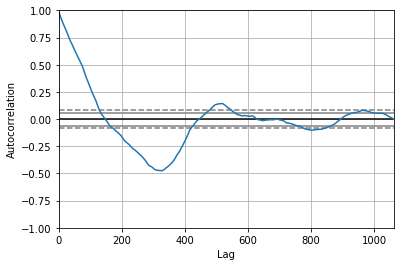

<Figure size 800x560 with 0 Axes>

Test MSE: 69.731


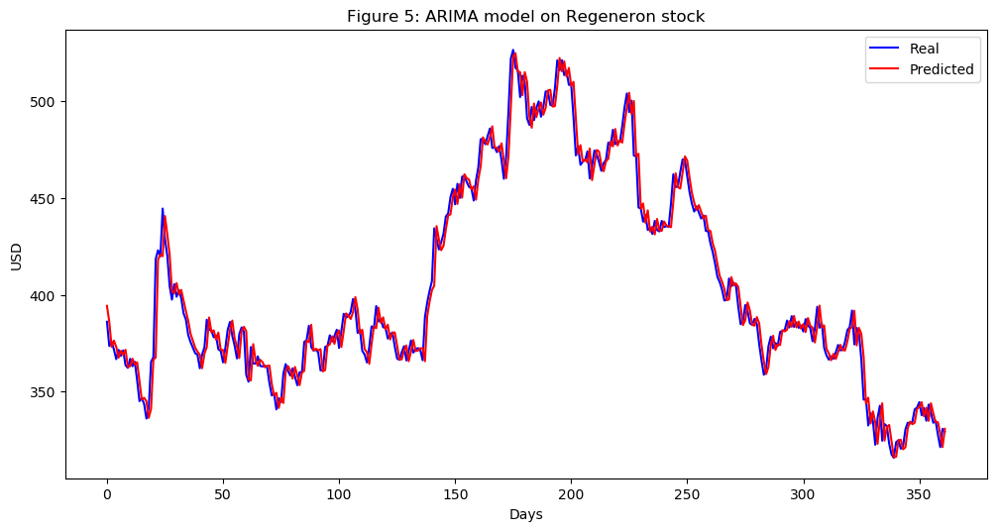

In [252]:
Regeneron_series = SP500_TechIndicator['Regeneron_Close']
Regeneron_series_model = ARIMA(Regeneron_series, order=(5, 1, 0))
Regeneron_model_fit = Regeneron_series_model.fit(disp=0)
print(Regeneron_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Regeneron_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Regeneron_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Regeneron_predictions = list()
for t in range(len(test)):
    Regeneron_series_model = ARIMA(history, order=(5,1,0))
    Regeneron_series_model_fit = Regeneron_series_model.fit(disp=0)
    Regeneron_output = Regeneron_series_model_fit.forecast()
    yhat = Regeneron_output[0]
    Regeneron_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Regeneron_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Regeneron_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Regeneron stock')
plt.legend()
plt.show()


#predictions
Regeneron_predictions = pd.DataFrame({'Regeneron_predictions':Regeneron_predictions})
#Regeneron_predictions.to_csv('Regeneron_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.ResMed_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1537.283
Method:                       css-mle   S.D. of innovations              1.030
Date:                Sun, 17 Mar 2019   AIC                           3088.566
Time:                        15:49:56   BIC                           3123.335
Sample:                             1   HQIC                          3101.743
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0474      0.029      1.653      0.099      -0.009       0.103
ar.L1.D.ResMed_Close    -0.0155      0.031     -0.504      0.614      -0.076       0.045
ar.L2.D.ResM

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


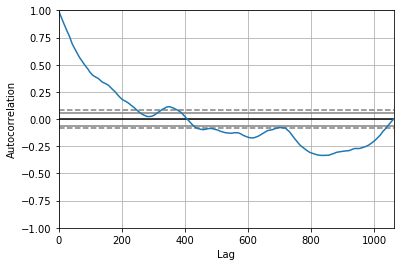

<Figure size 800x560 with 0 Axes>

Test MSE: 1.534


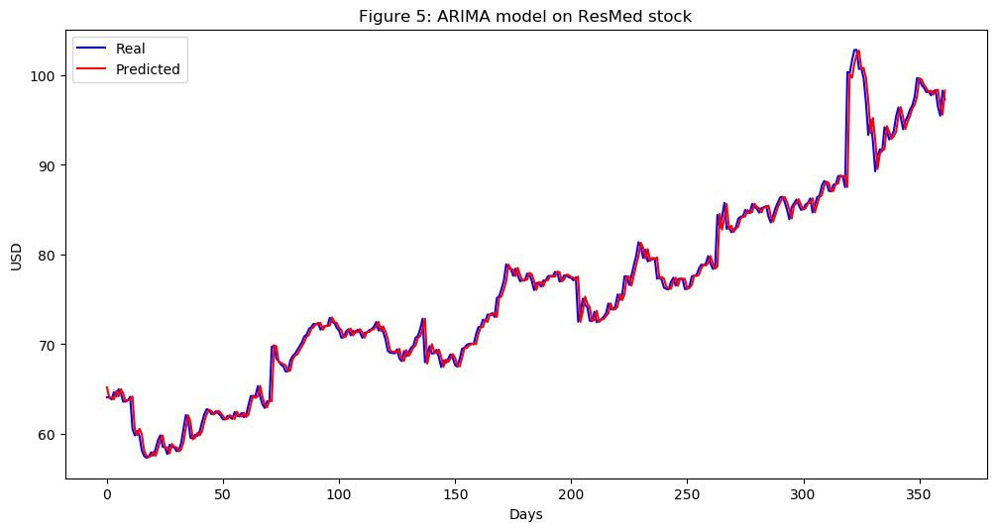

In [253]:
ResMed_series = SP500_TechIndicator['ResMed_Close']
ResMed_series_model = ARIMA(ResMed_series, order=(5, 1, 0))
ResMed_model_fit = ResMed_series_model.fit(disp=0)
print(ResMed_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(ResMed_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = ResMed_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
ResMed_predictions = list()
for t in range(len(test)):
    ResMed_series_model = ARIMA(history, order=(5,1,0))
    ResMed_series_model_fit = ResMed_series_model.fit(disp=0)
    ResMed_output = ResMed_series_model_fit.forecast()
    yhat = ResMed_output[0]
    ResMed_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, ResMed_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(ResMed_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on ResMed stock')
plt.legend()
plt.show()


#predictions
ResMed_predictions = pd.DataFrame({'ResMed_predictions':ResMed_predictions})
#ResMed_predictions.to_csv('ResMed_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Stryker_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1761.194
Method:                       css-mle   S.D. of innovations              1.273
Date:                Sun, 17 Mar 2019   AIC                           3536.388
Time:                        15:50:49   BIC                           3571.157
Sample:                             1   HQIC                          3549.565
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0789      0.036      2.222      0.027       0.009       0.149
ar.L1.D.Stryker_Close    -0.0199      0.031     -0.649      0.517      -0.080       0.040
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


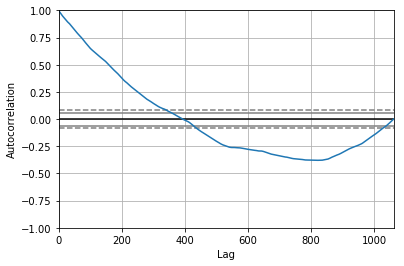

<Figure size 800x560 with 0 Axes>

Test MSE: 2.664


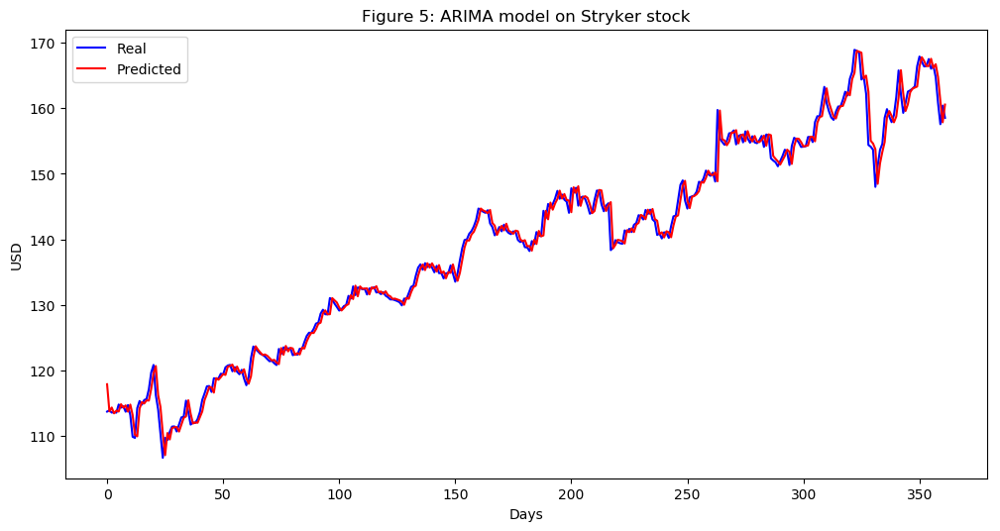

In [254]:
Stryker_series = SP500_TechIndicator['Stryker_Close']
Stryker_series_model = ARIMA(Stryker_series, order=(5, 1, 0))
Stryker_model_fit = Stryker_series_model.fit(disp=0)
print(Stryker_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Stryker_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Stryker_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Stryker_predictions = list()
for t in range(len(test)):
    Stryker_series_model = ARIMA(history, order=(5,1,0))
    Stryker_series_model_fit = Stryker_series_model.fit(disp=0)
    Stryker_output = Stryker_series_model_fit.forecast()
    yhat = Stryker_output[0]
    Stryker_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Stryker_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Stryker_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Stryker stock')
plt.legend()
plt.show()


#predictions
Stryker_predictions = pd.DataFrame({'Stryker_predictions':Stryker_predictions})
#Stryker_predictions.to_csv('Stryker_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Teleflex_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2393.524
Method:                       css-mle   S.D. of innovations              2.309
Date:                Sun, 17 Mar 2019   AIC                           4801.048
Time:                        15:51:36   BIC                           4835.817
Sample:                             1   HQIC                          4814.225
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.1547      0.070      2.218      0.027       0.018       0.291
ar.L1.D.Teleflex_Close     0.0061      0.031      0.198      0.843      -0.054       0.066
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


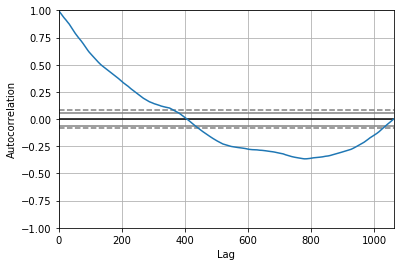

<Figure size 800x560 with 0 Axes>

Test MSE: 11.660


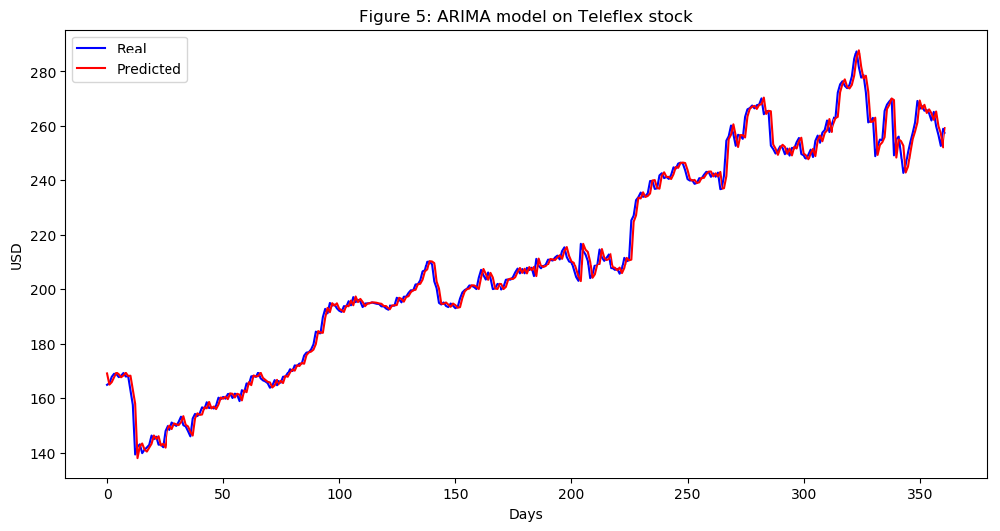

In [255]:
Teleflex_series = SP500_TechIndicator['Teleflex_Close']
Teleflex_series_model = ARIMA(Teleflex_series, order=(5, 1, 0))
Teleflex_model_fit = Teleflex_series_model.fit(disp=0)
print(Teleflex_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Teleflex_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Teleflex_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Teleflex_predictions = list()
for t in range(len(test)):
    Teleflex_series_model = ARIMA(history, order=(5,1,0))
    Teleflex_series_model_fit = Teleflex_series_model.fit(disp=0)
    Teleflex_output = Teleflex_series_model_fit.forecast()
    yhat = Teleflex_output[0]
    Teleflex_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Teleflex_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Teleflex_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Teleflex stock')
plt.legend()
plt.show()


#predictions
Teleflex_predictions = pd.DataFrame({'Teleflex_predictions':Teleflex_predictions})
#Teleflex_predictions.to_csv('Teleflex_predictions.csv')



                                    ARIMA Model Results                                     
Dep. Variable:     D.Thermo_Fisher_Scientific_Close   No. Observations:                 1061
Model:                               ARIMA(5, 1, 0)   Log Likelihood               -2165.860
Method:                                     css-mle   S.D. of innovations              1.863
Date:                              Sun, 17 Mar 2019   AIC                           4345.719
Time:                                      15:52:18   BIC                           4380.488
Sample:                                           1   HQIC                          4358.896
                                                                                            
                                             coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------------
const                                     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


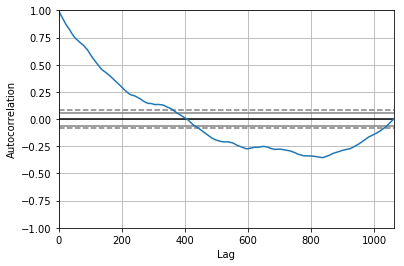

<Figure size 800x560 with 0 Axes>

Test MSE: 4.821


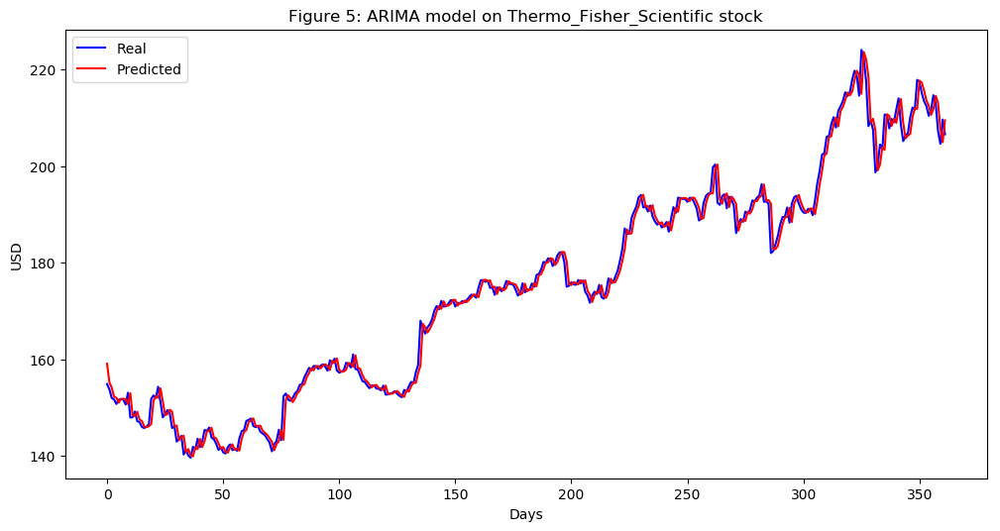

In [256]:
Thermo_Fisher_Scientific_series = SP500_TechIndicator['Thermo_Fisher_Scientific_Close']
Thermo_Fisher_Scientific_series_model = ARIMA(Thermo_Fisher_Scientific_series, order=(5, 1, 0))
Thermo_Fisher_Scientific_model_fit = Thermo_Fisher_Scientific_series_model.fit(disp=0)
print(Thermo_Fisher_Scientific_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Thermo_Fisher_Scientific_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Thermo_Fisher_Scientific_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Thermo_Fisher_Scientific_predictions = list()
for t in range(len(test)):
    Thermo_Fisher_Scientific_series_model = ARIMA(history, order=(5,1,0))
    Thermo_Fisher_Scientific_series_model_fit = Thermo_Fisher_Scientific_series_model.fit(disp=0)
    Thermo_Fisher_Scientific_output = Thermo_Fisher_Scientific_series_model_fit.forecast()
    yhat = Thermo_Fisher_Scientific_output[0]
    Thermo_Fisher_Scientific_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Thermo_Fisher_Scientific_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Thermo_Fisher_Scientific_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Thermo_Fisher_Scientific stock')
plt.legend()
plt.show()


#predictions
Thermo_Fisher_Scientific_predictions = pd.DataFrame({'Thermo_Fisher_Scientific_predictions':Thermo_Fisher_Scientific_predictions})
#Thermo_Fisher_Scientific_predictions.to_csv('Thermo_Fisher_Scientific_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.United_Health_Group_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -2111.750
Method:                                css-mle   S.D. of innovations              1.771
Date:                         Sun, 17 Mar 2019   AIC                           4237.500
Time:                                 16:45:58   BIC                           4272.269
Sample:                                      1   HQIC                          4250.676
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.1347      0.048      2.797      0.005       0.040   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


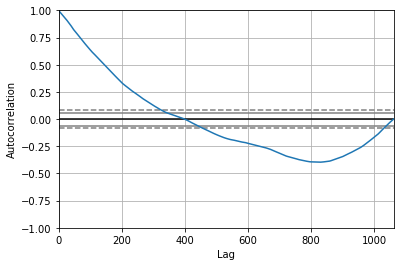

<Figure size 800x560 with 0 Axes>

Test MSE: 5.313


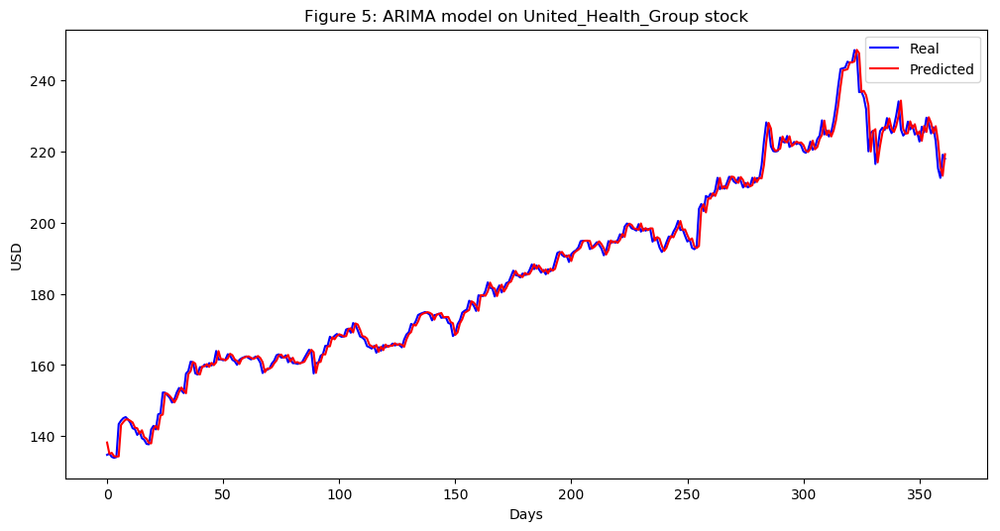

In [257]:
United_Health_Group_series = SP500_TechIndicator['United_Health_Group_Close']
United_Health_Group_series_model = ARIMA(United_Health_Group_series, order=(5, 1, 0))
United_Health_Group_model_fit = United_Health_Group_series_model.fit(disp=0)
print(United_Health_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(United_Health_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = United_Health_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
United_Health_Group_predictions = list()
for t in range(len(test)):
    United_Health_Group_series_model = ARIMA(history, order=(5,1,0))
    United_Health_Group_series_model_fit = United_Health_Group_series_model.fit(disp=0)
    United_Health_Group_output = United_Health_Group_series_model_fit.forecast()
    yhat = United_Health_Group_output[0]
    United_Health_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, United_Health_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(United_Health_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on United_Health_Group stock')
plt.legend()
plt.show()


#predictions
United_Health_Group_predictions = pd.DataFrame({'United_Health_Group_predictions':United_Health_Group_predictions})
#United_Health_Group_predictions.to_csv('United_Health_Group_predictions.csv')



                                     ARIMA Model Results                                     
Dep. Variable:     D.Universal_Health_Services_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood               -2214.256
Method:                                      css-mle   S.D. of innovations              1.950
Date:                               Sun, 17 Mar 2019   AIC                           4442.513
Time:                                       16:46:48   BIC                           4477.282
Sample:                                            1   HQIC                          4455.690
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


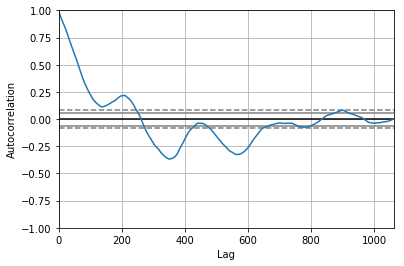

<Figure size 800x560 with 0 Axes>

Test MSE: 3.832


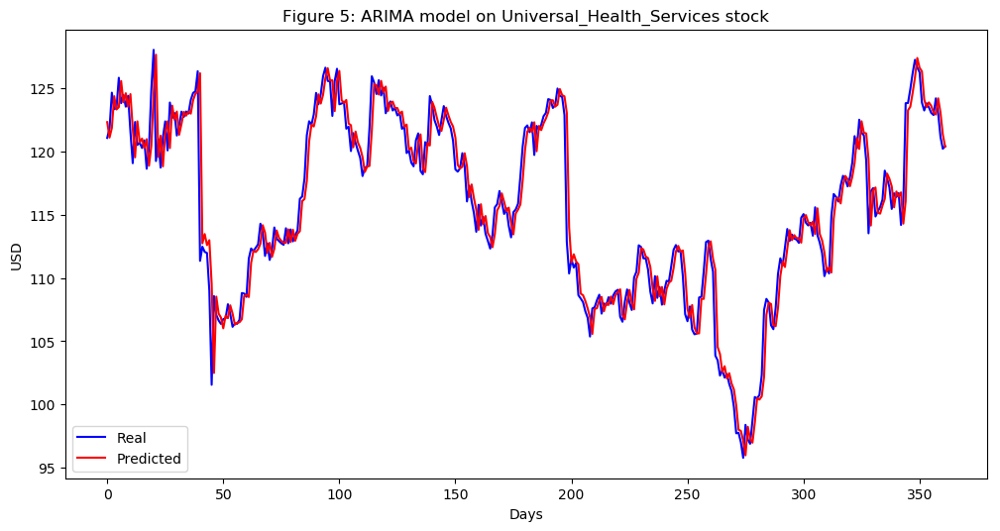

In [258]:
Universal_Health_Services_series = SP500_TechIndicator['Universal_Health_Services_Close']
Universal_Health_Services_series_model = ARIMA(Universal_Health_Services_series, order=(5, 1, 0))
Universal_Health_Services_model_fit = Universal_Health_Services_series_model.fit(disp=0)
print(Universal_Health_Services_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Universal_Health_Services_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Universal_Health_Services_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Universal_Health_Services_predictions = list()
for t in range(len(test)):
    Universal_Health_Services_series_model = ARIMA(history, order=(5,1,0))
    Universal_Health_Services_series_model_fit = Universal_Health_Services_series_model.fit(disp=0)
    Universal_Health_Services_output = Universal_Health_Services_series_model_fit.forecast()
    yhat = Universal_Health_Services_output[0]
    Universal_Health_Services_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Universal_Health_Services_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Universal_Health_Services_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Universal_Health_Services stock')
plt.legend()
plt.show()


#predictions
Universal_Health_Services_predictions = pd.DataFrame({'Universal_Health_Services_predictions':Universal_Health_Services_predictions})
#Universal_Health_Services_predictions.to_csv('Universal_Health_Services_predictions.csv')



                                   ARIMA Model Results                                    
Dep. Variable:     D.Varian_Medical_Systems_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -1724.492
Method:                                   css-mle   S.D. of innovations              1.229
Date:                            Sun, 17 Mar 2019   AIC                           3462.984
Time:                                    16:47:31   BIC                           3497.752
Sample:                                         1   HQIC                          3476.160
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0416      0.038    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


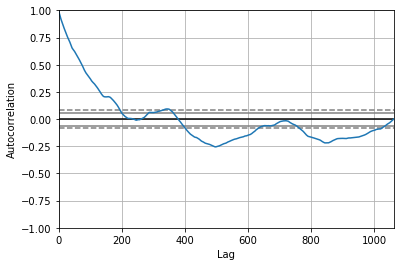

<Figure size 800x560 with 0 Axes>

Test MSE: 2.473


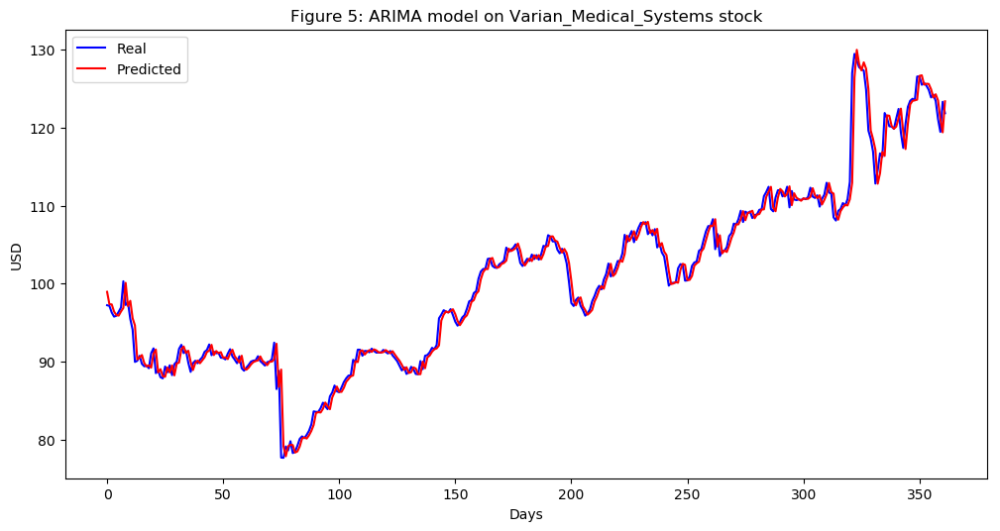

In [259]:
Varian_Medical_Systems_series = SP500_TechIndicator['Varian_Medical_Systems_Close']
Varian_Medical_Systems_series_model = ARIMA(Varian_Medical_Systems_series, order=(5, 1, 0))
Varian_Medical_Systems_model_fit = Varian_Medical_Systems_series_model.fit(disp=0)
print(Varian_Medical_Systems_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Varian_Medical_Systems_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Varian_Medical_Systems_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Varian_Medical_Systems_predictions = list()
for t in range(len(test)):
    Varian_Medical_Systems_series_model = ARIMA(history, order=(5,1,0))
    Varian_Medical_Systems_series_model_fit = Varian_Medical_Systems_series_model.fit(disp=0)
    Varian_Medical_Systems_output = Varian_Medical_Systems_series_model_fit.forecast()
    yhat = Varian_Medical_Systems_output[0]
    Varian_Medical_Systems_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Varian_Medical_Systems_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Varian_Medical_Systems_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Varian_Medical_Systems stock')
plt.legend()
plt.show()


#predictions
Varian_Medical_Systems_predictions = pd.DataFrame({'Varian_Medical_Systems_predictions':Varian_Medical_Systems_predictions})
#Varian_Medical_Systems_predictions.to_csv('Varian_Medical_Systems_predictions.csv')



                                   ARIMA Model Results                                    
Dep. Variable:     D.Vertex_Pharmaceuticals_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -2610.138
Method:                                   css-mle   S.D. of innovations              2.832
Date:                            Sun, 17 Mar 2019   AIC                           5234.275
Time:                                    16:48:20   BIC                           5269.044
Sample:                                         1   HQIC                          5247.452
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0816      0.085    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


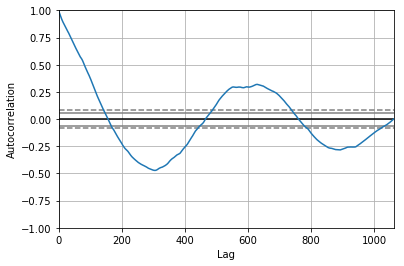

<Figure size 800x560 with 0 Axes>

Test MSE: 8.745


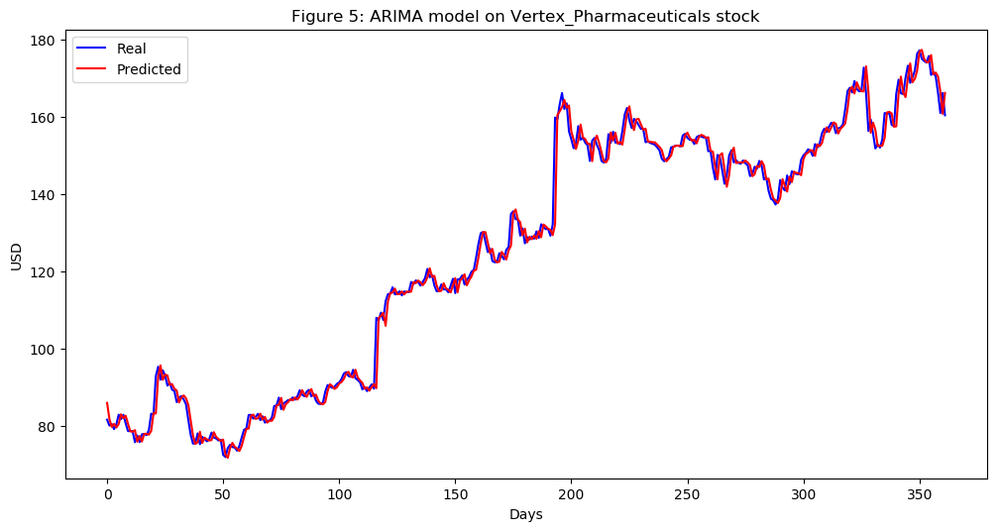

In [260]:
Vertex_Pharmaceuticals_series = SP500_TechIndicator['Vertex_Pharmaceuticals_Close']
Vertex_Pharmaceuticals_series_model = ARIMA(Vertex_Pharmaceuticals_series, order=(5, 1, 0))
Vertex_Pharmaceuticals_model_fit = Vertex_Pharmaceuticals_series_model.fit(disp=0)
print(Vertex_Pharmaceuticals_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Vertex_Pharmaceuticals_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Vertex_Pharmaceuticals_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Vertex_Pharmaceuticals_predictions = list()
for t in range(len(test)):
    Vertex_Pharmaceuticals_series_model = ARIMA(history, order=(5,1,0))
    Vertex_Pharmaceuticals_series_model_fit = Vertex_Pharmaceuticals_series_model.fit(disp=0)
    Vertex_Pharmaceuticals_output = Vertex_Pharmaceuticals_series_model_fit.forecast()
    yhat = Vertex_Pharmaceuticals_output[0]
    Vertex_Pharmaceuticals_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Vertex_Pharmaceuticals_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Vertex_Pharmaceuticals_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Vertex_Pharmaceuticals stock')
plt.legend()
plt.show()


#predictions
Vertex_Pharmaceuticals_predictions = pd.DataFrame({'Vertex_Pharmaceuticals_predictions':Vertex_Pharmaceuticals_predictions})
#Vertex_Pharmaceuticals_predictions.to_csv('Vertex_Pharmaceuticals_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Waters_Corporation_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -2178.123
Method:                               css-mle   S.D. of innovations              1.885
Date:                        Sun, 17 Mar 2019   AIC                           4370.245
Time:                                16:49:05   BIC                           4405.014
Sample:                                     1   HQIC                          4383.422
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0944      0.056      1.679      0.093      -0.016       0.205
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


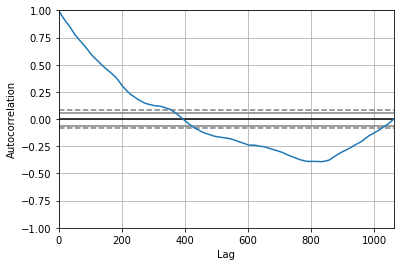

<Figure size 800x560 with 0 Axes>

Test MSE: 5.643


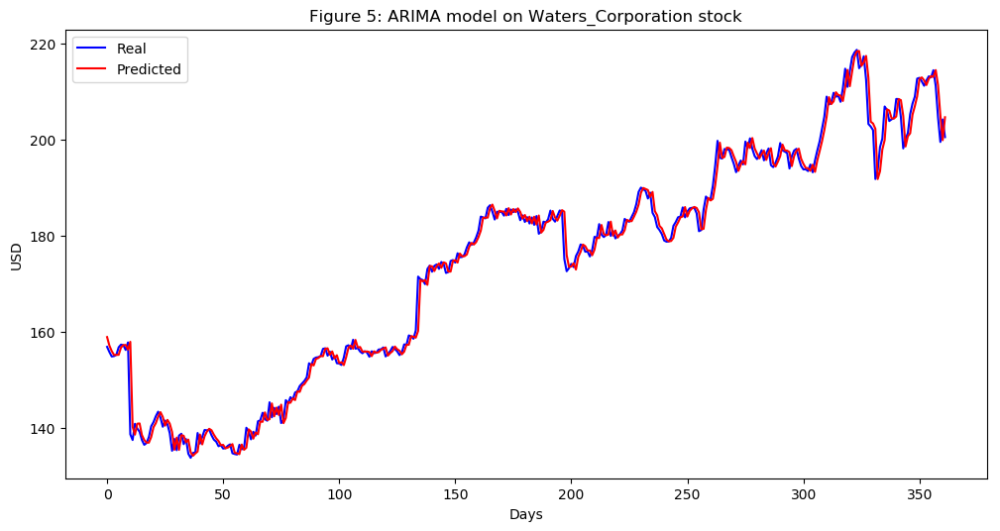

In [261]:
Waters_Corporation_series = SP500_TechIndicator['Waters_Corporation_Close']
Waters_Corporation_series_model = ARIMA(Waters_Corporation_series, order=(5, 1, 0))
Waters_Corporation_model_fit = Waters_Corporation_series_model.fit(disp=0)
print(Waters_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Waters_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Waters_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Waters_Corporation_predictions = list()
for t in range(len(test)):
    Waters_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Waters_Corporation_series_model_fit = Waters_Corporation_series_model.fit(disp=0)
    Waters_Corporation_output = Waters_Corporation_series_model_fit.forecast()
    yhat = Waters_Corporation_output[0]
    Waters_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Waters_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Waters_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Waters_Corporation stock')
plt.legend()
plt.show()


#predictions
Waters_Corporation_predictions = pd.DataFrame({'Waters_Corporation_predictions':Waters_Corporation_predictions})
#Waters_Corporation_predictions.to_csv('Waters_Corporation_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.WellCare_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2276.880
Method:                       css-mle   S.D. of innovations              2.069
Date:                Sun, 17 Mar 2019   AIC                           4567.761
Time:                        16:49:53   BIC                           4602.530
Sample:                             1   HQIC                          4580.937
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.1130      0.059      1.909      0.057      -0.003       0.229
ar.L1.D.WellCare_Close    -0.0378      0.031     -1.233      0.218      -0.098       0.022
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


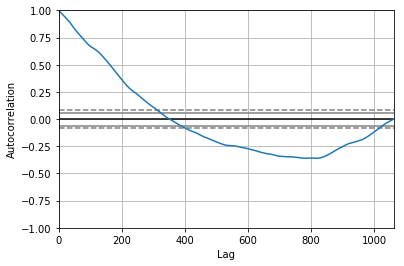

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 6.882


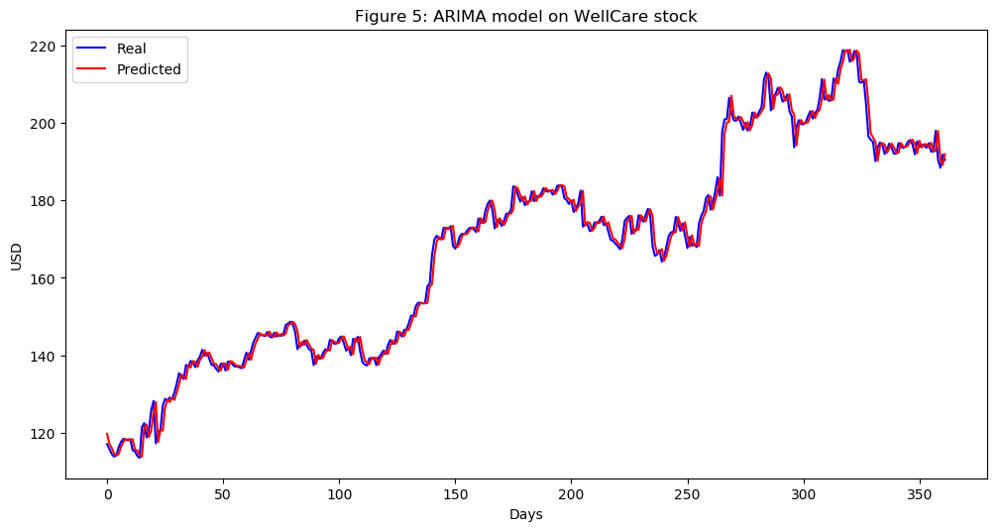

In [262]:
WellCare_series = SP500_TechIndicator['WellCare_Close']
WellCare_series_model = ARIMA(WellCare_series, order=(5, 1, 0))
WellCare_model_fit = WellCare_series_model.fit(disp=0)
print(WellCare_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(WellCare_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = WellCare_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
WellCare_predictions = list()
for t in range(len(test)):
    WellCare_series_model = ARIMA(history, order=(5,1,0))
    WellCare_series_model_fit = WellCare_series_model.fit(disp=0)
    WellCare_output = WellCare_series_model_fit.forecast()
    yhat = WellCare_output[0]
    WellCare_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, WellCare_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(WellCare_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on WellCare stock')
plt.legend()
plt.show()


#predictions
WellCare_predictions = pd.DataFrame({'WellCare_predictions':WellCare_predictions})
#WellCare_predictions.to_csv('WellCare_predictions.csv')



                                   ARIMA Model Results                                    
Dep. Variable:     D.Zimmer_Biomet_Holdings_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -1953.613
Method:                                   css-mle   S.D. of innovations              1.526
Date:                            Sun, 17 Mar 2019   AIC                           3921.226
Time:                                    16:50:34   BIC                           3955.995
Sample:                                         1   HQIC                          3934.403
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0144      0.047    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


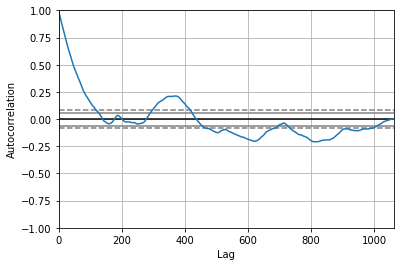

<Figure size 800x560 with 0 Axes>

Test MSE: 3.304


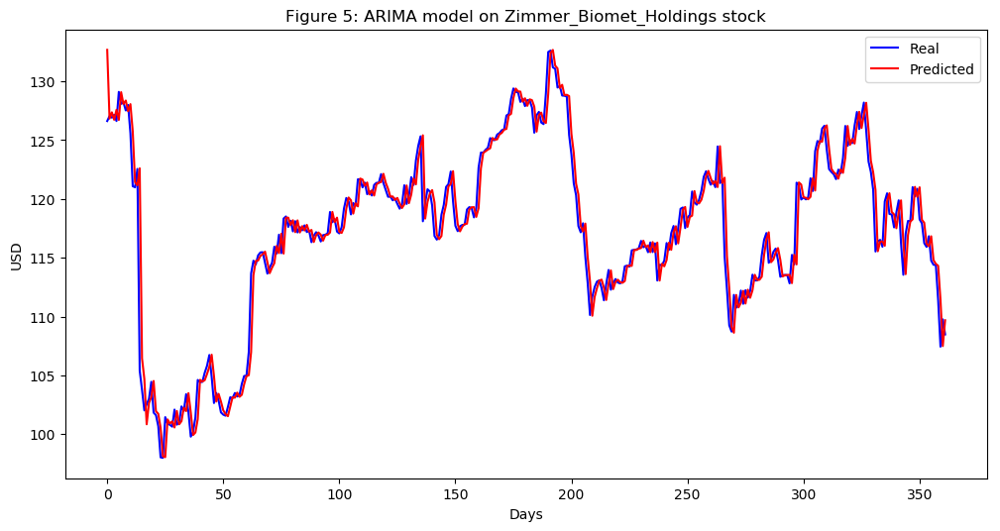

In [263]:
Zimmer_Biomet_Holdings_series = SP500_TechIndicator['Zimmer_Biomet_Holdings_Close']
Zimmer_Biomet_Holdings_series_model = ARIMA(Zimmer_Biomet_Holdings_series, order=(5, 1, 0))
Zimmer_Biomet_Holdings_model_fit = Zimmer_Biomet_Holdings_series_model.fit(disp=0)
print(Zimmer_Biomet_Holdings_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Zimmer_Biomet_Holdings_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Zimmer_Biomet_Holdings_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Zimmer_Biomet_Holdings_predictions = list()
for t in range(len(test)):
    Zimmer_Biomet_Holdings_series_model = ARIMA(history, order=(5,1,0))
    Zimmer_Biomet_Holdings_series_model_fit = Zimmer_Biomet_Holdings_series_model.fit(disp=0)
    Zimmer_Biomet_Holdings_output = Zimmer_Biomet_Holdings_series_model_fit.forecast()
    yhat = Zimmer_Biomet_Holdings_output[0]
    Zimmer_Biomet_Holdings_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Zimmer_Biomet_Holdings_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Zimmer_Biomet_Holdings_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Zimmer_Biomet_Holdings stock')
plt.legend()
plt.show()


#predictions
Zimmer_Biomet_Holdings_predictions = pd.DataFrame({'Zimmer_Biomet_Holdings_predictions':Zimmer_Biomet_Holdings_predictions})
#Zimmer_Biomet_Holdings_predictions.to_csv('Zimmer_Biomet_Holdings_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Zoetis_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1141.916
Method:                       css-mle   S.D. of innovations              0.710
Date:                Sun, 17 Mar 2019   AIC                           2297.833
Time:                        16:51:22   BIC                           2332.602
Sample:                             1   HQIC                          2311.009
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0464      0.021      2.252      0.025       0.006       0.087
ar.L1.D.Zoetis_Close    -0.1061      0.031     -3.451      0.001      -0.166      -0.046
ar.L2.D.Zoet

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


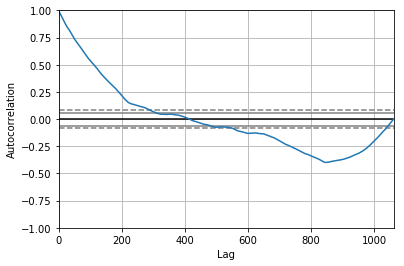

<Figure size 800x560 with 0 Axes>

Test MSE: 0.597


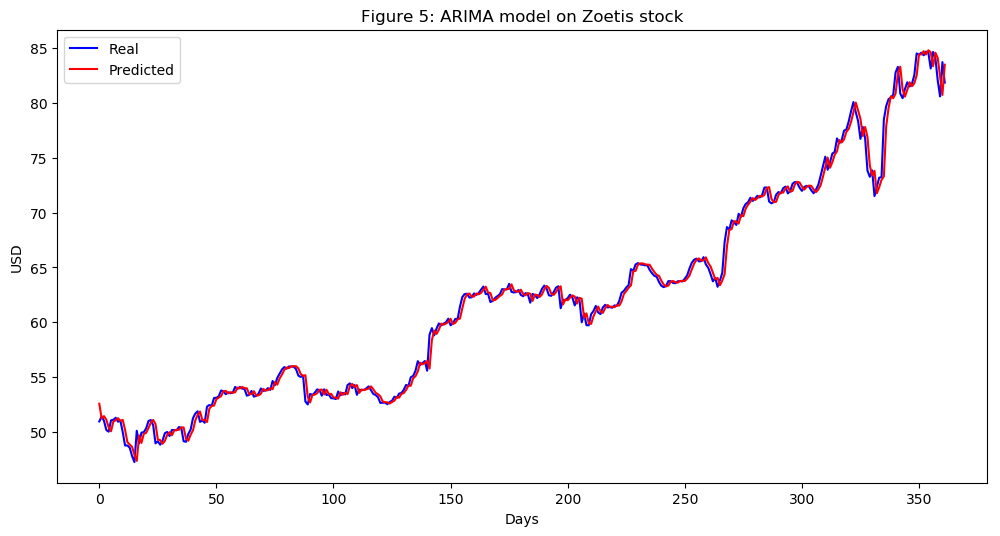

In [264]:
Zoetis_series = SP500_TechIndicator['Zoetis_Close']
Zoetis_series_model = ARIMA(Zoetis_series, order=(5, 1, 0))
Zoetis_model_fit = Zoetis_series_model.fit(disp=0)
print(Zoetis_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Zoetis_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Zoetis_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Zoetis_predictions = list()
for t in range(len(test)):
    Zoetis_series_model = ARIMA(history, order=(5,1,0))
    Zoetis_series_model_fit = Zoetis_series_model.fit(disp=0)
    Zoetis_output = Zoetis_series_model_fit.forecast()
    yhat = Zoetis_output[0]
    Zoetis_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Zoetis_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Zoetis_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Zoetis stock')
plt.legend()
plt.show()


#predictions
Zoetis_predictions = pd.DataFrame({'Zoetis_predictions':Zoetis_predictions})
#Zoetis_predictions.to_csv('Zoetis_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Alaska_Air_Group_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -2244.346
Method:                             css-mle   S.D. of innovations              2.006
Date:                      Sun, 17 Mar 2019   AIC                           4502.692
Time:                              16:52:22   BIC                           4537.461
Sample:                                   1   HQIC                          4515.868
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                             -0.0113      0.062     -0.181      0.856      -0.133       0.111
ar.L1.D.Alaska_Air_Grou

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


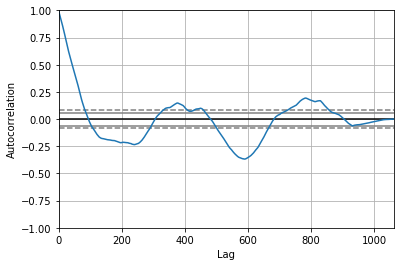

<Figure size 800x560 with 0 Axes>

Test MSE: 2.023


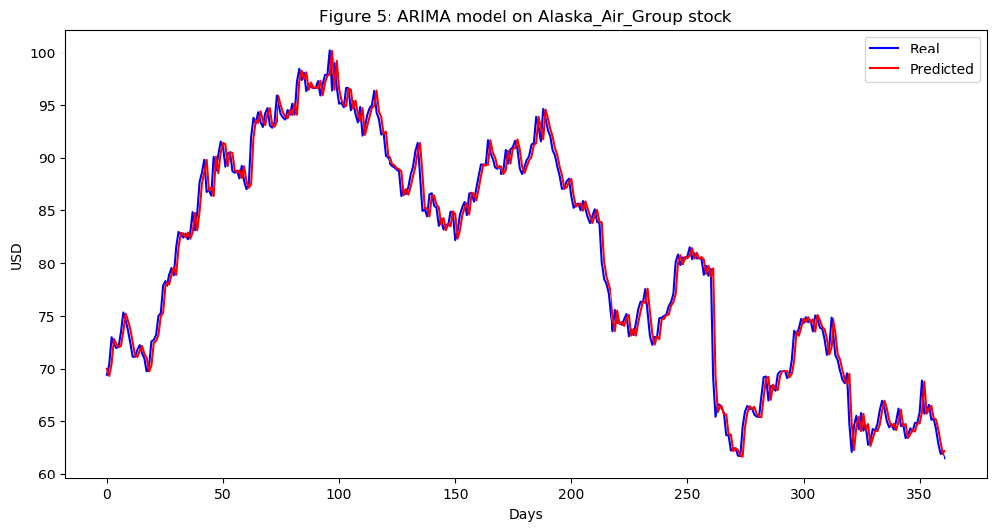

In [265]:
Alaska_Air_Group_series = SP500_TechIndicator['Alaska_Air_Group_Close']
Alaska_Air_Group_series_model = ARIMA(Alaska_Air_Group_series, order=(5, 1, 0))
Alaska_Air_Group_model_fit = Alaska_Air_Group_series_model.fit(disp=0)
print(Alaska_Air_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Alaska_Air_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Alaska_Air_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Alaska_Air_Group_predictions = list()
for t in range(len(test)):
    Alaska_Air_Group_series_model = ARIMA(history, order=(5,1,0))
    Alaska_Air_Group_series_model_fit = Alaska_Air_Group_series_model.fit(disp=0)
    Alaska_Air_Group_output = Alaska_Air_Group_series_model_fit.forecast()
    yhat = Alaska_Air_Group_output[0]
    Alaska_Air_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Alaska_Air_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Alaska_Air_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alaska_Air_Group stock')
plt.legend()
plt.show()


#predictions
Alaska_Air_Group_predictions = pd.DataFrame({'Alaska_Air_Group_predictions':Alaska_Air_Group_predictions})
#Alaska_Air_Group_predictions.to_csv('Alaska_Air_Group_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Allegion_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1330.793
Method:                       css-mle   S.D. of innovations              0.848
Date:                Sun, 17 Mar 2019   AIC                           2675.586
Time:                        16:53:05   BIC                           2710.354
Sample:                             1   HQIC                          2688.762
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0375      0.026      1.466      0.143      -0.013       0.088
ar.L1.D.Allegion_Close     0.0492      0.031      1.602      0.109      -0.011       0.109
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


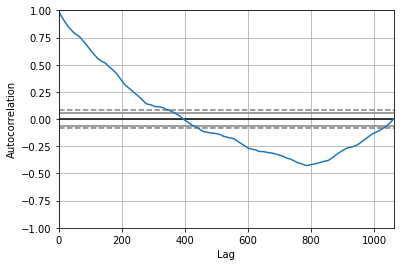

<Figure size 800x560 with 0 Axes>

Test MSE: 0.918


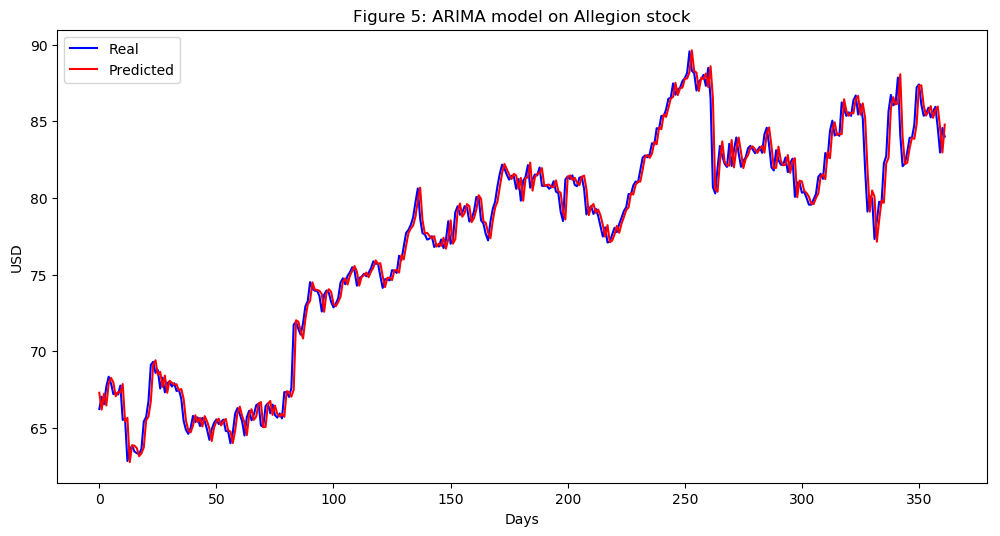

In [266]:
Allegion_series = SP500_TechIndicator['Allegion_Close']
Allegion_series_model = ARIMA(Allegion_series, order=(5, 1, 0))
Allegion_model_fit = Allegion_series_model.fit(disp=0)
print(Allegion_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Allegion_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Allegion_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Allegion_predictions = list()
for t in range(len(test)):
    Allegion_series_model = ARIMA(history, order=(5,1,0))
    Allegion_series_model_fit = Allegion_series_model.fit(disp=0)
    Allegion_output = Allegion_series_model_fit.forecast()
    yhat = Allegion_output[0]
    Allegion_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Allegion_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Allegion_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Allegion stock')
plt.legend()
plt.show()


#predictions
Allegion_predictions = pd.DataFrame({'Allegion_predictions':Allegion_predictions})
#Allegion_predictions.to_csv('Allegion_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.American_Airlines_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -1433.760
Method:                              css-mle   S.D. of innovations              0.935
Date:                       Sun, 17 Mar 2019   AIC                           2881.521
Time:                               16:53:55   BIC                           2916.289
Sample:                                    1   HQIC                          2894.697
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0241      0.031      0.784      0.433      -0.036       0.084
ar.L1.D.Amer

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


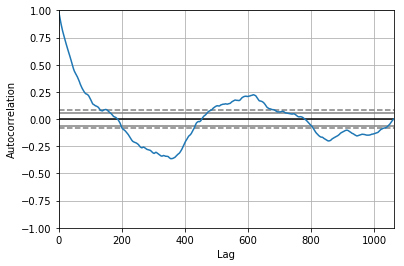

<Figure size 800x560 with 0 Axes>

Test MSE: 0.802


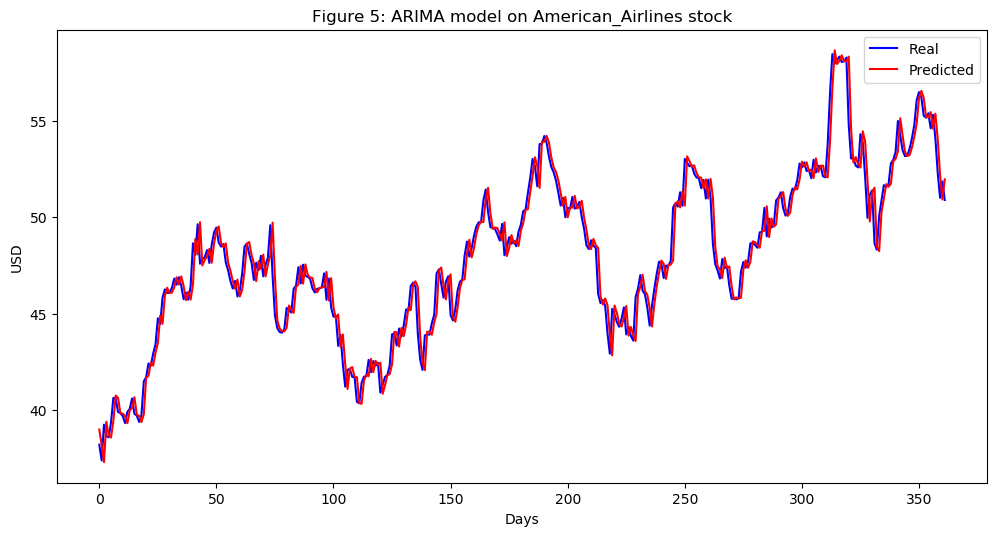

In [267]:
American_Airlines_series = SP500_TechIndicator['American_Airlines_Close']
American_Airlines_series_model = ARIMA(American_Airlines_series, order=(5, 1, 0))
American_Airlines_model_fit = American_Airlines_series_model.fit(disp=0)
print(American_Airlines_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(American_Airlines_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = American_Airlines_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
American_Airlines_predictions = list()
for t in range(len(test)):
    American_Airlines_series_model = ARIMA(history, order=(5,1,0))
    American_Airlines_series_model_fit = American_Airlines_series_model.fit(disp=0)
    American_Airlines_output = American_Airlines_series_model_fit.forecast()
    yhat = American_Airlines_output[0]
    American_Airlines_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, American_Airlines_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(American_Airlines_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on American_Airlines stock')
plt.legend()
plt.show()


#predictions
American_Airlines_predictions = pd.DataFrame({'American_Airlines_predictions':American_Airlines_predictions})
#American_Airlines_predictions.to_csv('American_Airlines_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.AMETEK_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1042.441
Method:                       css-mle   S.D. of innovations              0.646
Date:                Sun, 17 Mar 2019   AIC                           2098.883
Time:                        16:54:46   BIC                           2133.652
Sample:                             1   HQIC                          2112.059
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0213      0.018      1.174      0.241      -0.014       0.057
ar.L1.D.AMETEK_Close    -0.0082      0.031     -0.266      0.790      -0.069       0.052
ar.L2.D.AMET

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


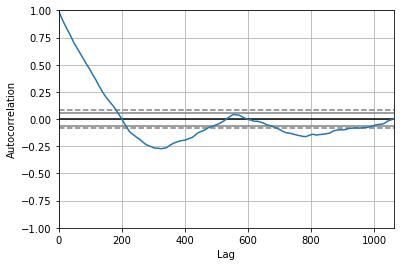

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.432


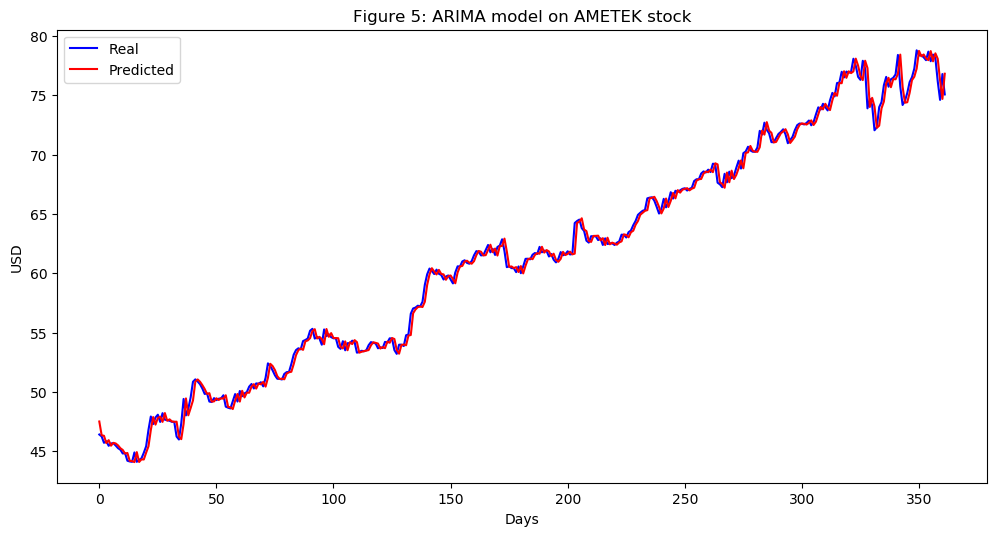

In [268]:
AMETEK_series = SP500_TechIndicator['AMETEK_Close']
AMETEK_series_model = ARIMA(AMETEK_series, order=(5, 1, 0))
AMETEK_model_fit = AMETEK_series_model.fit(disp=0)
print(AMETEK_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(AMETEK_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = AMETEK_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
AMETEK_predictions = list()
for t in range(len(test)):
    AMETEK_series_model = ARIMA(history, order=(5,1,0))
    AMETEK_series_model_fit = AMETEK_series_model.fit(disp=0)
    AMETEK_output = AMETEK_series_model_fit.forecast()
    yhat = AMETEK_output[0]
    AMETEK_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, AMETEK_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(AMETEK_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on AMETEK stock')
plt.legend()
plt.show()


#predictions
AMETEK_predictions = pd.DataFrame({'AMETEK_predictions':AMETEK_predictions})
#AMETEK_predictions.to_csv('AMETEK_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:      D.A_O_Smith_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2124.645
Method:                       css-mle   S.D. of innovations              1.792
Date:                Sun, 17 Mar 2019   AIC                           4263.289
Time:                        18:14:01   BIC                           4298.058
Sample:                             1   HQIC                          4276.466
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.0080      0.055      0.146      0.884      -0.100       0.116
ar.L1.D.A_O_Smith_Close    -0.0007      0.031     -0.024      0.981      -0.061       0.059


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


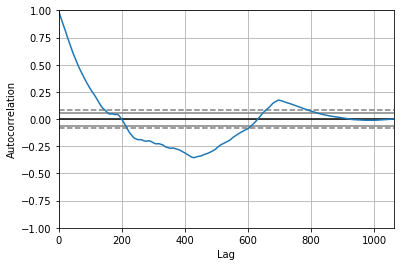

<Figure size 800x560 with 0 Axes>

Test MSE: 0.531


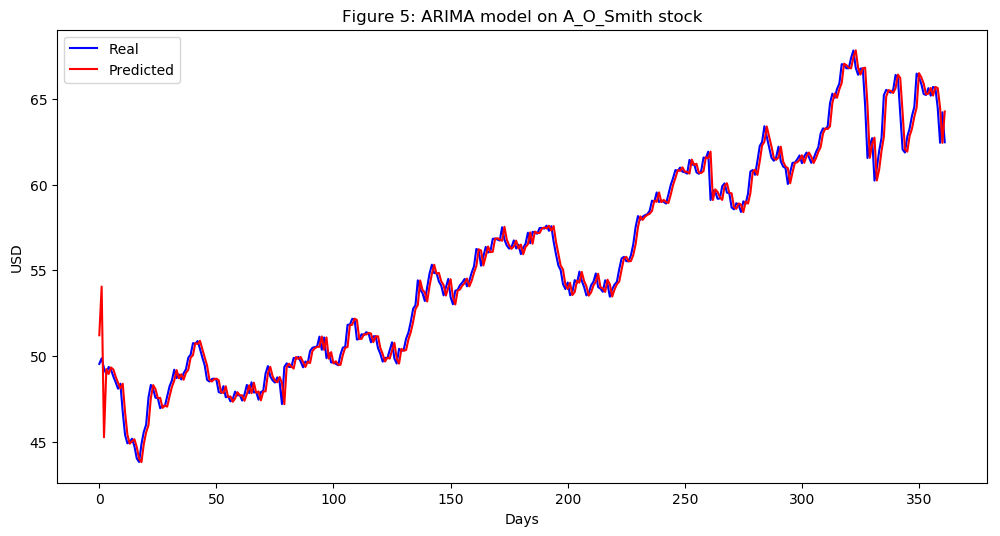

In [269]:
A_O_Smith_series = SP500_TechIndicator['A_O_Smith_Close']
A_O_Smith_series_model = ARIMA(A_O_Smith_series, order=(5, 1, 0))
A_O_Smith_model_fit = A_O_Smith_series_model.fit(disp=0)
print(A_O_Smith_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(A_O_Smith_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = A_O_Smith_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
A_O_Smith_predictions = list()
for t in range(len(test)):
    A_O_Smith_series_model = ARIMA(history, order=(5,1,0))
    A_O_Smith_series_model_fit = A_O_Smith_series_model.fit(disp=0)
    A_O_Smith_output = A_O_Smith_series_model_fit.forecast()
    yhat = A_O_Smith_output[0]
    A_O_Smith_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, A_O_Smith_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(A_O_Smith_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on A_O_Smith stock')
plt.legend()
plt.show()


#predictions
A_O_Smith_predictions = pd.DataFrame({'A_O_Smith_predictions':A_O_Smith_predictions})
#A_O_Smith_predictions.to_csv('A_O_Smith_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Arconic_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1286.923
Method:                       css-mle   S.D. of innovations              0.814
Date:                Sun, 17 Mar 2019   AIC                           2587.846
Time:                        18:14:56   BIC                           2622.615
Sample:                             1   HQIC                          2601.022
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0117      0.023      0.511      0.609      -0.033       0.057
ar.L1.D.Arconic_Close     0.0180      0.031      0.587      0.557      -0.042       0.078
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


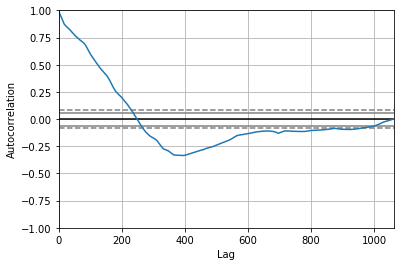

<Figure size 800x560 with 0 Axes>

Test MSE: 0.582


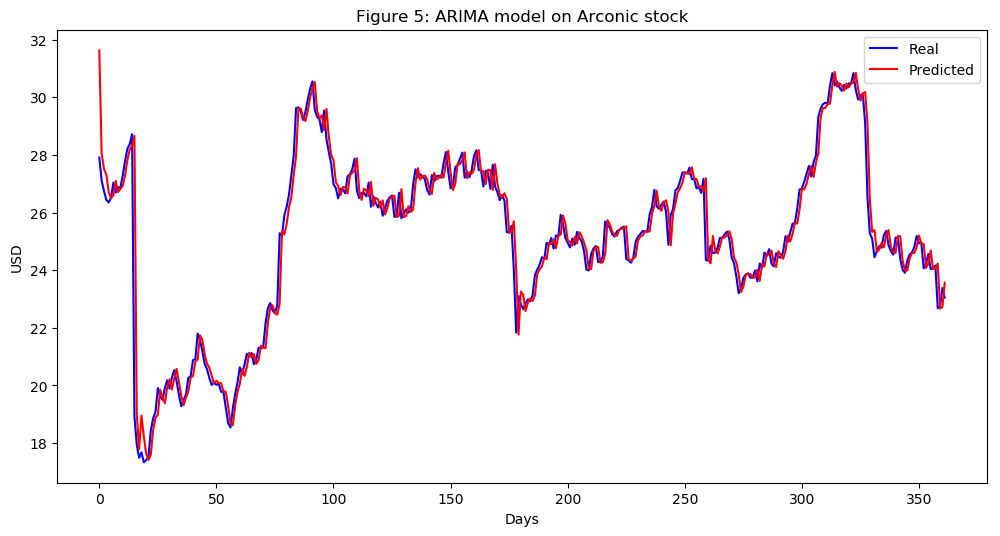

In [270]:
Arconic_series = SP500_TechIndicator['Arconic_Close']
Arconic_series_model = ARIMA(Arconic_series, order=(5, 1, 0))
Arconic_model_fit = Arconic_series_model.fit(disp=0)
print(Arconic_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Arconic_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Arconic_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Arconic_predictions = list()
for t in range(len(test)):
    Arconic_series_model = ARIMA(history, order=(5,1,0))
    Arconic_series_model_fit = Arconic_series_model.fit(disp=0)
    Arconic_output = Arconic_series_model_fit.forecast()
    yhat = Arconic_output[0]
    Arconic_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Arconic_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Arconic_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Arconic stock')
plt.legend()
plt.show()


#predictions
Arconic_predictions = pd.DataFrame({'Arconic_predictions':Arconic_predictions})
#Arconic_predictions.to_csv('Arconic_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.Boeing_Company_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -2534.616
Method:                           css-mle   S.D. of innovations              2.638
Date:                    Sun, 17 Mar 2019   AIC                           5083.231
Time:                            18:16:07   BIC                           5118.000
Sample:                                 1   HQIC                          5096.408
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.1736      0.078      2.219      0.027       0.020       0.327
ar.L1.D.Boeing_Company_Close    -0.0019      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


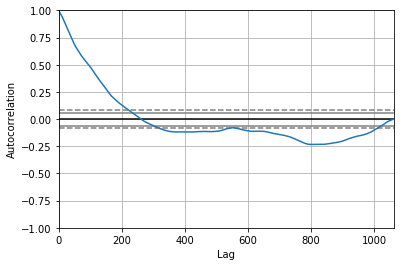

<Figure size 800x560 with 0 Axes>

Test MSE: 14.505


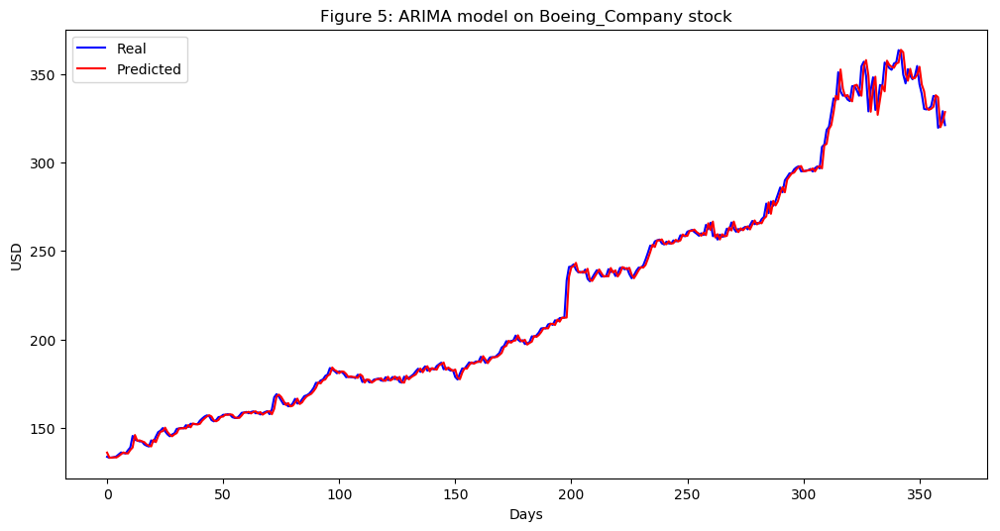

In [271]:
Boeing_Company_series = SP500_TechIndicator['Boeing_Company_Close']
Boeing_Company_series_model = ARIMA(Boeing_Company_series, order=(5, 1, 0))
Boeing_Company_model_fit = Boeing_Company_series_model.fit(disp=0)
print(Boeing_Company_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Boeing_Company_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Boeing_Company_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Boeing_Company_predictions = list()
for t in range(len(test)):
    Boeing_Company_series_model = ARIMA(history, order=(5,1,0))
    Boeing_Company_series_model_fit = Boeing_Company_series_model.fit(disp=0)
    Boeing_Company_output = Boeing_Company_series_model_fit.forecast()
    yhat = Boeing_Company_output[0]
    Boeing_Company_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Boeing_Company_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Boeing_Company_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Boeing_Company stock')
plt.legend()
plt.show()


#predictions
Boeing_Company_predictions = pd.DataFrame({'Boeing_Company_predictions':Boeing_Company_predictions})
#Boeing_Company_predictions.to_csv('Boeing_Company_predictions.csv')



                                   ARIMA Model Results                                    
Dep. Variable:     D.C_H_Robinson_Worldwide_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -1412.442
Method:                                   css-mle   S.D. of innovations              0.916
Date:                            Sun, 17 Mar 2019   AIC                           2838.884
Time:                                    18:16:53   BIC                           2873.653
Sample:                                         1   HQIC                          2852.060
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0316      0.024    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


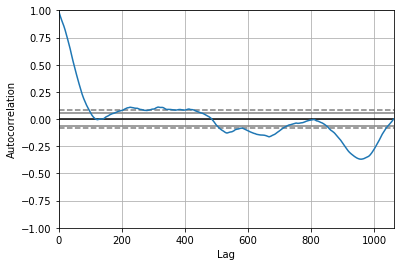

<Figure size 800x560 with 0 Axes>

Test MSE: 0.878


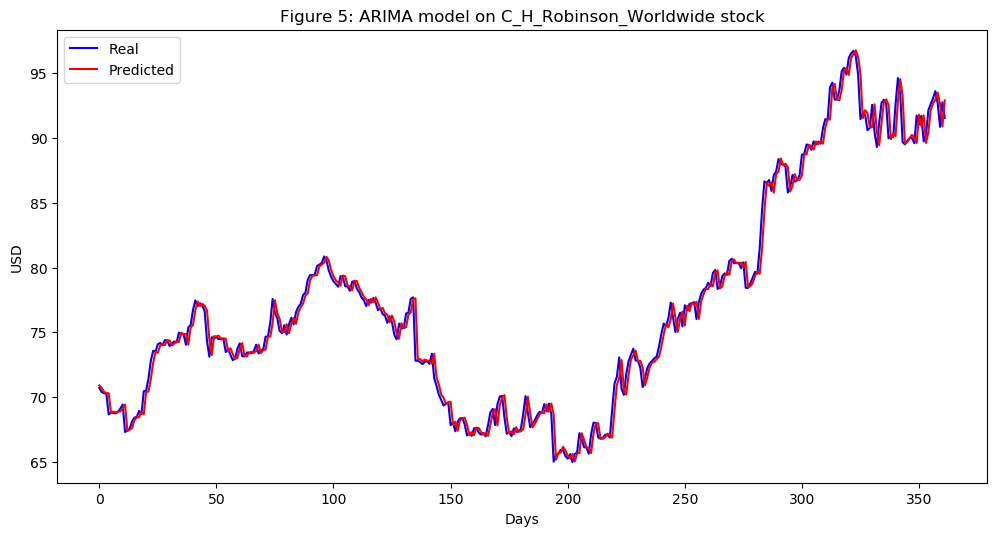

In [272]:
C_H_Robinson_Worldwide_series = SP500_TechIndicator['C_H_Robinson_Worldwide_Close']
C_H_Robinson_Worldwide_series_model = ARIMA(C_H_Robinson_Worldwide_series, order=(5, 1, 0))
C_H_Robinson_Worldwide_model_fit = C_H_Robinson_Worldwide_series_model.fit(disp=0)
print(C_H_Robinson_Worldwide_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(C_H_Robinson_Worldwide_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = C_H_Robinson_Worldwide_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
C_H_Robinson_Worldwide_predictions = list()
for t in range(len(test)):
    C_H_Robinson_Worldwide_series_model = ARIMA(history, order=(5,1,0))
    C_H_Robinson_Worldwide_series_model_fit = C_H_Robinson_Worldwide_series_model.fit(disp=0)
    C_H_Robinson_Worldwide_output = C_H_Robinson_Worldwide_series_model_fit.forecast()
    yhat = C_H_Robinson_Worldwide_output[0]
    C_H_Robinson_Worldwide_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, C_H_Robinson_Worldwide_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(C_H_Robinson_Worldwide_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on C_H_Robinson_Worldwide stock')
plt.legend()
plt.show()


#predictions
C_H_Robinson_Worldwide_predictions = pd.DataFrame({'C_H_Robinson_Worldwide_predictions':C_H_Robinson_Worldwide_predictions})
#C_H_Robinson_Worldwide_predictions.to_csv('C_H_Robinson_Worldwide_predictions.csv')



                              ARIMA Model Results                              
Dep. Variable:     D.Caterpillar_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -1932.259
Method:                        css-mle   S.D. of innovations              1.495
Date:                 Sun, 17 Mar 2019   AIC                           3878.517
Time:                         18:17:49   BIC                           3913.286
Sample:                              1   HQIC                          3891.694
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0530      0.043      1.229      0.219      -0.032       0.138
ar.L1.D.Caterpillar_Close    -0.0002      0.031     -0.006      0.995      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


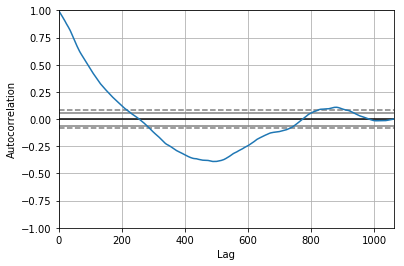

<Figure size 800x560 with 0 Axes>

Test MSE: 3.646


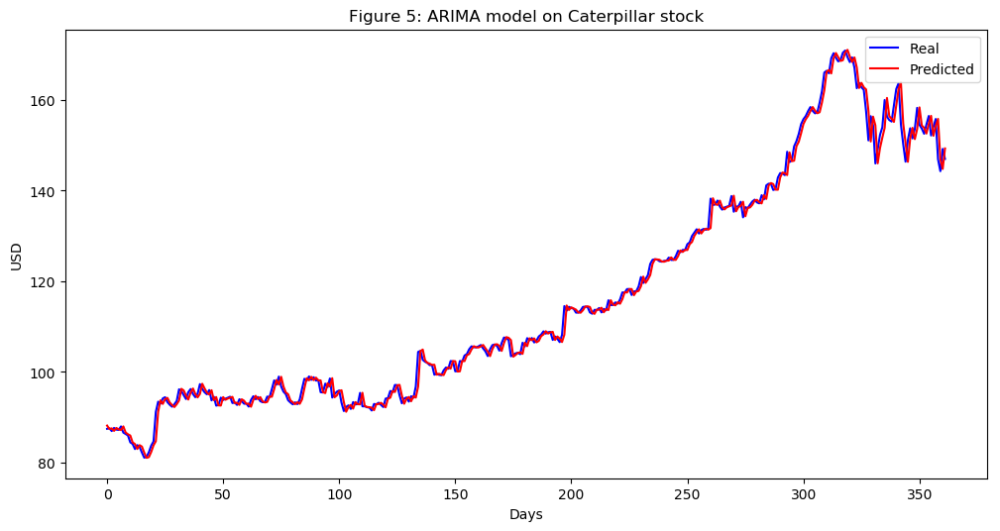

In [273]:
Caterpillar_series = SP500_TechIndicator['Caterpillar_Close']
Caterpillar_series_model = ARIMA(Caterpillar_series, order=(5, 1, 0))
Caterpillar_model_fit = Caterpillar_series_model.fit(disp=0)
print(Caterpillar_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Caterpillar_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Caterpillar_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Caterpillar_predictions = list()
for t in range(len(test)):
    Caterpillar_series_model = ARIMA(history, order=(5,1,0))
    Caterpillar_series_model_fit = Caterpillar_series_model.fit(disp=0)
    Caterpillar_output = Caterpillar_series_model_fit.forecast()
    yhat = Caterpillar_output[0]
    Caterpillar_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Caterpillar_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Caterpillar_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Caterpillar stock')
plt.legend()
plt.show()


#predictions
Caterpillar_predictions = pd.DataFrame({'Caterpillar_predictions':Caterpillar_predictions})
#Caterpillar_predictions.to_csv('Caterpillar_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Cintas_Corporation_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1772.787
Method:                               css-mle   S.D. of innovations              1.286
Date:                        Sun, 17 Mar 2019   AIC                           3559.573
Time:                                18:18:33   BIC                           3594.342
Sample:                                     1   HQIC                          3572.750
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.1040      0.038      2.755      0.006       0.030       0.178
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


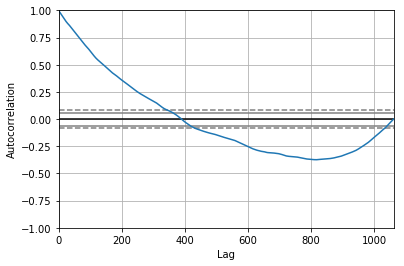

<Figure size 800x560 with 0 Axes>

Test MSE: 2.965


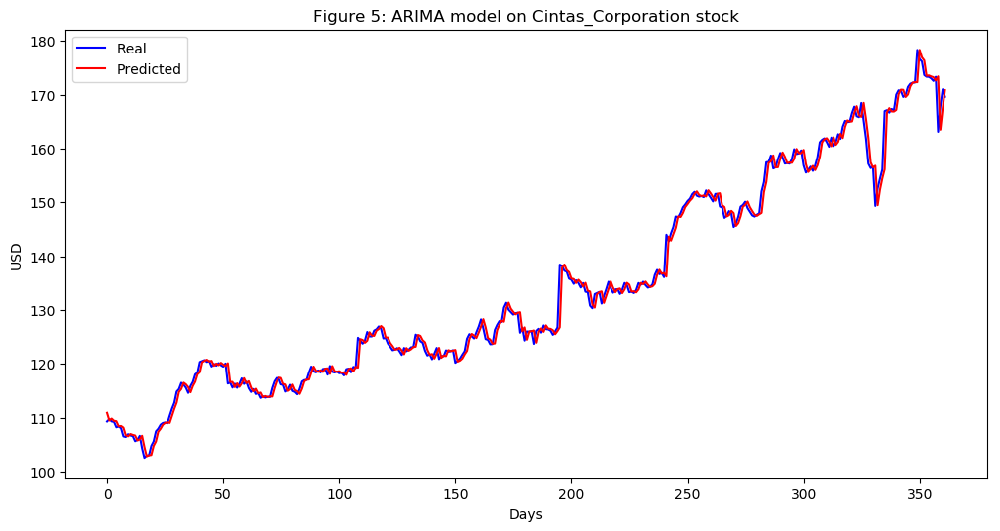

In [274]:
Cintas_Corporation_series = SP500_TechIndicator['Cintas_Corporation_Close']
Cintas_Corporation_series_model = ARIMA(Cintas_Corporation_series, order=(5, 1, 0))
Cintas_Corporation_model_fit = Cintas_Corporation_series_model.fit(disp=0)
print(Cintas_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Cintas_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Cintas_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Cintas_Corporation_predictions = list()
for t in range(len(test)):
    Cintas_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Cintas_Corporation_series_model_fit = Cintas_Corporation_series_model.fit(disp=0)
    Cintas_Corporation_output = Cintas_Corporation_series_model_fit.forecast()
    yhat = Cintas_Corporation_output[0]
    Cintas_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Cintas_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Cintas_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Cintas_Corporation stock')
plt.legend()
plt.show()


#predictions
Cintas_Corporation_predictions = pd.DataFrame({'Cintas_Corporation_predictions':Cintas_Corporation_predictions})
#Cintas_Corporation_predictions.to_csv('Cintas_Corporation_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Copart_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1554.721
Method:                       css-mle   S.D. of innovations              1.047
Date:                Sun, 17 Mar 2019   AIC                           3123.443
Time:                        18:19:17   BIC                           3158.211
Sample:                             1   HQIC                          3136.619
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0125      0.034      0.373      0.709      -0.053       0.078
ar.L1.D.Copart_Close     0.0002      0.031      0.007      0.995      -0.060       0.060
ar.L2.D.Copa

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


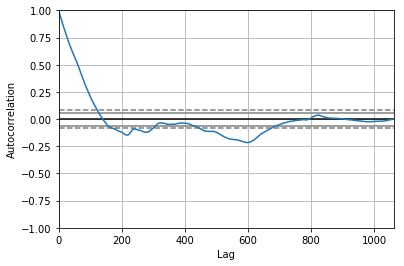

<Figure size 800x560 with 0 Axes>

Test MSE: 2.894


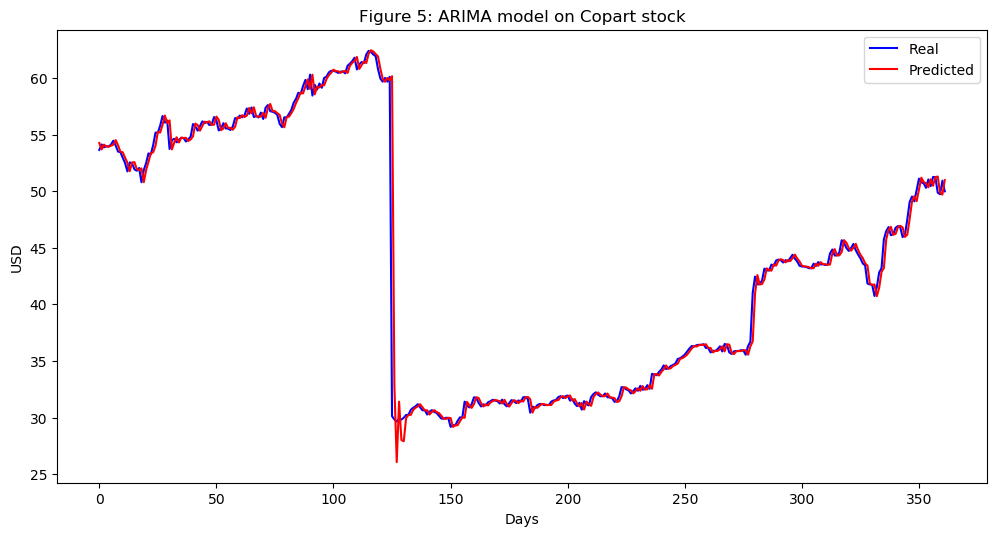

In [275]:
Copart_series = SP500_TechIndicator['Copart_Close']
Copart_series_model = ARIMA(Copart_series, order=(5, 1, 0))
Copart_model_fit = Copart_series_model.fit(disp=0)
print(Copart_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Copart_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Copart_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Copart_predictions = list()
for t in range(len(test)):
    Copart_series_model = ARIMA(history, order=(5,1,0))
    Copart_series_model_fit = Copart_series_model.fit(disp=0)
    Copart_output = Copart_series_model_fit.forecast()
    yhat = Copart_output[0]
    Copart_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Copart_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Copart_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Copart stock')
plt.legend()
plt.show()


#predictions
Copart_predictions = pd.DataFrame({'Copart_predictions':Copart_predictions})
#Copart_predictions.to_csv('Copart_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:            D.CSX_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1050.062
Method:                       css-mle   S.D. of innovations              0.651
Date:                Sun, 17 Mar 2019   AIC                           2114.124
Time:                        18:20:11   BIC                           2148.892
Sample:                             1   HQIC                          2127.300
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 0.0245      0.019      1.261      0.208      -0.014       0.062
ar.L1.D.CSX_Close    -0.0452      0.031     -1.472      0.141      -0.105       0.015
ar.L2.D.CSX_Close    -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


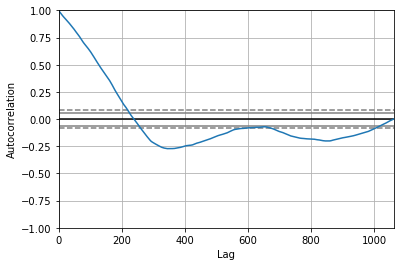

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.846


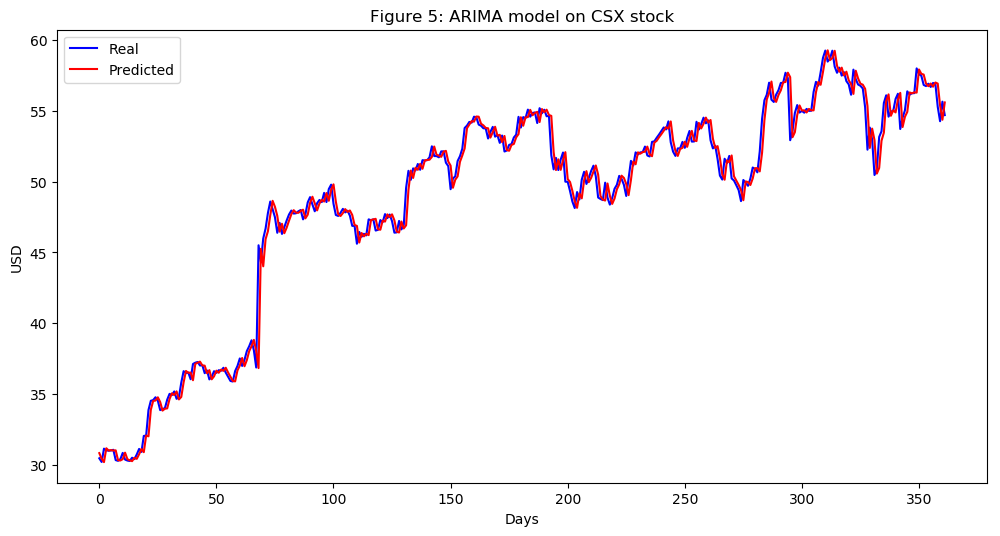

In [276]:
CSX_series = SP500_TechIndicator['CSX_Close']
CSX_series_model = ARIMA(CSX_series, order=(5, 1, 0))
CSX_model_fit = CSX_series_model.fit(disp=0)
print(CSX_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(CSX_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = CSX_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
CSX_predictions = list()
for t in range(len(test)):
    CSX_series_model = ARIMA(history, order=(5,1,0))
    CSX_series_model_fit = CSX_series_model.fit(disp=0)
    CSX_output = CSX_series_model_fit.forecast()
    yhat = CSX_output[0]
    CSX_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, CSX_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(CSX_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on CSX stock')
plt.legend()
plt.show()


#predictions
CSX_predictions = pd.DataFrame({'CSX_predictions':CSX_predictions})
#CSX_predictions.to_csv('CSX_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Cummins_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2213.212
Method:                       css-mle   S.D. of innovations              1.948
Date:                Sun, 17 Mar 2019   AIC                           4440.424
Time:                        18:21:13   BIC                           4475.192
Sample:                             1   HQIC                          4453.600
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0168      0.056      0.298      0.766      -0.094       0.127
ar.L1.D.Cummins_Close     0.0125      0.031      0.406      0.685      -0.048       0.073
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


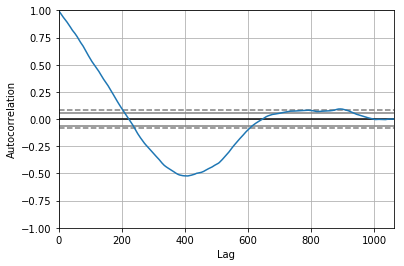

<Figure size 800x560 with 0 Axes>

Test MSE: 4.167


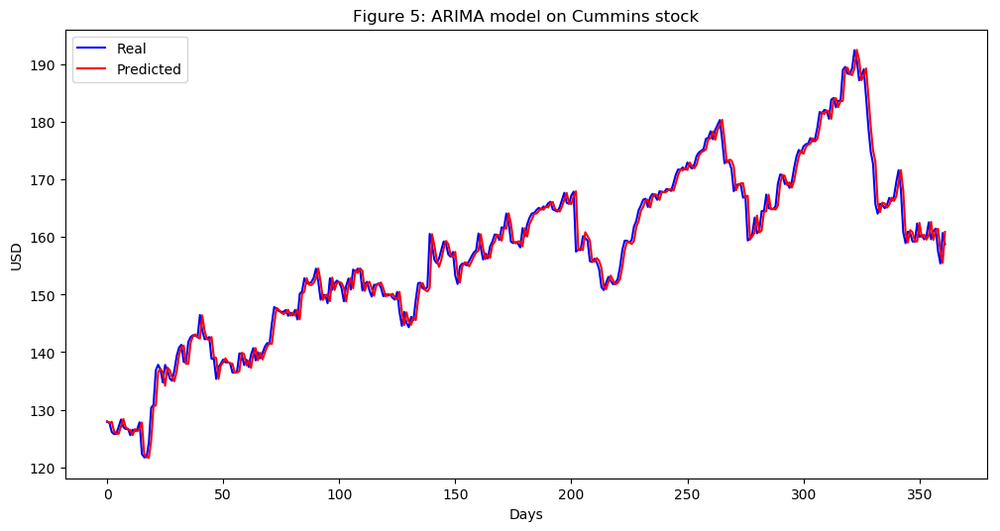

In [277]:
Cummins_series = SP500_TechIndicator['Cummins_Close']
Cummins_series_model = ARIMA(Cummins_series, order=(5, 1, 0))
Cummins_model_fit = Cummins_series_model.fit(disp=0)
print(Cummins_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Cummins_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Cummins_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Cummins_predictions = list()
for t in range(len(test)):
    Cummins_series_model = ARIMA(history, order=(5,1,0))
    Cummins_series_model_fit = Cummins_series_model.fit(disp=0)
    Cummins_output = Cummins_series_model_fit.forecast()
    yhat = Cummins_output[0]
    Cummins_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Cummins_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Cummins_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Cummins stock')
plt.legend()
plt.show()


#predictions
Cummins_predictions = pd.DataFrame({'Cummins_predictions':Cummins_predictions})
#Cummins_predictions.to_csv('Cummins_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Deere_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1866.309
Method:                       css-mle   S.D. of innovations              1.405
Date:                Sun, 17 Mar 2019   AIC                           3746.618
Time:                        18:21:59   BIC                           3781.386
Sample:                             1   HQIC                          3759.794
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0571      0.041      1.379      0.168      -0.024       0.138
ar.L1.D.Deere_Close     0.0576      0.031      1.874      0.061      -0.003       0.118
ar.L2.D.Deere_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


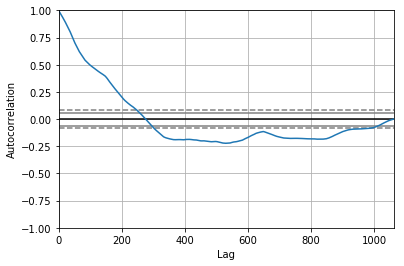

<Figure size 800x560 with 0 Axes>

Test MSE: 3.381


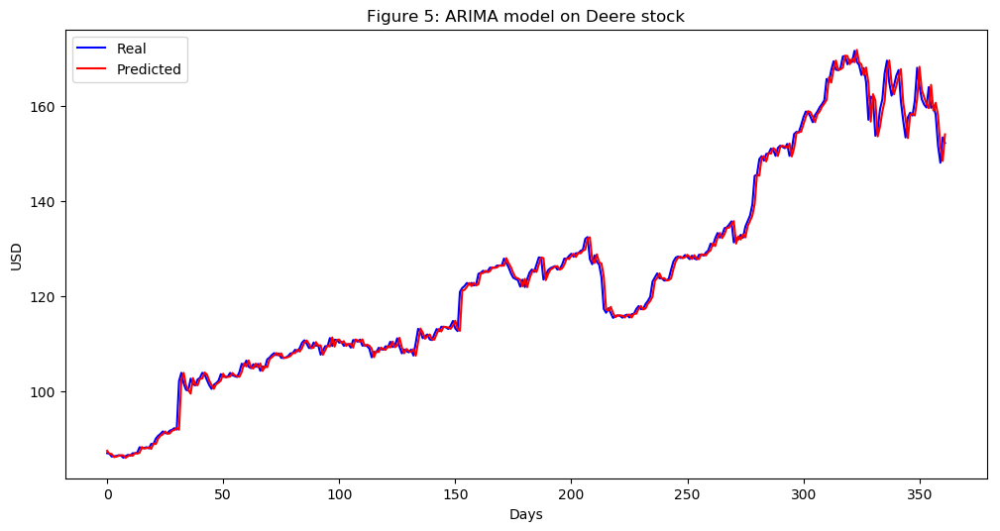

In [278]:
Deere_series = SP500_TechIndicator['Deere_Close']
Deere_series_model = ARIMA(Deere_series, order=(5, 1, 0))
Deere_model_fit = Deere_series_model.fit(disp=0)
print(Deere_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Deere_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Deere_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Deere_predictions = list()
for t in range(len(test)):
    Deere_series_model = ARIMA(history, order=(5,1,0))
    Deere_series_model_fit = Deere_series_model.fit(disp=0)
    Deere_output = Deere_series_model_fit.forecast()
    yhat = Deere_output[0]
    Deere_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Deere_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Deere_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Deere stock')
plt.legend()
plt.show()


#predictions
Deere_predictions = pd.DataFrame({'Deere_predictions':Deere_predictions})
#Deere_predictions.to_csv('Deere_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.Delta_Air_Lines_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1313.295
Method:                            css-mle   S.D. of innovations              0.834
Date:                     Sun, 17 Mar 2019   AIC                           2640.590
Time:                             18:22:44   BIC                           2675.359
Sample:                                  1   HQIC                          2653.767
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0251      0.026      0.967      0.334      -0.026       0.076
ar.L1.D.Delta_Air_Lines_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


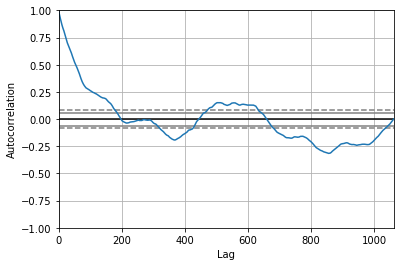

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.613


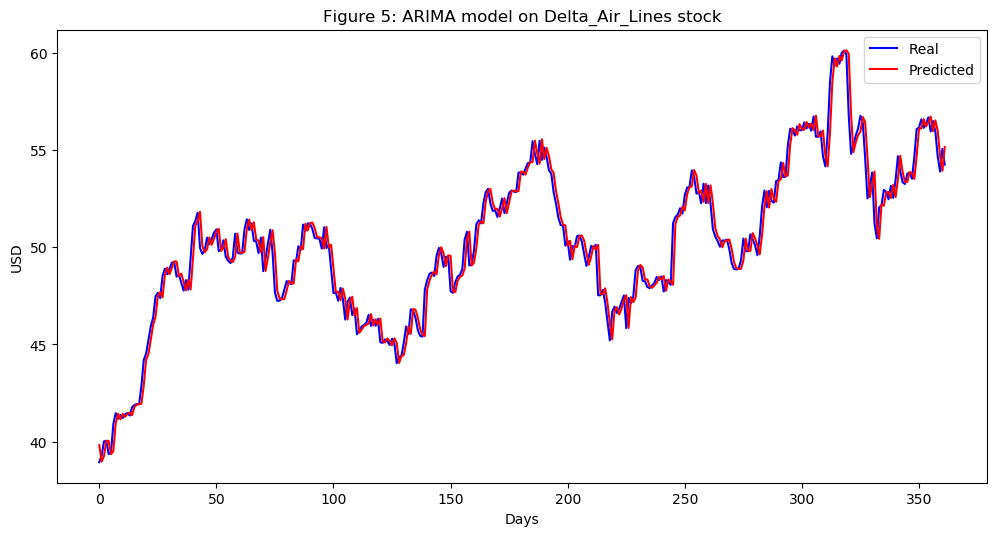

In [279]:
Delta_Air_Lines_series = SP500_TechIndicator['Delta_Air_Lines_Close']
Delta_Air_Lines_series_model = ARIMA(Delta_Air_Lines_series, order=(5, 1, 0))
Delta_Air_Lines_model_fit = Delta_Air_Lines_series_model.fit(disp=0)
print(Delta_Air_Lines_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Delta_Air_Lines_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Delta_Air_Lines_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Delta_Air_Lines_predictions = list()
for t in range(len(test)):
    Delta_Air_Lines_series_model = ARIMA(history, order=(5,1,0))
    Delta_Air_Lines_series_model_fit = Delta_Air_Lines_series_model.fit(disp=0)
    Delta_Air_Lines_output = Delta_Air_Lines_series_model_fit.forecast()
    yhat = Delta_Air_Lines_output[0]
    Delta_Air_Lines_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Delta_Air_Lines_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Delta_Air_Lines_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Delta_Air_Lines stock')
plt.legend()
plt.show()


#predictions
Delta_Air_Lines_predictions = pd.DataFrame({'Delta_Air_Lines_predictions':Delta_Air_Lines_predictions})
#Delta_Air_Lines_predictions.to_csv('Delta_Air_Lines_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Dover_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1694.011
Method:                       css-mle   S.D. of innovations              1.194
Date:                Sun, 17 Mar 2019   AIC                           3402.021
Time:                        18:23:33   BIC                           3436.790
Sample:                             1   HQIC                          3415.198
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0022      0.031      0.070      0.944      -0.059       0.063
ar.L1.D.Dover_Close    -0.0305      0.031     -0.993      0.321      -0.091       0.030
ar.L2.D.Dover_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


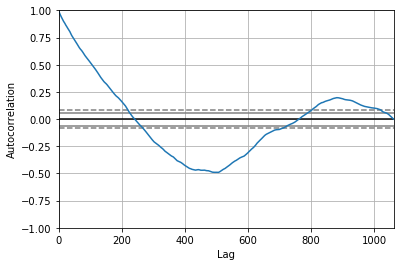

<Figure size 800x560 with 0 Axes>

Test MSE: 1.315


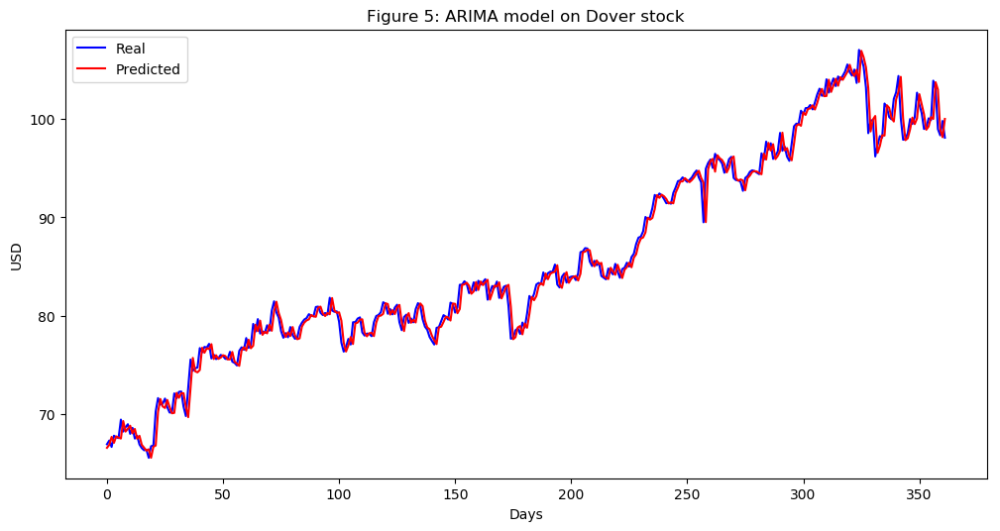

In [280]:
Dover_series = SP500_TechIndicator['Dover_Close']
Dover_series_model = ARIMA(Dover_series, order=(5, 1, 0))
Dover_model_fit = Dover_series_model.fit(disp=0)
print(Dover_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Dover_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Dover_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Dover_predictions = list()
for t in range(len(test)):
    Dover_series_model = ARIMA(history, order=(5,1,0))
    Dover_series_model_fit = Dover_series_model.fit(disp=0)
    Dover_output = Dover_series_model_fit.forecast()
    yhat = Dover_output[0]
    Dover_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Dover_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Dover_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Dover stock')
plt.legend()
plt.show()


#predictions
Dover_predictions = pd.DataFrame({'Dover_predictions':Dover_predictions})
#Dover_predictions.to_csv('Dover_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Eaton_Corporation_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -1445.954
Method:                              css-mle   S.D. of innovations              0.945
Date:                       Sun, 17 Mar 2019   AIC                           2905.908
Time:                               18:24:23   BIC                           2940.677
Sample:                                    1   HQIC                          2919.085
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0035      0.027      0.130      0.897      -0.050       0.057
ar.L1.D.Eato

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


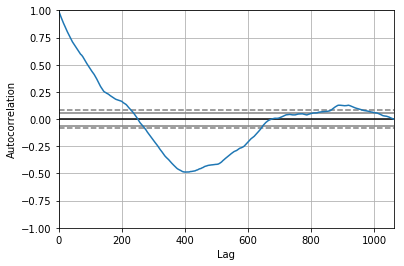

<Figure size 800x560 with 0 Axes>

Test MSE: 0.821


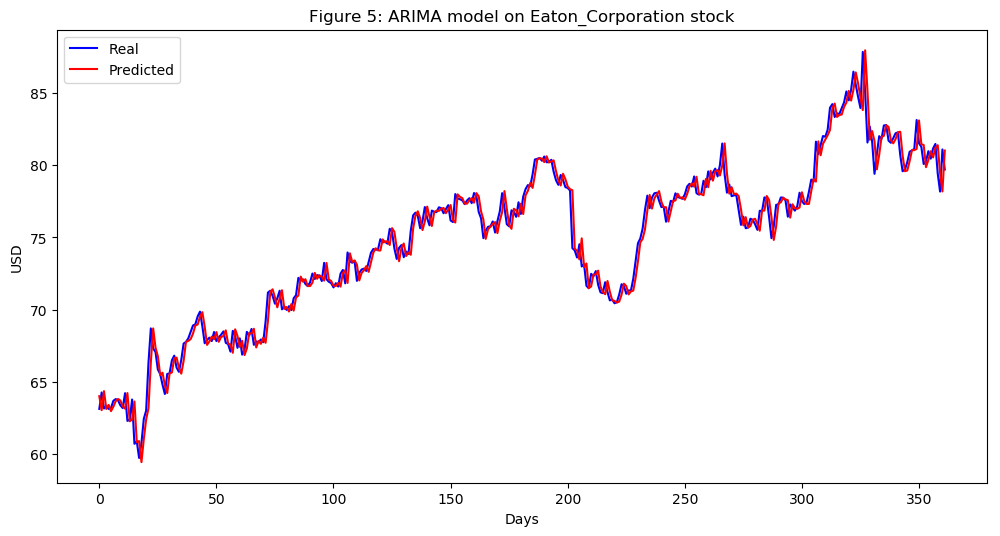

In [281]:
Eaton_Corporation_series = SP500_TechIndicator['Eaton_Corporation_Close']
Eaton_Corporation_series_model = ARIMA(Eaton_Corporation_series, order=(5, 1, 0))
Eaton_Corporation_model_fit = Eaton_Corporation_series_model.fit(disp=0)
print(Eaton_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Eaton_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Eaton_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Eaton_Corporation_predictions = list()
for t in range(len(test)):
    Eaton_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Eaton_Corporation_series_model_fit = Eaton_Corporation_series_model.fit(disp=0)
    Eaton_Corporation_output = Eaton_Corporation_series_model_fit.forecast()
    yhat = Eaton_Corporation_output[0]
    Eaton_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Eaton_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Eaton_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Eaton_Corporation stock')
plt.legend()
plt.show()


#predictions
Eaton_Corporation_predictions = pd.DataFrame({'Eaton_Corporation_predictions':Eaton_Corporation_predictions})
#Eaton_Corporation_predictions.to_csv('Eaton_Corporation_predictions.csv')



                                    ARIMA Model Results                                     
Dep. Variable:     D.Emerson_Electric_Company_Close   No. Observations:                 1061
Model:                               ARIMA(5, 1, 0)   Log Likelihood               -1182.344
Method:                                     css-mle   S.D. of innovations              0.737
Date:                              Sun, 17 Mar 2019   AIC                           2378.689
Time:                                      18:25:11   BIC                           2413.458
Sample:                                           1   HQIC                          2391.865
                                                                                            
                                             coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------------
const                                     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


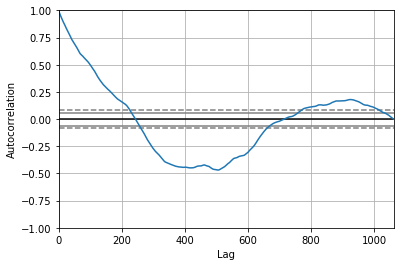

<Figure size 800x560 with 0 Axes>

Test MSE: 0.602


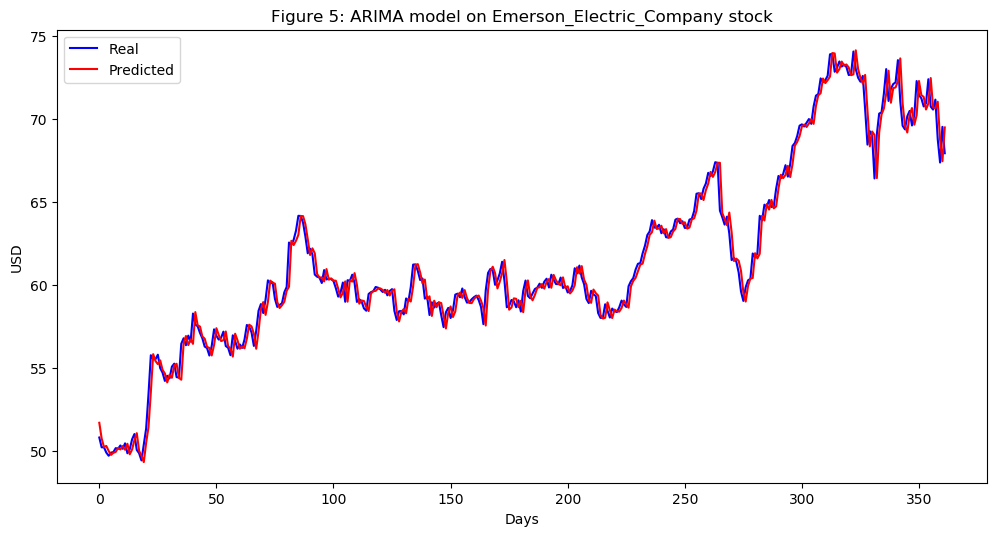

In [282]:
Emerson_Electric_Company_series = SP500_TechIndicator['Emerson_Electric_Company_Close']
Emerson_Electric_Company_series_model = ARIMA(Emerson_Electric_Company_series, order=(5, 1, 0))
Emerson_Electric_Company_model_fit = Emerson_Electric_Company_series_model.fit(disp=0)
print(Emerson_Electric_Company_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Emerson_Electric_Company_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Emerson_Electric_Company_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Emerson_Electric_Company_predictions = list()
for t in range(len(test)):
    Emerson_Electric_Company_series_model = ARIMA(history, order=(5,1,0))
    Emerson_Electric_Company_series_model_fit = Emerson_Electric_Company_series_model.fit(disp=0)
    Emerson_Electric_Company_output = Emerson_Electric_Company_series_model_fit.forecast()
    yhat = Emerson_Electric_Company_output[0]
    Emerson_Electric_Company_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Emerson_Electric_Company_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Emerson_Electric_Company_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Emerson_Electric_Company stock')
plt.legend()
plt.show()


#predictions
Emerson_Electric_Company_predictions = pd.DataFrame({'Emerson_Electric_Company_predictions':Emerson_Electric_Company_predictions})
#Emerson_Electric_Company_predictions.to_csv('Emerson_Electric_Company_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Equifax_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1953.120
Method:                       css-mle   S.D. of innovations              1.525
Date:                Sun, 17 Mar 2019   AIC                           3920.240
Time:                        18:26:13   BIC                           3955.009
Sample:                             1   HQIC                          3933.417
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0442      0.058      0.766      0.444      -0.069       0.157
ar.L1.D.Equifax_Close     0.1129      0.031      3.678      0.000       0.053       0.173
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


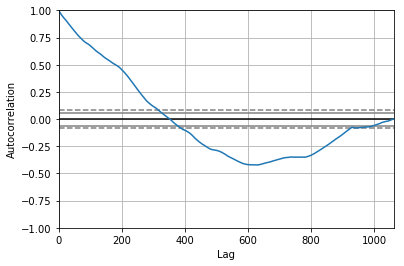

<Figure size 800x560 with 0 Axes>

Test MSE: 4.567


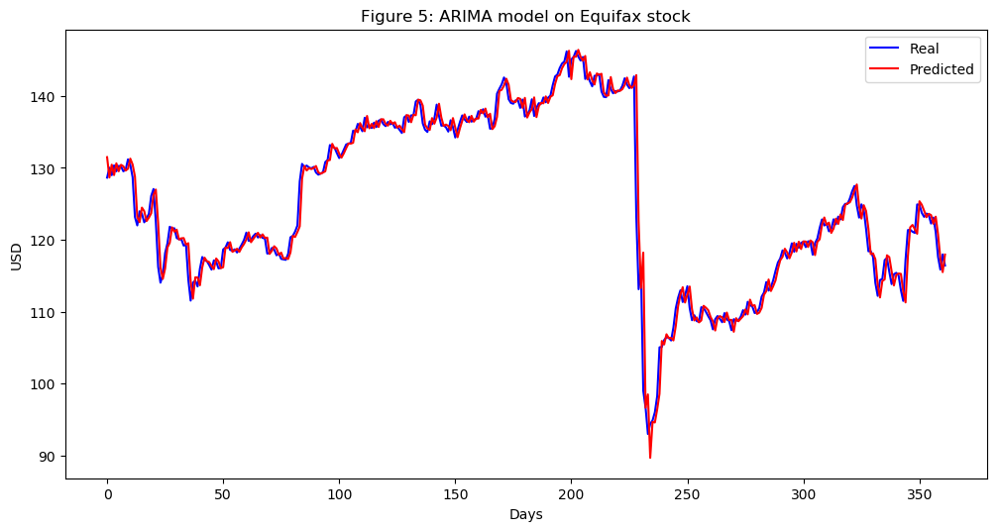

In [283]:
Equifax_series = SP500_TechIndicator['Equifax_Close']
Equifax_series_model = ARIMA(Equifax_series, order=(5, 1, 0))
Equifax_model_fit = Equifax_series_model.fit(disp=0)
print(Equifax_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Equifax_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Equifax_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Equifax_predictions = list()
for t in range(len(test)):
    Equifax_series_model = ARIMA(history, order=(5,1,0))
    Equifax_series_model_fit = Equifax_series_model.fit(disp=0)
    Equifax_output = Equifax_series_model_fit.forecast()
    yhat = Equifax_output[0]
    Equifax_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Equifax_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Equifax_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Equifax stock')
plt.legend()
plt.show()


#predictions
Equifax_predictions = pd.DataFrame({'Equifax_predictions':Equifax_predictions})
#Equifax_predictions.to_csv('Equifax_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:     D.Expeditors_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -964.994
Method:                       css-mle   S.D. of innovations              0.601
Date:                Sun, 17 Mar 2019   AIC                           1943.988
Time:                        18:26:57   BIC                           1978.757
Sample:                             1   HQIC                          1957.164
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0167      0.016      1.077      0.282      -0.014       0.047
ar.L1.D.Expeditors_Close    -0.0601      0.031     -1.956      0.051      -0.120       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


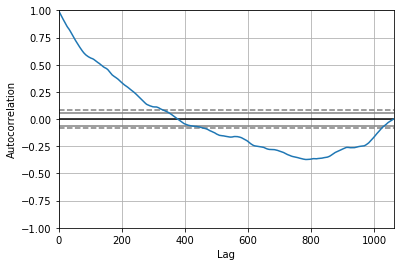

<Figure size 800x560 with 0 Axes>

Test MSE: 0.464


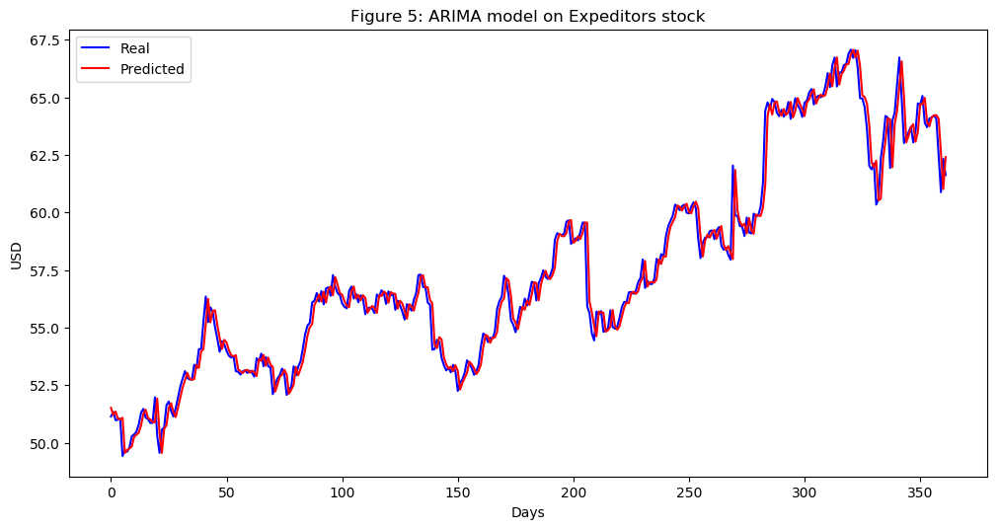

In [284]:
Expeditors_series = SP500_TechIndicator['Expeditors_Close']
Expeditors_series_model = ARIMA(Expeditors_series, order=(5, 1, 0))
Expeditors_model_fit = Expeditors_series_model.fit(disp=0)
print(Expeditors_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Expeditors_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Expeditors_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Expeditors_predictions = list()
for t in range(len(test)):
    Expeditors_series_model = ARIMA(history, order=(5,1,0))
    Expeditors_series_model_fit = Expeditors_series_model.fit(disp=0)
    Expeditors_output = Expeditors_series_model_fit.forecast()
    yhat = Expeditors_output[0]
    Expeditors_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Expeditors_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Expeditors_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Expeditors stock')
plt.legend()
plt.show()


#predictions
Expeditors_predictions = pd.DataFrame({'Expeditors_predictions':Expeditors_predictions})
#Expeditors_predictions.to_csv('Expeditors_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Fastenal_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1066.306
Method:                       css-mle   S.D. of innovations              0.661
Date:                Sun, 17 Mar 2019   AIC                           2146.612
Time:                        18:28:11   BIC                           2181.381
Sample:                             1   HQIC                          2159.789
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0052      0.019      0.269      0.788      -0.033       0.043
ar.L1.D.Fastenal_Close    -0.0103      0.031     -0.333      0.739      -0.071       0.050
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


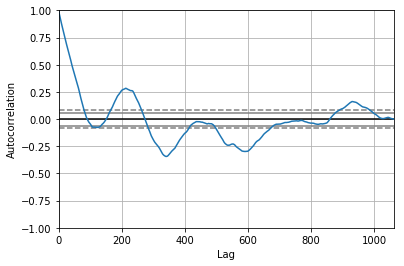

<Figure size 800x560 with 0 Axes>

Test MSE: 0.567


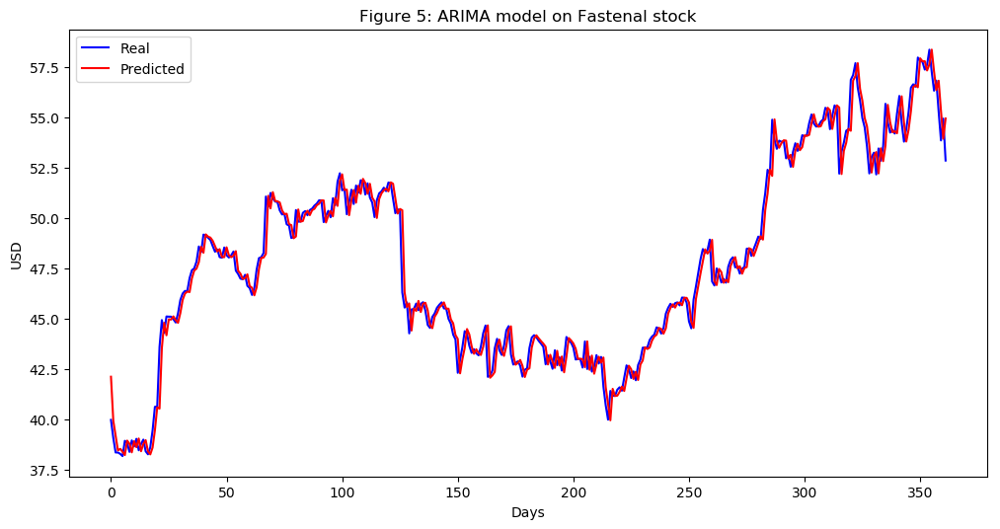

In [285]:
Fastenal_series = SP500_TechIndicator['Fastenal_Close']
Fastenal_series_model = ARIMA(Fastenal_series, order=(5, 1, 0))
Fastenal_model_fit = Fastenal_series_model.fit(disp=0)
print(Fastenal_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Fastenal_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Fastenal_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Fastenal_predictions = list()
for t in range(len(test)):
    Fastenal_series_model = ARIMA(history, order=(5,1,0))
    Fastenal_series_model_fit = Fastenal_series_model.fit(disp=0)
    Fastenal_output = Fastenal_series_model_fit.forecast()
    yhat = Fastenal_output[0]
    Fastenal_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Fastenal_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Fastenal_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Fastenal stock')
plt.legend()
plt.show()


#predictions
Fastenal_predictions = pd.DataFrame({'Fastenal_predictions':Fastenal_predictions})
#Fastenal_predictions.to_csv('Fastenal_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.FedEx_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2391.628
Method:                       css-mle   S.D. of innovations              2.305
Date:                Sun, 17 Mar 2019   AIC                           4797.257
Time:                        18:29:14   BIC                           4832.026
Sample:                             1   HQIC                          4810.433
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0849      0.074      1.140      0.254      -0.061       0.231
ar.L1.D.FedEx_Close     0.0116      0.031      0.378      0.705      -0.049       0.072
ar.L2.D.FedEx_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


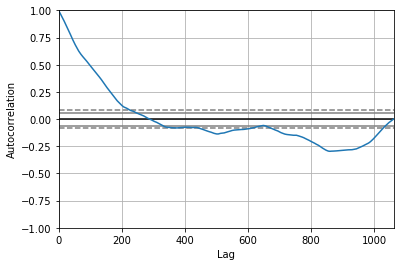

<Figure size 800x560 with 0 Axes>

Test MSE: 7.120


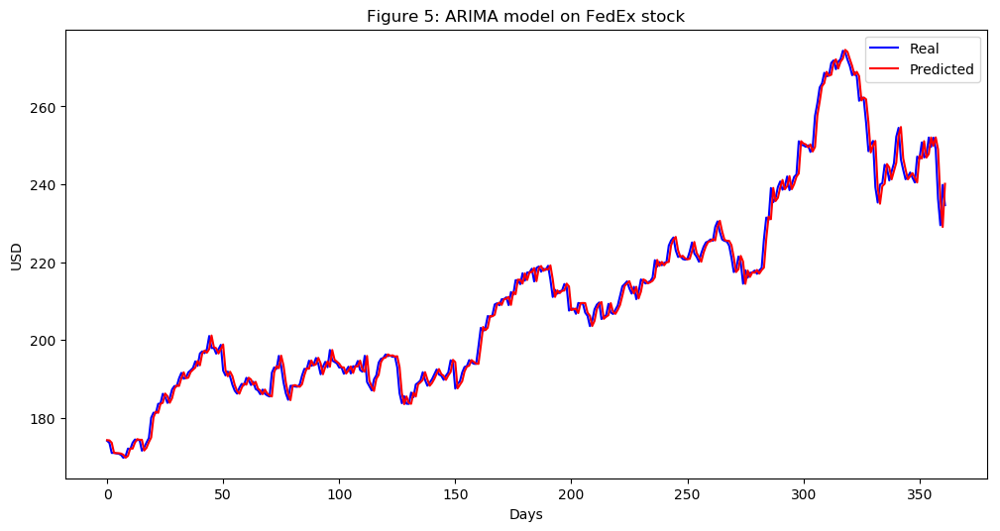

In [286]:
FedEx_series = SP500_TechIndicator['FedEx_Close']
FedEx_series_model = ARIMA(FedEx_series, order=(5, 1, 0))
FedEx_model_fit = FedEx_series_model.fit(disp=0)
print(FedEx_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(FedEx_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = FedEx_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
FedEx_predictions = list()
for t in range(len(test)):
    FedEx_series_model = ARIMA(history, order=(5,1,0))
    FedEx_series_model_fit = FedEx_series_model.fit(disp=0)
    FedEx_output = FedEx_series_model_fit.forecast()
    yhat = FedEx_output[0]
    FedEx_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, FedEx_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(FedEx_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on FedEx stock')
plt.legend()
plt.show()


#predictions
FedEx_predictions = pd.DataFrame({'FedEx_predictions':FedEx_predictions})
#FedEx_predictions.to_csv('FedEx_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.FedEx_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2391.628
Method:                       css-mle   S.D. of innovations              2.305
Date:                Sun, 17 Mar 2019   AIC                           4797.257
Time:                        18:29:55   BIC                           4832.026
Sample:                             1   HQIC                          4810.433
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0849      0.074      1.140      0.254      -0.061       0.231
ar.L1.D.FedEx_Close     0.0116      0.031      0.378      0.705      -0.049       0.072
ar.L2.D.FedEx_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


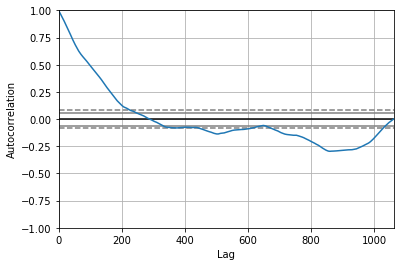

<Figure size 800x560 with 0 Axes>

Test MSE: 7.120


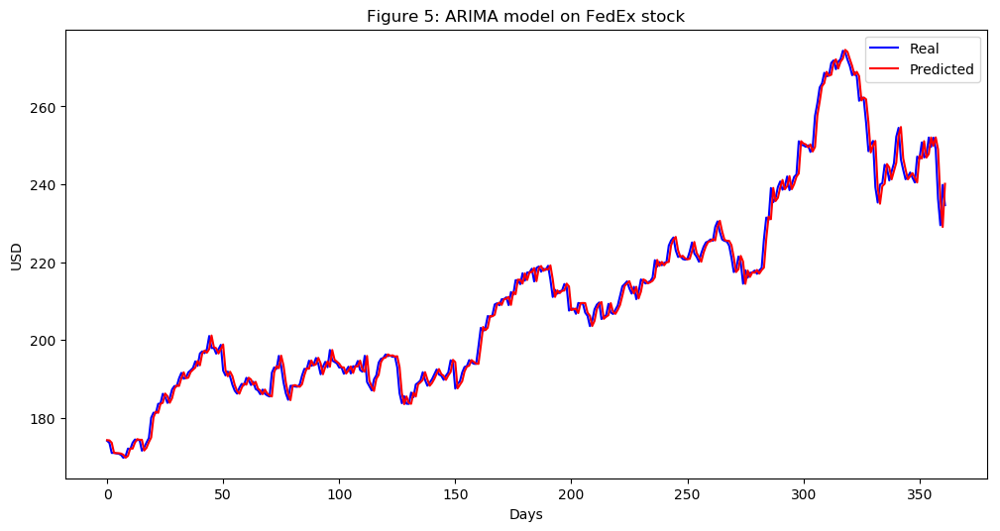

In [287]:
FedEx_series = SP500_TechIndicator['FedEx_Close']
FedEx_series_model = ARIMA(FedEx_series, order=(5, 1, 0))
FedEx_model_fit = FedEx_series_model.fit(disp=0)
print(FedEx_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(FedEx_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = FedEx_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
FedEx_predictions = list()
for t in range(len(test)):
    FedEx_series_model = ARIMA(history, order=(5,1,0))
    FedEx_series_model_fit = FedEx_series_model.fit(disp=0)
    FedEx_output = FedEx_series_model_fit.forecast()
    yhat = FedEx_output[0]
    FedEx_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, FedEx_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(FedEx_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on FedEx stock')
plt.legend()
plt.show()


#predictions
FedEx_predictions = pd.DataFrame({'FedEx_predictions':FedEx_predictions})
#FedEx_predictions.to_csv('FedEx_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Fluor_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1424.042
Method:                       css-mle   S.D. of innovations              0.926
Date:                Sun, 17 Mar 2019   AIC                           2862.085
Time:                        18:30:36   BIC                           2896.853
Sample:                             1   HQIC                          2875.261
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                  -0.0230      0.026     -0.882      0.378      -0.074       0.028
ar.L1.D.Fluor_Close     0.0135      0.031      0.440      0.660      -0.047       0.074
ar.L2.D.Fluor_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


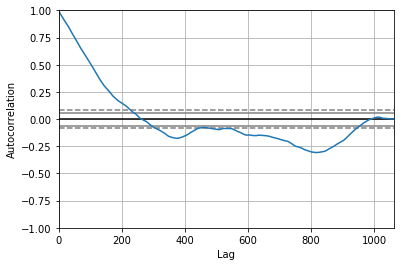

<Figure size 800x560 with 0 Axes>

Test MSE: 0.743


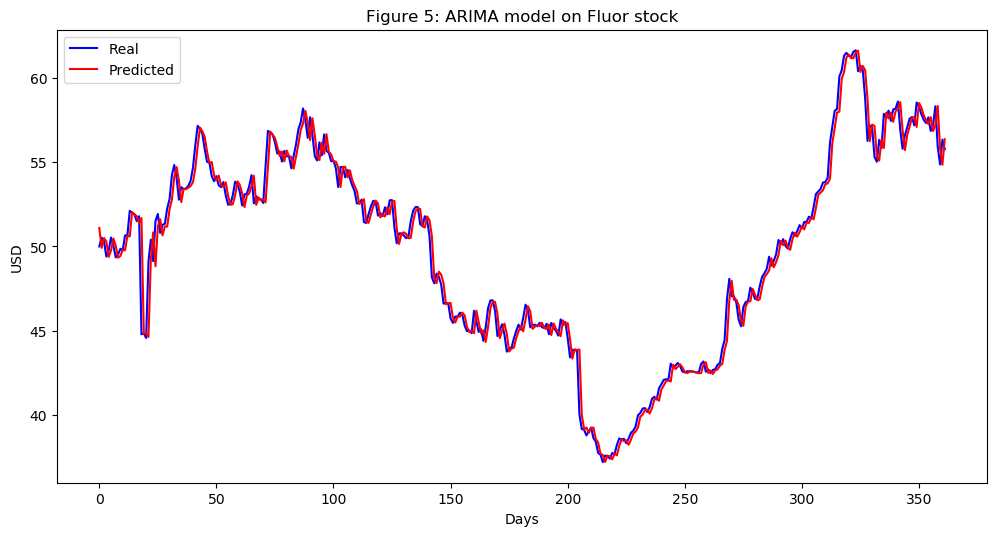

In [288]:
Fluor_series = SP500_TechIndicator['Fluor_Close']
Fluor_series_model = ARIMA(Fluor_series, order=(5, 1, 0))
Fluor_model_fit = Fluor_series_model.fit(disp=0)
print(Fluor_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Fluor_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Fluor_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Fluor_predictions = list()
for t in range(len(test)):
    Fluor_series_model = ARIMA(history, order=(5,1,0))
    Fluor_series_model_fit = Fluor_series_model.fit(disp=0)
    Fluor_output = Fluor_series_model_fit.forecast()
    yhat = Fluor_output[0]
    Fluor_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Fluor_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Fluor_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Fluor stock')
plt.legend()
plt.show()


#predictions
Fluor_predictions = pd.DataFrame({'Fluor_predictions':Fluor_predictions})
#Fluor_predictions.to_csv('Fluor_predictions.csv')



                                      ARIMA Model Results                                       
Dep. Variable:     D.Fortune_Brands_Home_Security_Close   No. Observations:                 1061
Model:                                   ARIMA(5, 1, 0)   Log Likelihood               -1192.629
Method:                                         css-mle   S.D. of innovations              0.745
Date:                                  Sun, 17 Mar 2019   AIC                           2399.258
Time:                                          18:31:28   BIC                           2434.027
Sample:                                               1   HQIC                          2412.434
                                                                                                
                                                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------------
co

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


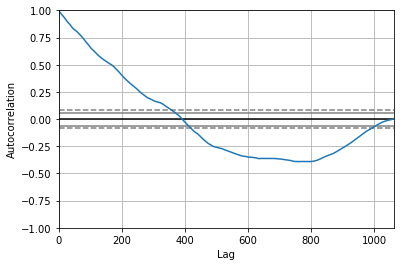

<Figure size 800x560 with 0 Axes>

Test MSE: 0.558


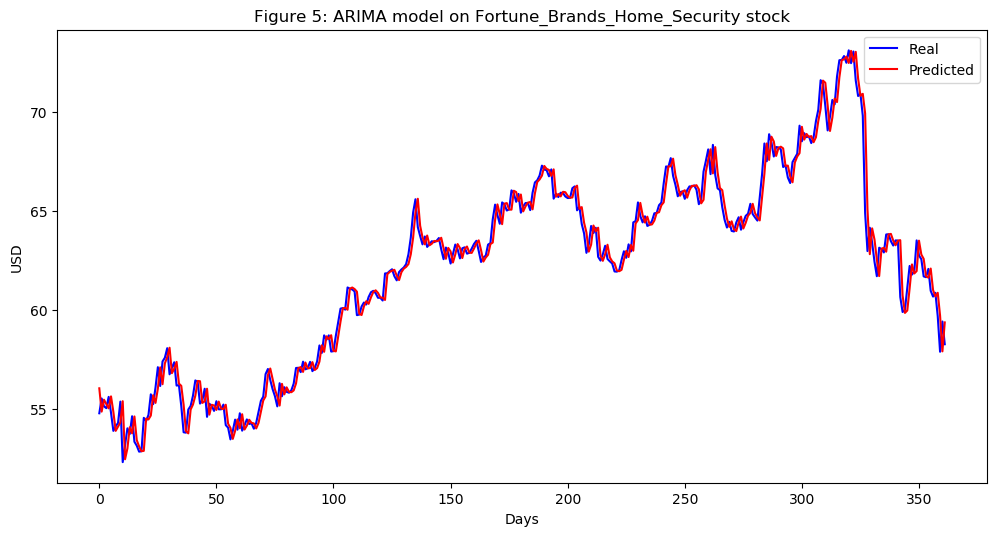

In [289]:
Fortune_Brands_Home_Security_series = SP500_TechIndicator['Fortune_Brands_Home_Security_Close']
Fortune_Brands_Home_Security_series_model = ARIMA(Fortune_Brands_Home_Security_series, order=(5, 1, 0))
Fortune_Brands_Home_Security_model_fit = Fortune_Brands_Home_Security_series_model.fit(disp=0)
print(Fortune_Brands_Home_Security_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Fortune_Brands_Home_Security_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Fortune_Brands_Home_Security_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Fortune_Brands_Home_Security_predictions = list()
for t in range(len(test)):
    Fortune_Brands_Home_Security_series_model = ARIMA(history, order=(5,1,0))
    Fortune_Brands_Home_Security_series_model_fit = Fortune_Brands_Home_Security_series_model.fit(disp=0)
    Fortune_Brands_Home_Security_output = Fortune_Brands_Home_Security_series_model_fit.forecast()
    yhat = Fortune_Brands_Home_Security_output[0]
    Fortune_Brands_Home_Security_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Fortune_Brands_Home_Security_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Fortune_Brands_Home_Security_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Fortune_Brands_Home_Security stock')
plt.legend()
plt.show()


#predictions
Fortune_Brands_Home_Security_predictions = pd.DataFrame({'Fortune_Brands_Home_Security_predictions':Fortune_Brands_Home_Security_predictions})
#Fortune_Brands_Home_Security_predictions.to_csv('Fortune_Brands_Home_Security_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.General_Dynamics_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -2118.822
Method:                             css-mle   S.D. of innovations              1.783
Date:                      Sun, 17 Mar 2019   AIC                           4251.645
Time:                              18:32:22   BIC                           4286.414
Sample:                                   1   HQIC                          4264.821
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.1184      0.051      2.344      0.019       0.019       0.217
ar.L1.D.General_Dynamic

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


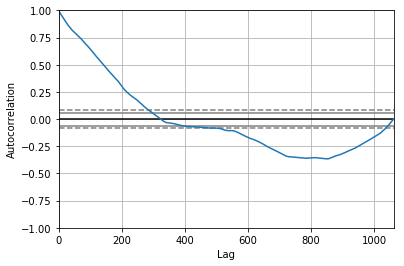

<Figure size 800x560 with 0 Axes>

Test MSE: 5.068


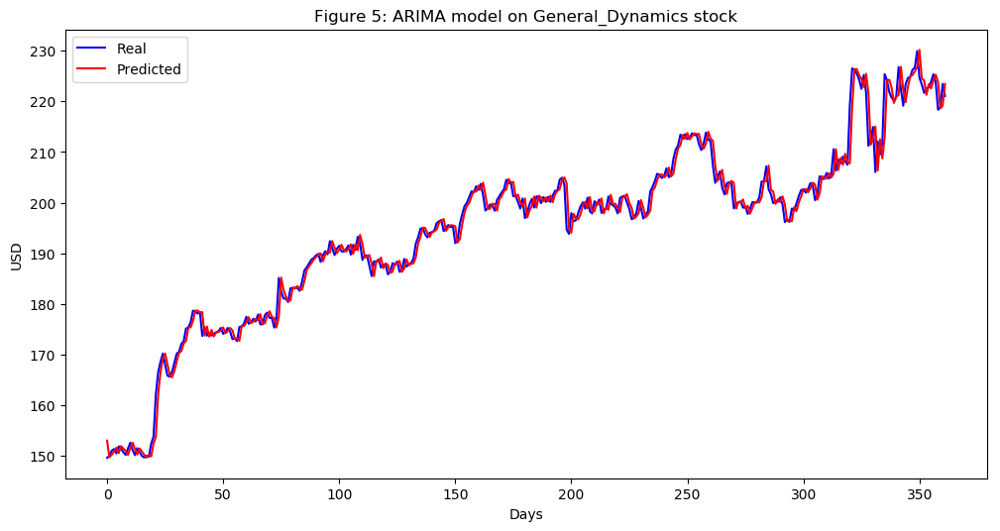

In [290]:
General_Dynamics_series = SP500_TechIndicator['General_Dynamics_Close']
General_Dynamics_series_model = ARIMA(General_Dynamics_series, order=(5, 1, 0))
General_Dynamics_model_fit = General_Dynamics_series_model.fit(disp=0)
print(General_Dynamics_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(General_Dynamics_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = General_Dynamics_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
General_Dynamics_predictions = list()
for t in range(len(test)):
    General_Dynamics_series_model = ARIMA(history, order=(5,1,0))
    General_Dynamics_series_model_fit = General_Dynamics_series_model.fit(disp=0)
    General_Dynamics_output = General_Dynamics_series_model_fit.forecast()
    yhat = General_Dynamics_output[0]
    General_Dynamics_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, General_Dynamics_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(General_Dynamics_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on General_Dynamics stock')
plt.legend()
plt.show()


#predictions
General_Dynamics_predictions = pd.DataFrame({'General_Dynamics_predictions':General_Dynamics_predictions})
#General_Dynamics_predictions.to_csv('General_Dynamics_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.General_Electric_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood                -279.177
Method:                             css-mle   S.D. of innovations              0.315
Date:                      Sun, 17 Mar 2019   AIC                            572.354
Time:                              18:33:07   BIC                            607.123
Sample:                                   1   HQIC                           585.531
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                             -0.0137      0.009     -1.456      0.146      -0.032       0.005
ar.L1.D.General_Electri

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


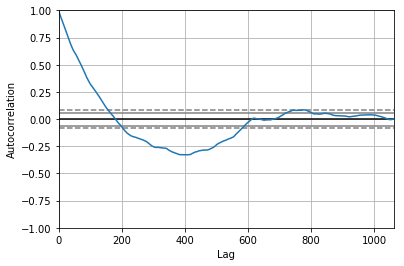

<Figure size 800x560 with 0 Axes>

Test MSE: 0.098


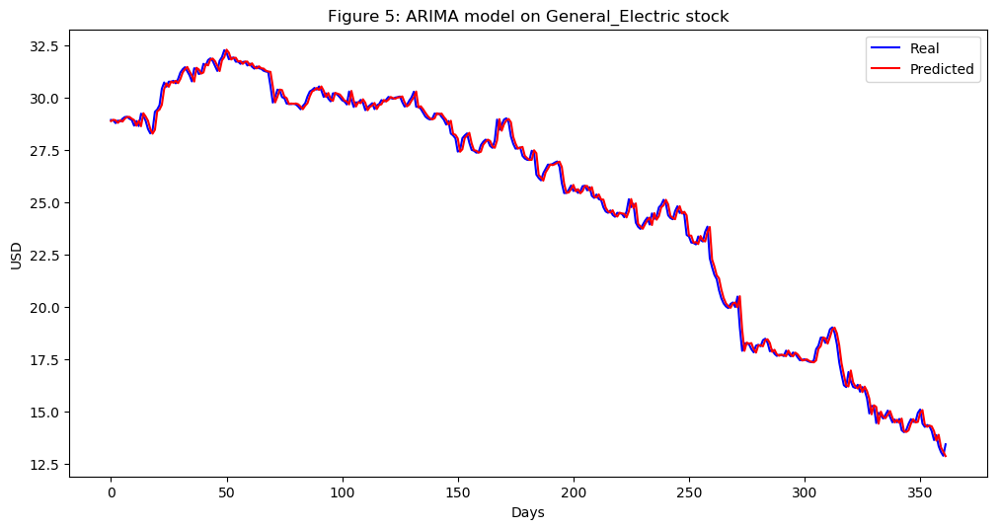

In [291]:
General_Electric_series = SP500_TechIndicator['General_Electric_Close']
General_Electric_series_model = ARIMA(General_Electric_series, order=(5, 1, 0))
General_Electric_model_fit = General_Electric_series_model.fit(disp=0)
print(General_Electric_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(General_Electric_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = General_Electric_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
General_Electric_predictions = list()
for t in range(len(test)):
    General_Electric_series_model = ARIMA(history, order=(5,1,0))
    General_Electric_series_model_fit = General_Electric_series_model.fit(disp=0)
    General_Electric_output = General_Electric_series_model_fit.forecast()
    yhat = General_Electric_output[0]
    General_Electric_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, General_Electric_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(General_Electric_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on General_Electric stock')
plt.legend()
plt.show()


#predictions
General_Electric_predictions = pd.DataFrame({'General_Electric_predictions':General_Electric_predictions})
#General_Electric_predictions.to_csv('General_Electric_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Grainger_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2820.030
Method:                       css-mle   S.D. of innovations              3.452
Date:                Sun, 17 Mar 2019   AIC                           5654.061
Time:                        20:44:17   BIC                           5688.829
Sample:                             1   HQIC                          5667.237
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0170      0.105      0.161      0.872      -0.189       0.223
ar.L1.D.Grainger_Close     0.0892      0.031      2.908      0.004       0.029       0.149
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


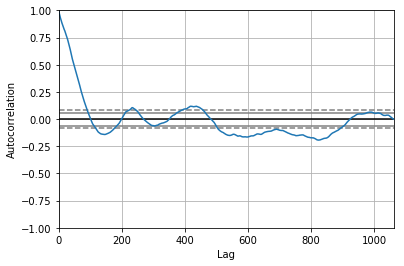

<Figure size 800x560 with 0 Axes>

Test MSE: 18.730


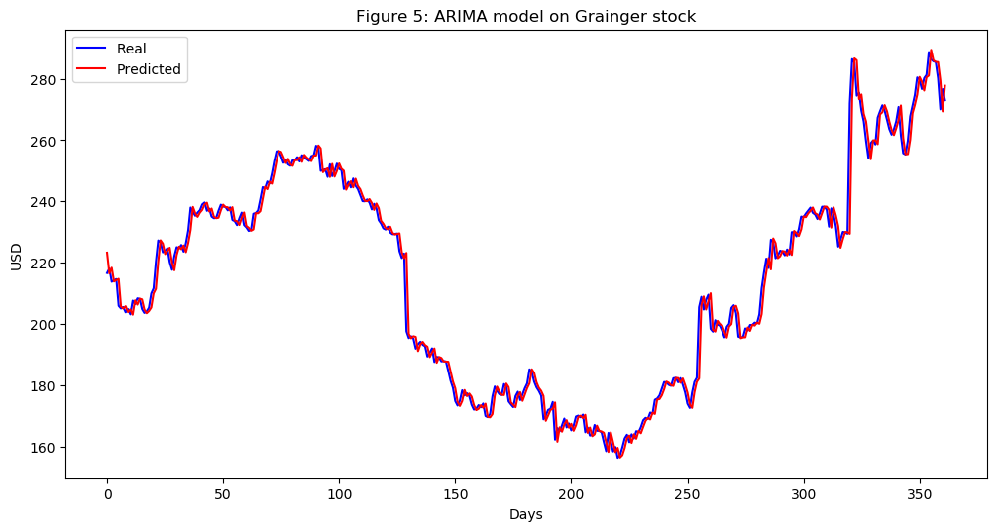

In [292]:
Grainger_series = SP500_TechIndicator['Grainger_Close']
Grainger_series_model = ARIMA(Grainger_series, order=(5, 1, 0))
Grainger_model_fit = Grainger_series_model.fit(disp=0)
print(Grainger_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Grainger_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Grainger_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Grainger_predictions = list()
for t in range(len(test)):
    Grainger_series_model = ARIMA(history, order=(5,1,0))
    Grainger_series_model_fit = Grainger_series_model.fit(disp=0)
    Grainger_output = Grainger_series_model_fit.forecast()
    yhat = Grainger_output[0]
    Grainger_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Grainger_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Grainger_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Grainger stock')
plt.legend()
plt.show()


#predictions
Grainger_predictions = pd.DataFrame({'Grainger_predictions':Grainger_predictions})
#Grainger_predictions.to_csv('Grainger_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Harris_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1639.912
Method:                       css-mle   S.D. of innovations              1.135
Date:                Sun, 17 Mar 2019   AIC                           3293.823
Time:                        20:45:03   BIC                           3328.592
Sample:                             1   HQIC                          3307.000
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0854      0.033      2.572      0.010       0.020       0.150
ar.L1.D.Harris_Close     0.0176      0.031      0.574      0.566      -0.043       0.078
ar.L2.D.Harr

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


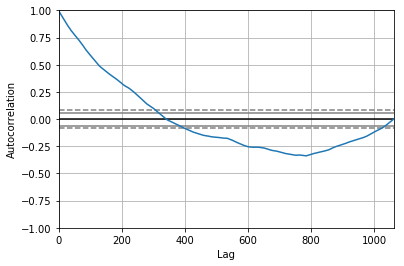

<Figure size 800x560 with 0 Axes>

Test MSE: 1.823


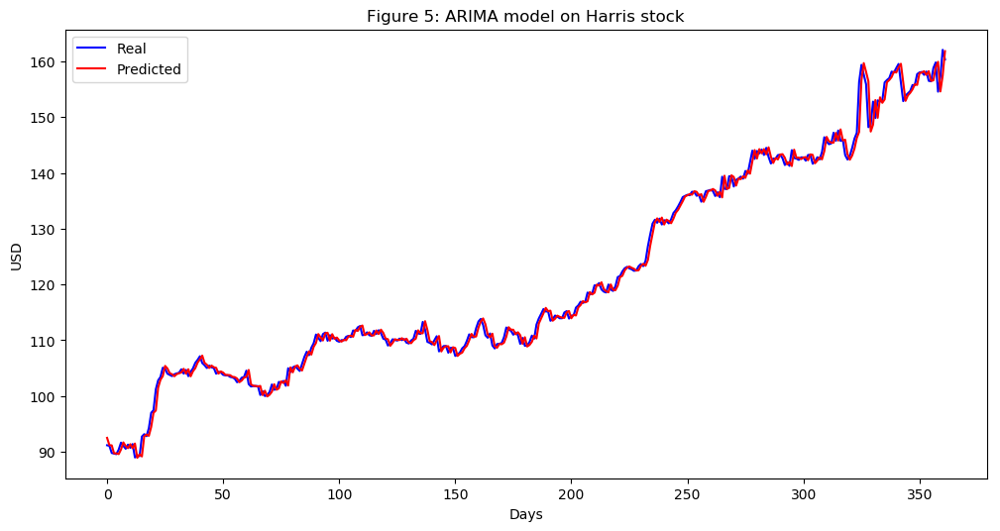

In [293]:
Harris_series = SP500_TechIndicator['Harris_Close']
Harris_series_model = ARIMA(Harris_series, order=(5, 1, 0))
Harris_model_fit = Harris_series_model.fit(disp=0)
print(Harris_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Harris_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Harris_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Harris_predictions = list()
for t in range(len(test)):
    Harris_series_model = ARIMA(history, order=(5,1,0))
    Harris_series_model_fit = Harris_series_model.fit(disp=0)
    Harris_output = Harris_series_model_fit.forecast()
    yhat = Harris_output[0]
    Harris_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Harris_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Harris_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Harris stock')
plt.legend()
plt.show()


#predictions
Harris_predictions = pd.DataFrame({'Harris_predictions':Harris_predictions})
#Harris_predictions.to_csv('Harris_predictions.csv')



                                       ARIMA Model Results                                       
Dep. Variable:     D.Huntington_Ingalls_Industries_Close   No. Observations:                 1061
Model:                                    ARIMA(5, 1, 0)   Log Likelihood               -2421.897
Method:                                          css-mle   S.D. of innovations              2.372
Date:                                   Sun, 17 Mar 2019   AIC                           4857.794
Time:                                           20:45:58   BIC                           4892.563
Sample:                                                1   HQIC                          4870.970
                                                                                                 
                                                  coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


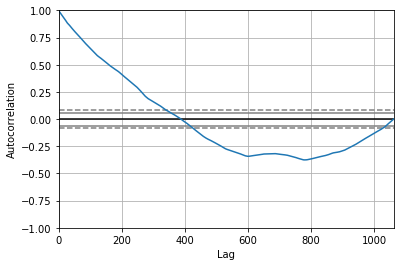

<Figure size 800x560 with 0 Axes>

Test MSE: 10.452


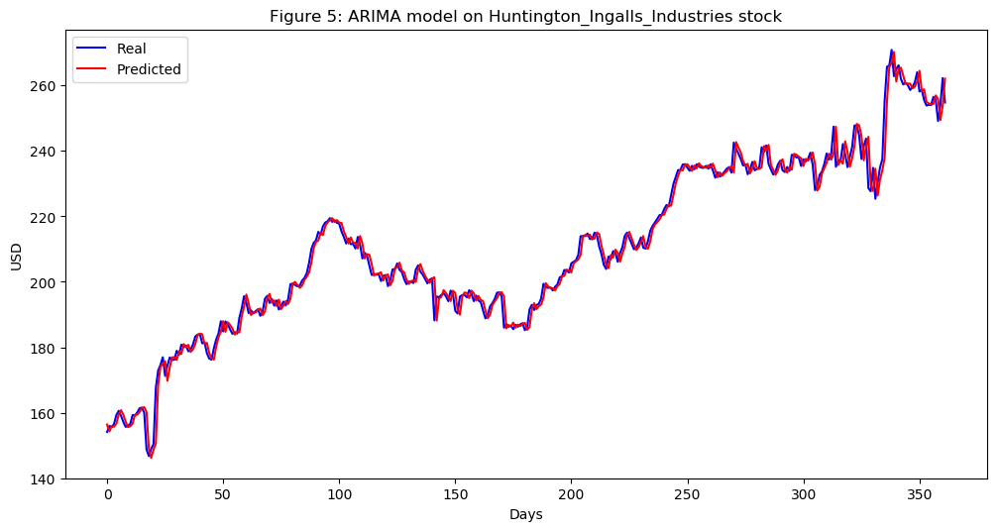

In [294]:
Huntington_Ingalls_Industries_series = SP500_TechIndicator['Huntington_Ingalls_Industries_Close']
Huntington_Ingalls_Industries_series_model = ARIMA(Huntington_Ingalls_Industries_series, order=(5, 1, 0))
Huntington_Ingalls_Industries_model_fit = Huntington_Ingalls_Industries_series_model.fit(disp=0)
print(Huntington_Ingalls_Industries_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Huntington_Ingalls_Industries_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Huntington_Ingalls_Industries_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Huntington_Ingalls_Industries_predictions = list()
for t in range(len(test)):
    Huntington_Ingalls_Industries_series_model = ARIMA(history, order=(5,1,0))
    Huntington_Ingalls_Industries_series_model_fit = Huntington_Ingalls_Industries_series_model.fit(disp=0)
    Huntington_Ingalls_Industries_output = Huntington_Ingalls_Industries_series_model_fit.forecast()
    yhat = Huntington_Ingalls_Industries_output[0]
    Huntington_Ingalls_Industries_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Huntington_Ingalls_Industries_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Huntington_Ingalls_Industries_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Huntington_Ingalls_Industries stock')
plt.legend()
plt.show()


#predictions
Huntington_Ingalls_Industries_predictions = pd.DataFrame({'Huntington_Ingalls_Industries_predictions':Huntington_Ingalls_Industries_predictions})
#Huntington_Ingalls_Industries_predictions.to_csv('Huntington_Ingalls_Industries_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.Ingersoll_Rand_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1398.288
Method:                           css-mle   S.D. of innovations              0.904
Date:                    Sun, 17 Mar 2019   AIC                           2810.576
Time:                            20:46:41   BIC                           2845.345
Sample:                                 1   HQIC                          2823.753
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0222      0.027      0.823      0.411      -0.031       0.075
ar.L1.D.Ingersoll_Rand_Close    -0.0040      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


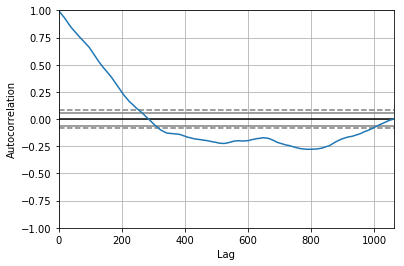

<Figure size 800x560 with 0 Axes>

Test MSE: 1.044


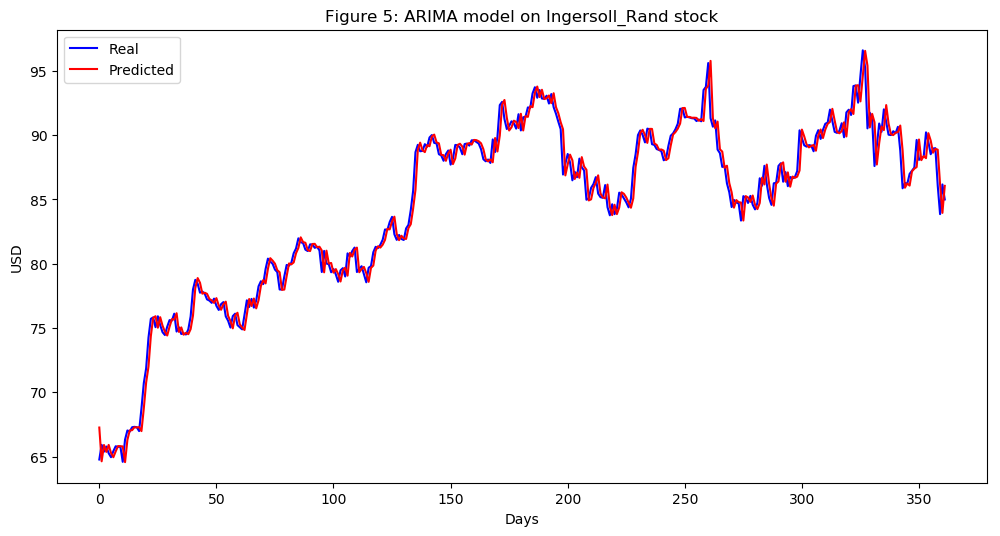

In [295]:
Ingersoll_Rand_series = SP500_TechIndicator['Ingersoll_Rand_Close']
Ingersoll_Rand_series_model = ARIMA(Ingersoll_Rand_series, order=(5, 1, 0))
Ingersoll_Rand_model_fit = Ingersoll_Rand_series_model.fit(disp=0)
print(Ingersoll_Rand_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Ingersoll_Rand_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Ingersoll_Rand_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Ingersoll_Rand_predictions = list()
for t in range(len(test)):
    Ingersoll_Rand_series_model = ARIMA(history, order=(5,1,0))
    Ingersoll_Rand_series_model_fit = Ingersoll_Rand_series_model.fit(disp=0)
    Ingersoll_Rand_output = Ingersoll_Rand_series_model_fit.forecast()
    yhat = Ingersoll_Rand_output[0]
    Ingersoll_Rand_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Ingersoll_Rand_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Ingersoll_Rand_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Ingersoll_Rand stock')
plt.legend()
plt.show()


#predictions
Ingersoll_Rand_predictions = pd.DataFrame({'Ingersoll_Rand_predictions':Ingersoll_Rand_predictions})
#Ingersoll_Rand_predictions.to_csv('Ingersoll_Rand_predictions.csv')



                                    ARIMA Model Results                                     
Dep. Variable:     D.Jacobs_Engineering_Group_Close   No. Observations:                 1061
Model:                               ARIMA(5, 1, 0)   Log Likelihood               -1251.183
Method:                                     css-mle   S.D. of innovations              0.787
Date:                              Sun, 17 Mar 2019   AIC                           2516.365
Time:                                      20:47:35   BIC                           2551.134
Sample:                                           1   HQIC                          2529.542
                                                                                            
                                             coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------------
const                                     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


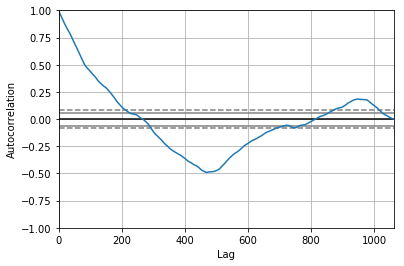

<Figure size 800x560 with 0 Axes>

Test MSE: 0.834


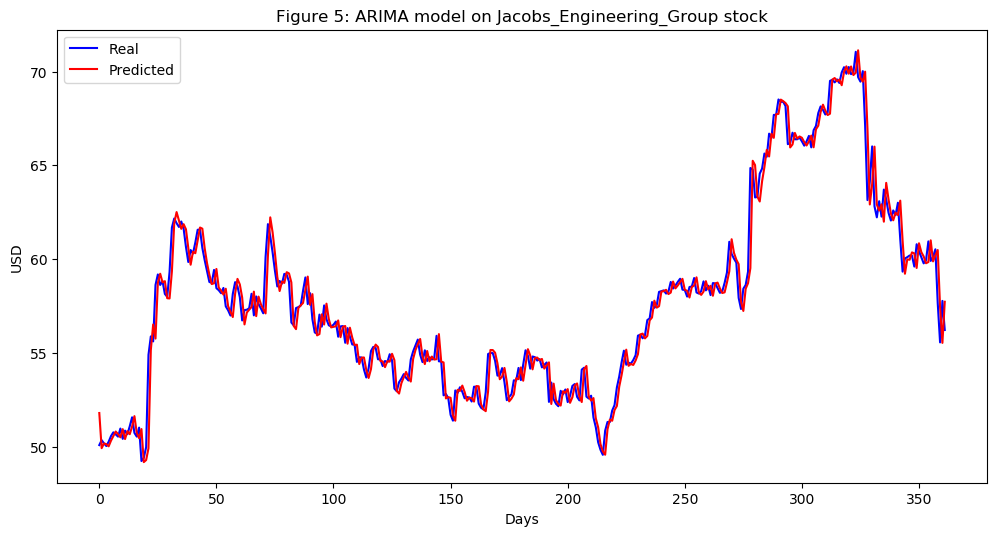

In [296]:
Jacobs_Engineering_Group_series = SP500_TechIndicator['Jacobs_Engineering_Group_Close']
Jacobs_Engineering_Group_series_model = ARIMA(Jacobs_Engineering_Group_series, order=(5, 1, 0))
Jacobs_Engineering_Group_model_fit = Jacobs_Engineering_Group_series_model.fit(disp=0)
print(Jacobs_Engineering_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Jacobs_Engineering_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Jacobs_Engineering_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Jacobs_Engineering_Group_predictions = list()
for t in range(len(test)):
    Jacobs_Engineering_Group_series_model = ARIMA(history, order=(5,1,0))
    Jacobs_Engineering_Group_series_model_fit = Jacobs_Engineering_Group_series_model.fit(disp=0)
    Jacobs_Engineering_Group_output = Jacobs_Engineering_Group_series_model_fit.forecast()
    yhat = Jacobs_Engineering_Group_output[0]
    Jacobs_Engineering_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Jacobs_Engineering_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Jacobs_Engineering_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Jacobs_Engineering_Group stock')
plt.legend()
plt.show()


#predictions
Jacobs_Engineering_Group_predictions = pd.DataFrame({'Jacobs_Engineering_Group_predictions':Jacobs_Engineering_Group_predictions})
#Jacobs_Engineering_Group_predictions.to_csv('Jacobs_Engineering_Group_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.J_B_Hunt_Transport_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1599.923
Method:                               css-mle   S.D. of innovations              1.093
Date:                        Sun, 17 Mar 2019   AIC                           3213.845
Time:                                20:48:30   BIC                           3248.614
Sample:                                     1   HQIC                          3227.022
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0353      0.035      1.020      0.308      -0.033       0.103
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


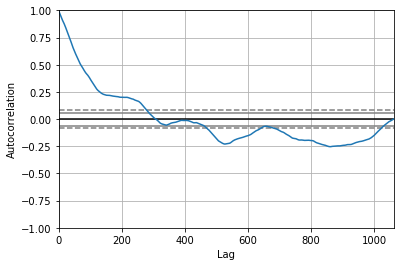

<Figure size 800x560 with 0 Axes>

Test MSE: 1.711


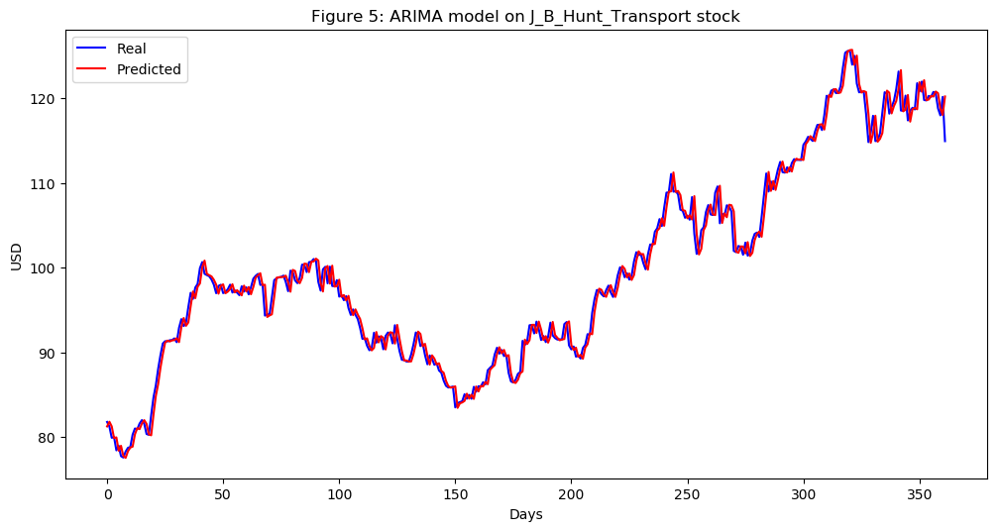

In [297]:
J_B_Hunt_Transport_series = SP500_TechIndicator['J_B_Hunt_Transport_Close']
J_B_Hunt_Transport_series_model = ARIMA(J_B_Hunt_Transport_series, order=(5, 1, 0))
J_B_Hunt_Transport_model_fit = J_B_Hunt_Transport_series_model.fit(disp=0)
print(J_B_Hunt_Transport_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(J_B_Hunt_Transport_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = J_B_Hunt_Transport_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
J_B_Hunt_Transport_predictions = list()
for t in range(len(test)):
    J_B_Hunt_Transport_series_model = ARIMA(history, order=(5,1,0))
    J_B_Hunt_Transport_series_model_fit = J_B_Hunt_Transport_series_model.fit(disp=0)
    J_B_Hunt_Transport_output = J_B_Hunt_Transport_series_model_fit.forecast()
    yhat = J_B_Hunt_Transport_output[0]
    J_B_Hunt_Transport_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, J_B_Hunt_Transport_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(J_B_Hunt_Transport_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on J_B_Hunt_Transport stock')
plt.legend()
plt.show()


#predictions
J_B_Hunt_Transport_predictions = pd.DataFrame({'J_B_Hunt_Transport_predictions':J_B_Hunt_Transport_predictions})
#J_B_Hunt_Transport_predictions.to_csv('J_B_Hunt_Transport_predictions.csv')



                                       ARIMA Model Results                                        
Dep. Variable:     D.Johnson_Controls_International_Close   No. Observations:                 1061
Model:                                     ARIMA(5, 1, 0)   Log Likelihood                -879.931
Method:                                           css-mle   S.D. of innovations              0.555
Date:                                    Sun, 17 Mar 2019   AIC                           1773.862
Time:                                            20:49:19   BIC                           1808.631
Sample:                                                 1   HQIC                          1787.039
                                                                                                  
                                                   coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


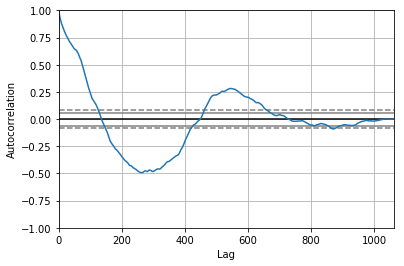

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.352


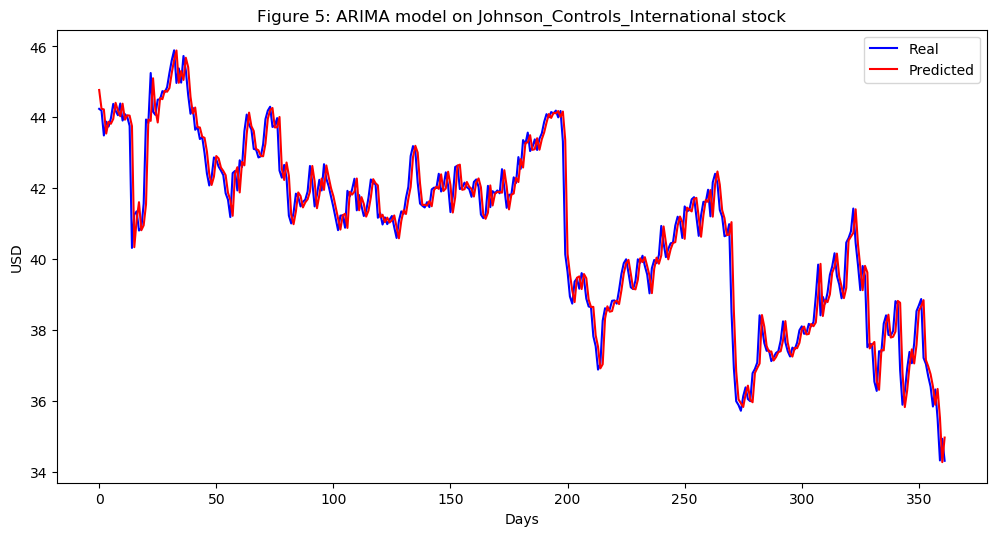

In [298]:
Johnson_Controls_International_series = SP500_TechIndicator['Johnson_Controls_International_Close']
Johnson_Controls_International_series_model = ARIMA(Johnson_Controls_International_series, order=(5, 1, 0))
Johnson_Controls_International_model_fit = Johnson_Controls_International_series_model.fit(disp=0)
print(Johnson_Controls_International_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Johnson_Controls_International_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Johnson_Controls_International_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Johnson_Controls_International_predictions = list()
for t in range(len(test)):
    Johnson_Controls_International_series_model = ARIMA(history, order=(5,1,0))
    Johnson_Controls_International_series_model_fit = Johnson_Controls_International_series_model.fit(disp=0)
    Johnson_Controls_International_output = Johnson_Controls_International_series_model_fit.forecast()
    yhat = Johnson_Controls_International_output[0]
    Johnson_Controls_International_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Johnson_Controls_International_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Johnson_Controls_International_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Johnson_Controls_International stock')
plt.legend()
plt.show()


#predictions
Johnson_Controls_International_predictions = pd.DataFrame({'Johnson_Controls_International_predictions':Johnson_Controls_International_predictions})
#Johnson_Controls_International_predictions.to_csv('Johnson_Controls_International_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Kansas_City_Southern_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -2061.944
Method:                                 css-mle   S.D. of innovations              1.690
Date:                          Sun, 17 Mar 2019   AIC                           4137.889
Time:                                  20:50:18   BIC                           4172.658
Sample:                                       1   HQIC                          4151.065
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                 -0.0154      0.047     -0.325      0.745    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


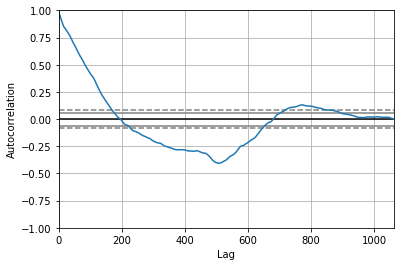

<Figure size 800x560 with 0 Axes>

Test MSE: 2.093


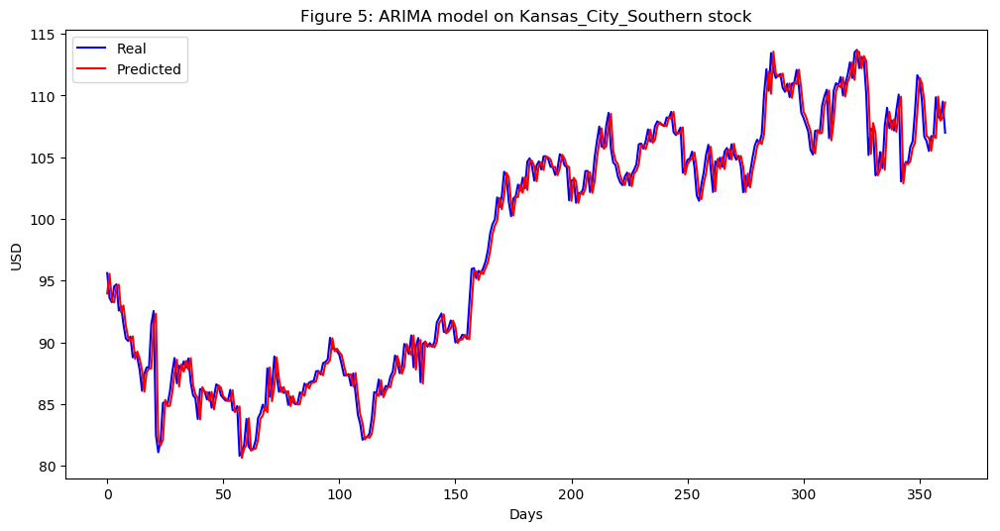

In [299]:
Kansas_City_Southern_series = SP500_TechIndicator['Kansas_City_Southern_Close']
Kansas_City_Southern_series_model = ARIMA(Kansas_City_Southern_series, order=(5, 1, 0))
Kansas_City_Southern_model_fit = Kansas_City_Southern_series_model.fit(disp=0)
print(Kansas_City_Southern_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Kansas_City_Southern_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Kansas_City_Southern_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Kansas_City_Southern_predictions = list()
for t in range(len(test)):
    Kansas_City_Southern_series_model = ARIMA(history, order=(5,1,0))
    Kansas_City_Southern_series_model_fit = Kansas_City_Southern_series_model.fit(disp=0)
    Kansas_City_Southern_output = Kansas_City_Southern_series_model_fit.forecast()
    yhat = Kansas_City_Southern_output[0]
    Kansas_City_Southern_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Kansas_City_Southern_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Kansas_City_Southern_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Kansas_City_Southern stock')
plt.legend()
plt.show()


#predictions
Kansas_City_Southern_predictions = pd.DataFrame({'Kansas_City_Southern_predictions':Kansas_City_Southern_predictions})
#Kansas_City_Southern_predictions.to_csv('Kansas_City_Southern_predictions.csv')



                                      ARIMA Model Results                                      
Dep. Variable:     D.L_3_Communications_Holdings_Close   No. Observations:                 1061
Model:                                  ARIMA(5, 1, 0)   Log Likelihood               -2140.286
Method:                                        css-mle   S.D. of innovations              1.819
Date:                                 Sun, 17 Mar 2019   AIC                           4294.572
Time:                                         20:51:02   BIC                           4329.341
Sample:                                              1   HQIC                          4307.749
                                                                                               
                                                coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------------
const       

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


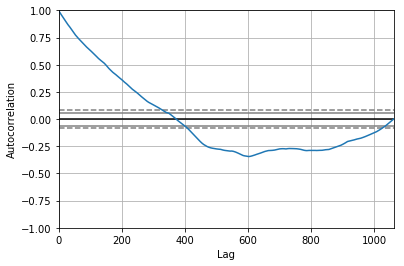

<Figure size 800x560 with 0 Axes>

Test MSE: 4.714


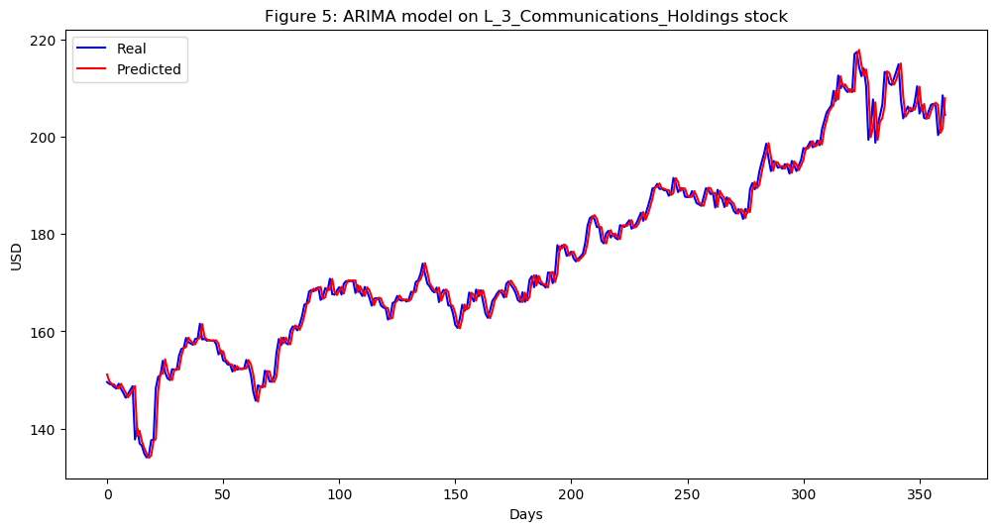

In [300]:
L_3_Communications_Holdings_series = SP500_TechIndicator['L_3_Communications_Holdings_Close']
L_3_Communications_Holdings_series_model = ARIMA(L_3_Communications_Holdings_series, order=(5, 1, 0))
L_3_Communications_Holdings_model_fit = L_3_Communications_Holdings_series_model.fit(disp=0)
print(L_3_Communications_Holdings_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(L_3_Communications_Holdings_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = L_3_Communications_Holdings_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
L_3_Communications_Holdings_predictions = list()
for t in range(len(test)):
    L_3_Communications_Holdings_series_model = ARIMA(history, order=(5,1,0))
    L_3_Communications_Holdings_series_model_fit = L_3_Communications_Holdings_series_model.fit(disp=0)
    L_3_Communications_Holdings_output = L_3_Communications_Holdings_series_model_fit.forecast()
    yhat = L_3_Communications_Holdings_output[0]
    L_3_Communications_Holdings_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, L_3_Communications_Holdings_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(L_3_Communications_Holdings_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on L_3_Communications_Holdings stock')
plt.legend()
plt.show()


#predictions
L_3_Communications_Holdings_predictions = pd.DataFrame({'L_3_Communications_Holdings_predictions':L_3_Communications_Holdings_predictions})
#L_3_Communications_Holdings_predictions.to_csv('L_3_Communications_Holdings_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.Lockheed_Martin_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -2441.683
Method:                            css-mle   S.D. of innovations              2.417
Date:                     Sun, 17 Mar 2019   AIC                           4897.365
Time:                             20:51:46   BIC                           4932.134
Sample:                                  1   HQIC                          4910.542
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.1793      0.071      2.536      0.011       0.041       0.318
ar.L1.D.Lockheed_Martin_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


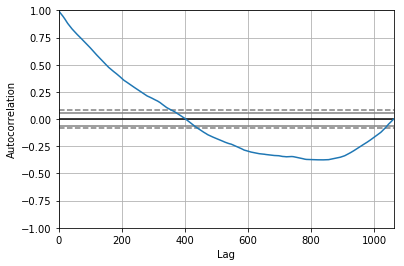

<Figure size 800x560 with 0 Axes>

Test MSE: 9.458


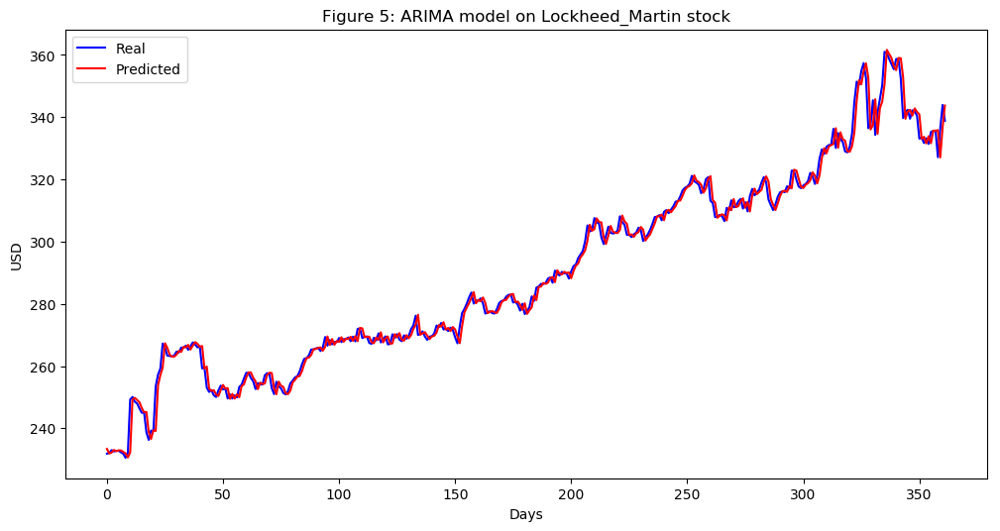

In [301]:
Lockheed_Martin_series = SP500_TechIndicator['Lockheed_Martin_Close']
Lockheed_Martin_series_model = ARIMA(Lockheed_Martin_series, order=(5, 1, 0))
Lockheed_Martin_model_fit = Lockheed_Martin_series_model.fit(disp=0)
print(Lockheed_Martin_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Lockheed_Martin_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Lockheed_Martin_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Lockheed_Martin_predictions = list()
for t in range(len(test)):
    Lockheed_Martin_series_model = ARIMA(history, order=(5,1,0))
    Lockheed_Martin_series_model_fit = Lockheed_Martin_series_model.fit(disp=0)
    Lockheed_Martin_output = Lockheed_Martin_series_model_fit.forecast()
    yhat = Lockheed_Martin_output[0]
    Lockheed_Martin_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Lockheed_Martin_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Lockheed_Martin_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Lockheed_Martin stock')
plt.legend()
plt.show()


#predictions
Lockheed_Martin_predictions = pd.DataFrame({'Lockheed_Martin_predictions':Lockheed_Martin_predictions})
#Lockheed_Martin_predictions.to_csv('Lockheed_Martin_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Masco_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -667.859
Method:                       css-mle   S.D. of innovations              0.454
Date:                Sun, 17 Mar 2019   AIC                           1349.719
Time:                        20:52:28   BIC                           1384.487
Sample:                             1   HQIC                          1362.895
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0167      0.014      1.219      0.223      -0.010       0.043
ar.L1.D.Masco_Close    -0.0168      0.031     -0.548      0.584      -0.077       0.043
ar.L2.D.Masco_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


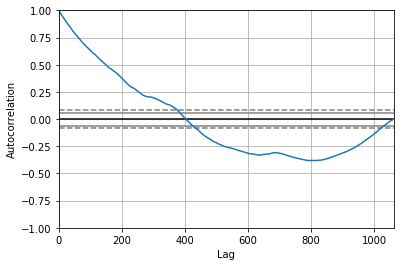

<Figure size 800x560 with 0 Axes>

Test MSE: 0.241


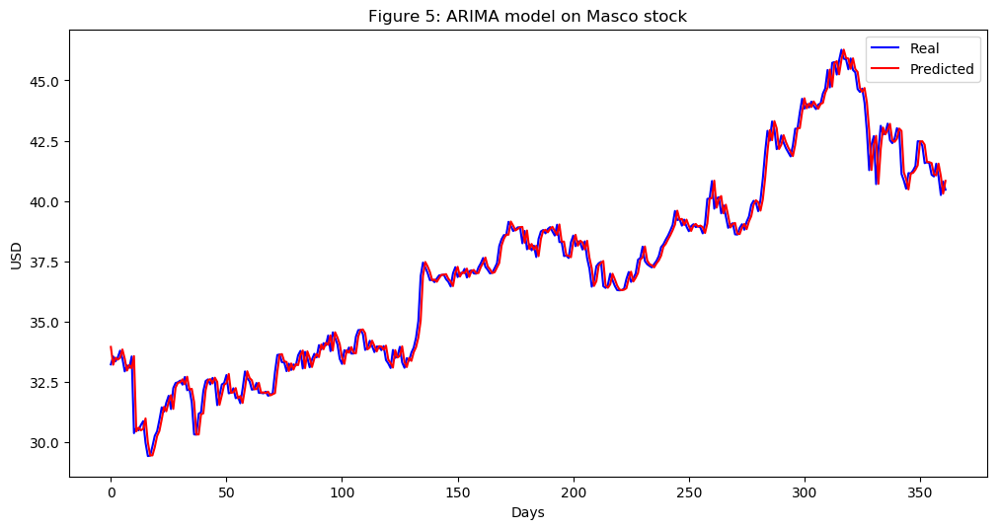

In [302]:
Masco_series = SP500_TechIndicator['Masco_Close']
Masco_series_model = ARIMA(Masco_series, order=(5, 1, 0))
Masco_model_fit = Masco_series_model.fit(disp=0)
print(Masco_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Masco_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Masco_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Masco_predictions = list()
for t in range(len(test)):
    Masco_series_model = ARIMA(history, order=(5,1,0))
    Masco_series_model_fit = Masco_series_model.fit(disp=0)
    Masco_output = Masco_series_model_fit.forecast()
    yhat = Masco_output[0]
    Masco_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Masco_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Masco_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Masco stock')
plt.legend()
plt.show()


#predictions
Masco_predictions = pd.DataFrame({'Masco_predictions':Masco_predictions})
#Masco_predictions.to_csv('Masco_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Nielsen_Holdings_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -1037.508
Method:                             css-mle   S.D. of innovations              0.643
Date:                      Sun, 17 Mar 2019   AIC                           2089.016
Time:                              20:53:27   BIC                           2123.785
Sample:                                   1   HQIC                          2102.193
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                             -0.0130      0.018     -0.739      0.460      -0.047       0.021
ar.L1.D.Nielsen_Holding

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


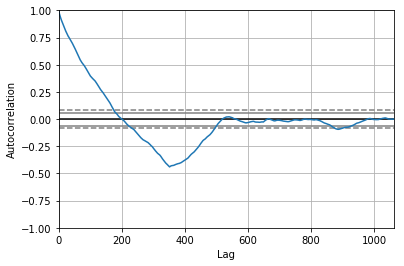

<Figure size 800x560 with 0 Axes>

Test MSE: 0.577


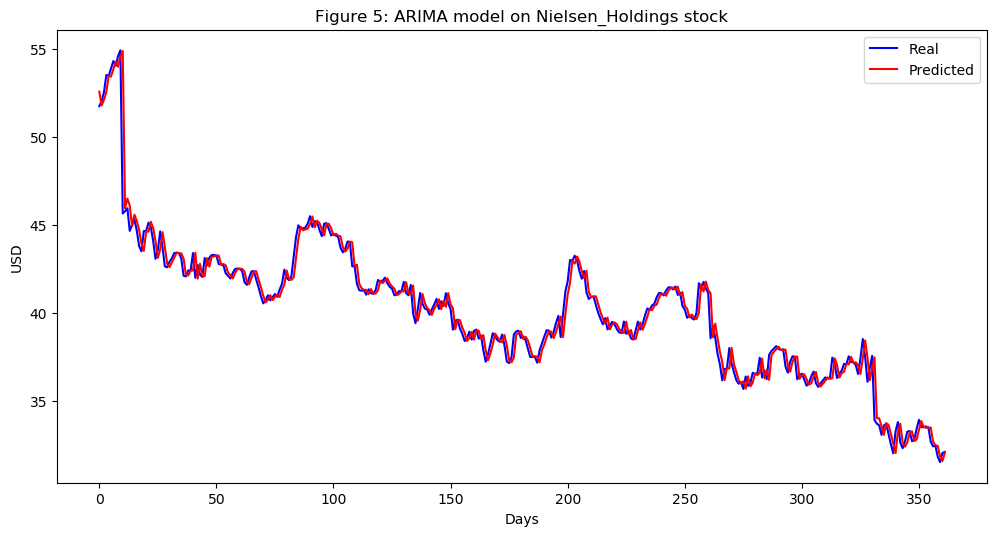

In [303]:
Nielsen_Holdings_series = SP500_TechIndicator['Nielsen_Holdings_Close']
Nielsen_Holdings_series_model = ARIMA(Nielsen_Holdings_series, order=(5, 1, 0))
Nielsen_Holdings_model_fit = Nielsen_Holdings_series_model.fit(disp=0)
print(Nielsen_Holdings_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Nielsen_Holdings_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Nielsen_Holdings_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Nielsen_Holdings_predictions = list()
for t in range(len(test)):
    Nielsen_Holdings_series_model = ARIMA(history, order=(5,1,0))
    Nielsen_Holdings_series_model_fit = Nielsen_Holdings_series_model.fit(disp=0)
    Nielsen_Holdings_output = Nielsen_Holdings_series_model_fit.forecast()
    yhat = Nielsen_Holdings_output[0]
    Nielsen_Holdings_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Nielsen_Holdings_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Nielsen_Holdings_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Nielsen_Holdings stock')
plt.legend()
plt.show()


#predictions
Nielsen_Holdings_predictions = pd.DataFrame({'Nielsen_Holdings_predictions':Nielsen_Holdings_predictions})
#Nielsen_Holdings_predictions.to_csv('Nielsen_Holdings_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Norfolk_Southern_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -1958.586
Method:                             css-mle   S.D. of innovations              1.533
Date:                      Sun, 17 Mar 2019   AIC                           3931.173
Time:                              20:54:31   BIC                           3965.941
Sample:                                   1   HQIC                          3944.349
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0383      0.046      0.838      0.402      -0.051       0.128
ar.L1.D.Norfolk_Souther

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


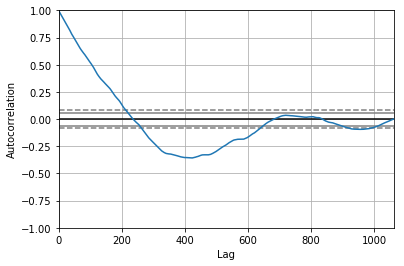

<Figure size 800x560 with 0 Axes>

Test MSE: 2.884


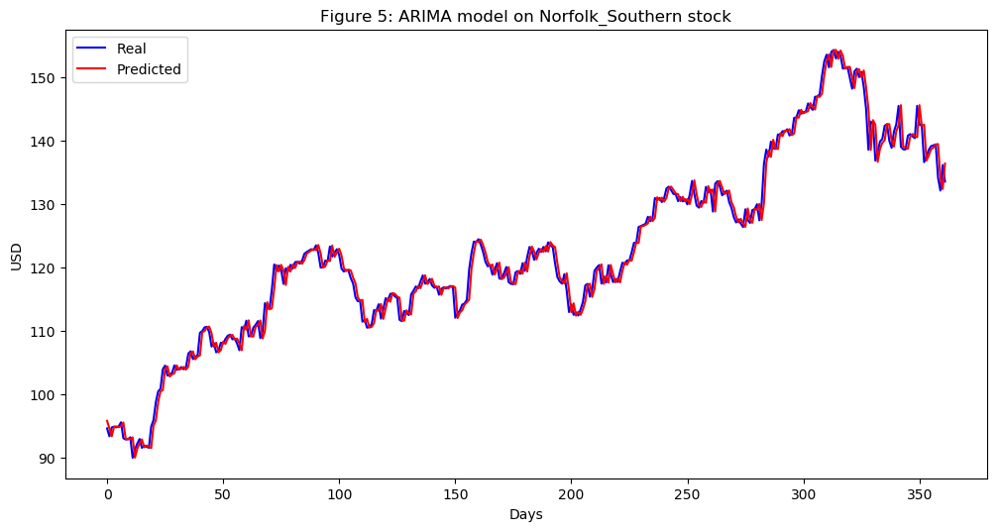

In [304]:
Norfolk_Southern_series = SP500_TechIndicator['Norfolk_Southern_Close']
Norfolk_Southern_series_model = ARIMA(Norfolk_Southern_series, order=(5, 1, 0))
Norfolk_Southern_model_fit = Norfolk_Southern_series_model.fit(disp=0)
print(Norfolk_Southern_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Norfolk_Southern_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Norfolk_Southern_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Norfolk_Southern_predictions = list()
for t in range(len(test)):
    Norfolk_Southern_series_model = ARIMA(history, order=(5,1,0))
    Norfolk_Southern_series_model_fit = Norfolk_Southern_series_model.fit(disp=0)
    Norfolk_Southern_output = Norfolk_Southern_series_model_fit.forecast()
    yhat = Norfolk_Southern_output[0]
    Norfolk_Southern_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Norfolk_Southern_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Norfolk_Southern_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Norfolk_Southern stock')
plt.legend()
plt.show()


#predictions
Norfolk_Southern_predictions = pd.DataFrame({'Norfolk_Southern_predictions':Norfolk_Southern_predictions})
#Norfolk_Southern_predictions.to_csv('Norfolk_Southern_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Northrop_Grumman_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -2408.569
Method:                             css-mle   S.D. of innovations              2.342
Date:                      Sun, 17 Mar 2019   AIC                           4831.137
Time:                              20:55:16   BIC                           4865.906
Sample:                                   1   HQIC                          4844.314
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.2215      0.061      3.645      0.000       0.102       0.341
ar.L1.D.Northrop_Grumma

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


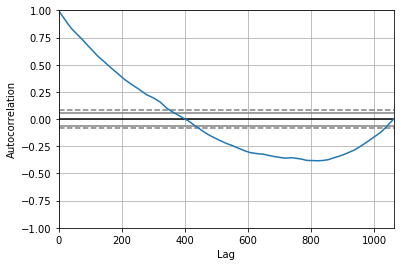

<Figure size 800x560 with 0 Axes>

Test MSE: 9.675


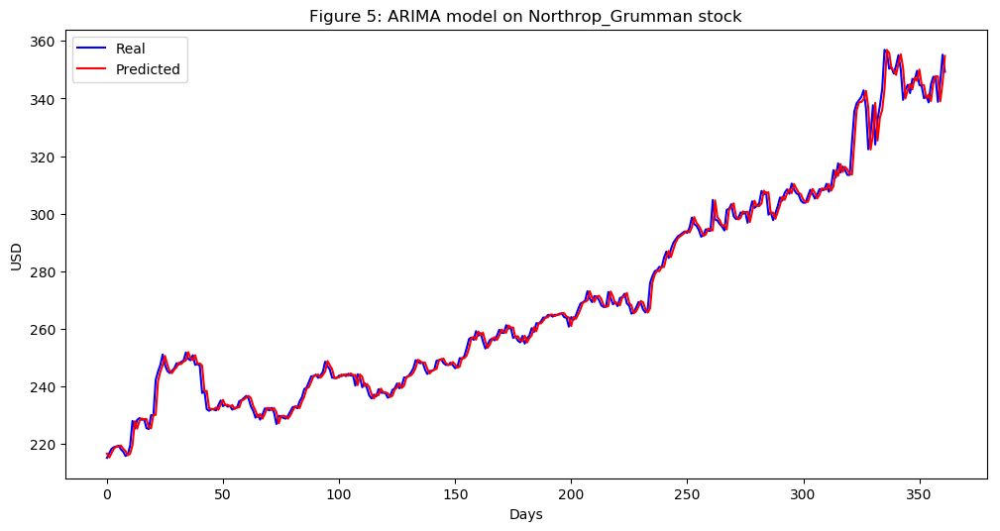

In [305]:
Northrop_Grumman_series = SP500_TechIndicator['Northrop_Grumman_Close']
Northrop_Grumman_series_model = ARIMA(Northrop_Grumman_series, order=(5, 1, 0))
Northrop_Grumman_model_fit = Northrop_Grumman_series_model.fit(disp=0)
print(Northrop_Grumman_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Northrop_Grumman_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Northrop_Grumman_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Northrop_Grumman_predictions = list()
for t in range(len(test)):
    Northrop_Grumman_series_model = ARIMA(history, order=(5,1,0))
    Northrop_Grumman_series_model_fit = Northrop_Grumman_series_model.fit(disp=0)
    Northrop_Grumman_output = Northrop_Grumman_series_model_fit.forecast()
    yhat = Northrop_Grumman_output[0]
    Northrop_Grumman_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Northrop_Grumman_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Northrop_Grumman_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Northrop_Grumman stock')
plt.legend()
plt.show()


#predictions
Northrop_Grumman_predictions = pd.DataFrame({'Northrop_Grumman_predictions':Northrop_Grumman_predictions})
#Northrop_Grumman_predictions.to_csv('Northrop_Grumman_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.PACCAR_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1378.091
Method:                       css-mle   S.D. of innovations              0.887
Date:                Sun, 17 Mar 2019   AIC                           2770.181
Time:                        20:55:59   BIC                           2804.950
Sample:                             1   HQIC                          2783.358
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0045      0.025      0.185      0.853      -0.044       0.053
ar.L1.D.PACCAR_Close    -0.0171      0.031     -0.557      0.578      -0.077       0.043
ar.L2.D.PACC

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


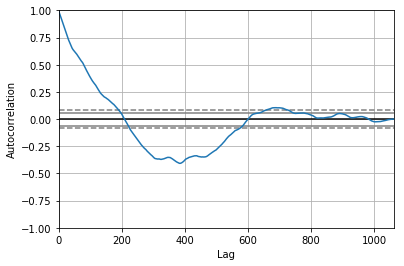

<Figure size 800x560 with 0 Axes>

Test MSE: 0.886


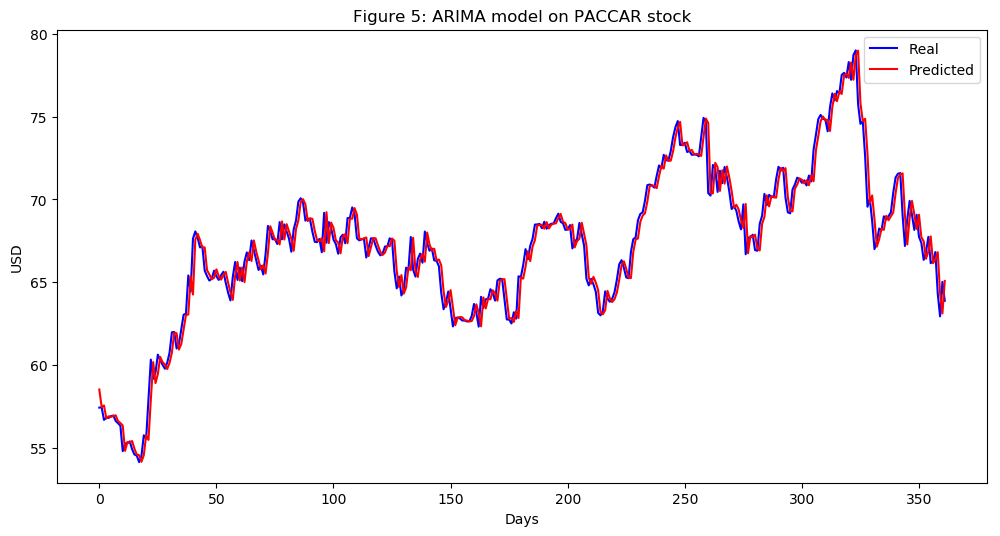

In [306]:
PACCAR_series = SP500_TechIndicator['PACCAR_Close']
PACCAR_series_model = ARIMA(PACCAR_series, order=(5, 1, 0))
PACCAR_model_fit = PACCAR_series_model.fit(disp=0)
print(PACCAR_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(PACCAR_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = PACCAR_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
PACCAR_predictions = list()
for t in range(len(test)):
    PACCAR_series_model = ARIMA(history, order=(5,1,0))
    PACCAR_series_model_fit = PACCAR_series_model.fit(disp=0)
    PACCAR_output = PACCAR_series_model_fit.forecast()
    yhat = PACCAR_output[0]
    PACCAR_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, PACCAR_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(PACCAR_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on PACCAR stock')
plt.legend()
plt.show()


#predictions
PACCAR_predictions = pd.DataFrame({'PACCAR_predictions':PACCAR_predictions})
#PACCAR_predictions.to_csv('PACCAR_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.Parker_Hannifin_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -2127.739
Method:                            css-mle   S.D. of innovations              1.798
Date:                     Sun, 17 Mar 2019   AIC                           4269.477
Time:                             20:56:49   BIC                           4304.246
Sample:                                  1   HQIC                          4282.654
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0398      0.056      0.706      0.480      -0.071       0.150
ar.L1.D.Parker_Hannifin_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


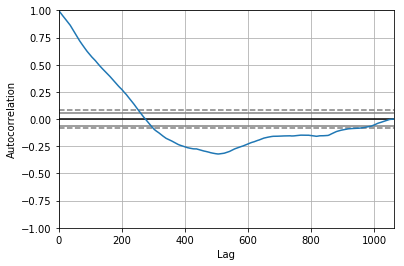

<Figure size 800x560 with 0 Axes>

Test MSE: 4.539


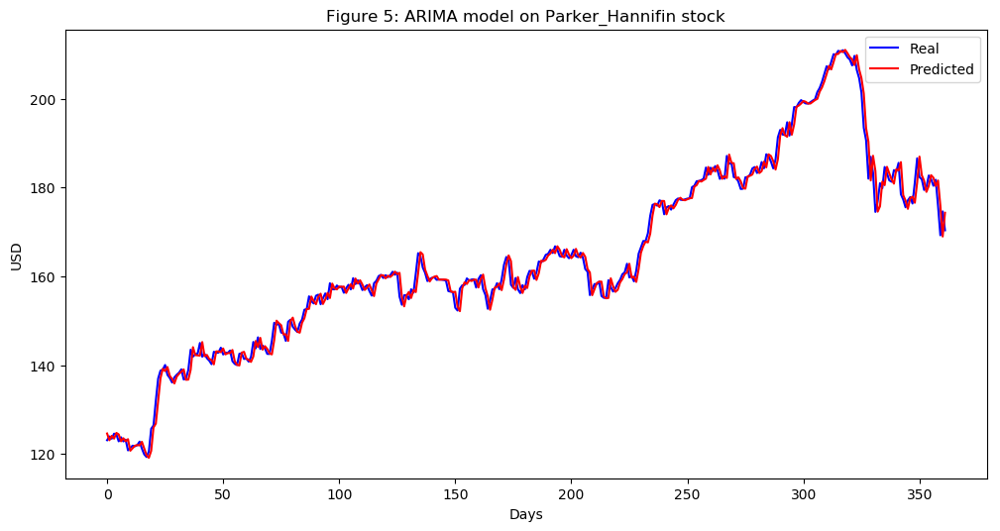

In [307]:
Parker_Hannifin_series = SP500_TechIndicator['Parker_Hannifin_Close']
Parker_Hannifin_series_model = ARIMA(Parker_Hannifin_series, order=(5, 1, 0))
Parker_Hannifin_model_fit = Parker_Hannifin_series_model.fit(disp=0)
print(Parker_Hannifin_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Parker_Hannifin_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Parker_Hannifin_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Parker_Hannifin_predictions = list()
for t in range(len(test)):
    Parker_Hannifin_series_model = ARIMA(history, order=(5,1,0))
    Parker_Hannifin_series_model_fit = Parker_Hannifin_series_model.fit(disp=0)
    Parker_Hannifin_output = Parker_Hannifin_series_model_fit.forecast()
    yhat = Parker_Hannifin_output[0]
    Parker_Hannifin_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Parker_Hannifin_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Parker_Hannifin_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Parker_Hannifin stock')
plt.legend()
plt.show()


#predictions
Parker_Hannifin_predictions = pd.DataFrame({'Parker_Hannifin_predictions':Parker_Hannifin_predictions})
#Parker_Hannifin_predictions.to_csv('Parker_Hannifin_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Pentair_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1448.760
Method:                       css-mle   S.D. of innovations              0.948
Date:                Sun, 17 Mar 2019   AIC                           2911.520
Time:                        20:57:36   BIC                           2946.288
Sample:                             1   HQIC                          2924.696
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.0086      0.027     -0.320      0.749      -0.061       0.044
ar.L1.D.Pentair_Close     0.0531      0.031      1.732      0.084      -0.007       0.113
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


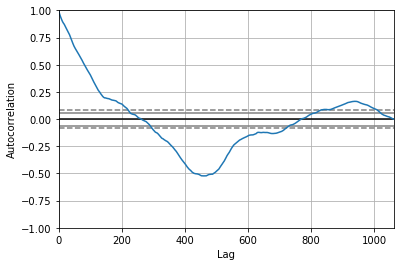

<Figure size 800x560 with 0 Axes>

Test MSE: 0.619


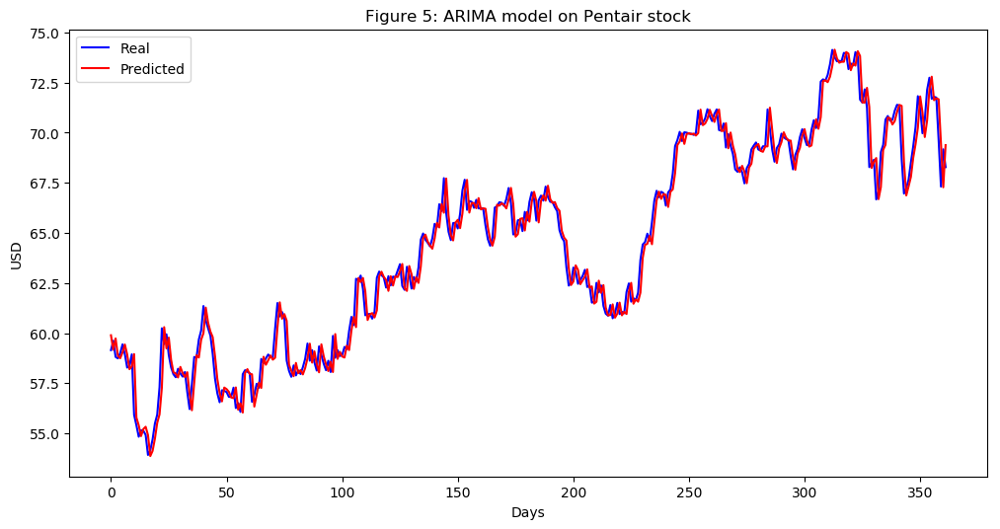

In [308]:
Pentair_series = SP500_TechIndicator['Pentair_Close']
Pentair_series_model = ARIMA(Pentair_series, order=(5, 1, 0))
Pentair_model_fit = Pentair_series_model.fit(disp=0)
print(Pentair_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Pentair_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Pentair_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Pentair_predictions = list()
for t in range(len(test)):
    Pentair_series_model = ARIMA(history, order=(5,1,0))
    Pentair_series_model_fit = Pentair_series_model.fit(disp=0)
    Pentair_output = Pentair_series_model_fit.forecast()
    yhat = Pentair_output[0]
    Pentair_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Pentair_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Pentair_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Pentair stock')
plt.legend()
plt.show()


#predictions
Pentair_predictions = pd.DataFrame({'Pentair_predictions':Pentair_predictions})
#Pentair_predictions.to_csv('Pentair_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.Quanta_Services_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood                -883.487
Method:                            css-mle   S.D. of innovations              0.556
Date:                     Sun, 17 Mar 2019   AIC                           1780.974
Time:                             20:58:26   BIC                           1815.743
Sample:                                  1   HQIC                          1794.151
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0024      0.016      0.151      0.880      -0.028       0.033
ar.L1.D.Quanta_Services_Close    -

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


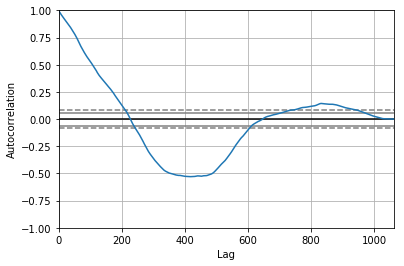

<Figure size 800x560 with 0 Axes>

Test MSE: 0.276


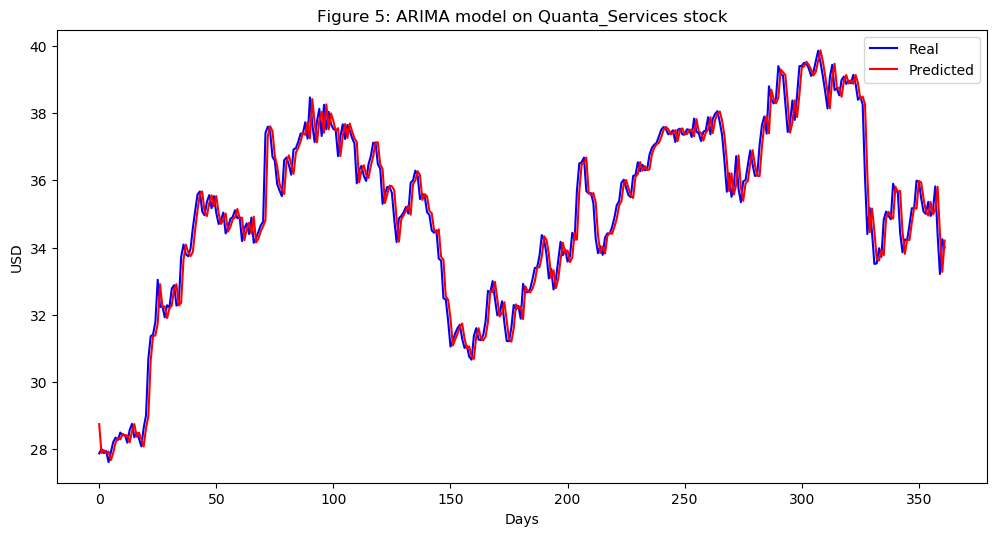

In [309]:
Quanta_Services_series = SP500_TechIndicator['Quanta_Services_Close']
Quanta_Services_series_model = ARIMA(Quanta_Services_series, order=(5, 1, 0))
Quanta_Services_model_fit = Quanta_Services_series_model.fit(disp=0)
print(Quanta_Services_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Quanta_Services_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Quanta_Services_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Quanta_Services_predictions = list()
for t in range(len(test)):
    Quanta_Services_series_model = ARIMA(history, order=(5,1,0))
    Quanta_Services_series_model_fit = Quanta_Services_series_model.fit(disp=0)
    Quanta_Services_output = Quanta_Services_series_model_fit.forecast()
    yhat = Quanta_Services_output[0]
    Quanta_Services_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Quanta_Services_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Quanta_Services_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Quanta_Services stock')
plt.legend()
plt.show()


#predictions
Quanta_Services_predictions = pd.DataFrame({'Quanta_Services_predictions':Quanta_Services_predictions})
#Quanta_Services_predictions.to_csv('Quanta_Services_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Raytheon_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1921.437
Method:                       css-mle   S.D. of innovations              1.480
Date:                Sun, 17 Mar 2019   AIC                           3856.873
Time:                        20:59:29   BIC                           3891.642
Sample:                             1   HQIC                          3870.050
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.1178      0.040      2.913      0.004       0.039       0.197
ar.L1.D.Raytheon_Close    -0.0293      0.031     -0.954      0.340      -0.090       0.031
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


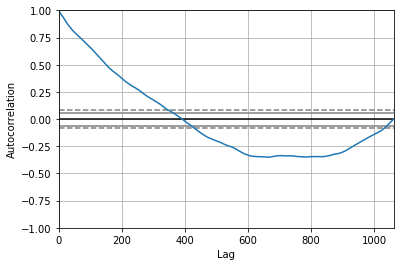

<Figure size 800x560 with 0 Axes>

Test MSE: 3.379


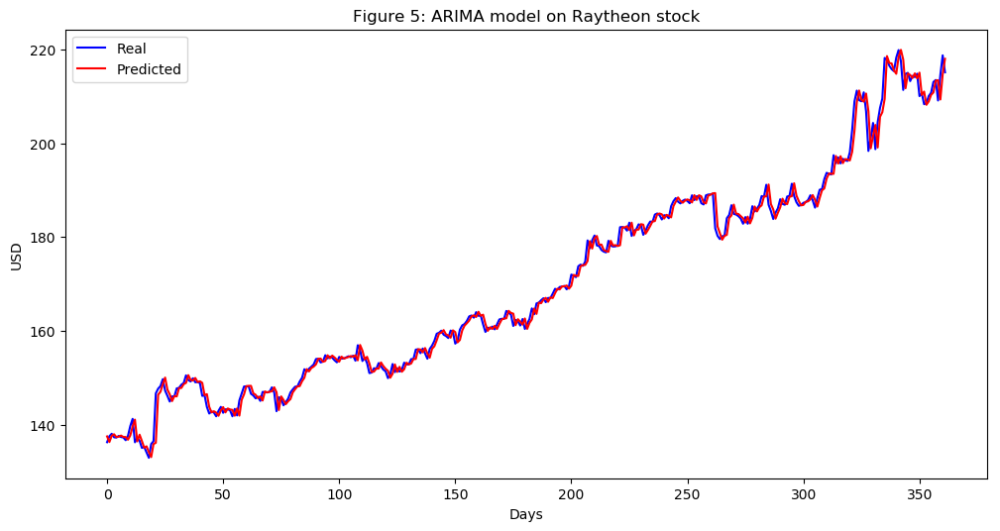

In [310]:
Raytheon_series = SP500_TechIndicator['Raytheon_Close']
Raytheon_series_model = ARIMA(Raytheon_series, order=(5, 1, 0))
Raytheon_model_fit = Raytheon_series_model.fit(disp=0)
print(Raytheon_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Raytheon_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Raytheon_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Raytheon_predictions = list()
for t in range(len(test)):
    Raytheon_series_model = ARIMA(history, order=(5,1,0))
    Raytheon_series_model_fit = Raytheon_series_model.fit(disp=0)
    Raytheon_output = Raytheon_series_model_fit.forecast()
    yhat = Raytheon_output[0]
    Raytheon_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Raytheon_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Raytheon_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Raytheon stock')
plt.legend()
plt.show()


#predictions
Raytheon_predictions = pd.DataFrame({'Raytheon_predictions':Raytheon_predictions})
#Raytheon_predictions.to_csv('Raytheon_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Republic_Services_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood                -611.926
Method:                              css-mle   S.D. of innovations              0.431
Date:                       Sun, 17 Mar 2019   AIC                           1237.851
Time:                               21:00:14   BIC                           1272.620
Sample:                                    1   HQIC                          1251.028
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0307      0.013      2.319      0.021       0.005       0.057
ar.L1.D.Repu

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


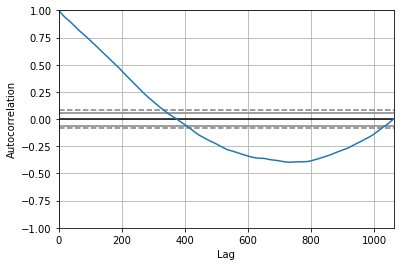

<Figure size 800x560 with 0 Axes>

Test MSE: 0.276


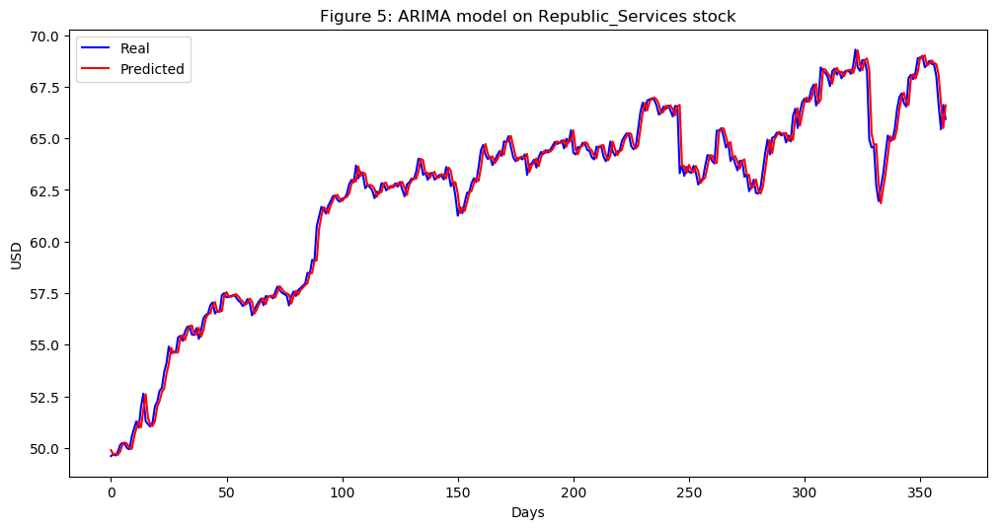

In [311]:
Republic_Services_series = SP500_TechIndicator['Republic_Services_Close']
Republic_Services_series_model = ARIMA(Republic_Services_series, order=(5, 1, 0))
Republic_Services_model_fit = Republic_Services_series_model.fit(disp=0)
print(Republic_Services_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Republic_Services_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Republic_Services_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Republic_Services_predictions = list()
for t in range(len(test)):
    Republic_Services_series_model = ARIMA(history, order=(5,1,0))
    Republic_Services_series_model_fit = Republic_Services_series_model.fit(disp=0)
    Republic_Services_output = Republic_Services_series_model_fit.forecast()
    yhat = Republic_Services_output[0]
    Republic_Services_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Republic_Services_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Republic_Services_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Republic_Services stock')
plt.legend()
plt.show()


#predictions
Republic_Services_predictions = pd.DataFrame({'Republic_Services_predictions':Republic_Services_predictions})
#Republic_Services_predictions.to_csv('Republic_Services_predictions.csv')



                                     ARIMA Model Results                                     
Dep. Variable:     D.Robert_Half_International_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood               -1214.971
Method:                                      css-mle   S.D. of innovations              0.760
Date:                               Sun, 17 Mar 2019   AIC                           2443.942
Time:                                       21:01:19   BIC                           2478.711
Sample:                                            1   HQIC                          2457.118
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


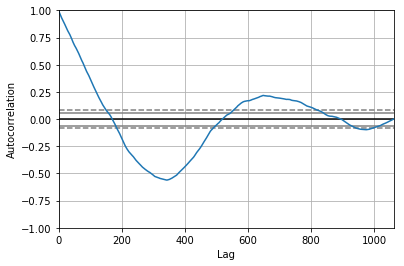

<Figure size 800x560 with 0 Axes>

Test MSE: 0.596


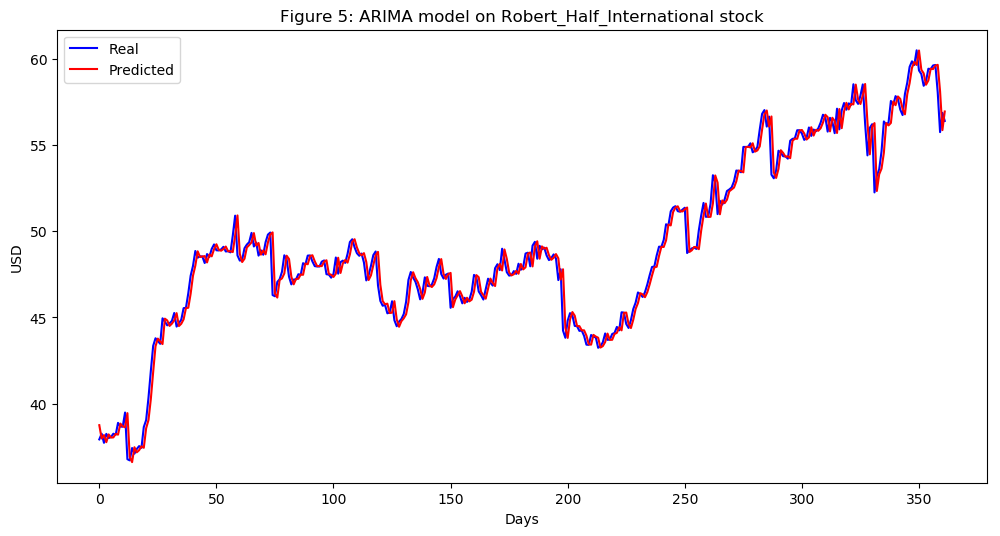

In [312]:
Robert_Half_International_series = SP500_TechIndicator['Robert_Half_International_Close']
Robert_Half_International_series_model = ARIMA(Robert_Half_International_series, order=(5, 1, 0))
Robert_Half_International_model_fit = Robert_Half_International_series_model.fit(disp=0)
print(Robert_Half_International_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Robert_Half_International_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Robert_Half_International_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Robert_Half_International_predictions = list()
for t in range(len(test)):
    Robert_Half_International_series_model = ARIMA(history, order=(5,1,0))
    Robert_Half_International_series_model_fit = Robert_Half_International_series_model.fit(disp=0)
    Robert_Half_International_output = Robert_Half_International_series_model_fit.forecast()
    yhat = Robert_Half_International_output[0]
    Robert_Half_International_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Robert_Half_International_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Robert_Half_International_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Robert_Half_International stock')
plt.legend()
plt.show()


#predictions
Robert_Half_International_predictions = pd.DataFrame({'Robert_Half_International_predictions':Robert_Half_International_predictions})
#Robert_Half_International_predictions.to_csv('Robert_Half_International_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.Rockwell_Automation_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -2177.535
Method:                                css-mle   S.D. of innovations              1.884
Date:                         Sun, 17 Mar 2019   AIC                           4369.070
Time:                                 21:02:04   BIC                           4403.838
Sample:                                      1   HQIC                          4382.246
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0530      0.048      1.115      0.265      -0.040   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


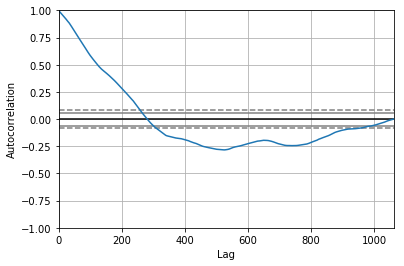

<Figure size 800x560 with 0 Axes>

Test MSE: 5.422


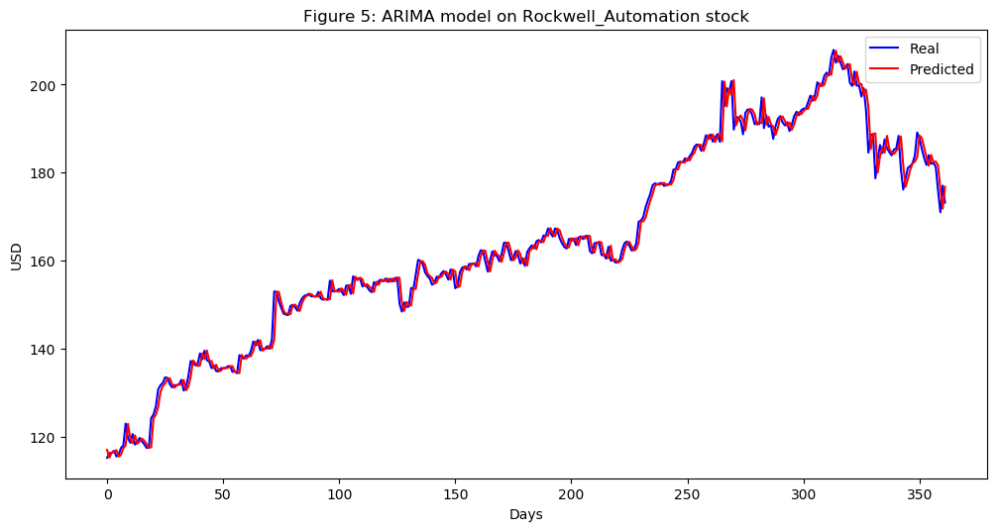

In [313]:
Rockwell_Automation_series = SP500_TechIndicator['Rockwell_Automation_Close']
Rockwell_Automation_series_model = ARIMA(Rockwell_Automation_series, order=(5, 1, 0))
Rockwell_Automation_model_fit = Rockwell_Automation_series_model.fit(disp=0)
print(Rockwell_Automation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Rockwell_Automation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Rockwell_Automation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Rockwell_Automation_predictions = list()
for t in range(len(test)):
    Rockwell_Automation_series_model = ARIMA(history, order=(5,1,0))
    Rockwell_Automation_series_model_fit = Rockwell_Automation_series_model.fit(disp=0)
    Rockwell_Automation_output = Rockwell_Automation_series_model_fit.forecast()
    yhat = Rockwell_Automation_output[0]
    Rockwell_Automation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Rockwell_Automation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Rockwell_Automation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Rockwell_Automation stock')
plt.legend()
plt.show()


#predictions
Rockwell_Automation_predictions = pd.DataFrame({'Rockwell_Automation_predictions':Rockwell_Automation_predictions})
#Rockwell_Automation_predictions.to_csv('Rockwell_Automation_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Rollins_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -800.042
Method:                       css-mle   S.D. of innovations              0.514
Date:                Sun, 17 Mar 2019   AIC                           1614.084
Time:                        21:02:50   BIC                           1648.853
Sample:                             1   HQIC                          1627.261
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0190      0.015      1.260      0.208      -0.011       0.049
ar.L1.D.Rollins_Close     0.0366      0.031      1.188      0.235      -0.024       0.097
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


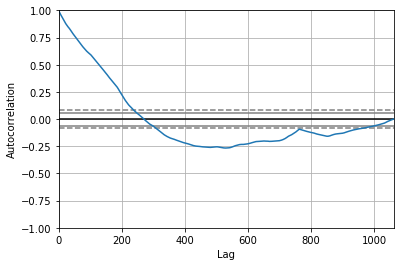

<Figure size 800x560 with 0 Axes>

Test MSE: 0.246


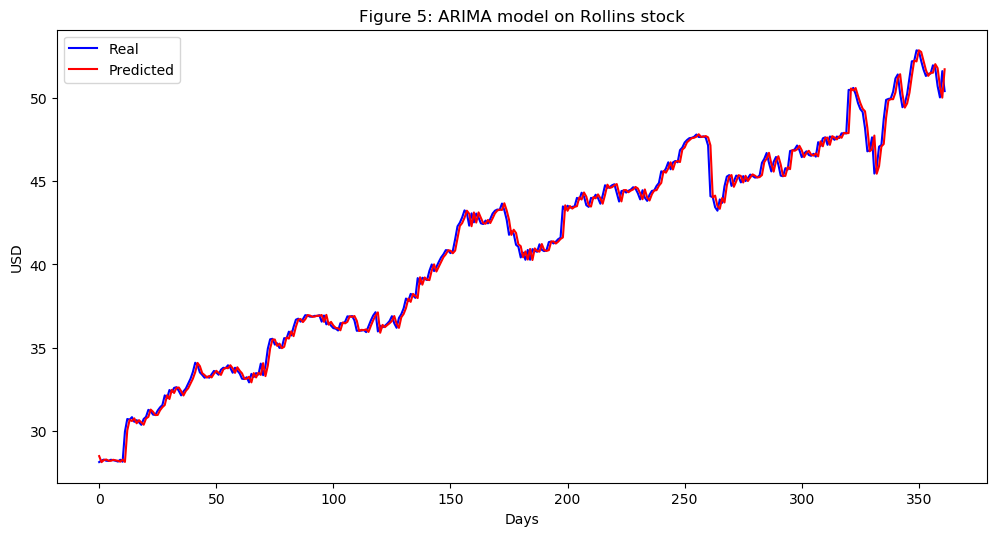

In [314]:
Rollins_series = SP500_TechIndicator['Rollins_Close']
Rollins_series_model = ARIMA(Rollins_series, order=(5, 1, 0))
Rollins_model_fit = Rollins_series_model.fit(disp=0)
print(Rollins_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Rollins_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Rollins_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Rollins_predictions = list()
for t in range(len(test)):
    Rollins_series_model = ARIMA(history, order=(5,1,0))
    Rollins_series_model_fit = Rollins_series_model.fit(disp=0)
    Rollins_output = Rollins_series_model_fit.forecast()
    yhat = Rollins_output[0]
    Rollins_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Rollins_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Rollins_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Rollins stock')
plt.legend()
plt.show()


#predictions
Rollins_predictions = pd.DataFrame({'Rollins_predictions':Rollins_predictions})
#Rollins_predictions.to_csv('Rollins_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Roper_Technologies_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -2324.187
Method:                               css-mle   S.D. of innovations              2.163
Date:                        Sun, 17 Mar 2019   AIC                           4662.374
Time:                                21:04:03   BIC                           4697.143
Sample:                                     1   HQIC                          4675.551
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.1316      0.058      2.266      0.024       0.018       0.246
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


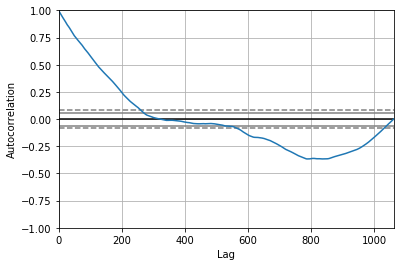

<Figure size 800x560 with 0 Axes>

Test MSE: 6.309


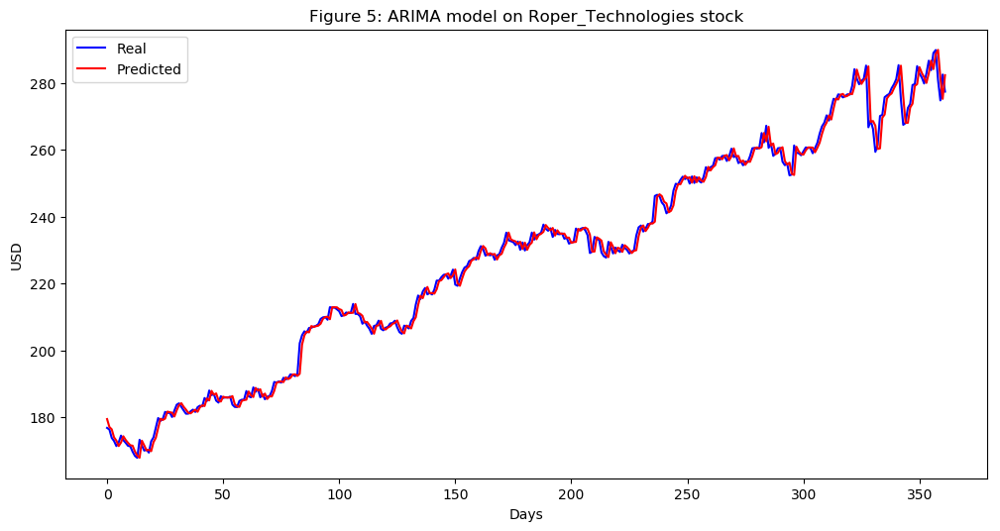

In [315]:
Roper_Technologies_series = SP500_TechIndicator['Roper_Technologies_Close']
Roper_Technologies_series_model = ARIMA(Roper_Technologies_series, order=(5, 1, 0))
Roper_Technologies_model_fit = Roper_Technologies_series_model.fit(disp=0)
print(Roper_Technologies_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Roper_Technologies_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Roper_Technologies_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Roper_Technologies_predictions = list()
for t in range(len(test)):
    Roper_Technologies_series_model = ARIMA(history, order=(5,1,0))
    Roper_Technologies_series_model_fit = Roper_Technologies_series_model.fit(disp=0)
    Roper_Technologies_output = Roper_Technologies_series_model_fit.forecast()
    yhat = Roper_Technologies_output[0]
    Roper_Technologies_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Roper_Technologies_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Roper_Technologies_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Roper_Technologies stock')
plt.legend()
plt.show()


#predictions
Roper_Technologies_predictions = pd.DataFrame({'Roper_Technologies_predictions':Roper_Technologies_predictions})
#Roper_Technologies_predictions.to_csv('Roper_Technologies_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Snap_on_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2185.689
Method:                       css-mle   S.D. of innovations              1.898
Date:                Sun, 17 Mar 2019   AIC                           4385.378
Time:                        21:04:43   BIC                           4420.147
Sample:                             1   HQIC                          4398.555
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0356      0.054      0.661      0.509      -0.070       0.141
ar.L1.D.Snap_on_Close    -0.0073      0.031     -0.237      0.813      -0.067       0.053
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


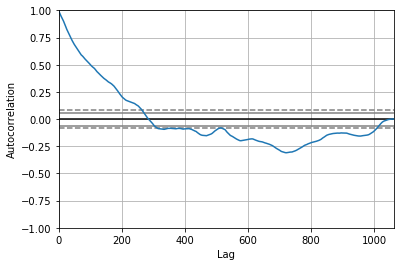

<Figure size 800x560 with 0 Axes>

Test MSE: 4.651


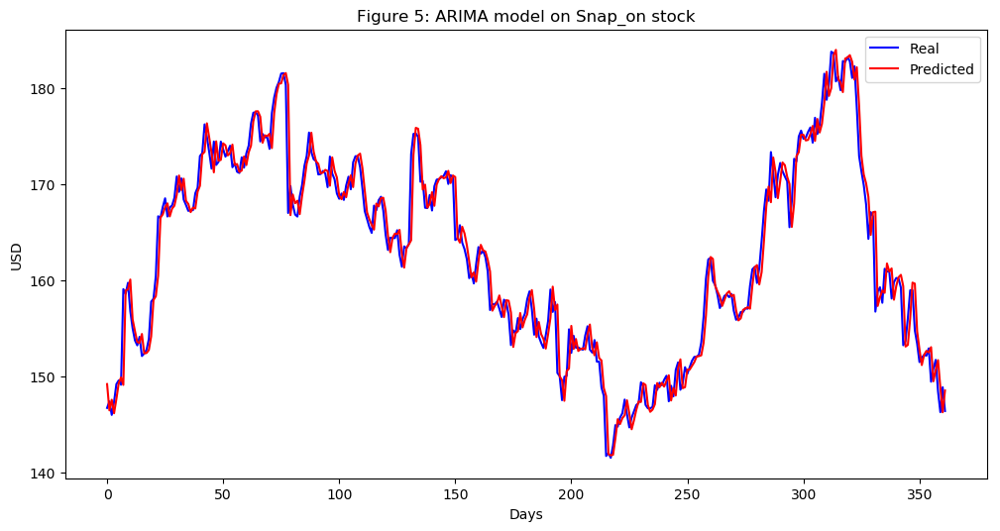

In [316]:
Snap_on_series = SP500_TechIndicator['Snap_on_Close']
Snap_on_series_model = ARIMA(Snap_on_series, order=(5, 1, 0))
Snap_on_model_fit = Snap_on_series_model.fit(disp=0)
print(Snap_on_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Snap_on_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Snap_on_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Snap_on_predictions = list()
for t in range(len(test)):
    Snap_on_series_model = ARIMA(history, order=(5,1,0))
    Snap_on_series_model_fit = Snap_on_series_model.fit(disp=0)
    Snap_on_output = Snap_on_series_model_fit.forecast()
    yhat = Snap_on_output[0]
    Snap_on_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Snap_on_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Snap_on_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Snap_on stock')
plt.legend()
plt.show()


#predictions
Snap_on_predictions = pd.DataFrame({'Snap_on_predictions':Snap_on_predictions})
#Snap_on_predictions.to_csv('Snap_on_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Southwest_Airlines_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1246.132
Method:                               css-mle   S.D. of innovations              0.783
Date:                        Sun, 17 Mar 2019   AIC                           2506.264
Time:                                21:05:29   BIC                           2541.032
Sample:                                     1   HQIC                          2519.440
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0356      0.025      1.408      0.159      -0.014       0.085
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


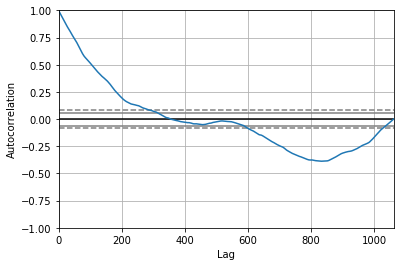

<Figure size 800x560 with 0 Axes>

Test MSE: 0.774


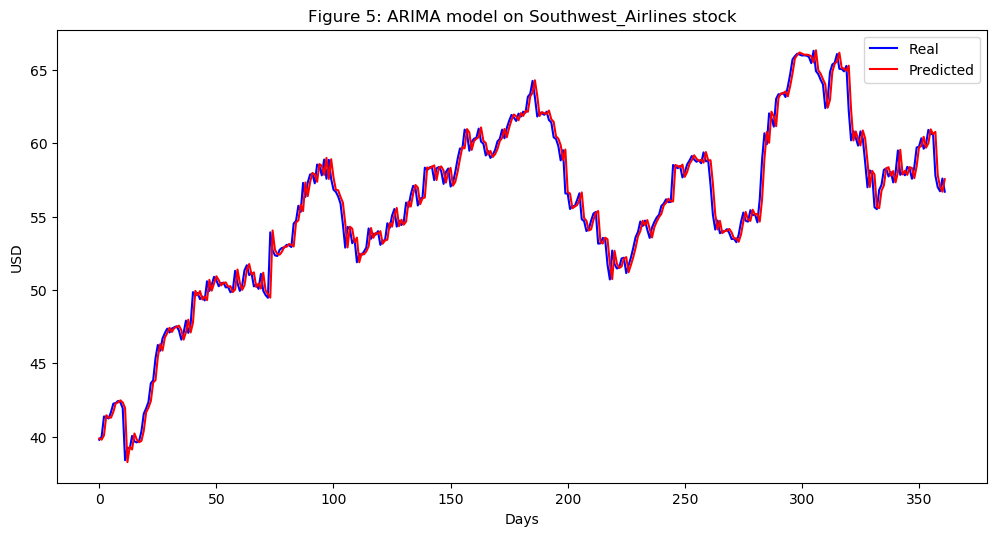

In [317]:
Southwest_Airlines_series = SP500_TechIndicator['Southwest_Airlines_Close']
Southwest_Airlines_series_model = ARIMA(Southwest_Airlines_series, order=(5, 1, 0))
Southwest_Airlines_model_fit = Southwest_Airlines_series_model.fit(disp=0)
print(Southwest_Airlines_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Southwest_Airlines_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Southwest_Airlines_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Southwest_Airlines_predictions = list()
for t in range(len(test)):
    Southwest_Airlines_series_model = ARIMA(history, order=(5,1,0))
    Southwest_Airlines_series_model_fit = Southwest_Airlines_series_model.fit(disp=0)
    Southwest_Airlines_output = Southwest_Airlines_series_model_fit.forecast()
    yhat = Southwest_Airlines_output[0]
    Southwest_Airlines_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Southwest_Airlines_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Southwest_Airlines_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Southwest_Airlines stock')
plt.legend()
plt.show()


#predictions
Southwest_Airlines_predictions = pd.DataFrame({'Southwest_Airlines_predictions':Southwest_Airlines_predictions})
#Southwest_Airlines_predictions.to_csv('Southwest_Airlines_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Stanley_Black_Decker_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -1801.972
Method:                                 css-mle   S.D. of innovations              1.322
Date:                          Sun, 17 Mar 2019   AIC                           3617.943
Time:                                  21:06:20   BIC                           3652.712
Sample:                                       1   HQIC                          3631.120
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0687      0.034      2.031      0.042    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


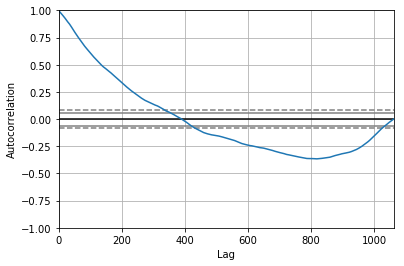

<Figure size 800x560 with 0 Axes>

Test MSE: 2.505


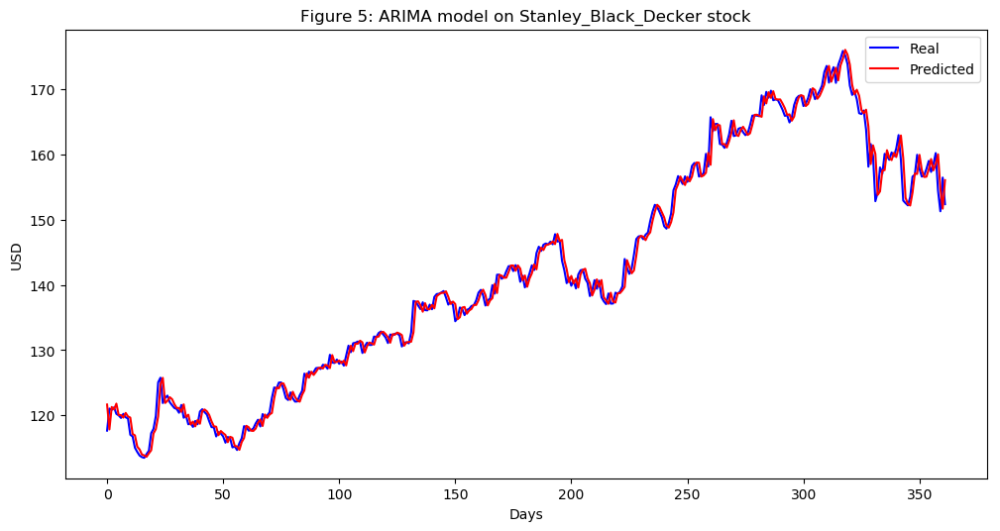

In [318]:
Stanley_Black_Decker_series = SP500_TechIndicator['Stanley_Black_Decker_Close']
Stanley_Black_Decker_series_model = ARIMA(Stanley_Black_Decker_series, order=(5, 1, 0))
Stanley_Black_Decker_model_fit = Stanley_Black_Decker_series_model.fit(disp=0)
print(Stanley_Black_Decker_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Stanley_Black_Decker_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Stanley_Black_Decker_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Stanley_Black_Decker_predictions = list()
for t in range(len(test)):
    Stanley_Black_Decker_series_model = ARIMA(history, order=(5,1,0))
    Stanley_Black_Decker_series_model_fit = Stanley_Black_Decker_series_model.fit(disp=0)
    Stanley_Black_Decker_output = Stanley_Black_Decker_series_model_fit.forecast()
    yhat = Stanley_Black_Decker_output[0]
    Stanley_Black_Decker_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Stanley_Black_Decker_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Stanley_Black_Decker_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Stanley_Black_Decker stock')
plt.legend()
plt.show()


#predictions
Stanley_Black_Decker_predictions = pd.DataFrame({'Stanley_Black_Decker_predictions':Stanley_Black_Decker_predictions})
#Stanley_Black_Decker_predictions.to_csv('Stanley_Black_Decker_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Textron_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1038.680
Method:                       css-mle   S.D. of innovations              0.644
Date:                Sun, 17 Mar 2019   AIC                           2091.360
Time:                        21:51:29   BIC                           2126.129
Sample:                             1   HQIC                          2104.536
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0197      0.018      1.086      0.278      -0.016       0.055
ar.L1.D.Textron_Close    -0.0332      0.031     -1.083      0.279      -0.093       0.027
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


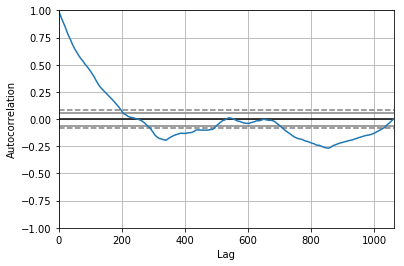

<Figure size 800x560 with 0 Axes>

Test MSE: 0.416


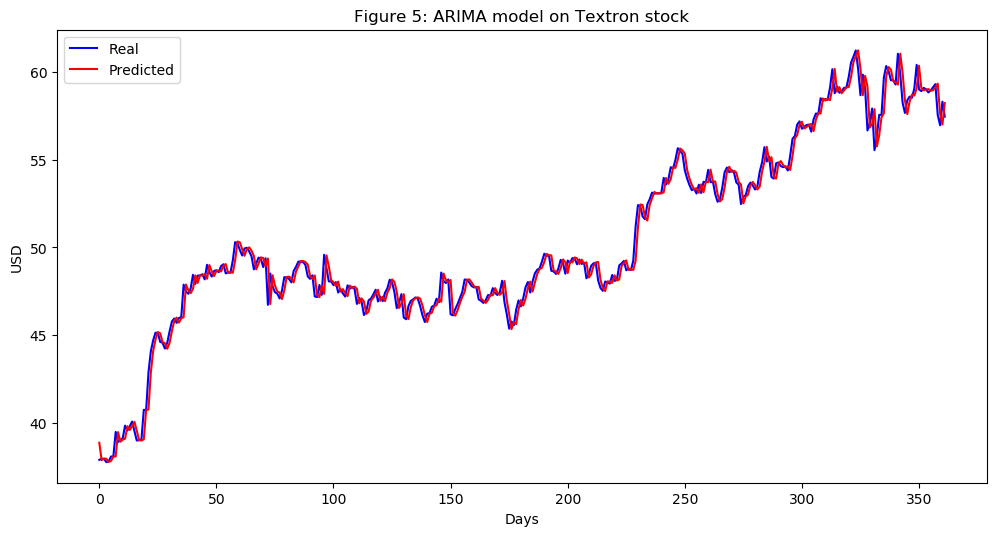

In [319]:
Textron_series = SP500_TechIndicator['Textron_Close']
Textron_series_model = ARIMA(Textron_series, order=(5, 1, 0))
Textron_model_fit = Textron_series_model.fit(disp=0)
print(Textron_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Textron_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Textron_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Textron_predictions = list()
for t in range(len(test)):
    Textron_series_model = ARIMA(history, order=(5,1,0))
    Textron_series_model_fit = Textron_series_model.fit(disp=0)
    Textron_output = Textron_series_model_fit.forecast()
    yhat = Textron_output[0]
    Textron_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Textron_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Textron_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Textron stock')
plt.legend()
plt.show()


#predictions
Textron_predictions = pd.DataFrame({'Textron_predictions':Textron_predictions})
#Textron_predictions.to_csv('Textron_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.TransDigm_Group_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -2858.188
Method:                            css-mle   S.D. of innovations              3.578
Date:                     Sun, 17 Mar 2019   AIC                           5730.376
Time:                             21:52:44   BIC                           5765.144
Sample:                                  1   HQIC                          5743.552
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.1362      0.103      1.329      0.184      -0.065       0.337
ar.L1.D.TransDigm_Group_Close    -

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


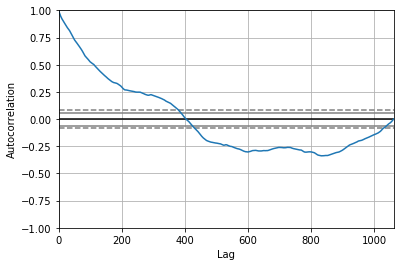

<Figure size 800x560 with 0 Axes>

Test MSE: 18.677


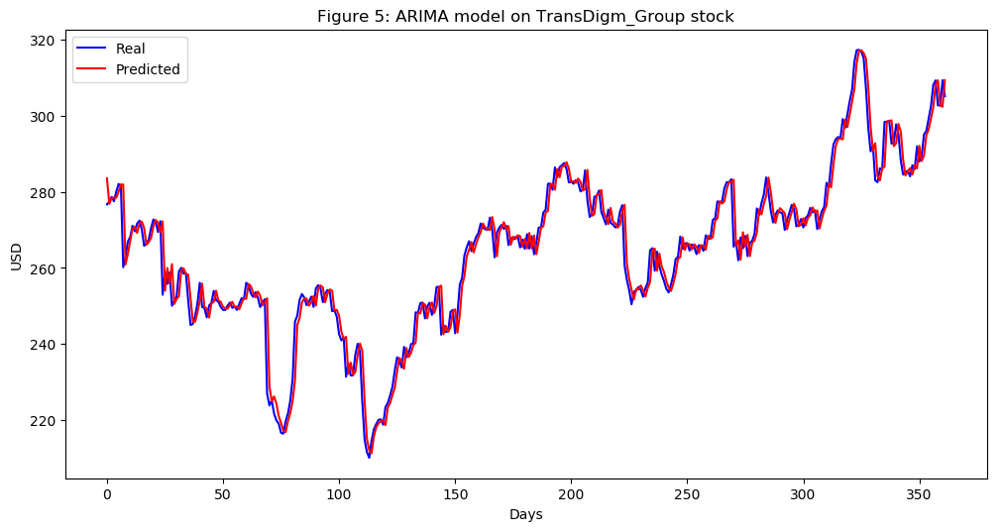

In [320]:
TransDigm_Group_series = SP500_TechIndicator['TransDigm_Group_Close']
TransDigm_Group_series_model = ARIMA(TransDigm_Group_series, order=(5, 1, 0))
TransDigm_Group_model_fit = TransDigm_Group_series_model.fit(disp=0)
print(TransDigm_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(TransDigm_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = TransDigm_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
TransDigm_Group_predictions = list()
for t in range(len(test)):
    TransDigm_Group_series_model = ARIMA(history, order=(5,1,0))
    TransDigm_Group_series_model_fit = TransDigm_Group_series_model.fit(disp=0)
    TransDigm_Group_output = TransDigm_Group_series_model_fit.forecast()
    yhat = TransDigm_Group_output[0]
    TransDigm_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, TransDigm_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(TransDigm_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on TransDigm_Group stock')
plt.legend()
plt.show()


#predictions
TransDigm_Group_predictions = pd.DataFrame({'TransDigm_Group_predictions':TransDigm_Group_predictions})
#TransDigm_Group_predictions.to_csv('TransDigm_Group_predictions.csv')



                               ARIMA Model Results                               
Dep. Variable:     D.Union_Pacific_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -2810.315
Method:                          css-mle   S.D. of innovations              3.421
Date:                   Sun, 17 Mar 2019   AIC                           5634.629
Time:                           21:53:35   BIC                           5669.398
Sample:                                1   HQIC                          5647.806
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          -0.0347      0.103     -0.336      0.737      -0.237       0.168
ar.L1.D.Union_Pacific_Close    -0.0151      0.031     -0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


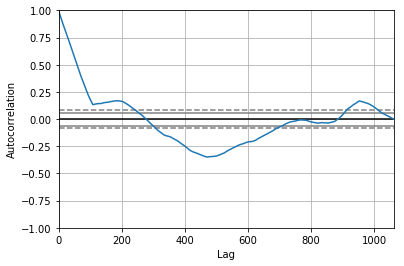

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 2.522


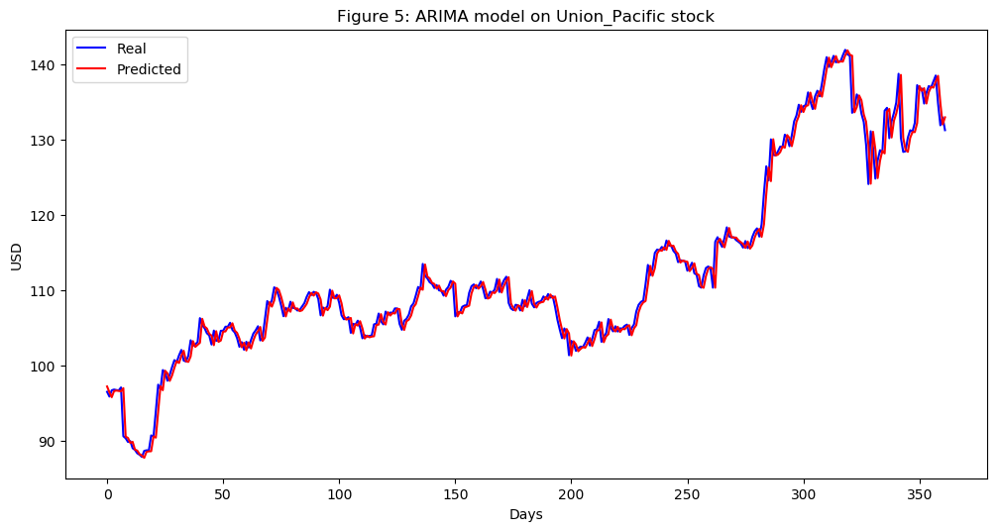

In [321]:
Union_Pacific_series = SP500_TechIndicator['Union_Pacific_Close']
Union_Pacific_series_model = ARIMA(Union_Pacific_series, order=(5, 1, 0))
Union_Pacific_model_fit = Union_Pacific_series_model.fit(disp=0)
print(Union_Pacific_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Union_Pacific_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Union_Pacific_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Union_Pacific_predictions = list()
for t in range(len(test)):
    Union_Pacific_series_model = ARIMA(history, order=(5,1,0))
    Union_Pacific_series_model_fit = Union_Pacific_series_model.fit(disp=0)
    Union_Pacific_output = Union_Pacific_series_model_fit.forecast()
    yhat = Union_Pacific_output[0]
    Union_Pacific_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Union_Pacific_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Union_Pacific_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Union_Pacific stock')
plt.legend()
plt.show()


#predictions
Union_Pacific_predictions = pd.DataFrame({'Union_Pacific_predictions':Union_Pacific_predictions})
#Union_Pacific_predictions.to_csv('Union_Pacific_predictions.csv')



                                      ARIMA Model Results                                      
Dep. Variable:     D.United_Continental_Holdings_Close   No. Observations:                 1061
Model:                                  ARIMA(5, 1, 0)   Log Likelihood               -1803.542
Method:                                        css-mle   S.D. of innovations              1.324
Date:                                 Sun, 17 Mar 2019   AIC                           3621.084
Time:                                         21:54:28   BIC                           3655.853
Sample:                                              1   HQIC                          3634.261
                                                                                               
                                                coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------------
const       

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


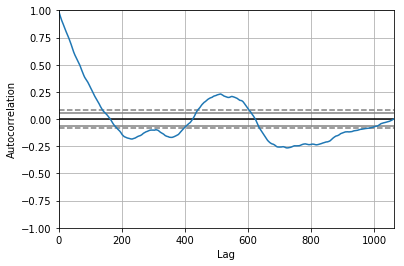

<Figure size 800x560 with 0 Axes>

Test MSE: 1.862


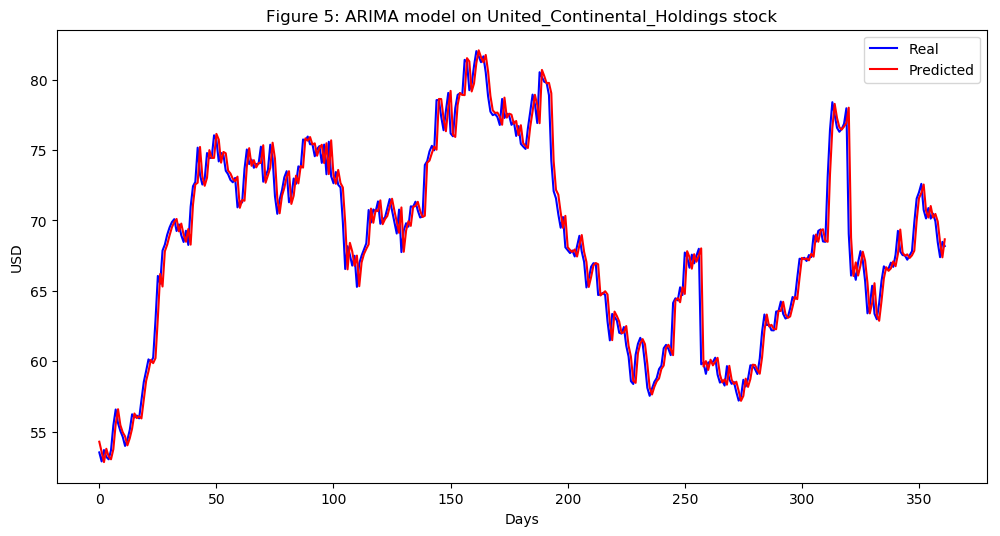

In [322]:
United_Continental_Holdings_series = SP500_TechIndicator['United_Continental_Holdings_Close']
United_Continental_Holdings_series_model = ARIMA(United_Continental_Holdings_series, order=(5, 1, 0))
United_Continental_Holdings_model_fit = United_Continental_Holdings_series_model.fit(disp=0)
print(United_Continental_Holdings_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(United_Continental_Holdings_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = United_Continental_Holdings_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
United_Continental_Holdings_predictions = list()
for t in range(len(test)):
    United_Continental_Holdings_series_model = ARIMA(history, order=(5,1,0))
    United_Continental_Holdings_series_model_fit = United_Continental_Holdings_series_model.fit(disp=0)
    United_Continental_Holdings_output = United_Continental_Holdings_series_model_fit.forecast()
    yhat = United_Continental_Holdings_output[0]
    United_Continental_Holdings_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, United_Continental_Holdings_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(United_Continental_Holdings_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on United_Continental_Holdings stock')
plt.legend()
plt.show()


#predictions
United_Continental_Holdings_predictions = pd.DataFrame({'United_Continental_Holdings_predictions':United_Continental_Holdings_predictions})
#United_Continental_Holdings_predictions.to_csv('United_Continental_Holdings_predictions.csv')



                                   ARIMA Model Results                                   
Dep. Variable:     D.United_Parcel_Service_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood               -1627.735
Method:                                  css-mle   S.D. of innovations              1.122
Date:                           Sun, 17 Mar 2019   AIC                           3269.471
Time:                                   21:55:13   BIC                           3304.239
Sample:                                        1   HQIC                          3282.647
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                  -0.0034      0.040     -0.085    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


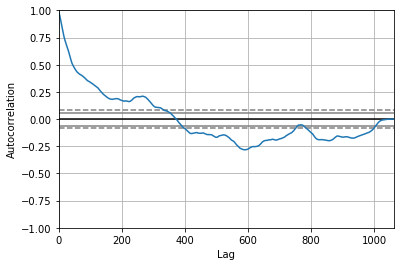

<Figure size 800x560 with 0 Axes>

Test MSE: 1.689


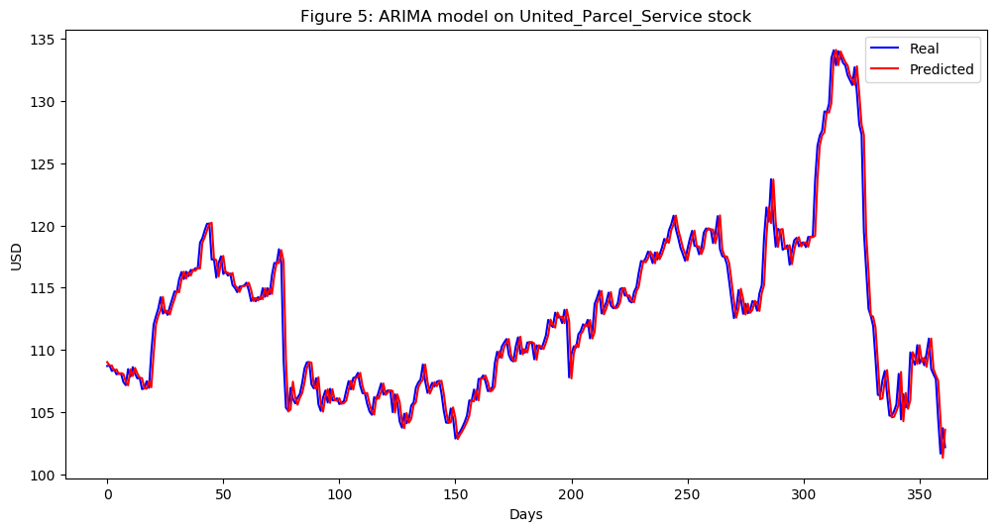

In [323]:
United_Parcel_Service_series = SP500_TechIndicator['United_Parcel_Service_Close']
United_Parcel_Service_series_model = ARIMA(United_Parcel_Service_series, order=(5, 1, 0))
United_Parcel_Service_model_fit = United_Parcel_Service_series_model.fit(disp=0)
print(United_Parcel_Service_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(United_Parcel_Service_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = United_Parcel_Service_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
United_Parcel_Service_predictions = list()
for t in range(len(test)):
    United_Parcel_Service_series_model = ARIMA(history, order=(5,1,0))
    United_Parcel_Service_series_model_fit = United_Parcel_Service_series_model.fit(disp=0)
    United_Parcel_Service_output = United_Parcel_Service_series_model_fit.forecast()
    yhat = United_Parcel_Service_output[0]
    United_Parcel_Service_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, United_Parcel_Service_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(United_Parcel_Service_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on United_Parcel_Service stock')
plt.legend()
plt.show()


#predictions
United_Parcel_Service_predictions = pd.DataFrame({'United_Parcel_Service_predictions':United_Parcel_Service_predictions})
#United_Parcel_Service_predictions.to_csv('United_Parcel_Service_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.United_Rentals_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -2355.933
Method:                           css-mle   S.D. of innovations              2.229
Date:                    Sun, 17 Mar 2019   AIC                           4725.865
Time:                            21:56:06   BIC                           4760.634
Sample:                                 1   HQIC                          4739.042
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0932      0.068      1.369      0.171      -0.040       0.227
ar.L1.D.United_Rentals_Close    -0.0054      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


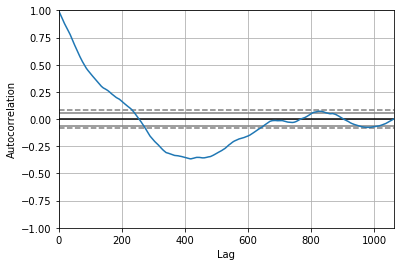

<Figure size 800x560 with 0 Axes>

Test MSE: 6.816


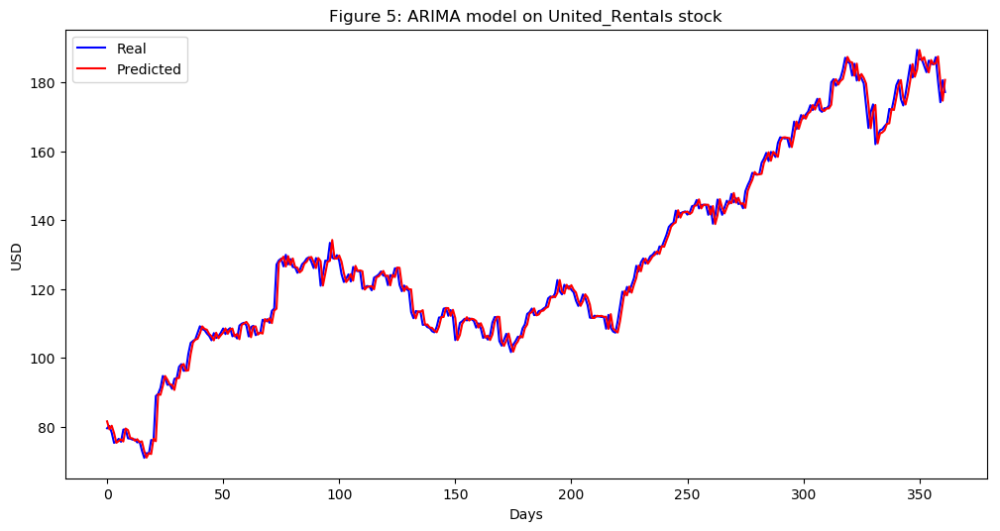

In [324]:
United_Rentals_series = SP500_TechIndicator['United_Rentals_Close']
United_Rentals_series_model = ARIMA(United_Rentals_series, order=(5, 1, 0))
United_Rentals_model_fit = United_Rentals_series_model.fit(disp=0)
print(United_Rentals_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(United_Rentals_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = United_Rentals_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
United_Rentals_predictions = list()
for t in range(len(test)):
    United_Rentals_series_model = ARIMA(history, order=(5,1,0))
    United_Rentals_series_model_fit = United_Rentals_series_model.fit(disp=0)
    United_Rentals_output = United_Rentals_series_model_fit.forecast()
    yhat = United_Rentals_output[0]
    United_Rentals_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, United_Rentals_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(United_Rentals_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on United_Rentals stock')
plt.legend()
plt.show()


#predictions
United_Rentals_predictions = pd.DataFrame({'United_Rentals_predictions':United_Rentals_predictions})
#United_Rentals_predictions.to_csv('United_Rentals_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.United_Technologies_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1687.527
Method:                                css-mle   S.D. of innovations              1.187
Date:                         Sun, 17 Mar 2019   AIC                           3389.054
Time:                                 21:56:48   BIC                           3423.823
Sample:                                      1   HQIC                          3402.230
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0107      0.036      0.298      0.766      -0.060   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


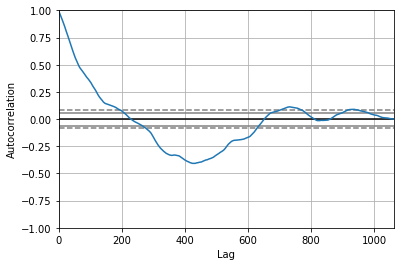

<Figure size 800x560 with 0 Axes>

Test MSE: 1.575


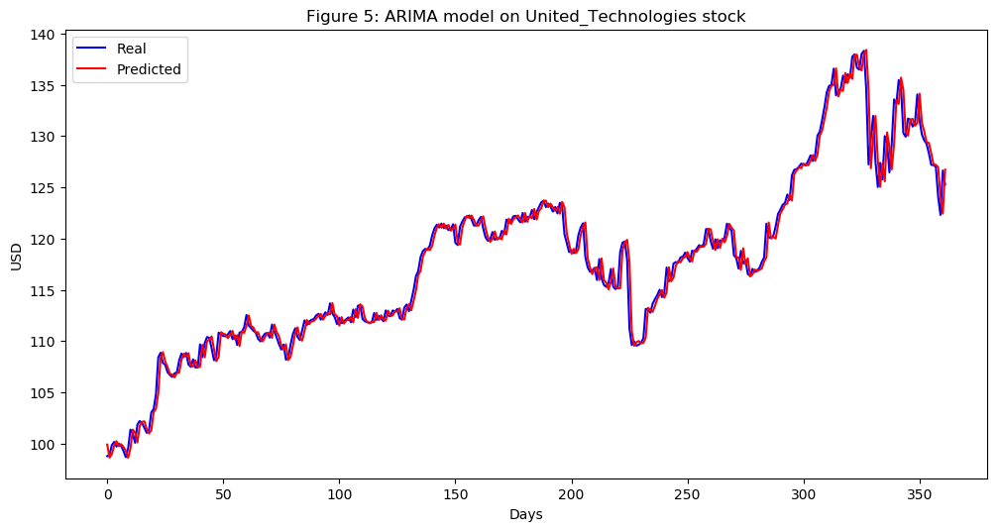

In [325]:
United_Technologies_series = SP500_TechIndicator['United_Technologies_Close']
United_Technologies_series_model = ARIMA(United_Technologies_series, order=(5, 1, 0))
United_Technologies_model_fit = United_Technologies_series_model.fit(disp=0)
print(United_Technologies_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(United_Technologies_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = United_Technologies_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
United_Technologies_predictions = list()
for t in range(len(test)):
    United_Technologies_series_model = ARIMA(history, order=(5,1,0))
    United_Technologies_series_model_fit = United_Technologies_series_model.fit(disp=0)
    United_Technologies_output = United_Technologies_series_model_fit.forecast()
    yhat = United_Technologies_output[0]
    United_Technologies_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, United_Technologies_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(United_Technologies_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on United_Technologies stock')
plt.legend()
plt.show()


#predictions
United_Technologies_predictions = pd.DataFrame({'United_Technologies_predictions':United_Technologies_predictions})
#United_Technologies_predictions.to_csv('United_Technologies_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Verisk_Analytics_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -1361.605
Method:                             css-mle   S.D. of innovations              0.873
Date:                      Sun, 17 Mar 2019   AIC                           2737.210
Time:                              21:57:39   BIC                           2771.979
Sample:                                   1   HQIC                          2750.387
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0340      0.026      1.312      0.190      -0.017       0.085
ar.L1.D.Verisk_Analytic

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


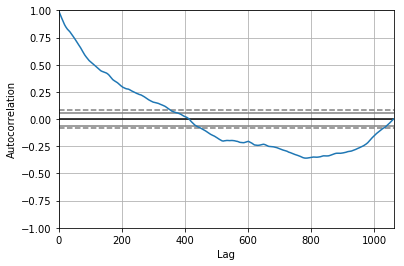

<Figure size 800x560 with 0 Axes>

Test MSE: 0.733


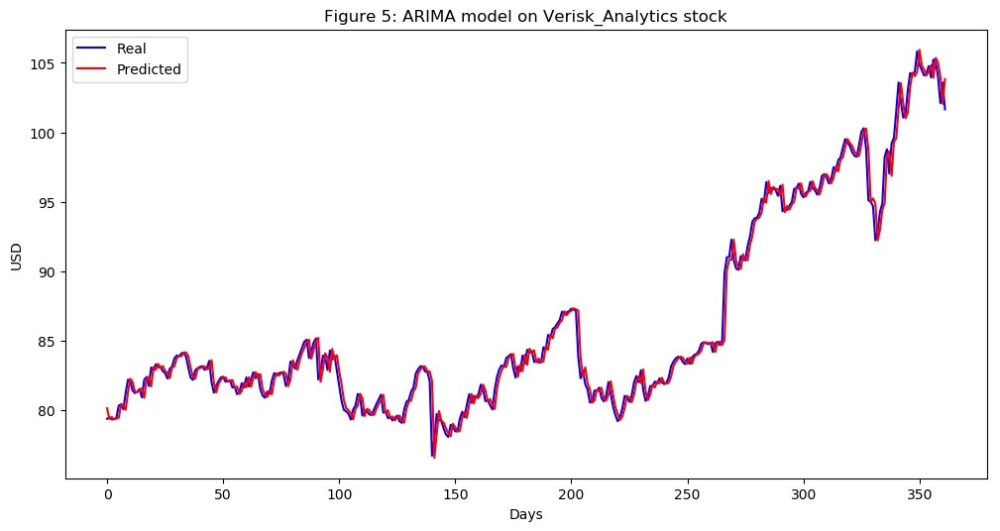

In [326]:
Verisk_Analytics_series = SP500_TechIndicator['Verisk_Analytics_Close']
Verisk_Analytics_series_model = ARIMA(Verisk_Analytics_series, order=(5, 1, 0))
Verisk_Analytics_model_fit = Verisk_Analytics_series_model.fit(disp=0)
print(Verisk_Analytics_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Verisk_Analytics_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Verisk_Analytics_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Verisk_Analytics_predictions = list()
for t in range(len(test)):
    Verisk_Analytics_series_model = ARIMA(history, order=(5,1,0))
    Verisk_Analytics_series_model_fit = Verisk_Analytics_series_model.fit(disp=0)
    Verisk_Analytics_output = Verisk_Analytics_series_model_fit.forecast()
    yhat = Verisk_Analytics_output[0]
    Verisk_Analytics_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Verisk_Analytics_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Verisk_Analytics_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Verisk_Analytics stock')
plt.legend()
plt.show()


#predictions
Verisk_Analytics_predictions = pd.DataFrame({'Verisk_Analytics_predictions':Verisk_Analytics_predictions})
#Verisk_Analytics_predictions.to_csv('Verisk_Analytics_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Waste_Management_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood                -857.603
Method:                             css-mle   S.D. of innovations              0.543
Date:                      Sun, 17 Mar 2019   AIC                           1729.207
Time:                              21:58:35   BIC                           1763.975
Sample:                                   1   HQIC                          1742.383
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0359      0.018      1.988      0.047       0.001       0.071
ar.L1.D.Waste_Managemen

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


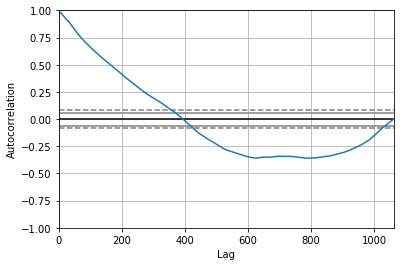

<Figure size 800x560 with 0 Axes>

Test MSE: 0.449


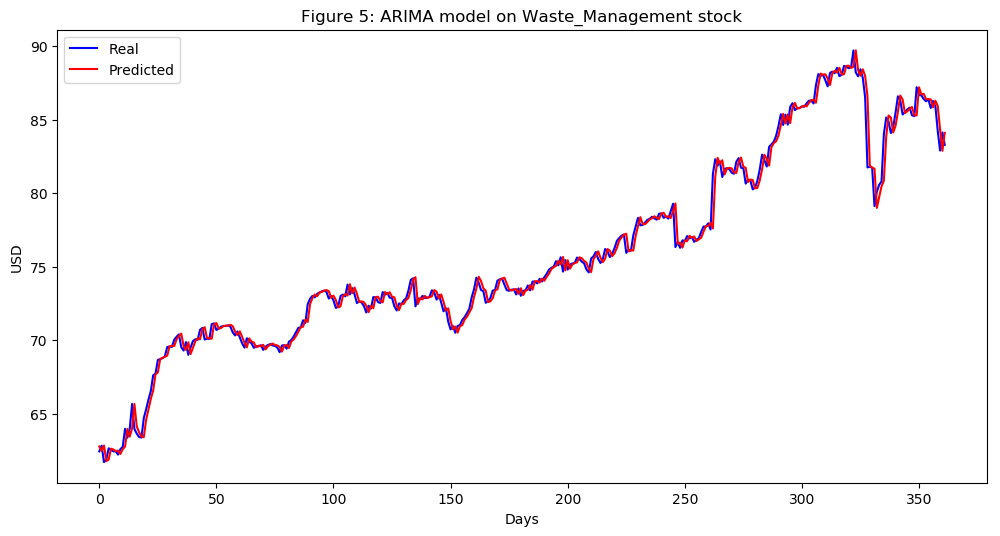

In [327]:
Waste_Management_series = SP500_TechIndicator['Waste_Management_Close']
Waste_Management_series_model = ARIMA(Waste_Management_series, order=(5, 1, 0))
Waste_Management_model_fit = Waste_Management_series_model.fit(disp=0)
print(Waste_Management_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Waste_Management_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Waste_Management_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Waste_Management_predictions = list()
for t in range(len(test)):
    Waste_Management_series_model = ARIMA(history, order=(5,1,0))
    Waste_Management_series_model_fit = Waste_Management_series_model.fit(disp=0)
    Waste_Management_output = Waste_Management_series_model_fit.forecast()
    yhat = Waste_Management_output[0]
    Waste_Management_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Waste_Management_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Waste_Management_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Waste_Management stock')
plt.legend()
plt.show()


#predictions
Waste_Management_predictions = pd.DataFrame({'Waste_Management_predictions':Waste_Management_predictions})
#Waste_Management_predictions.to_csv('Waste_Management_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Xylem_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -924.018
Method:                       css-mle   S.D. of innovations              0.578
Date:                Sun, 17 Mar 2019   AIC                           1862.035
Time:                        21:59:45   BIC                           1896.804
Sample:                             1   HQIC                          1875.212
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0396      0.016      2.470      0.014       0.008       0.071
ar.L1.D.Xylem_Close    -0.0498      0.031     -1.617      0.106      -0.110       0.011
ar.L2.D.Xylem_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


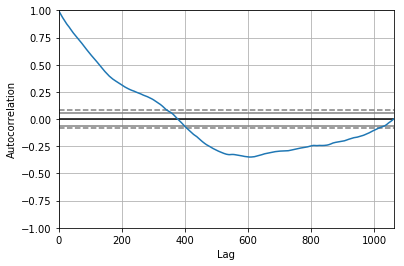

<Figure size 800x560 with 0 Axes>

Test MSE: 0.478


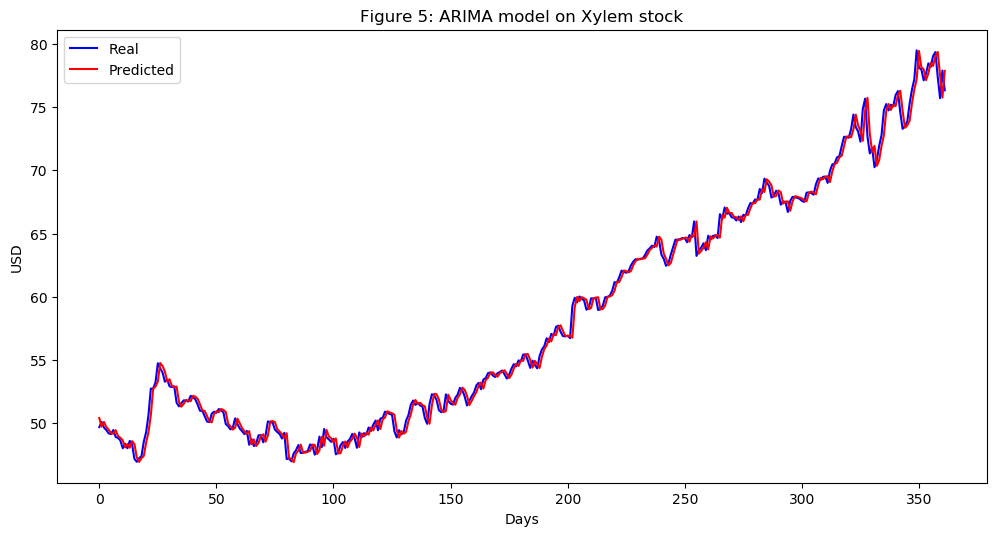

In [328]:
Xylem_series = SP500_TechIndicator['Xylem_Close']
Xylem_series_model = ARIMA(Xylem_series, order=(5, 1, 0))
Xylem_model_fit = Xylem_series_model.fit(disp=0)
print(Xylem_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Xylem_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Xylem_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Xylem_predictions = list()
for t in range(len(test)):
    Xylem_series_model = ARIMA(history, order=(5,1,0))
    Xylem_series_model_fit = Xylem_series_model.fit(disp=0)
    Xylem_output = Xylem_series_model_fit.forecast()
    yhat = Xylem_output[0]
    Xylem_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Xylem_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Xylem_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Xylem stock')
plt.legend()
plt.show()


#predictions
Xylem_predictions = pd.DataFrame({'Xylem_predictions':Xylem_predictions})
#Xylem_predictions.to_csv('Xylem_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:      D.Accenture_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1785.435
Method:                       css-mle   S.D. of innovations              1.302
Date:                Sun, 17 Mar 2019   AIC                           3584.870
Time:                        22:00:41   BIC                           3619.639
Sample:                             1   HQIC                          3598.046
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.0629      0.037      1.703      0.089      -0.010       0.135
ar.L1.D.Accenture_Close    -0.0210      0.031     -0.681      0.496      -0.081       0.039


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


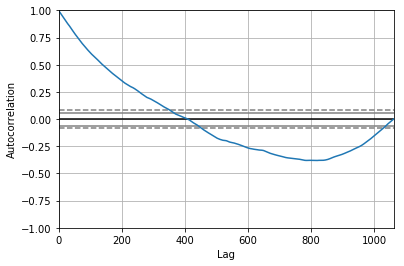

<Figure size 800x560 with 0 Axes>

Test MSE: 2.228


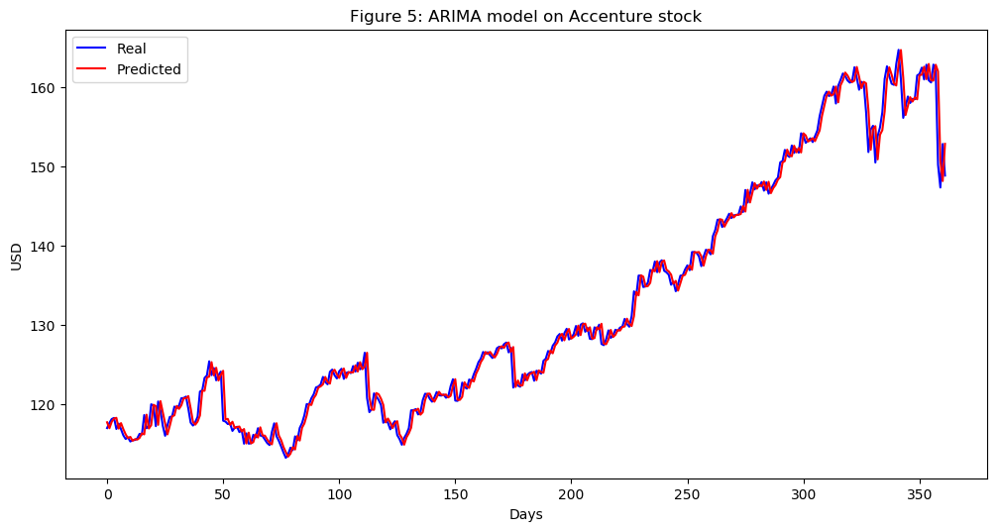

In [329]:
Accenture_series = SP500_TechIndicator['Accenture_Close']
Accenture_series_model = ARIMA(Accenture_series, order=(5, 1, 0))
Accenture_model_fit = Accenture_series_model.fit(disp=0)
print(Accenture_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Accenture_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Accenture_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Accenture_predictions = list()
for t in range(len(test)):
    Accenture_series_model = ARIMA(history, order=(5,1,0))
    Accenture_series_model_fit = Accenture_series_model.fit(disp=0)
    Accenture_output = Accenture_series_model_fit.forecast()
    yhat = Accenture_output[0]
    Accenture_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Accenture_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Accenture_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Accenture stock')
plt.legend()
plt.show()


#predictions
Accenture_predictions = pd.DataFrame({'Accenture_predictions':Accenture_predictions})
#Accenture_predictions.to_csv('Accenture_predictions.csv')



                               ARIMA Model Results                               
Dep. Variable:     D.Adobe_Systems_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -2117.456
Method:                          css-mle   S.D. of innovations              1.780
Date:                   Sun, 17 Mar 2019   AIC                           4248.913
Time:                           22:01:28   BIC                           4283.681
Sample:                                1   HQIC                          4262.089
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.1469      0.046      3.180      0.002       0.056       0.237
ar.L1.D.Adobe_Systems_Close    -0.0657      0.032     -2

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


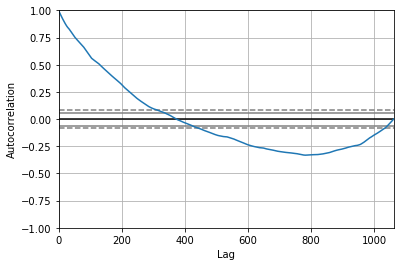

<Figure size 800x560 with 0 Axes>

Test MSE: 6.524


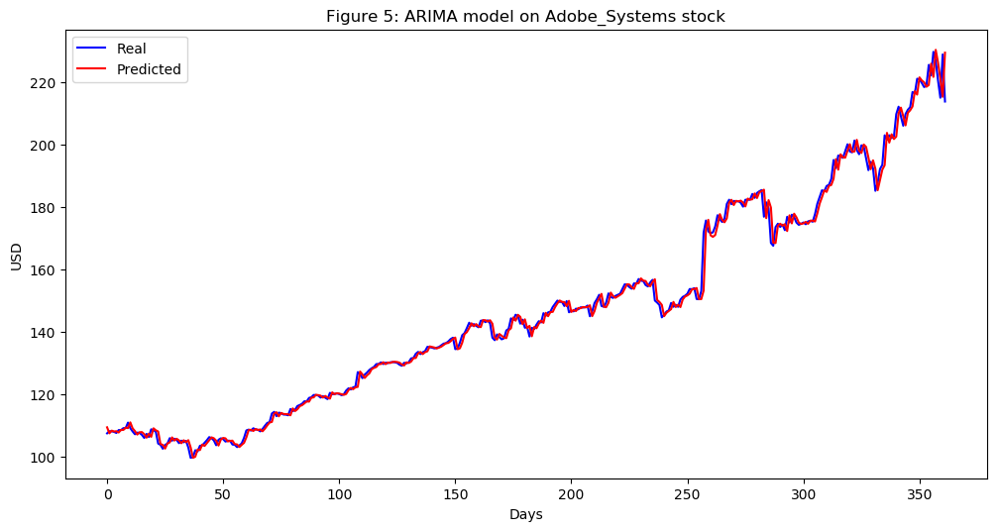

In [330]:
Adobe_Systems_series = SP500_TechIndicator['Adobe_Systems_Close']
Adobe_Systems_series_model = ARIMA(Adobe_Systems_series, order=(5, 1, 0))
Adobe_Systems_model_fit = Adobe_Systems_series_model.fit(disp=0)
print(Adobe_Systems_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Adobe_Systems_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Adobe_Systems_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Adobe_Systems_predictions = list()
for t in range(len(test)):
    Adobe_Systems_series_model = ARIMA(history, order=(5,1,0))
    Adobe_Systems_series_model_fit = Adobe_Systems_series_model.fit(disp=0)
    Adobe_Systems_output = Adobe_Systems_series_model_fit.forecast()
    yhat = Adobe_Systems_output[0]
    Adobe_Systems_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Adobe_Systems_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Adobe_Systems_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Adobe_Systems stock')
plt.legend()
plt.show()


#predictions
Adobe_Systems_predictions = pd.DataFrame({'Adobe_Systems_predictions':Adobe_Systems_predictions})
#Adobe_Systems_predictions.to_csv('Adobe_Systems_predictions.csv')



                                   ARIMA Model Results                                    
Dep. Variable:     D.Advanced_Micro_Devices_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood                -119.289
Method:                                   css-mle   S.D. of innovations              0.271
Date:                            Sun, 17 Mar 2019   AIC                            252.577
Time:                                    22:02:14   BIC                            287.346
Sample:                                         1   HQIC                           265.754
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0059      0.008    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


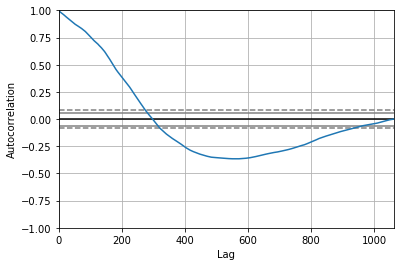

<Figure size 800x560 with 0 Axes>

Test MSE: 0.185


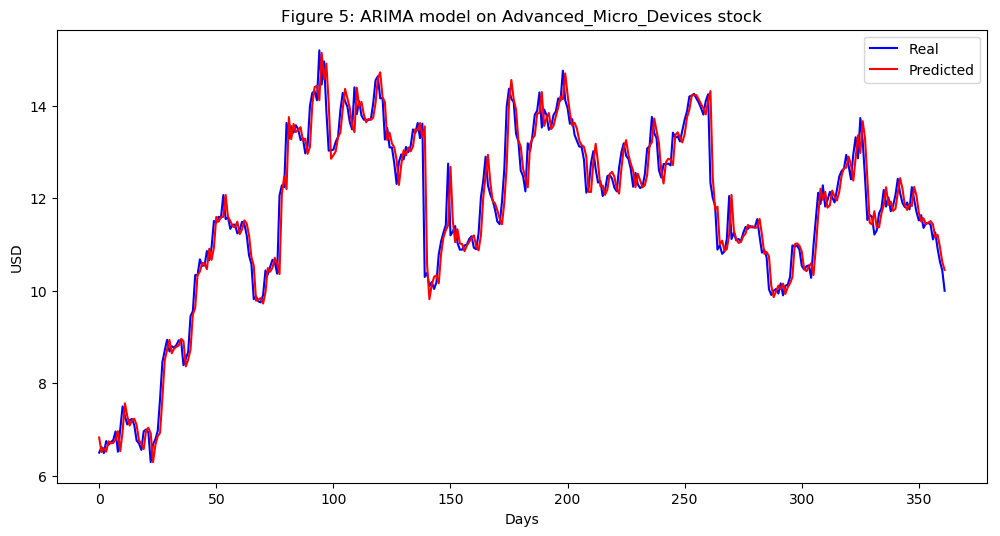

In [331]:
Advanced_Micro_Devices_series = SP500_TechIndicator['Advanced_Micro_Devices_Close']
Advanced_Micro_Devices_series_model = ARIMA(Advanced_Micro_Devices_series, order=(5, 1, 0))
Advanced_Micro_Devices_model_fit = Advanced_Micro_Devices_series_model.fit(disp=0)
print(Advanced_Micro_Devices_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Advanced_Micro_Devices_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Advanced_Micro_Devices_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Advanced_Micro_Devices_predictions = list()
for t in range(len(test)):
    Advanced_Micro_Devices_series_model = ARIMA(history, order=(5,1,0))
    Advanced_Micro_Devices_series_model_fit = Advanced_Micro_Devices_series_model.fit(disp=0)
    Advanced_Micro_Devices_output = Advanced_Micro_Devices_series_model_fit.forecast()
    yhat = Advanced_Micro_Devices_output[0]
    Advanced_Micro_Devices_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Advanced_Micro_Devices_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Advanced_Micro_Devices_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Advanced_Micro_Devices stock')
plt.legend()
plt.show()


#predictions
Advanced_Micro_Devices_predictions = pd.DataFrame({'Advanced_Micro_Devices_predictions':Advanced_Micro_Devices_predictions})
#Advanced_Micro_Devices_predictions.to_csv('Advanced_Micro_Devices_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.Akamai_Technologies_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1738.895
Method:                                css-mle   S.D. of innovations              1.246
Date:                         Sun, 17 Mar 2019   AIC                           3491.791
Time:                                 22:03:13   BIC                           3526.560
Sample:                                      1   HQIC                          3504.967
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0222      0.038      0.582      0.561      -0.053   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


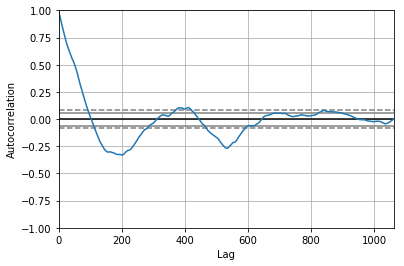

<Figure size 800x560 with 0 Axes>

Test MSE: 1.631


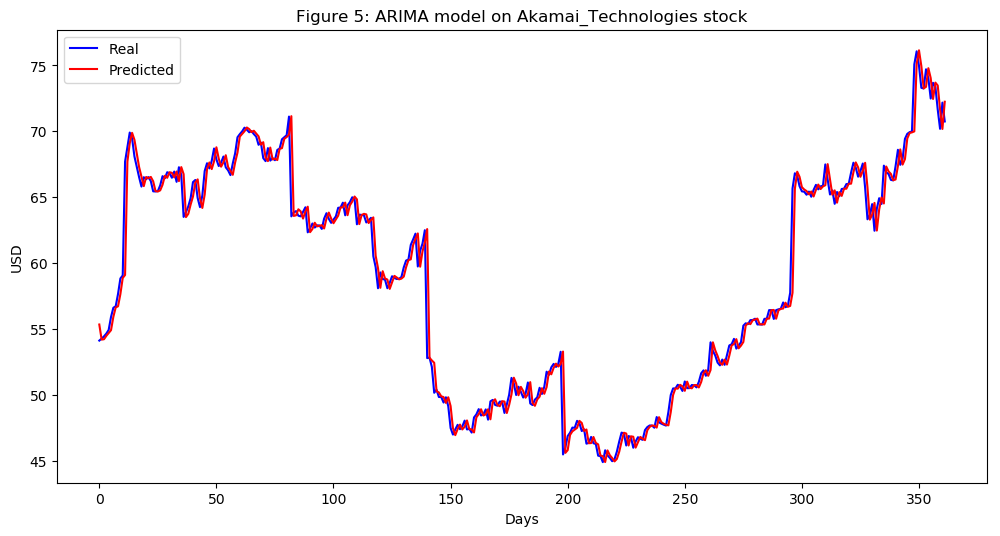

In [332]:
Akamai_Technologies_series = SP500_TechIndicator['Akamai_Technologies_Close']
Akamai_Technologies_series_model = ARIMA(Akamai_Technologies_series, order=(5, 1, 0))
Akamai_Technologies_model_fit = Akamai_Technologies_series_model.fit(disp=0)
print(Akamai_Technologies_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Akamai_Technologies_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Akamai_Technologies_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Akamai_Technologies_predictions = list()
for t in range(len(test)):
    Akamai_Technologies_series_model = ARIMA(history, order=(5,1,0))
    Akamai_Technologies_series_model_fit = Akamai_Technologies_series_model.fit(disp=0)
    Akamai_Technologies_output = Akamai_Technologies_series_model_fit.forecast()
    yhat = Akamai_Technologies_output[0]
    Akamai_Technologies_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Akamai_Technologies_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Akamai_Technologies_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Akamai_Technologies stock')
plt.legend()
plt.show()


#predictions
Akamai_Technologies_predictions = pd.DataFrame({'Akamai_Technologies_predictions':Akamai_Technologies_predictions})
#Akamai_Technologies_predictions.to_csv('Akamai_Technologies_predictions.csv')



                                   ARIMA Model Results                                   
Dep. Variable:     D.Alliance_Data_Systems_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood               -3063.472
Method:                                  css-mle   S.D. of innovations              4.342
Date:                           Sun, 17 Mar 2019   AIC                           6140.944
Time:                                   22:04:06   BIC                           6175.713
Sample:                                        1   HQIC                          6154.121
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                  -0.0417      0.133     -0.314    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


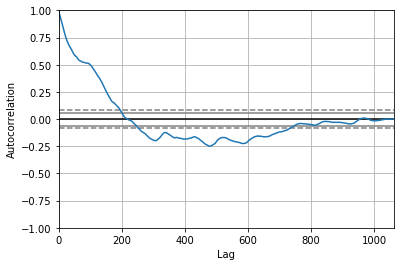

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 15.353


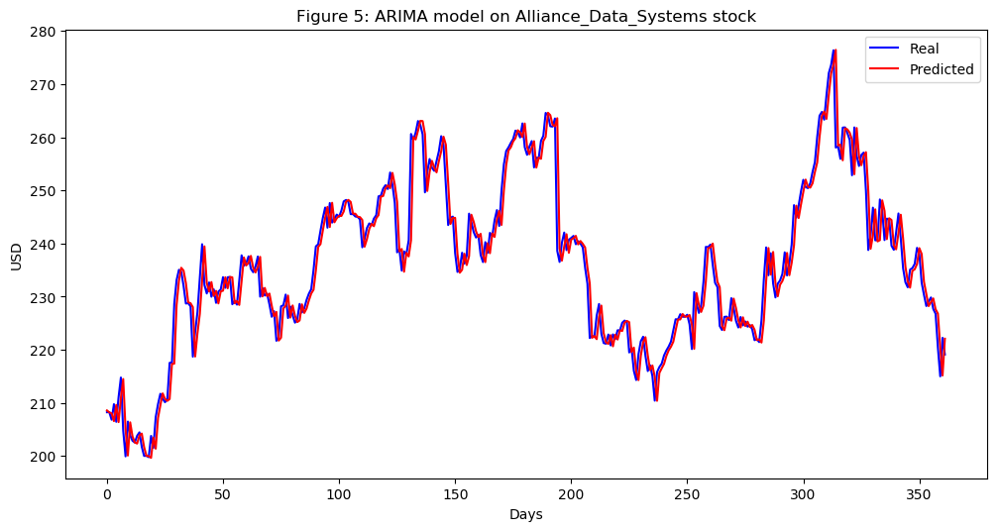

In [333]:
Alliance_Data_Systems_series = SP500_TechIndicator['Alliance_Data_Systems_Close']
Alliance_Data_Systems_series_model = ARIMA(Alliance_Data_Systems_series, order=(5, 1, 0))
Alliance_Data_Systems_model_fit = Alliance_Data_Systems_series_model.fit(disp=0)
print(Alliance_Data_Systems_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Alliance_Data_Systems_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Alliance_Data_Systems_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Alliance_Data_Systems_predictions = list()
for t in range(len(test)):
    Alliance_Data_Systems_series_model = ARIMA(history, order=(5,1,0))
    Alliance_Data_Systems_series_model_fit = Alliance_Data_Systems_series_model.fit(disp=0)
    Alliance_Data_Systems_output = Alliance_Data_Systems_series_model_fit.forecast()
    yhat = Alliance_Data_Systems_output[0]
    Alliance_Data_Systems_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Alliance_Data_Systems_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Alliance_Data_Systems_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alliance_Data_Systems stock')
plt.legend()
plt.show()


#predictions
Alliance_Data_Systems_predictions = pd.DataFrame({'Alliance_Data_Systems_predictions':Alliance_Data_Systems_predictions})
#Alliance_Data_Systems_predictions.to_csv('Alliance_Data_Systems_predictions.csv')



                               ARIMA Model Results                               
Dep. Variable:     D.Amphenol_Corp_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -2119.150
Method:                          css-mle   S.D. of innovations              1.783
Date:                   Sun, 17 Mar 2019   AIC                           4252.300
Time:                           22:05:00   BIC                           4287.069
Sample:                                1   HQIC                          4265.477
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          -0.0033      0.052     -0.062      0.950      -0.106       0.099
ar.L1.D.Amphenol_Corp_Close     0.0151      0.031      0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


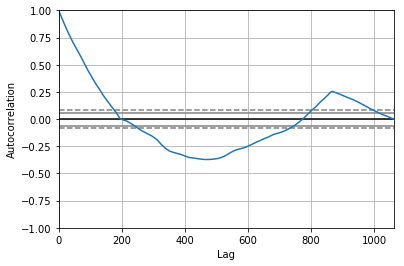

<Figure size 800x560 with 0 Axes>

Test MSE: 0.544


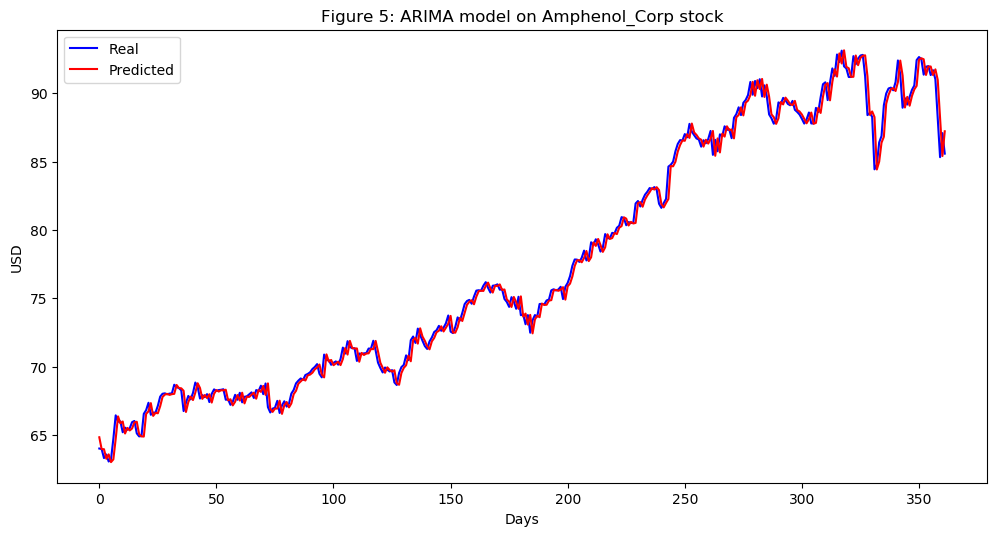

In [334]:
Amphenol_Corp_series = SP500_TechIndicator['Amphenol_Corp_Close']
Amphenol_Corp_series_model = ARIMA(Amphenol_Corp_series, order=(5, 1, 0))
Amphenol_Corp_model_fit = Amphenol_Corp_series_model.fit(disp=0)
print(Amphenol_Corp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Amphenol_Corp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Amphenol_Corp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Amphenol_Corp_predictions = list()
for t in range(len(test)):
    Amphenol_Corp_series_model = ARIMA(history, order=(5,1,0))
    Amphenol_Corp_series_model_fit = Amphenol_Corp_series_model.fit(disp=0)
    Amphenol_Corp_output = Amphenol_Corp_series_model_fit.forecast()
    yhat = Amphenol_Corp_output[0]
    Amphenol_Corp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Amphenol_Corp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Amphenol_Corp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Amphenol_Corp stock')
plt.legend()
plt.show()


#predictions
Amphenol_Corp_predictions = pd.DataFrame({'Amphenol_Corp_predictions':Amphenol_Corp_predictions})
#Amphenol_Corp_predictions.to_csv('Amphenol_Corp_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.Analog_Devices_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1514.962
Method:                           css-mle   S.D. of innovations              1.009
Date:                    Sun, 17 Mar 2019   AIC                           3043.925
Time:                            22:05:42   BIC                           3078.693
Sample:                                 1   HQIC                          3057.101
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0380      0.028      1.377      0.169      -0.016       0.092
ar.L1.D.Analog_Devices_Close    -0.0573      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


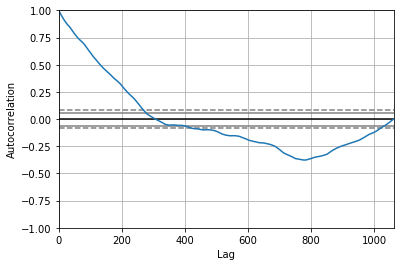

<Figure size 800x560 with 0 Axes>

Test MSE: 1.399


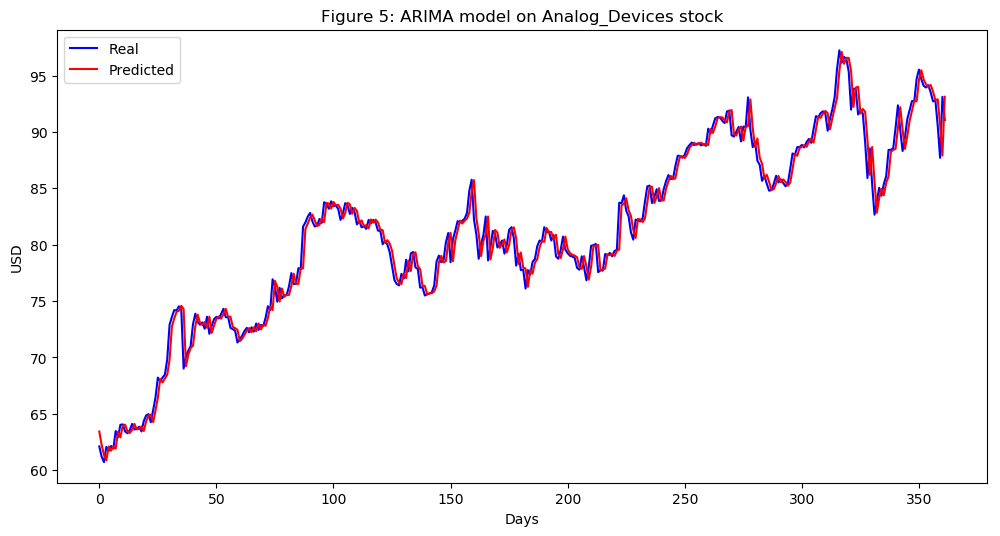

In [335]:
Analog_Devices_series = SP500_TechIndicator['Analog_Devices_Close']
Analog_Devices_series_model = ARIMA(Analog_Devices_series, order=(5, 1, 0))
Analog_Devices_model_fit = Analog_Devices_series_model.fit(disp=0)
print(Analog_Devices_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Analog_Devices_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Analog_Devices_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Analog_Devices_predictions = list()
for t in range(len(test)):
    Analog_Devices_series_model = ARIMA(history, order=(5,1,0))
    Analog_Devices_series_model_fit = Analog_Devices_series_model.fit(disp=0)
    Analog_Devices_output = Analog_Devices_series_model_fit.forecast()
    yhat = Analog_Devices_output[0]
    Analog_Devices_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Analog_Devices_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Analog_Devices_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Analog_Devices stock')
plt.legend()
plt.show()


#predictions
Analog_Devices_predictions = pd.DataFrame({'Analog_Devices_predictions':Analog_Devices_predictions})
#Analog_Devices_predictions.to_csv('Analog_Devices_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.ANSYS_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1806.973
Method:                       css-mle   S.D. of innovations              1.329
Date:                Sun, 17 Mar 2019   AIC                           3627.946
Time:                        22:06:32   BIC                           3662.715
Sample:                             1   HQIC                          3641.123
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0661      0.041      1.619      0.106      -0.014       0.146
ar.L1.D.ANSYS_Close     0.0217      0.031      0.706      0.481      -0.039       0.082
ar.L2.D.ANSYS_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


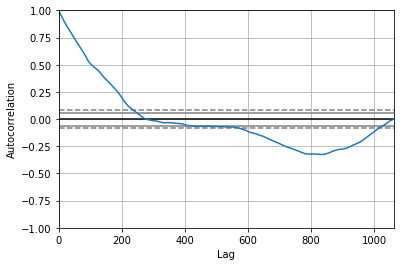

<Figure size 800x560 with 0 Axes>

Test MSE: 3.023


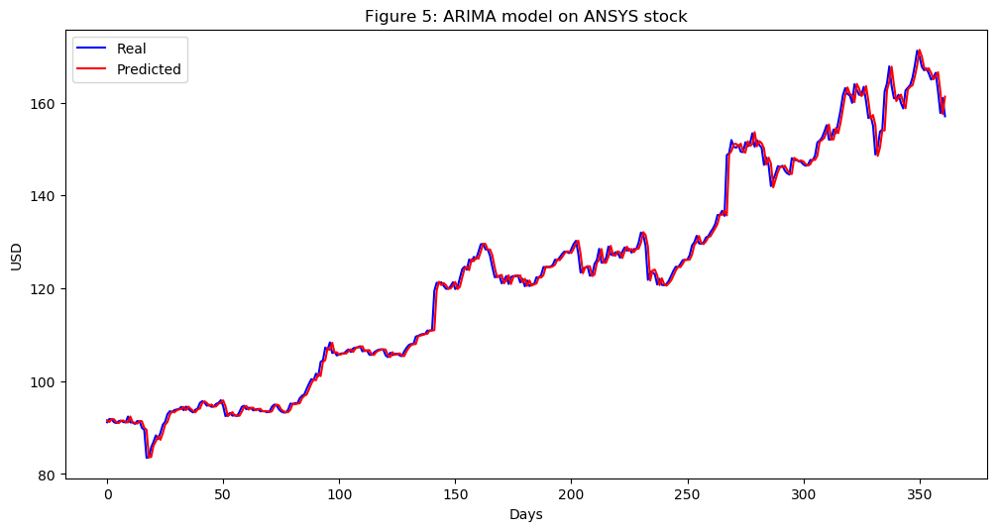

In [336]:
ANSYS_series = SP500_TechIndicator['ANSYS_Close']
ANSYS_series_model = ARIMA(ANSYS_series, order=(5, 1, 0))
ANSYS_model_fit = ANSYS_series_model.fit(disp=0)
print(ANSYS_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(ANSYS_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = ANSYS_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
ANSYS_predictions = list()
for t in range(len(test)):
    ANSYS_series_model = ARIMA(history, order=(5,1,0))
    ANSYS_series_model_fit = ANSYS_series_model.fit(disp=0)
    ANSYS_output = ANSYS_series_model_fit.forecast()
    yhat = ANSYS_output[0]
    ANSYS_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, ANSYS_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(ANSYS_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on ANSYS stock')
plt.legend()
plt.show()


#predictions
ANSYS_predictions = pd.DataFrame({'ANSYS_predictions':ANSYS_predictions})
#ANSYS_predictions.to_csv('ANSYS_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Apple_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -4525.423
Method:                       css-mle   S.D. of innovations             17.224
Date:                Sun, 17 Mar 2019   AIC                           9064.846
Time:                        22:07:19   BIC                           9099.614
Sample:                             1   HQIC                          9078.022
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                  -0.3698      0.521     -0.710      0.478      -1.391       0.651
ar.L1.D.Apple_Close     0.0031      0.031      0.102      0.919      -0.057       0.063
ar.L2.D.Apple_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


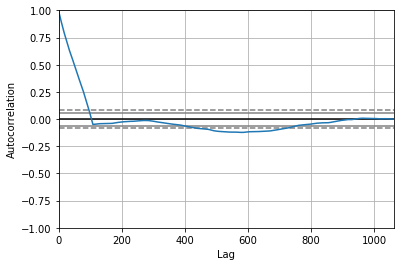

<Figure size 800x560 with 0 Axes>

Test MSE: 3.998


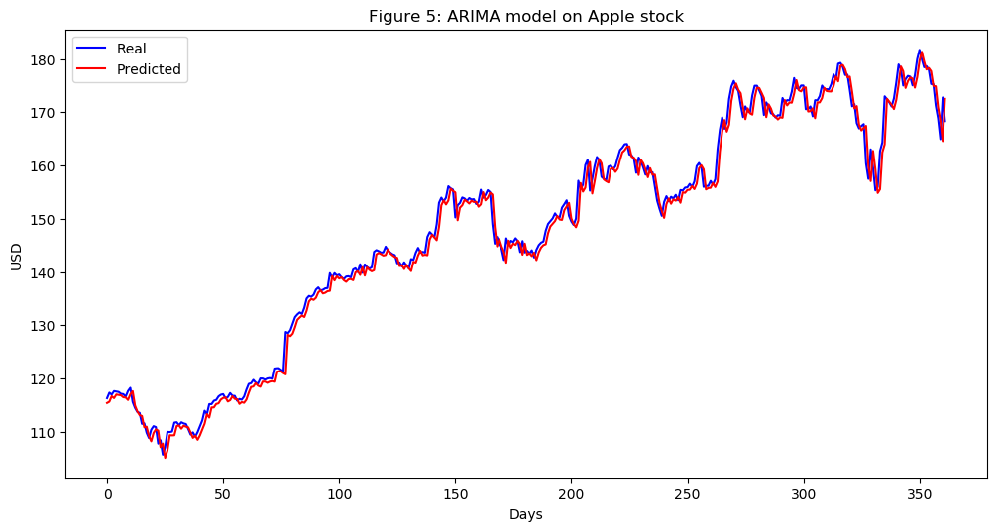

In [337]:
Apple_series = SP500_TechIndicator['Apple_Close']
Apple_series_model = ARIMA(Apple_series, order=(5, 1, 0))
Apple_model_fit = Apple_series_model.fit(disp=0)
print(Apple_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Apple_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Apple_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Apple_predictions = list()
for t in range(len(test)):
    Apple_series_model = ARIMA(history, order=(5,1,0))
    Apple_series_model_fit = Apple_series_model.fit(disp=0)
    Apple_output = Apple_series_model_fit.forecast()
    yhat = Apple_output[0]
    Apple_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Apple_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Apple_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Apple stock')
plt.legend()
plt.show()


#predictions
Apple_predictions = pd.DataFrame({'Apple_predictions':Apple_predictions})
#Apple_predictions.to_csv('Apple_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Applied_Materials_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood                -982.023
Method:                              css-mle   S.D. of innovations              0.611
Date:                       Sun, 17 Mar 2019   AIC                           1978.045
Time:                               22:08:28   BIC                           2012.814
Sample:                                    1   HQIC                          1991.222
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0353      0.020      1.783      0.075      -0.004       0.074
ar.L1.D.Appl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


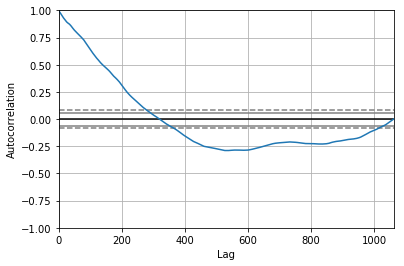

<Figure size 800x560 with 0 Axes>

Test MSE: 0.859


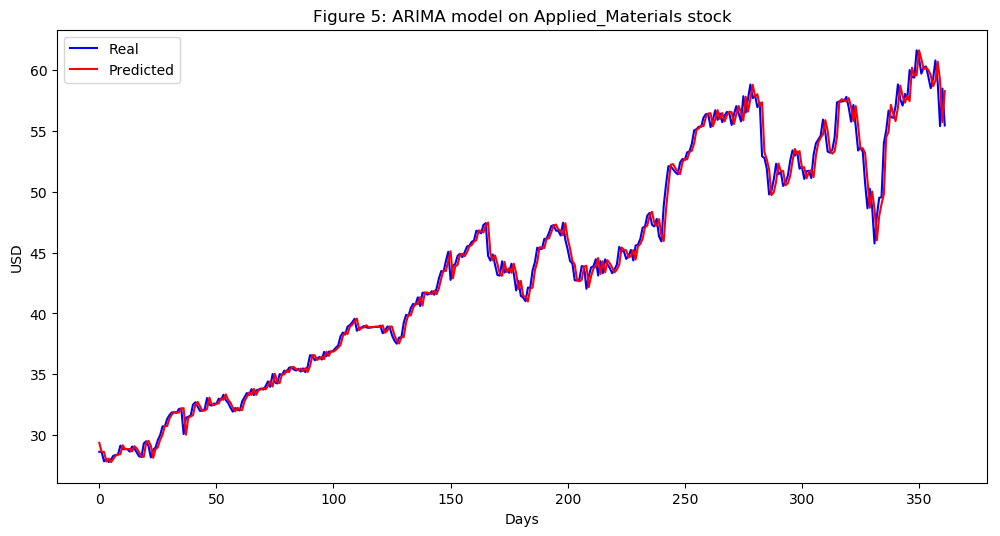

In [338]:
Applied_Materials_series = SP500_TechIndicator['Applied_Materials_Close']
Applied_Materials_series_model = ARIMA(Applied_Materials_series, order=(5, 1, 0))
Applied_Materials_model_fit = Applied_Materials_series_model.fit(disp=0)
print(Applied_Materials_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Applied_Materials_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Applied_Materials_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Applied_Materials_predictions = list()
for t in range(len(test)):
    Applied_Materials_series_model = ARIMA(history, order=(5,1,0))
    Applied_Materials_series_model_fit = Applied_Materials_series_model.fit(disp=0)
    Applied_Materials_output = Applied_Materials_series_model_fit.forecast()
    yhat = Applied_Materials_output[0]
    Applied_Materials_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Applied_Materials_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Applied_Materials_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Applied_Materials stock')
plt.legend()
plt.show()


#predictions
Applied_Materials_predictions = pd.DataFrame({'Applied_Materials_predictions':Applied_Materials_predictions})
#Applied_Materials_predictions.to_csv('Applied_Materials_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Autodesk_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1975.824
Method:                       css-mle   S.D. of innovations              1.558
Date:                Sun, 17 Mar 2019   AIC                           3965.647
Time:                        22:09:47   BIC                           4000.416
Sample:                             1   HQIC                          3978.824
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0735      0.048      1.523      0.128      -0.021       0.168
ar.L1.D.Autodesk_Close     0.0159      0.031      0.515      0.606      -0.045       0.077
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


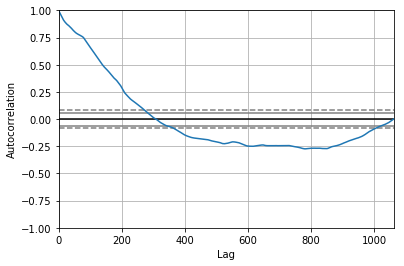

<Figure size 800x560 with 0 Axes>

Test MSE: 5.145


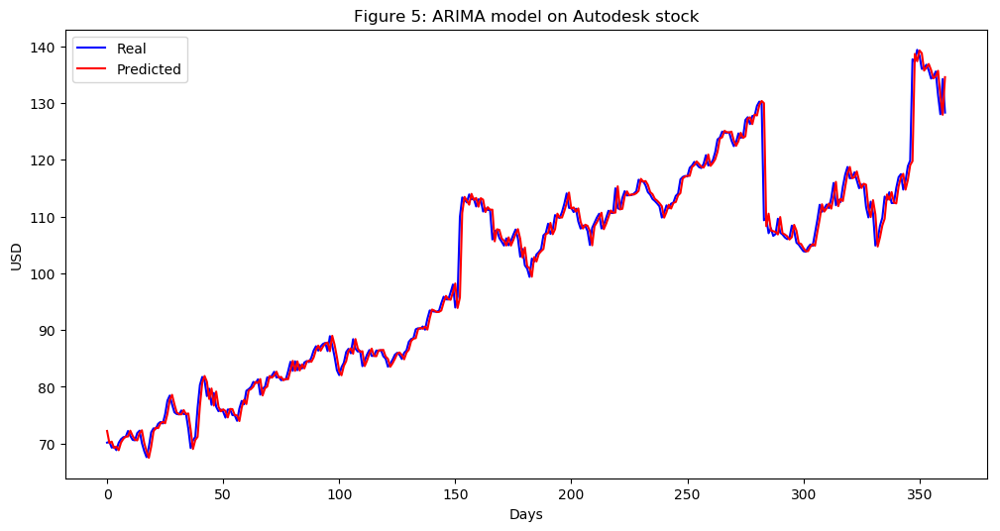

In [339]:
Autodesk_series = SP500_TechIndicator['Autodesk_Close']
Autodesk_series_model = ARIMA(Autodesk_series, order=(5, 1, 0))
Autodesk_model_fit = Autodesk_series_model.fit(disp=0)
print(Autodesk_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Autodesk_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Autodesk_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Autodesk_predictions = list()
for t in range(len(test)):
    Autodesk_series_model = ARIMA(history, order=(5,1,0))
    Autodesk_series_model_fit = Autodesk_series_model.fit(disp=0)
    Autodesk_output = Autodesk_series_model_fit.forecast()
    yhat = Autodesk_output[0]
    Autodesk_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Autodesk_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Autodesk_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Autodesk stock')
plt.legend()
plt.show()


#predictions
Autodesk_predictions = pd.DataFrame({'Autodesk_predictions':Autodesk_predictions})
#Autodesk_predictions.to_csv('Autodesk_predictions.csv')



                                     ARIMA Model Results                                     
Dep. Variable:     D.Automatic_Data_Processing_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood               -1634.933
Method:                                      css-mle   S.D. of innovations              1.130
Date:                               Sun, 17 Mar 2019   AIC                           3283.867
Time:                                       22:10:35   BIC                           3318.636
Sample:                                            1   HQIC                          3297.043
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


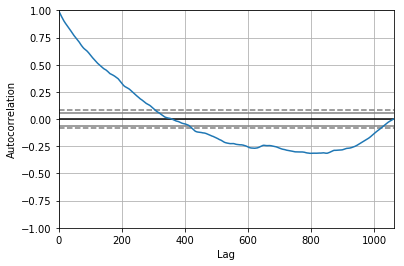

<Figure size 800x560 with 0 Axes>

Test MSE: 1.856


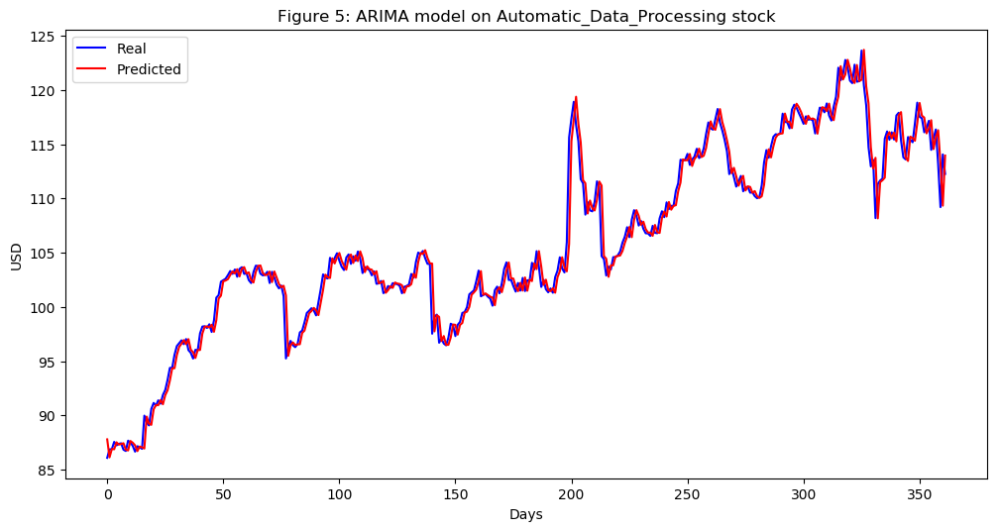

In [340]:
Automatic_Data_Processing_series = SP500_TechIndicator['Automatic_Data_Processing_Close']
Automatic_Data_Processing_series_model = ARIMA(Automatic_Data_Processing_series, order=(5, 1, 0))
Automatic_Data_Processing_model_fit = Automatic_Data_Processing_series_model.fit(disp=0)
print(Automatic_Data_Processing_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Automatic_Data_Processing_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Automatic_Data_Processing_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Automatic_Data_Processing_predictions = list()
for t in range(len(test)):
    Automatic_Data_Processing_series_model = ARIMA(history, order=(5,1,0))
    Automatic_Data_Processing_series_model_fit = Automatic_Data_Processing_series_model.fit(disp=0)
    Automatic_Data_Processing_output = Automatic_Data_Processing_series_model_fit.forecast()
    yhat = Automatic_Data_Processing_output[0]
    Automatic_Data_Processing_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Automatic_Data_Processing_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Automatic_Data_Processing_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Automatic_Data_Processing stock')
plt.legend()
plt.show()


#predictions
Automatic_Data_Processing_predictions = pd.DataFrame({'Automatic_Data_Processing_predictions':Automatic_Data_Processing_predictions})
#Automatic_Data_Processing_predictions.to_csv('Automatic_Data_Processing_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Broadcom_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2686.870
Method:                       css-mle   S.D. of innovations              3.045
Date:                Sun, 17 Mar 2019   AIC                           5387.741
Time:                        22:11:33   BIC                           5422.510
Sample:                             1   HQIC                          5400.917
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.1805      0.081      2.226      0.026       0.022       0.339
ar.L1.D.Broadcom_Close    -0.0375      0.031     -1.224      0.221      -0.098       0.023
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


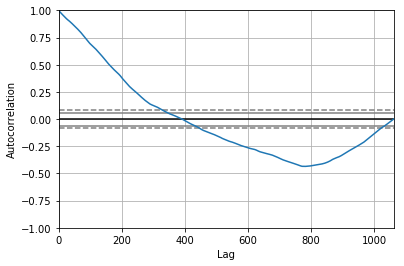

<Figure size 800x560 with 0 Axes>

Test MSE: 14.778


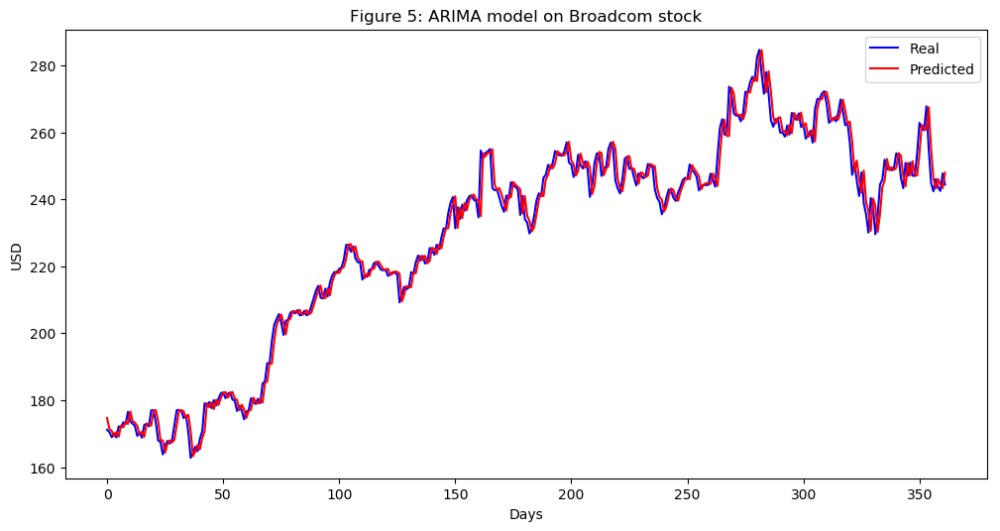

In [341]:
Broadcom_series = SP500_TechIndicator['Broadcom_Close']
Broadcom_series_model = ARIMA(Broadcom_series, order=(5, 1, 0))
Broadcom_model_fit = Broadcom_series_model.fit(disp=0)
print(Broadcom_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Broadcom_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Broadcom_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Broadcom_predictions = list()
for t in range(len(test)):
    Broadcom_series_model = ARIMA(history, order=(5,1,0))
    Broadcom_series_model_fit = Broadcom_series_model.fit(disp=0)
    Broadcom_output = Broadcom_series_model_fit.forecast()
    yhat = Broadcom_output[0]
    Broadcom_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Broadcom_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Broadcom_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Broadcom stock')
plt.legend()
plt.show()


#predictions
Broadcom_predictions = pd.DataFrame({'Broadcom_predictions':Broadcom_predictions})
#Broadcom_predictions.to_csv('Broadcom_predictions.csv')



                                       ARIMA Model Results                                        
Dep. Variable:     D.Broadridge_Financial_Solutions_Close   No. Observations:                 1061
Model:                                     ARIMA(5, 1, 0)   Log Likelihood               -1090.627
Method:                                           css-mle   S.D. of innovations              0.676
Date:                                    Sun, 17 Mar 2019   AIC                           2195.254
Time:                                            22:12:24   BIC                           2230.023
Sample:                                                 1   HQIC                          2208.431
                                                                                                  
                                                   coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


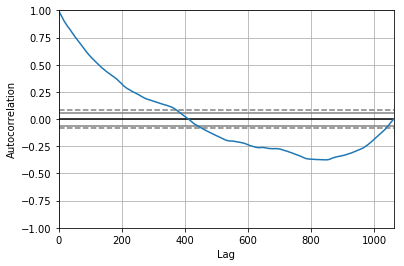

<Figure size 800x560 with 0 Axes>

Test MSE: 0.659


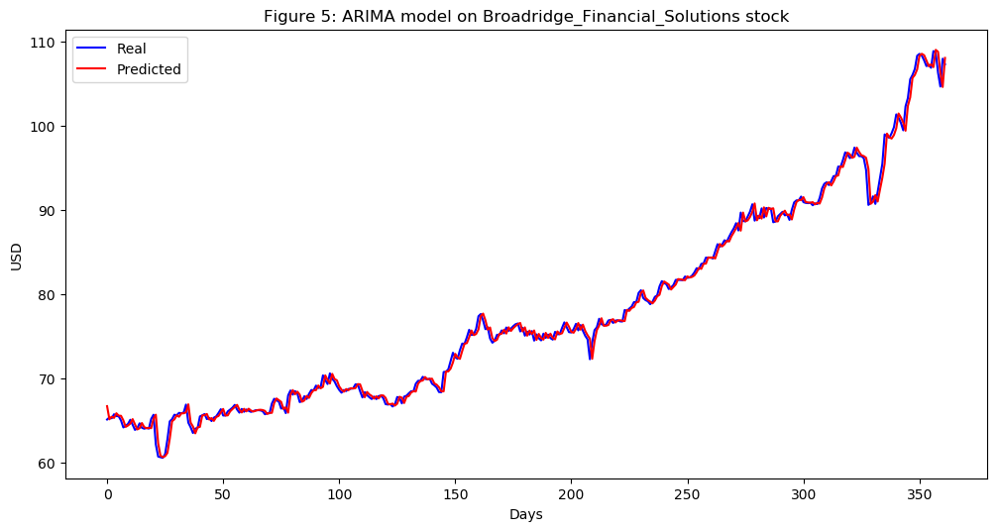

In [342]:
Broadridge_Financial_Solutions_series = SP500_TechIndicator['Broadridge_Financial_Solutions_Close']
Broadridge_Financial_Solutions_series_model = ARIMA(Broadridge_Financial_Solutions_series, order=(5, 1, 0))
Broadridge_Financial_Solutions_model_fit = Broadridge_Financial_Solutions_series_model.fit(disp=0)
print(Broadridge_Financial_Solutions_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Broadridge_Financial_Solutions_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Broadridge_Financial_Solutions_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Broadridge_Financial_Solutions_predictions = list()
for t in range(len(test)):
    Broadridge_Financial_Solutions_series_model = ARIMA(history, order=(5,1,0))
    Broadridge_Financial_Solutions_series_model_fit = Broadridge_Financial_Solutions_series_model.fit(disp=0)
    Broadridge_Financial_Solutions_output = Broadridge_Financial_Solutions_series_model_fit.forecast()
    yhat = Broadridge_Financial_Solutions_output[0]
    Broadridge_Financial_Solutions_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Broadridge_Financial_Solutions_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Broadridge_Financial_Solutions_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Broadridge_Financial_Solutions stock')
plt.legend()
plt.show()


#predictions
Broadridge_Financial_Solutions_predictions = pd.DataFrame({'Broadridge_Financial_Solutions_predictions':Broadridge_Financial_Solutions_predictions})
#Broadridge_Financial_Solutions_predictions.to_csv('Broadridge_Financial_Solutions_predictions.csv')



                                   ARIMA Model Results                                    
Dep. Variable:     D.Cadence_Design_Systems_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood                -441.157
Method:                                   css-mle   S.D. of innovations              0.367
Date:                            Sun, 17 Mar 2019   AIC                            896.313
Time:                                    22:13:33   BIC                            931.082
Sample:                                         1   HQIC                           909.490
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0210      0.012    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


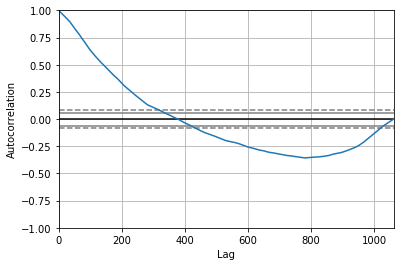

<Figure size 800x560 with 0 Axes>

Test MSE: 0.251


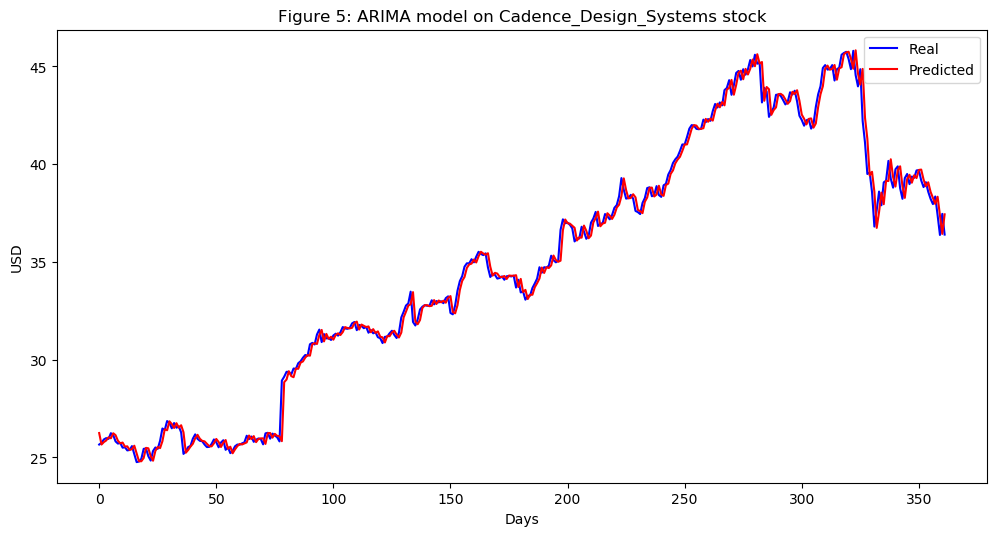

In [343]:
Cadence_Design_Systems_series = SP500_TechIndicator['Cadence_Design_Systems_Close']
Cadence_Design_Systems_series_model = ARIMA(Cadence_Design_Systems_series, order=(5, 1, 0))
Cadence_Design_Systems_model_fit = Cadence_Design_Systems_series_model.fit(disp=0)
print(Cadence_Design_Systems_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Cadence_Design_Systems_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Cadence_Design_Systems_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Cadence_Design_Systems_predictions = list()
for t in range(len(test)):
    Cadence_Design_Systems_series_model = ARIMA(history, order=(5,1,0))
    Cadence_Design_Systems_series_model_fit = Cadence_Design_Systems_series_model.fit(disp=0)
    Cadence_Design_Systems_output = Cadence_Design_Systems_series_model_fit.forecast()
    yhat = Cadence_Design_Systems_output[0]
    Cadence_Design_Systems_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Cadence_Design_Systems_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Cadence_Design_Systems_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Cadence_Design_Systems stock')
plt.legend()
plt.show()


#predictions
Cadence_Design_Systems_predictions = pd.DataFrame({'Cadence_Design_Systems_predictions':Cadence_Design_Systems_predictions})
#Cadence_Design_Systems_predictions.to_csv('Cadence_Design_Systems_predictions.csv')



                               ARIMA Model Results                               
Dep. Variable:     D.Cisco_Systems_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood                -472.493
Method:                          css-mle   S.D. of innovations              0.378
Date:                   Sun, 17 Mar 2019   AIC                            958.985
Time:                           22:14:29   BIC                            993.754
Sample:                                1   HQIC                           972.162
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0190      0.012      1.596      0.111      -0.004       0.042
ar.L1.D.Cisco_Systems_Close     0.0095      0.031      0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


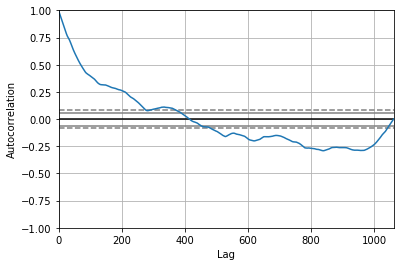

<Figure size 800x560 with 0 Axes>

Test MSE: 0.194


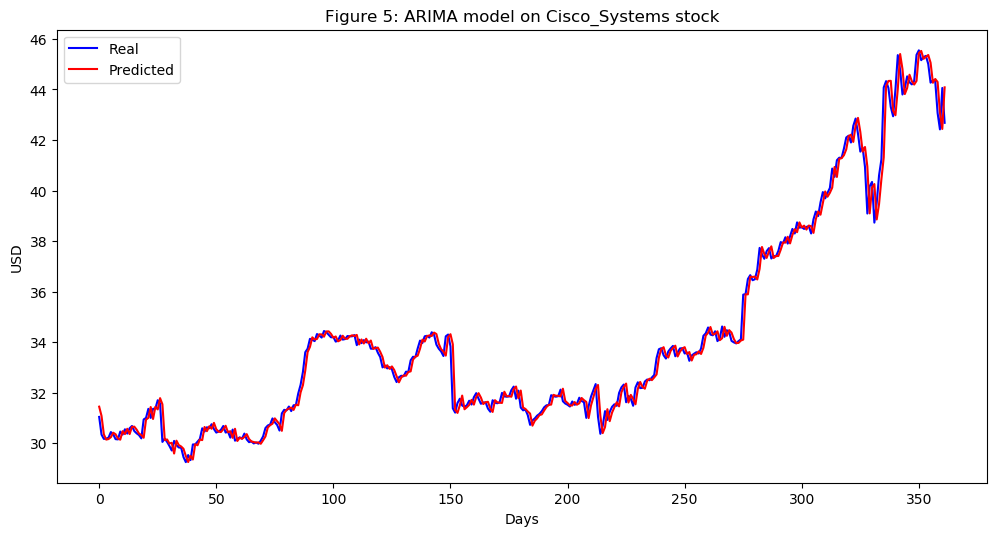

In [344]:
Cisco_Systems_series = SP500_TechIndicator['Cisco_Systems_Close']
Cisco_Systems_series_model = ARIMA(Cisco_Systems_series, order=(5, 1, 0))
Cisco_Systems_model_fit = Cisco_Systems_series_model.fit(disp=0)
print(Cisco_Systems_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Cisco_Systems_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Cisco_Systems_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Cisco_Systems_predictions = list()
for t in range(len(test)):
    Cisco_Systems_series_model = ARIMA(history, order=(5,1,0))
    Cisco_Systems_series_model_fit = Cisco_Systems_series_model.fit(disp=0)
    Cisco_Systems_output = Cisco_Systems_series_model_fit.forecast()
    yhat = Cisco_Systems_output[0]
    Cisco_Systems_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Cisco_Systems_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Cisco_Systems_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Cisco_Systems stock')
plt.legend()
plt.show()


#predictions
Cisco_Systems_predictions = pd.DataFrame({'Cisco_Systems_predictions':Cisco_Systems_predictions})
#Cisco_Systems_predictions.to_csv('Cisco_Systems_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.Citrix_Systems_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1810.959
Method:                           css-mle   S.D. of innovations              1.334
Date:                    Sun, 17 Mar 2019   AIC                           3635.918
Time:                            22:15:44   BIC                           3670.686
Sample:                                 1   HQIC                          3649.094
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0275      0.036      0.764      0.445      -0.043       0.098
ar.L1.D.Citrix_Systems_Close    -0.1118      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


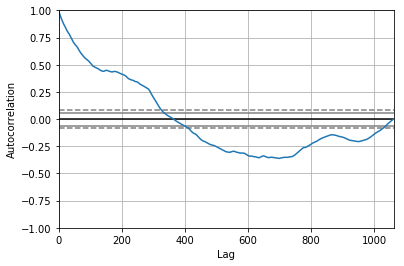

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 2.323


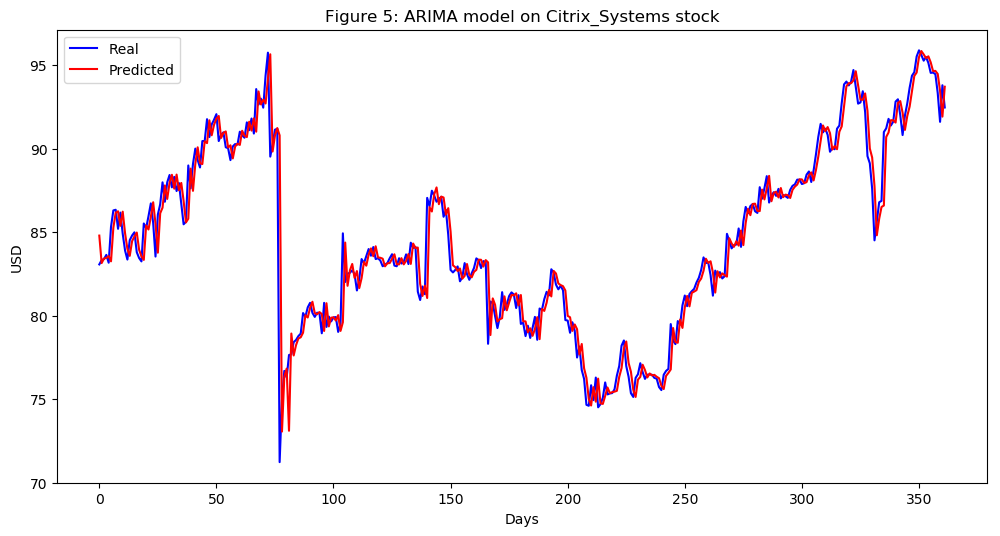

In [345]:
Citrix_Systems_series = SP500_TechIndicator['Citrix_Systems_Close']
Citrix_Systems_series_model = ARIMA(Citrix_Systems_series, order=(5, 1, 0))
Citrix_Systems_model_fit = Citrix_Systems_series_model.fit(disp=0)
print(Citrix_Systems_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Citrix_Systems_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Citrix_Systems_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Citrix_Systems_predictions = list()
for t in range(len(test)):
    Citrix_Systems_series_model = ARIMA(history, order=(5,1,0))
    Citrix_Systems_series_model_fit = Citrix_Systems_series_model.fit(disp=0)
    Citrix_Systems_output = Citrix_Systems_series_model_fit.forecast()
    yhat = Citrix_Systems_output[0]
    Citrix_Systems_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Citrix_Systems_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Citrix_Systems_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Citrix_Systems stock')
plt.legend()
plt.show()


#predictions
Citrix_Systems_predictions = pd.DataFrame({'Citrix_Systems_predictions':Citrix_Systems_predictions})
#Citrix_Systems_predictions.to_csv('Citrix_Systems_predictions.csv')



                                       ARIMA Model Results                                        
Dep. Variable:     D.Cognizant_Technology_Solutions_Close   No. Observations:                 1061
Model:                                     ARIMA(5, 1, 0)   Log Likelihood               -2198.139
Method:                                           css-mle   S.D. of innovations              1.921
Date:                                    Sun, 17 Mar 2019   AIC                           4410.278
Time:                                            22:16:34   BIC                           4445.047
Sample:                                                 1   HQIC                          4423.455
                                                                                                  
                                                   coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


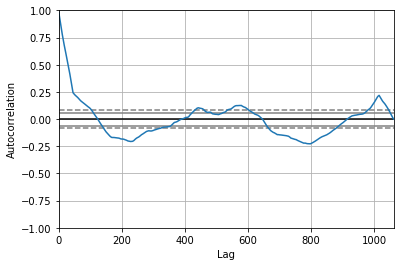

<Figure size 800x560 with 0 Axes>

Test MSE: 0.609


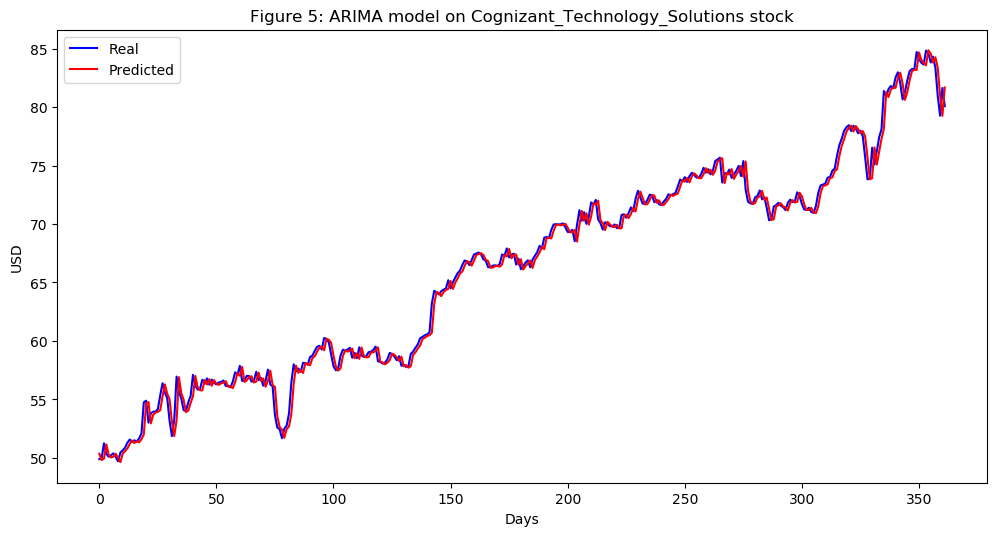

In [346]:
Cognizant_Technology_Solutions_series = SP500_TechIndicator['Cognizant_Technology_Solutions_Close']
Cognizant_Technology_Solutions_series_model = ARIMA(Cognizant_Technology_Solutions_series, order=(5, 1, 0))
Cognizant_Technology_Solutions_model_fit = Cognizant_Technology_Solutions_series_model.fit(disp=0)
print(Cognizant_Technology_Solutions_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Cognizant_Technology_Solutions_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Cognizant_Technology_Solutions_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Cognizant_Technology_Solutions_predictions = list()
for t in range(len(test)):
    Cognizant_Technology_Solutions_series_model = ARIMA(history, order=(5,1,0))
    Cognizant_Technology_Solutions_series_model_fit = Cognizant_Technology_Solutions_series_model.fit(disp=0)
    Cognizant_Technology_Solutions_output = Cognizant_Technology_Solutions_series_model_fit.forecast()
    yhat = Cognizant_Technology_Solutions_output[0]
    Cognizant_Technology_Solutions_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Cognizant_Technology_Solutions_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Cognizant_Technology_Solutions_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Cognizant_Technology_Solutions stock')
plt.legend()
plt.show()


#predictions
Cognizant_Technology_Solutions_predictions = pd.DataFrame({'Cognizant_Technology_Solutions_predictions':Cognizant_Technology_Solutions_predictions})
#Cognizant_Technology_Solutions_predictions.to_csv('Cognizant_Technology_Solutions_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Corning_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -299.387
Method:                       css-mle   S.D. of innovations              0.321
Date:                Sun, 17 Mar 2019   AIC                            612.773
Time:                        22:17:16   BIC                            647.542
Sample:                             1   HQIC                           625.950
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0093      0.010      0.895      0.371      -0.011       0.030
ar.L1.D.Corning_Close     0.0073      0.031      0.238      0.812      -0.053       0.067
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


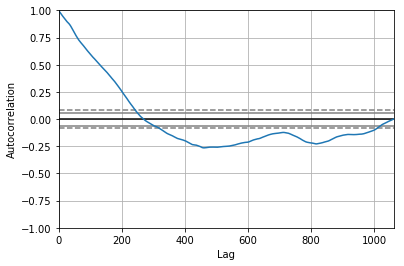

<Figure size 800x560 with 0 Axes>

Test MSE: 0.136


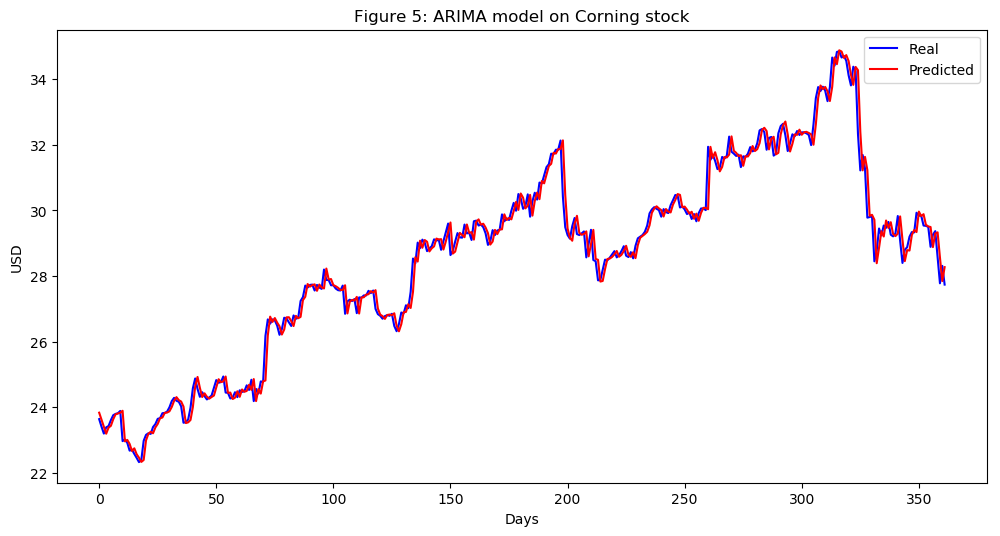

In [347]:
Corning_series = SP500_TechIndicator['Corning_Close']
Corning_series_model = ARIMA(Corning_series, order=(5, 1, 0))
Corning_model_fit = Corning_series_model.fit(disp=0)
print(Corning_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Corning_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Corning_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Corning_predictions = list()
for t in range(len(test)):
    Corning_series_model = ARIMA(history, order=(5,1,0))
    Corning_series_model_fit = Corning_series_model.fit(disp=0)
    Corning_output = Corning_series_model_fit.forecast()
    yhat = Corning_output[0]
    Corning_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Corning_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Corning_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Corning stock')
plt.legend()
plt.show()


#predictions
Corning_predictions = pd.DataFrame({'Corning_predictions':Corning_predictions})
#Corning_predictions.to_csv('Corning_predictions.csv')



                              ARIMA Model Results                              
Dep. Variable:     D.F5_Networks_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -2222.733
Method:                        css-mle   S.D. of innovations              1.966
Date:                 Sun, 17 Mar 2019   AIC                           4459.465
Time:                         22:18:31   BIC                           4494.234
Sample:                              1   HQIC                          4472.642
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0514      0.054      0.953      0.341      -0.054       0.157
ar.L1.D.F5_Networks_Close    -0.0653      0.031     -2.126      0.034      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


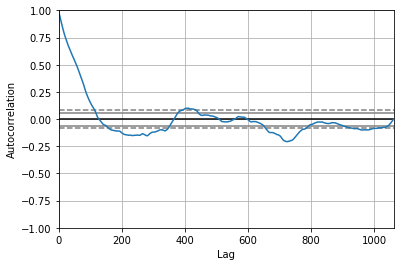

<Figure size 800x560 with 0 Axes>

Test MSE: 4.017


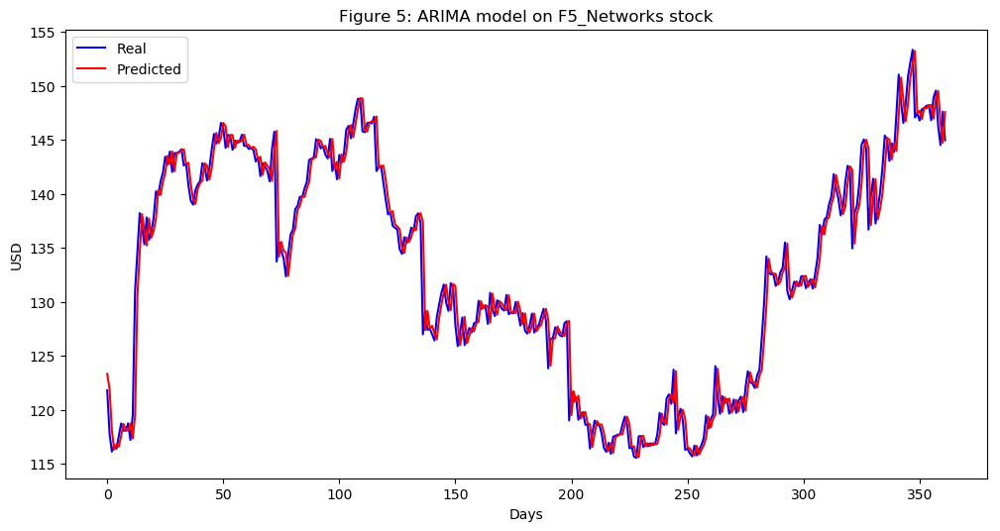

In [348]:
F5_Networks_series = SP500_TechIndicator['F5_Networks_Close']
F5_Networks_series_model = ARIMA(F5_Networks_series, order=(5, 1, 0))
F5_Networks_model_fit = F5_Networks_series_model.fit(disp=0)
print(F5_Networks_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(F5_Networks_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = F5_Networks_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
F5_Networks_predictions = list()
for t in range(len(test)):
    F5_Networks_series_model = ARIMA(history, order=(5,1,0))
    F5_Networks_series_model_fit = F5_Networks_series_model.fit(disp=0)
    F5_Networks_output = F5_Networks_series_model_fit.forecast()
    yhat = F5_Networks_output[0]
    F5_Networks_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, F5_Networks_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(F5_Networks_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on F5_Networks stock')
plt.legend()
plt.show()


#predictions
F5_Networks_predictions = pd.DataFrame({'F5_Networks_predictions':F5_Networks_predictions})
#F5_Networks_predictions.to_csv('F5_Networks_predictions.csv')



                                           ARIMA Model Results                                            
Dep. Variable:     D.Fidelity_National_Information_Services_Close   No. Observations:                 1061
Model:                                             ARIMA(5, 1, 0)   Log Likelihood               -1340.601
Method:                                                   css-mle   S.D. of innovations              0.856
Date:                                            Sun, 17 Mar 2019   AIC                           2695.202
Time:                                                    22:19:11   BIC                           2729.971
Sample:                                                         1   HQIC                          2708.379
                                                                                                          
                                                           coef    std err          z      P>|z|      [0.025      0.975]
-----------------------

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


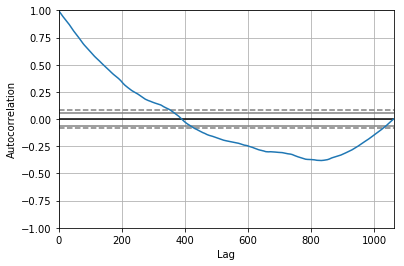

<Figure size 800x560 with 0 Axes>

Test MSE: 0.700


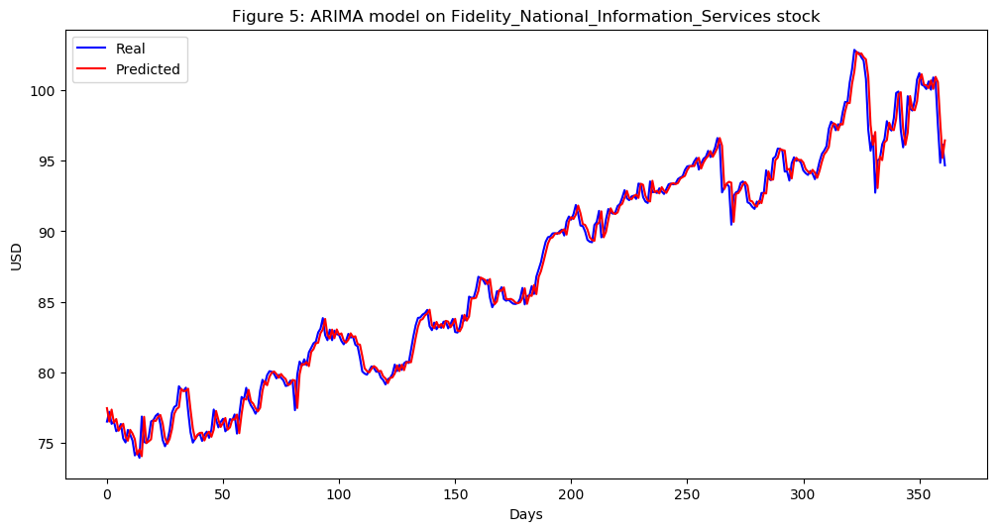

In [349]:
Fidelity_National_Information_Services_series = SP500_TechIndicator['Fidelity_National_Information_Services_Close']
Fidelity_National_Information_Services_series_model = ARIMA(Fidelity_National_Information_Services_series, order=(5, 1, 0))
Fidelity_National_Information_Services_model_fit = Fidelity_National_Information_Services_series_model.fit(disp=0)
print(Fidelity_National_Information_Services_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Fidelity_National_Information_Services_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Fidelity_National_Information_Services_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Fidelity_National_Information_Services_predictions = list()
for t in range(len(test)):
    Fidelity_National_Information_Services_series_model = ARIMA(history, order=(5,1,0))
    Fidelity_National_Information_Services_series_model_fit = Fidelity_National_Information_Services_series_model.fit(disp=0)
    Fidelity_National_Information_Services_output = Fidelity_National_Information_Services_series_model_fit.forecast()
    yhat = Fidelity_National_Information_Services_output[0]
    Fidelity_National_Information_Services_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Fidelity_National_Information_Services_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Fidelity_National_Information_Services_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Fidelity_National_Information_Services stock')
plt.legend()
plt.show()


#predictions
Fidelity_National_Information_Services_predictions = pd.DataFrame({'Fidelity_National_Information_Services_predictions':Fidelity_National_Information_Services_predictions})
#Fidelity_National_Information_Services_predictions.to_csv('Fidelity_National_Information_Services_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Fiserv_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2467.336
Method:                       css-mle   S.D. of innovations              2.476
Date:                Sun, 17 Mar 2019   AIC                           4948.672
Time:                        22:20:10   BIC                           4983.440
Sample:                             1   HQIC                          4961.848
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0105      0.079      0.134      0.894      -0.144       0.165
ar.L1.D.Fiserv_Close     0.0183      0.031      0.597      0.551      -0.042       0.078
ar.L2.D.Fise

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


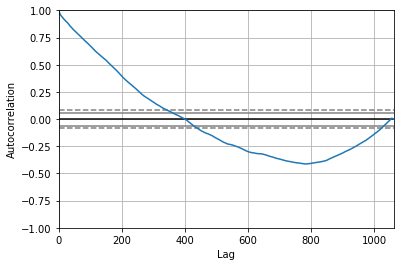

<Figure size 800x560 with 0 Axes>

Test MSE: 16.597


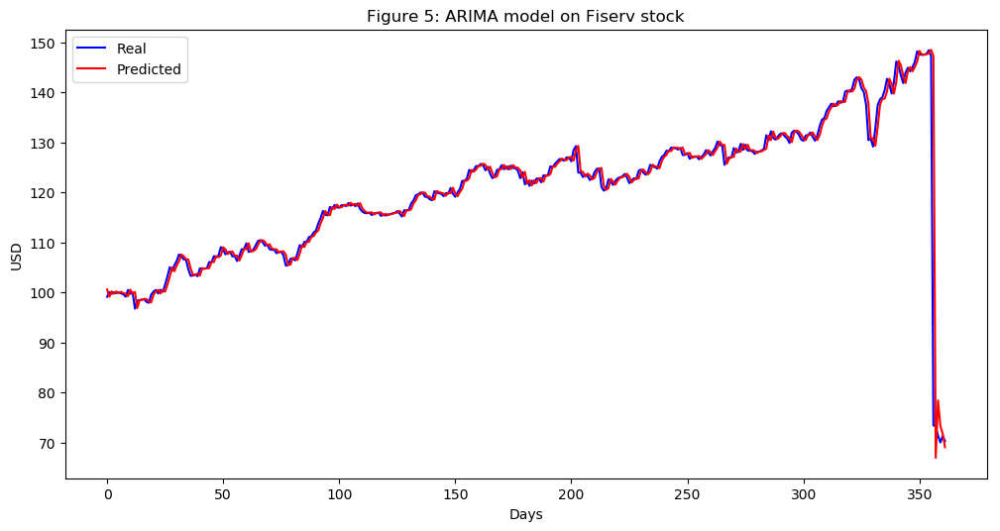

In [350]:
Fiserv_series = SP500_TechIndicator['Fiserv_Close']
Fiserv_series_model = ARIMA(Fiserv_series, order=(5, 1, 0))
Fiserv_model_fit = Fiserv_series_model.fit(disp=0)
print(Fiserv_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Fiserv_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Fiserv_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Fiserv_predictions = list()
for t in range(len(test)):
    Fiserv_series_model = ARIMA(history, order=(5,1,0))
    Fiserv_series_model_fit = Fiserv_series_model.fit(disp=0)
    Fiserv_output = Fiserv_series_model_fit.forecast()
    yhat = Fiserv_output[0]
    Fiserv_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Fiserv_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Fiserv_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Fiserv stock')
plt.legend()
plt.show()


#predictions
Fiserv_predictions = pd.DataFrame({'Fiserv_predictions':Fiserv_predictions})
#Fiserv_predictions.to_csv('Fiserv_predictions.csv')



                                   ARIMA Model Results                                   
Dep. Variable:     D.FleetCor_Technologies_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood               -2483.874
Method:                                  css-mle   S.D. of innovations              2.515
Date:                           Sun, 17 Mar 2019   AIC                           4981.748
Time:                                   22:20:57   BIC                           5016.517
Sample:                                        1   HQIC                          4994.925
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                   0.0769      0.075      1.019    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


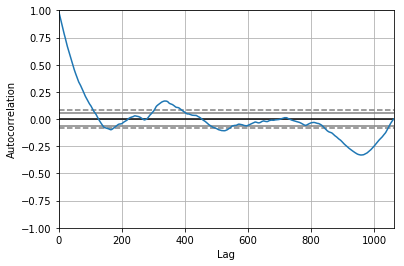

<Figure size 800x560 with 0 Axes>

Test MSE: 8.138


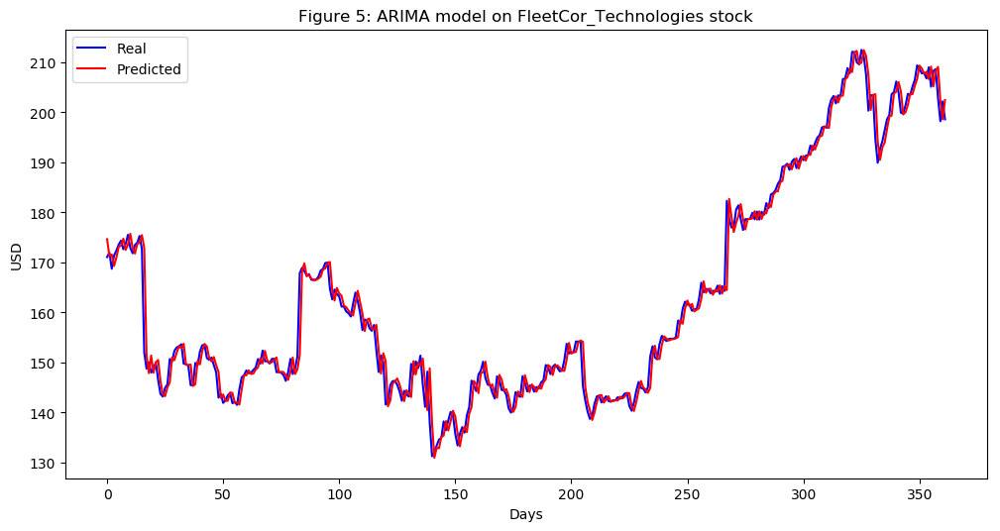

In [351]:
FleetCor_Technologies_series = SP500_TechIndicator['FleetCor_Technologies_Close']
FleetCor_Technologies_series_model = ARIMA(FleetCor_Technologies_series, order=(5, 1, 0))
FleetCor_Technologies_model_fit = FleetCor_Technologies_series_model.fit(disp=0)
print(FleetCor_Technologies_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(FleetCor_Technologies_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = FleetCor_Technologies_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
FleetCor_Technologies_predictions = list()
for t in range(len(test)):
    FleetCor_Technologies_series_model = ARIMA(history, order=(5,1,0))
    FleetCor_Technologies_series_model_fit = FleetCor_Technologies_series_model.fit(disp=0)
    FleetCor_Technologies_output = FleetCor_Technologies_series_model_fit.forecast()
    yhat = FleetCor_Technologies_output[0]
    FleetCor_Technologies_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, FleetCor_Technologies_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(FleetCor_Technologies_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on FleetCor_Technologies stock')
plt.legend()
plt.show()


#predictions
FleetCor_Technologies_predictions = pd.DataFrame({'FleetCor_Technologies_predictions':FleetCor_Technologies_predictions})
#FleetCor_Technologies_predictions.to_csv('FleetCor_Technologies_predictions.csv')



                              ARIMA Model Results                               
Dep. Variable:     D.FLIR_Systems_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood                -755.379
Method:                         css-mle   S.D. of innovations              0.493
Date:                  Sun, 17 Mar 2019   AIC                           1524.758
Time:                          22:21:44   BIC                           1559.527
Sample:                               1   HQIC                          1537.935
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                          0.0186      0.015      1.230      0.219      -0.011       0.048
ar.L1.D.FLIR_Systems_Close     0.0322      0.031      1.045      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


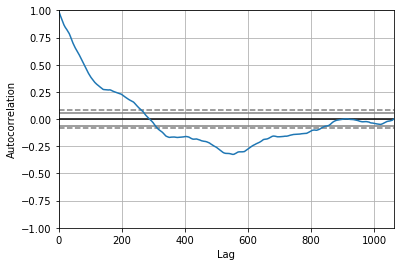

<Figure size 800x560 with 0 Axes>

Test MSE: 0.295


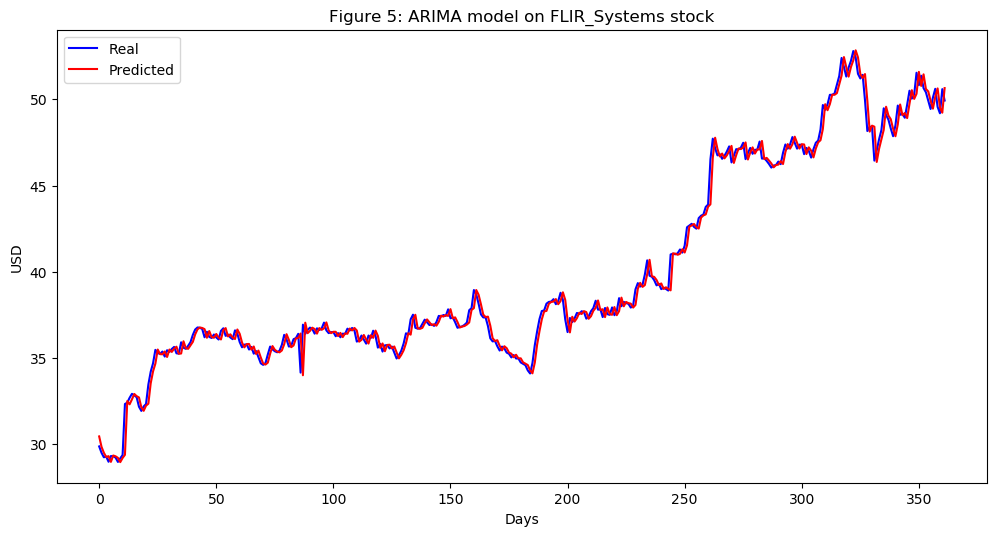

In [352]:
FLIR_Systems_series = SP500_TechIndicator['FLIR_Systems_Close']
FLIR_Systems_series_model = ARIMA(FLIR_Systems_series, order=(5, 1, 0))
FLIR_Systems_model_fit = FLIR_Systems_series_model.fit(disp=0)
print(FLIR_Systems_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(FLIR_Systems_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = FLIR_Systems_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
FLIR_Systems_predictions = list()
for t in range(len(test)):
    FLIR_Systems_series_model = ARIMA(history, order=(5,1,0))
    FLIR_Systems_series_model_fit = FLIR_Systems_series_model.fit(disp=0)
    FLIR_Systems_output = FLIR_Systems_series_model_fit.forecast()
    yhat = FLIR_Systems_output[0]
    FLIR_Systems_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, FLIR_Systems_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(FLIR_Systems_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on FLIR_Systems stock')
plt.legend()
plt.show()


#predictions
FLIR_Systems_predictions = pd.DataFrame({'FLIR_Systems_predictions':FLIR_Systems_predictions})
#FLIR_Systems_predictions.to_csv('FLIR_Systems_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Fortinet_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1113.747
Method:                       css-mle   S.D. of innovations              0.691
Date:                Sun, 17 Mar 2019   AIC                           2241.493
Time:                        22:22:46   BIC                           2276.262
Sample:                             1   HQIC                          2254.670
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0323      0.020      1.621      0.105      -0.007       0.071
ar.L1.D.Fortinet_Close    -0.0282      0.031     -0.920      0.358      -0.088       0.032
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


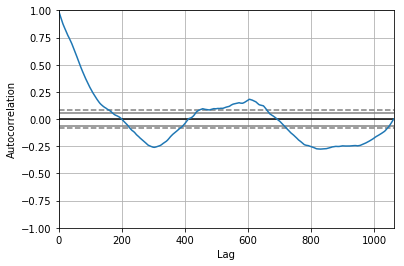

<Figure size 800x560 with 0 Axes>

Test MSE: 0.426


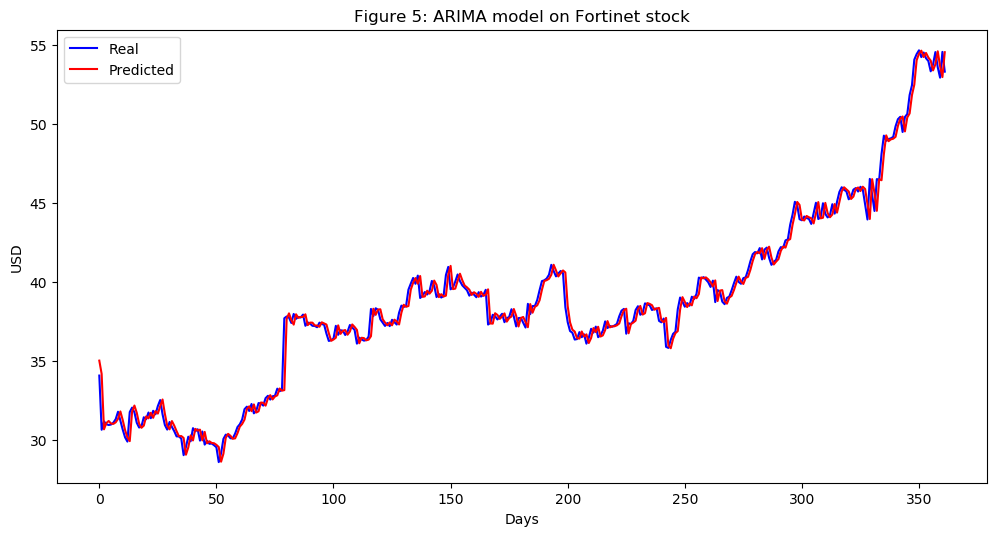

In [353]:
Fortinet_series = SP500_TechIndicator['Fortinet_Close']
Fortinet_series_model = ARIMA(Fortinet_series, order=(5, 1, 0))
Fortinet_model_fit = Fortinet_series_model.fit(disp=0)
print(Fortinet_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Fortinet_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Fortinet_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Fortinet_predictions = list()
for t in range(len(test)):
    Fortinet_series_model = ARIMA(history, order=(5,1,0))
    Fortinet_series_model_fit = Fortinet_series_model.fit(disp=0)
    Fortinet_output = Fortinet_series_model_fit.forecast()
    yhat = Fortinet_output[0]
    Fortinet_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Fortinet_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Fortinet_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Fortinet stock')
plt.legend()
plt.show()


#predictions
Fortinet_predictions = pd.DataFrame({'Fortinet_predictions':Fortinet_predictions})
#Fortinet_predictions.to_csv('Fortinet_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.Global_Payments_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -2474.208
Method:                            css-mle   S.D. of innovations              2.492
Date:                     Sun, 17 Mar 2019   AIC                           4962.416
Time:                             22:23:55   BIC                           4997.185
Sample:                                  1   HQIC                          4975.593
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0437      0.071      0.613      0.540      -0.096       0.183
ar.L1.D.Global_Payments_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


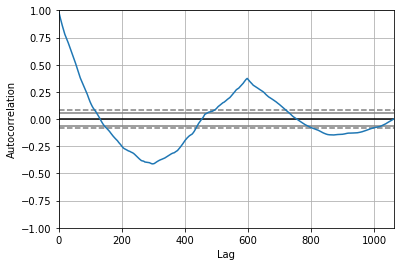

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 1.627


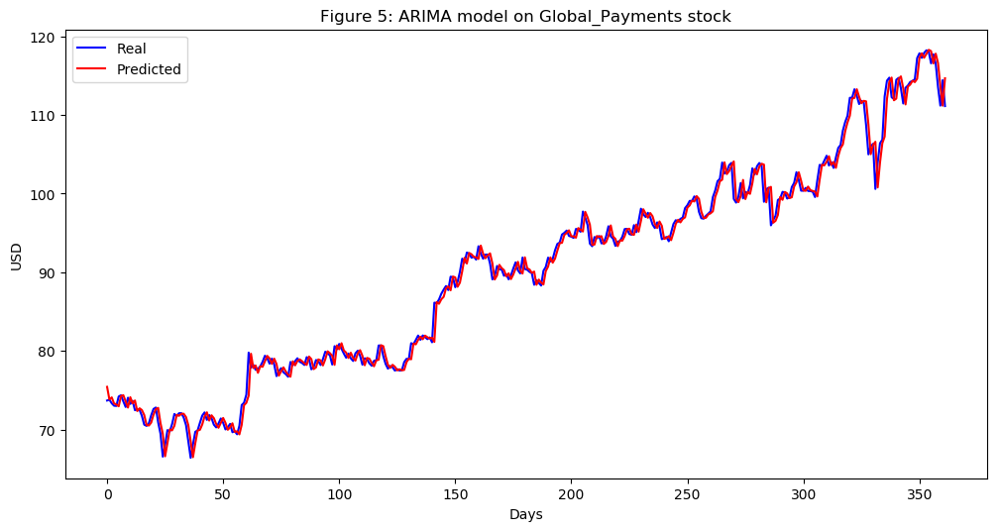

In [354]:
Global_Payments_series = SP500_TechIndicator['Global_Payments_Close']
Global_Payments_series_model = ARIMA(Global_Payments_series, order=(5, 1, 0))
Global_Payments_model_fit = Global_Payments_series_model.fit(disp=0)
print(Global_Payments_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Global_Payments_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Global_Payments_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Global_Payments_predictions = list()
for t in range(len(test)):
    Global_Payments_series_model = ARIMA(history, order=(5,1,0))
    Global_Payments_series_model_fit = Global_Payments_series_model.fit(disp=0)
    Global_Payments_output = Global_Payments_series_model_fit.forecast()
    yhat = Global_Payments_output[0]
    Global_Payments_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Global_Payments_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Global_Payments_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Global_Payments stock')
plt.legend()
plt.show()


#predictions
Global_Payments_predictions = pd.DataFrame({'Global_Payments_predictions':Global_Payments_predictions})
#Global_Payments_predictions.to_csv('Global_Payments_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:             D.HP_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -923.446
Method:                       css-mle   S.D. of innovations              0.578
Date:                Sun, 17 Mar 2019   AIC                           1860.893
Time:                        22:24:42   BIC                           1895.661
Sample:                             1   HQIC                          1874.069
                                                                              
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
const               -0.0059      0.019     -0.319      0.750      -0.042       0.031
ar.L1.D.HP_Close    -0.0066      0.031     -0.215      0.830      -0.067       0.054
ar.L2.D.HP_Close     0.0099 

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


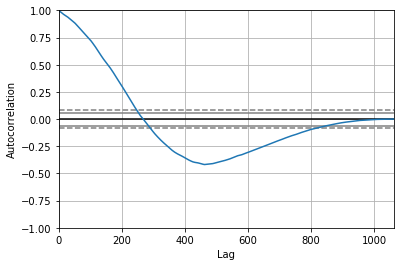

<Figure size 800x560 with 0 Axes>

Test MSE: 0.084


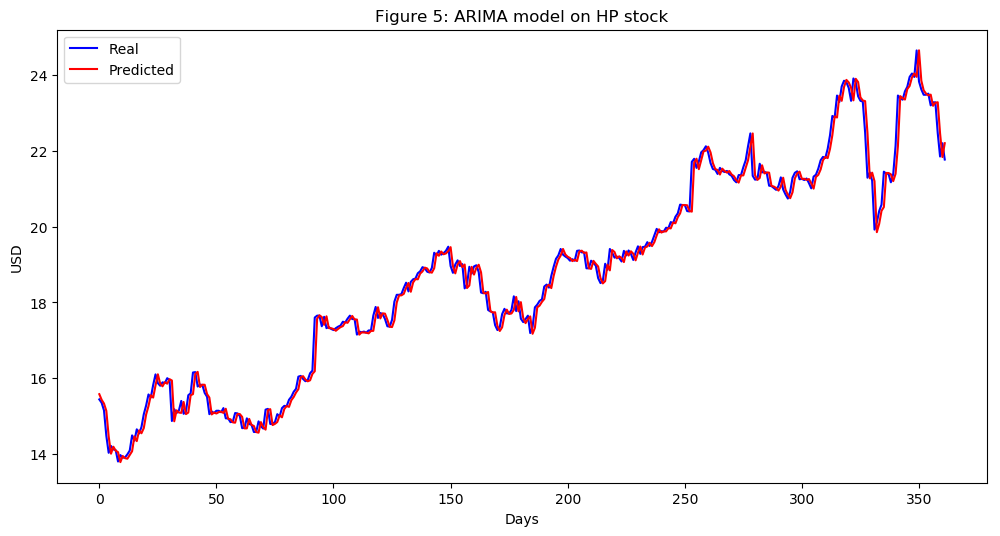

In [355]:
HP_series = SP500_TechIndicator['HP_Close']
HP_series_model = ARIMA(HP_series, order=(5, 1, 0))
HP_model_fit = HP_series_model.fit(disp=0)
print(HP_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(HP_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = HP_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
HP_predictions = list()
for t in range(len(test)):
    HP_series_model = ARIMA(history, order=(5,1,0))
    HP_series_model_fit = HP_series_model.fit(disp=0)
    HP_output = HP_series_model_fit.forecast()
    yhat = HP_output[0]
    HP_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, HP_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(HP_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on HP stock')
plt.legend()
plt.show()


#predictions
HP_predictions = pd.DataFrame({'HP_predictions':HP_predictions})
#HP_predictions.to_csv('HP_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Intel_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -816.676
Method:                       css-mle   S.D. of innovations              0.522
Date:                Sun, 17 Mar 2019   AIC                           1647.353
Time:                        22:25:42   BIC                           1682.121
Sample:                             1   HQIC                          1660.529
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0238      0.017      1.410      0.159      -0.009       0.057
ar.L1.D.Intel_Close    -0.0461      0.031     -1.498      0.134      -0.106       0.014
ar.L2.D.Intel_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


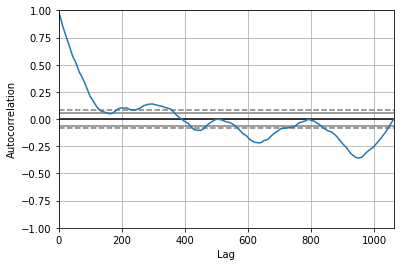

<Figure size 800x560 with 0 Axes>

Test MSE: 0.385


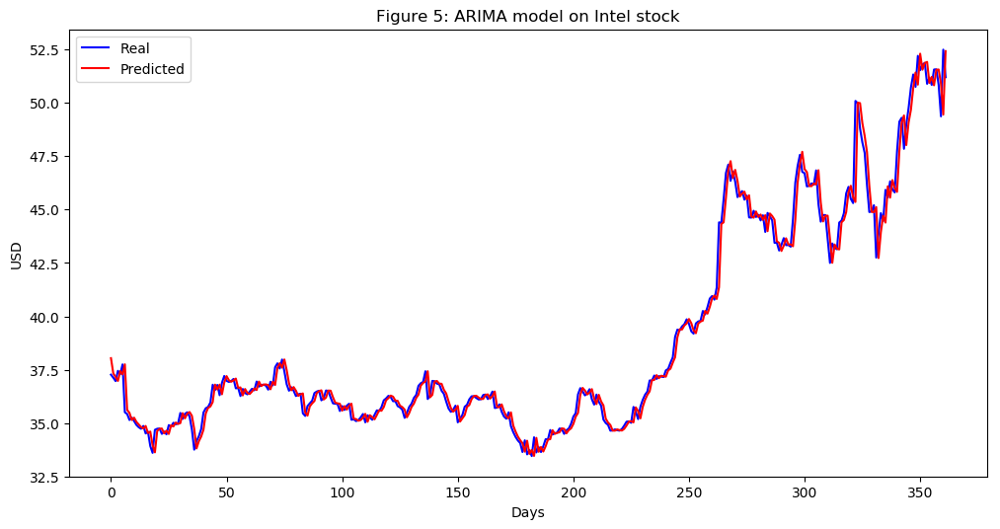

In [356]:
Intel_series = SP500_TechIndicator['Intel_Close']
Intel_series_model = ARIMA(Intel_series, order=(5, 1, 0))
Intel_model_fit = Intel_series_model.fit(disp=0)
print(Intel_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Intel_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Intel_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Intel_predictions = list()
for t in range(len(test)):
    Intel_series_model = ARIMA(history, order=(5,1,0))
    Intel_series_model_fit = Intel_series_model.fit(disp=0)
    Intel_output = Intel_series_model_fit.forecast()
    yhat = Intel_output[0]
    Intel_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Intel_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Intel_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Intel stock')
plt.legend()
plt.show()


#predictions
Intel_predictions = pd.DataFrame({'Intel_predictions':Intel_predictions})
#Intel_predictions.to_csv('Intel_predictions.csv')



                                        ARIMA Model Results                                        
Dep. Variable:     D.International_Business_Machines_Close   No. Observations:                 1061
Model:                                      ARIMA(5, 1, 0)   Log Likelihood               -2187.512
Method:                                            css-mle   S.D. of innovations              1.902
Date:                                     Sun, 17 Mar 2019   AIC                           4389.024
Time:                                             22:26:47   BIC                           4423.793
Sample:                                                  1   HQIC                          4402.200
                                                                                                   
                                                    coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


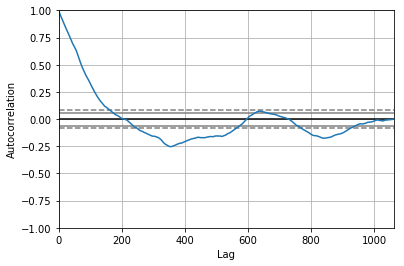

<Figure size 800x560 with 0 Axes>

Test MSE: 3.162


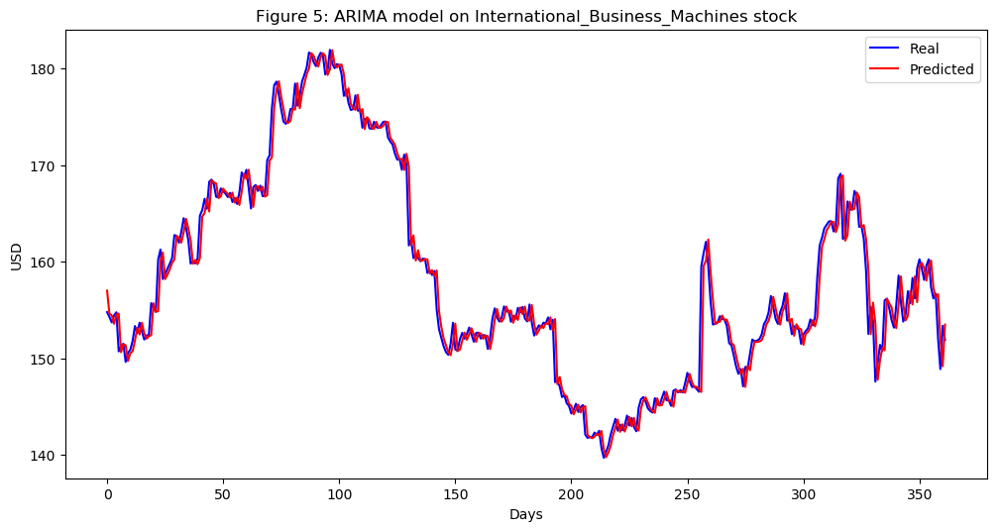

In [357]:
International_Business_Machines_series = SP500_TechIndicator['International_Business_Machines_Close']
International_Business_Machines_series_model = ARIMA(International_Business_Machines_series, order=(5, 1, 0))
International_Business_Machines_model_fit = International_Business_Machines_series_model.fit(disp=0)
print(International_Business_Machines_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(International_Business_Machines_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = International_Business_Machines_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
International_Business_Machines_predictions = list()
for t in range(len(test)):
    International_Business_Machines_series_model = ARIMA(history, order=(5,1,0))
    International_Business_Machines_series_model_fit = International_Business_Machines_series_model.fit(disp=0)
    International_Business_Machines_output = International_Business_Machines_series_model_fit.forecast()
    yhat = International_Business_Machines_output[0]
    International_Business_Machines_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, International_Business_Machines_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(International_Business_Machines_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on International_Business_Machines stock')
plt.legend()
plt.show()


#predictions
International_Business_Machines_predictions = pd.DataFrame({'International_Business_Machines_predictions':International_Business_Machines_predictions})
#International_Business_Machines_predictions.to_csv('International_Business_Machines_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Intuit_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1907.299
Method:                       css-mle   S.D. of innovations              1.460
Date:                Sun, 17 Mar 2019   AIC                           3828.598
Time:                        22:27:30   BIC                           3863.367
Sample:                             1   HQIC                          3841.774
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0913      0.044      2.095      0.036       0.006       0.177
ar.L1.D.Intuit_Close     0.0056      0.031      0.181      0.856      -0.055       0.066
ar.L2.D.Intu

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


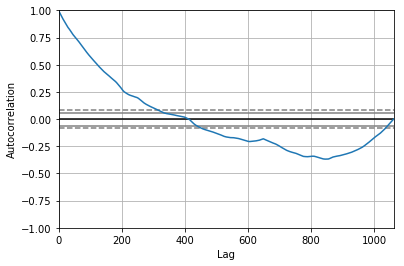

<Figure size 800x560 with 0 Axes>

Test MSE: 2.981


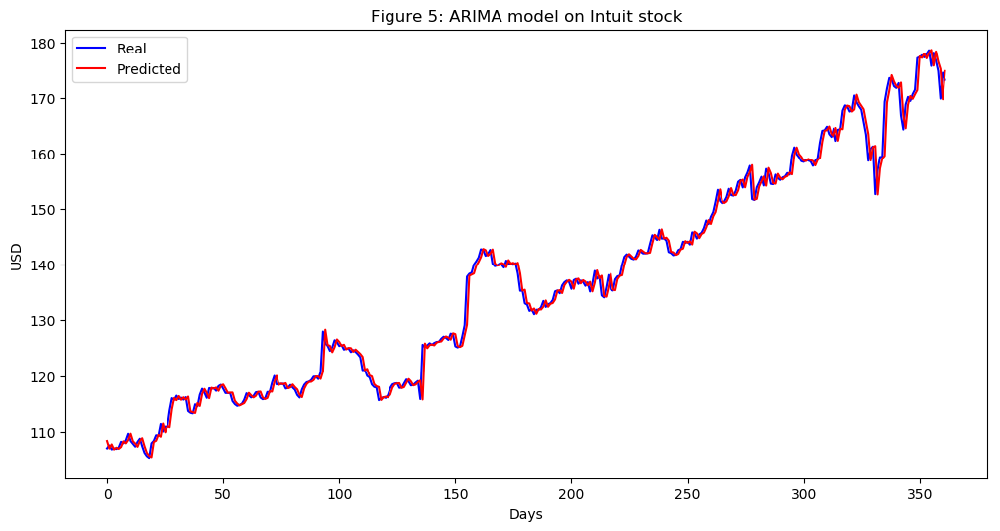

In [358]:
Intuit_series = SP500_TechIndicator['Intuit_Close']
Intuit_series_model = ARIMA(Intuit_series, order=(5, 1, 0))
Intuit_model_fit = Intuit_series_model.fit(disp=0)
print(Intuit_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Intuit_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Intuit_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Intuit_predictions = list()
for t in range(len(test)):
    Intuit_series_model = ARIMA(history, order=(5,1,0))
    Intuit_series_model_fit = Intuit_series_model.fit(disp=0)
    Intuit_output = Intuit_series_model_fit.forecast()
    yhat = Intuit_output[0]
    Intuit_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Intuit_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Intuit_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Intuit stock')
plt.legend()
plt.show()


#predictions
Intuit_predictions = pd.DataFrame({'Intuit_predictions':Intuit_predictions})
#Intuit_predictions.to_csv('Intuit_predictions.csv')



                               ARIMA Model Results                               
Dep. Variable:     D.IPG_Photonics_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -2473.687
Method:                          css-mle   S.D. of innovations              2.491
Date:                   Sun, 17 Mar 2019   AIC                           4961.373
Time:                           22:28:18   BIC                           4996.142
Sample:                                1   HQIC                          4974.550
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.1418      0.082      1.722      0.085      -0.020       0.303
ar.L1.D.IPG_Photonics_Close    -0.0297      0.031     -0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


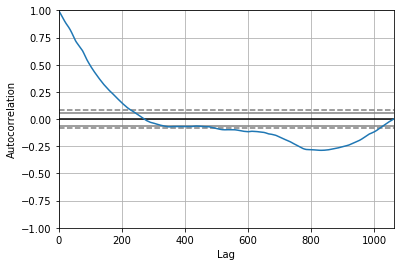

<Figure size 800x560 with 0 Axes>

Test MSE: 13.717


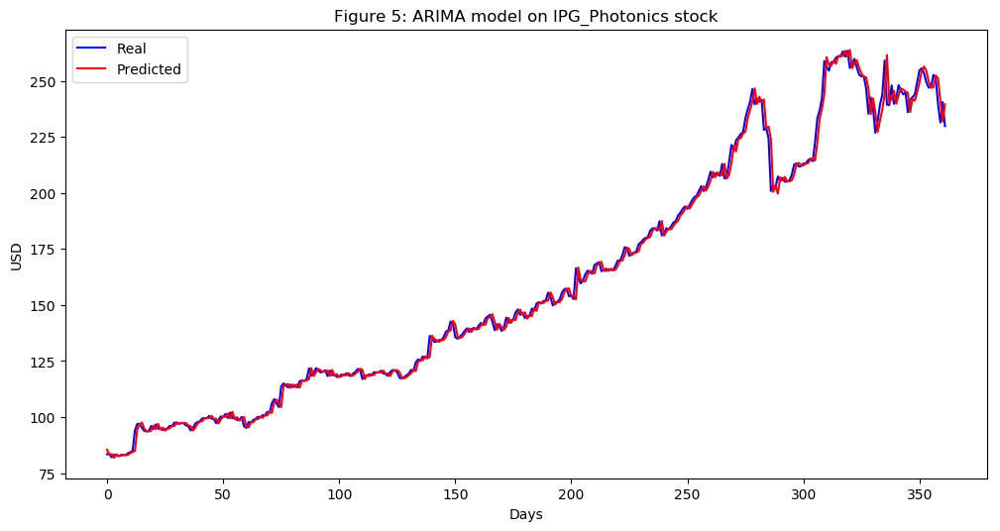

In [359]:
IPG_Photonics_series = SP500_TechIndicator['IPG_Photonics_Close']
IPG_Photonics_series_model = ARIMA(IPG_Photonics_series, order=(5, 1, 0))
IPG_Photonics_model_fit = IPG_Photonics_series_model.fit(disp=0)
print(IPG_Photonics_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(IPG_Photonics_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = IPG_Photonics_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
IPG_Photonics_predictions = list()
for t in range(len(test)):
    IPG_Photonics_series_model = ARIMA(history, order=(5,1,0))
    IPG_Photonics_series_model_fit = IPG_Photonics_series_model.fit(disp=0)
    IPG_Photonics_output = IPG_Photonics_series_model_fit.forecast()
    yhat = IPG_Photonics_output[0]
    IPG_Photonics_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, IPG_Photonics_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(IPG_Photonics_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on IPG_Photonics stock')
plt.legend()
plt.show()


#predictions
IPG_Photonics_predictions = pd.DataFrame({'IPG_Photonics_predictions':IPG_Photonics_predictions})
#IPG_Photonics_predictions.to_csv('IPG_Photonics_predictions.csv')



                                   ARIMA Model Results                                   
Dep. Variable:     D.Jack_Henry_Associates_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood               -1256.303
Method:                                  css-mle   S.D. of innovations              0.791
Date:                           Sun, 17 Mar 2019   AIC                           2526.606
Time:                                   22:29:04   BIC                           2561.375
Sample:                                        1   HQIC                          2539.782
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                   0.0568      0.026      2.211    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


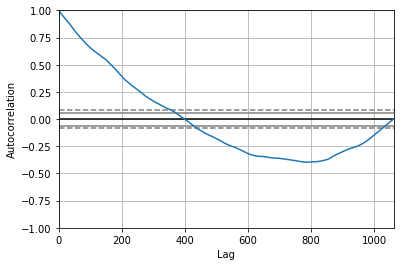

<Figure size 800x560 with 0 Axes>

Test MSE: 0.883


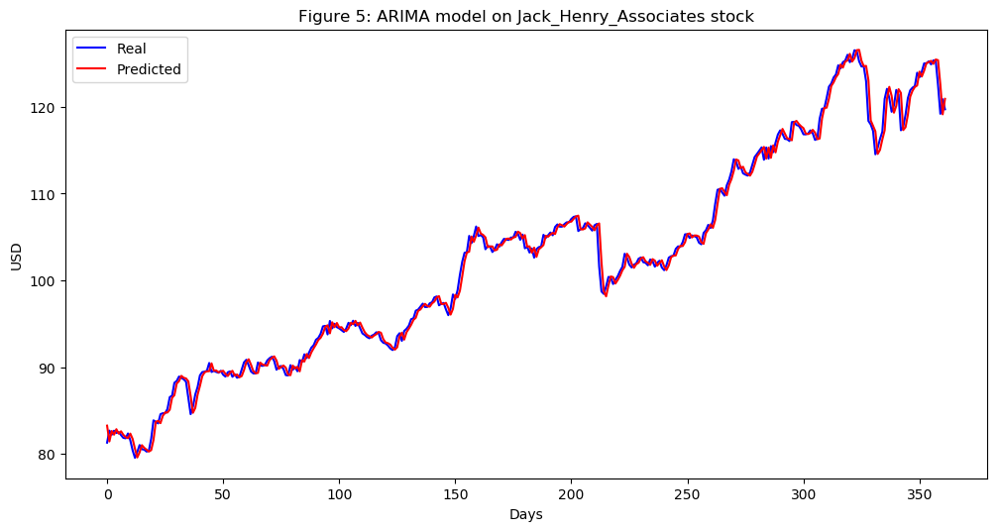

In [360]:
Jack_Henry_Associates_series = SP500_TechIndicator['Jack_Henry_Associates_Close']
Jack_Henry_Associates_series_model = ARIMA(Jack_Henry_Associates_series, order=(5, 1, 0))
Jack_Henry_Associates_model_fit = Jack_Henry_Associates_series_model.fit(disp=0)
print(Jack_Henry_Associates_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Jack_Henry_Associates_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Jack_Henry_Associates_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Jack_Henry_Associates_predictions = list()
for t in range(len(test)):
    Jack_Henry_Associates_series_model = ARIMA(history, order=(5,1,0))
    Jack_Henry_Associates_series_model_fit = Jack_Henry_Associates_series_model.fit(disp=0)
    Jack_Henry_Associates_output = Jack_Henry_Associates_series_model_fit.forecast()
    yhat = Jack_Henry_Associates_output[0]
    Jack_Henry_Associates_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Jack_Henry_Associates_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Jack_Henry_Associates_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Jack_Henry_Associates stock')
plt.legend()
plt.show()


#predictions
Jack_Henry_Associates_predictions = pd.DataFrame({'Jack_Henry_Associates_predictions':Jack_Henry_Associates_predictions})
#Jack_Henry_Associates_predictions.to_csv('Jack_Henry_Associates_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Juniper_Networks_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood                -651.419
Method:                             css-mle   S.D. of innovations              0.447
Date:                      Sun, 17 Mar 2019   AIC                           1316.837
Time:                              22:30:02   BIC                           1351.606
Sample:                                   1   HQIC                          1330.014
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0016      0.012      0.136      0.892      -0.022       0.025
ar.L1.D.Juniper_Network

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


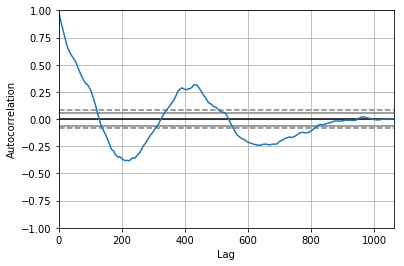

<Figure size 800x560 with 0 Axes>

Test MSE: 0.187


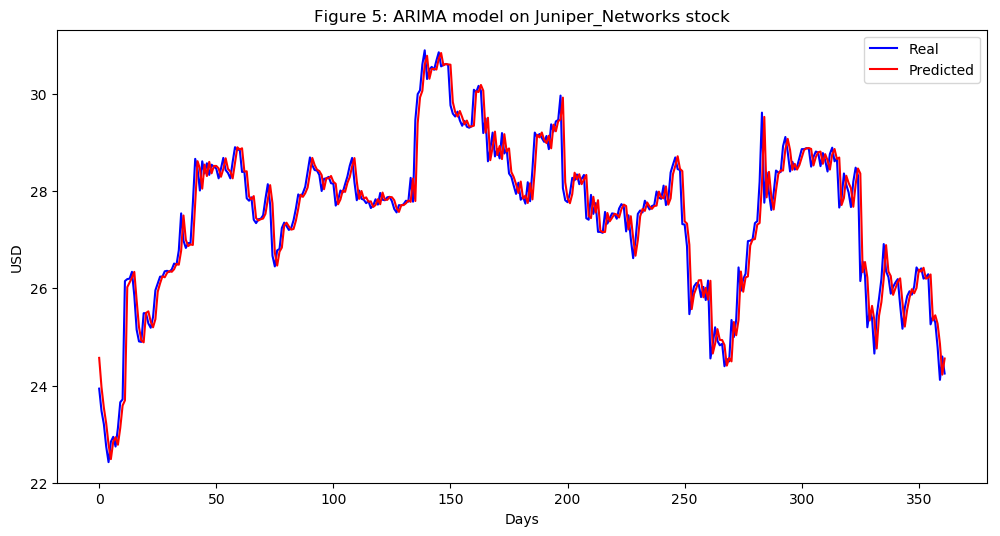

In [361]:
Juniper_Networks_series = SP500_TechIndicator['Juniper_Networks_Close']
Juniper_Networks_series_model = ARIMA(Juniper_Networks_series, order=(5, 1, 0))
Juniper_Networks_model_fit = Juniper_Networks_series_model.fit(disp=0)
print(Juniper_Networks_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Juniper_Networks_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Juniper_Networks_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Juniper_Networks_predictions = list()
for t in range(len(test)):
    Juniper_Networks_series_model = ARIMA(history, order=(5,1,0))
    Juniper_Networks_series_model_fit = Juniper_Networks_series_model.fit(disp=0)
    Juniper_Networks_output = Juniper_Networks_series_model_fit.forecast()
    yhat = Juniper_Networks_output[0]
    Juniper_Networks_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Juniper_Networks_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Juniper_Networks_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Juniper_Networks stock')
plt.legend()
plt.show()


#predictions
Juniper_Networks_predictions = pd.DataFrame({'Juniper_Networks_predictions':Juniper_Networks_predictions})
#Juniper_Networks_predictions.to_csv('Juniper_Networks_predictions.csv')



                                   ARIMA Model Results                                   
Dep. Variable:     D.Keysight_Technologies_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood                -394.896
Method:                                  css-mle   S.D. of innovations              0.351
Date:                           Sun, 17 Mar 2019   AIC                            803.792
Time:                                   22:31:17   BIC                            838.560
Sample:                                        1   HQIC                           816.968
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                  -0.0056      0.011     -0.508    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


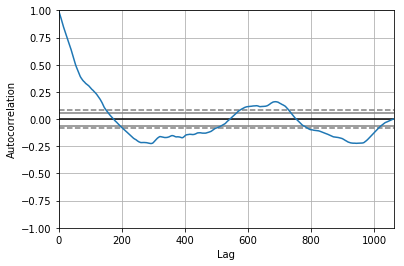

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.081


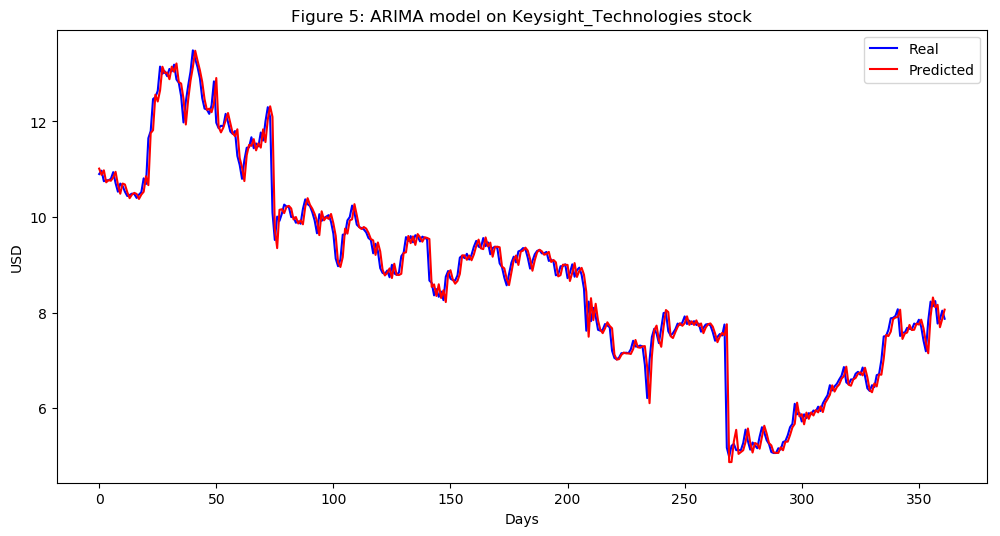

In [362]:
Keysight_Technologies_series = SP500_TechIndicator['Keysight_Technologies_Close']
Keysight_Technologies_series_model = ARIMA(Keysight_Technologies_series, order=(5, 1, 0))
Keysight_Technologies_model_fit = Keysight_Technologies_series_model.fit(disp=0)
print(Keysight_Technologies_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Keysight_Technologies_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Keysight_Technologies_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Keysight_Technologies_predictions = list()
for t in range(len(test)):
    Keysight_Technologies_series_model = ARIMA(history, order=(5,1,0))
    Keysight_Technologies_series_model_fit = Keysight_Technologies_series_model.fit(disp=0)
    Keysight_Technologies_output = Keysight_Technologies_series_model_fit.forecast()
    yhat = Keysight_Technologies_output[0]
    Keysight_Technologies_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Keysight_Technologies_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Keysight_Technologies_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Keysight_Technologies stock')
plt.legend()
plt.show()


#predictions
Keysight_Technologies_predictions = pd.DataFrame({'Keysight_Technologies_predictions':Keysight_Technologies_predictions})
#Keysight_Technologies_predictions.to_csv('Keysight_Technologies_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.KLA_Tencor_Corp_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1862.493
Method:                            css-mle   S.D. of innovations              1.400
Date:                     Sun, 17 Mar 2019   AIC                           3738.985
Time:                             22:32:49   BIC                           3773.754
Sample:                                  1   HQIC                          3752.162
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0411      0.041      0.999      0.318      -0.040       0.122
ar.L1.D.KLA_Tencor_Corp_Close    -

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


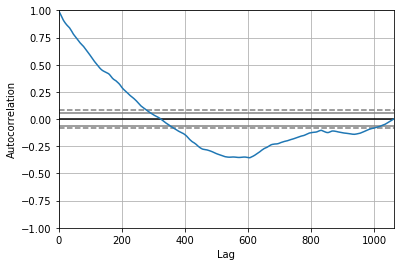

<Figure size 800x560 with 0 Axes>

Test MSE: 2.939


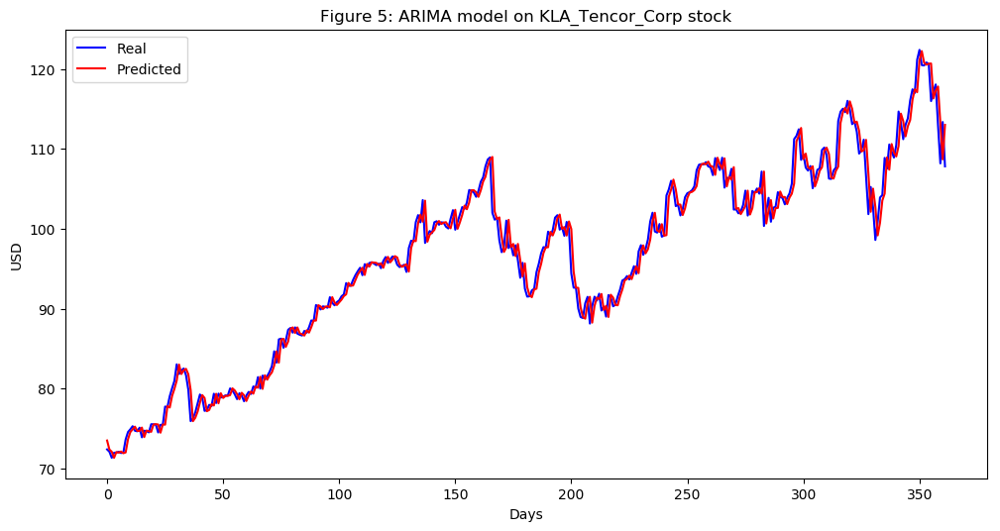

In [363]:
KLA_Tencor_Corp_series = SP500_TechIndicator['KLA_Tencor_Corp_Close']
KLA_Tencor_Corp_series_model = ARIMA(KLA_Tencor_Corp_series, order=(5, 1, 0))
KLA_Tencor_Corp_model_fit = KLA_Tencor_Corp_series_model.fit(disp=0)
print(KLA_Tencor_Corp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(KLA_Tencor_Corp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = KLA_Tencor_Corp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
KLA_Tencor_Corp_predictions = list()
for t in range(len(test)):
    KLA_Tencor_Corp_series_model = ARIMA(history, order=(5,1,0))
    KLA_Tencor_Corp_series_model_fit = KLA_Tencor_Corp_series_model.fit(disp=0)
    KLA_Tencor_Corp_output = KLA_Tencor_Corp_series_model_fit.forecast()
    yhat = KLA_Tencor_Corp_output[0]
    KLA_Tencor_Corp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, KLA_Tencor_Corp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(KLA_Tencor_Corp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on KLA_Tencor_Corp stock')
plt.legend()
plt.show()


#predictions
KLA_Tencor_Corp_predictions = pd.DataFrame({'KLA_Tencor_Corp_predictions':KLA_Tencor_Corp_predictions})
#KLA_Tencor_Corp_predictions.to_csv('KLA_Tencor_Corp_predictions.csv')



                              ARIMA Model Results                               
Dep. Variable:     D.Lam_Research_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood               -2368.533
Method:                         css-mle   S.D. of innovations              2.256
Date:                  Sun, 17 Mar 2019   AIC                           4751.065
Time:                          22:33:43   BIC                           4785.834
Sample:                               1   HQIC                          4764.242
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                          0.1379      0.079      1.756      0.079      -0.016       0.292
ar.L1.D.Lam_Research_Close     0.0003      0.031      0.010      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


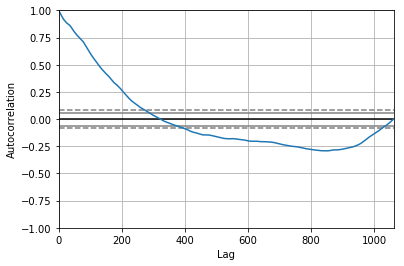

<Figure size 800x560 with 0 Axes>

Test MSE: 12.173


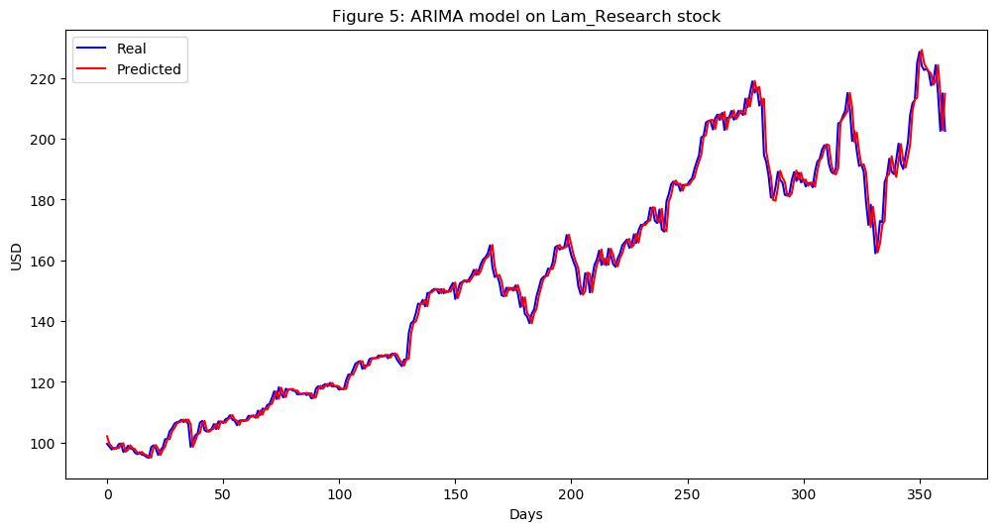

In [364]:
Lam_Research_series = SP500_TechIndicator['Lam_Research_Close']
Lam_Research_series_model = ARIMA(Lam_Research_series, order=(5, 1, 0))
Lam_Research_model_fit = Lam_Research_series_model.fit(disp=0)
print(Lam_Research_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Lam_Research_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Lam_Research_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Lam_Research_predictions = list()
for t in range(len(test)):
    Lam_Research_series_model = ARIMA(history, order=(5,1,0))
    Lam_Research_series_model_fit = Lam_Research_series_model.fit(disp=0)
    Lam_Research_output = Lam_Research_series_model_fit.forecast()
    yhat = Lam_Research_output[0]
    Lam_Research_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Lam_Research_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Lam_Research_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Lam_Research stock')
plt.legend()
plt.show()


#predictions
Lam_Research_predictions = pd.DataFrame({'Lam_Research_predictions':Lam_Research_predictions})
#Lam_Research_predictions.to_csv('Lam_Research_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:     D.Mastercard_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -4814.465
Method:                       css-mle   S.D. of innovations             22.618
Date:                Sun, 17 Mar 2019   AIC                           9642.930
Time:                        22:34:33   BIC                           9677.698
Sample:                             1   HQIC                          9656.106
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                       -0.6248      0.688     -0.908      0.364      -1.974       0.724
ar.L1.D.Mastercard_Close    -0.0001      0.031     -0.004      0.997      -0.060       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


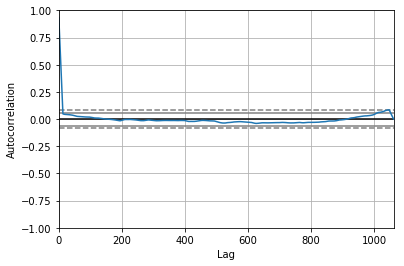

<Figure size 800x560 with 0 Axes>

Test MSE: 3.409


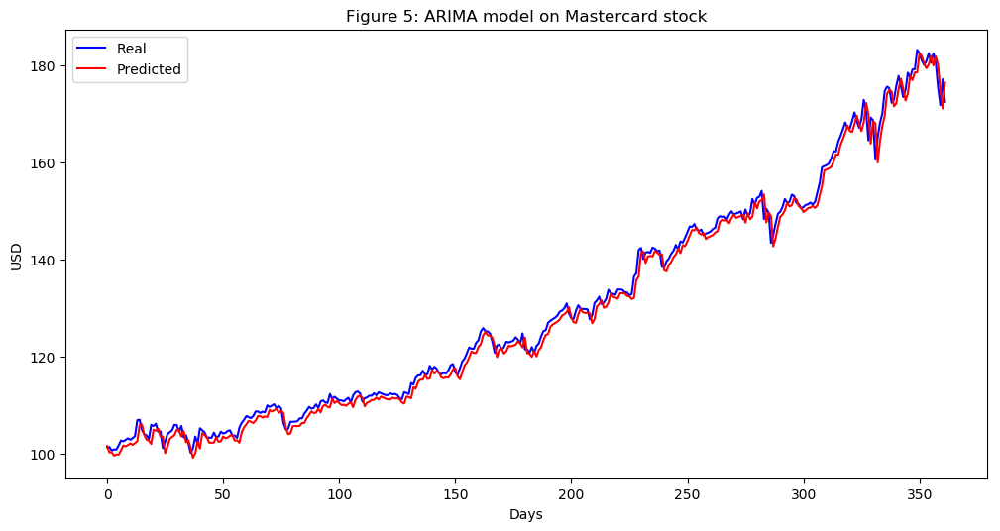

In [365]:
Mastercard_series = SP500_TechIndicator['Mastercard_Close']
Mastercard_series_model = ARIMA(Mastercard_series, order=(5, 1, 0))
Mastercard_model_fit = Mastercard_series_model.fit(disp=0)
print(Mastercard_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Mastercard_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Mastercard_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Mastercard_predictions = list()
for t in range(len(test)):
    Mastercard_series_model = ARIMA(history, order=(5,1,0))
    Mastercard_series_model_fit = Mastercard_series_model.fit(disp=0)
    Mastercard_output = Mastercard_series_model_fit.forecast()
    yhat = Mastercard_output[0]
    Mastercard_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Mastercard_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Mastercard_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Mastercard stock')
plt.legend()
plt.show()


#predictions
Mastercard_predictions = pd.DataFrame({'Mastercard_predictions':Mastercard_predictions})
#Mastercard_predictions.to_csv('Mastercard_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Microchip_Technology_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -1467.289
Method:                                 css-mle   S.D. of innovations              0.965
Date:                          Sun, 17 Mar 2019   AIC                           2948.578
Time:                                  22:35:45   BIC                           2983.347
Sample:                                       1   HQIC                          2961.755
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0467      0.029      1.603      0.109    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


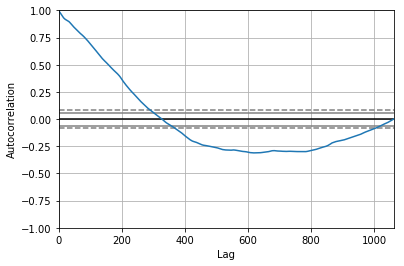

<Figure size 800x560 with 0 Axes>

Test MSE: 1.725


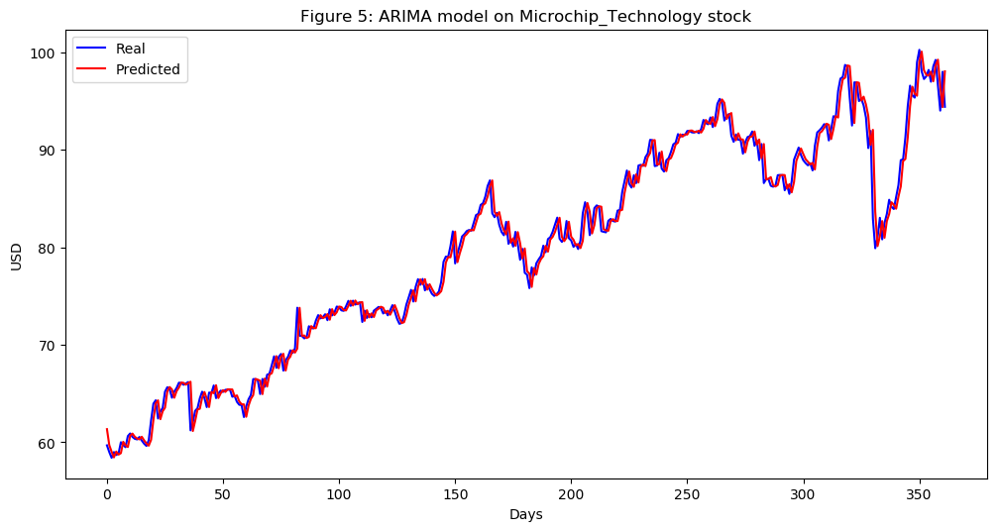

In [366]:
Microchip_Technology_series = SP500_TechIndicator['Microchip_Technology_Close']
Microchip_Technology_series_model = ARIMA(Microchip_Technology_series, order=(5, 1, 0))
Microchip_Technology_model_fit = Microchip_Technology_series_model.fit(disp=0)
print(Microchip_Technology_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Microchip_Technology_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Microchip_Technology_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Microchip_Technology_predictions = list()
for t in range(len(test)):
    Microchip_Technology_series_model = ARIMA(history, order=(5,1,0))
    Microchip_Technology_series_model_fit = Microchip_Technology_series_model.fit(disp=0)
    Microchip_Technology_output = Microchip_Technology_series_model_fit.forecast()
    yhat = Microchip_Technology_output[0]
    Microchip_Technology_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Microchip_Technology_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Microchip_Technology_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Microchip_Technology stock')
plt.legend()
plt.show()


#predictions
Microchip_Technology_predictions = pd.DataFrame({'Microchip_Technology_predictions':Microchip_Technology_predictions})
#Microchip_Technology_predictions.to_csv('Microchip_Technology_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Micron_Technology_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -1177.130
Method:                              css-mle   S.D. of innovations              0.734
Date:                       Sun, 17 Mar 2019   AIC                           2368.261
Time:                               22:36:44   BIC                           2403.030
Sample:                                    1   HQIC                          2381.437
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0288      0.024      1.220      0.223      -0.017       0.075
ar.L1.D.Micr

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


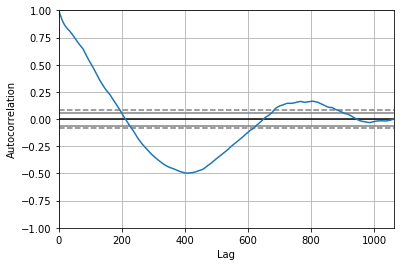

<Figure size 800x560 with 0 Axes>

Test MSE: 0.894


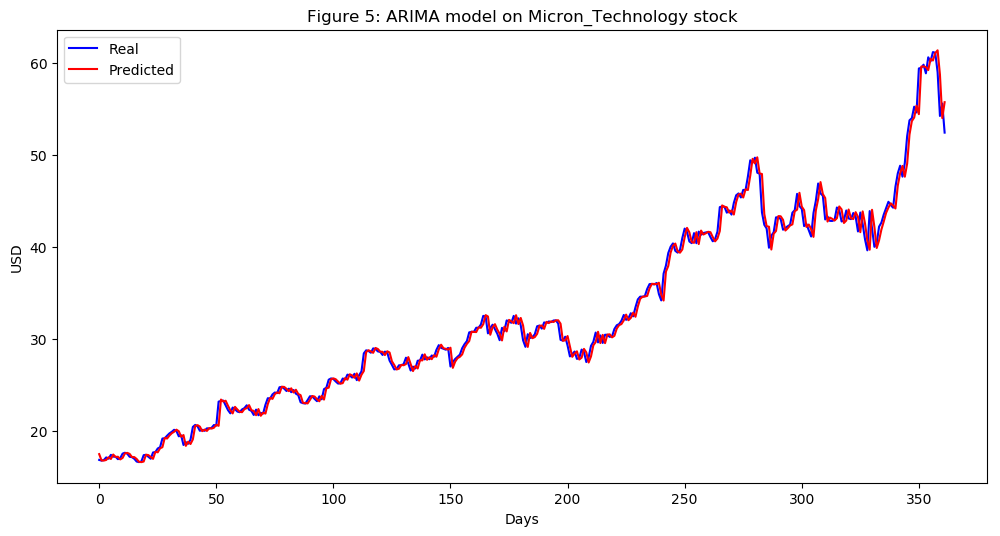

In [367]:
Micron_Technology_series = SP500_TechIndicator['Micron_Technology_Close']
Micron_Technology_series_model = ARIMA(Micron_Technology_series, order=(5, 1, 0))
Micron_Technology_model_fit = Micron_Technology_series_model.fit(disp=0)
print(Micron_Technology_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Micron_Technology_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Micron_Technology_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Micron_Technology_predictions = list()
for t in range(len(test)):
    Micron_Technology_series_model = ARIMA(history, order=(5,1,0))
    Micron_Technology_series_model_fit = Micron_Technology_series_model.fit(disp=0)
    Micron_Technology_output = Micron_Technology_series_model_fit.forecast()
    yhat = Micron_Technology_output[0]
    Micron_Technology_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Micron_Technology_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Micron_Technology_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Micron_Technology stock')
plt.legend()
plt.show()


#predictions
Micron_Technology_predictions = pd.DataFrame({'Micron_Technology_predictions':Micron_Technology_predictions})
#Micron_Technology_predictions.to_csv('Micron_Technology_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:      D.Microsoft_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1270.742
Method:                       css-mle   S.D. of innovations              0.801
Date:                Sun, 17 Mar 2019   AIC                           2555.484
Time:                        22:37:47   BIC                           2590.253
Sample:                             1   HQIC                          2568.661
                                                                              
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.0495      0.021      2.360      0.018       0.008       0.091
ar.L1.D.Microsoft_Close    -0.0796      0.031     -2.564      0.010      -0.140      -0.019


/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


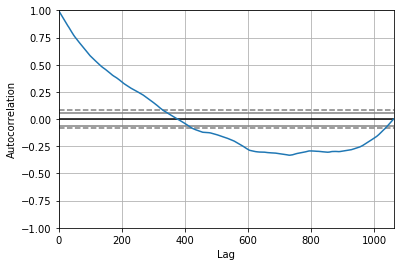

<Figure size 800x560 with 0 Axes>

Test MSE: 0.932


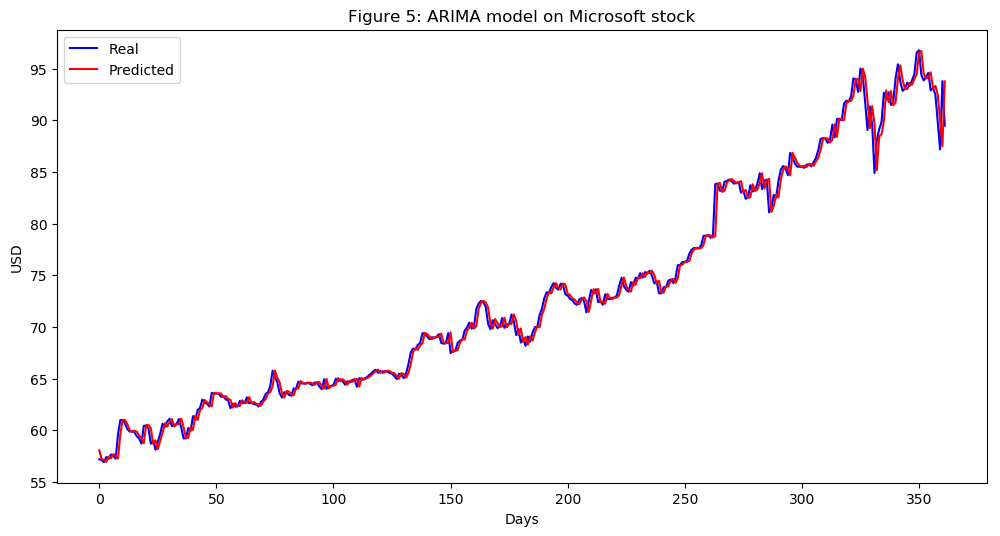

In [368]:
Microsoft_series = SP500_TechIndicator['Microsoft_Close']
Microsoft_series_model = ARIMA(Microsoft_series, order=(5, 1, 0))
Microsoft_model_fit = Microsoft_series_model.fit(disp=0)
print(Microsoft_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Microsoft_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Microsoft_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Microsoft_predictions = list()
for t in range(len(test)):
    Microsoft_series_model = ARIMA(history, order=(5,1,0))
    Microsoft_series_model_fit = Microsoft_series_model.fit(disp=0)
    Microsoft_output = Microsoft_series_model_fit.forecast()
    yhat = Microsoft_output[0]
    Microsoft_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Microsoft_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Microsoft_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Microsoft stock')
plt.legend()
plt.show()


#predictions
Microsoft_predictions = pd.DataFrame({'Microsoft_predictions':Microsoft_predictions})
#Microsoft_predictions.to_csv('Microsoft_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Motorola_Solutions_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1390.642
Method:                               css-mle   S.D. of innovations              0.897
Date:                        Sun, 17 Mar 2019   AIC                           2795.285
Time:                                22:38:59   BIC                           2830.053
Sample:                                     1   HQIC                          2808.461
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0365      0.026      1.392      0.164      -0.015       0.088
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


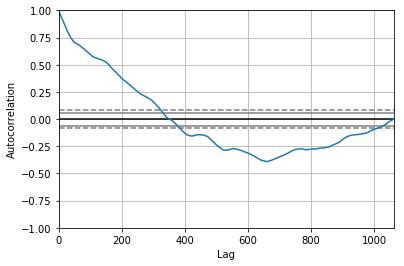

<Figure size 800x560 with 0 Axes>

Test MSE: 1.052


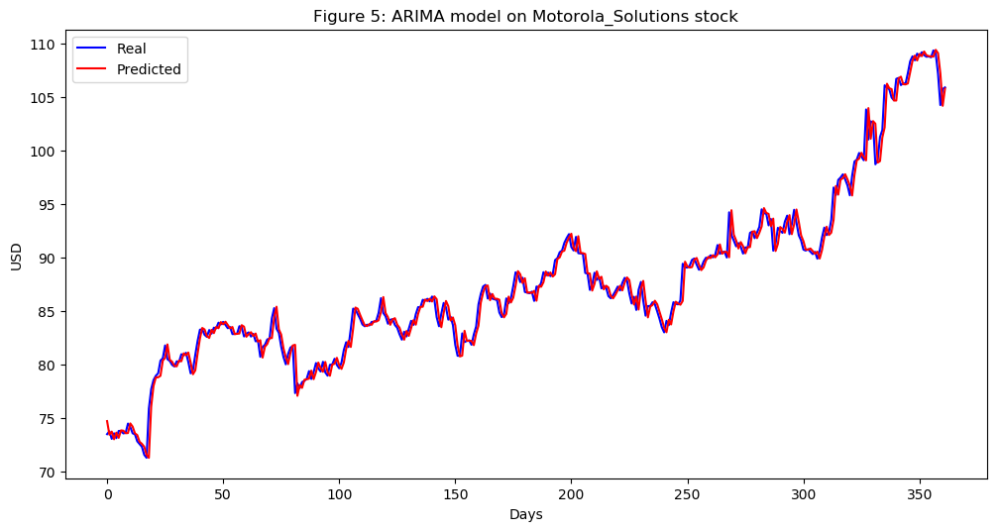

In [369]:
Motorola_Solutions_series = SP500_TechIndicator['Motorola_Solutions_Close']
Motorola_Solutions_series_model = ARIMA(Motorola_Solutions_series, order=(5, 1, 0))
Motorola_Solutions_model_fit = Motorola_Solutions_series_model.fit(disp=0)
print(Motorola_Solutions_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Motorola_Solutions_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Motorola_Solutions_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Motorola_Solutions_predictions = list()
for t in range(len(test)):
    Motorola_Solutions_series_model = ARIMA(history, order=(5,1,0))
    Motorola_Solutions_series_model_fit = Motorola_Solutions_series_model.fit(disp=0)
    Motorola_Solutions_output = Motorola_Solutions_series_model_fit.forecast()
    yhat = Motorola_Solutions_output[0]
    Motorola_Solutions_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Motorola_Solutions_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Motorola_Solutions_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Motorola_Solutions stock')
plt.legend()
plt.show()


#predictions
Motorola_Solutions_predictions = pd.DataFrame({'Motorola_Solutions_predictions':Motorola_Solutions_predictions})
#Motorola_Solutions_predictions.to_csv('Motorola_Solutions_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.NetApp_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1051.009
Method:                       css-mle   S.D. of innovations              0.652
Date:                Sun, 17 Mar 2019   AIC                           2116.017
Time:                        22:40:04   BIC                           2150.786
Sample:                             1   HQIC                          2129.194
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0184      0.024      0.764      0.445      -0.029       0.066
ar.L1.D.NetApp_Close    -0.0219      0.031     -0.712      0.477      -0.082       0.038
ar.L2.D.NetA

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


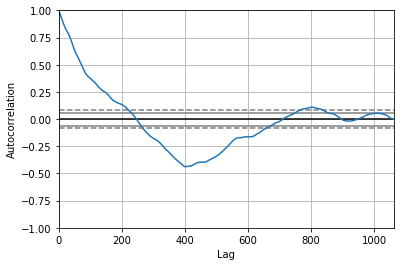

<Figure size 800x560 with 0 Axes>

Test MSE: 0.587


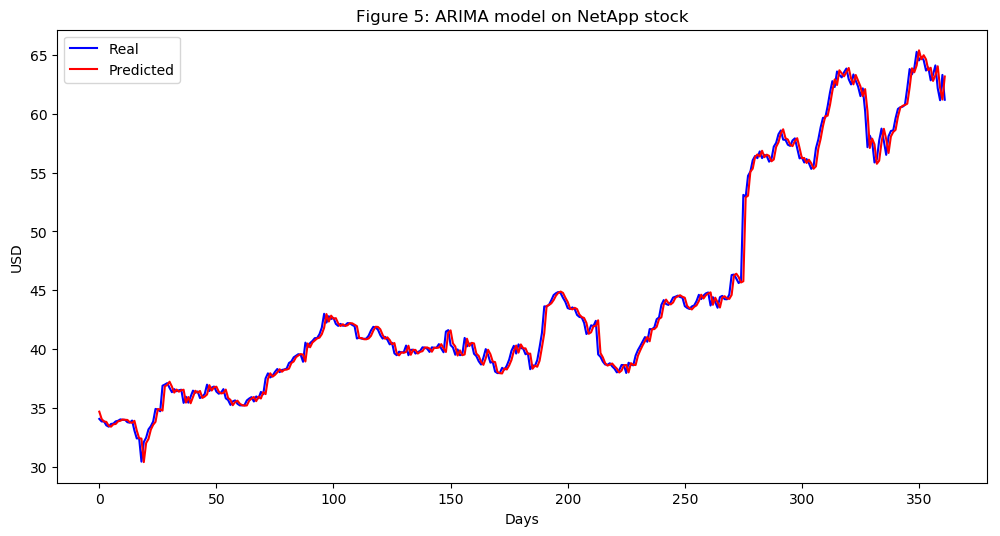

In [370]:
NetApp_series = SP500_TechIndicator['NetApp_Close']
NetApp_series_model = ARIMA(NetApp_series, order=(5, 1, 0))
NetApp_model_fit = NetApp_series_model.fit(disp=0)
print(NetApp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(NetApp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = NetApp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
NetApp_predictions = list()
for t in range(len(test)):
    NetApp_series_model = ARIMA(history, order=(5,1,0))
    NetApp_series_model_fit = NetApp_series_model.fit(disp=0)
    NetApp_output = NetApp_series_model_fit.forecast()
    yhat = NetApp_output[0]
    NetApp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, NetApp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(NetApp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on NetApp stock')
plt.legend()
plt.show()


#predictions
NetApp_predictions = pd.DataFrame({'NetApp_predictions':NetApp_predictions})
#NetApp_predictions.to_csv('NetApp_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Nvidia_Corporation_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -2483.506
Method:                               css-mle   S.D. of innovations              2.514
Date:                        Sun, 17 Mar 2019   AIC                           4981.011
Time:                                22:41:07   BIC                           5015.780
Sample:                                     1   HQIC                          4994.188
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.1987      0.074      2.677      0.008       0.053       0.344
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


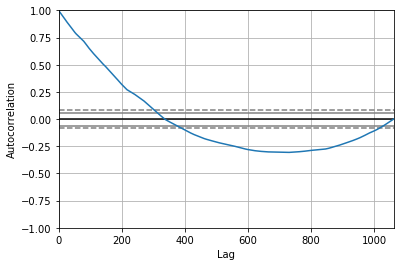

<Figure size 800x560 with 0 Axes>

Test MSE: 18.733


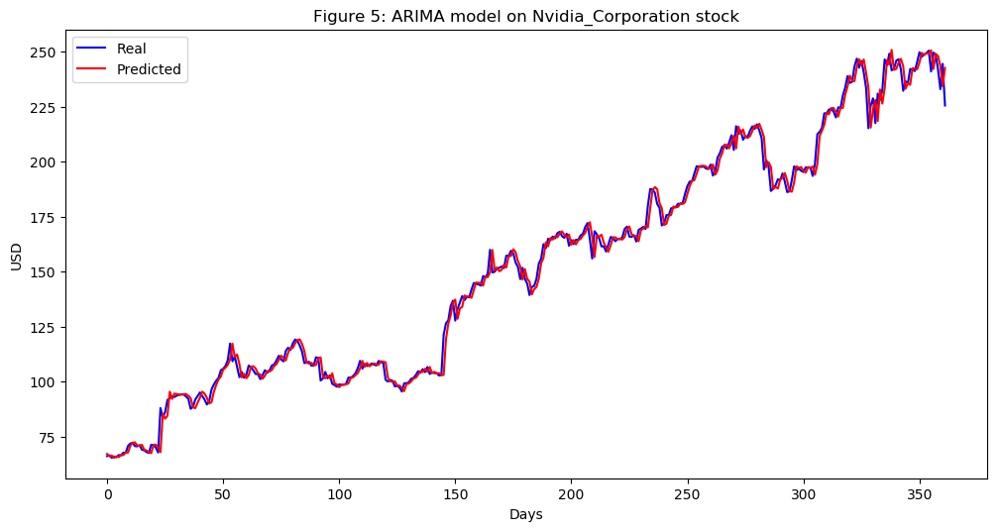

In [371]:
Nvidia_Corporation_series = SP500_TechIndicator['Nvidia_Corporation_Close']
Nvidia_Corporation_series_model = ARIMA(Nvidia_Corporation_series, order=(5, 1, 0))
Nvidia_Corporation_model_fit = Nvidia_Corporation_series_model.fit(disp=0)
print(Nvidia_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Nvidia_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Nvidia_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Nvidia_Corporation_predictions = list()
for t in range(len(test)):
    Nvidia_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Nvidia_Corporation_series_model_fit = Nvidia_Corporation_series_model.fit(disp=0)
    Nvidia_Corporation_output = Nvidia_Corporation_series_model_fit.forecast()
    yhat = Nvidia_Corporation_output[0]
    Nvidia_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Nvidia_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Nvidia_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Nvidia_Corporation stock')
plt.legend()
plt.show()


#predictions
Nvidia_Corporation_predictions = pd.DataFrame({'Nvidia_Corporation_predictions':Nvidia_Corporation_predictions})
#Nvidia_Corporation_predictions.to_csv('Nvidia_Corporation_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Oracle_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -883.080
Method:                       css-mle   S.D. of innovations              0.556
Date:                Sun, 17 Mar 2019   AIC                           1780.160
Time:                        22:42:11   BIC                           1814.929
Sample:                             1   HQIC                          1793.337
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0067      0.017      0.404      0.686      -0.026       0.039
ar.L1.D.Oracle_Close     0.0080      0.031      0.259      0.796      -0.052       0.068
ar.L2.D.Orac

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


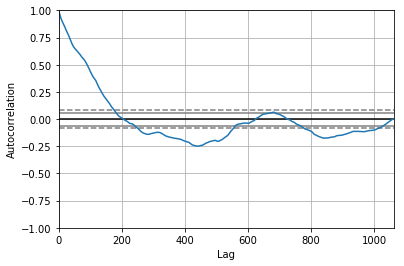

<Figure size 800x560 with 0 Axes>

Test MSE: 0.400


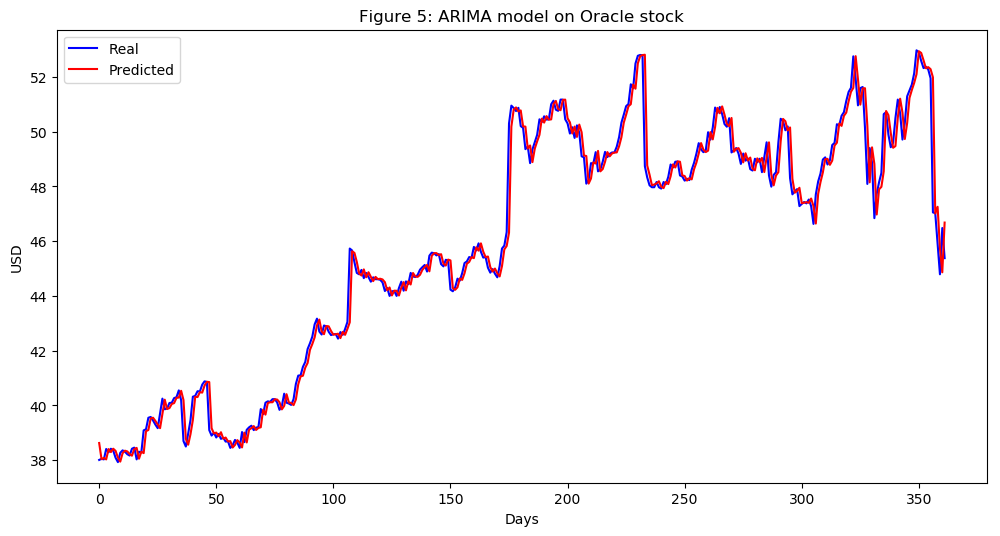

In [372]:
Oracle_series = SP500_TechIndicator['Oracle_Close']
Oracle_series_model = ARIMA(Oracle_series, order=(5, 1, 0))
Oracle_model_fit = Oracle_series_model.fit(disp=0)
print(Oracle_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Oracle_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Oracle_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Oracle_predictions = list()
for t in range(len(test)):
    Oracle_series_model = ARIMA(history, order=(5,1,0))
    Oracle_series_model_fit = Oracle_series_model.fit(disp=0)
    Oracle_output = Oracle_series_model_fit.forecast()
    yhat = Oracle_output[0]
    Oracle_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Oracle_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Oracle_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Oracle stock')
plt.legend()
plt.show()


#predictions
Oracle_predictions = pd.DataFrame({'Oracle_predictions':Oracle_predictions})
#Oracle_predictions.to_csv('Oracle_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Paychex_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -914.869
Method:                       css-mle   S.D. of innovations              0.573
Date:                Sun, 17 Mar 2019   AIC                           1843.739
Time:                        22:43:42   BIC                           1878.508
Sample:                             1   HQIC                          1856.915
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0131      0.019      0.684      0.494      -0.024       0.051
ar.L1.D.Paychex_Close    -0.0105      0.031     -0.343      0.732      -0.071       0.050
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


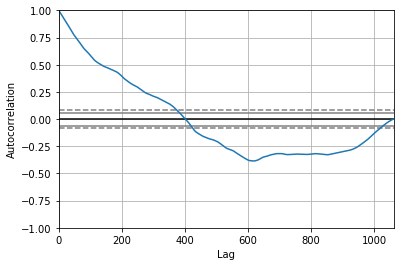

<Figure size 800x560 with 0 Axes>

Test MSE: 0.438


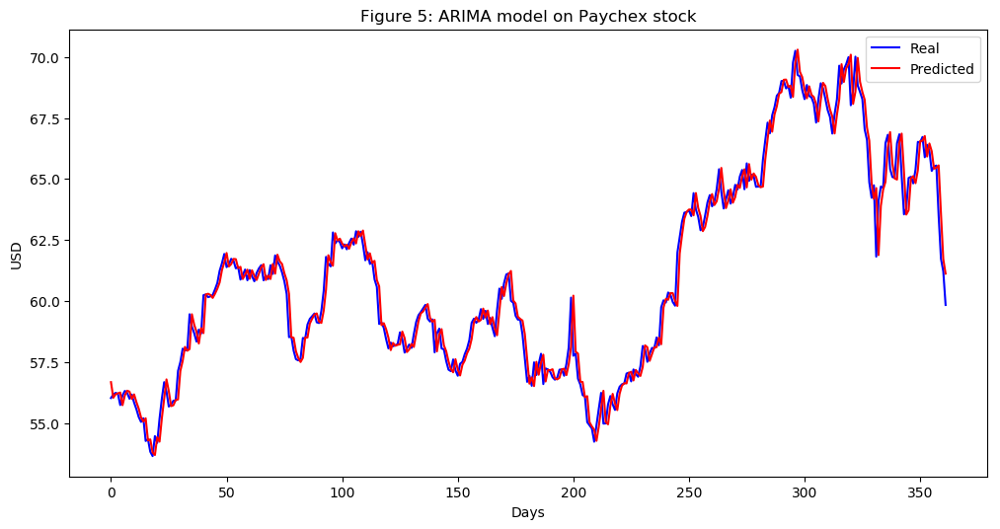

In [373]:
Paychex_series = SP500_TechIndicator['Paychex_Close']
Paychex_series_model = ARIMA(Paychex_series, order=(5, 1, 0))
Paychex_model_fit = Paychex_series_model.fit(disp=0)
print(Paychex_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Paychex_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Paychex_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Paychex_predictions = list()
for t in range(len(test)):
    Paychex_series_model = ARIMA(history, order=(5,1,0))
    Paychex_series_model_fit = Paychex_series_model.fit(disp=0)
    Paychex_output = Paychex_series_model_fit.forecast()
    yhat = Paychex_output[0]
    Paychex_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Paychex_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Paychex_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Paychex stock')
plt.legend()
plt.show()


#predictions
Paychex_predictions = pd.DataFrame({'Paychex_predictions':Paychex_predictions})
#Paychex_predictions.to_csv('Paychex_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.QUALCOMM_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1564.456
Method:                       css-mle   S.D. of innovations              1.057
Date:                Sun, 17 Mar 2019   AIC                           3142.911
Time:                        22:45:13   BIC                           3177.680
Sample:                             1   HQIC                          3156.088
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     -0.0182      0.030     -0.613      0.540      -0.076       0.040
ar.L1.D.QUALCOMM_Close     0.0007      0.031      0.021      0.983      -0.060       0.061
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


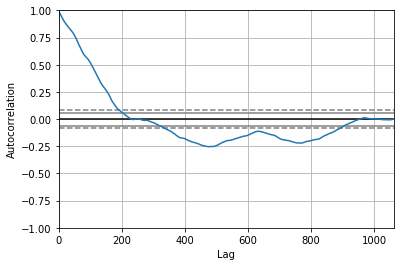

<Figure size 800x560 with 0 Axes>

Test MSE: 1.193


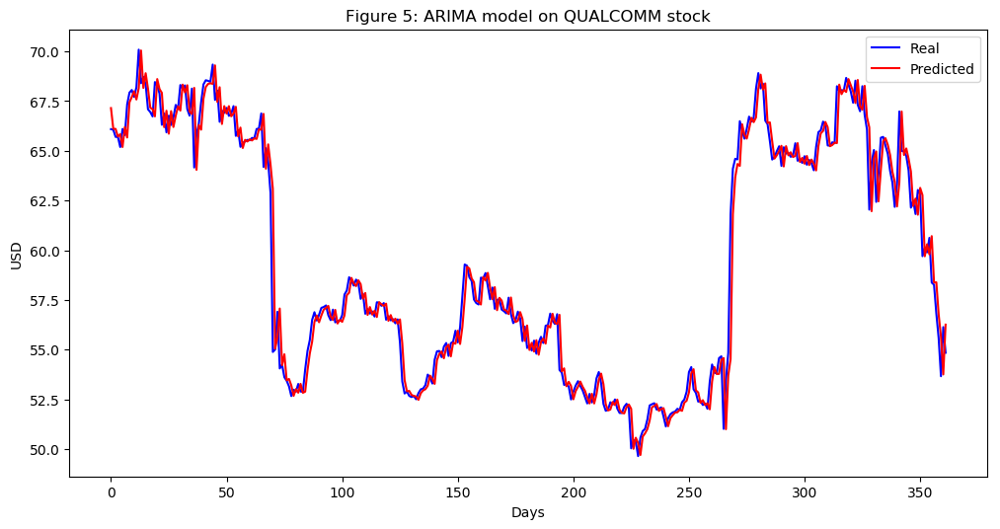

In [374]:
QUALCOMM_series = SP500_TechIndicator['QUALCOMM_Close']
QUALCOMM_series_model = ARIMA(QUALCOMM_series, order=(5, 1, 0))
QUALCOMM_model_fit = QUALCOMM_series_model.fit(disp=0)
print(QUALCOMM_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(QUALCOMM_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = QUALCOMM_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
QUALCOMM_predictions = list()
for t in range(len(test)):
    QUALCOMM_series_model = ARIMA(history, order=(5,1,0))
    QUALCOMM_series_model_fit = QUALCOMM_series_model.fit(disp=0)
    QUALCOMM_output = QUALCOMM_series_model_fit.forecast()
    yhat = QUALCOMM_output[0]
    QUALCOMM_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, QUALCOMM_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(QUALCOMM_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on QUALCOMM stock')
plt.legend()
plt.show()


#predictions
QUALCOMM_predictions = pd.DataFrame({'QUALCOMM_predictions':QUALCOMM_predictions})
#QUALCOMM_predictions.to_csv('QUALCOMM_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Red_Hat_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1762.403
Method:                       css-mle   S.D. of innovations              1.274
Date:                Sun, 17 Mar 2019   AIC                           3538.805
Time:                        22:46:14   BIC                           3573.574
Sample:                             1   HQIC                          3551.982
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0927      0.039      2.366      0.018       0.016       0.170
ar.L1.D.Red_Hat_Close     0.0075      0.031      0.245      0.807      -0.053       0.068
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


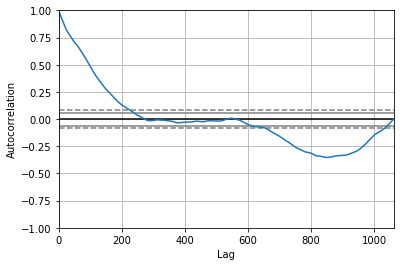

<Figure size 800x560 with 0 Axes>

Test MSE: 2.536


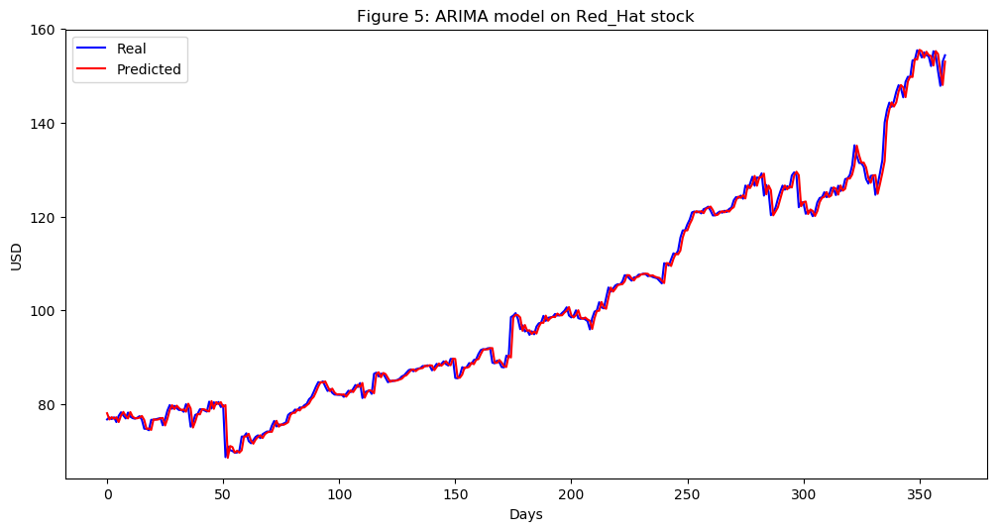

In [375]:
Red_Hat_series = SP500_TechIndicator['Red_Hat_Close']
Red_Hat_series_model = ARIMA(Red_Hat_series, order=(5, 1, 0))
Red_Hat_model_fit = Red_Hat_series_model.fit(disp=0)
print(Red_Hat_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Red_Hat_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Red_Hat_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Red_Hat_predictions = list()
for t in range(len(test)):
    Red_Hat_series_model = ARIMA(history, order=(5,1,0))
    Red_Hat_series_model_fit = Red_Hat_series_model.fit(disp=0)
    Red_Hat_output = Red_Hat_series_model_fit.forecast()
    yhat = Red_Hat_output[0]
    Red_Hat_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Red_Hat_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Red_Hat_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Red_Hat stock')
plt.legend()
plt.show()


#predictions
Red_Hat_predictions = pd.DataFrame({'Red_Hat_predictions':Red_Hat_predictions})
#Red_Hat_predictions.to_csv('Red_Hat_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:     D.Salesforce_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1790.058
Method:                       css-mle   S.D. of innovations              1.308
Date:                Sun, 17 Mar 2019   AIC                           3594.115
Time:                        22:47:10   BIC                           3628.884
Sample:                             1   HQIC                          3607.292
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0556      0.036      1.564      0.118      -0.014       0.125
ar.L1.D.Salesforce_Close    -0.0869      0.031     -2.811      0.005      -0.147      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


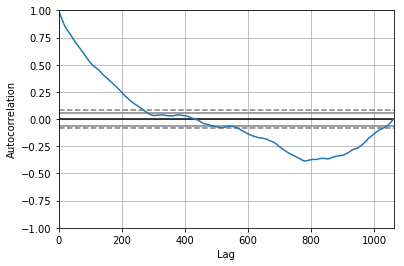

<Figure size 800x560 with 0 Axes>

Test MSE: 1.511


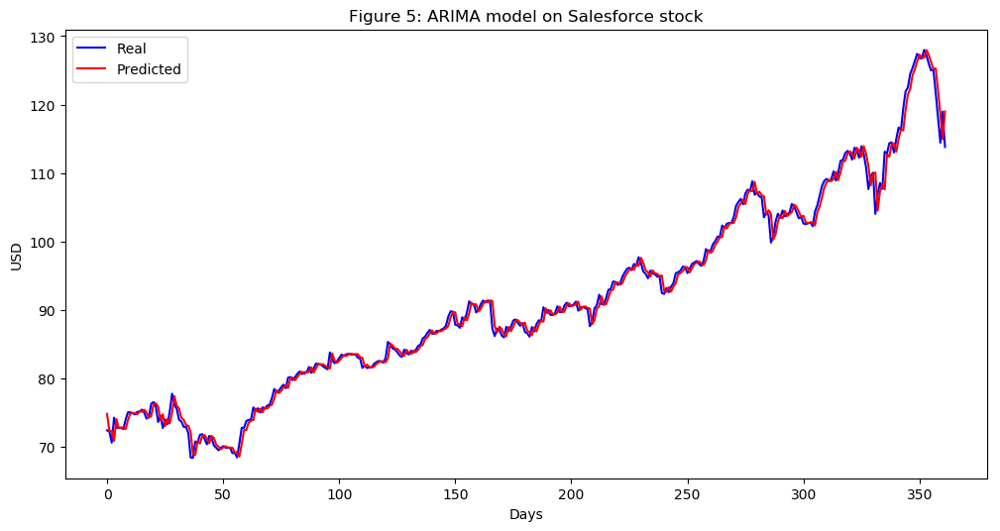

In [376]:
Salesforce_series = SP500_TechIndicator['Salesforce_Close']
Salesforce_series_model = ARIMA(Salesforce_series, order=(5, 1, 0))
Salesforce_model_fit = Salesforce_series_model.fit(disp=0)
print(Salesforce_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Salesforce_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Salesforce_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Salesforce_predictions = list()
for t in range(len(test)):
    Salesforce_series_model = ARIMA(history, order=(5,1,0))
    Salesforce_series_model_fit = Salesforce_series_model.fit(disp=0)
    Salesforce_output = Salesforce_series_model_fit.forecast()
    yhat = Salesforce_output[0]
    Salesforce_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Salesforce_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Salesforce_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Salesforce stock')
plt.legend()
plt.show()


#predictions
Salesforce_predictions = pd.DataFrame({'Salesforce_predictions':Salesforce_predictions})
#Salesforce_predictions.to_csv('Salesforce_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Seagate_Technology_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1548.157
Method:                               css-mle   S.D. of innovations              1.041
Date:                        Sun, 17 Mar 2019   AIC                           3110.315
Time:                                22:48:05   BIC                           3145.084
Sample:                                     1   HQIC                          3123.491
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0010      0.035      0.030      0.976      -0.067       0.069
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


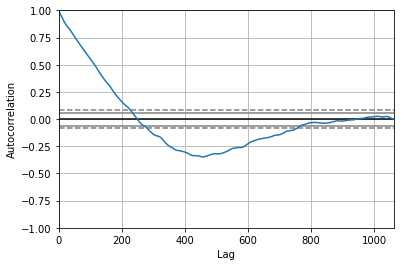

<Figure size 800x560 with 0 Axes>

Test MSE: 1.060


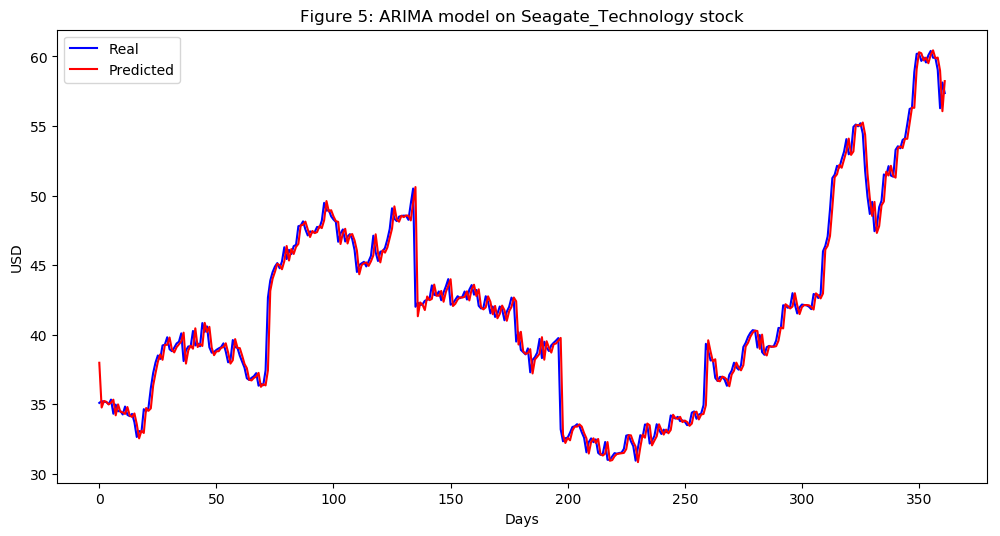

In [377]:
Seagate_Technology_series = SP500_TechIndicator['Seagate_Technology_Close']
Seagate_Technology_series_model = ARIMA(Seagate_Technology_series, order=(5, 1, 0))
Seagate_Technology_model_fit = Seagate_Technology_series_model.fit(disp=0)
print(Seagate_Technology_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Seagate_Technology_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Seagate_Technology_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Seagate_Technology_predictions = list()
for t in range(len(test)):
    Seagate_Technology_series_model = ARIMA(history, order=(5,1,0))
    Seagate_Technology_series_model_fit = Seagate_Technology_series_model.fit(disp=0)
    Seagate_Technology_output = Seagate_Technology_series_model_fit.forecast()
    yhat = Seagate_Technology_output[0]
    Seagate_Technology_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Seagate_Technology_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Seagate_Technology_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Seagate_Technology stock')
plt.legend()
plt.show()


#predictions
Seagate_Technology_predictions = pd.DataFrame({'Seagate_Technology_predictions':Seagate_Technology_predictions})
#Seagate_Technology_predictions.to_csv('Seagate_Technology_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Skyworks_Solution_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -2085.833
Method:                              css-mle   S.D. of innovations              1.728
Date:                       Sun, 17 Mar 2019   AIC                           4185.665
Time:                               22:49:01   BIC                           4220.434
Sample:                                    1   HQIC                          4198.842
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0691      0.048      1.438      0.151      -0.025       0.163
ar.L1.D.Skyw

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


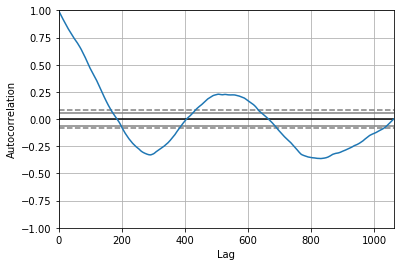

<Figure size 800x560 with 0 Axes>

Test MSE: 2.987


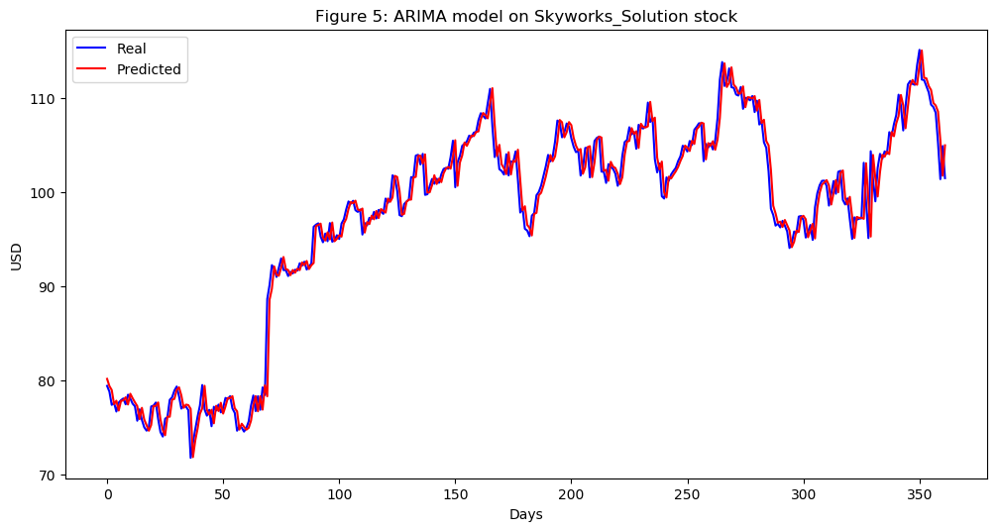

In [378]:
Skyworks_Solution_series = SP500_TechIndicator['Skyworks_Solution_Close']
Skyworks_Solution_series_model = ARIMA(Skyworks_Solution_series, order=(5, 1, 0))
Skyworks_Solution_model_fit = Skyworks_Solution_series_model.fit(disp=0)
print(Skyworks_Solution_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Skyworks_Solution_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Skyworks_Solution_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Skyworks_Solution_predictions = list()
for t in range(len(test)):
    Skyworks_Solution_series_model = ARIMA(history, order=(5,1,0))
    Skyworks_Solution_series_model_fit = Skyworks_Solution_series_model.fit(disp=0)
    Skyworks_Solution_output = Skyworks_Solution_series_model_fit.forecast()
    yhat = Skyworks_Solution_output[0]
    Skyworks_Solution_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Skyworks_Solution_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Skyworks_Solution_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Skyworks_Solution stock')
plt.legend()
plt.show()


#predictions
Skyworks_Solution_predictions = pd.DataFrame({'Skyworks_Solution_predictions':Skyworks_Solution_predictions})
#Skyworks_Solution_predictions.to_csv('Skyworks_Solution_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Symantec_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -539.127
Method:                       css-mle   S.D. of innovations              0.402
Date:                Sun, 17 Mar 2019   AIC                           1092.253
Time:                        22:49:50   BIC                           1127.022
Sample:                             1   HQIC                          1105.430
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0019      0.012      0.161      0.872      -0.021       0.025
ar.L1.D.Symantec_Close    -0.0286      0.031     -0.930      0.352      -0.089       0.032
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


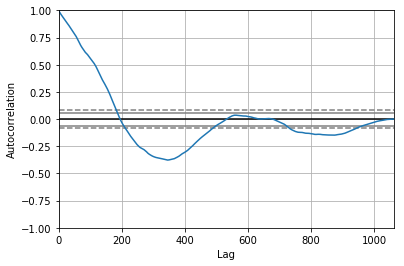

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.208


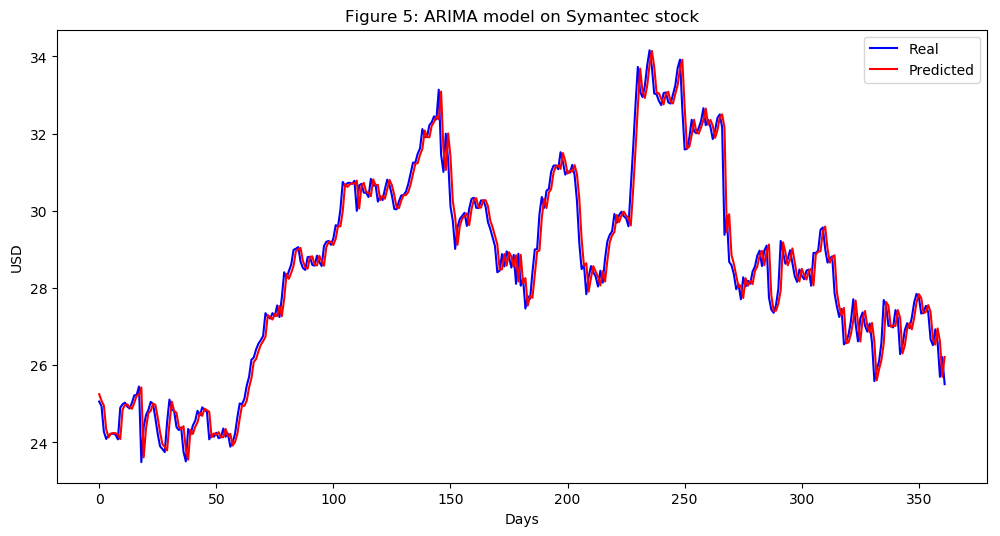

In [379]:
Symantec_series = SP500_TechIndicator['Symantec_Close']
Symantec_series_model = ARIMA(Symantec_series, order=(5, 1, 0))
Symantec_model_fit = Symantec_series_model.fit(disp=0)
print(Symantec_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Symantec_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Symantec_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Symantec_predictions = list()
for t in range(len(test)):
    Symantec_series_model = ARIMA(history, order=(5,1,0))
    Symantec_series_model_fit = Symantec_series_model.fit(disp=0)
    Symantec_output = Symantec_series_model_fit.forecast()
    yhat = Symantec_output[0]
    Symantec_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Symantec_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Symantec_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Symantec stock')
plt.legend()
plt.show()


#predictions
Symantec_predictions = pd.DataFrame({'Symantec_predictions':Symantec_predictions})
#Symantec_predictions.to_csv('Symantec_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Synopsys_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1085.278
Method:                       css-mle   S.D. of innovations              0.673
Date:                Sun, 17 Mar 2019   AIC                           2184.557
Time:                        22:51:24   BIC                           2219.326
Sample:                             1   HQIC                          2197.733
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0401      0.020      2.054      0.040       0.002       0.078
ar.L1.D.Synopsys_Close    -0.0292      0.031     -0.949      0.343      -0.089       0.031
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


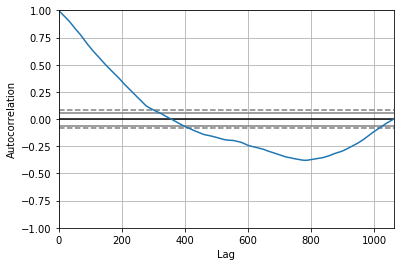

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.759


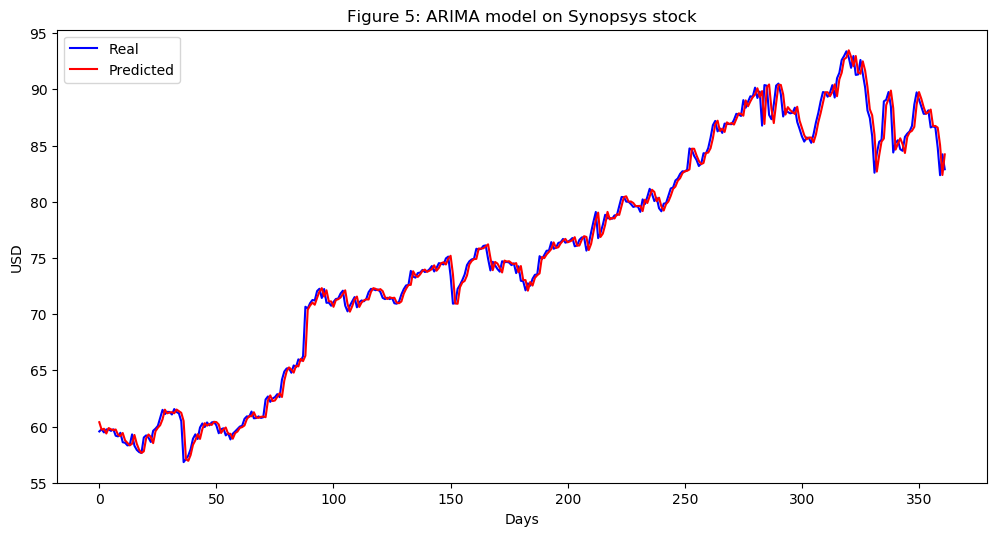

In [380]:
Synopsys_series = SP500_TechIndicator['Synopsys_Close']
Synopsys_series_model = ARIMA(Synopsys_series, order=(5, 1, 0))
Synopsys_model_fit = Synopsys_series_model.fit(disp=0)
print(Synopsys_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Synopsys_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Synopsys_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Synopsys_predictions = list()
for t in range(len(test)):
    Synopsys_series_model = ARIMA(history, order=(5,1,0))
    Synopsys_series_model_fit = Synopsys_series_model.fit(disp=0)
    Synopsys_output = Synopsys_series_model_fit.forecast()
    yhat = Synopsys_output[0]
    Synopsys_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Synopsys_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Synopsys_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Synopsys stock')
plt.legend()
plt.show()


#predictions
Synopsys_predictions = pd.DataFrame({'Synopsys_predictions':Synopsys_predictions})
#Synopsys_predictions.to_csv('Synopsys_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.TE_Connectivity_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1351.332
Method:                            css-mle   S.D. of innovations              0.865
Date:                     Sun, 17 Mar 2019   AIC                           2716.664
Time:                             22:52:41   BIC                           2751.433
Sample:                                  1   HQIC                          2729.840
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0403      0.027      1.510      0.131      -0.012       0.093
ar.L1.D.TE_Connectivity_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


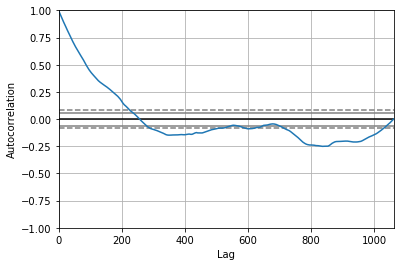

<Figure size 800x560 with 0 Axes>

Test MSE: 0.870


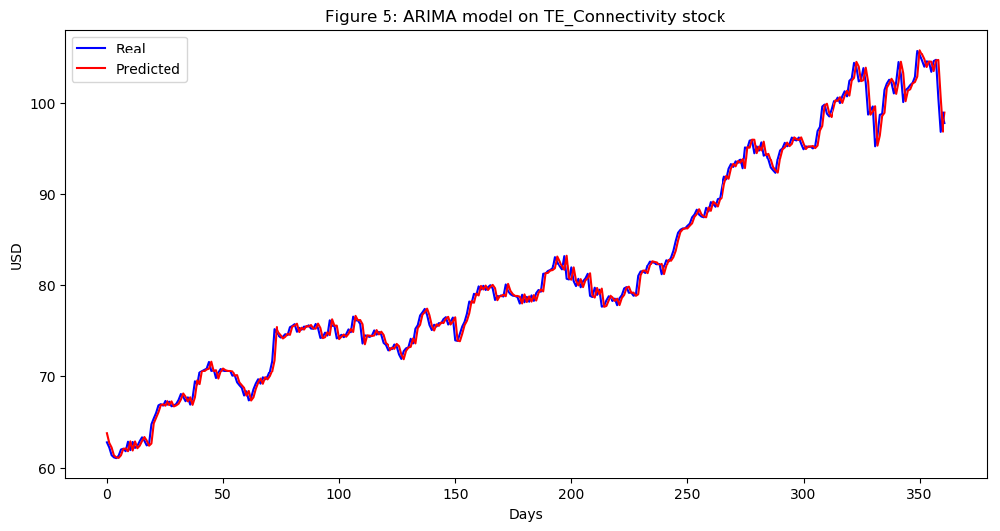

In [381]:
TE_Connectivity_series = SP500_TechIndicator['TE_Connectivity_Close']
TE_Connectivity_series_model = ARIMA(TE_Connectivity_series, order=(5, 1, 0))
TE_Connectivity_model_fit = TE_Connectivity_series_model.fit(disp=0)
print(TE_Connectivity_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(TE_Connectivity_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = TE_Connectivity_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
TE_Connectivity_predictions = list()
for t in range(len(test)):
    TE_Connectivity_series_model = ARIMA(history, order=(5,1,0))
    TE_Connectivity_series_model_fit = TE_Connectivity_series_model.fit(disp=0)
    TE_Connectivity_output = TE_Connectivity_series_model_fit.forecast()
    yhat = TE_Connectivity_output[0]
    TE_Connectivity_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, TE_Connectivity_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(TE_Connectivity_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on TE_Connectivity stock')
plt.legend()
plt.show()


#predictions
TE_Connectivity_predictions = pd.DataFrame({'TE_Connectivity_predictions':TE_Connectivity_predictions})
#TE_Connectivity_predictions.to_csv('TE_Connectivity_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Texas_Instruments_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -1472.943
Method:                              css-mle   S.D. of innovations              0.970
Date:                       Sun, 17 Mar 2019   AIC                           2959.885
Time:                               22:53:43   BIC                           2994.654
Sample:                                    1   HQIC                          2973.062
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0553      0.027      2.047      0.041       0.002       0.108
ar.L1.D.Texa

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


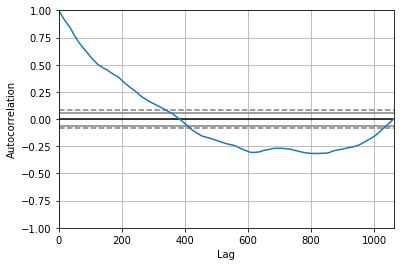

<Figure size 800x560 with 0 Axes>

Test MSE: 1.635


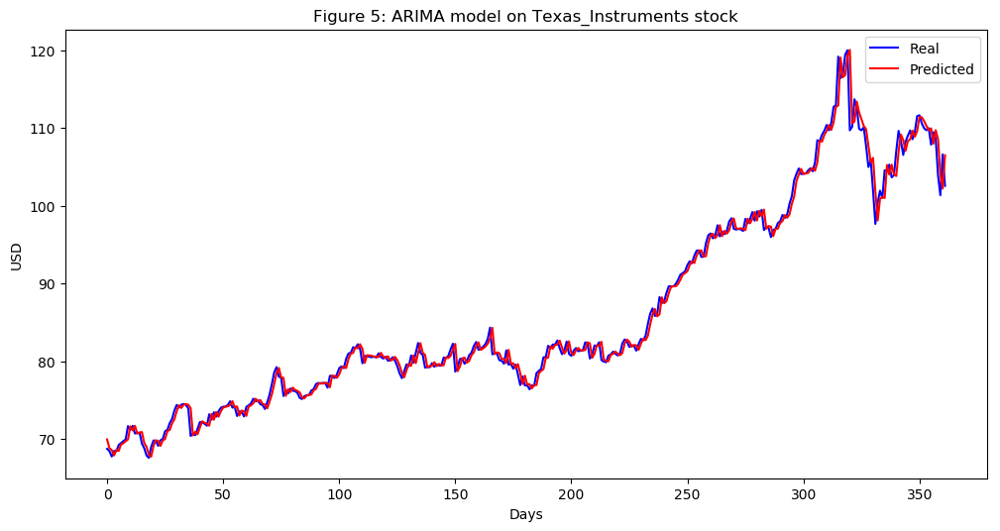

In [382]:
Texas_Instruments_series = SP500_TechIndicator['Texas_Instruments_Close']
Texas_Instruments_series_model = ARIMA(Texas_Instruments_series, order=(5, 1, 0))
Texas_Instruments_model_fit = Texas_Instruments_series_model.fit(disp=0)
print(Texas_Instruments_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Texas_Instruments_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Texas_Instruments_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Texas_Instruments_predictions = list()
for t in range(len(test)):
    Texas_Instruments_series_model = ARIMA(history, order=(5,1,0))
    Texas_Instruments_series_model_fit = Texas_Instruments_series_model.fit(disp=0)
    Texas_Instruments_output = Texas_Instruments_series_model_fit.forecast()
    yhat = Texas_Instruments_output[0]
    Texas_Instruments_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Texas_Instruments_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Texas_Instruments_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Texas_Instruments stock')
plt.legend()
plt.show()


#predictions
Texas_Instruments_predictions = pd.DataFrame({'Texas_Instruments_predictions':Texas_Instruments_predictions})
#Texas_Instruments_predictions.to_csv('Texas_Instruments_predictions.csv')



                                   ARIMA Model Results                                   
Dep. Variable:     D.Total_System_Services_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood               -1138.382
Method:                                  css-mle   S.D. of innovations              0.708
Date:                           Sun, 17 Mar 2019   AIC                           2290.764
Time:                                   22:54:37   BIC                           2325.533
Sample:                                        1   HQIC                          2303.940
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                   0.0492      0.021      2.290    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


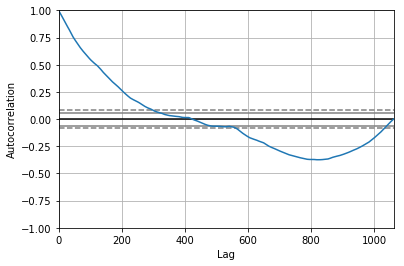

<Figure size 800x560 with 0 Axes>

Test MSE: 0.626


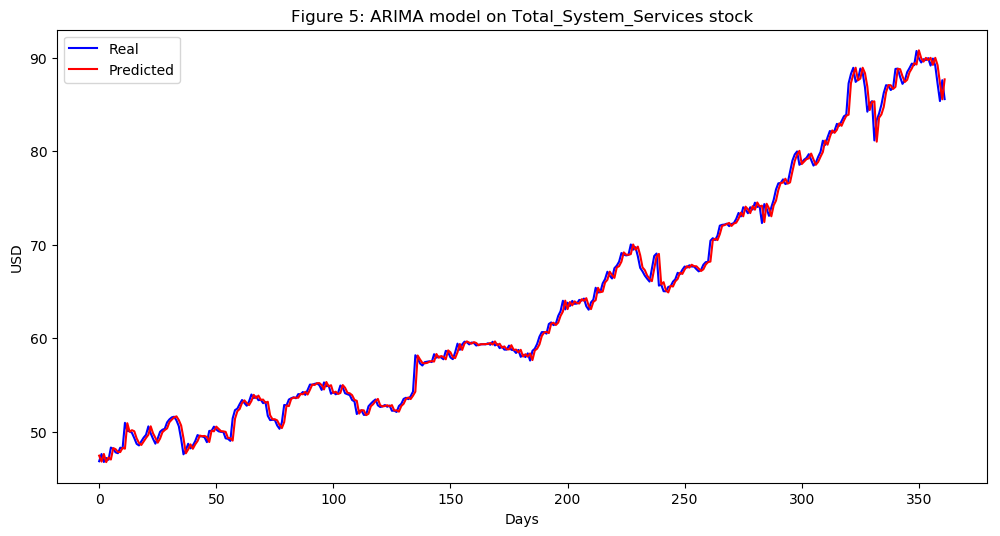

In [383]:
Total_System_Services_series = SP500_TechIndicator['Total_System_Services_Close']
Total_System_Services_series_model = ARIMA(Total_System_Services_series, order=(5, 1, 0))
Total_System_Services_model_fit = Total_System_Services_series_model.fit(disp=0)
print(Total_System_Services_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Total_System_Services_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Total_System_Services_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Total_System_Services_predictions = list()
for t in range(len(test)):
    Total_System_Services_series_model = ARIMA(history, order=(5,1,0))
    Total_System_Services_series_model_fit = Total_System_Services_series_model.fit(disp=0)
    Total_System_Services_output = Total_System_Services_series_model_fit.forecast()
    yhat = Total_System_Services_output[0]
    Total_System_Services_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Total_System_Services_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Total_System_Services_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Total_System_Services stock')
plt.legend()
plt.show()


#predictions
Total_System_Services_predictions = pd.DataFrame({'Total_System_Services_predictions':Total_System_Services_predictions})
#Total_System_Services_predictions.to_csv('Total_System_Services_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Verisign_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1570.065
Method:                       css-mle   S.D. of innovations              1.063
Date:                Sun, 17 Mar 2019   AIC                           3154.129
Time:                        22:55:40   BIC                           3188.898
Sample:                             1   HQIC                          3167.306
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0543      0.031      1.725      0.085      -0.007       0.116
ar.L1.D.Verisign_Close    -0.0066      0.031     -0.214      0.830      -0.067       0.054
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


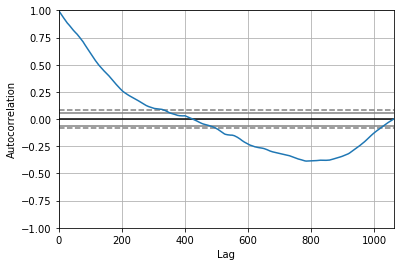

<Figure size 800x560 with 0 Axes>

Test MSE: 1.399


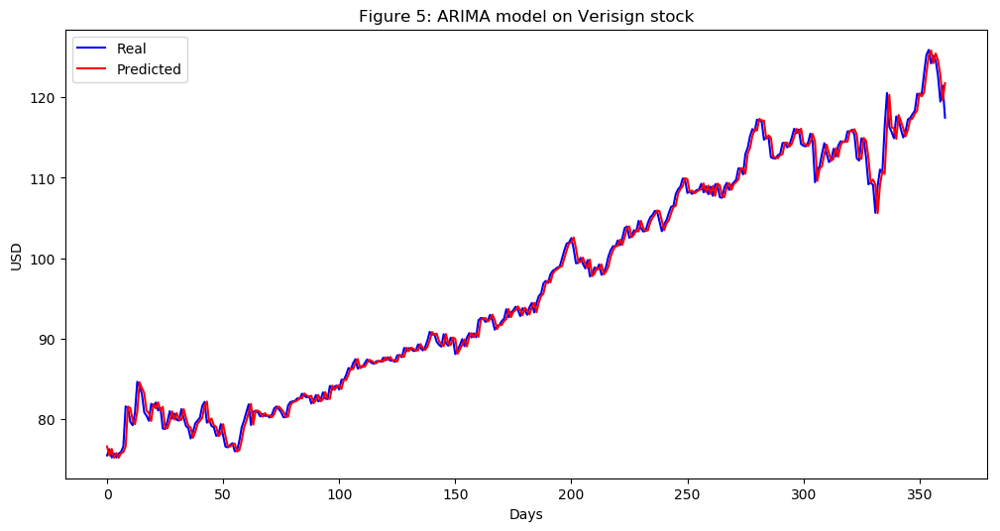

In [384]:
Verisign_series = SP500_TechIndicator['Verisign_Close']
Verisign_series_model = ARIMA(Verisign_series, order=(5, 1, 0))
Verisign_model_fit = Verisign_series_model.fit(disp=0)
print(Verisign_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Verisign_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Verisign_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Verisign_predictions = list()
for t in range(len(test)):
    Verisign_series_model = ARIMA(history, order=(5,1,0))
    Verisign_series_model_fit = Verisign_series_model.fit(disp=0)
    Verisign_output = Verisign_series_model_fit.forecast()
    yhat = Verisign_output[0]
    Verisign_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Verisign_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Verisign_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Verisign stock')
plt.legend()
plt.show()


#predictions
Verisign_predictions = pd.DataFrame({'Verisign_predictions':Verisign_predictions})
#Verisign_predictions.to_csv('Verisign_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:           D.Visa_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -3480.035
Method:                       css-mle   S.D. of innovations              6.430
Date:                Sun, 17 Mar 2019   AIC                           6974.071
Time:                        22:56:43   BIC                           7008.840
Sample:                             1   HQIC                          6987.247
                                                                              
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0991      0.195     -0.508      0.612      -0.482       0.284
ar.L1.D.Visa_Close    -0.0211      0.031     -0.689      0.491      -0.081       0.039
ar.L2.D.Visa_Close  

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


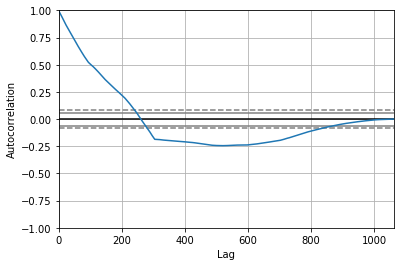

<Figure size 800x560 with 0 Axes>

Test MSE: 1.294


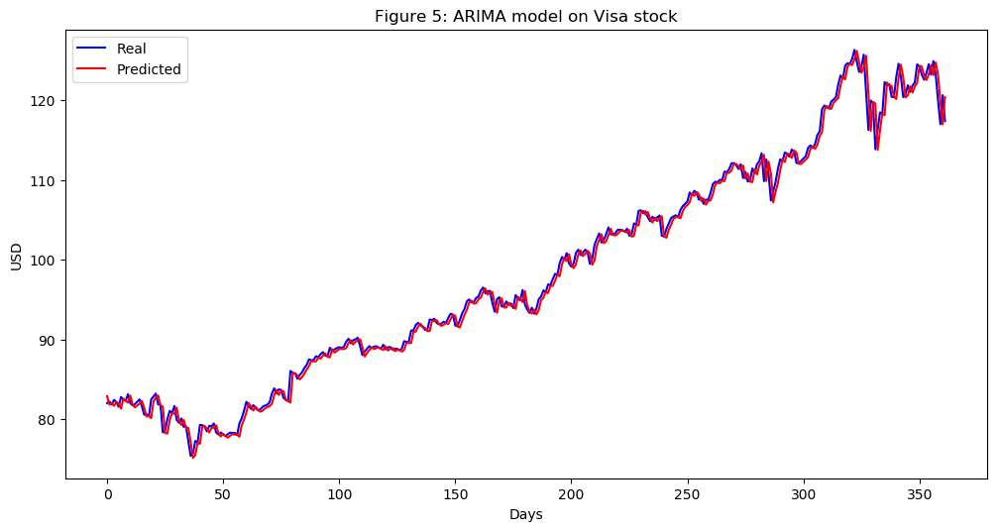

In [385]:
Visa_series = SP500_TechIndicator['Visa_Close']
Visa_series_model = ARIMA(Visa_series, order=(5, 1, 0))
Visa_model_fit = Visa_series_model.fit(disp=0)
print(Visa_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Visa_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Visa_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Visa_predictions = list()
for t in range(len(test)):
    Visa_series_model = ARIMA(history, order=(5,1,0))
    Visa_series_model_fit = Visa_series_model.fit(disp=0)
    Visa_output = Visa_series_model_fit.forecast()
    yhat = Visa_output[0]
    Visa_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Visa_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Visa_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Visa stock')
plt.legend()
plt.show()


#predictions
Visa_predictions = pd.DataFrame({'Visa_predictions':Visa_predictions})
#Visa_predictions.to_csv('Visa_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.Western_Digital_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -2009.921
Method:                            css-mle   S.D. of innovations              1.609
Date:                     Sun, 17 Mar 2019   AIC                           4033.843
Time:                             22:57:59   BIC                           4068.612
Sample:                                  1   HQIC                          4047.019
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0075      0.055      0.137      0.891      -0.100       0.114
ar.L1.D.Western_Digital_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


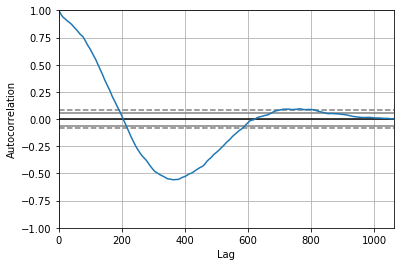

<Figure size 800x560 with 0 Axes>

Test MSE: 2.847


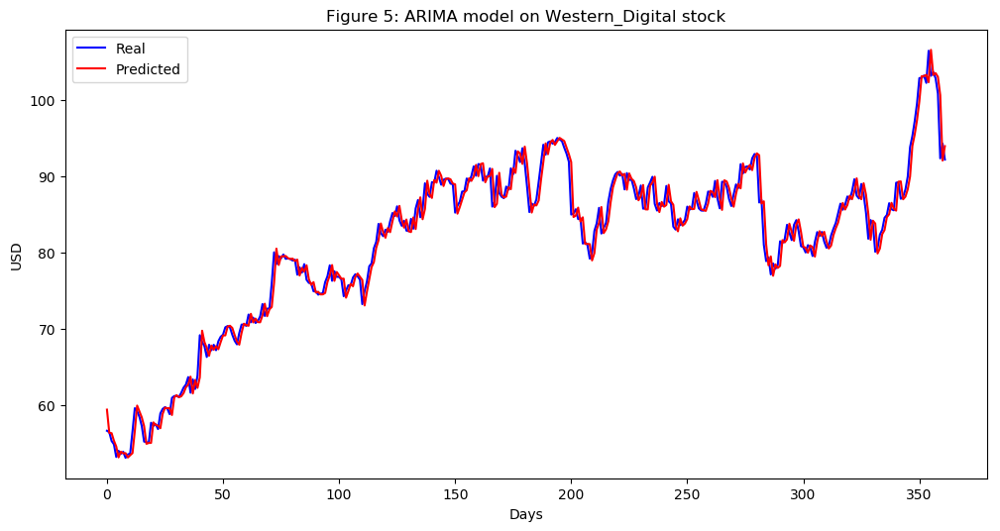

In [386]:
Western_Digital_series = SP500_TechIndicator['Western_Digital_Close']
Western_Digital_series_model = ARIMA(Western_Digital_series, order=(5, 1, 0))
Western_Digital_model_fit = Western_Digital_series_model.fit(disp=0)
print(Western_Digital_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Western_Digital_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Western_Digital_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Western_Digital_predictions = list()
for t in range(len(test)):
    Western_Digital_series_model = ARIMA(history, order=(5,1,0))
    Western_Digital_series_model_fit = Western_Digital_series_model.fit(disp=0)
    Western_Digital_output = Western_Digital_series_model_fit.forecast()
    yhat = Western_Digital_output[0]
    Western_Digital_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Western_Digital_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Western_Digital_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Western_Digital stock')
plt.legend()
plt.show()


#predictions
Western_Digital_predictions = pd.DataFrame({'Western_Digital_predictions':Western_Digital_predictions})
#Western_Digital_predictions.to_csv('Western_Digital_predictions.csv')



                               ARIMA Model Results                               
Dep. Variable:     D.Western_Union_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood                 -63.740
Method:                          css-mle   S.D. of innovations              0.257
Date:                   Sun, 17 Mar 2019   AIC                            141.481
Time:                           22:59:17   BIC                            176.250
Sample:                                1   HQIC                           154.657
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0016      0.007      0.215      0.830      -0.013       0.016
ar.L1.D.Western_Union_Close     0.0059      0.031      0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


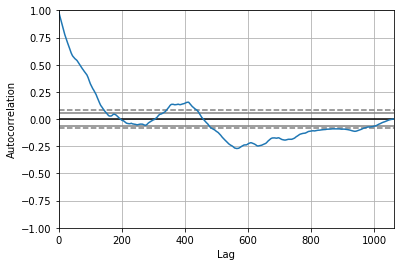

<Figure size 800x560 with 0 Axes>

Test MSE: 0.063


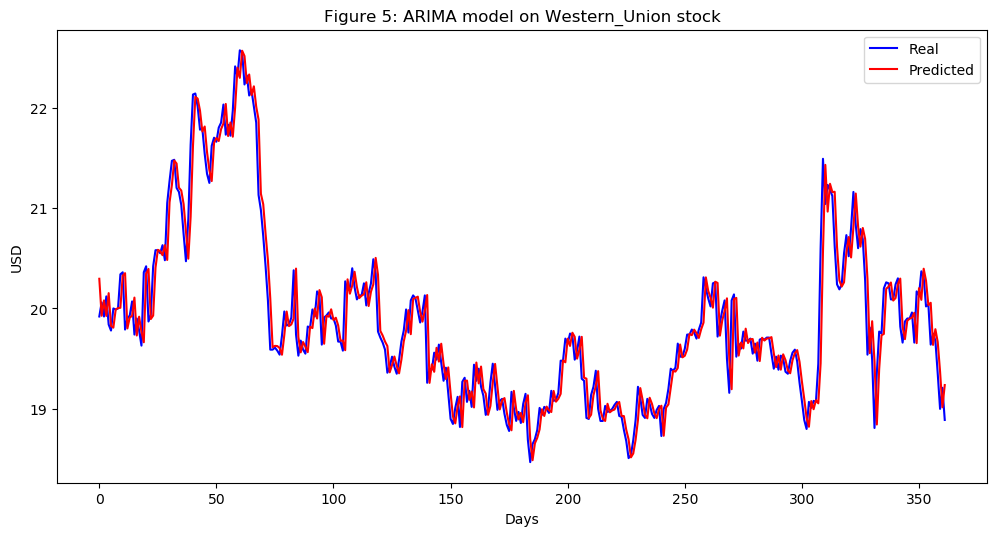

In [387]:
Western_Union_series = SP500_TechIndicator['Western_Union_Close']
Western_Union_series_model = ARIMA(Western_Union_series, order=(5, 1, 0))
Western_Union_model_fit = Western_Union_series_model.fit(disp=0)
print(Western_Union_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Western_Union_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Western_Union_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Western_Union_predictions = list()
for t in range(len(test)):
    Western_Union_series_model = ARIMA(history, order=(5,1,0))
    Western_Union_series_model_fit = Western_Union_series_model.fit(disp=0)
    Western_Union_output = Western_Union_series_model_fit.forecast()
    yhat = Western_Union_output[0]
    Western_Union_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Western_Union_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Western_Union_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Western_Union stock')
plt.legend()
plt.show()


#predictions
Western_Union_predictions = pd.DataFrame({'Western_Union_predictions':Western_Union_predictions})
#Western_Union_predictions.to_csv('Western_Union_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Xerox_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1121.620
Method:                       css-mle   S.D. of innovations              0.696
Date:                Sun, 17 Mar 2019   AIC                           2257.241
Time:                        23:00:40   BIC                           2292.009
Sample:                             1   HQIC                          2270.417
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0159      0.021      0.746      0.456      -0.026       0.058
ar.L1.D.Xerox_Close     0.0197      0.031      0.642      0.521      -0.040       0.080
ar.L2.D.Xerox_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


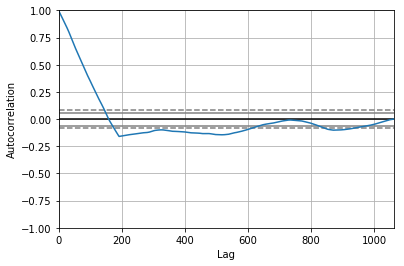

<Figure size 800x560 with 0 Axes>

Test MSE: 1.412


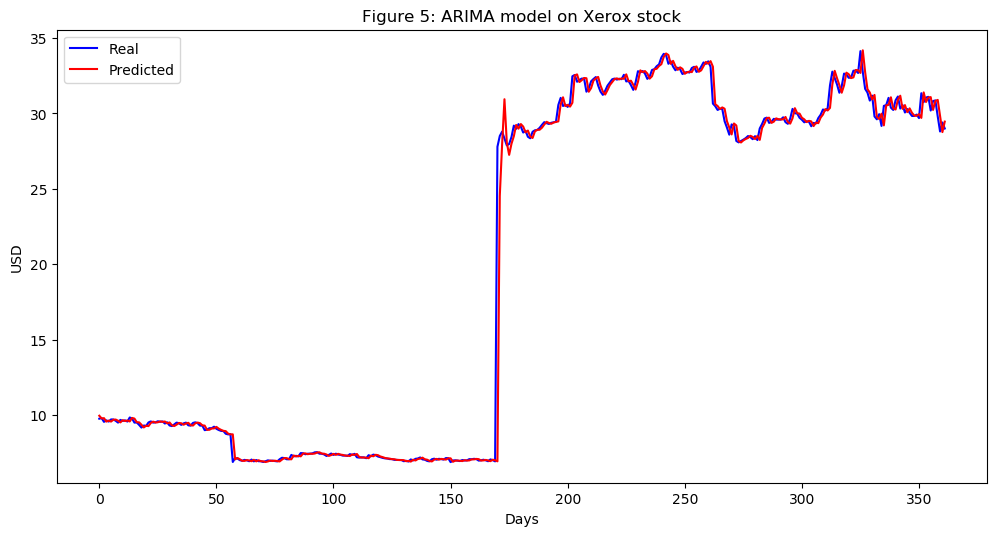

In [388]:
Xerox_series = SP500_TechIndicator['Xerox_Close']
Xerox_series_model = ARIMA(Xerox_series, order=(5, 1, 0))
Xerox_model_fit = Xerox_series_model.fit(disp=0)
print(Xerox_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Xerox_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Xerox_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Xerox_predictions = list()
for t in range(len(test)):
    Xerox_series_model = ARIMA(history, order=(5,1,0))
    Xerox_series_model_fit = Xerox_series_model.fit(disp=0)
    Xerox_output = Xerox_series_model_fit.forecast()
    yhat = Xerox_output[0]
    Xerox_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Xerox_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Xerox_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Xerox stock')
plt.legend()
plt.show()


#predictions
Xerox_predictions = pd.DataFrame({'Xerox_predictions':Xerox_predictions})
#Xerox_predictions.to_csv('Xerox_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Xilinx_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1299.543
Method:                       css-mle   S.D. of innovations              0.824
Date:                Sun, 17 Mar 2019   AIC                           2613.085
Time:                        23:01:56   BIC                           2647.854
Sample:                             1   HQIC                          2626.262
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0247      0.026      0.965      0.335      -0.025       0.075
ar.L1.D.Xilinx_Close    -0.0311      0.031     -1.013      0.311      -0.091       0.029
ar.L2.D.Xili

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


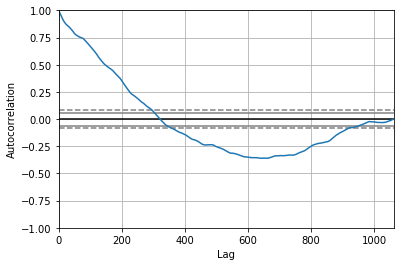

<Figure size 800x560 with 0 Axes>

Test MSE: 0.986


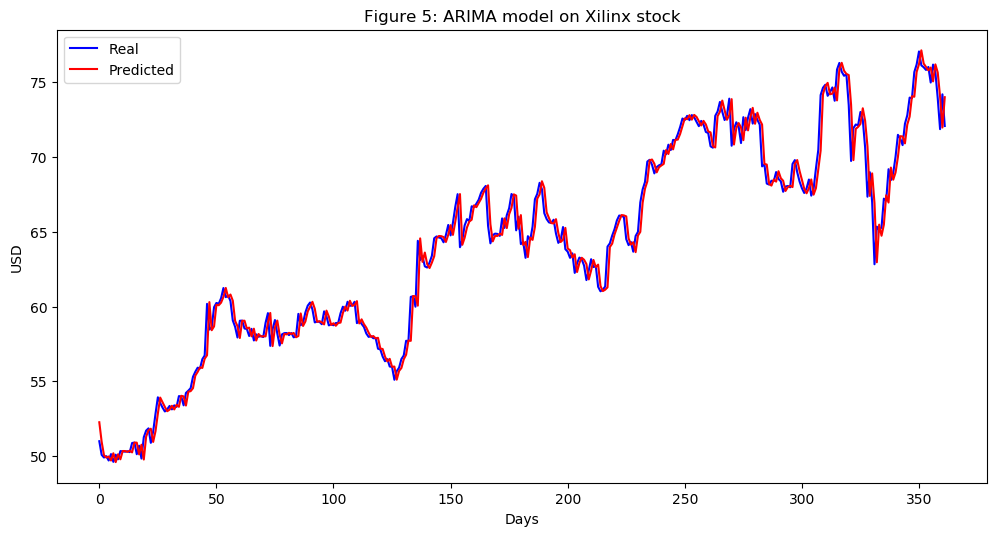

In [389]:
Xilinx_series = SP500_TechIndicator['Xilinx_Close']
Xilinx_series_model = ARIMA(Xilinx_series, order=(5, 1, 0))
Xilinx_model_fit = Xilinx_series_model.fit(disp=0)
print(Xilinx_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Xilinx_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Xilinx_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Xilinx_predictions = list()
for t in range(len(test)):
    Xilinx_series_model = ARIMA(history, order=(5,1,0))
    Xilinx_series_model_fit = Xilinx_series_model.fit(disp=0)
    Xilinx_output = Xilinx_series_model_fit.forecast()
    yhat = Xilinx_output[0]
    Xilinx_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Xilinx_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Xilinx_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Xilinx stock')
plt.legend()
plt.show()


#predictions
Xilinx_predictions = pd.DataFrame({'Xilinx_predictions':Xilinx_predictions})
#Xilinx_predictions.to_csv('Xilinx_predictions.csv')



                                   ARIMA Model Results                                    
Dep. Variable:     D.Air_Products_Chemicals_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -2075.688
Method:                                   css-mle   S.D. of innovations              1.712
Date:                            Sun, 17 Mar 2019   AIC                           4165.376
Time:                                    23:03:08   BIC                           4200.145
Sample:                                         1   HQIC                          4178.552
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0444      0.053    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


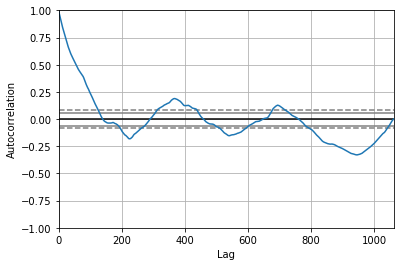

<Figure size 800x560 with 0 Axes>

Test MSE: 2.330


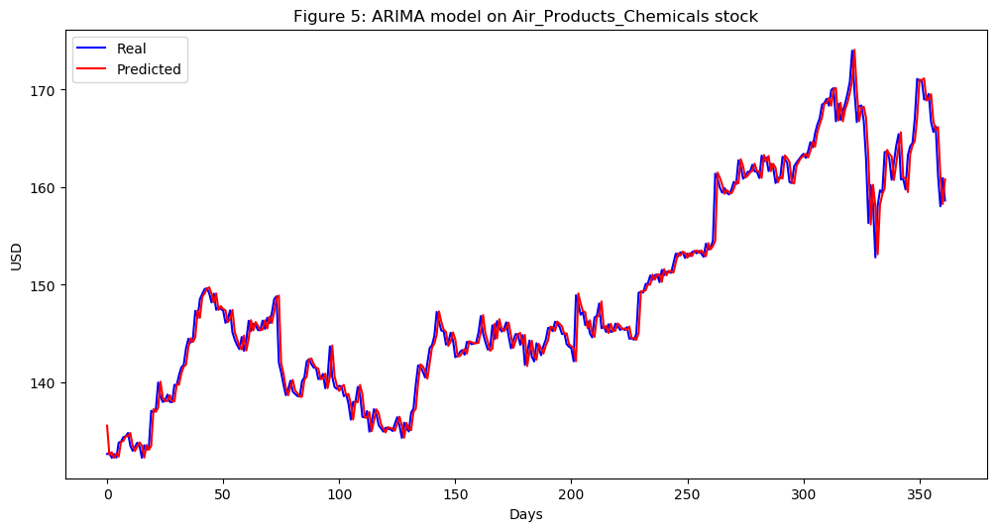

In [390]:
Air_Products_Chemicals_series = SP500_TechIndicator['Air_Products_Chemicals_Close']
Air_Products_Chemicals_series_model = ARIMA(Air_Products_Chemicals_series, order=(5, 1, 0))
Air_Products_Chemicals_model_fit = Air_Products_Chemicals_series_model.fit(disp=0)
print(Air_Products_Chemicals_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Air_Products_Chemicals_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Air_Products_Chemicals_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Air_Products_Chemicals_predictions = list()
for t in range(len(test)):
    Air_Products_Chemicals_series_model = ARIMA(history, order=(5,1,0))
    Air_Products_Chemicals_series_model_fit = Air_Products_Chemicals_series_model.fit(disp=0)
    Air_Products_Chemicals_output = Air_Products_Chemicals_series_model_fit.forecast()
    yhat = Air_Products_Chemicals_output[0]
    Air_Products_Chemicals_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Air_Products_Chemicals_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Air_Products_Chemicals_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Air_Products_Chemicals stock')
plt.legend()
plt.show()


#predictions
Air_Products_Chemicals_predictions = pd.DataFrame({'Air_Products_Chemicals_predictions':Air_Products_Chemicals_predictions})
#Air_Products_Chemicals_predictions.to_csv('Air_Products_Chemicals_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.Albemarle_Corp_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1915.687
Method:                           css-mle   S.D. of innovations              1.472
Date:                    Sun, 17 Mar 2019   AIC                           3845.374
Time:                            23:04:17   BIC                           3880.143
Sample:                                 1   HQIC                          3858.550
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0284      0.046      0.618      0.537      -0.062       0.119
ar.L1.D.Albemarle_Corp_Close     0.0473      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


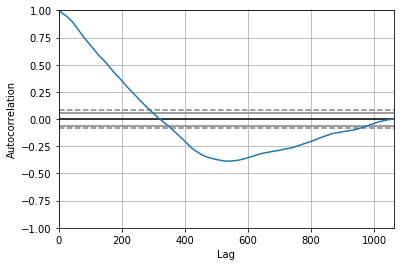

<Figure size 800x560 with 0 Axes>

Test MSE: 4.029


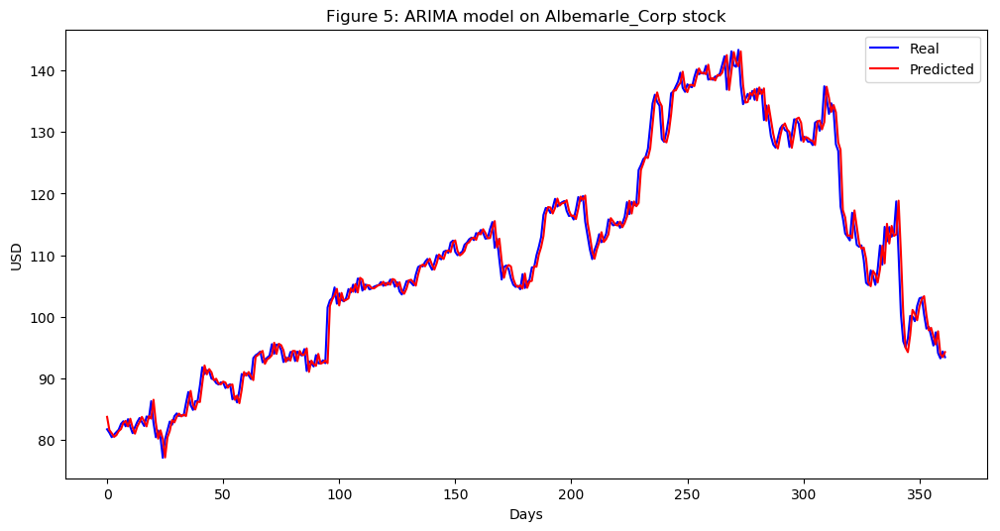

In [391]:
Albemarle_Corp_series = SP500_TechIndicator['Albemarle_Corp_Close']
Albemarle_Corp_series_model = ARIMA(Albemarle_Corp_series, order=(5, 1, 0))
Albemarle_Corp_model_fit = Albemarle_Corp_series_model.fit(disp=0)
print(Albemarle_Corp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Albemarle_Corp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Albemarle_Corp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Albemarle_Corp_predictions = list()
for t in range(len(test)):
    Albemarle_Corp_series_model = ARIMA(history, order=(5,1,0))
    Albemarle_Corp_series_model_fit = Albemarle_Corp_series_model.fit(disp=0)
    Albemarle_Corp_output = Albemarle_Corp_series_model_fit.forecast()
    yhat = Albemarle_Corp_output[0]
    Albemarle_Corp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Albemarle_Corp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Albemarle_Corp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Albemarle_Corp stock')
plt.legend()
plt.show()


#predictions
Albemarle_Corp_predictions = pd.DataFrame({'Albemarle_Corp_predictions':Albemarle_Corp_predictions})
#Albemarle_Corp_predictions.to_csv('Albemarle_Corp_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.Avery_Dennison_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1402.260
Method:                           css-mle   S.D. of innovations              0.907
Date:                    Sun, 17 Mar 2019   AIC                           2818.521
Time:                            23:05:31   BIC                           2853.290
Sample:                                 1   HQIC                          2831.697
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0509      0.026      1.932      0.054      -0.001       0.103
ar.L1.D.Avery_Dennison_Close     0.0030      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


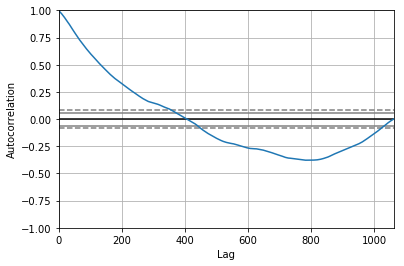

<Figure size 800x560 with 0 Axes>

Test MSE: 1.261


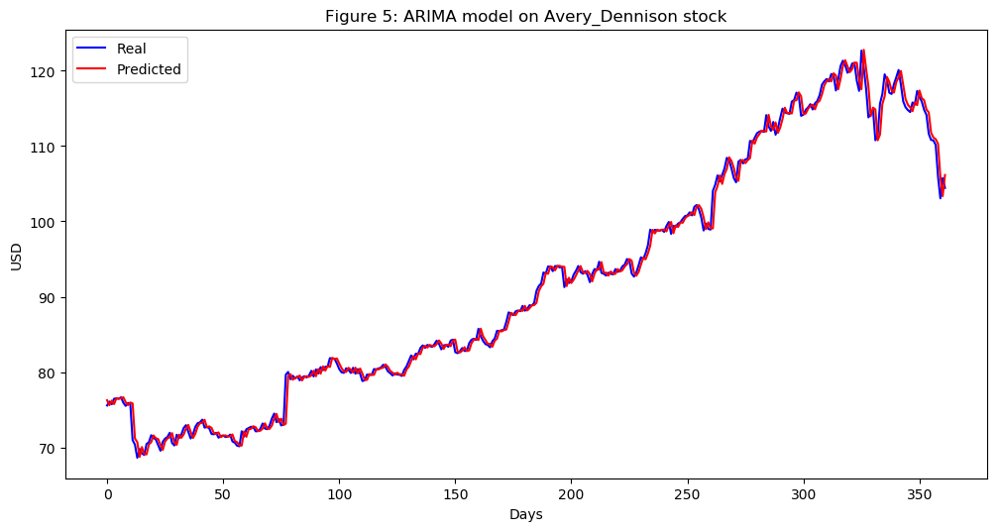

In [392]:
Avery_Dennison_series = SP500_TechIndicator['Avery_Dennison_Close']
Avery_Dennison_series_model = ARIMA(Avery_Dennison_series, order=(5, 1, 0))
Avery_Dennison_model_fit = Avery_Dennison_series_model.fit(disp=0)
print(Avery_Dennison_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Avery_Dennison_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Avery_Dennison_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Avery_Dennison_predictions = list()
for t in range(len(test)):
    Avery_Dennison_series_model = ARIMA(history, order=(5,1,0))
    Avery_Dennison_series_model_fit = Avery_Dennison_series_model.fit(disp=0)
    Avery_Dennison_output = Avery_Dennison_series_model_fit.forecast()
    yhat = Avery_Dennison_output[0]
    Avery_Dennison_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Avery_Dennison_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Avery_Dennison_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Avery_Dennison stock')
plt.legend()
plt.show()


#predictions
Avery_Dennison_predictions = pd.DataFrame({'Avery_Dennison_predictions':Avery_Dennison_predictions})
#Avery_Dennison_predictions.to_csv('Avery_Dennison_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:           D.Ball_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1947.821
Method:                       css-mle   S.D. of innovations              1.517
Date:                Sun, 17 Mar 2019   AIC                           3909.641
Time:                        23:06:37   BIC                           3944.410
Sample:                             1   HQIC                          3922.818
                                                                              
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0118      0.044     -0.267      0.790      -0.098       0.075
ar.L1.D.Ball_Close    -0.0127      0.031     -0.412      0.680      -0.073       0.047
ar.L2.D.Ball_Close  

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


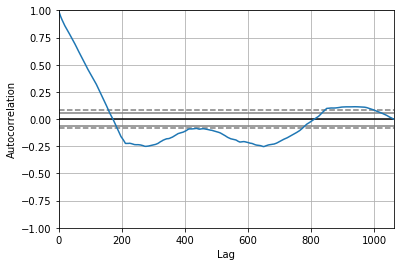

<Figure size 800x560 with 0 Axes>

Test MSE: 5.107


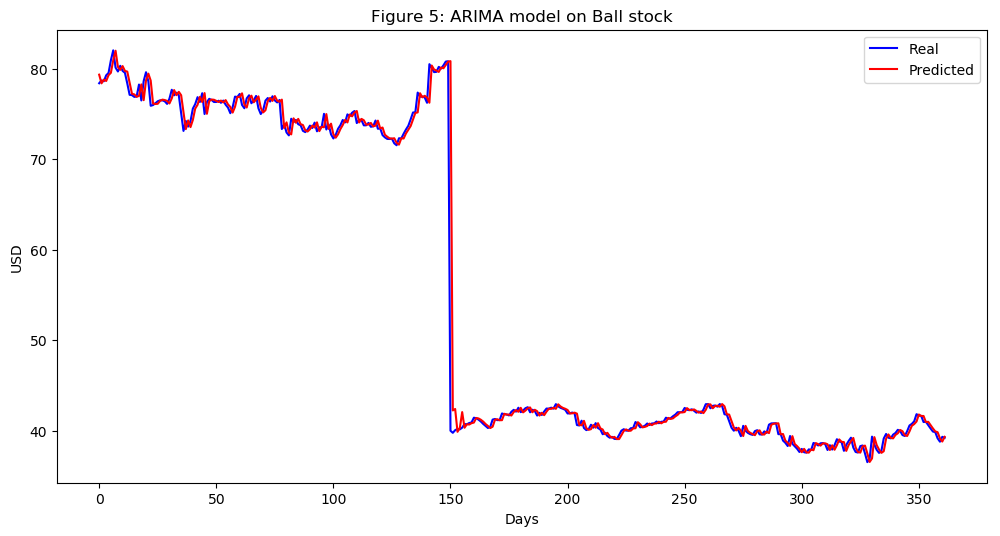

In [393]:
Ball_series = SP500_TechIndicator['Ball_Close']
Ball_series_model = ARIMA(Ball_series, order=(5, 1, 0))
Ball_model_fit = Ball_series_model.fit(disp=0)
print(Ball_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Ball_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Ball_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Ball_predictions = list()
for t in range(len(test)):
    Ball_series_model = ARIMA(history, order=(5,1,0))
    Ball_series_model_fit = Ball_series_model.fit(disp=0)
    Ball_output = Ball_series_model_fit.forecast()
    yhat = Ball_output[0]
    Ball_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Ball_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Ball_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Ball stock')
plt.legend()
plt.show()


#predictions
Ball_predictions = pd.DataFrame({'Ball_predictions':Ball_predictions})
#Ball_predictions.to_csv('Ball_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Celanese_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1605.073
Method:                       css-mle   S.D. of innovations              1.098
Date:                Sun, 17 Mar 2019   AIC                           3224.147
Time:                        23:07:27   BIC                           3258.915
Sample:                             1   HQIC                          3237.323
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0410      0.032      1.274      0.203      -0.022       0.104
ar.L1.D.Celanese_Close    -0.0079      0.031     -0.259      0.796      -0.068       0.052
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


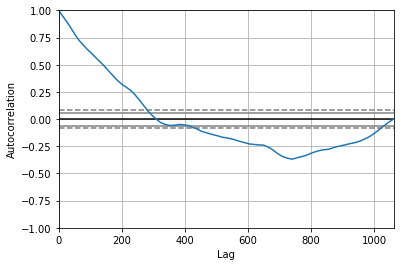

<Figure size 800x560 with 0 Axes>

Test MSE: 1.463


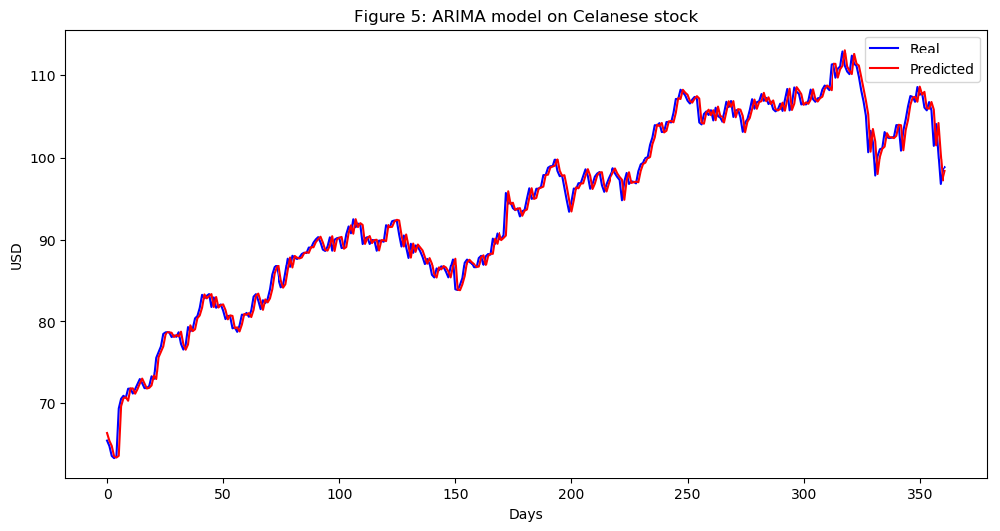

In [394]:
Celanese_series = SP500_TechIndicator['Celanese_Close']
Celanese_series_model = ARIMA(Celanese_series, order=(5, 1, 0))
Celanese_model_fit = Celanese_series_model.fit(disp=0)
print(Celanese_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Celanese_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Celanese_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Celanese_predictions = list()
for t in range(len(test)):
    Celanese_series_model = ARIMA(history, order=(5,1,0))
    Celanese_series_model_fit = Celanese_series_model.fit(disp=0)
    Celanese_output = Celanese_series_model_fit.forecast()
    yhat = Celanese_output[0]
    Celanese_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Celanese_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Celanese_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Celanese stock')
plt.legend()
plt.show()


#predictions
Celanese_predictions = pd.DataFrame({'Celanese_predictions':Celanese_predictions})
#Celanese_predictions.to_csv('Celanese_predictions.csv')



                                   ARIMA Model Results                                    
Dep. Variable:     D.CF_Industries_Holdings_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -3725.270
Method:                                   css-mle   S.D. of innovations              8.102
Date:                            Sun, 17 Mar 2019   AIC                           7464.539
Time:                                    23:08:21   BIC                           7499.308
Sample:                                         1   HQIC                          7477.716
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                   -0.1843      0.252    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


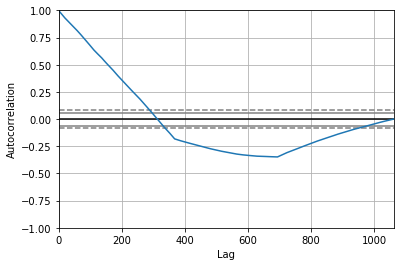

<Figure size 800x560 with 0 Axes>

Test MSE: 0.702


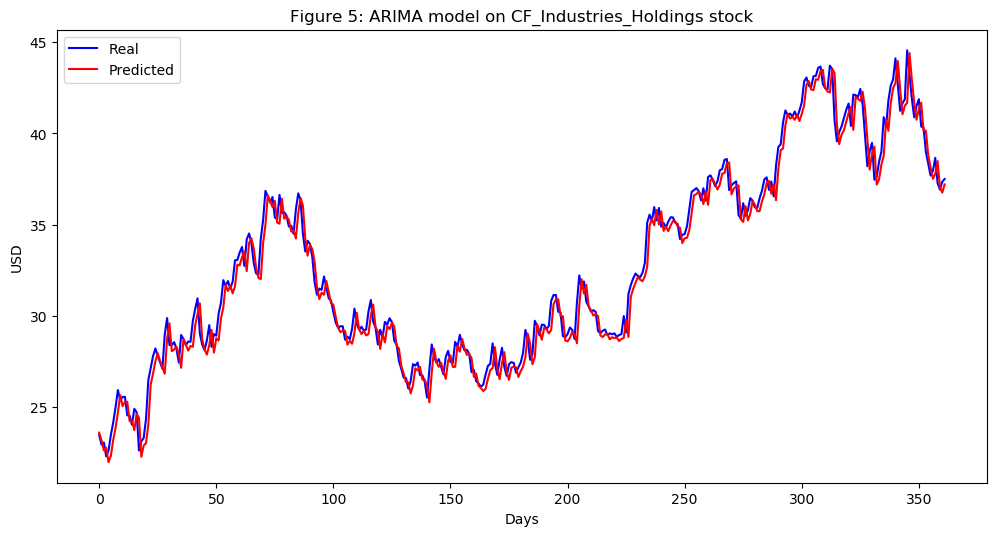

In [395]:
CF_Industries_Holdings_series = SP500_TechIndicator['CF_Industries_Holdings_Close']
CF_Industries_Holdings_series_model = ARIMA(CF_Industries_Holdings_series, order=(5, 1, 0))
CF_Industries_Holdings_model_fit = CF_Industries_Holdings_series_model.fit(disp=0)
print(CF_Industries_Holdings_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(CF_Industries_Holdings_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = CF_Industries_Holdings_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
CF_Industries_Holdings_predictions = list()
for t in range(len(test)):
    CF_Industries_Holdings_series_model = ARIMA(history, order=(5,1,0))
    CF_Industries_Holdings_series_model_fit = CF_Industries_Holdings_series_model.fit(disp=0)
    CF_Industries_Holdings_output = CF_Industries_Holdings_series_model_fit.forecast()
    yhat = CF_Industries_Holdings_output[0]
    CF_Industries_Holdings_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, CF_Industries_Holdings_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(CF_Industries_Holdings_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on CF_Industries_Holdings stock')
plt.legend()
plt.show()


#predictions
CF_Industries_Holdings_predictions = pd.DataFrame({'CF_Industries_Holdings_predictions':CF_Industries_Holdings_predictions})
#CF_Industries_Holdings_predictions.to_csv('CF_Industries_Holdings_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Eastman_Chemical_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -1625.581
Method:                             css-mle   S.D. of innovations              1.120
Date:                      Sun, 17 Mar 2019   AIC                           3265.163
Time:                              23:09:29   BIC                           3299.931
Sample:                                   1   HQIC                          3278.339
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0230      0.033      0.701      0.484      -0.041       0.087
ar.L1.D.Eastman_Chemica

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


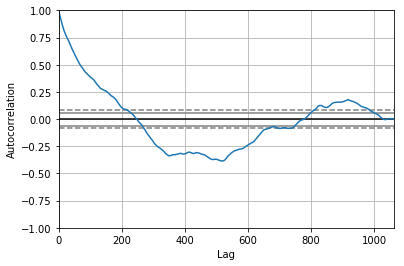

<Figure size 800x560 with 0 Axes>

Test MSE: 1.067


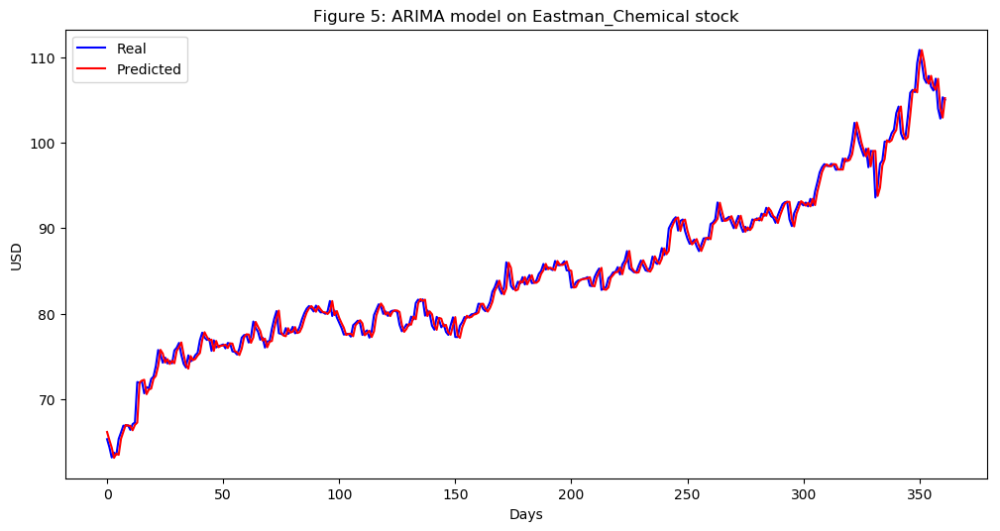

In [396]:
Eastman_Chemical_series = SP500_TechIndicator['Eastman_Chemical_Close']
Eastman_Chemical_series_model = ARIMA(Eastman_Chemical_series, order=(5, 1, 0))
Eastman_Chemical_model_fit = Eastman_Chemical_series_model.fit(disp=0)
print(Eastman_Chemical_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Eastman_Chemical_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Eastman_Chemical_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Eastman_Chemical_predictions = list()
for t in range(len(test)):
    Eastman_Chemical_series_model = ARIMA(history, order=(5,1,0))
    Eastman_Chemical_series_model_fit = Eastman_Chemical_series_model.fit(disp=0)
    Eastman_Chemical_output = Eastman_Chemical_series_model_fit.forecast()
    yhat = Eastman_Chemical_output[0]
    Eastman_Chemical_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Eastman_Chemical_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Eastman_Chemical_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Eastman_Chemical stock')
plt.legend()
plt.show()


#predictions
Eastman_Chemical_predictions = pd.DataFrame({'Eastman_Chemical_predictions':Eastman_Chemical_predictions})
#Eastman_Chemical_predictions.to_csv('Eastman_Chemical_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Ecolab_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1730.884
Method:                       css-mle   S.D. of innovations              1.237
Date:                Sun, 17 Mar 2019   AIC                           3475.769
Time:                        23:10:31   BIC                           3510.537
Sample:                             1   HQIC                          3488.945
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0289      0.033      0.866      0.387      -0.037       0.094
ar.L1.D.Ecolab_Close    -0.0403      0.031     -1.313      0.189      -0.100       0.020
ar.L2.D.Ecol

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


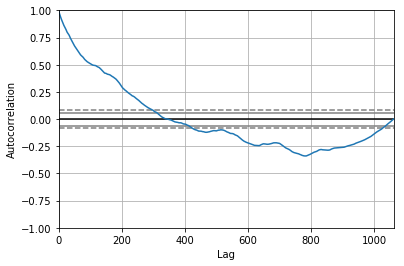

<Figure size 800x560 with 0 Axes>

Test MSE: 1.042


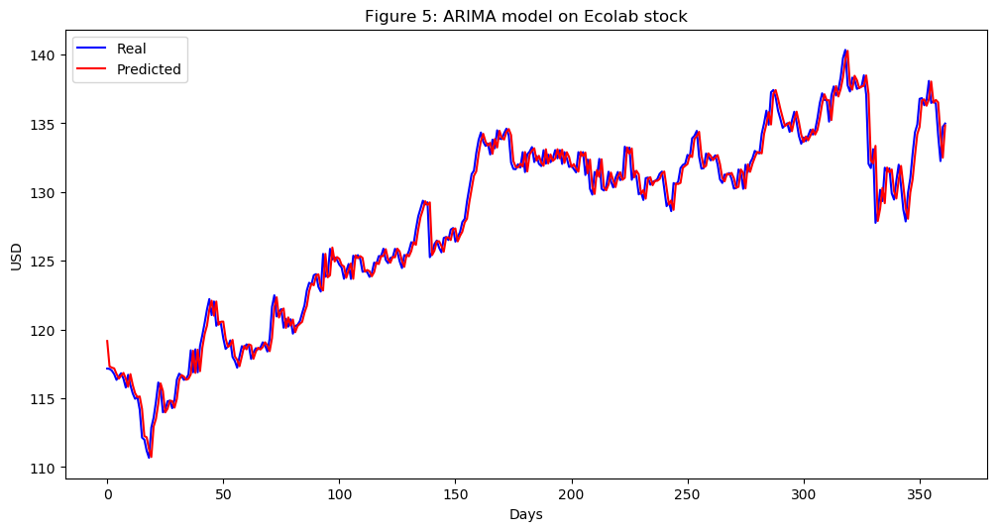

In [397]:
Ecolab_series = SP500_TechIndicator['Ecolab_Close']
Ecolab_series_model = ARIMA(Ecolab_series, order=(5, 1, 0))
Ecolab_model_fit = Ecolab_series_model.fit(disp=0)
print(Ecolab_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Ecolab_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Ecolab_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Ecolab_predictions = list()
for t in range(len(test)):
    Ecolab_series_model = ARIMA(history, order=(5,1,0))
    Ecolab_series_model_fit = Ecolab_series_model.fit(disp=0)
    Ecolab_output = Ecolab_series_model_fit.forecast()
    yhat = Ecolab_output[0]
    Ecolab_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Ecolab_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Ecolab_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Ecolab stock')
plt.legend()
plt.show()


#predictions
Ecolab_predictions = pd.DataFrame({'Ecolab_predictions':Ecolab_predictions})
#Ecolab_predictions.to_csv('Ecolab_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.FMC_Corporation_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1529.669
Method:                            css-mle   S.D. of innovations              1.023
Date:                     Sun, 17 Mar 2019   AIC                           3073.338
Time:                             23:11:34   BIC                           3108.107
Sample:                                  1   HQIC                          3086.514
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                            -0.0003      0.032     -0.009      0.992      -0.063       0.063
ar.L1.D.FMC_Corporation_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


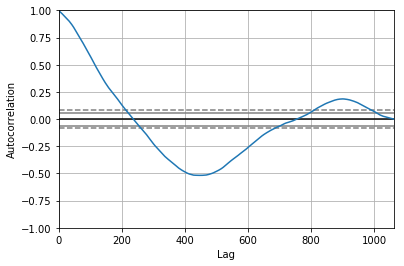

<Figure size 800x560 with 0 Axes>

Test MSE: 1.584


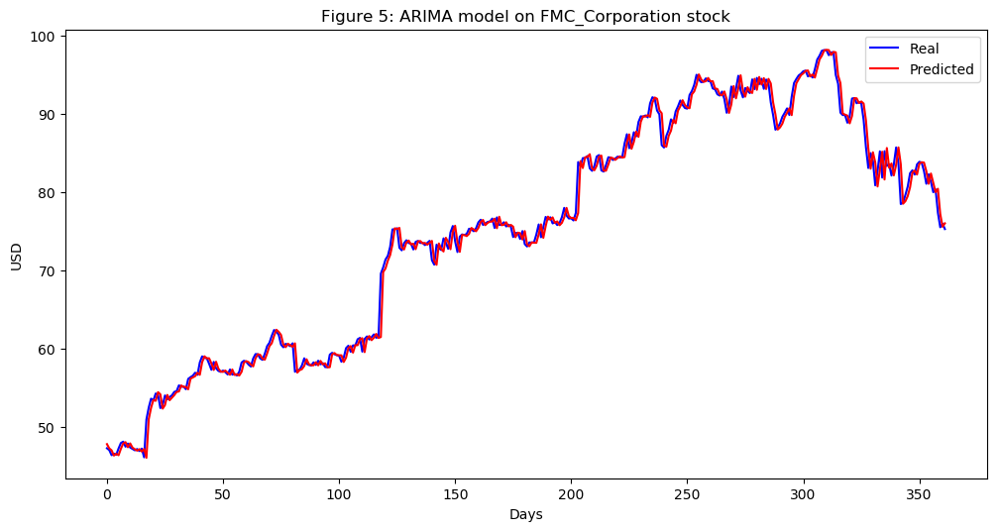

In [398]:
FMC_Corporation_series = SP500_TechIndicator['FMC_Corporation_Close']
FMC_Corporation_series_model = ARIMA(FMC_Corporation_series, order=(5, 1, 0))
FMC_Corporation_model_fit = FMC_Corporation_series_model.fit(disp=0)
print(FMC_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(FMC_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = FMC_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
FMC_Corporation_predictions = list()
for t in range(len(test)):
    FMC_Corporation_series_model = ARIMA(history, order=(5,1,0))
    FMC_Corporation_series_model_fit = FMC_Corporation_series_model.fit(disp=0)
    FMC_Corporation_output = FMC_Corporation_series_model_fit.forecast()
    yhat = FMC_Corporation_output[0]
    FMC_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, FMC_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(FMC_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on FMC_Corporation stock')
plt.legend()
plt.show()


#predictions
FMC_Corporation_predictions = pd.DataFrame({'FMC_Corporation_predictions':FMC_Corporation_predictions})
#FMC_Corporation_predictions.to_csv('FMC_Corporation_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Freeport_McMoRan_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood                -750.923
Method:                             css-mle   S.D. of innovations              0.491
Date:                      Sun, 17 Mar 2019   AIC                           1515.846
Time:                              23:12:27   BIC                           1550.614
Sample:                                   1   HQIC                          1529.022
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                             -0.0192      0.015     -1.256      0.209      -0.049       0.011
ar.L1.D.Freeport_McMoRa

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


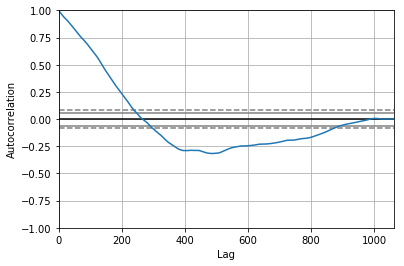

<Figure size 800x560 with 0 Axes>

Test MSE: 0.158


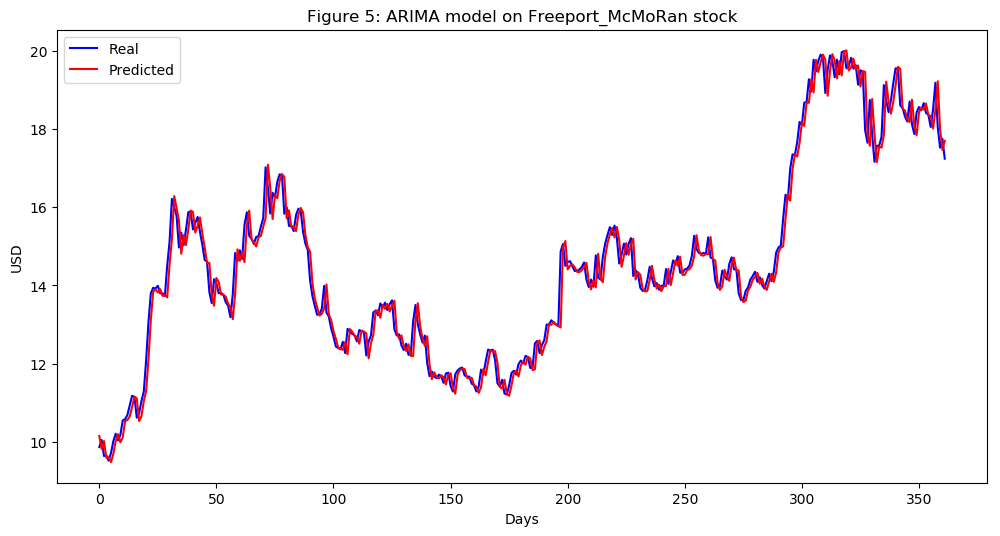

In [399]:
Freeport_McMoRan_series = SP500_TechIndicator['Freeport_McMoRan_Close']
Freeport_McMoRan_series_model = ARIMA(Freeport_McMoRan_series, order=(5, 1, 0))
Freeport_McMoRan_model_fit = Freeport_McMoRan_series_model.fit(disp=0)
print(Freeport_McMoRan_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Freeport_McMoRan_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Freeport_McMoRan_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Freeport_McMoRan_predictions = list()
for t in range(len(test)):
    Freeport_McMoRan_series_model = ARIMA(history, order=(5,1,0))
    Freeport_McMoRan_series_model_fit = Freeport_McMoRan_series_model.fit(disp=0)
    Freeport_McMoRan_output = Freeport_McMoRan_series_model_fit.forecast()
    yhat = Freeport_McMoRan_output[0]
    Freeport_McMoRan_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Freeport_McMoRan_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Freeport_McMoRan_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Freeport_McMoRan stock')
plt.legend()
plt.show()


#predictions
Freeport_McMoRan_predictions = pd.DataFrame({'Freeport_McMoRan_predictions':Freeport_McMoRan_predictions})
#Freeport_McMoRan_predictions.to_csv('Freeport_McMoRan_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.International_Paper_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1087.569
Method:                                css-mle   S.D. of innovations              0.674
Date:                         Sun, 17 Mar 2019   AIC                           2189.138
Time:                                 23:13:49   BIC                           2223.907
Sample:                                      1   HQIC                          2202.315
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0030      0.020      0.148      0.882      -0.037   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


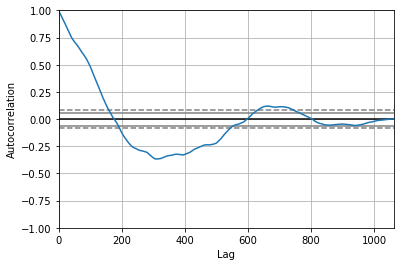

<Figure size 800x560 with 0 Axes>

Test MSE: 0.519


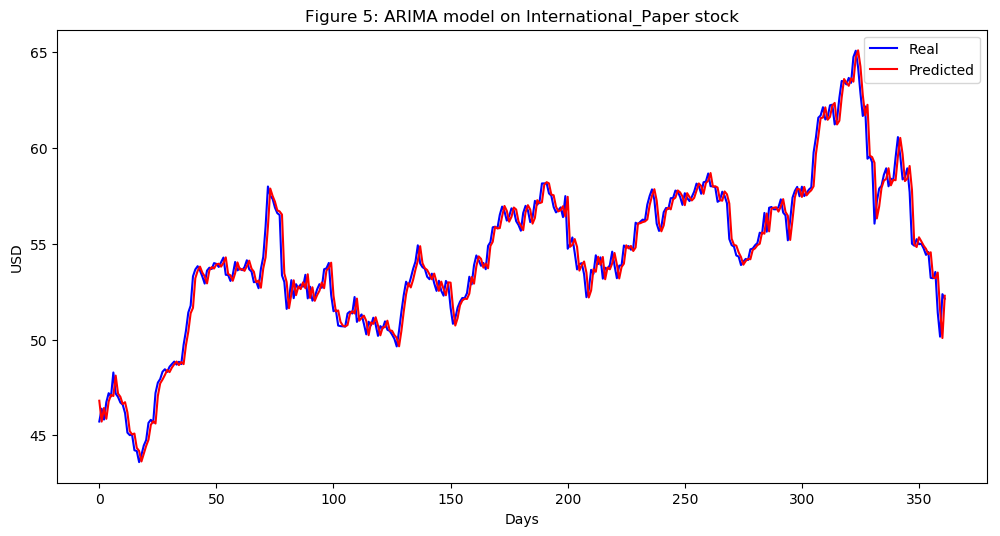

In [400]:
International_Paper_series = SP500_TechIndicator['International_Paper_Close']
International_Paper_series_model = ARIMA(International_Paper_series, order=(5, 1, 0))
International_Paper_model_fit = International_Paper_series_model.fit(disp=0)
print(International_Paper_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(International_Paper_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = International_Paper_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
International_Paper_predictions = list()
for t in range(len(test)):
    International_Paper_series_model = ARIMA(history, order=(5,1,0))
    International_Paper_series_model_fit = International_Paper_series_model.fit(disp=0)
    International_Paper_output = International_Paper_series_model_fit.forecast()
    yhat = International_Paper_output[0]
    International_Paper_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, International_Paper_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(International_Paper_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on International_Paper stock')
plt.legend()
plt.show()


#predictions
International_Paper_predictions = pd.DataFrame({'International_Paper_predictions':International_Paper_predictions})
#International_Paper_predictions.to_csv('International_Paper_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.LyondellBasell_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1988.011
Method:                           css-mle   S.D. of innovations              1.576
Date:                    Sun, 17 Mar 2019   AIC                           3990.022
Time:                            23:14:56   BIC                           4024.790
Sample:                                 1   HQIC                          4003.198
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0230      0.043      0.540      0.589      -0.061       0.107
ar.L1.D.LyondellBasell_Close     0.0069      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


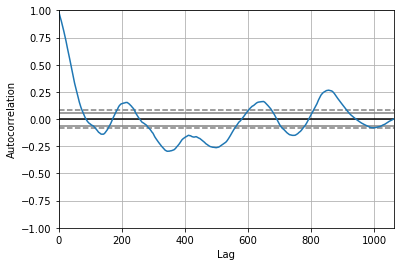

<Figure size 800x560 with 0 Axes>

Test MSE: 1.879


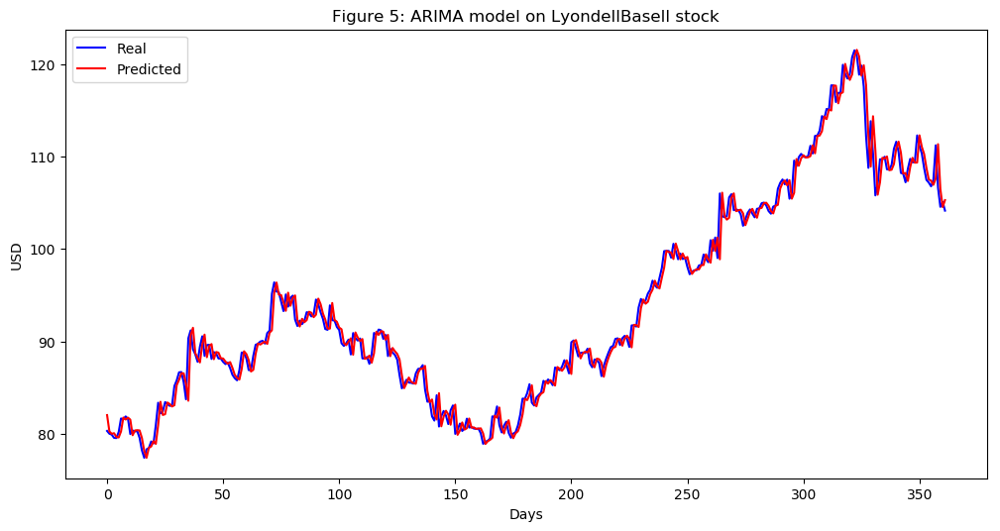

In [401]:
LyondellBasell_series = SP500_TechIndicator['LyondellBasell_Close']
LyondellBasell_series_model = ARIMA(LyondellBasell_series, order=(5, 1, 0))
LyondellBasell_model_fit = LyondellBasell_series_model.fit(disp=0)
print(LyondellBasell_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(LyondellBasell_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = LyondellBasell_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
LyondellBasell_predictions = list()
for t in range(len(test)):
    LyondellBasell_series_model = ARIMA(history, order=(5,1,0))
    LyondellBasell_series_model_fit = LyondellBasell_series_model.fit(disp=0)
    LyondellBasell_output = LyondellBasell_series_model_fit.forecast()
    yhat = LyondellBasell_output[0]
    LyondellBasell_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, LyondellBasell_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(LyondellBasell_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on LyondellBasell stock')
plt.legend()
plt.show()


#predictions
LyondellBasell_predictions = pd.DataFrame({'LyondellBasell_predictions':LyondellBasell_predictions})
#LyondellBasell_predictions.to_csv('LyondellBasell_predictions.csv')



                                     ARIMA Model Results                                     
Dep. Variable:     D.Martin_Marietta_Materials_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood               -2704.966
Method:                                      css-mle   S.D. of innovations              3.097
Date:                               Sun, 17 Mar 2019   AIC                           5423.932
Time:                                       23:15:49   BIC                           5458.701
Sample:                                            1   HQIC                          5437.109
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


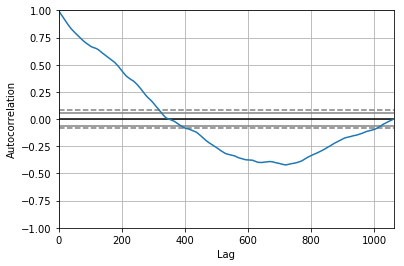

<Figure size 800x560 with 0 Axes>

Test MSE: 14.670


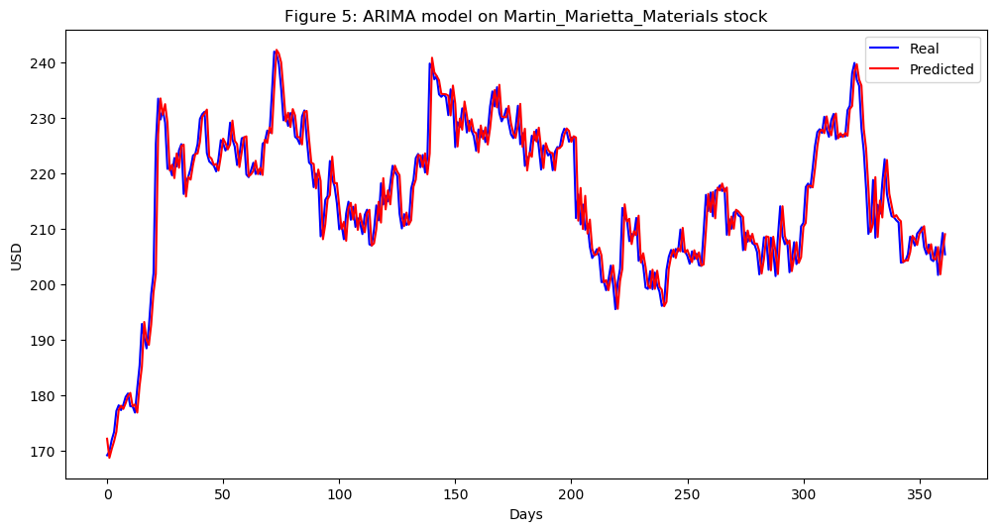

In [402]:
Martin_Marietta_Materials_series = SP500_TechIndicator['Martin_Marietta_Materials_Close']
Martin_Marietta_Materials_series_model = ARIMA(Martin_Marietta_Materials_series, order=(5, 1, 0))
Martin_Marietta_Materials_model_fit = Martin_Marietta_Materials_series_model.fit(disp=0)
print(Martin_Marietta_Materials_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Martin_Marietta_Materials_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Martin_Marietta_Materials_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Martin_Marietta_Materials_predictions = list()
for t in range(len(test)):
    Martin_Marietta_Materials_series_model = ARIMA(history, order=(5,1,0))
    Martin_Marietta_Materials_series_model_fit = Martin_Marietta_Materials_series_model.fit(disp=0)
    Martin_Marietta_Materials_output = Martin_Marietta_Materials_series_model_fit.forecast()
    yhat = Martin_Marietta_Materials_output[0]
    Martin_Marietta_Materials_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Martin_Marietta_Materials_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Martin_Marietta_Materials_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Martin_Marietta_Materials stock')
plt.legend()
plt.show()


#predictions
Martin_Marietta_Materials_predictions = pd.DataFrame({'Martin_Marietta_Materials_predictions':Martin_Marietta_Materials_predictions})
#Martin_Marietta_Materials_predictions.to_csv('Martin_Marietta_Materials_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.The_Mosaic_Company_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1012.067
Method:                               css-mle   S.D. of innovations              0.628
Date:                        Sun, 17 Mar 2019   AIC                           2038.134
Time:                                23:16:37   BIC                           2072.903
Sample:                                     1   HQIC                          2051.311
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -0.0218      0.020     -1.112      0.266      -0.060       0.017
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


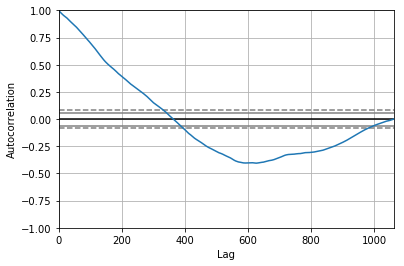

<Figure size 800x560 with 0 Axes>

Test MSE: 0.298


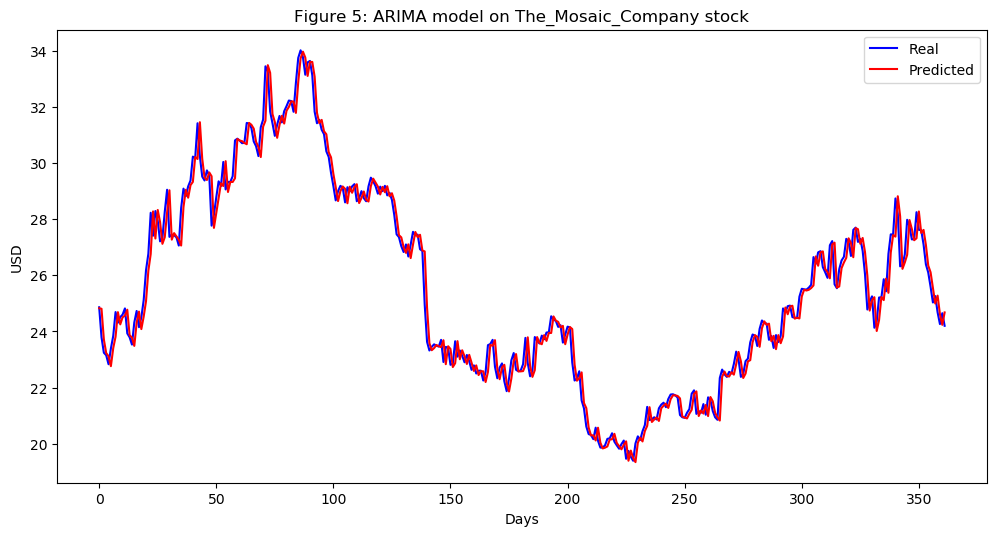

In [403]:
The_Mosaic_Company_series = SP500_TechIndicator['The_Mosaic_Company_Close']
The_Mosaic_Company_series_model = ARIMA(The_Mosaic_Company_series, order=(5, 1, 0))
The_Mosaic_Company_model_fit = The_Mosaic_Company_series_model.fit(disp=0)
print(The_Mosaic_Company_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(The_Mosaic_Company_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = The_Mosaic_Company_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
The_Mosaic_Company_predictions = list()
for t in range(len(test)):
    The_Mosaic_Company_series_model = ARIMA(history, order=(5,1,0))
    The_Mosaic_Company_series_model_fit = The_Mosaic_Company_series_model.fit(disp=0)
    The_Mosaic_Company_output = The_Mosaic_Company_series_model_fit.forecast()
    yhat = The_Mosaic_Company_output[0]
    The_Mosaic_Company_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, The_Mosaic_Company_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(The_Mosaic_Company_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on The_Mosaic_Company stock')
plt.legend()
plt.show()


#predictions
The_Mosaic_Company_predictions = pd.DataFrame({'The_Mosaic_Company_predictions':The_Mosaic_Company_predictions})
#The_Mosaic_Company_predictions.to_csv('The_Mosaic_Company_predictions.csv')



                                     ARIMA Model Results                                      
Dep. Variable:     D.Newmont_Mining_Corporation_Close   No. Observations:                 1061
Model:                                 ARIMA(5, 1, 0)   Log Likelihood               -1096.857
Method:                                       css-mle   S.D. of innovations              0.680
Date:                                Sun, 17 Mar 2019   AIC                           2207.714
Time:                                        23:17:39   BIC                           2242.483
Sample:                                             1   HQIC                          2220.891
                                                                                              
                                               coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------
const                 

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


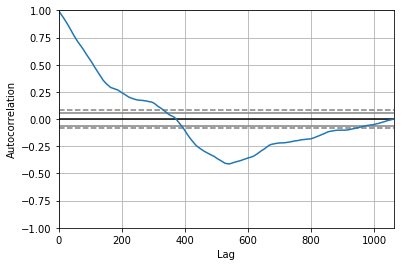

<Figure size 800x560 with 0 Axes>

Test MSE: 0.438


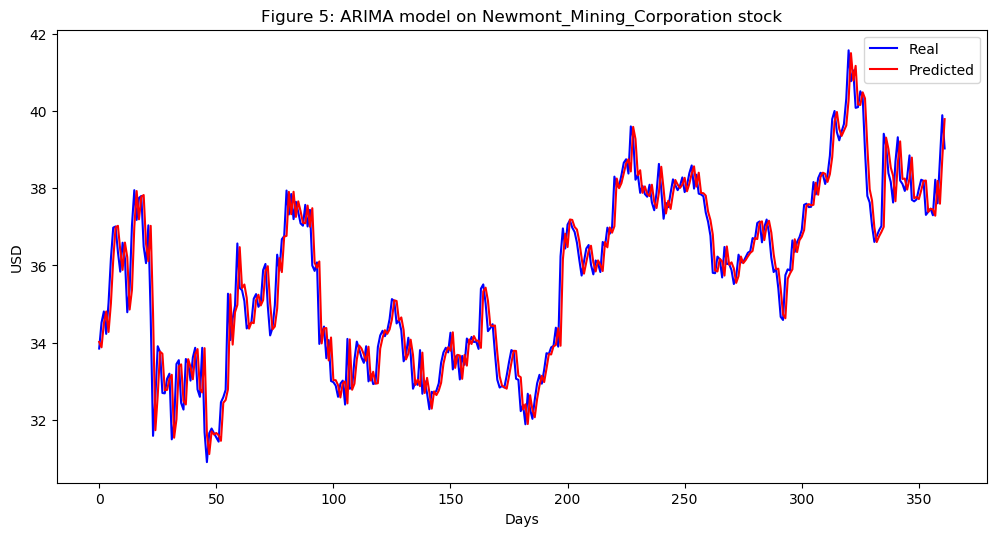

In [404]:
Newmont_Mining_Corporation_series = SP500_TechIndicator['Newmont_Mining_Corporation_Close']
Newmont_Mining_Corporation_series_model = ARIMA(Newmont_Mining_Corporation_series, order=(5, 1, 0))
Newmont_Mining_Corporation_model_fit = Newmont_Mining_Corporation_series_model.fit(disp=0)
print(Newmont_Mining_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Newmont_Mining_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Newmont_Mining_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Newmont_Mining_Corporation_predictions = list()
for t in range(len(test)):
    Newmont_Mining_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Newmont_Mining_Corporation_series_model_fit = Newmont_Mining_Corporation_series_model.fit(disp=0)
    Newmont_Mining_Corporation_output = Newmont_Mining_Corporation_series_model_fit.forecast()
    yhat = Newmont_Mining_Corporation_output[0]
    Newmont_Mining_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Newmont_Mining_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Newmont_Mining_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Newmont_Mining_Corporation stock')
plt.legend()
plt.show()


#predictions
Newmont_Mining_Corporation_predictions = pd.DataFrame({'Newmont_Mining_Corporation_predictions':Newmont_Mining_Corporation_predictions})
#Newmont_Mining_Corporation_predictions.to_csv('Newmont_Mining_Corporation_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:          D.Nucor_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1363.823
Method:                       css-mle   S.D. of innovations              0.875
Date:                Sun, 17 Mar 2019   AIC                           2741.645
Time:                        23:18:47   BIC                           2776.414
Sample:                             1   HQIC                          2754.822
                                                                              
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   0.0066      0.027      0.245      0.807      -0.046       0.060
ar.L1.D.Nucor_Close    -0.0144      0.031     -0.471      0.637      -0.074       0.046
ar.L2.D.Nucor_Cl

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


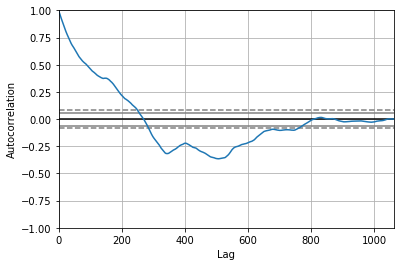

<Figure size 800x560 with 0 Axes>

Test MSE: 1.169


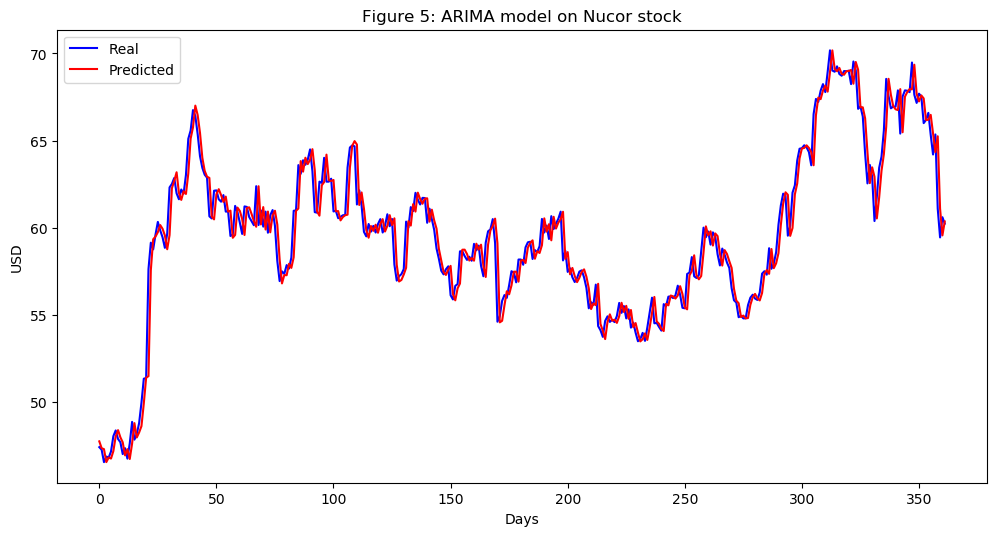

In [405]:
Nucor_series = SP500_TechIndicator['Nucor_Close']
Nucor_series_model = ARIMA(Nucor_series, order=(5, 1, 0))
Nucor_model_fit = Nucor_series_model.fit(disp=0)
print(Nucor_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Nucor_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Nucor_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Nucor_predictions = list()
for t in range(len(test)):
    Nucor_series_model = ARIMA(history, order=(5,1,0))
    Nucor_series_model_fit = Nucor_series_model.fit(disp=0)
    Nucor_output = Nucor_series_model_fit.forecast()
    yhat = Nucor_output[0]
    Nucor_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Nucor_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Nucor_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Nucor stock')
plt.legend()
plt.show()


#predictions
Nucor_predictions = pd.DataFrame({'Nucor_predictions':Nucor_predictions})
#Nucor_predictions.to_csv('Nucor_predictions.csv')



                                        ARIMA Model Results                                         
Dep. Variable:     D.Packaging_Corporation_of_America_Close   No. Observations:                 1061
Model:                                       ARIMA(5, 1, 0)   Log Likelihood               -1725.961
Method:                                             css-mle   S.D. of innovations              1.231
Date:                                      Sun, 17 Mar 2019   AIC                           3465.922
Time:                                              23:19:46   BIC                           3500.690
Sample:                                                   1   HQIC                          3479.098
                                                                                                    
                                                     coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


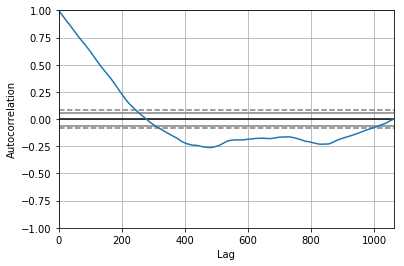

<Figure size 800x560 with 0 Axes>

Test MSE: 1.911


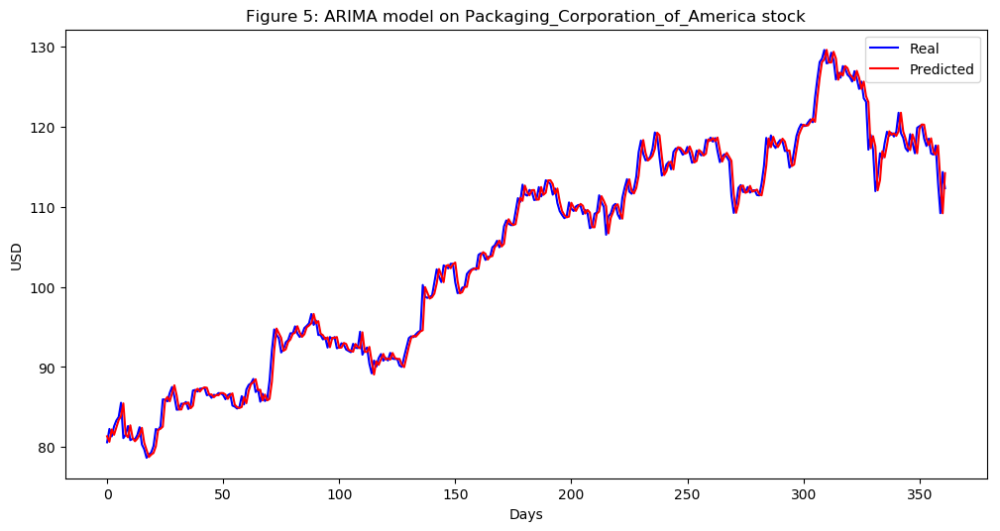

In [406]:
Packaging_Corporation_of_America_series = SP500_TechIndicator['Packaging_Corporation_of_America_Close']
Packaging_Corporation_of_America_series_model = ARIMA(Packaging_Corporation_of_America_series, order=(5, 1, 0))
Packaging_Corporation_of_America_model_fit = Packaging_Corporation_of_America_series_model.fit(disp=0)
print(Packaging_Corporation_of_America_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Packaging_Corporation_of_America_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Packaging_Corporation_of_America_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Packaging_Corporation_of_America_predictions = list()
for t in range(len(test)):
    Packaging_Corporation_of_America_series_model = ARIMA(history, order=(5,1,0))
    Packaging_Corporation_of_America_series_model_fit = Packaging_Corporation_of_America_series_model.fit(disp=0)
    Packaging_Corporation_of_America_output = Packaging_Corporation_of_America_series_model_fit.forecast()
    yhat = Packaging_Corporation_of_America_output[0]
    Packaging_Corporation_of_America_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Packaging_Corporation_of_America_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Packaging_Corporation_of_America_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Packaging_Corporation_of_America stock')
plt.legend()
plt.show()


#predictions
Packaging_Corporation_of_America_predictions = pd.DataFrame({'Packaging_Corporation_of_America_predictions':Packaging_Corporation_of_America_predictions})
#Packaging_Corporation_of_America_predictions.to_csv('Packaging_Corporation_of_America_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:     D.Sealed_Air_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1041.213
Method:                       css-mle   S.D. of innovations              0.646
Date:                Sun, 17 Mar 2019   AIC                           2096.426
Time:                        23:20:42   BIC                           2131.195
Sample:                             1   HQIC                          2109.603
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0076      0.020      0.390      0.697      -0.031       0.046
ar.L1.D.Sealed_Air_Close    -0.0544      0.031     -1.775      0.076      -0.115       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


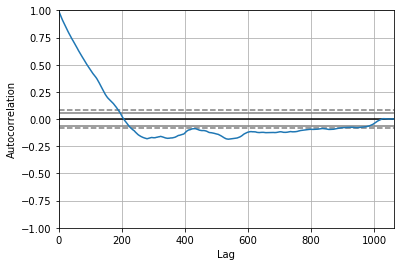

<Figure size 800x560 with 0 Axes>

Test MSE: 0.323


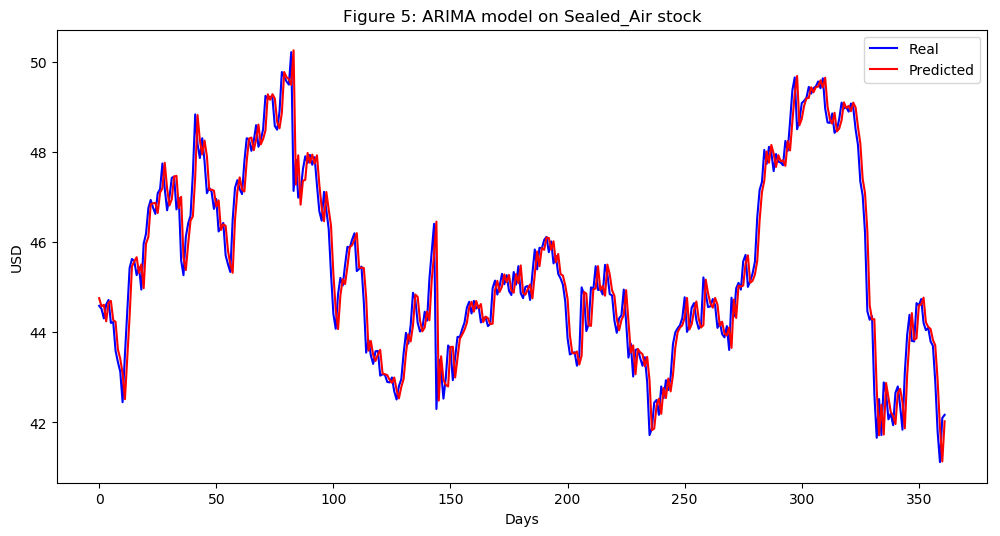

In [407]:
Sealed_Air_series = SP500_TechIndicator['Sealed_Air_Close']
Sealed_Air_series_model = ARIMA(Sealed_Air_series, order=(5, 1, 0))
Sealed_Air_model_fit = Sealed_Air_series_model.fit(disp=0)
print(Sealed_Air_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Sealed_Air_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Sealed_Air_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Sealed_Air_predictions = list()
for t in range(len(test)):
    Sealed_Air_series_model = ARIMA(history, order=(5,1,0))
    Sealed_Air_series_model_fit = Sealed_Air_series_model.fit(disp=0)
    Sealed_Air_output = Sealed_Air_series_model_fit.forecast()
    yhat = Sealed_Air_output[0]
    Sealed_Air_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Sealed_Air_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Sealed_Air_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Sealed_Air stock')
plt.legend()
plt.show()


#predictions
Sealed_Air_predictions = pd.DataFrame({'Sealed_Air_predictions':Sealed_Air_predictions})
#Sealed_Air_predictions.to_csv('Sealed_Air_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Sherwin_Williams_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -2885.943
Method:                             css-mle   S.D. of innovations              3.673
Date:                      Sun, 17 Mar 2019   AIC                           5785.886
Time:                              23:21:41   BIC                           5820.655
Sample:                                   1   HQIC                          5799.063
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.1955      0.106      1.842      0.066      -0.013       0.404
ar.L1.D.Sherwin_William

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


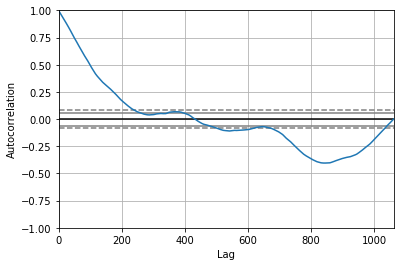

<Figure size 800x560 with 0 Axes>

Test MSE: 18.000


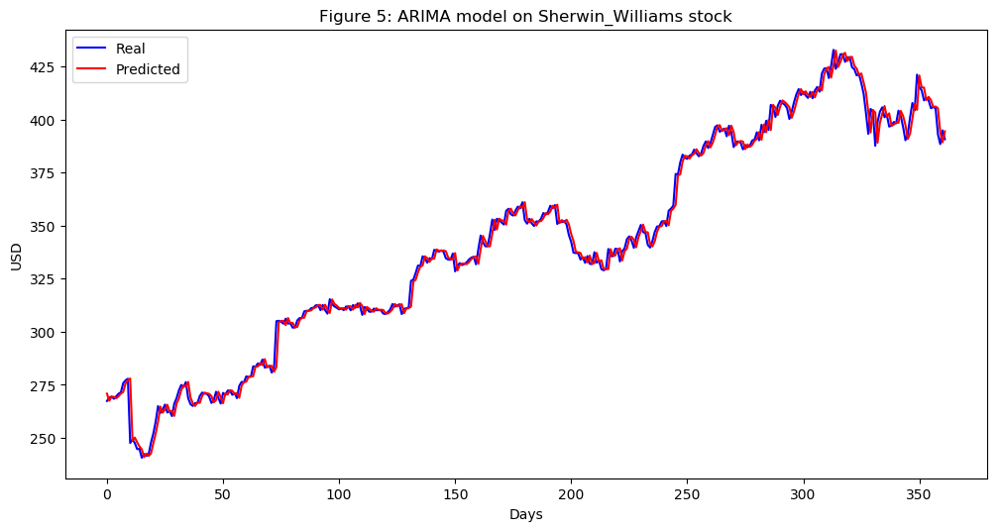

In [408]:
Sherwin_Williams_series = SP500_TechIndicator['Sherwin_Williams_Close']
Sherwin_Williams_series_model = ARIMA(Sherwin_Williams_series, order=(5, 1, 0))
Sherwin_Williams_model_fit = Sherwin_Williams_series_model.fit(disp=0)
print(Sherwin_Williams_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Sherwin_Williams_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Sherwin_Williams_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Sherwin_Williams_predictions = list()
for t in range(len(test)):
    Sherwin_Williams_series_model = ARIMA(history, order=(5,1,0))
    Sherwin_Williams_series_model_fit = Sherwin_Williams_series_model.fit(disp=0)
    Sherwin_Williams_output = Sherwin_Williams_series_model_fit.forecast()
    yhat = Sherwin_Williams_output[0]
    Sherwin_Williams_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Sherwin_Williams_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Sherwin_Williams_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Sherwin_Williams stock')
plt.legend()
plt.show()


#predictions
Sherwin_Williams_predictions = pd.DataFrame({'Sherwin_Williams_predictions':Sherwin_Williams_predictions})
#Sherwin_Williams_predictions.to_csv('Sherwin_Williams_predictions.csv')



                                ARIMA Model Results                                 
Dep. Variable:     D.Vulcan_Materials_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood               -2060.644
Method:                             css-mle   S.D. of innovations              1.687
Date:                      Sun, 17 Mar 2019   AIC                           4135.288
Time:                              23:22:32   BIC                           4170.056
Sample:                                   1   HQIC                          4148.464
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0523      0.048      1.091      0.275      -0.042       0.146
ar.L1.D.Vulcan_Material

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


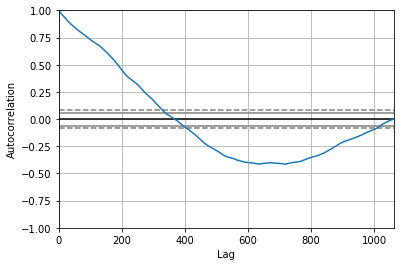

<Figure size 800x560 with 0 Axes>

Test MSE: 4.523


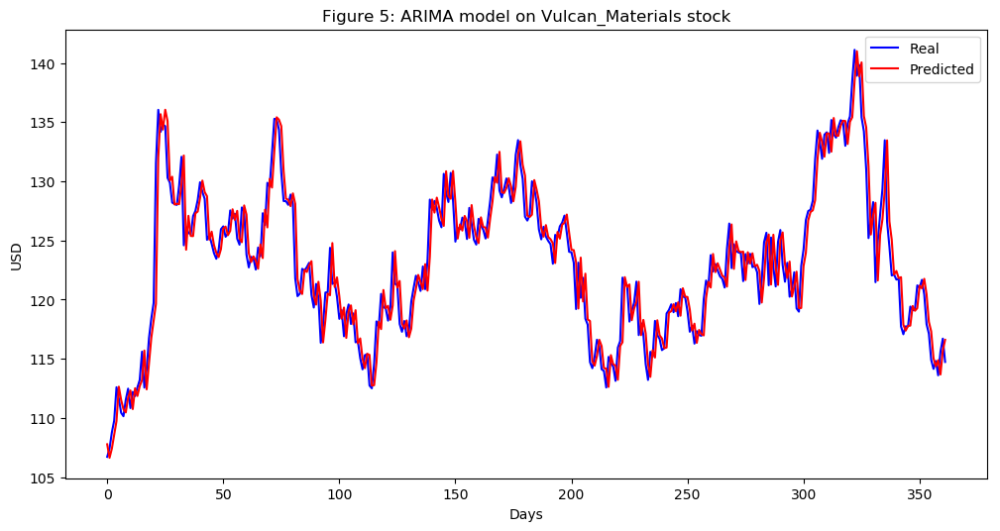

In [409]:
Vulcan_Materials_series = SP500_TechIndicator['Vulcan_Materials_Close']
Vulcan_Materials_series_model = ARIMA(Vulcan_Materials_series, order=(5, 1, 0))
Vulcan_Materials_model_fit = Vulcan_Materials_series_model.fit(disp=0)
print(Vulcan_Materials_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Vulcan_Materials_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Vulcan_Materials_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Vulcan_Materials_predictions = list()
for t in range(len(test)):
    Vulcan_Materials_series_model = ARIMA(history, order=(5,1,0))
    Vulcan_Materials_series_model_fit = Vulcan_Materials_series_model.fit(disp=0)
    Vulcan_Materials_output = Vulcan_Materials_series_model_fit.forecast()
    yhat = Vulcan_Materials_output[0]
    Vulcan_Materials_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Vulcan_Materials_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Vulcan_Materials_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Vulcan_Materials stock')
plt.legend()
plt.show()


#predictions
Vulcan_Materials_predictions = pd.DataFrame({'Vulcan_Materials_predictions':Vulcan_Materials_predictions})
#Vulcan_Materials_predictions.to_csv('Vulcan_Materials_predictions.csv')



                                        ARIMA Model Results                                        
Dep. Variable:     D.Alexandria_Real_Estate_Equities_Close   No. Observations:                 1061
Model:                                      ARIMA(5, 1, 0)   Log Likelihood               -1619.445
Method:                                            css-mle   S.D. of innovations              1.113
Date:                                     Sun, 17 Mar 2019   AIC                           3252.890
Time:                                             23:23:17   BIC                           3287.659
Sample:                                                  1   HQIC                          3266.067
                                                                                                   
                                                    coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


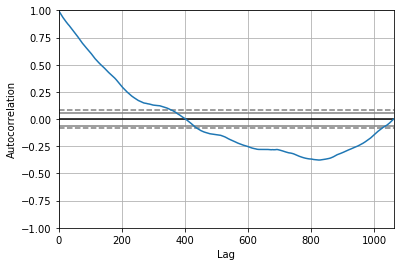

<Figure size 800x560 with 0 Axes>

Test MSE: 1.546


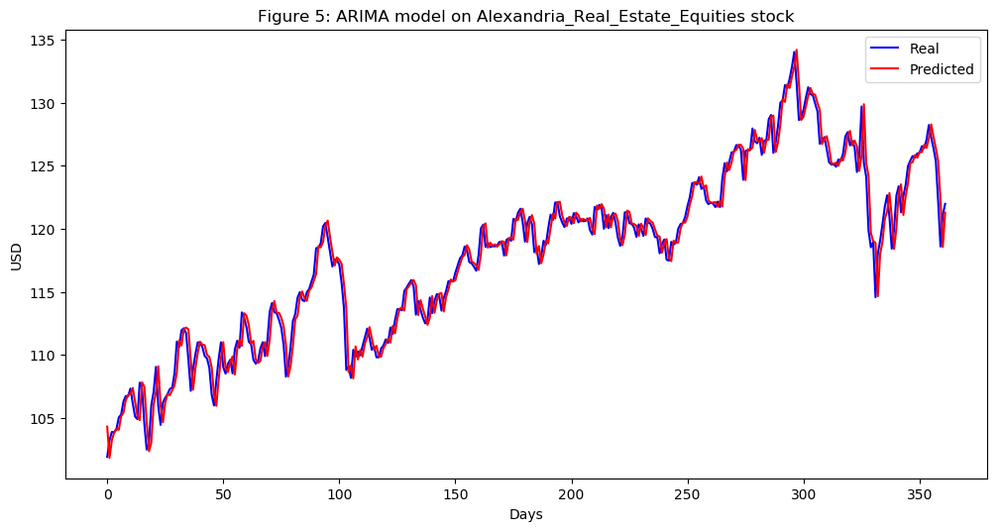

In [410]:
Alexandria_Real_Estate_Equities_series = SP500_TechIndicator['Alexandria_Real_Estate_Equities_Close']
Alexandria_Real_Estate_Equities_series_model = ARIMA(Alexandria_Real_Estate_Equities_series, order=(5, 1, 0))
Alexandria_Real_Estate_Equities_model_fit = Alexandria_Real_Estate_Equities_series_model.fit(disp=0)
print(Alexandria_Real_Estate_Equities_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Alexandria_Real_Estate_Equities_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Alexandria_Real_Estate_Equities_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Alexandria_Real_Estate_Equities_predictions = list()
for t in range(len(test)):
    Alexandria_Real_Estate_Equities_series_model = ARIMA(history, order=(5,1,0))
    Alexandria_Real_Estate_Equities_series_model_fit = Alexandria_Real_Estate_Equities_series_model.fit(disp=0)
    Alexandria_Real_Estate_Equities_output = Alexandria_Real_Estate_Equities_series_model_fit.forecast()
    yhat = Alexandria_Real_Estate_Equities_output[0]
    Alexandria_Real_Estate_Equities_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Alexandria_Real_Estate_Equities_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Alexandria_Real_Estate_Equities_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alexandria_Real_Estate_Equities stock')
plt.legend()
plt.show()


#predictions
Alexandria_Real_Estate_Equities_predictions = pd.DataFrame({'Alexandria_Real_Estate_Equities_predictions':Alexandria_Real_Estate_Equities_predictions})
#Alexandria_Real_Estate_Equities_predictions.to_csv('Alexandria_Real_Estate_Equities_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.American_Tower_Corp_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1758.247
Method:                                css-mle   S.D. of innovations              1.269
Date:                         Sun, 17 Mar 2019   AIC                           3530.494
Time:                                 23:24:15   BIC                           3565.263
Sample:                                      1   HQIC                          3543.671
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0608      0.038      1.594      0.111      -0.014   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


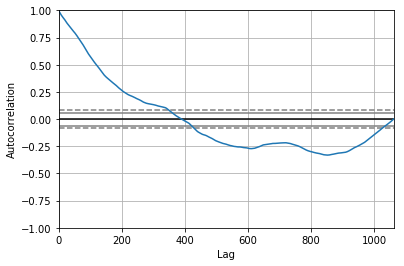

<Figure size 800x560 with 0 Axes>

Test MSE: 2.351


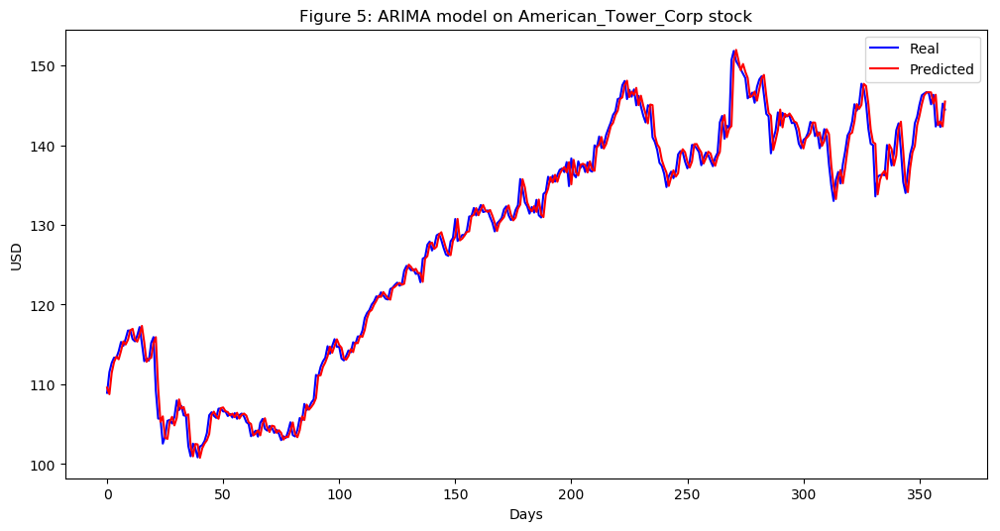

In [411]:
American_Tower_Corp_series = SP500_TechIndicator['American_Tower_Corp_Close']
American_Tower_Corp_series_model = ARIMA(American_Tower_Corp_series, order=(5, 1, 0))
American_Tower_Corp_model_fit = American_Tower_Corp_series_model.fit(disp=0)
print(American_Tower_Corp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(American_Tower_Corp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = American_Tower_Corp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
American_Tower_Corp_predictions = list()
for t in range(len(test)):
    American_Tower_Corp_series_model = ARIMA(history, order=(5,1,0))
    American_Tower_Corp_series_model_fit = American_Tower_Corp_series_model.fit(disp=0)
    American_Tower_Corp_output = American_Tower_Corp_series_model_fit.forecast()
    yhat = American_Tower_Corp_output[0]
    American_Tower_Corp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, American_Tower_Corp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(American_Tower_Corp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on American_Tower_Corp stock')
plt.legend()
plt.show()


#predictions
American_Tower_Corp_predictions = pd.DataFrame({'American_Tower_Corp_predictions':American_Tower_Corp_predictions})
#American_Tower_Corp_predictions.to_csv('American_Tower_Corp_predictions.csv')



                                        ARIMA Model Results                                        
Dep. Variable:     D.Apartment_Investment_Management_Close   No. Observations:                 1061
Model:                                      ARIMA(5, 1, 0)   Log Likelihood                -700.194
Method:                                            css-mle   S.D. of innovations              0.468
Date:                                     Sun, 17 Mar 2019   AIC                           1414.387
Time:                                             23:25:14   BIC                           1449.156
Sample:                                                  1   HQIC                          1427.564
                                                                                                   
                                                    coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


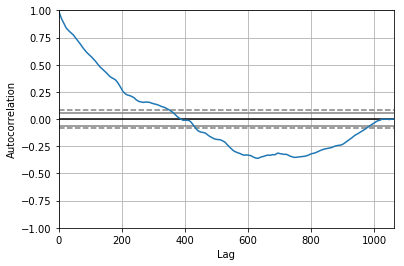

<Figure size 800x560 with 0 Axes>

Test MSE: 0.198


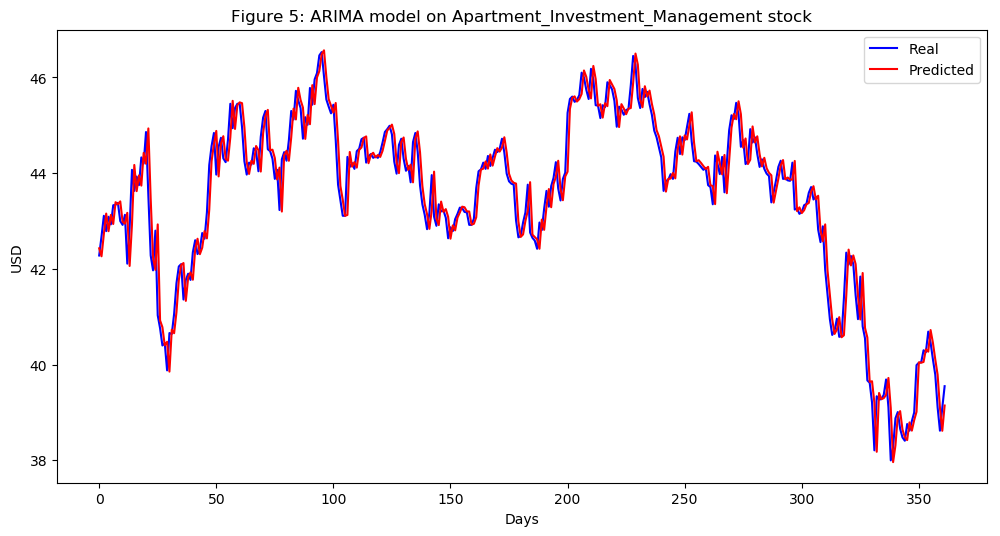

In [412]:
Apartment_Investment_Management_series = SP500_TechIndicator['Apartment_Investment_Management_Close']
Apartment_Investment_Management_series_model = ARIMA(Apartment_Investment_Management_series, order=(5, 1, 0))
Apartment_Investment_Management_model_fit = Apartment_Investment_Management_series_model.fit(disp=0)
print(Apartment_Investment_Management_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Apartment_Investment_Management_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Apartment_Investment_Management_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Apartment_Investment_Management_predictions = list()
for t in range(len(test)):
    Apartment_Investment_Management_series_model = ARIMA(history, order=(5,1,0))
    Apartment_Investment_Management_series_model_fit = Apartment_Investment_Management_series_model.fit(disp=0)
    Apartment_Investment_Management_output = Apartment_Investment_Management_series_model_fit.forecast()
    yhat = Apartment_Investment_Management_output[0]
    Apartment_Investment_Management_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Apartment_Investment_Management_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Apartment_Investment_Management_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Apartment_Investment_Management stock')
plt.legend()
plt.show()


#predictions
Apartment_Investment_Management_predictions = pd.DataFrame({'Apartment_Investment_Management_predictions':Apartment_Investment_Management_predictions})
#Apartment_Investment_Management_predictions.to_csv('Apartment_Investment_Management_predictions.csv')



                                   ARIMA Model Results                                   
Dep. Variable:     D.AvalonBay_Communities_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood               -2135.655
Method:                                  css-mle   S.D. of innovations              1.811
Date:                           Sun, 17 Mar 2019   AIC                           4285.310
Time:                                   23:26:10   BIC                           4320.078
Sample:                                        1   HQIC                          4298.486
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                   0.0399      0.053      0.753    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


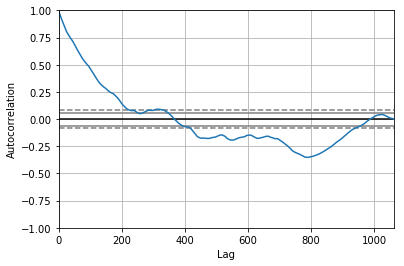

<Figure size 800x560 with 0 Axes>

Test MSE: 2.864


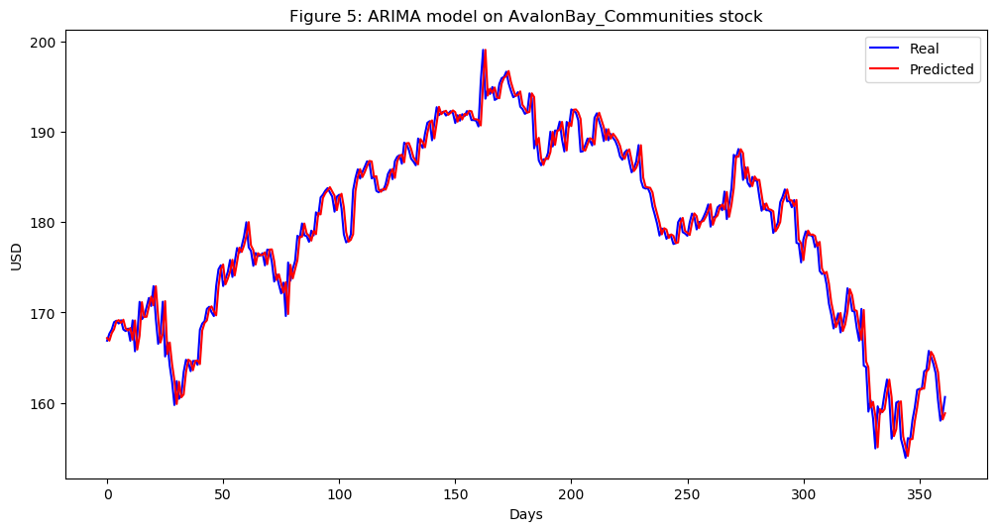

In [413]:
AvalonBay_Communities_series = SP500_TechIndicator['AvalonBay_Communities_Close']
AvalonBay_Communities_series_model = ARIMA(AvalonBay_Communities_series, order=(5, 1, 0))
AvalonBay_Communities_model_fit = AvalonBay_Communities_series_model.fit(disp=0)
print(AvalonBay_Communities_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(AvalonBay_Communities_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = AvalonBay_Communities_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
AvalonBay_Communities_predictions = list()
for t in range(len(test)):
    AvalonBay_Communities_series_model = ARIMA(history, order=(5,1,0))
    AvalonBay_Communities_series_model_fit = AvalonBay_Communities_series_model.fit(disp=0)
    AvalonBay_Communities_output = AvalonBay_Communities_series_model_fit.forecast()
    yhat = AvalonBay_Communities_output[0]
    AvalonBay_Communities_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, AvalonBay_Communities_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(AvalonBay_Communities_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on AvalonBay_Communities stock')
plt.legend()
plt.show()


#predictions
AvalonBay_Communities_predictions = pd.DataFrame({'AvalonBay_Communities_predictions':AvalonBay_Communities_predictions})
#AvalonBay_Communities_predictions.to_csv('AvalonBay_Communities_predictions.csv')



                                 ARIMA Model Results                                 
Dep. Variable:     D.Boston_Properties_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood               -1883.733
Method:                              css-mle   S.D. of innovations              1.428
Date:                       Sun, 17 Mar 2019   AIC                           3781.465
Time:                               23:26:55   BIC                           3816.234
Sample:                                    1   HQIC                          3794.642
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0192      0.041      0.473      0.637      -0.060       0.099
ar.L1.D.Bost

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


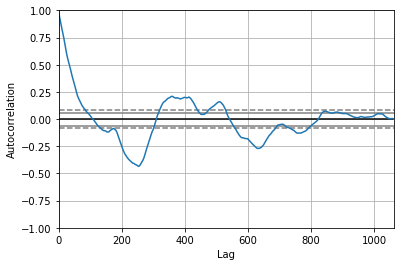

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 2.057


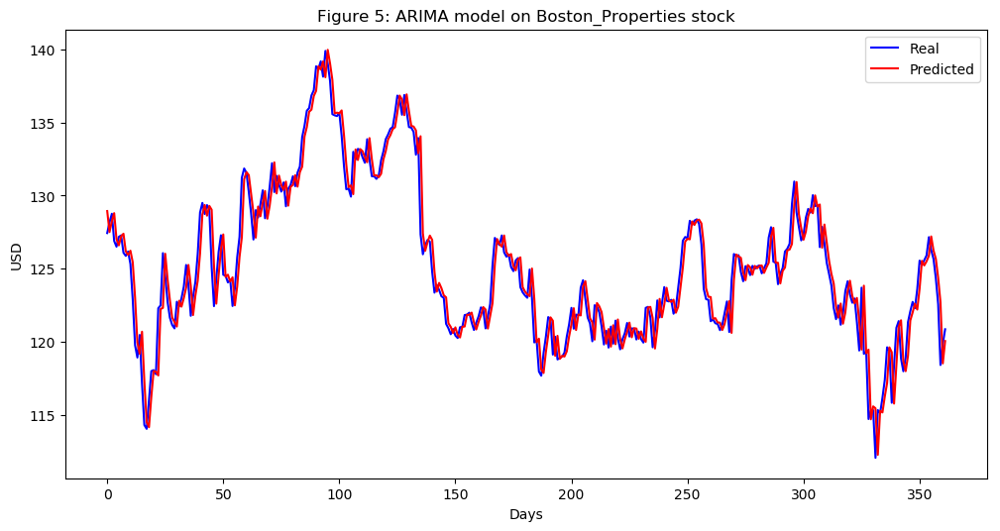

In [414]:
Boston_Properties_series = SP500_TechIndicator['Boston_Properties_Close']
Boston_Properties_series_model = ARIMA(Boston_Properties_series, order=(5, 1, 0))
Boston_Properties_model_fit = Boston_Properties_series_model.fit(disp=0)
print(Boston_Properties_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Boston_Properties_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Boston_Properties_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Boston_Properties_predictions = list()
for t in range(len(test)):
    Boston_Properties_series_model = ARIMA(history, order=(5,1,0))
    Boston_Properties_series_model_fit = Boston_Properties_series_model.fit(disp=0)
    Boston_Properties_output = Boston_Properties_series_model_fit.forecast()
    yhat = Boston_Properties_output[0]
    Boston_Properties_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Boston_Properties_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Boston_Properties_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Boston_Properties stock')
plt.legend()
plt.show()


#predictions
Boston_Properties_predictions = pd.DataFrame({'Boston_Properties_predictions':Boston_Properties_predictions})
#Boston_Properties_predictions.to_csv('Boston_Properties_predictions.csv')



                                     ARIMA Model Results                                      
Dep. Variable:     D.Crown_Castle_International_Close   No. Observations:                 1061
Model:                                 ARIMA(5, 1, 0)   Log Likelihood               -1491.614
Method:                                       css-mle   S.D. of innovations              0.987
Date:                                Sun, 17 Mar 2019   AIC                           2997.229
Time:                                        23:27:45   BIC                           3031.998
Sample:                                             1   HQIC                          3010.405
                                                                                              
                                               coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------
const                 

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


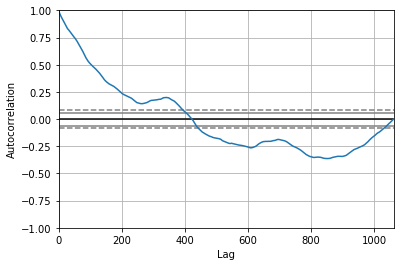

<Figure size 800x560 with 0 Axes>

Test MSE: 1.323


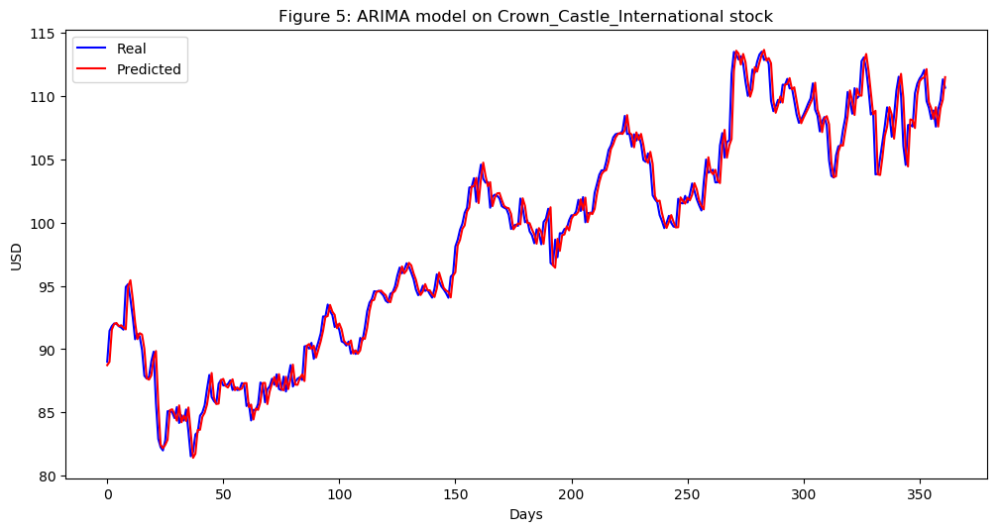

In [415]:
Crown_Castle_International_series = SP500_TechIndicator['Crown_Castle_International_Close']
Crown_Castle_International_series_model = ARIMA(Crown_Castle_International_series, order=(5, 1, 0))
Crown_Castle_International_model_fit = Crown_Castle_International_series_model.fit(disp=0)
print(Crown_Castle_International_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Crown_Castle_International_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Crown_Castle_International_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Crown_Castle_International_predictions = list()
for t in range(len(test)):
    Crown_Castle_International_series_model = ARIMA(history, order=(5,1,0))
    Crown_Castle_International_series_model_fit = Crown_Castle_International_series_model.fit(disp=0)
    Crown_Castle_International_output = Crown_Castle_International_series_model_fit.forecast()
    yhat = Crown_Castle_International_output[0]
    Crown_Castle_International_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Crown_Castle_International_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Crown_Castle_International_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Crown_Castle_International stock')
plt.legend()
plt.show()


#predictions
Crown_Castle_International_predictions = pd.DataFrame({'Crown_Castle_International_predictions':Crown_Castle_International_predictions})
#Crown_Castle_International_predictions.to_csv('Crown_Castle_International_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Digital_Realty_Trust_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -1700.379
Method:                                 css-mle   S.D. of innovations              1.202
Date:                          Sun, 17 Mar 2019   AIC                           3414.757
Time:                                  23:28:47   BIC                           3449.526
Sample:                                       1   HQIC                          3427.934
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0505      0.033      1.509      0.132    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


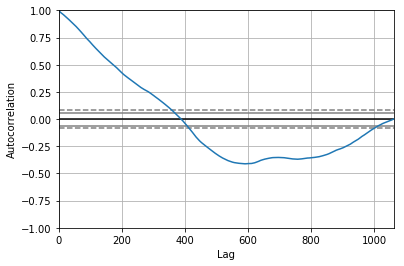

<Figure size 800x560 with 0 Axes>

Test MSE: 2.491


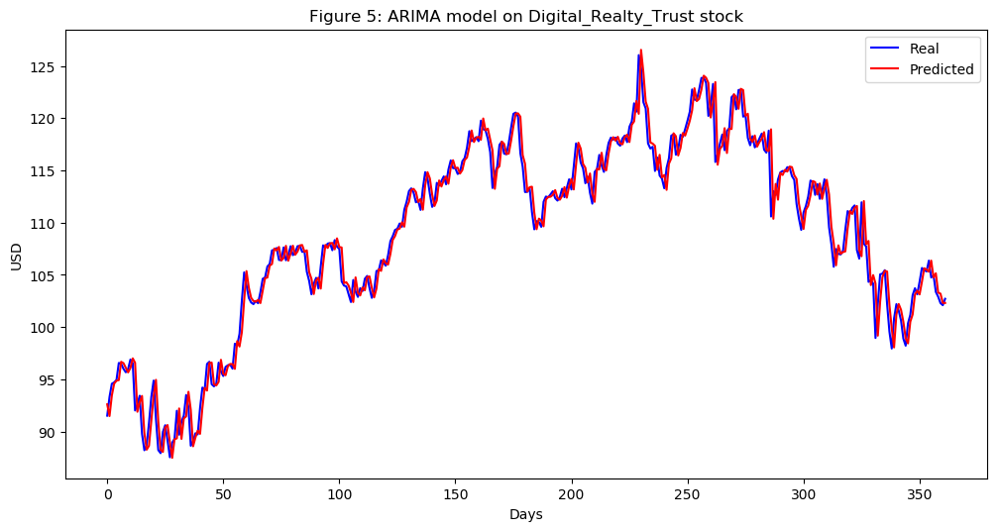

In [416]:
Digital_Realty_Trust_series = SP500_TechIndicator['Digital_Realty_Trust_Close']
Digital_Realty_Trust_series_model = ARIMA(Digital_Realty_Trust_series, order=(5, 1, 0))
Digital_Realty_Trust_model_fit = Digital_Realty_Trust_series_model.fit(disp=0)
print(Digital_Realty_Trust_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Digital_Realty_Trust_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Digital_Realty_Trust_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Digital_Realty_Trust_predictions = list()
for t in range(len(test)):
    Digital_Realty_Trust_series_model = ARIMA(history, order=(5,1,0))
    Digital_Realty_Trust_series_model_fit = Digital_Realty_Trust_series_model.fit(disp=0)
    Digital_Realty_Trust_output = Digital_Realty_Trust_series_model_fit.forecast()
    yhat = Digital_Realty_Trust_output[0]
    Digital_Realty_Trust_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Digital_Realty_Trust_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Digital_Realty_Trust_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Digital_Realty_Trust stock')
plt.legend()
plt.show()


#predictions
Digital_Realty_Trust_predictions = pd.DataFrame({'Digital_Realty_Trust_predictions':Digital_Realty_Trust_predictions})
#Digital_Realty_Trust_predictions.to_csv('Digital_Realty_Trust_predictions.csv')



                              ARIMA Model Results                              
Dep. Variable:     D.Duke_Realty_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood                 -86.556
Method:                        css-mle   S.D. of innovations              0.263
Date:                 Sun, 17 Mar 2019   AIC                            187.112
Time:                         23:29:41   BIC                            221.881
Sample:                              1   HQIC                           200.289
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0103      0.008      1.350      0.177      -0.005       0.025
ar.L1.D.Duke_Realty_Close     0.0274      0.031      0.890      0.374      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


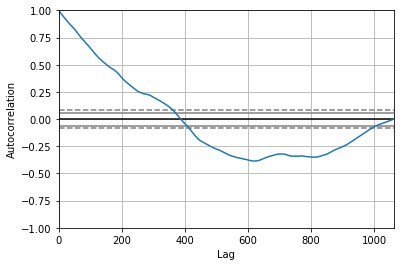

<Figure size 800x560 with 0 Axes>

Test MSE: 0.089


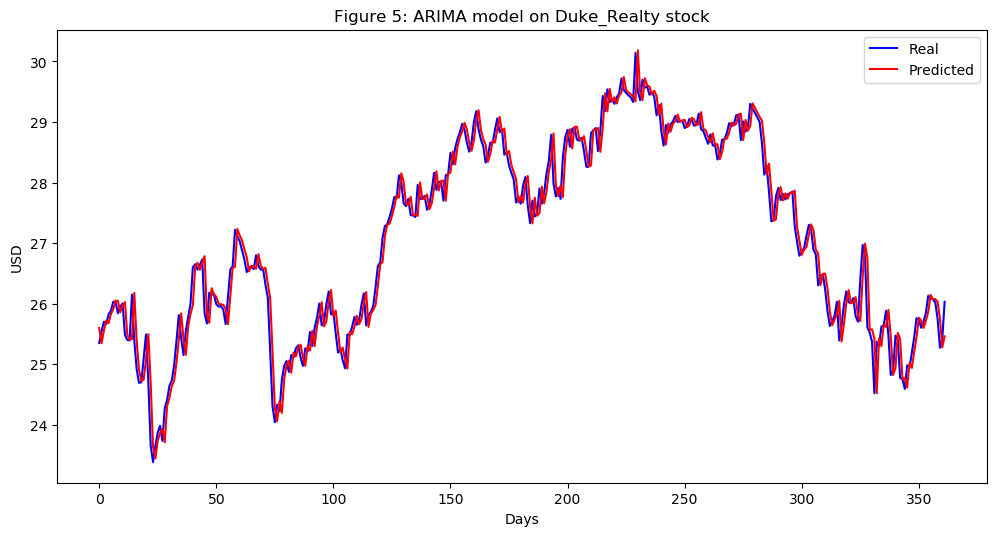

In [417]:
Duke_Realty_series = SP500_TechIndicator['Duke_Realty_Close']
Duke_Realty_series_model = ARIMA(Duke_Realty_series, order=(5, 1, 0))
Duke_Realty_model_fit = Duke_Realty_series_model.fit(disp=0)
print(Duke_Realty_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Duke_Realty_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Duke_Realty_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Duke_Realty_predictions = list()
for t in range(len(test)):
    Duke_Realty_series_model = ARIMA(history, order=(5,1,0))
    Duke_Realty_series_model_fit = Duke_Realty_series_model.fit(disp=0)
    Duke_Realty_output = Duke_Realty_series_model_fit.forecast()
    yhat = Duke_Realty_output[0]
    Duke_Realty_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Duke_Realty_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Duke_Realty_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Duke_Realty stock')
plt.legend()
plt.show()


#predictions
Duke_Realty_predictions = pd.DataFrame({'Duke_Realty_predictions':Duke_Realty_predictions})
#Duke_Realty_predictions.to_csv('Duke_Realty_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:        D.Equinix_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -3080.323
Method:                       css-mle   S.D. of innovations              4.412
Date:                Sun, 17 Mar 2019   AIC                           6174.645
Time:                        23:31:07   BIC                           6209.414
Sample:                             1   HQIC                          6187.822
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.2199      0.114      1.925      0.054      -0.004       0.444
ar.L1.D.Equinix_Close    -0.0084      0.031     -0.274      0.784      -0.069       0.052
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


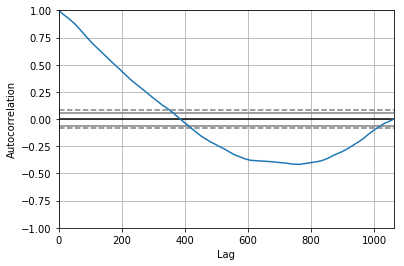

<Figure size 800x560 with 0 Axes>

Test MSE: 29.867


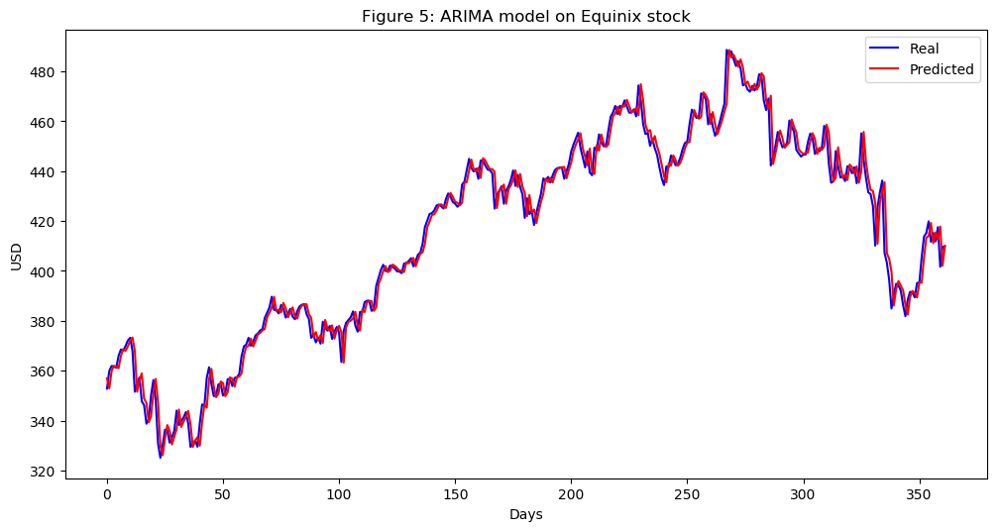

In [418]:
Equinix_series = SP500_TechIndicator['Equinix_Close']
Equinix_series_model = ARIMA(Equinix_series, order=(5, 1, 0))
Equinix_model_fit = Equinix_series_model.fit(disp=0)
print(Equinix_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Equinix_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Equinix_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Equinix_predictions = list()
for t in range(len(test)):
    Equinix_series_model = ARIMA(history, order=(5,1,0))
    Equinix_series_model_fit = Equinix_series_model.fit(disp=0)
    Equinix_output = Equinix_series_model_fit.forecast()
    yhat = Equinix_output[0]
    Equinix_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Equinix_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Equinix_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Equinix stock')
plt.legend()
plt.show()


#predictions
Equinix_predictions = pd.DataFrame({'Equinix_predictions':Equinix_predictions})
#Equinix_predictions.to_csv('Equinix_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.Equity_Residential_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -1245.568
Method:                               css-mle   S.D. of innovations              0.783
Date:                        Sun, 17 Mar 2019   AIC                           2505.137
Time:                                23:32:03   BIC                           2539.906
Sample:                                     1   HQIC                          2518.313
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0070      0.022      0.320      0.749      -0.036       0.050
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


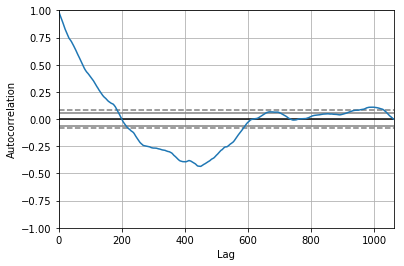

<Figure size 800x560 with 0 Axes>

Test MSE: 0.335


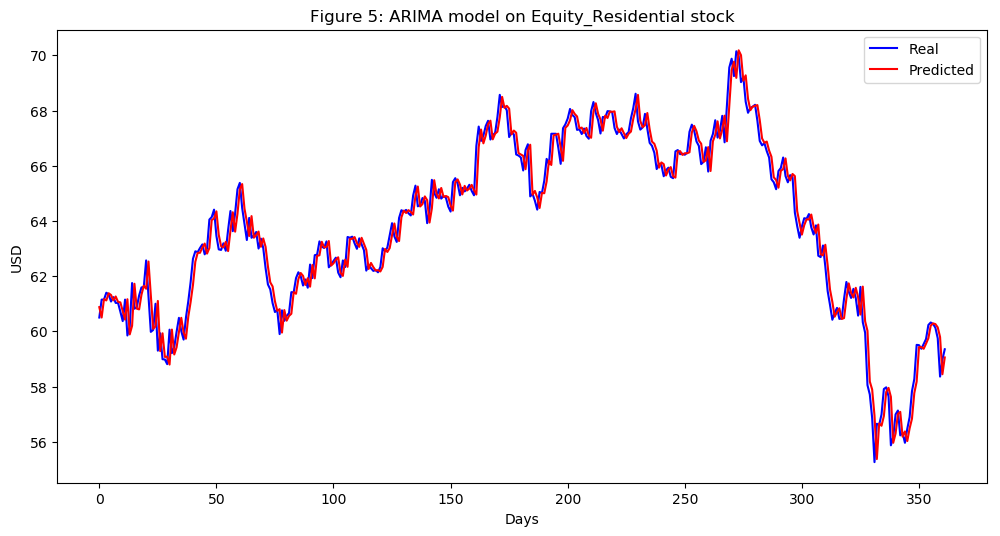

In [419]:
Equity_Residential_series = SP500_TechIndicator['Equity_Residential_Close']
Equity_Residential_series_model = ARIMA(Equity_Residential_series, order=(5, 1, 0))
Equity_Residential_model_fit = Equity_Residential_series_model.fit(disp=0)
print(Equity_Residential_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Equity_Residential_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Equity_Residential_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Equity_Residential_predictions = list()
for t in range(len(test)):
    Equity_Residential_series_model = ARIMA(history, order=(5,1,0))
    Equity_Residential_series_model_fit = Equity_Residential_series_model.fit(disp=0)
    Equity_Residential_output = Equity_Residential_series_model_fit.forecast()
    yhat = Equity_Residential_output[0]
    Equity_Residential_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Equity_Residential_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Equity_Residential_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Equity_Residential stock')
plt.legend()
plt.show()


#predictions
Equity_Residential_predictions = pd.DataFrame({'Equity_Residential_predictions':Equity_Residential_predictions})
#Equity_Residential_predictions.to_csv('Equity_Residential_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Essex_Property_Trust_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -2472.434
Method:                                 css-mle   S.D. of innovations              2.488
Date:                          Sun, 17 Mar 2019   AIC                           4958.867
Time:                                  23:33:11   BIC                           4993.636
Sample:                                       1   HQIC                          4972.044
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                  0.0851      0.074      1.143      0.253    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


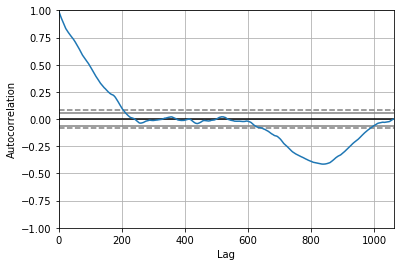

<Figure size 800x560 with 0 Axes>

Test MSE: 5.903


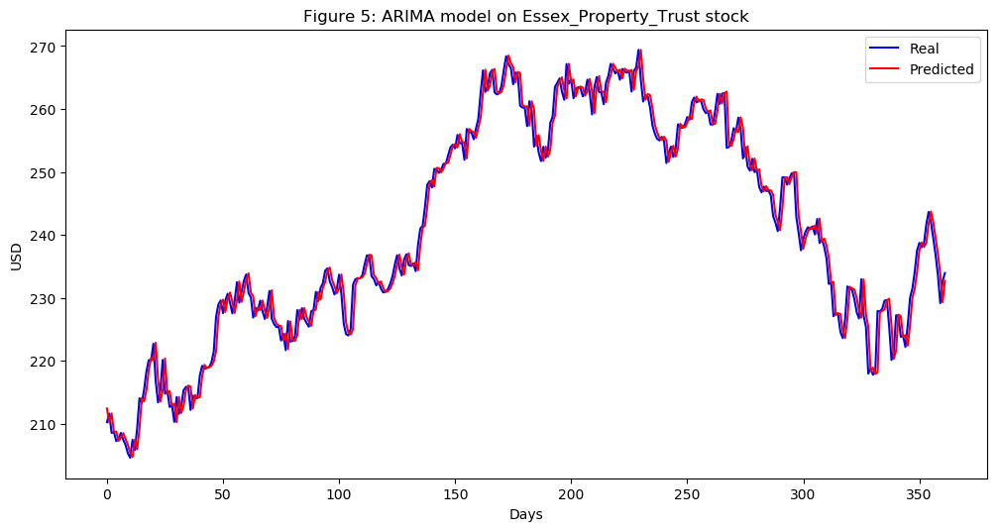

In [420]:
Essex_Property_Trust_series = SP500_TechIndicator['Essex_Property_Trust_Close']
Essex_Property_Trust_series_model = ARIMA(Essex_Property_Trust_series, order=(5, 1, 0))
Essex_Property_Trust_model_fit = Essex_Property_Trust_series_model.fit(disp=0)
print(Essex_Property_Trust_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Essex_Property_Trust_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Essex_Property_Trust_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Essex_Property_Trust_predictions = list()
for t in range(len(test)):
    Essex_Property_Trust_series_model = ARIMA(history, order=(5,1,0))
    Essex_Property_Trust_series_model_fit = Essex_Property_Trust_series_model.fit(disp=0)
    Essex_Property_Trust_output = Essex_Property_Trust_series_model_fit.forecast()
    yhat = Essex_Property_Trust_output[0]
    Essex_Property_Trust_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Essex_Property_Trust_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Essex_Property_Trust_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Essex_Property_Trust stock')
plt.legend()
plt.show()


#predictions
Essex_Property_Trust_predictions = pd.DataFrame({'Essex_Property_Trust_predictions':Essex_Property_Trust_predictions})
#Essex_Property_Trust_predictions.to_csv('Essex_Property_Trust_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.Extra_Space_Storage_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1483.095
Method:                                css-mle   S.D. of innovations              0.979
Date:                         Sun, 17 Mar 2019   AIC                           2980.190
Time:                                 23:34:00   BIC                           3014.958
Sample:                                      1   HQIC                          2993.366
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0410      0.032      1.267      0.205      -0.022   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


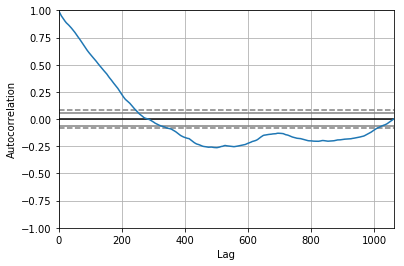

<Figure size 800x560 with 0 Axes>

Test MSE: 1.125


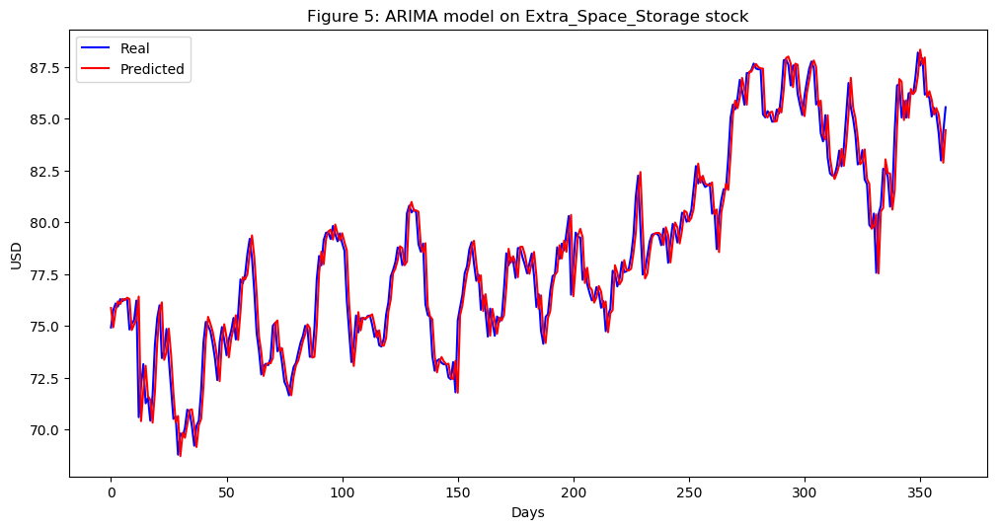

In [421]:
Extra_Space_Storage_series = SP500_TechIndicator['Extra_Space_Storage_Close']
Extra_Space_Storage_series_model = ARIMA(Extra_Space_Storage_series, order=(5, 1, 0))
Extra_Space_Storage_model_fit = Extra_Space_Storage_series_model.fit(disp=0)
print(Extra_Space_Storage_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Extra_Space_Storage_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Extra_Space_Storage_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Extra_Space_Storage_predictions = list()
for t in range(len(test)):
    Extra_Space_Storage_series_model = ARIMA(history, order=(5,1,0))
    Extra_Space_Storage_series_model_fit = Extra_Space_Storage_series_model.fit(disp=0)
    Extra_Space_Storage_output = Extra_Space_Storage_series_model_fit.forecast()
    yhat = Extra_Space_Storage_output[0]
    Extra_Space_Storage_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Extra_Space_Storage_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Extra_Space_Storage_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Extra_Space_Storage stock')
plt.legend()
plt.show()


#predictions
Extra_Space_Storage_predictions = pd.DataFrame({'Extra_Space_Storage_predictions':Extra_Space_Storage_predictions})
#Extra_Space_Storage_predictions.to_csv('Extra_Space_Storage_predictions.csv')



                                        ARIMA Model Results                                        
Dep. Variable:     D.Federal_Realty_Investment_Trust_Close   No. Observations:                 1061
Model:                                      ARIMA(5, 1, 0)   Log Likelihood               -1915.130
Method:                                            css-mle   S.D. of innovations              1.471
Date:                                     Sun, 17 Mar 2019   AIC                           3844.261
Time:                                             23:34:51   BIC                           3879.029
Sample:                                                  1   HQIC                          3857.437
                                                                                                   
                                                    coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


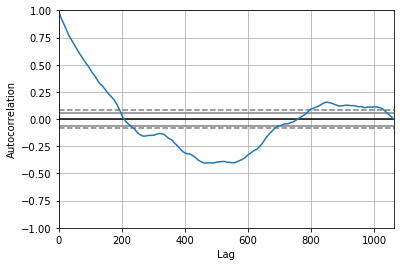

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 2.258


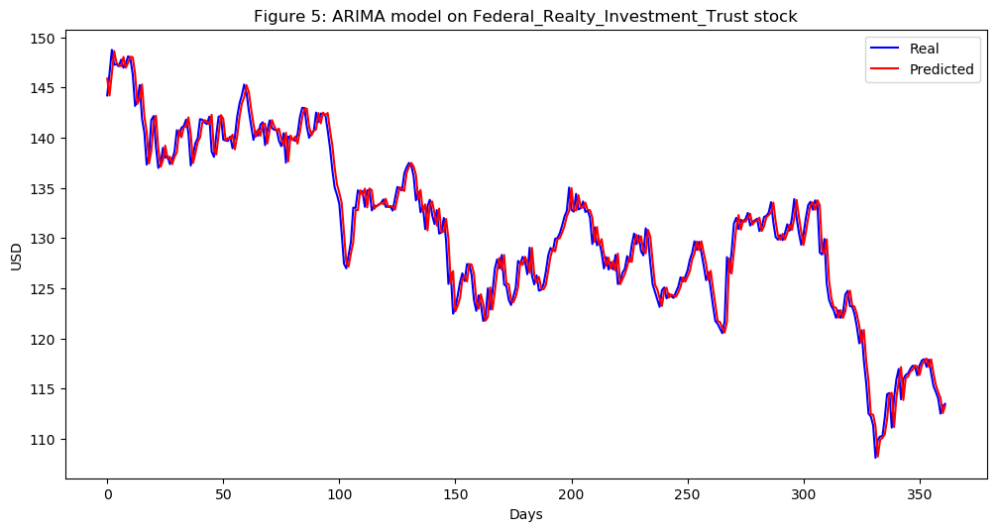

In [422]:
Federal_Realty_Investment_Trust_series = SP500_TechIndicator['Federal_Realty_Investment_Trust_Close']
Federal_Realty_Investment_Trust_series_model = ARIMA(Federal_Realty_Investment_Trust_series, order=(5, 1, 0))
Federal_Realty_Investment_Trust_model_fit = Federal_Realty_Investment_Trust_series_model.fit(disp=0)
print(Federal_Realty_Investment_Trust_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Federal_Realty_Investment_Trust_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Federal_Realty_Investment_Trust_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Federal_Realty_Investment_Trust_predictions = list()
for t in range(len(test)):
    Federal_Realty_Investment_Trust_series_model = ARIMA(history, order=(5,1,0))
    Federal_Realty_Investment_Trust_series_model_fit = Federal_Realty_Investment_Trust_series_model.fit(disp=0)
    Federal_Realty_Investment_Trust_output = Federal_Realty_Investment_Trust_series_model_fit.forecast()
    yhat = Federal_Realty_Investment_Trust_output[0]
    Federal_Realty_Investment_Trust_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Federal_Realty_Investment_Trust_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Federal_Realty_Investment_Trust_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Federal_Realty_Investment_Trust stock')
plt.legend()
plt.show()


#predictions
Federal_Realty_Investment_Trust_predictions = pd.DataFrame({'Federal_Realty_Investment_Trust_predictions':Federal_Realty_Investment_Trust_predictions})
#Federal_Realty_Investment_Trust_predictions.to_csv('Federal_Realty_Investment_Trust_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:            D.HCP_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -791.287
Method:                       css-mle   S.D. of innovations              0.510
Date:                Sun, 17 Mar 2019   AIC                           1596.574
Time:                        23:35:44   BIC                           1631.343
Sample:                             1   HQIC                          1609.751
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                -0.0126      0.019     -0.655      0.512      -0.050       0.025
ar.L1.D.HCP_Close     0.1059      0.031      3.452      0.001       0.046       0.166
ar.L2.D.HCP_Close     0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


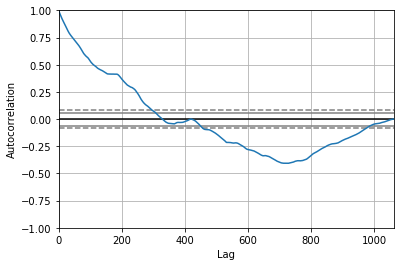

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.181


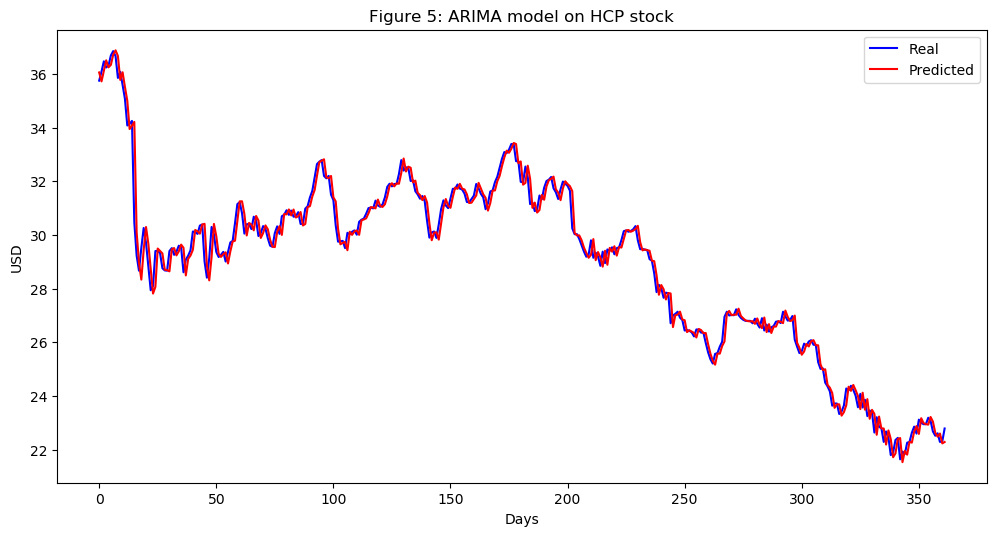

In [423]:
HCP_series = SP500_TechIndicator['HCP_Close']
HCP_series_model = ARIMA(HCP_series, order=(5, 1, 0))
HCP_model_fit = HCP_series_model.fit(disp=0)
print(HCP_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(HCP_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = HCP_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
HCP_predictions = list()
for t in range(len(test)):
    HCP_series_model = ARIMA(history, order=(5,1,0))
    HCP_series_model_fit = HCP_series_model.fit(disp=0)
    HCP_output = HCP_series_model_fit.forecast()
    yhat = HCP_output[0]
    HCP_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, HCP_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(HCP_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on HCP stock')
plt.legend()
plt.show()


#predictions
HCP_predictions = pd.DataFrame({'HCP_predictions':HCP_predictions})
#HCP_predictions.to_csv('HCP_predictions.csv')



                                  ARIMA Model Results                                  
Dep. Variable:     D.Host_Hotels_Resorts_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood                -119.725
Method:                                css-mle   S.D. of innovations              0.271
Date:                         Sun, 17 Mar 2019   AIC                            253.451
Time:                                 23:36:49   BIC                            288.219
Sample:                                      1   HQIC                           266.627
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                -0.0010      0.008     -0.129      0.897      -0.017   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


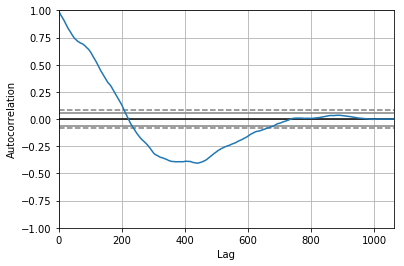

<Figure size 800x560 with 0 Axes>

Test MSE: 0.065


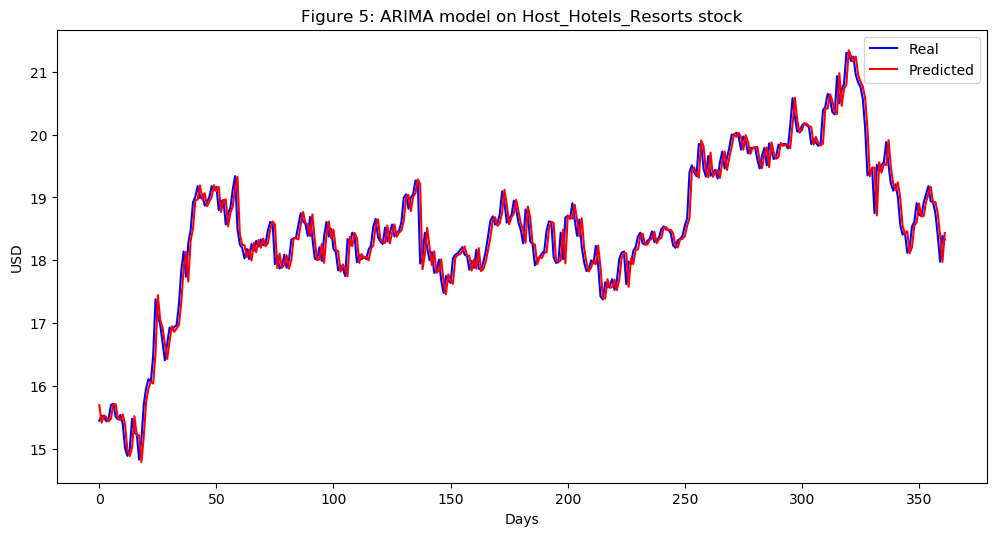

In [424]:
Host_Hotels_Resorts_series = SP500_TechIndicator['Host_Hotels_Resorts_Close']
Host_Hotels_Resorts_series_model = ARIMA(Host_Hotels_Resorts_series, order=(5, 1, 0))
Host_Hotels_Resorts_model_fit = Host_Hotels_Resorts_series_model.fit(disp=0)
print(Host_Hotels_Resorts_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Host_Hotels_Resorts_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Host_Hotels_Resorts_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Host_Hotels_Resorts_predictions = list()
for t in range(len(test)):
    Host_Hotels_Resorts_series_model = ARIMA(history, order=(5,1,0))
    Host_Hotels_Resorts_series_model_fit = Host_Hotels_Resorts_series_model.fit(disp=0)
    Host_Hotels_Resorts_output = Host_Hotels_Resorts_series_model_fit.forecast()
    yhat = Host_Hotels_Resorts_output[0]
    Host_Hotels_Resorts_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Host_Hotels_Resorts_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Host_Hotels_Resorts_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Host_Hotels_Resorts stock')
plt.legend()
plt.show()


#predictions
Host_Hotels_Resorts_predictions = pd.DataFrame({'Host_Hotels_Resorts_predictions':Host_Hotels_Resorts_predictions})
#Host_Hotels_Resorts_predictions.to_csv('Host_Hotels_Resorts_predictions.csv')



                               ARIMA Model Results                               
Dep. Variable:     D.Iron_Mountain_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood                -833.297
Method:                          css-mle   S.D. of innovations              0.531
Date:                   Sun, 17 Mar 2019   AIC                           1680.594
Time:                           23:37:51   BIC                           1715.363
Sample:                                1   HQIC                          1693.770
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0015      0.016      0.090      0.928      -0.031       0.034
ar.L1.D.Iron_Mountain_Close     0.0038      0.031      0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


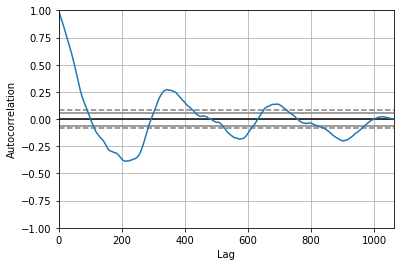

<Figure size 800x560 with 0 Axes>

Test MSE: 0.235


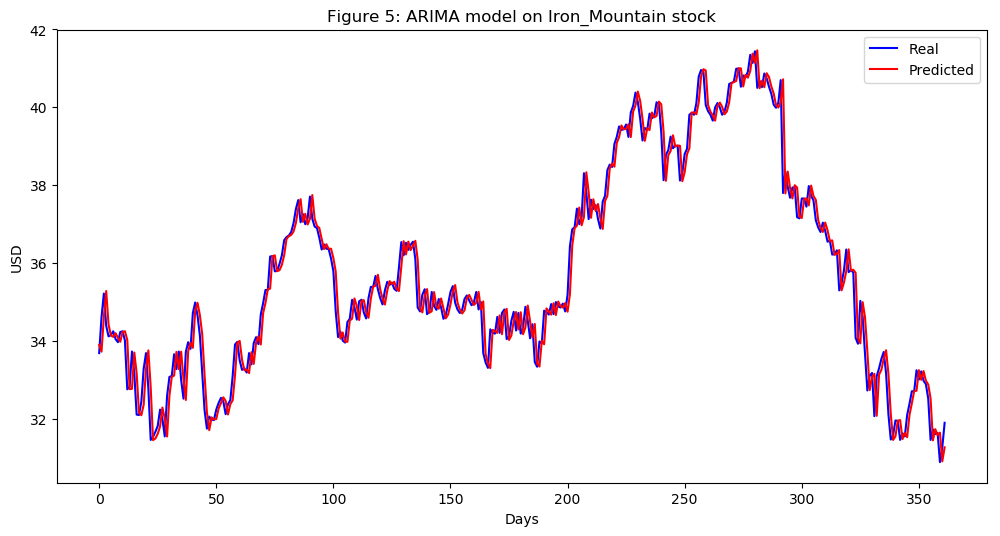

In [425]:
Iron_Mountain_series = SP500_TechIndicator['Iron_Mountain_Close']
Iron_Mountain_series_model = ARIMA(Iron_Mountain_series, order=(5, 1, 0))
Iron_Mountain_model_fit = Iron_Mountain_series_model.fit(disp=0)
print(Iron_Mountain_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Iron_Mountain_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Iron_Mountain_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Iron_Mountain_predictions = list()
for t in range(len(test)):
    Iron_Mountain_series_model = ARIMA(history, order=(5,1,0))
    Iron_Mountain_series_model_fit = Iron_Mountain_series_model.fit(disp=0)
    Iron_Mountain_output = Iron_Mountain_series_model_fit.forecast()
    yhat = Iron_Mountain_output[0]
    Iron_Mountain_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Iron_Mountain_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Iron_Mountain_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Iron_Mountain stock')
plt.legend()
plt.show()


#predictions
Iron_Mountain_predictions = pd.DataFrame({'Iron_Mountain_predictions':Iron_Mountain_predictions})
#Iron_Mountain_predictions.to_csv('Iron_Mountain_predictions.csv')



                              ARIMA Model Results                               
Dep. Variable:     D.Kimco_Realty_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood                -253.200
Method:                         css-mle   S.D. of innovations              0.307
Date:                  Sun, 17 Mar 2019   AIC                            520.400
Time:                          23:39:03   BIC                            555.169
Sample:                               1   HQIC                           533.577
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                         -0.0053      0.009     -0.571      0.568      -0.024       0.013
ar.L1.D.Kimco_Realty_Close     0.0071      0.031      0.232      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


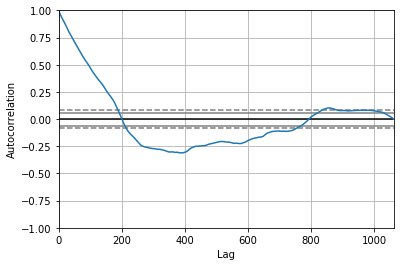

<Figure size 800x560 with 0 Axes>

Test MSE: 0.103


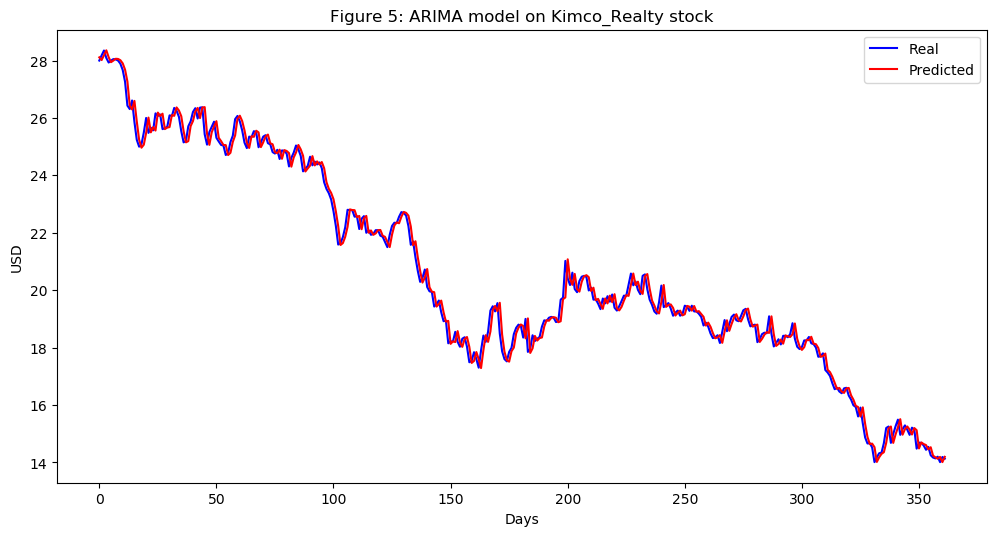

In [426]:
Kimco_Realty_series = SP500_TechIndicator['Kimco_Realty_Close']
Kimco_Realty_series_model = ARIMA(Kimco_Realty_series, order=(5, 1, 0))
Kimco_Realty_model_fit = Kimco_Realty_series_model.fit(disp=0)
print(Kimco_Realty_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Kimco_Realty_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Kimco_Realty_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Kimco_Realty_predictions = list()
for t in range(len(test)):
    Kimco_Realty_series_model = ARIMA(history, order=(5,1,0))
    Kimco_Realty_series_model_fit = Kimco_Realty_series_model.fit(disp=0)
    Kimco_Realty_output = Kimco_Realty_series_model_fit.forecast()
    yhat = Kimco_Realty_output[0]
    Kimco_Realty_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Kimco_Realty_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Kimco_Realty_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Kimco_Realty stock')
plt.legend()
plt.show()


#predictions
Kimco_Realty_predictions = pd.DataFrame({'Kimco_Realty_predictions':Kimco_Realty_predictions})
#Kimco_Realty_predictions.to_csv('Kimco_Realty_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Macerich_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1525.728
Method:                       css-mle   S.D. of innovations              1.019
Date:                Sun, 17 Mar 2019   AIC                           3065.456
Time:                        23:40:27   BIC                           3100.225
Sample:                             1   HQIC                          3078.633
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     -0.0033      0.032     -0.103      0.918      -0.065       0.059
ar.L1.D.Macerich_Close     0.0338      0.031      1.099      0.272      -0.026       0.094
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


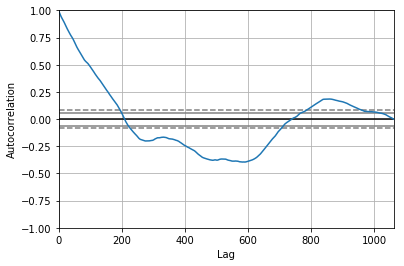

<Figure size 800x560 with 0 Axes>

Test MSE: 0.954


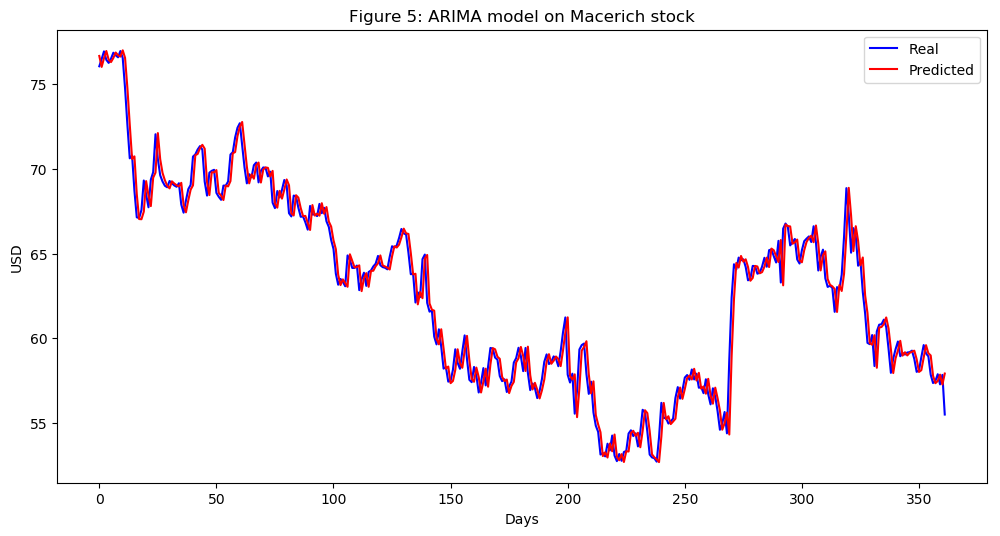

In [427]:
Macerich_series = SP500_TechIndicator['Macerich_Close']
Macerich_series_model = ARIMA(Macerich_series, order=(5, 1, 0))
Macerich_model_fit = Macerich_series_model.fit(disp=0)
print(Macerich_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Macerich_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Macerich_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Macerich_predictions = list()
for t in range(len(test)):
    Macerich_series_model = ARIMA(history, order=(5,1,0))
    Macerich_series_model_fit = Macerich_series_model.fit(disp=0)
    Macerich_output = Macerich_series_model_fit.forecast()
    yhat = Macerich_output[0]
    Macerich_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Macerich_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Macerich_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Macerich stock')
plt.legend()
plt.show()


#predictions
Macerich_predictions = pd.DataFrame({'Macerich_predictions':Macerich_predictions})
#Macerich_predictions.to_csv('Macerich_predictions.csv')



                                   ARIMA Model Results                                    
Dep. Variable:     D.Mid_America_Apartments_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood               -1528.521
Method:                                   css-mle   S.D. of innovations              1.022
Date:                            Sun, 17 Mar 2019   AIC                           3071.042
Time:                                    23:41:21   BIC                           3105.811
Sample:                                         1   HQIC                          3084.219
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0259      0.034    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


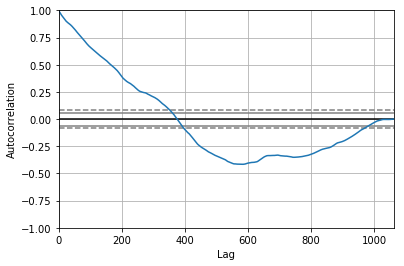

<Figure size 800x560 with 0 Axes>

Test MSE: 1.150


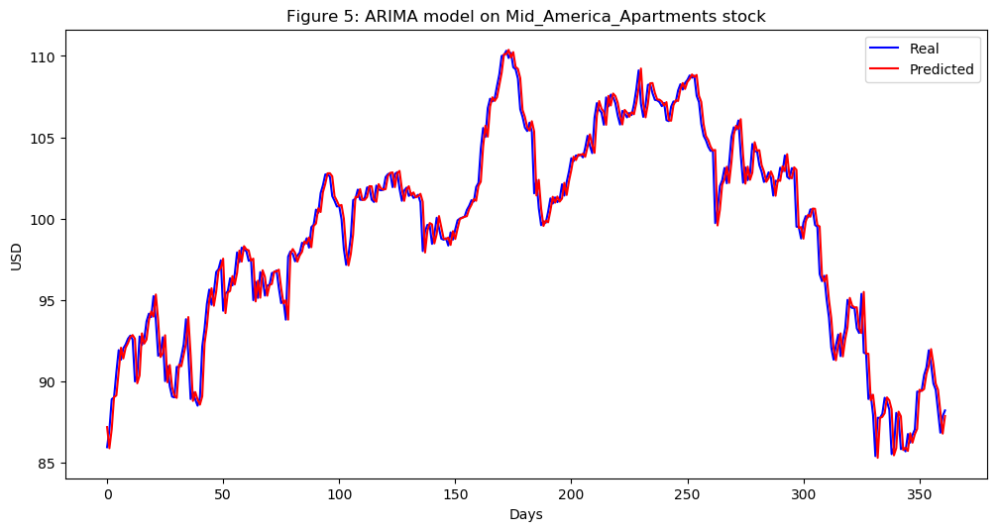

In [428]:
Mid_America_Apartments_series = SP500_TechIndicator['Mid_America_Apartments_Close']
Mid_America_Apartments_series_model = ARIMA(Mid_America_Apartments_series, order=(5, 1, 0))
Mid_America_Apartments_model_fit = Mid_America_Apartments_series_model.fit(disp=0)
print(Mid_America_Apartments_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Mid_America_Apartments_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Mid_America_Apartments_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Mid_America_Apartments_predictions = list()
for t in range(len(test)):
    Mid_America_Apartments_series_model = ARIMA(history, order=(5,1,0))
    Mid_America_Apartments_series_model_fit = Mid_America_Apartments_series_model.fit(disp=0)
    Mid_America_Apartments_output = Mid_America_Apartments_series_model_fit.forecast()
    yhat = Mid_America_Apartments_output[0]
    Mid_America_Apartments_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Mid_America_Apartments_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Mid_America_Apartments_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Mid_America_Apartments stock')
plt.legend()
plt.show()


#predictions
Mid_America_Apartments_predictions = pd.DataFrame({'Mid_America_Apartments_predictions':Mid_America_Apartments_predictions})
#Mid_America_Apartments_predictions.to_csv('Mid_America_Apartments_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:       D.Prologis_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -923.729
Method:                       css-mle   S.D. of innovations              0.578
Date:                Sun, 17 Mar 2019   AIC                           1861.458
Time:                        23:42:20   BIC                           1896.227
Sample:                             1   HQIC                          1874.634
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0235      0.017      1.411      0.158      -0.009       0.056
ar.L1.D.Prologis_Close    -0.0099      0.031     -0.324      0.746      -0.070       0.050
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


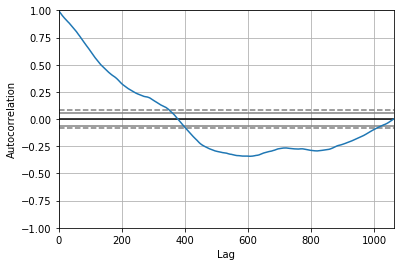

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.476


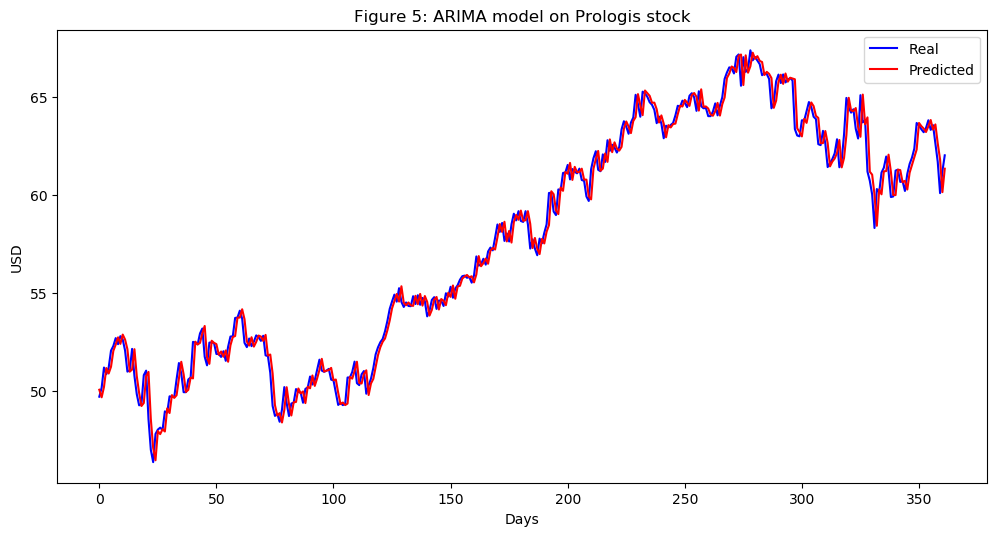

In [429]:
Prologis_series = SP500_TechIndicator['Prologis_Close']
Prologis_series_model = ARIMA(Prologis_series, order=(5, 1, 0))
Prologis_model_fit = Prologis_series_model.fit(disp=0)
print(Prologis_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Prologis_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Prologis_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Prologis_predictions = list()
for t in range(len(test)):
    Prologis_series_model = ARIMA(history, order=(5,1,0))
    Prologis_series_model_fit = Prologis_series_model.fit(disp=0)
    Prologis_output = Prologis_series_model_fit.forecast()
    yhat = Prologis_output[0]
    Prologis_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Prologis_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Prologis_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Prologis stock')
plt.legend()
plt.show()


#predictions
Prologis_predictions = pd.DataFrame({'Prologis_predictions':Prologis_predictions})
#Prologis_predictions.to_csv('Prologis_predictions.csv')



                               ARIMA Model Results                                
Dep. Variable:     D.Public_Storage_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -2451.849
Method:                           css-mle   S.D. of innovations              2.440
Date:                    Sun, 17 Mar 2019   AIC                           4917.699
Time:                            23:43:53   BIC                           4952.467
Sample:                                 1   HQIC                          4930.875
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0448      0.077      0.583      0.560      -0.106       0.195
ar.L1.D.Public_Storage_Close     0.0326      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


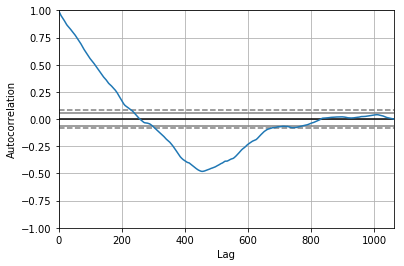

<Figure size 800x560 with 0 Axes>

Test MSE: 6.292


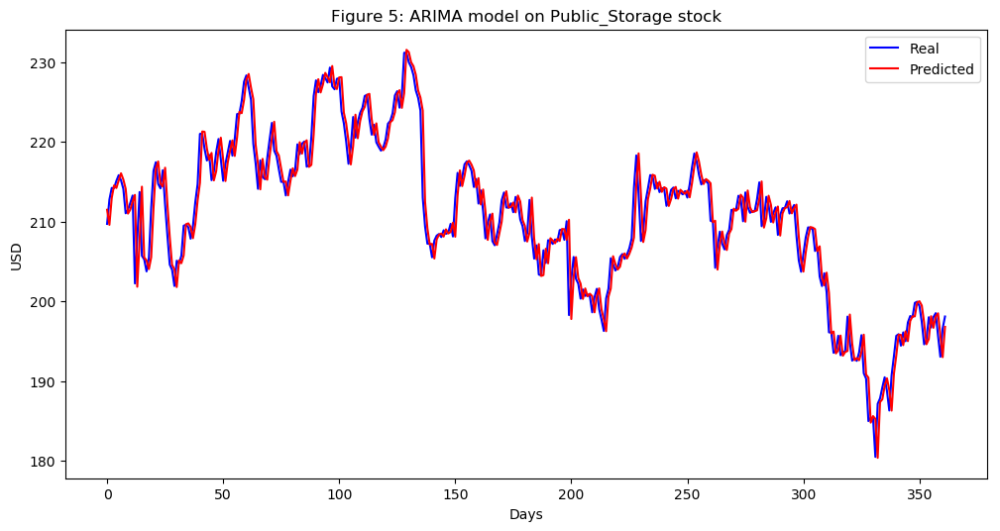

In [430]:
Public_Storage_series = SP500_TechIndicator['Public_Storage_Close']
Public_Storage_series_model = ARIMA(Public_Storage_series, order=(5, 1, 0))
Public_Storage_model_fit = Public_Storage_series_model.fit(disp=0)
print(Public_Storage_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Public_Storage_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Public_Storage_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Public_Storage_predictions = list()
for t in range(len(test)):
    Public_Storage_series_model = ARIMA(history, order=(5,1,0))
    Public_Storage_series_model_fit = Public_Storage_series_model.fit(disp=0)
    Public_Storage_output = Public_Storage_series_model_fit.forecast()
    yhat = Public_Storage_output[0]
    Public_Storage_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Public_Storage_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Public_Storage_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Public_Storage stock')
plt.legend()
plt.show()


#predictions
Public_Storage_predictions = pd.DataFrame({'Public_Storage_predictions':Public_Storage_predictions})
#Public_Storage_predictions.to_csv('Public_Storage_predictions.csv')



                                     ARIMA Model Results                                     
Dep. Variable:     D.Realty_Income_Corporation_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood               -1051.891
Method:                                      css-mle   S.D. of innovations              0.652
Date:                               Sun, 17 Mar 2019   AIC                           2117.782
Time:                                       23:45:04   BIC                           2152.551
Sample:                                            1   HQIC                          2130.959
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


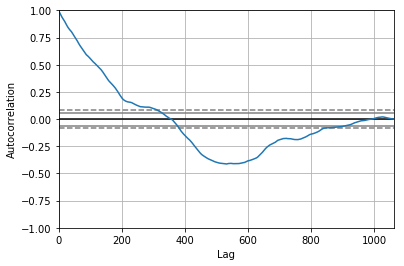

<Figure size 800x560 with 0 Axes>

Test MSE: 0.482


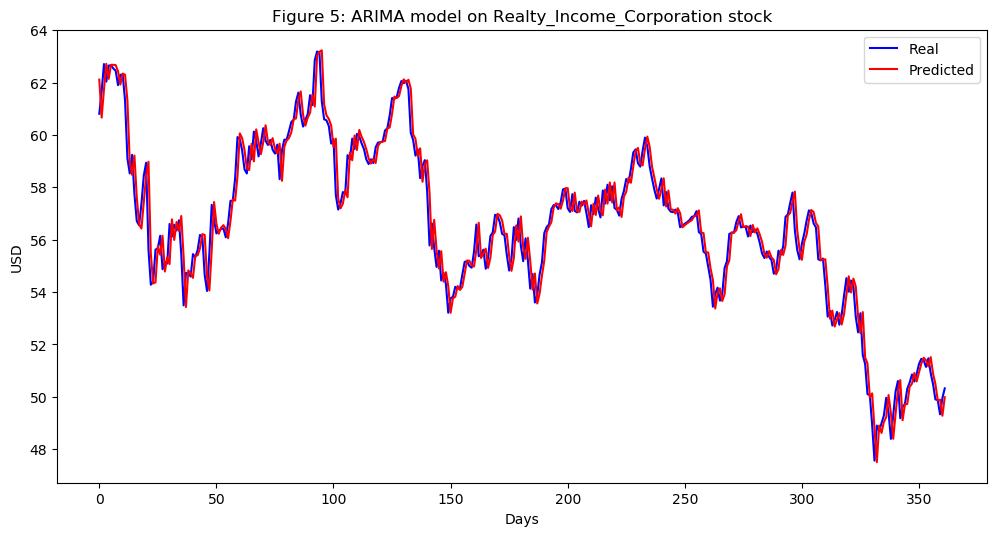

In [431]:
Realty_Income_Corporation_series = SP500_TechIndicator['Realty_Income_Corporation_Close']
Realty_Income_Corporation_series_model = ARIMA(Realty_Income_Corporation_series, order=(5, 1, 0))
Realty_Income_Corporation_model_fit = Realty_Income_Corporation_series_model.fit(disp=0)
print(Realty_Income_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Realty_Income_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Realty_Income_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Realty_Income_Corporation_predictions = list()
for t in range(len(test)):
    Realty_Income_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Realty_Income_Corporation_series_model_fit = Realty_Income_Corporation_series_model.fit(disp=0)
    Realty_Income_Corporation_output = Realty_Income_Corporation_series_model_fit.forecast()
    yhat = Realty_Income_Corporation_output[0]
    Realty_Income_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Realty_Income_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Realty_Income_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Realty_Income_Corporation stock')
plt.legend()
plt.show()


#predictions
Realty_Income_Corporation_predictions = pd.DataFrame({'Realty_Income_Corporation_predictions':Realty_Income_Corporation_predictions})
#Realty_Income_Corporation_predictions.to_csv('Realty_Income_Corporation_predictions.csv')



                                      ARIMA Model Results                                      
Dep. Variable:     D.Regency_Centers_Corporation_Close   No. Observations:                 1061
Model:                                  ARIMA(5, 1, 0)   Log Likelihood               -1213.831
Method:                                        css-mle   S.D. of innovations              0.760
Date:                                 Sun, 17 Mar 2019   AIC                           2441.661
Time:                                         23:46:20   BIC                           2476.430
Sample:                                              1   HQIC                          2454.838
                                                                                               
                                                coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------------
const       

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


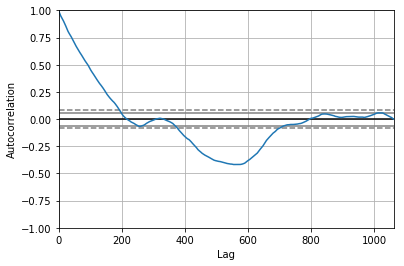

<Figure size 800x560 with 0 Axes>

Test MSE: 0.645


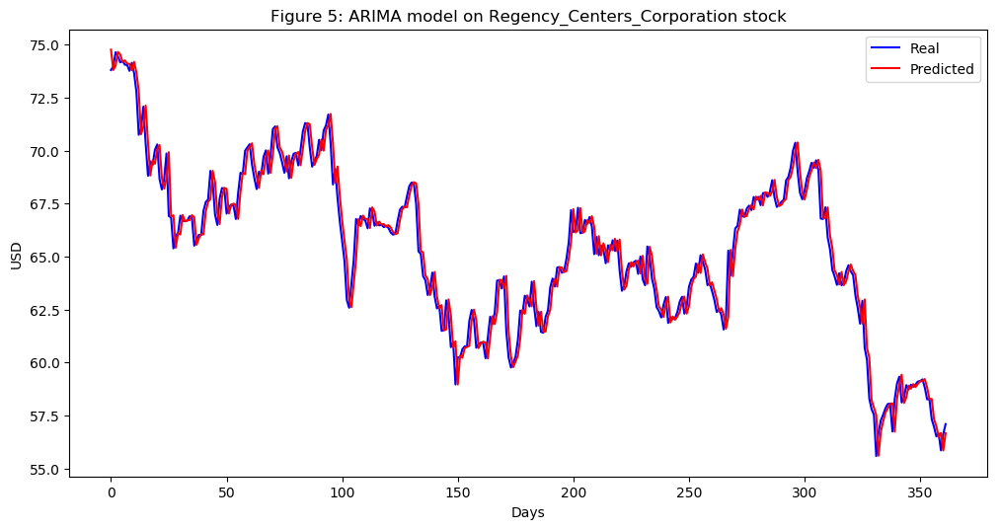

In [432]:
Regency_Centers_Corporation_series = SP500_TechIndicator['Regency_Centers_Corporation_Close']
Regency_Centers_Corporation_series_model = ARIMA(Regency_Centers_Corporation_series, order=(5, 1, 0))
Regency_Centers_Corporation_model_fit = Regency_Centers_Corporation_series_model.fit(disp=0)
print(Regency_Centers_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Regency_Centers_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Regency_Centers_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Regency_Centers_Corporation_predictions = list()
for t in range(len(test)):
    Regency_Centers_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Regency_Centers_Corporation_series_model_fit = Regency_Centers_Corporation_series_model.fit(disp=0)
    Regency_Centers_Corporation_output = Regency_Centers_Corporation_series_model_fit.forecast()
    yhat = Regency_Centers_Corporation_output[0]
    Regency_Centers_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Regency_Centers_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Regency_Centers_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Regency_Centers_Corporation stock')
plt.legend()
plt.show()


#predictions
Regency_Centers_Corporation_predictions = pd.DataFrame({'Regency_Centers_Corporation_predictions':Regency_Centers_Corporation_predictions})
#Regency_Centers_Corporation_predictions.to_csv('Regency_Centers_Corporation_predictions.csv')



                                 ARIMA Model Results                                  
Dep. Variable:     D.SBA_Communications_Close   No. Observations:                 1061
Model:                         ARIMA(5, 1, 0)   Log Likelihood               -2069.550
Method:                               css-mle   S.D. of innovations              1.702
Date:                        Sun, 17 Mar 2019   AIC                           4153.101
Time:                                23:47:21   BIC                           4187.869
Sample:                                     1   HQIC                          4166.277
                                                                                      
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0754      0.052      1.456      0.146      -0.026       0.177
a

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


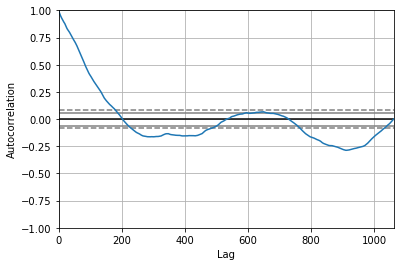

<Figure size 800x560 with 0 Axes>

Test MSE: 4.037


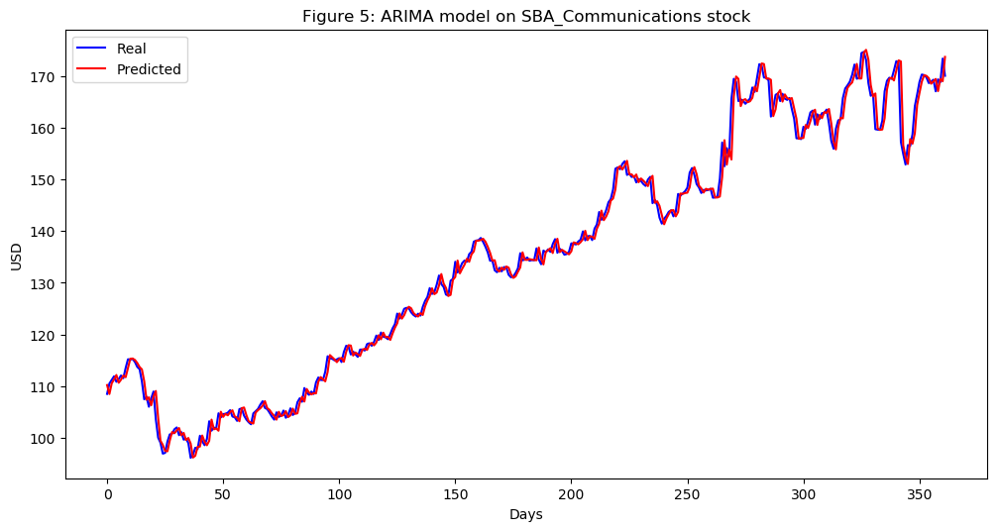

In [433]:
SBA_Communications_series = SP500_TechIndicator['SBA_Communications_Close']
SBA_Communications_series_model = ARIMA(SBA_Communications_series, order=(5, 1, 0))
SBA_Communications_model_fit = SBA_Communications_series_model.fit(disp=0)
print(SBA_Communications_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(SBA_Communications_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = SBA_Communications_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
SBA_Communications_predictions = list()
for t in range(len(test)):
    SBA_Communications_series_model = ARIMA(history, order=(5,1,0))
    SBA_Communications_series_model_fit = SBA_Communications_series_model.fit(disp=0)
    SBA_Communications_output = SBA_Communications_series_model_fit.forecast()
    yhat = SBA_Communications_output[0]
    SBA_Communications_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, SBA_Communications_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(SBA_Communications_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on SBA_Communications stock')
plt.legend()
plt.show()


#predictions
SBA_Communications_predictions = pd.DataFrame({'SBA_Communications_predictions':SBA_Communications_predictions})
#SBA_Communications_predictions.to_csv('SBA_Communications_predictions.csv')



                                  ARIMA Model Results                                   
Dep. Variable:     D.Simon_Property_Group_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -2300.575
Method:                                 css-mle   S.D. of innovations              2.116
Date:                          Sun, 17 Mar 2019   AIC                           4615.150
Time:                                  23:48:13   BIC                           4649.919
Sample:                                       1   HQIC                          4628.326
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                 -0.0016      0.063     -0.025      0.980    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


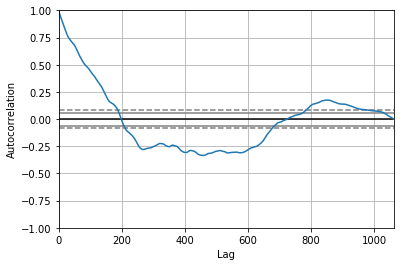

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 4.712


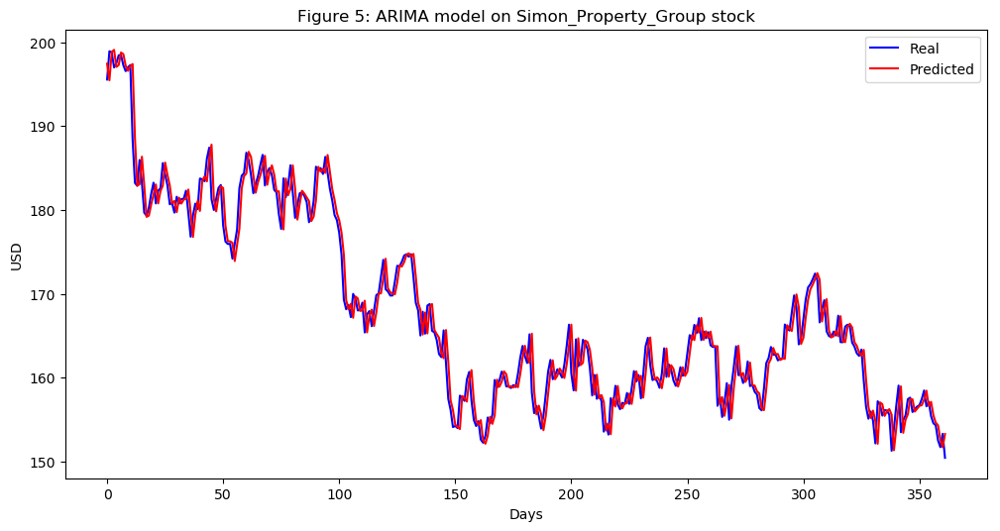

In [434]:
Simon_Property_Group_series = SP500_TechIndicator['Simon_Property_Group_Close']
Simon_Property_Group_series_model = ARIMA(Simon_Property_Group_series, order=(5, 1, 0))
Simon_Property_Group_model_fit = Simon_Property_Group_series_model.fit(disp=0)
print(Simon_Property_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Simon_Property_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Simon_Property_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Simon_Property_Group_predictions = list()
for t in range(len(test)):
    Simon_Property_Group_series_model = ARIMA(history, order=(5,1,0))
    Simon_Property_Group_series_model_fit = Simon_Property_Group_series_model.fit(disp=0)
    Simon_Property_Group_output = Simon_Property_Group_series_model_fit.forecast()
    yhat = Simon_Property_Group_output[0]
    Simon_Property_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Simon_Property_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Simon_Property_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Simon_Property_Group stock')
plt.legend()
plt.show()


#predictions
Simon_Property_Group_predictions = pd.DataFrame({'Simon_Property_Group_predictions':Simon_Property_Group_predictions})
#Simon_Property_Group_predictions.to_csv('Simon_Property_Group_predictions.csv')



                                ARIMA Model Results                                
Dep. Variable:     D.SL_Green_Realty_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1813.072
Method:                            css-mle   S.D. of innovations              1.336
Date:                     Sun, 17 Mar 2019   AIC                           3640.145
Time:                             23:49:01   BIC                           3674.913
Sample:                                  1   HQIC                          3653.321
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0024      0.042      0.057      0.955      -0.080       0.085
ar.L1.D.SL_Green_Realty_Close     

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


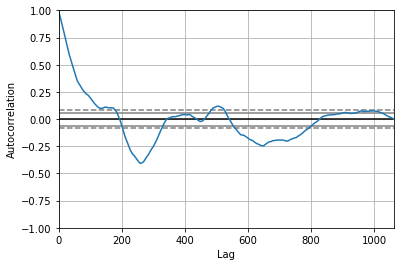

<Figure size 800x560 with 0 Axes>

Test MSE: 1.470


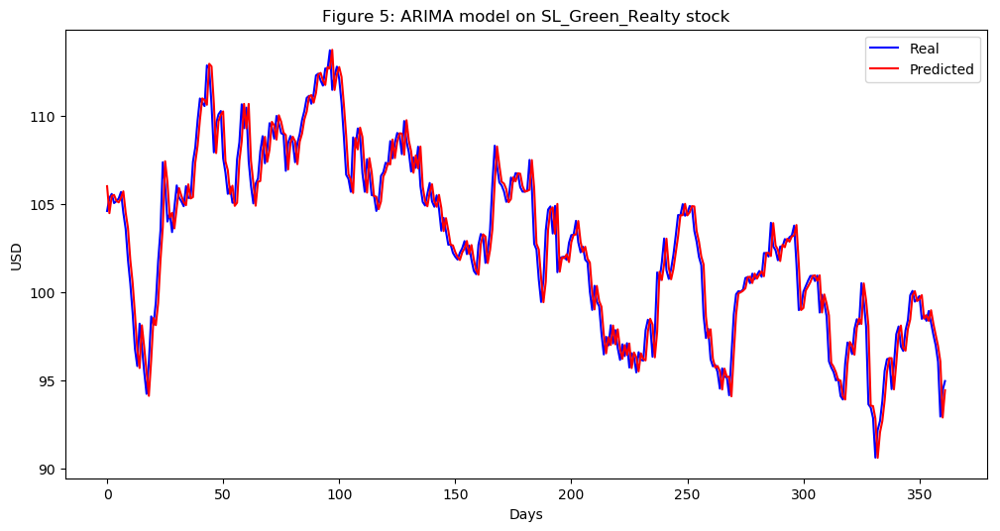

In [435]:
SL_Green_Realty_series = SP500_TechIndicator['SL_Green_Realty_Close']
SL_Green_Realty_series_model = ARIMA(SL_Green_Realty_series, order=(5, 1, 0))
SL_Green_Realty_model_fit = SL_Green_Realty_series_model.fit(disp=0)
print(SL_Green_Realty_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(SL_Green_Realty_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = SL_Green_Realty_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
SL_Green_Realty_predictions = list()
for t in range(len(test)):
    SL_Green_Realty_series_model = ARIMA(history, order=(5,1,0))
    SL_Green_Realty_series_model_fit = SL_Green_Realty_series_model.fit(disp=0)
    SL_Green_Realty_output = SL_Green_Realty_series_model_fit.forecast()
    yhat = SL_Green_Realty_output[0]
    SL_Green_Realty_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, SL_Green_Realty_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(SL_Green_Realty_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on SL_Green_Realty stock')
plt.legend()
plt.show()


#predictions
SL_Green_Realty_predictions = pd.DataFrame({'SL_Green_Realty_predictions':SL_Green_Realty_predictions})
#SL_Green_Realty_predictions.to_csv('SL_Green_Realty_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:            D.UDR_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -502.589
Method:                       css-mle   S.D. of innovations              0.389
Date:                Sun, 17 Mar 2019   AIC                           1019.179
Time:                        23:49:55   BIC                           1053.948
Sample:                             1   HQIC                          1032.355
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 0.0107      0.011      0.946      0.344      -0.011       0.033
ar.L1.D.UDR_Close    -0.0116      0.031     -0.379      0.705      -0.072       0.049
ar.L2.D.UDR_Close    -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


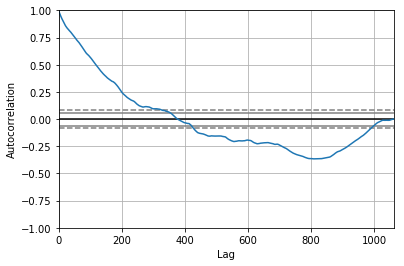

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.133


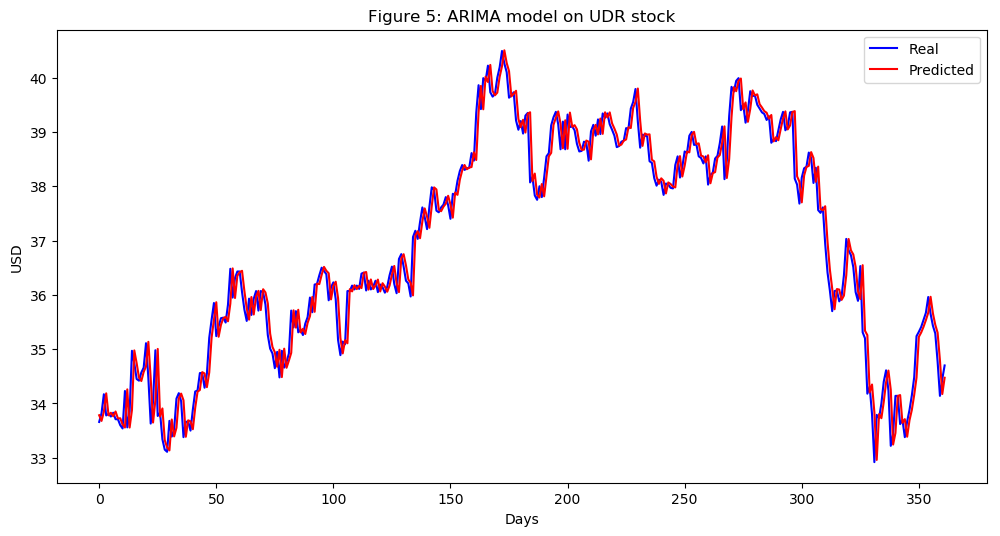

In [436]:
UDR_series = SP500_TechIndicator['UDR_Close']
UDR_series_model = ARIMA(UDR_series, order=(5, 1, 0))
UDR_model_fit = UDR_series_model.fit(disp=0)
print(UDR_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(UDR_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = UDR_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
UDR_predictions = list()
for t in range(len(test)):
    UDR_series_model = ARIMA(history, order=(5,1,0))
    UDR_series_model_fit = UDR_series_model.fit(disp=0)
    UDR_output = UDR_series_model_fit.forecast()
    yhat = UDR_output[0]
    UDR_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, UDR_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(UDR_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on UDR stock')
plt.legend()
plt.show()


#predictions
UDR_predictions = pd.DataFrame({'UDR_predictions':UDR_predictions})
#UDR_predictions.to_csv('UDR_predictions.csv')



                             ARIMA Model Results                              
Dep. Variable:         D.Ventas_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1339.405
Method:                       css-mle   S.D. of innovations              0.855
Date:                Sun, 17 Mar 2019   AIC                           2692.809
Time:                        23:50:59   BIC                           2727.578
Sample:                             1   HQIC                          2705.986
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -0.0077      0.030     -0.260      0.795      -0.066       0.050
ar.L1.D.Ventas_Close     0.0197      0.031      0.642      0.521      -0.040       0.080
ar.L2.D.Vent

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


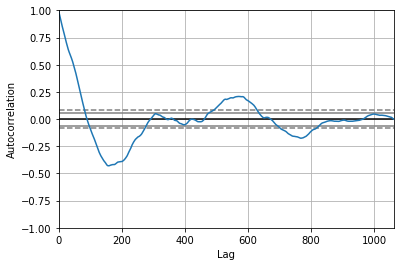

<Figure size 800x560 with 0 Axes>

Test MSE: 0.573


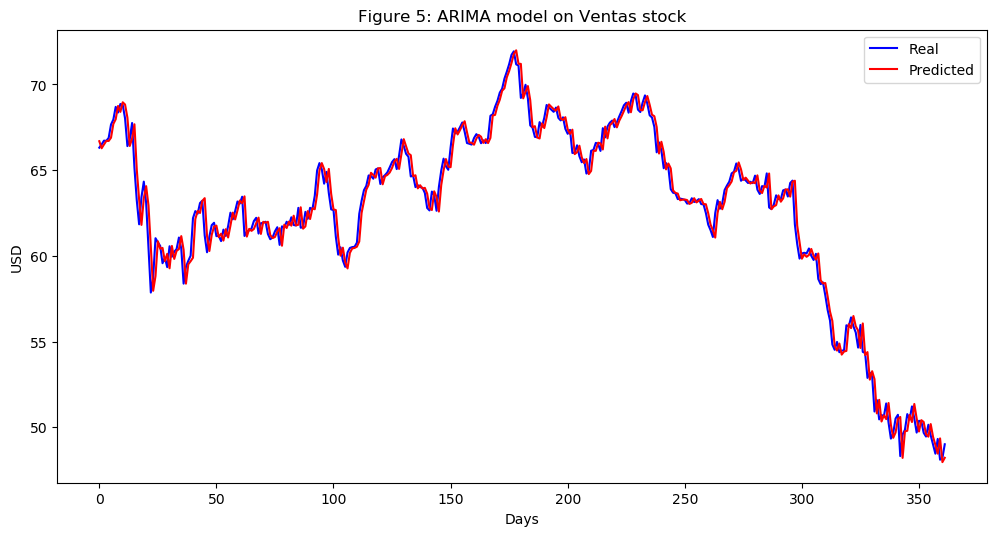

In [437]:
Ventas_series = SP500_TechIndicator['Ventas_Close']
Ventas_series_model = ARIMA(Ventas_series, order=(5, 1, 0))
Ventas_model_fit = Ventas_series_model.fit(disp=0)
print(Ventas_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Ventas_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Ventas_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Ventas_predictions = list()
for t in range(len(test)):
    Ventas_series_model = ARIMA(history, order=(5,1,0))
    Ventas_series_model_fit = Ventas_series_model.fit(disp=0)
    Ventas_output = Ventas_series_model_fit.forecast()
    yhat = Ventas_output[0]
    Ventas_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Ventas_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Ventas_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Ventas stock')
plt.legend()
plt.show()


#predictions
Ventas_predictions = pd.DataFrame({'Ventas_predictions':Ventas_predictions})
#Ventas_predictions.to_csv('Ventas_predictions.csv')





                                  ARIMA Model Results                                   
Dep. Variable:     D.Vornado_Realty_Trust_Close   No. Observations:                 1061
Model:                           ARIMA(5, 1, 0)   Log Likelihood               -1756.319
Method:                                 css-mle   S.D. of innovations              1.267
Date:                          Sun, 17 Mar 2019   AIC                           3526.639
Time:                                  23:52:05   BIC                           3561.407
Sample:                                       1   HQIC                          3539.815
                                                                                        
                                         coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                                 -0.0215      0.038     -0.567      0.571    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


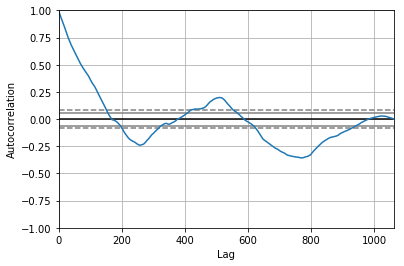

<Figure size 800x560 with 0 Axes>

Test MSE: 1.963


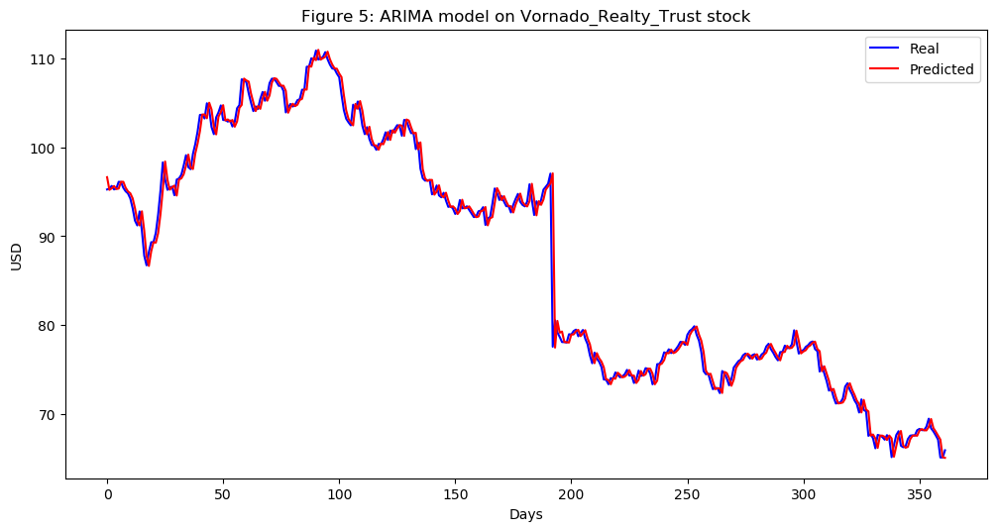

In [438]:
Vornado_Realty_Trust_series = SP500_TechIndicator['Vornado_Realty_Trust_Close']
Vornado_Realty_Trust_series_model = ARIMA(Vornado_Realty_Trust_series, order=(5, 1, 0))
Vornado_Realty_Trust_model_fit = Vornado_Realty_Trust_series_model.fit(disp=0)
print(Vornado_Realty_Trust_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Vornado_Realty_Trust_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Vornado_Realty_Trust_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Vornado_Realty_Trust_predictions = list()
for t in range(len(test)):
    Vornado_Realty_Trust_series_model = ARIMA(history, order=(5,1,0))
    Vornado_Realty_Trust_series_model_fit = Vornado_Realty_Trust_series_model.fit(disp=0)
    Vornado_Realty_Trust_output = Vornado_Realty_Trust_series_model_fit.forecast()
    yhat = Vornado_Realty_Trust_output[0]
    Vornado_Realty_Trust_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Vornado_Realty_Trust_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Vornado_Realty_Trust_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Vornado_Realty_Trust stock')
plt.legend()
plt.show()


#predictions
Vornado_Realty_Trust_predictions = pd.DataFrame({'Vornado_Realty_Trust_predictions':Vornado_Realty_Trust_predictions})
#Vornado_Realty_Trust_predictions.to_csv('Vornado_Realty_Trust_predictions.csv')



                              ARIMA Model Results                               
Dep. Variable:     D.Weyerhaeuser_Close   No. Observations:                 1061
Model:                   ARIMA(5, 1, 0)   Log Likelihood                -507.625
Method:                         css-mle   S.D. of innovations              0.390
Date:                  Sun, 17 Mar 2019   AIC                           1029.251
Time:                          23:53:00   BIC                           1064.019
Sample:                               1   HQIC                          1042.427
                                                                                
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const                          0.0031      0.013      0.235      0.814      -0.023       0.029
ar.L1.D.Weyerhaeuser_Close     0.0593      0.031      1.932      0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


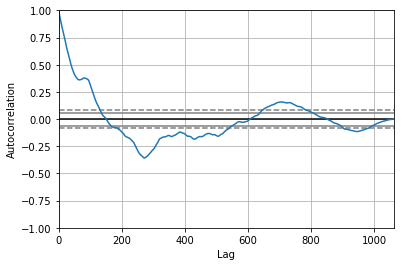

<Figure size 800x560 with 0 Axes>

Test MSE: 0.148


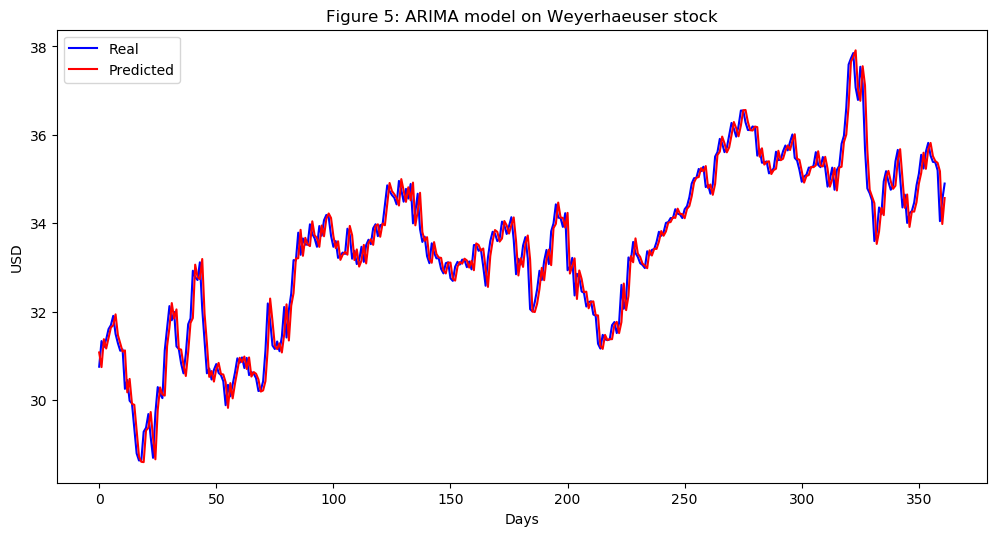

In [439]:
Weyerhaeuser_series = SP500_TechIndicator['Weyerhaeuser_Close']
Weyerhaeuser_series_model = ARIMA(Weyerhaeuser_series, order=(5, 1, 0))
Weyerhaeuser_model_fit = Weyerhaeuser_series_model.fit(disp=0)
print(Weyerhaeuser_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Weyerhaeuser_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Weyerhaeuser_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Weyerhaeuser_predictions = list()
for t in range(len(test)):
    Weyerhaeuser_series_model = ARIMA(history, order=(5,1,0))
    Weyerhaeuser_series_model_fit = Weyerhaeuser_series_model.fit(disp=0)
    Weyerhaeuser_output = Weyerhaeuser_series_model_fit.forecast()
    yhat = Weyerhaeuser_output[0]
    Weyerhaeuser_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Weyerhaeuser_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Weyerhaeuser_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Weyerhaeuser stock')
plt.legend()
plt.show()


#predictions
Weyerhaeuser_predictions = pd.DataFrame({'Weyerhaeuser_predictions':Weyerhaeuser_predictions})
#Weyerhaeuser_predictions.to_csv('Weyerhaeuser_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:            D.AES_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                 257.092
Method:                       css-mle   S.D. of innovations              0.190
Date:                Sun, 17 Mar 2019   AIC                           -500.184
Time:                        23:54:30   BIC                           -465.415
Sample:                             1   HQIC                          -487.007
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                -0.0034      0.005     -0.682      0.496      -0.013       0.006
ar.L1.D.AES_Close    -0.0716      0.031     -2.333      0.020      -0.132      -0.011
ar.L2.D.AES_Close    -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


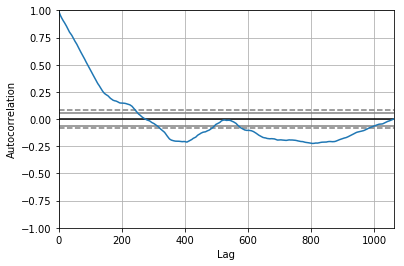

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 0.029


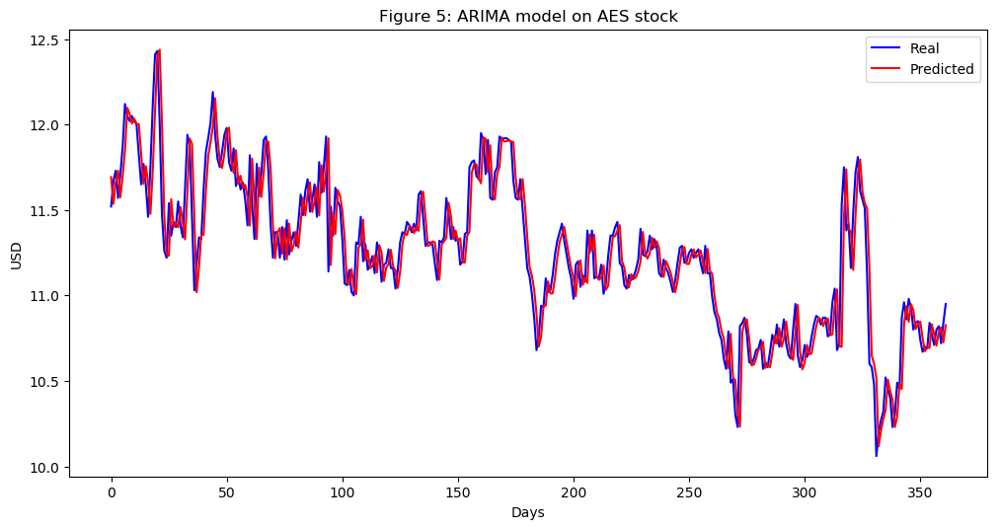

In [440]:
AES_series = SP500_TechIndicator['AES_Close']
AES_series_model = ARIMA(AES_series, order=(5, 1, 0))
AES_model_fit = AES_series_model.fit(disp=0)
print(AES_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(AES_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = AES_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
AES_predictions = list()
for t in range(len(test)):
    AES_series_model = ARIMA(history, order=(5,1,0))
    AES_series_model_fit = AES_series_model.fit(disp=0)
    AES_output = AES_series_model_fit.forecast()
    yhat = AES_output[0]
    AES_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, AES_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(AES_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on AES stock')
plt.legend()
plt.show()


#predictions
AES_predictions = pd.DataFrame({'AES_predictions':AES_predictions})
#AES_predictions.to_csv('AES_predictions.csv')





                                  ARIMA Model Results                                  
Dep. Variable:     D.Alliant_Energy_Corp_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1729.595
Method:                                css-mle   S.D. of innovations              1.235
Date:                         Sun, 17 Mar 2019   AIC                           3473.190
Time:                                 23:55:55   BIC                           3507.958
Sample:                                      1   HQIC                          3486.366
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                -0.0104      0.039     -0.266      0.790      -0.087   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


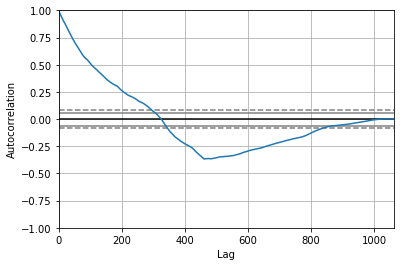

<Figure size 800x560 with 0 Axes>

Test MSE: 0.150


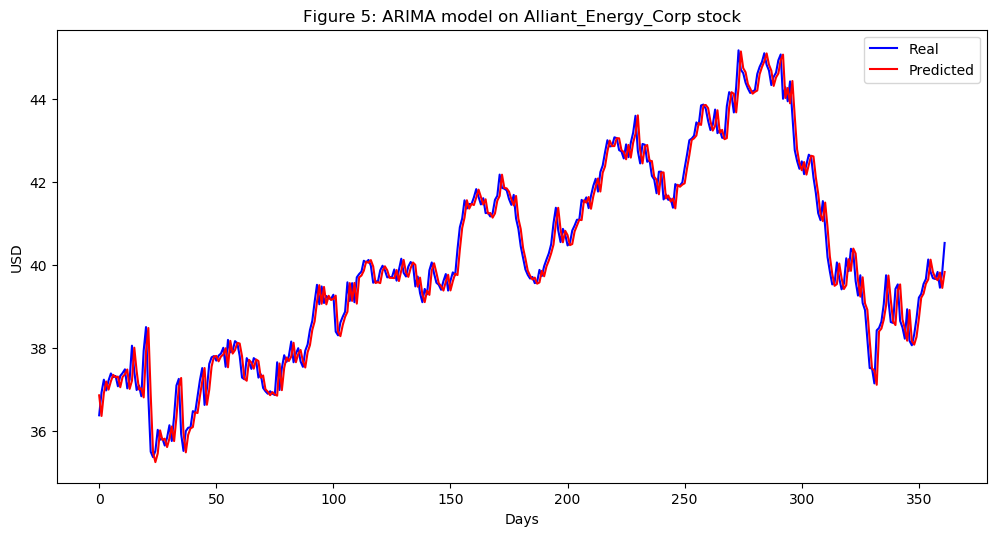

In [441]:
Alliant_Energy_Corp_series = SP500_TechIndicator['Alliant_Energy_Corp_Close']
Alliant_Energy_Corp_series_model = ARIMA(Alliant_Energy_Corp_series, order=(5, 1, 0))
Alliant_Energy_Corp_model_fit = Alliant_Energy_Corp_series_model.fit(disp=0)
print(Alliant_Energy_Corp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Alliant_Energy_Corp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Alliant_Energy_Corp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Alliant_Energy_Corp_predictions = list()
for t in range(len(test)):
    Alliant_Energy_Corp_series_model = ARIMA(history, order=(5,1,0))
    Alliant_Energy_Corp_series_model_fit = Alliant_Energy_Corp_series_model.fit(disp=0)
    Alliant_Energy_Corp_output = Alliant_Energy_Corp_series_model_fit.forecast()
    yhat = Alliant_Energy_Corp_output[0]
    Alliant_Energy_Corp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Alliant_Energy_Corp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Alliant_Energy_Corp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alliant_Energy_Corp stock')
plt.legend()
plt.show()


#predictions
Alliant_Energy_Corp_predictions = pd.DataFrame({'Alliant_Energy_Corp_predictions':Alliant_Energy_Corp_predictions})
#Alliant_Energy_Corp_predictions.to_csv('Alliant_Energy_Corp_predictions.csv')





                              ARIMA Model Results                              
Dep. Variable:     D.Ameren_Corp_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood                -808.801
Method:                        css-mle   S.D. of innovations              0.519
Date:                 Sun, 17 Mar 2019   AIC                           1631.602
Time:                         23:56:56   BIC                           1666.371
Sample:                              1   HQIC                          1644.778
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0185      0.015      1.214      0.225      -0.011       0.048
ar.L1.D.Ameren_Corp_Close    -0.0227      0.031     -0.740      0.459      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


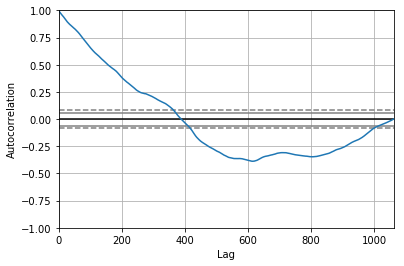

<Figure size 800x560 with 0 Axes>

Test MSE: 0.303


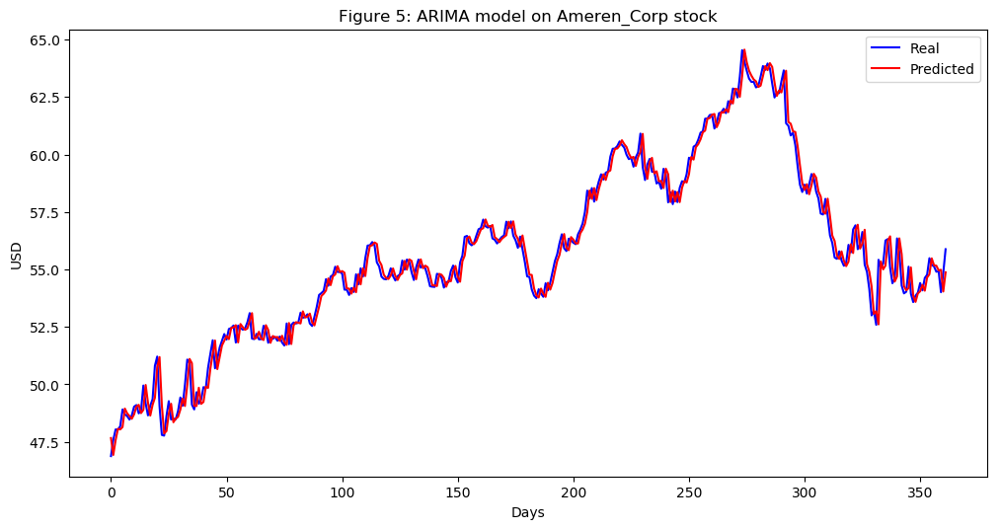

In [442]:
Ameren_Corp_series = SP500_TechIndicator['Ameren_Corp_Close']
Ameren_Corp_series_model = ARIMA(Ameren_Corp_series, order=(5, 1, 0))
Ameren_Corp_model_fit = Ameren_Corp_series_model.fit(disp=0)
print(Ameren_Corp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Ameren_Corp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Ameren_Corp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Ameren_Corp_predictions = list()
for t in range(len(test)):
    Ameren_Corp_series_model = ARIMA(history, order=(5,1,0))
    Ameren_Corp_series_model_fit = Ameren_Corp_series_model.fit(disp=0)
    Ameren_Corp_output = Ameren_Corp_series_model_fit.forecast()
    yhat = Ameren_Corp_output[0]
    Ameren_Corp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Ameren_Corp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Ameren_Corp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Ameren_Corp stock')
plt.legend()
plt.show()


#predictions
Ameren_Corp_predictions = pd.DataFrame({'Ameren_Corp_predictions':Ameren_Corp_predictions})
#Ameren_Corp_predictions.to_csv('Ameren_Corp_predictions.csv')





                                    ARIMA Model Results                                    
Dep. Variable:     D.American_Electric_Power_Close   No. Observations:                 1061
Model:                              ARIMA(5, 1, 0)   Log Likelihood               -1029.603
Method:                                    css-mle   S.D. of innovations              0.639
Date:                             Sun, 17 Mar 2019   AIC                           2073.206
Time:                                     23:58:17   BIC                           2107.975
Sample:                                          1   HQIC                          2086.383
                                                                                           
                                            coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------
const                                     0.0204    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


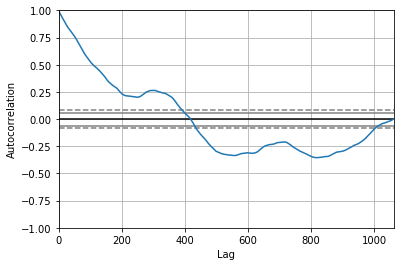

<Figure size 800x560 with 0 Axes>

Test MSE: 0.357


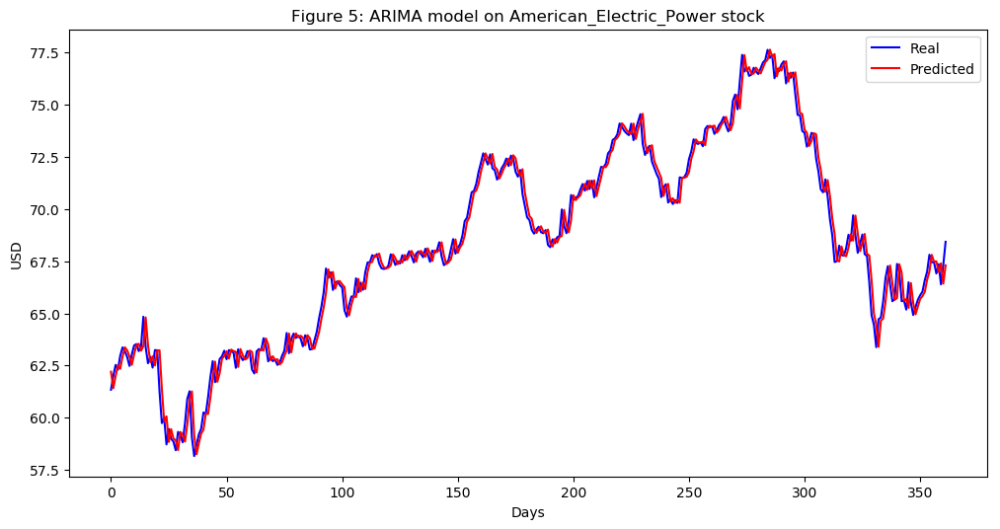

In [443]:
American_Electric_Power_series = SP500_TechIndicator['American_Electric_Power_Close']
American_Electric_Power_series_model = ARIMA(American_Electric_Power_series, order=(5, 1, 0))
American_Electric_Power_model_fit = American_Electric_Power_series_model.fit(disp=0)
print(American_Electric_Power_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(American_Electric_Power_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = American_Electric_Power_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
American_Electric_Power_predictions = list()
for t in range(len(test)):
    American_Electric_Power_series_model = ARIMA(history, order=(5,1,0))
    American_Electric_Power_series_model_fit = American_Electric_Power_series_model.fit(disp=0)
    American_Electric_Power_output = American_Electric_Power_series_model_fit.forecast()
    yhat = American_Electric_Power_output[0]
    American_Electric_Power_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, American_Electric_Power_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(American_Electric_Power_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on American_Electric_Power stock')
plt.legend()
plt.show()


#predictions
American_Electric_Power_predictions = pd.DataFrame({'American_Electric_Power_predictions':American_Electric_Power_predictions})
#American_Electric_Power_predictions.to_csv('American_Electric_Power_predictions.csv')





                                      ARIMA Model Results                                       
Dep. Variable:     D.American_Water_Works_Company_Close   No. Observations:                 1061
Model:                                   ARIMA(5, 1, 0)   Log Likelihood               -1120.133
Method:                                         css-mle   S.D. of innovations              0.695
Date:                                  Sun, 17 Mar 2019   AIC                           2254.266
Time:                                          23:59:42   BIC                           2289.035
Sample:                                               1   HQIC                          2267.443
                                                                                                
                                                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------------
co

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


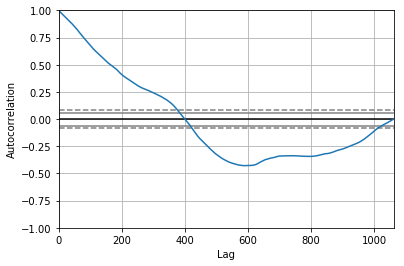

<Figure size 800x560 with 0 Axes>

Test MSE: 0.623


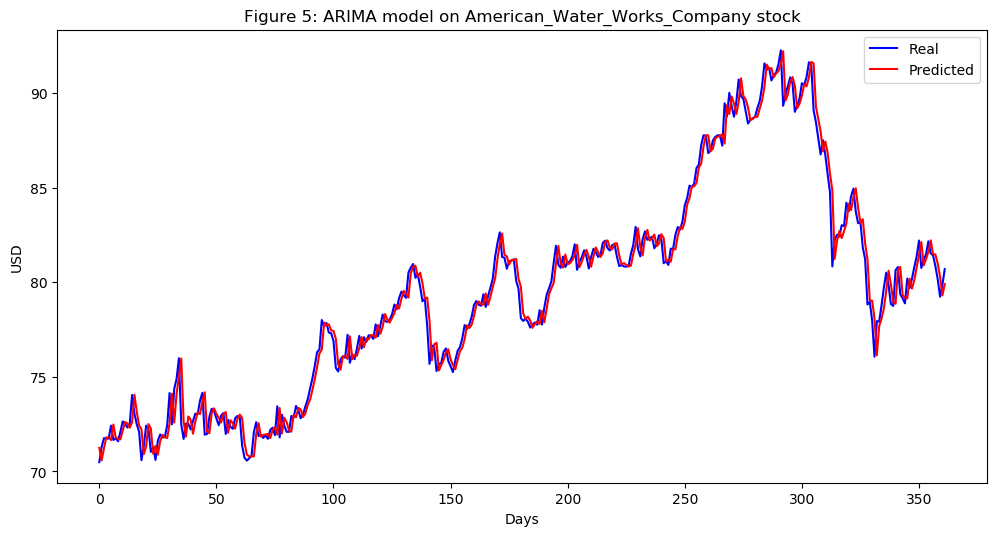

In [444]:
American_Water_Works_Company_series = SP500_TechIndicator['American_Water_Works_Company_Close']
American_Water_Works_Company_series_model = ARIMA(American_Water_Works_Company_series, order=(5, 1, 0))
American_Water_Works_Company_model_fit = American_Water_Works_Company_series_model.fit(disp=0)
print(American_Water_Works_Company_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(American_Water_Works_Company_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = American_Water_Works_Company_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
American_Water_Works_Company_predictions = list()
for t in range(len(test)):
    American_Water_Works_Company_series_model = ARIMA(history, order=(5,1,0))
    American_Water_Works_Company_series_model_fit = American_Water_Works_Company_series_model.fit(disp=0)
    American_Water_Works_Company_output = American_Water_Works_Company_series_model_fit.forecast()
    yhat = American_Water_Works_Company_output[0]
    American_Water_Works_Company_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, American_Water_Works_Company_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(American_Water_Works_Company_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on American_Water_Works_Company stock')
plt.legend()
plt.show()


#predictions
American_Water_Works_Company_predictions = pd.DataFrame({'American_Water_Works_Company_predictions':American_Water_Works_Company_predictions})
#American_Water_Works_Company_predictions.to_csv('American_Water_Works_Company_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:     D.CMS_Energy_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -519.368
Method:                       css-mle   S.D. of innovations              0.395
Date:                Mon, 18 Mar 2019   AIC                           1052.737
Time:                        00:01:07   BIC                           1087.505
Sample:                             1   HQIC                          1065.913
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0169      0.012      1.397      0.163      -0.007       0.041
ar.L1.D.CMS_Energy_Close    -0.0105      0.031     -0.342      0.733      -0.071       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


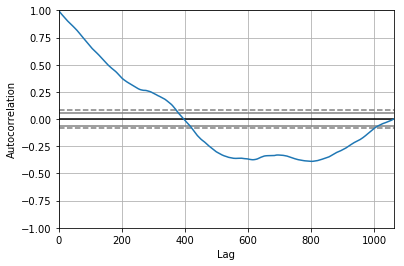

<Figure size 800x560 with 0 Axes>

Test MSE: 0.155


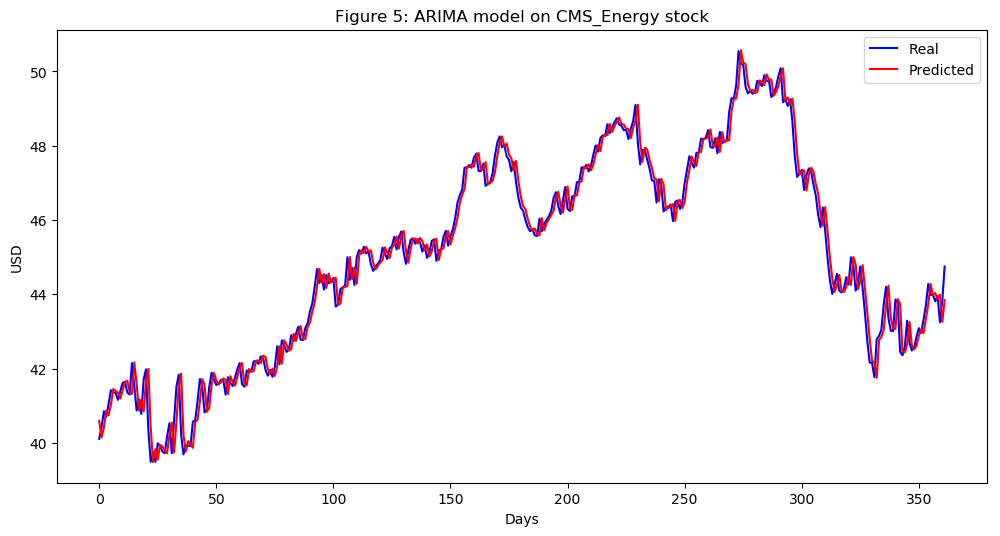

In [445]:
CMS_Energy_series = SP500_TechIndicator['CMS_Energy_Close']
CMS_Energy_series_model = ARIMA(CMS_Energy_series, order=(5, 1, 0))
CMS_Energy_model_fit = CMS_Energy_series_model.fit(disp=0)
print(CMS_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(CMS_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = CMS_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
CMS_Energy_predictions = list()
for t in range(len(test)):
    CMS_Energy_series_model = ARIMA(history, order=(5,1,0))
    CMS_Energy_series_model_fit = CMS_Energy_series_model.fit(disp=0)
    CMS_Energy_output = CMS_Energy_series_model_fit.forecast()
    yhat = CMS_Energy_output[0]
    CMS_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, CMS_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(CMS_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on CMS_Energy stock')
plt.legend()
plt.show()


#predictions
CMS_Energy_predictions = pd.DataFrame({'CMS_Energy_predictions':CMS_Energy_predictions})
#CMS_Energy_predictions.to_csv('CMS_Energy_predictions.csv')





                                  ARIMA Model Results                                  
Dep. Variable:     D.Consolidated_Edison_Close   No. Observations:                 1061
Model:                          ARIMA(5, 1, 0)   Log Likelihood               -1134.727
Method:                                css-mle   S.D. of innovations              0.705
Date:                         Mon, 18 Mar 2019   AIC                           2283.455
Time:                                 00:02:32   BIC                           2318.224
Sample:                                      1   HQIC                          2296.631
                                                                                       
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                 0.0210      0.021      0.993      0.321      -0.020   

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


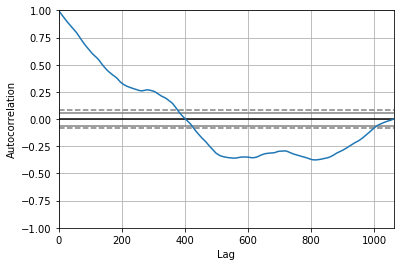

<Figure size 800x560 with 0 Axes>

Test MSE: 0.493


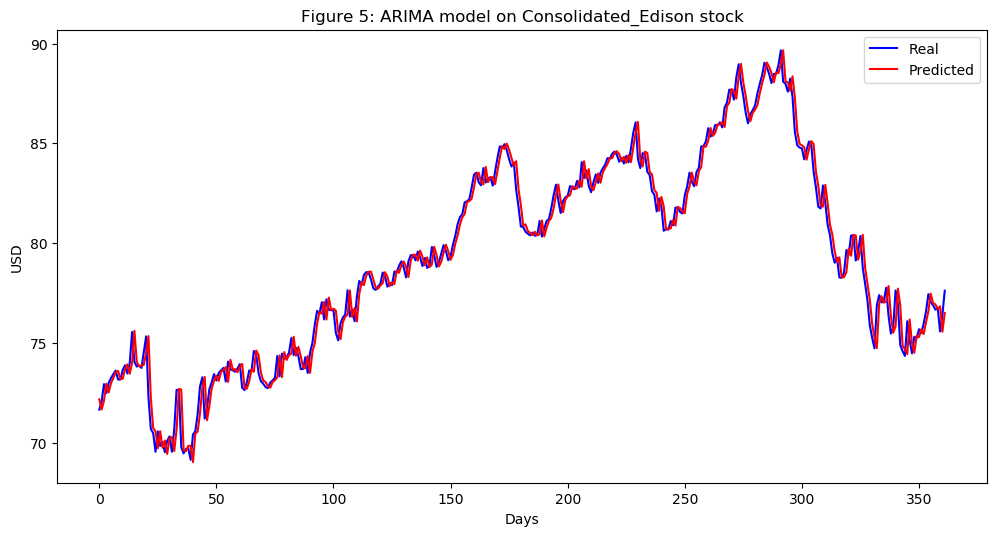

In [446]:
Consolidated_Edison_series = SP500_TechIndicator['Consolidated_Edison_Close']
Consolidated_Edison_series_model = ARIMA(Consolidated_Edison_series, order=(5, 1, 0))
Consolidated_Edison_model_fit = Consolidated_Edison_series_model.fit(disp=0)
print(Consolidated_Edison_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Consolidated_Edison_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Consolidated_Edison_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Consolidated_Edison_predictions = list()
for t in range(len(test)):
    Consolidated_Edison_series_model = ARIMA(history, order=(5,1,0))
    Consolidated_Edison_series_model_fit = Consolidated_Edison_series_model.fit(disp=0)
    Consolidated_Edison_output = Consolidated_Edison_series_model_fit.forecast()
    yhat = Consolidated_Edison_output[0]
    Consolidated_Edison_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Consolidated_Edison_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Consolidated_Edison_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Consolidated_Edison stock')
plt.legend()
plt.show()


#predictions
Consolidated_Edison_predictions = pd.DataFrame({'Consolidated_Edison_predictions':Consolidated_Edison_predictions})
#Consolidated_Edison_predictions.to_csv('Consolidated_Edison_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:     D.DTE_Energy_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1396.368
Method:                       css-mle   S.D. of innovations              0.902
Date:                Mon, 18 Mar 2019   AIC                           2806.736
Time:                        00:03:59   BIC                           2841.505
Sample:                             1   HQIC                          2819.913
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0352      0.027      1.321      0.187      -0.017       0.087
ar.L1.D.DTE_Energy_Close    -0.0251      0.031     -0.818      0.414      -0.085       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


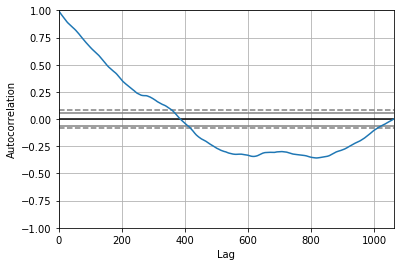

<Figure size 800x560 with 0 Axes>

Test MSE: 0.817


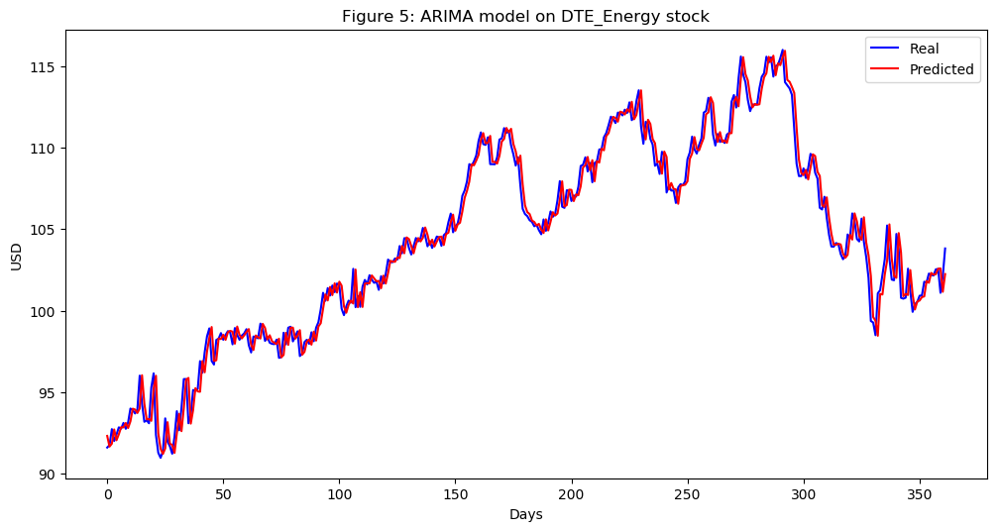

In [447]:
DTE_Energy_series = SP500_TechIndicator['DTE_Energy_Close']
DTE_Energy_series_model = ARIMA(DTE_Energy_series, order=(5, 1, 0))
DTE_Energy_model_fit = DTE_Energy_series_model.fit(disp=0)
print(DTE_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(DTE_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = DTE_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
DTE_Energy_predictions = list()
for t in range(len(test)):
    DTE_Energy_series_model = ARIMA(history, order=(5,1,0))
    DTE_Energy_series_model_fit = DTE_Energy_series_model.fit(disp=0)
    DTE_Energy_output = DTE_Energy_series_model_fit.forecast()
    yhat = DTE_Energy_output[0]
    DTE_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, DTE_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(DTE_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on DTE_Energy stock')
plt.legend()
plt.show()


#predictions
DTE_Energy_predictions = pd.DataFrame({'DTE_Energy_predictions':DTE_Energy_predictions})
#DTE_Energy_predictions.to_csv('DTE_Energy_predictions.csv')





                              ARIMA Model Results                              
Dep. Variable:     D.Duke_Energy_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -1236.988
Method:                        css-mle   S.D. of innovations              0.776
Date:                 Mon, 18 Mar 2019   AIC                           2487.977
Time:                         00:05:21   BIC                           2522.746
Sample:                              1   HQIC                          2501.153
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0076      0.024      0.317      0.752      -0.039       0.054
ar.L1.D.Duke_Energy_Close    -0.0366      0.031     -1.194      0.233      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


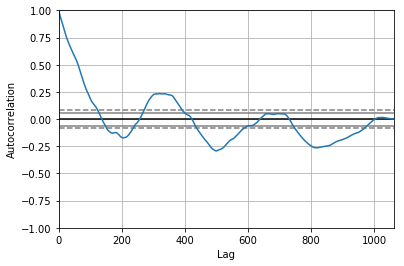

<Figure size 800x560 with 0 Axes>

Test MSE: 0.477


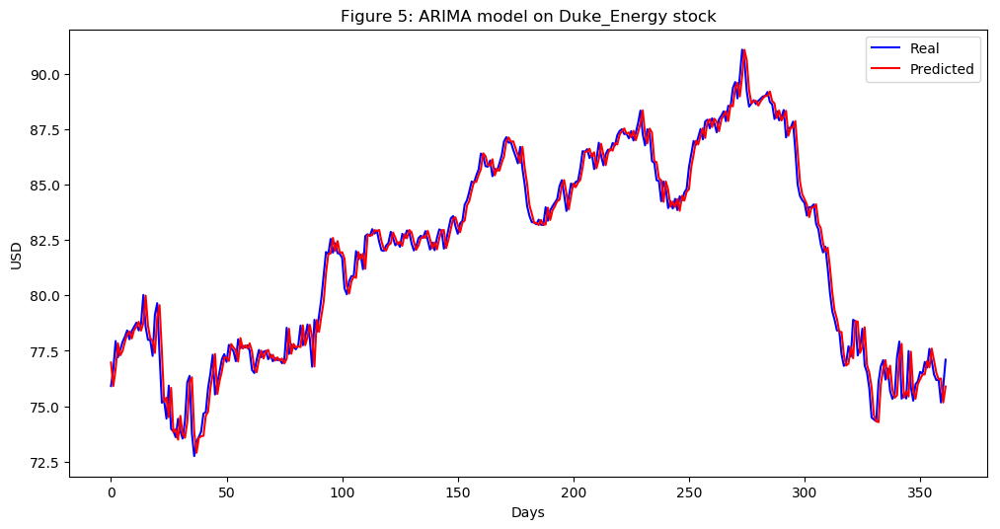

In [448]:
Duke_Energy_series = SP500_TechIndicator['Duke_Energy_Close']
Duke_Energy_series_model = ARIMA(Duke_Energy_series, order=(5, 1, 0))
Duke_Energy_model_fit = Duke_Energy_series_model.fit(disp=0)
print(Duke_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Duke_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Duke_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Duke_Energy_predictions = list()
for t in range(len(test)):
    Duke_Energy_series_model = ARIMA(history, order=(5,1,0))
    Duke_Energy_series_model_fit = Duke_Energy_series_model.fit(disp=0)
    Duke_Energy_output = Duke_Energy_series_model_fit.forecast()
    yhat = Duke_Energy_output[0]
    Duke_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Duke_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Duke_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Duke_Energy stock')
plt.legend()
plt.show()


#predictions
Duke_Energy_predictions = pd.DataFrame({'Duke_Energy_predictions':Duke_Energy_predictions})
#Duke_Energy_predictions.to_csv('Duke_Energy_predictions.csv')





                                ARIMA Model Results                                
Dep. Variable:     D.Dominion_Energy_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1238.663
Method:                            css-mle   S.D. of innovations              0.778
Date:                     Mon, 18 Mar 2019   AIC                           2491.327
Time:                             00:06:44   BIC                           2526.095
Sample:                                  1   HQIC                          2504.503
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0042      0.022      0.193      0.847      -0.039       0.047
ar.L1.D.Dominion_Energy_Close    -

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


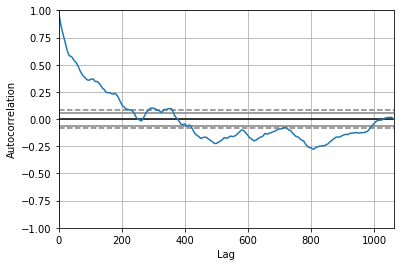

<Figure size 800x560 with 0 Axes>

Test MSE: 0.550


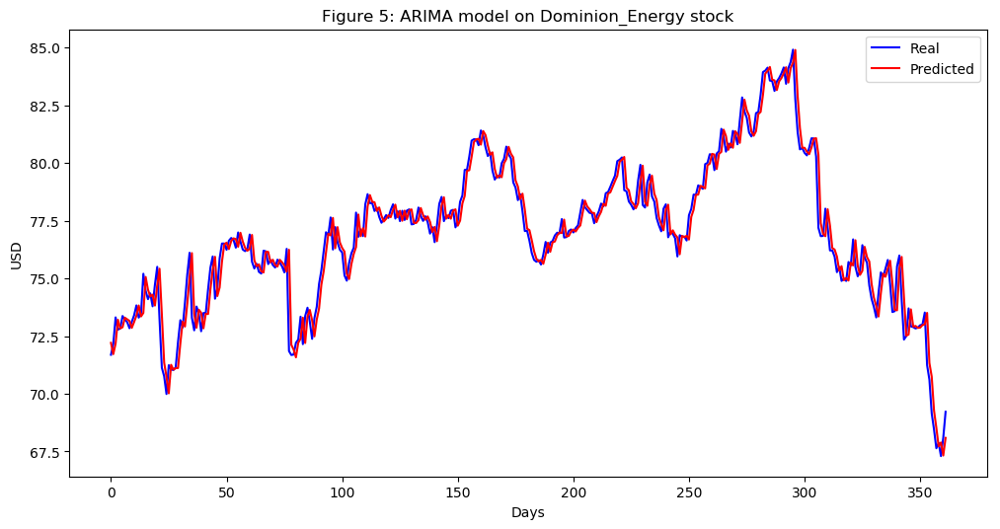

In [449]:
Dominion_Energy_series = SP500_TechIndicator['Dominion_Energy_Close']
Dominion_Energy_series_model = ARIMA(Dominion_Energy_series, order=(5, 1, 0))
Dominion_Energy_model_fit = Dominion_Energy_series_model.fit(disp=0)
print(Dominion_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Dominion_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Dominion_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Dominion_Energy_predictions = list()
for t in range(len(test)):
    Dominion_Energy_series_model = ARIMA(history, order=(5,1,0))
    Dominion_Energy_series_model_fit = Dominion_Energy_series_model.fit(disp=0)
    Dominion_Energy_output = Dominion_Energy_series_model_fit.forecast()
    yhat = Dominion_Energy_output[0]
    Dominion_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Dominion_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Dominion_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Dominion_Energy stock')
plt.legend()
plt.show()


#predictions
Dominion_Energy_predictions = pd.DataFrame({'Dominion_Energy_predictions':Dominion_Energy_predictions})
#Dominion_Energy_predictions.to_csv('Dominion_Energy_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:     D.Edison_Int_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1268.946
Method:                       css-mle   S.D. of innovations              0.800
Date:                Mon, 18 Mar 2019   AIC                           2551.892
Time:                        00:07:48   BIC                           2586.660
Sample:                             1   HQIC                          2565.068
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0158      0.023      0.674      0.501      -0.030       0.062
ar.L1.D.Edison_Int_Close    -0.0182      0.031     -0.595      0.552      -0.078       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


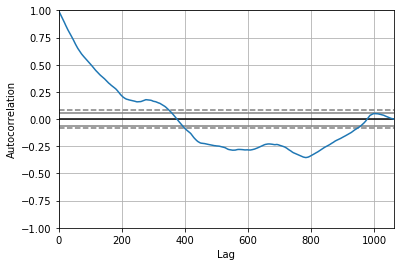

<Figure size 800x560 with 0 Axes>

Test MSE: 0.925


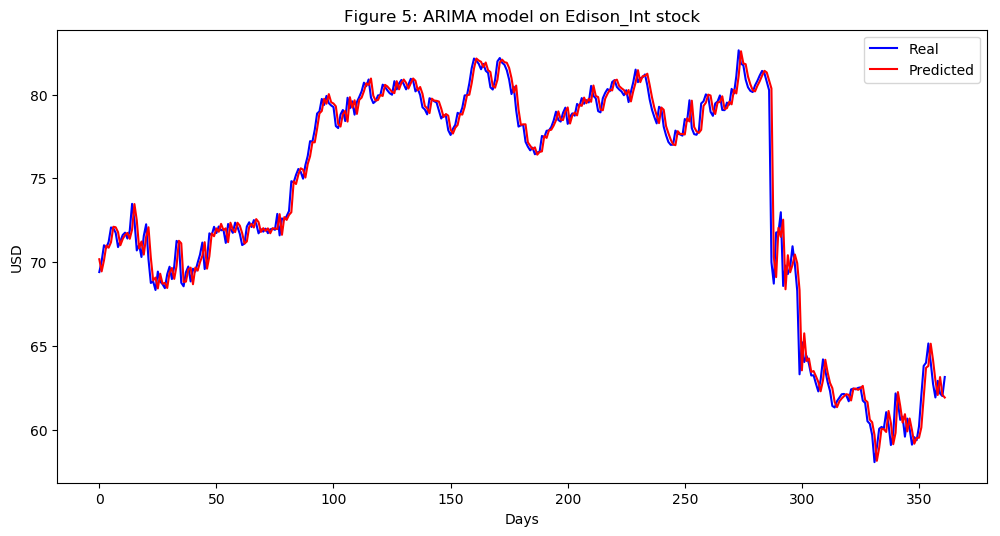

In [450]:
Edison_Int_series = SP500_TechIndicator['Edison_Int_Close']
Edison_Int_series_model = ARIMA(Edison_Int_series, order=(5, 1, 0))
Edison_Int_model_fit = Edison_Int_series_model.fit(disp=0)
print(Edison_Int_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Edison_Int_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Edison_Int_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Edison_Int_predictions = list()
for t in range(len(test)):
    Edison_Int_series_model = ARIMA(history, order=(5,1,0))
    Edison_Int_series_model_fit = Edison_Int_series_model.fit(disp=0)
    Edison_Int_output = Edison_Int_series_model_fit.forecast()
    yhat = Edison_Int_output[0]
    Edison_Int_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Edison_Int_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Edison_Int_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Edison_Int stock')
plt.legend()
plt.show()


#predictions
Edison_Int_predictions = pd.DataFrame({'Edison_Int_predictions':Edison_Int_predictions})
#Edison_Int_predictions.to_csv('Edison_Int_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:        D.Entergy_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1318.221
Method:                       css-mle   S.D. of innovations              0.838
Date:                Mon, 18 Mar 2019   AIC                           2650.441
Time:                        00:09:06   BIC                           2685.210
Sample:                             1   HQIC                          2663.618
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.0150      0.026      0.582      0.561      -0.036       0.066
ar.L1.D.Entergy_Close    -0.0308      0.031     -1.002      0.317      -0.091       0.029
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


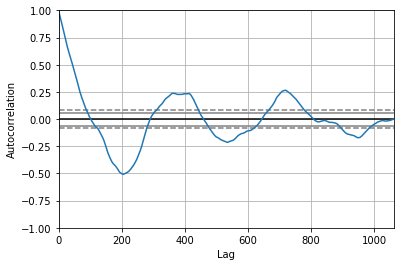

<Figure size 800x560 with 0 Axes>

Test MSE: 0.569


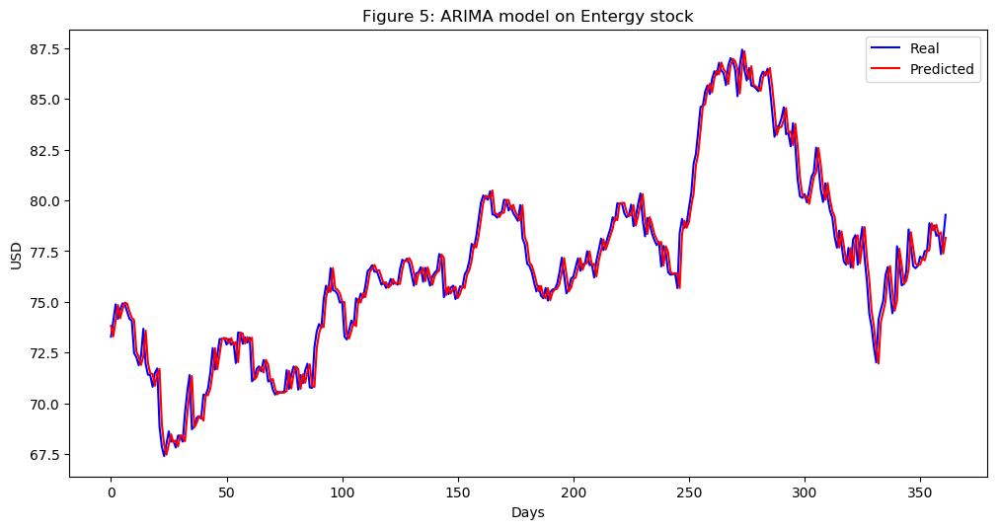

In [451]:
Entergy_series = SP500_TechIndicator['Entergy_Close']
Entergy_series_model = ARIMA(Entergy_series, order=(5, 1, 0))
Entergy_model_fit = Entergy_series_model.fit(disp=0)
print(Entergy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Entergy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Entergy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Entergy_predictions = list()
for t in range(len(test)):
    Entergy_series_model = ARIMA(history, order=(5,1,0))
    Entergy_series_model_fit = Entergy_series_model.fit(disp=0)
    Entergy_output = Entergy_series_model_fit.forecast()
    yhat = Entergy_output[0]
    Entergy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Entergy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Entergy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Entergy stock')
plt.legend()
plt.show()


#predictions
Entergy_predictions = pd.DataFrame({'Entergy_predictions':Entergy_predictions})
#Entergy_predictions.to_csv('Entergy_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:         D.Evergy_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -2089.101
Method:                       css-mle   S.D. of innovations              1.733
Date:                Mon, 18 Mar 2019   AIC                           4192.202
Time:                        00:10:28   BIC                           4226.971
Sample:                             1   HQIC                          4205.379
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0027      0.055      0.049      0.961      -0.105       0.110
ar.L1.D.Evergy_Close     0.0297      0.031      0.969      0.333      -0.030       0.090
ar.L2.D.Ever

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


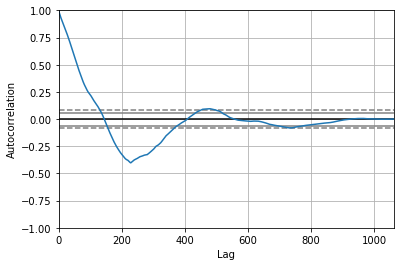

<Figure size 800x560 with 0 Axes>

/Users/ujash/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test MSE: 8.009


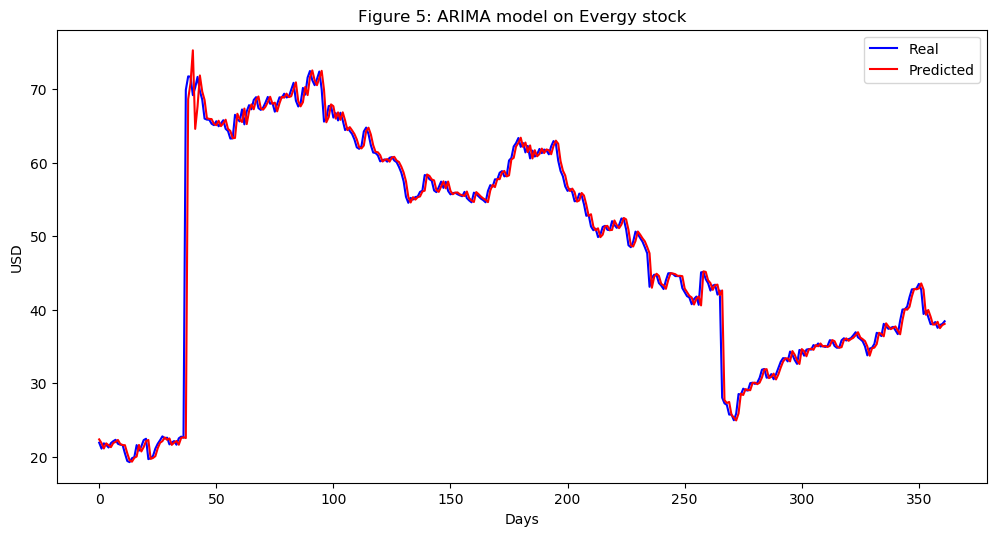

In [452]:
Evergy_series = SP500_TechIndicator['Evergy_Close']
Evergy_series_model = ARIMA(Evergy_series, order=(5, 1, 0))
Evergy_model_fit = Evergy_series_model.fit(disp=0)
print(Evergy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Evergy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Evergy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Evergy_predictions = list()
for t in range(len(test)):
    Evergy_series_model = ARIMA(history, order=(5,1,0))
    Evergy_series_model_fit = Evergy_series_model.fit(disp=0)
    Evergy_output = Evergy_series_model_fit.forecast()
    yhat = Evergy_output[0]
    Evergy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Evergy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Evergy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Evergy stock')
plt.legend()
plt.show()


#predictions
Evergy_predictions = pd.DataFrame({'Evergy_predictions':Evergy_predictions})
#Evergy_predictions.to_csv('Evergy_predictions.csv')





                                 ARIMA Model Results                                 
Dep. Variable:     D.Eversource_Energy_Close   No. Observations:                 1061
Model:                        ARIMA(5, 1, 0)   Log Likelihood                -906.764
Method:                              css-mle   S.D. of innovations              0.569
Date:                       Mon, 18 Mar 2019   AIC                           1827.529
Time:                               00:11:34   BIC                           1862.297
Sample:                                    1   HQIC                          1840.705
                                                                                     
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                               0.0152      0.016      0.949      0.343      -0.016       0.047
ar.L1.D.Ever

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


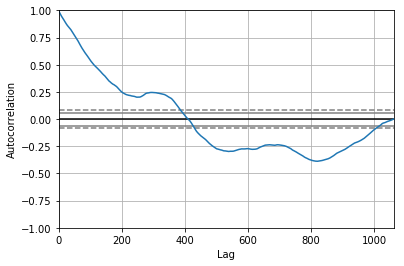

<Figure size 800x560 with 0 Axes>

Test MSE: 0.337


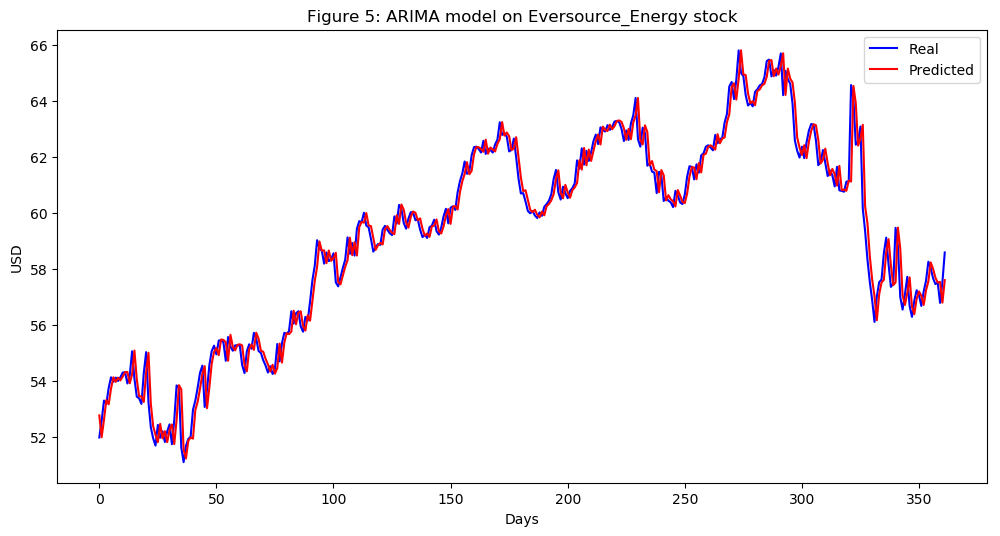

In [453]:
Eversource_Energy_series = SP500_TechIndicator['Eversource_Energy_Close']
Eversource_Energy_series_model = ARIMA(Eversource_Energy_series, order=(5, 1, 0))
Eversource_Energy_model_fit = Eversource_Energy_series_model.fit(disp=0)
print(Eversource_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Eversource_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Eversource_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Eversource_Energy_predictions = list()
for t in range(len(test)):
    Eversource_Energy_series_model = ARIMA(history, order=(5,1,0))
    Eversource_Energy_series_model_fit = Eversource_Energy_series_model.fit(disp=0)
    Eversource_Energy_output = Eversource_Energy_series_model_fit.forecast()
    yhat = Eversource_Energy_output[0]
    Eversource_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Eversource_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Eversource_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Eversource_Energy stock')
plt.legend()
plt.show()


#predictions
Eversource_Energy_predictions = pd.DataFrame({'Eversource_Energy_predictions':Eversource_Energy_predictions})
#Eversource_Energy_predictions.to_csv('Eversource_Energy_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:         D.Exelon_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -637.475
Method:                       css-mle   S.D. of innovations              0.441
Date:                Mon, 18 Mar 2019   AIC                           1288.950
Time:                        00:13:00   BIC                           1323.719
Sample:                             1   HQIC                          1302.126
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.0105      0.013      0.786      0.432      -0.016       0.037
ar.L1.D.Exelon_Close    -0.0224      0.031     -0.731      0.465      -0.083       0.038
ar.L2.D.Exel

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


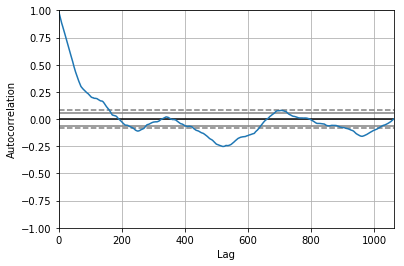

<Figure size 800x560 with 0 Axes>

Test MSE: 0.157


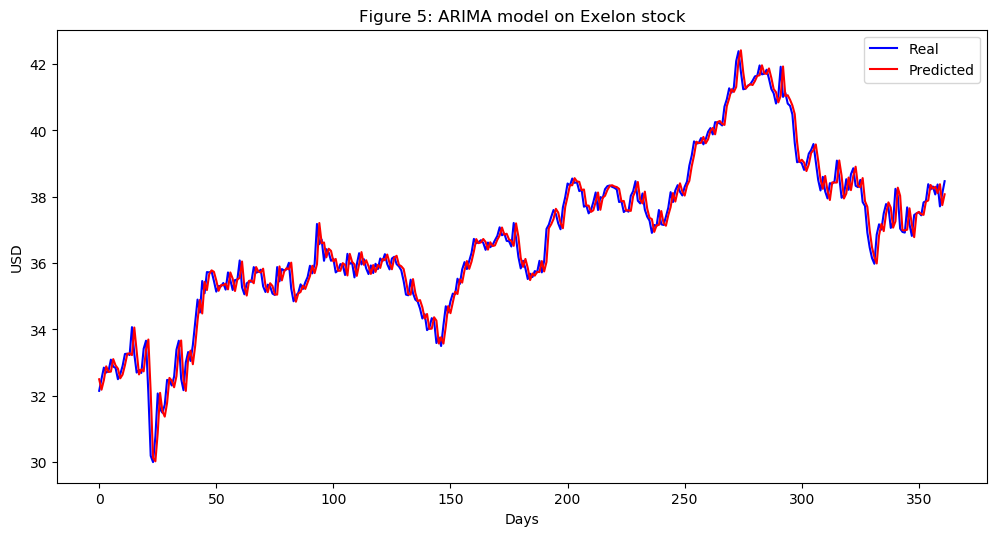

In [454]:
Exelon_series = SP500_TechIndicator['Exelon_Close']
Exelon_series_model = ARIMA(Exelon_series, order=(5, 1, 0))
Exelon_model_fit = Exelon_series_model.fit(disp=0)
print(Exelon_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Exelon_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Exelon_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Exelon_predictions = list()
for t in range(len(test)):
    Exelon_series_model = ARIMA(history, order=(5,1,0))
    Exelon_series_model_fit = Exelon_series_model.fit(disp=0)
    Exelon_output = Exelon_series_model_fit.forecast()
    yhat = Exelon_output[0]
    Exelon_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Exelon_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Exelon_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Exelon stock')
plt.legend()
plt.show()


#predictions
Exelon_predictions = pd.DataFrame({'Exelon_predictions':Exelon_predictions})
#Exelon_predictions.to_csv('Exelon_predictions.csv')





                              ARIMA Model Results                              
Dep. Variable:     D.FirstEnergy_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood                -669.147
Method:                        css-mle   S.D. of innovations              0.455
Date:                 Mon, 18 Mar 2019   AIC                           1352.295
Time:                         00:14:50   BIC                           1387.063
Sample:                              1   HQIC                          1365.471
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0015      0.013      0.111      0.912      -0.024       0.027
ar.L1.D.FirstEnergy_Close    -0.0682      0.031     -2.224      0.026      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


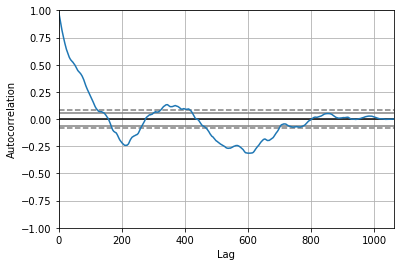

<Figure size 800x560 with 0 Axes>

Test MSE: 0.164


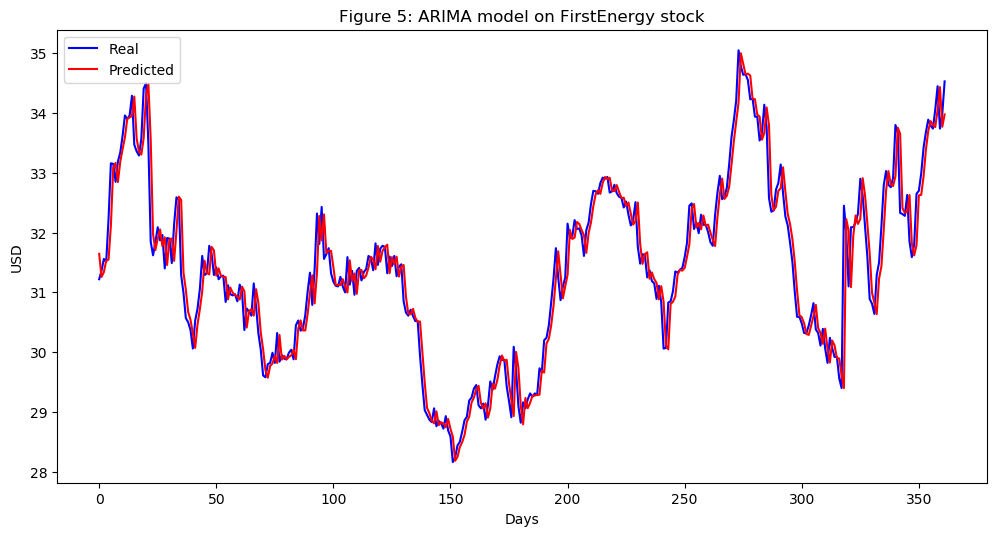

In [455]:
FirstEnergy_series = SP500_TechIndicator['FirstEnergy_Close']
FirstEnergy_series_model = ARIMA(FirstEnergy_series, order=(5, 1, 0))
FirstEnergy_model_fit = FirstEnergy_series_model.fit(disp=0)
print(FirstEnergy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(FirstEnergy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = FirstEnergy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
FirstEnergy_predictions = list()
for t in range(len(test)):
    FirstEnergy_series_model = ARIMA(history, order=(5,1,0))
    FirstEnergy_series_model_fit = FirstEnergy_series_model.fit(disp=0)
    FirstEnergy_output = FirstEnergy_series_model_fit.forecast()
    yhat = FirstEnergy_output[0]
    FirstEnergy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, FirstEnergy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(FirstEnergy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on FirstEnergy stock')
plt.legend()
plt.show()


#predictions
FirstEnergy_predictions = pd.DataFrame({'FirstEnergy_predictions':FirstEnergy_predictions})
#FirstEnergy_predictions.to_csv('FirstEnergy_predictions.csv')





                               ARIMA Model Results                                
Dep. Variable:     D.NextEra_Energy_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1704.982
Method:                           css-mle   S.D. of innovations              1.207
Date:                    Mon, 18 Mar 2019   AIC                           3423.963
Time:                            00:16:30   BIC                           3458.732
Sample:                                 1   HQIC                          3437.140
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0724      0.033      2.198      0.028       0.008       0.137
ar.L1.D.NextEra_Energy_Close    -0.0187      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


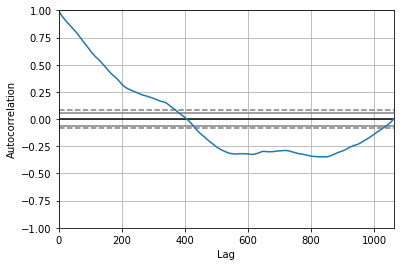

<Figure size 800x560 with 0 Axes>

Test MSE: 1.733


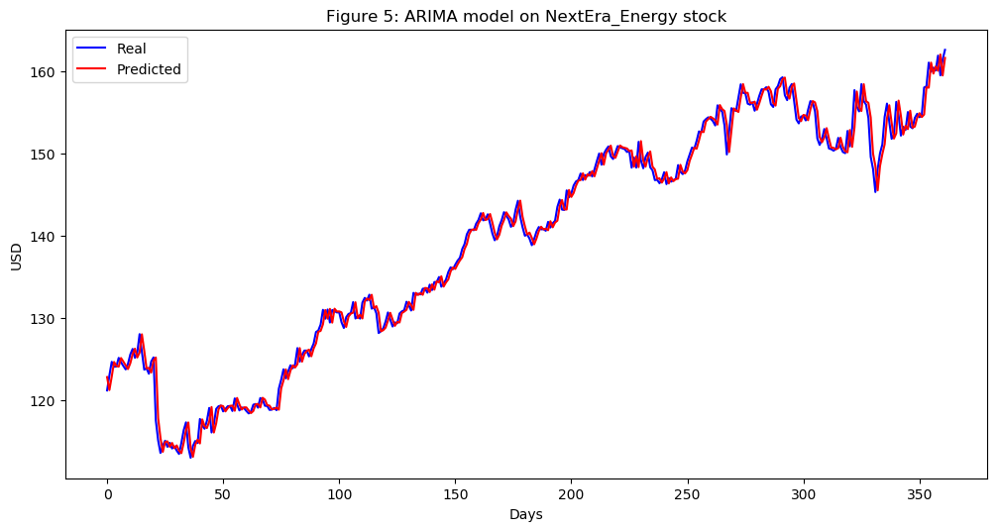

In [456]:
NextEra_Energy_series = SP500_TechIndicator['NextEra_Energy_Close']
NextEra_Energy_series_model = ARIMA(NextEra_Energy_series, order=(5, 1, 0))
NextEra_Energy_model_fit = NextEra_Energy_series_model.fit(disp=0)
print(NextEra_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(NextEra_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = NextEra_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
NextEra_Energy_predictions = list()
for t in range(len(test)):
    NextEra_Energy_series_model = ARIMA(history, order=(5,1,0))
    NextEra_Energy_series_model_fit = NextEra_Energy_series_model.fit(disp=0)
    NextEra_Energy_output = NextEra_Energy_series_model_fit.forecast()
    yhat = NextEra_Energy_output[0]
    NextEra_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, NextEra_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(NextEra_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on NextEra_Energy stock')
plt.legend()
plt.show()


#predictions
NextEra_Energy_predictions = pd.DataFrame({'NextEra_Energy_predictions':NextEra_Energy_predictions})
#NextEra_Energy_predictions.to_csv('NextEra_Energy_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:       D.NiSource_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1447.365
Method:                       css-mle   S.D. of innovations              0.947
Date:                Mon, 18 Mar 2019   AIC                           2908.730
Time:                        00:17:37   BIC                           2943.498
Sample:                             1   HQIC                          2921.906
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     -0.0085      0.030     -0.282      0.778      -0.068       0.051
ar.L1.D.NiSource_Close     0.0049      0.031      0.159      0.874      -0.055       0.065
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


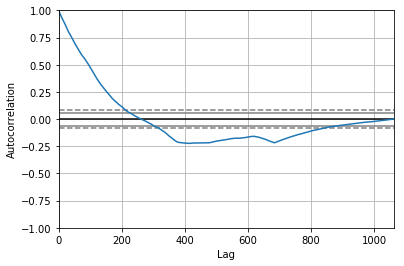

<Figure size 800x560 with 0 Axes>

Test MSE: 0.059


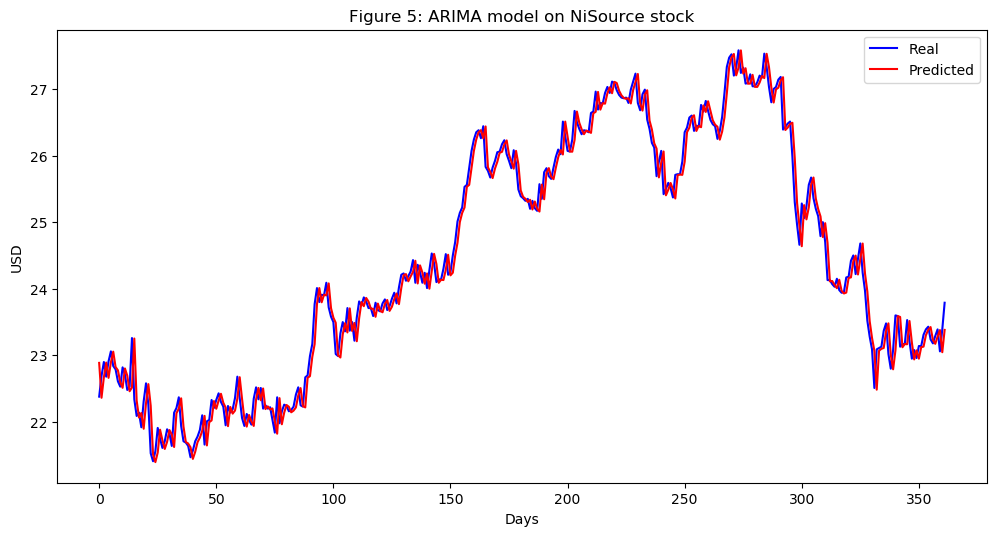

In [457]:
NiSource_series = SP500_TechIndicator['NiSource_Close']
NiSource_series_model = ARIMA(NiSource_series, order=(5, 1, 0))
NiSource_model_fit = NiSource_series_model.fit(disp=0)
print(NiSource_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(NiSource_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = NiSource_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
NiSource_predictions = list()
for t in range(len(test)):
    NiSource_series_model = ARIMA(history, order=(5,1,0))
    NiSource_series_model_fit = NiSource_series_model.fit(disp=0)
    NiSource_output = NiSource_series_model_fit.forecast()
    yhat = NiSource_output[0]
    NiSource_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, NiSource_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(NiSource_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on NiSource stock')
plt.legend()
plt.show()


#predictions
NiSource_predictions = pd.DataFrame({'NiSource_predictions':NiSource_predictions})
#NiSource_predictions.to_csv('NiSource_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:     D.NRG_Energy_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -722.420
Method:                       css-mle   S.D. of innovations              0.478
Date:                Mon, 18 Mar 2019   AIC                           1458.841
Time:                        00:18:43   BIC                           1493.609
Sample:                             1   HQIC                          1472.017
                                                                              
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0012      0.016      0.075      0.940      -0.030       0.032
ar.L1.D.NRG_Energy_Close     0.0683      0.031      2.224      0.026       0.008       0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


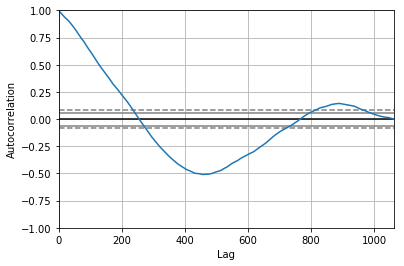

<Figure size 800x560 with 0 Axes>

Test MSE: 0.234


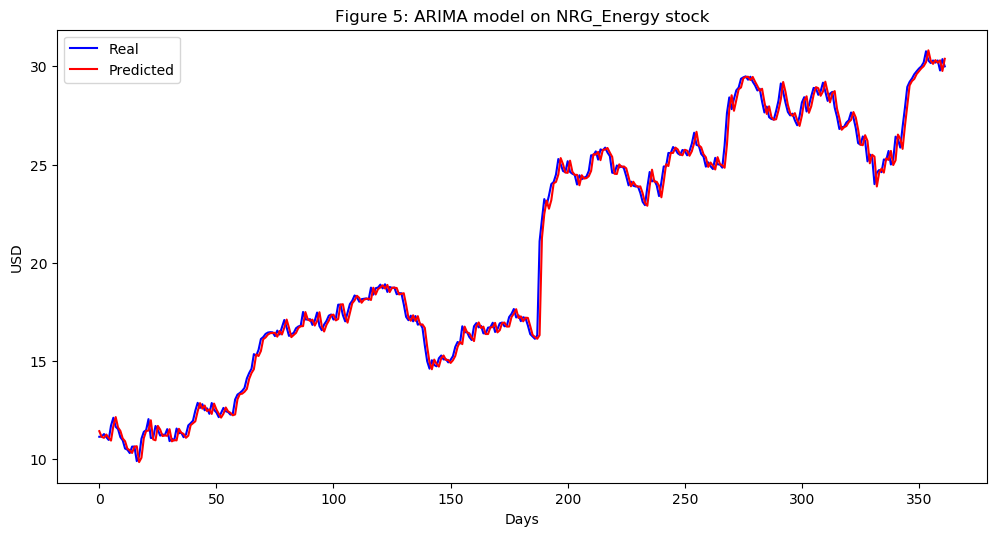

In [458]:
NRG_Energy_series = SP500_TechIndicator['NRG_Energy_Close']
NRG_Energy_series_model = ARIMA(NRG_Energy_series, order=(5, 1, 0))
NRG_Energy_model_fit = NRG_Energy_series_model.fit(disp=0)
print(NRG_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(NRG_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = NRG_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
NRG_Energy_predictions = list()
for t in range(len(test)):
    NRG_Energy_series_model = ARIMA(history, order=(5,1,0))
    NRG_Energy_series_model_fit = NRG_Energy_series_model.fit(disp=0)
    NRG_Energy_output = NRG_Energy_series_model_fit.forecast()
    yhat = NRG_Energy_output[0]
    NRG_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, NRG_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(NRG_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on NRG_Energy stock')
plt.legend()
plt.show()


#predictions
NRG_Energy_predictions = pd.DataFrame({'NRG_Energy_predictions':NRG_Energy_predictions})
#NRG_Energy_predictions.to_csv('NRG_Energy_predictions.csv')





                                   ARIMA Model Results                                   
Dep. Variable:     D.Pinnacle_West_Capital_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood               -1165.610
Method:                                  css-mle   S.D. of innovations              0.726
Date:                           Mon, 18 Mar 2019   AIC                           2345.220
Time:                                   00:20:15   BIC                           2379.989
Sample:                                        1   HQIC                          2358.396
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                   0.0249      0.023      1.087    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


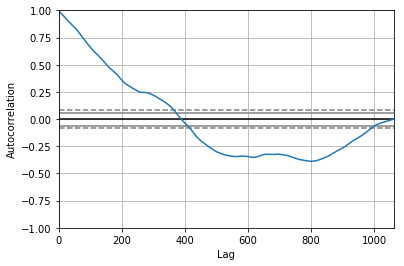

<Figure size 800x560 with 0 Axes>

Test MSE: 0.558


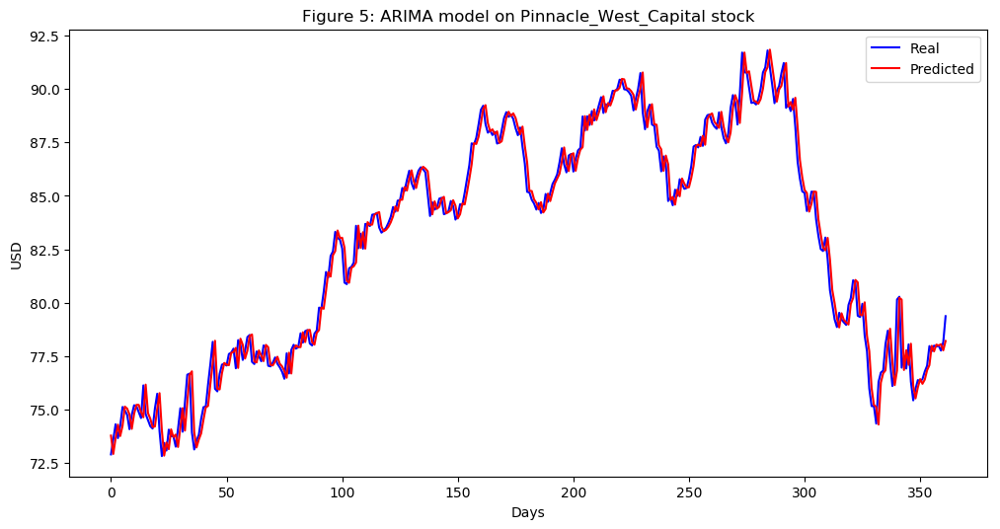

In [459]:
Pinnacle_West_Capital_series = SP500_TechIndicator['Pinnacle_West_Capital_Close']
Pinnacle_West_Capital_series_model = ARIMA(Pinnacle_West_Capital_series, order=(5, 1, 0))
Pinnacle_West_Capital_model_fit = Pinnacle_West_Capital_series_model.fit(disp=0)
print(Pinnacle_West_Capital_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Pinnacle_West_Capital_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Pinnacle_West_Capital_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Pinnacle_West_Capital_predictions = list()
for t in range(len(test)):
    Pinnacle_West_Capital_series_model = ARIMA(history, order=(5,1,0))
    Pinnacle_West_Capital_series_model_fit = Pinnacle_West_Capital_series_model.fit(disp=0)
    Pinnacle_West_Capital_output = Pinnacle_West_Capital_series_model_fit.forecast()
    yhat = Pinnacle_West_Capital_output[0]
    Pinnacle_West_Capital_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Pinnacle_West_Capital_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Pinnacle_West_Capital_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Pinnacle_West_Capital stock')
plt.legend()
plt.show()


#predictions
Pinnacle_West_Capital_predictions = pd.DataFrame({'Pinnacle_West_Capital_predictions':Pinnacle_West_Capital_predictions})
#Pinnacle_West_Capital_predictions.to_csv('Pinnacle_West_Capital_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:       D.PPL_Corp_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -492.471
Method:                       css-mle   S.D. of innovations              0.385
Date:                Mon, 18 Mar 2019   AIC                            998.942
Time:                        00:21:28   BIC                           1033.710
Sample:                             1   HQIC                          1012.118
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     -0.0021      0.012     -0.173      0.863      -0.025       0.021
ar.L1.D.PPL_Corp_Close    -0.0013      0.031     -0.042      0.967      -0.062       0.059
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


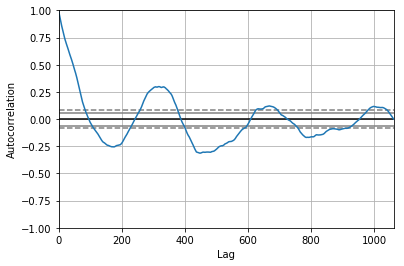

<Figure size 800x560 with 0 Axes>

Test MSE: 0.102


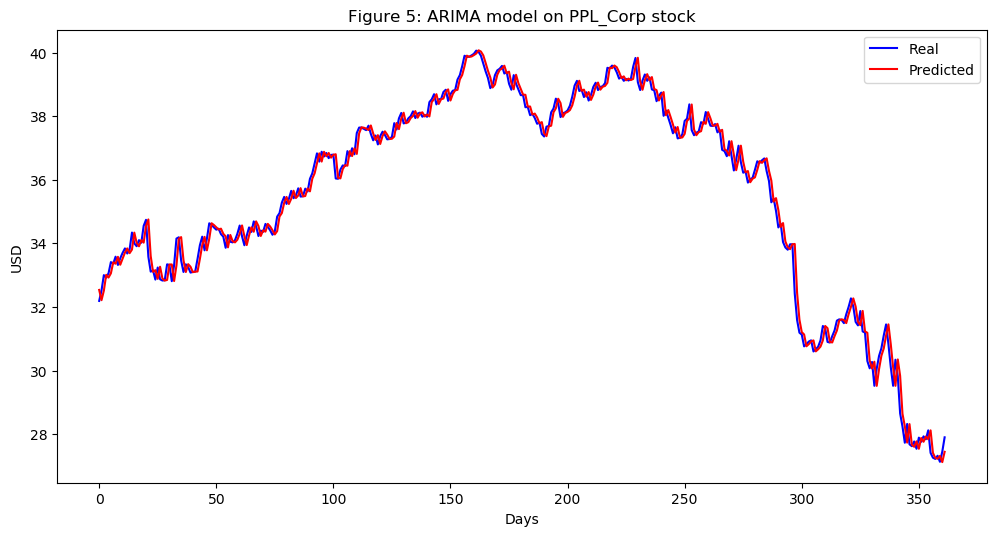

In [460]:
PPL_Corp_series = SP500_TechIndicator['PPL_Corp_Close']
PPL_Corp_series_model = ARIMA(PPL_Corp_series, order=(5, 1, 0))
PPL_Corp_model_fit = PPL_Corp_series_model.fit(disp=0)
print(PPL_Corp_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(PPL_Corp_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = PPL_Corp_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
PPL_Corp_predictions = list()
for t in range(len(test)):
    PPL_Corp_series_model = ARIMA(history, order=(5,1,0))
    PPL_Corp_series_model_fit = PPL_Corp_series_model.fit(disp=0)
    PPL_Corp_output = PPL_Corp_series_model_fit.forecast()
    yhat = PPL_Corp_output[0]
    PPL_Corp_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, PPL_Corp_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(PPL_Corp_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on PPL_Corp stock')
plt.legend()
plt.show()


#predictions
PPL_Corp_predictions = pd.DataFrame({'PPL_Corp_predictions':PPL_Corp_predictions})
#PPL_Corp_predictions.to_csv('PPL_Corp_predictions.csv')





                                   ARIMA Model Results                                    
Dep. Variable:     D.Public_Serv_Enterprise_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood                -769.492
Method:                                   css-mle   S.D. of innovations              0.500
Date:                            Mon, 18 Mar 2019   AIC                           1552.984
Time:                                    00:22:50   BIC                           1587.753
Sample:                                         1   HQIC                          1566.161
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                    0.0163      0.015    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


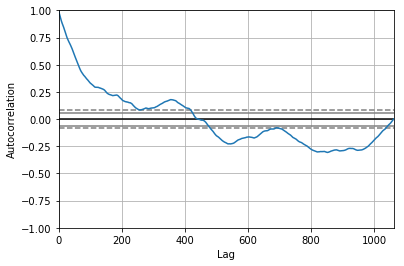

<Figure size 800x560 with 0 Axes>

Test MSE: 0.216


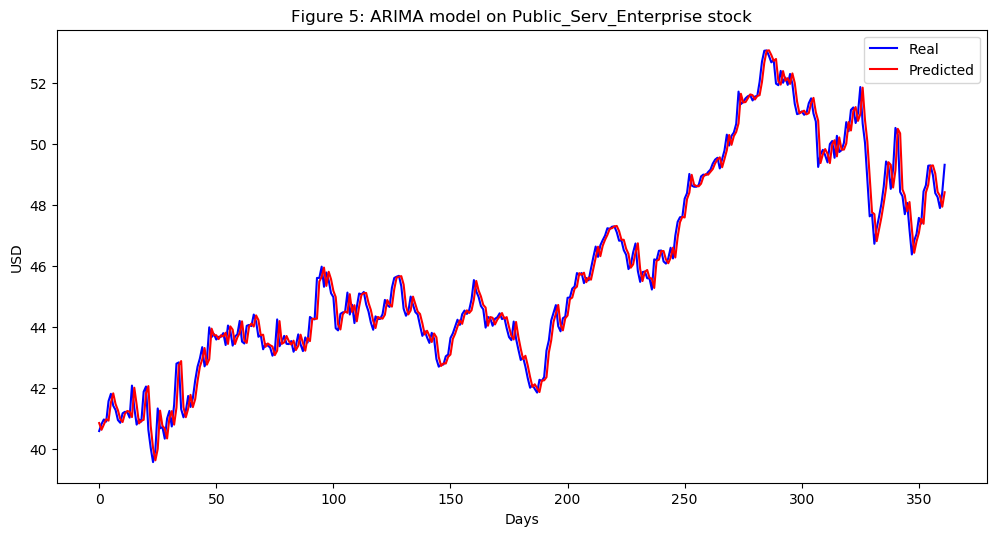

In [461]:
Public_Serv_Enterprise_series = SP500_TechIndicator['Public_Serv_Enterprise_Close']
Public_Serv_Enterprise_series_model = ARIMA(Public_Serv_Enterprise_series, order=(5, 1, 0))
Public_Serv_Enterprise_model_fit = Public_Serv_Enterprise_series_model.fit(disp=0)
print(Public_Serv_Enterprise_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Public_Serv_Enterprise_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Public_Serv_Enterprise_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Public_Serv_Enterprise_predictions = list()
for t in range(len(test)):
    Public_Serv_Enterprise_series_model = ARIMA(history, order=(5,1,0))
    Public_Serv_Enterprise_series_model_fit = Public_Serv_Enterprise_series_model.fit(disp=0)
    Public_Serv_Enterprise_output = Public_Serv_Enterprise_series_model_fit.forecast()
    yhat = Public_Serv_Enterprise_output[0]
    Public_Serv_Enterprise_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Public_Serv_Enterprise_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Public_Serv_Enterprise_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Public_Serv_Enterprise stock')
plt.legend()
plt.show()


#predictions
Public_Serv_Enterprise_predictions = pd.DataFrame({'Public_Serv_Enterprise_predictions':Public_Serv_Enterprise_predictions})
#Public_Serv_Enterprise_predictions.to_csv('Public_Serv_Enterprise_predictions.csv')





                             ARIMA Model Results                              
Dep. Variable:       D.Southern_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -653.898
Method:                       css-mle   S.D. of innovations              0.448
Date:                Mon, 18 Mar 2019   AIC                           1321.797
Time:                        00:24:34   BIC                           1356.565
Sample:                             1   HQIC                          1334.973
                                                                              
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0.0032      0.013      0.240      0.810      -0.023       0.029
ar.L1.D.Southern_Close     0.0149      0.031      0.486      0.627      -0.045       0.075
ar.L

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


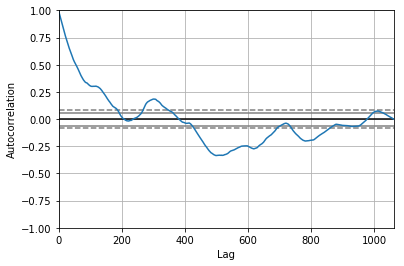

<Figure size 800x560 with 0 Axes>

Test MSE: 0.185


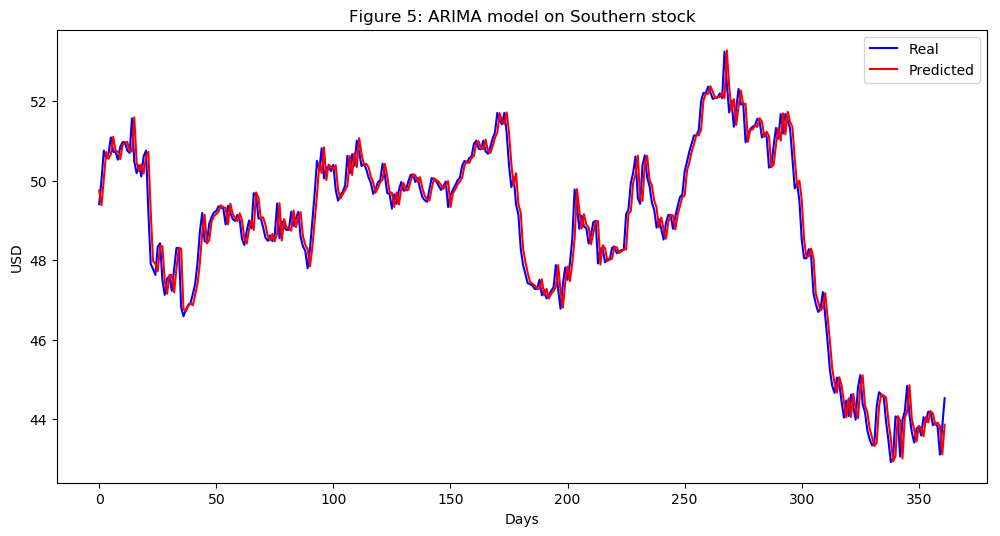

In [462]:
Southern_series = SP500_TechIndicator['Southern_Close']
Southern_series_model = ARIMA(Southern_series, order=(5, 1, 0))
Southern_model_fit = Southern_series_model.fit(disp=0)
print(Southern_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Southern_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Southern_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Southern_predictions = list()
for t in range(len(test)):
    Southern_series_model = ARIMA(history, order=(5,1,0))
    Southern_series_model_fit = Southern_series_model.fit(disp=0)
    Southern_output = Southern_series_model_fit.forecast()
    yhat = Southern_output[0]
    Southern_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Southern_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Southern_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Southern stock')
plt.legend()
plt.show()


#predictions
Southern_predictions = pd.DataFrame({'Southern_predictions':Southern_predictions})
#Southern_predictions.to_csv('Southern_predictions.csv')





                               ARIMA Model Results                               
Dep. Variable:     D.Sempra_Energy_Close   No. Observations:                 1061
Model:                    ARIMA(5, 1, 0)   Log Likelihood               -1635.486
Method:                          css-mle   S.D. of innovations              1.130
Date:                   Mon, 18 Mar 2019   AIC                           3284.973
Time:                           00:26:30   BIC                           3319.741
Sample:                                1   HQIC                          3298.149
                                                                                 
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.0201      0.032      0.626      0.531      -0.043       0.083
ar.L1.D.Sempra_Energy_Close    -0.0150      0.031     -0

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


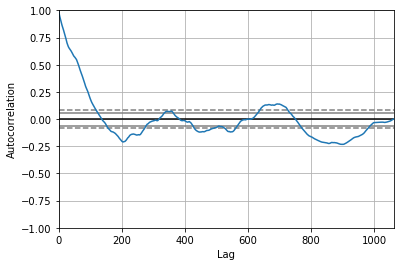

<Figure size 800x560 with 0 Axes>

Test MSE: 1.230


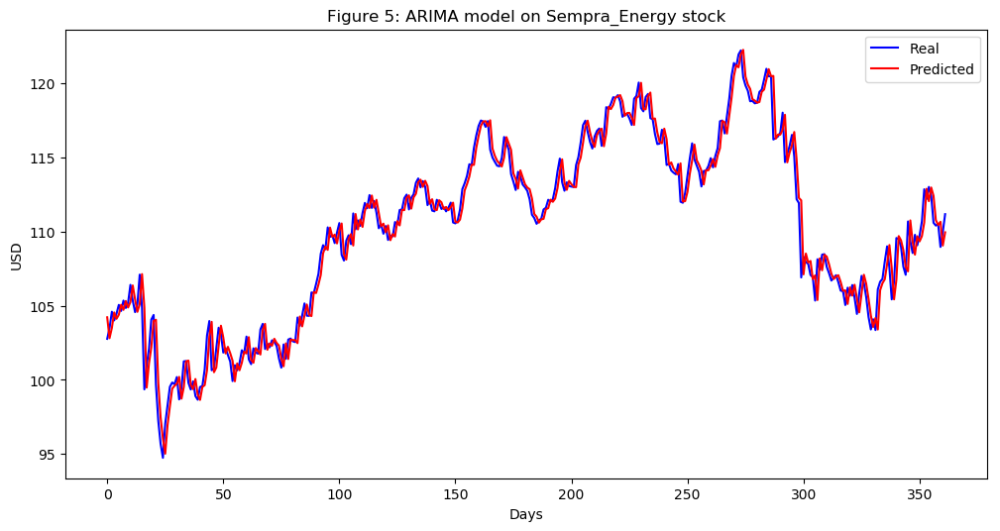

In [463]:
Sempra_Energy_series = SP500_TechIndicator['Sempra_Energy_Close']
Sempra_Energy_series_model = ARIMA(Sempra_Energy_series, order=(5, 1, 0))
Sempra_Energy_model_fit = Sempra_Energy_series_model.fit(disp=0)
print(Sempra_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Sempra_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Sempra_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Sempra_Energy_predictions = list()
for t in range(len(test)):
    Sempra_Energy_series_model = ARIMA(history, order=(5,1,0))
    Sempra_Energy_series_model_fit = Sempra_Energy_series_model.fit(disp=0)
    Sempra_Energy_output = Sempra_Energy_series_model_fit.forecast()
    yhat = Sempra_Energy_output[0]
    Sempra_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Sempra_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Sempra_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Sempra_Energy stock')
plt.legend()
plt.show()


#predictions
Sempra_Energy_predictions = pd.DataFrame({'Sempra_Energy_predictions':Sempra_Energy_predictions})
#Sempra_Energy_predictions.to_csv('Sempra_Energy_predictions.csv')





                                ARIMA Model Results                                 
Dep. Variable:     D.Wec_Energy_Group_Close   No. Observations:                 1061
Model:                       ARIMA(5, 1, 0)   Log Likelihood                -936.616
Method:                             css-mle   S.D. of innovations              0.585
Date:                      Mon, 18 Mar 2019   AIC                           1887.231
Time:                              00:27:29   BIC                           1922.000
Sample:                                   1   HQIC                          1900.408
                                                                                    
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const                              0.0197      0.018      1.106      0.269      -0.015       0.055
ar.L1.D.Wec_Energy_Grou

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


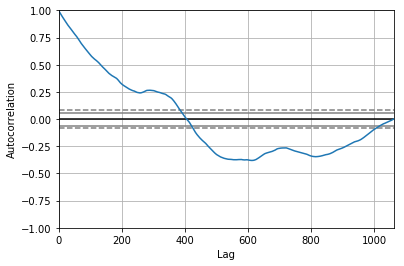

<Figure size 800x560 with 0 Axes>

Test MSE: 0.317


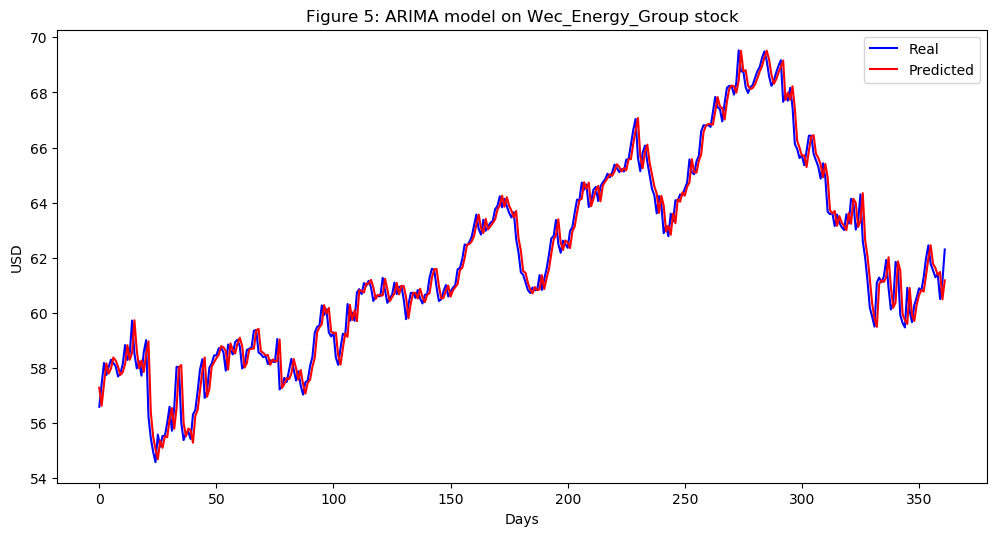

In [464]:
Wec_Energy_Group_series = SP500_TechIndicator['Wec_Energy_Group_Close']
Wec_Energy_Group_series_model = ARIMA(Wec_Energy_Group_series, order=(5, 1, 0))
Wec_Energy_Group_model_fit = Wec_Energy_Group_series_model.fit(disp=0)
print(Wec_Energy_Group_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Wec_Energy_Group_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Wec_Energy_Group_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Wec_Energy_Group_predictions = list()
for t in range(len(test)):
    Wec_Energy_Group_series_model = ARIMA(history, order=(5,1,0))
    Wec_Energy_Group_series_model_fit = Wec_Energy_Group_series_model.fit(disp=0)
    Wec_Energy_Group_output = Wec_Energy_Group_series_model_fit.forecast()
    yhat = Wec_Energy_Group_output[0]
    Wec_Energy_Group_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Wec_Energy_Group_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Wec_Energy_Group_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Wec_Energy_Group stock')
plt.legend()
plt.show()


#predictions
Wec_Energy_Group_predictions = pd.DataFrame({'Wec_Energy_Group_predictions':Wec_Energy_Group_predictions})
#Wec_Energy_Group_predictions.to_csv('Wec_Energy_Group_predictions.csv')





                              ARIMA Model Results                              
Dep. Variable:     D.Xcel_Energy_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood                -497.924
Method:                        css-mle   S.D. of innovations              0.387
Date:                 Mon, 18 Mar 2019   AIC                           1009.847
Time:                         00:28:39   BIC                           1044.616
Sample:                              1   HQIC                          1023.024
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                         0.0162      0.012      1.403      0.161      -0.006       0.039
ar.L1.D.Xcel_Energy_Close    -0.0379      0.031     -1.231      0.218      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


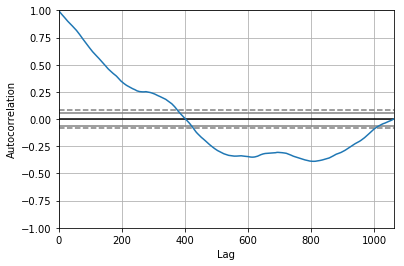

<Figure size 800x560 with 0 Axes>

Test MSE: 0.156


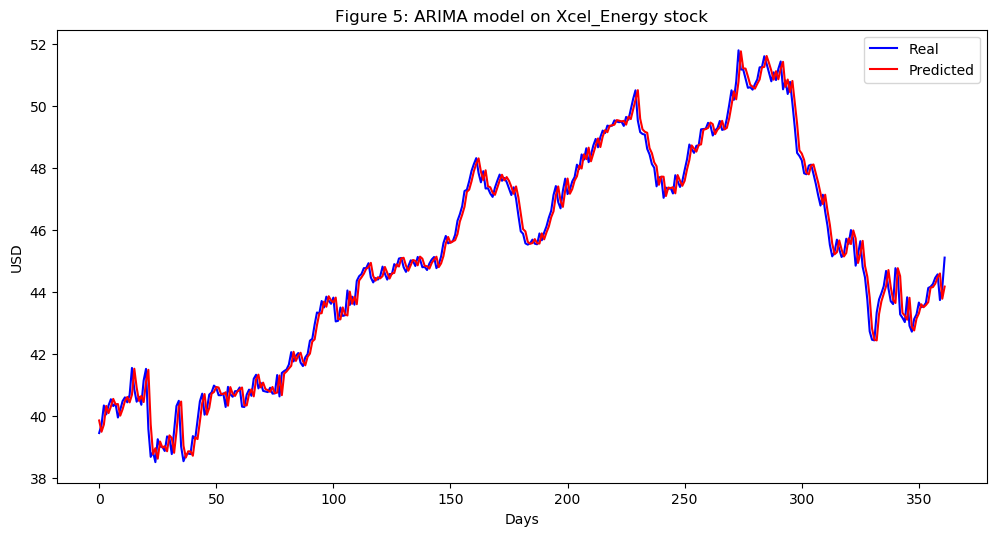

In [465]:
Xcel_Energy_series = SP500_TechIndicator['Xcel_Energy_Close']
Xcel_Energy_series_model = ARIMA(Xcel_Energy_series, order=(5, 1, 0))
Xcel_Energy_model_fit = Xcel_Energy_series_model.fit(disp=0)
print(Xcel_Energy_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Xcel_Energy_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Xcel_Energy_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Xcel_Energy_predictions = list()
for t in range(len(test)):
    Xcel_Energy_series_model = ARIMA(history, order=(5,1,0))
    Xcel_Energy_series_model_fit = Xcel_Energy_series_model.fit(disp=0)
    Xcel_Energy_output = Xcel_Energy_series_model_fit.forecast()
    yhat = Xcel_Energy_output[0]
    Xcel_Energy_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Xcel_Energy_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Xcel_Energy_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Xcel_Energy stock')
plt.legend()
plt.show()


#predictions
Xcel_Energy_predictions = pd.DataFrame({'Xcel_Energy_predictions':Xcel_Energy_predictions})
#Xcel_Energy_predictions.to_csv('Xcel_Energy_predictions.csv')





                               ARIMA Model Results                                
Dep. Variable:     D.Conagra_Brands_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1017.516
Method:                           css-mle   S.D. of innovations              0.631
Date:                    Mon, 18 Mar 2019   AIC                           2049.033
Time:                            14:50:06   BIC                           2083.802
Sample:                                 1   HQIC                          2062.209
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0024      0.018      0.133      0.894      -0.033       0.038
ar.L1.D.Conagra_Brands_Close    -0.0025      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  if __name__ == '__main__':


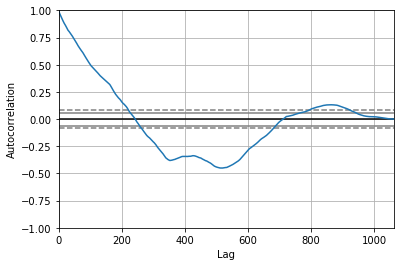

<Figure size 800x560 with 0 Axes>

Test MSE: 0.685


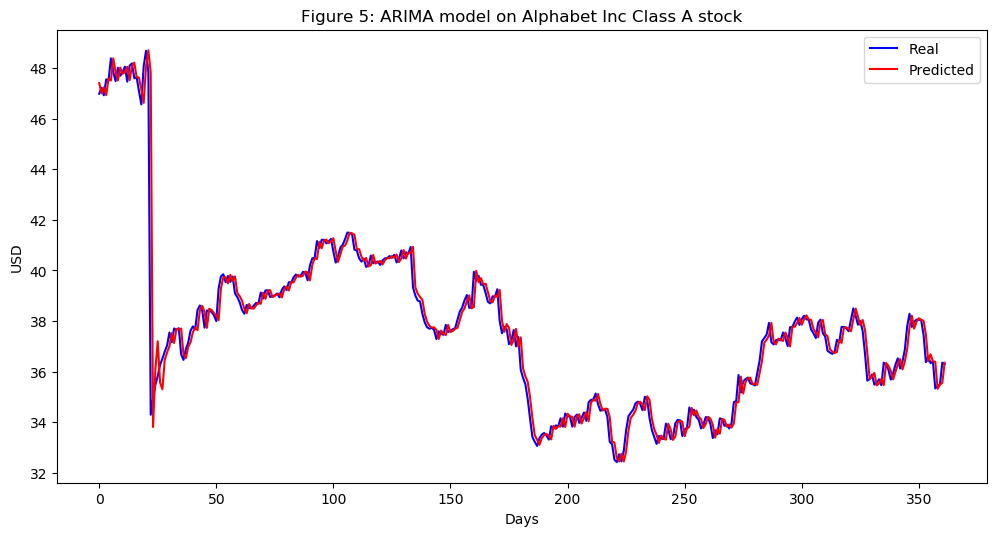

In [3]:


Conagra_Brands_series = SP500_TechIndicator['Conagra_Brands_Close']
Conagra_Brands_series_model = ARIMA(Conagra_Brands_series, order=(5, 1, 0))
Conagra_Brands_model_fit = Conagra_Brands_series_model.fit(disp=0)
print(Conagra_Brands_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Conagra_Brands_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Conagra_Brands_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Conagra_Brands_predictions = list()
for t in range(len(test)):
    Conagra_Brands_series_model = ARIMA(history, order=(5,1,0))
    Conagra_Brands_series_model_fit = Conagra_Brands_series_model.fit(disp=0)
    Conagra_Brands_output = Conagra_Brands_series_model_fit.forecast()
    yhat = Conagra_Brands_output[0]
    Conagra_Brands_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Conagra_Brands_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Conagra_Brands_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
Conagra_Brands_predictions = pd.DataFrame({'Conagra_Brands_predictions':Conagra_Brands_predictions})
#Conagra_Brands_predictions.to_csv('Conagra_Brands_predictions.csv')




                               ARIMA Model Results                                
Dep. Variable:     D.Kimberly_Clark_Close   No. Observations:                 1061
Model:                     ARIMA(5, 1, 0)   Log Likelihood               -1690.987
Method:                           css-mle   S.D. of innovations              1.191
Date:                    Mon, 18 Mar 2019   AIC                           3395.974
Time:                            14:51:41   BIC                           3430.743
Sample:                                 1   HQIC                          3409.151
                                                                                  
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.0028      0.035      0.079      0.937      -0.067       0.072
ar.L1.D.Kimberly_Clark_Close    -0.0104      

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


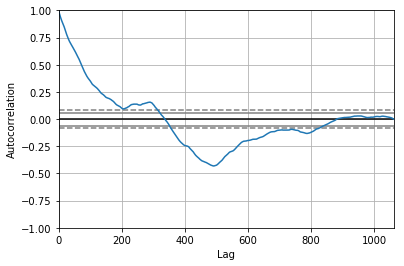

<Figure size 800x560 with 0 Axes>

Test MSE: 1.527


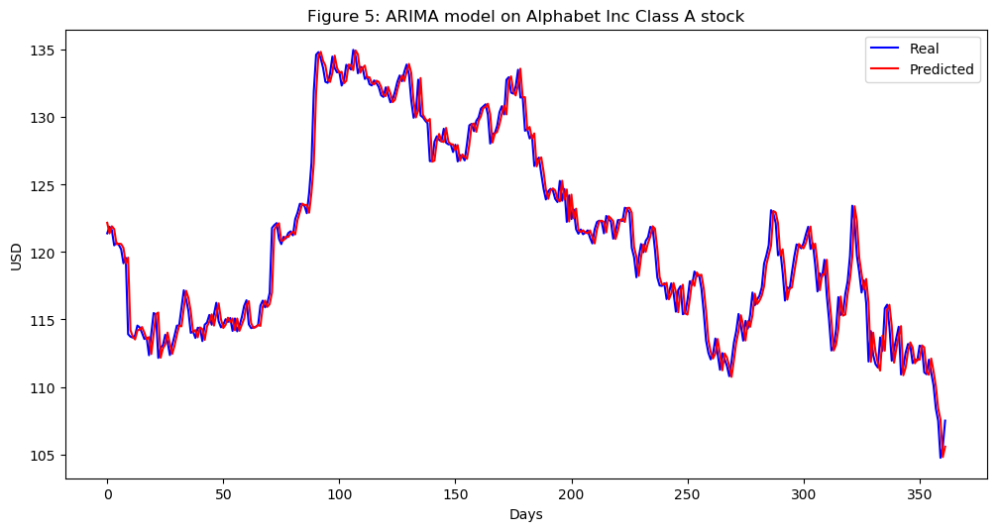

In [4]:
Kimberly_Clark_series = SP500_TechIndicator['Kimberly_Clark_Close']
Kimberly_Clark_series_model = ARIMA(Kimberly_Clark_series, order=(5, 1, 0))
Kimberly_Clark_model_fit = Kimberly_Clark_series_model.fit(disp=0)
print(Kimberly_Clark_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Kimberly_Clark_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Kimberly_Clark_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Kimberly_Clark_predictions = list()
for t in range(len(test)):
    Kimberly_Clark_series_model = ARIMA(history, order=(5,1,0))
    Kimberly_Clark_series_model_fit = Kimberly_Clark_series_model.fit(disp=0)
    Kimberly_Clark_output = Kimberly_Clark_series_model_fit.forecast()
    yhat = Kimberly_Clark_output[0]
    Kimberly_Clark_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Kimberly_Clark_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Kimberly_Clark_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
Kimberly_Clark_predictions = pd.DataFrame({'Kimberly_Clark_predictions':Kimberly_Clark_predictions})
#Kimberly_Clark_predictions.to_csv('Kimberly_Clark_predictions.csv')


                             ARIMA Model Results                              
Dep. Variable:        D.MetLife_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1242.710
Method:                       css-mle   S.D. of innovations              0.781
Date:                Mon, 18 Mar 2019   AIC                           2499.421
Time:                        14:54:19   BIC                           2534.189
Sample:                             1   HQIC                          2512.597
                                                                              
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.0079      0.024     -0.326      0.745      -0.056       0.040
ar.L1.D.MetLife_Close     0.0336      0.031      1.093      0.274      -0.027       0.094
ar.L2.D.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


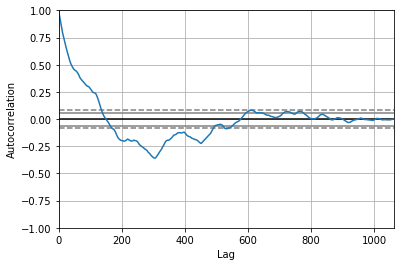

<Figure size 800x560 with 0 Axes>

Test MSE: 0.596


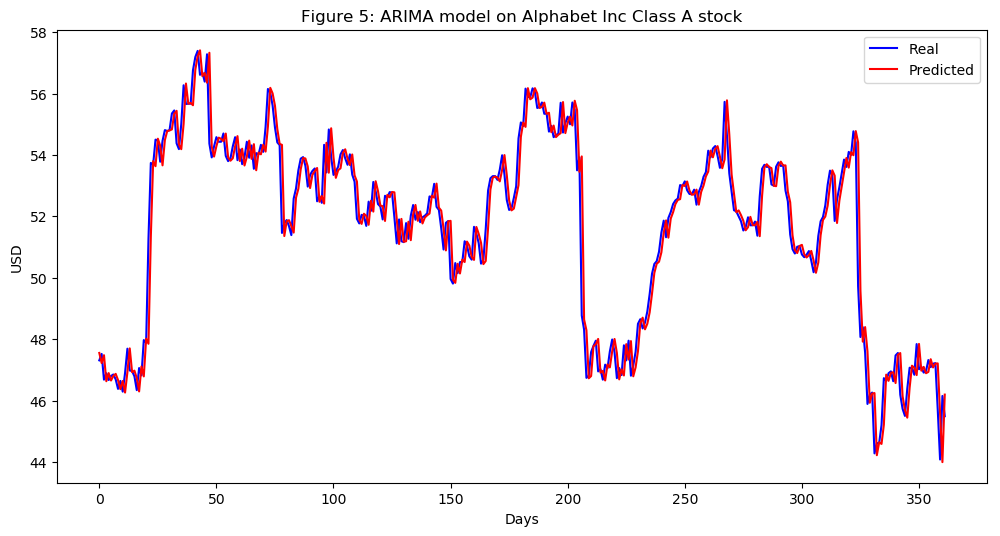

In [6]:
MetLife_series = SP500_TechIndicator['MetLife_Close']
MetLife_series_model = ARIMA(MetLife_series, order=(5, 1, 0))
MetLife_model_fit = MetLife_series_model.fit(disp=0)
print(MetLife_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(MetLife_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = MetLife_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
MetLife_predictions = list()
for t in range(len(test)):
    MetLife_series_model = ARIMA(history, order=(5,1,0))
    MetLife_series_model_fit = MetLife_series_model.fit(disp=0)
    MetLife_output = MetLife_series_model_fit.forecast()
    yhat = MetLife_output[0]
    MetLife_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, MetLife_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(MetLife_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
MetLife_predictions = pd.DataFrame({'MetLife_predictions':MetLife_predictions})
#MetLife_predictions.to_csv('MetLife_predictions.csv')




                                    ARIMA Model Results                                    
Dep. Variable:     D.Raymond_James_Financial_Close   No. Observations:                 1061
Model:                              ARIMA(5, 1, 0)   Log Likelihood               -1444.512
Method:                                    css-mle   S.D. of innovations              0.944
Date:                             Mon, 18 Mar 2019   AIC                           2903.024
Time:                                     14:55:24   BIC                           2937.793
Sample:                                          1   HQIC                          2916.201
                                                                                           
                                            coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------
const                                     0.0333    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


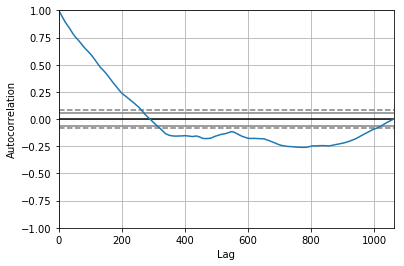

<Figure size 800x560 with 0 Axes>

Test MSE: 1.349


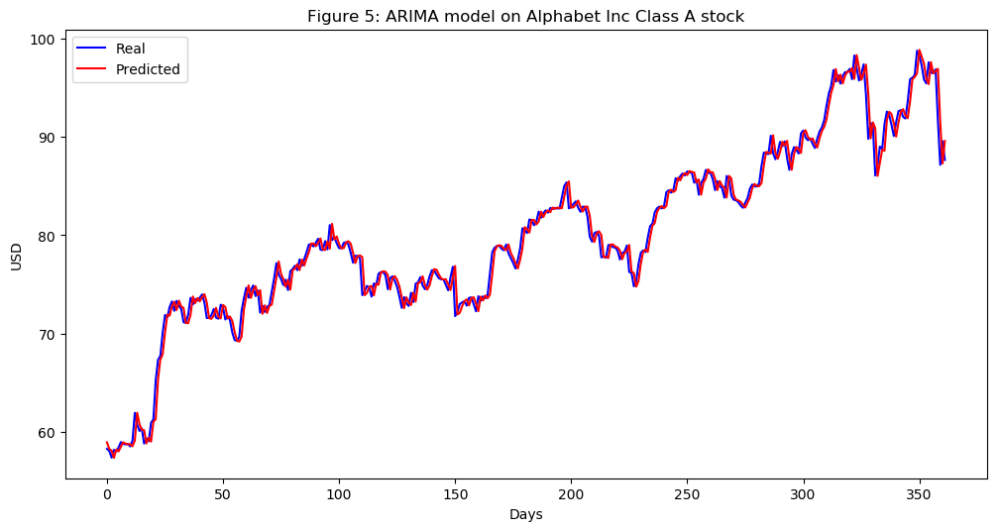

In [7]:
Raymond_James_Financial_series = SP500_TechIndicator['Raymond_James_Financial_Close']
Raymond_James_Financial_series_model = ARIMA(Raymond_James_Financial_series, order=(5, 1, 0))
Raymond_James_Financial_model_fit = Raymond_James_Financial_series_model.fit(disp=0)
print(Raymond_James_Financial_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Raymond_James_Financial_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Raymond_James_Financial_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Raymond_James_Financial_predictions = list()
for t in range(len(test)):
    Raymond_James_Financial_series_model = ARIMA(history, order=(5,1,0))
    Raymond_James_Financial_series_model_fit = Raymond_James_Financial_series_model.fit(disp=0)
    Raymond_James_Financial_output = Raymond_James_Financial_series_model_fit.forecast()
    yhat = Raymond_James_Financial_output[0]
    Raymond_James_Financial_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Raymond_James_Financial_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Raymond_James_Financial_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
Raymond_James_Financial_predictions = pd.DataFrame({'Raymond_James_Financial_predictions':Raymond_James_Financial_predictions})
#Raymond_James_Financial_predictions.to_csv('Raymond_James_Financial_predictions.csv')




                                   ARIMA Model Results                                   
Dep. Variable:     D.Flowserve_Corporation_Close   No. Observations:                 1061
Model:                            ARIMA(5, 1, 0)   Log Likelihood               -1431.912
Method:                                  css-mle   S.D. of innovations              0.933
Date:                           Mon, 18 Mar 2019   AIC                           2877.825
Time:                                   14:56:30   BIC                           2912.594
Sample:                                        1   HQIC                          2891.001
                                                                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                  -0.0343      0.027     -1.262    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


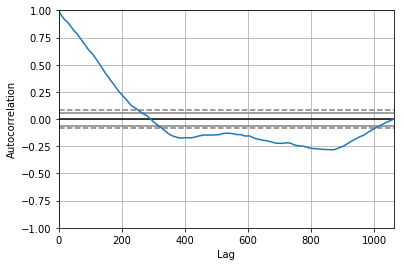

<Figure size 800x560 with 0 Axes>

Test MSE: 0.655


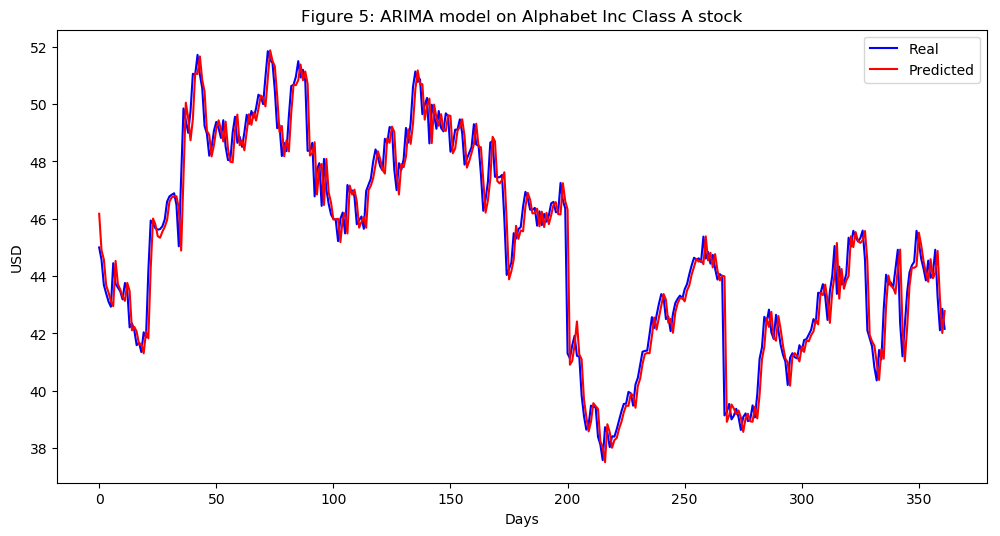

In [8]:
Flowserve_Corporation_series = SP500_TechIndicator['Flowserve_Corporation_Close']
Flowserve_Corporation_series_model = ARIMA(Flowserve_Corporation_series, order=(5, 1, 0))
Flowserve_Corporation_model_fit = Flowserve_Corporation_series_model.fit(disp=0)
print(Flowserve_Corporation_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Flowserve_Corporation_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Flowserve_Corporation_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Flowserve_Corporation_predictions = list()
for t in range(len(test)):
    Flowserve_Corporation_series_model = ARIMA(history, order=(5,1,0))
    Flowserve_Corporation_series_model_fit = Flowserve_Corporation_series_model.fit(disp=0)
    Flowserve_Corporation_output = Flowserve_Corporation_series_model_fit.forecast()
    yhat = Flowserve_Corporation_output[0]
    Flowserve_Corporation_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Flowserve_Corporation_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Flowserve_Corporation_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
Flowserve_Corporation_predictions = pd.DataFrame({'Flowserve_Corporation_predictions':Flowserve_Corporation_predictions})
#Flowserve_Corporation_predictions.to_csv('Flowserve_Corporation_predictions.csv')




                              ARIMA Model Results                              
Dep. Variable:     D.TripAdvisor_Close   No. Observations:                 1061
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -2137.765
Method:                        css-mle   S.D. of innovations              1.815
Date:                 Mon, 18 Mar 2019   AIC                           4289.530
Time:                         14:57:26   BIC                           4324.299
Sample:                              1   HQIC                          4302.707
                                                                               
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                        -0.0401      0.058     -0.689      0.491      -0.154       0.074
ar.L1.D.TripAdvisor_Close     0.0143      0.031      0.465      0.642      -0.

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


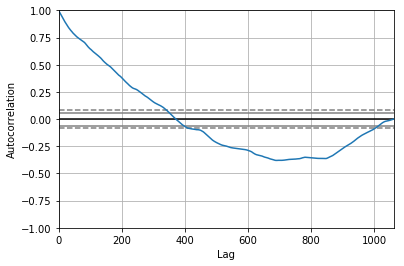

<Figure size 800x560 with 0 Axes>

Test MSE: 1.439


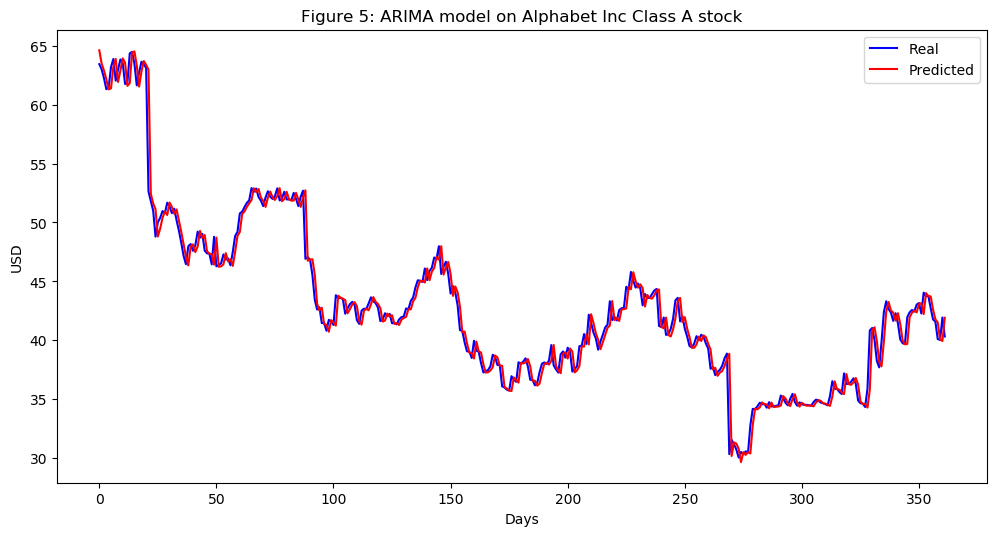

In [9]:
TripAdvisor_series = SP500_TechIndicator['TripAdvisor_Close']
TripAdvisor_series_model = ARIMA(TripAdvisor_series, order=(5, 1, 0))
TripAdvisor_model_fit = TripAdvisor_series_model.fit(disp=0)
print(TripAdvisor_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(TripAdvisor_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = TripAdvisor_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
TripAdvisor_predictions = list()
for t in range(len(test)):
    TripAdvisor_series_model = ARIMA(history, order=(5,1,0))
    TripAdvisor_series_model_fit = TripAdvisor_series_model.fit(disp=0)
    TripAdvisor_output = TripAdvisor_series_model_fit.forecast()
    yhat = TripAdvisor_output[0]
    TripAdvisor_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, TripAdvisor_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(TripAdvisor_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
TripAdvisor_predictions = pd.DataFrame({'TripAdvisor_predictions':TripAdvisor_predictions})
#TripAdvisor_predictions.to_csv('TripAdvisor_predictions.csv')




                                     ARIMA Model Results                                     
Dep. Variable:     D.TwentyFirst_Century_Fox_A_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood                -715.642
Method:                                      css-mle   S.D. of innovations              0.475
Date:                               Mon, 18 Mar 2019   AIC                           1445.284
Time:                                       14:58:20   BIC                           1480.053
Sample:                                            1   HQIC                          1458.460
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


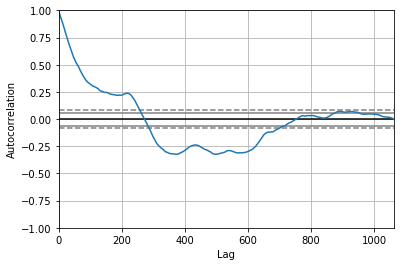

<Figure size 800x560 with 0 Axes>

Test MSE: 0.262


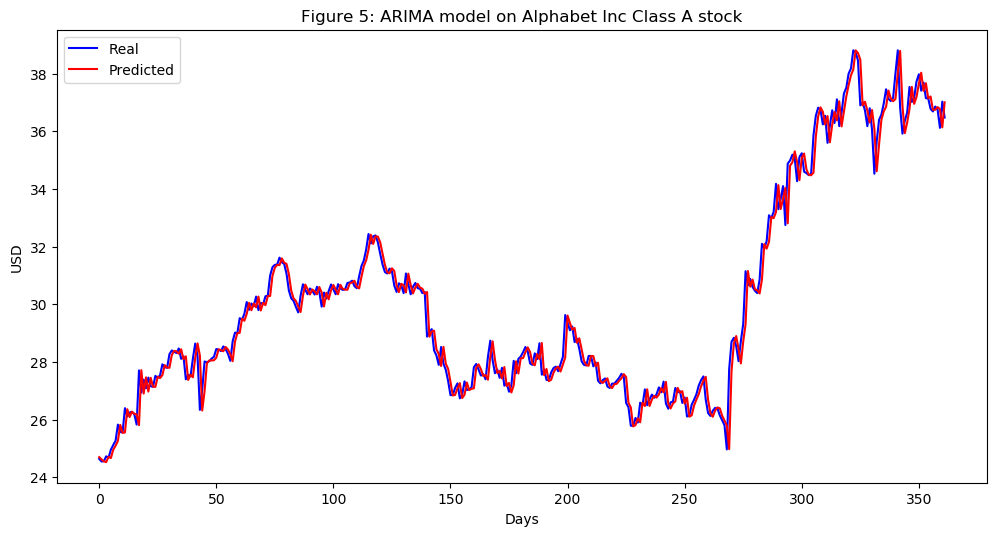

In [10]:
TwentyFirst_Century_Fox_A_series = SP500_TechIndicator['TwentyFirst_Century_Fox_A_Close']
TwentyFirst_Century_Fox_A_series_model = ARIMA(TwentyFirst_Century_Fox_A_series, order=(5, 1, 0))
TwentyFirst_Century_Fox_A_model_fit = TwentyFirst_Century_Fox_A_series_model.fit(disp=0)
print(TwentyFirst_Century_Fox_A_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(TwentyFirst_Century_Fox_A_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = TwentyFirst_Century_Fox_A_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
TwentyFirst_Century_Fox_A_predictions = list()
for t in range(len(test)):
    TwentyFirst_Century_Fox_A_series_model = ARIMA(history, order=(5,1,0))
    TwentyFirst_Century_Fox_A_series_model_fit = TwentyFirst_Century_Fox_A_series_model.fit(disp=0)
    TwentyFirst_Century_Fox_A_output = TwentyFirst_Century_Fox_A_series_model_fit.forecast()
    yhat = TwentyFirst_Century_Fox_A_output[0]
    TwentyFirst_Century_Fox_A_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, TwentyFirst_Century_Fox_A_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(TwentyFirst_Century_Fox_A_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
TwentyFirst_Century_Fox_A_predictions = pd.DataFrame({'TwentyFirst_Century_Fox_A_predictions':TwentyFirst_Century_Fox_A_predictions})
#TwentyFirst_Century_Fox_A_predictions.to_csv('TwentyFirst_Century_Fox_A_predictions.csv')




                                     ARIMA Model Results                                     
Dep. Variable:     D.TwentyFirst_Century_Fox_B_Close   No. Observations:                 1061
Model:                                ARIMA(5, 1, 0)   Log Likelihood                -675.799
Method:                                      css-mle   S.D. of innovations              0.457
Date:                               Mon, 18 Mar 2019   AIC                           1365.599
Time:                                       15:00:24   BIC                           1400.367
Sample:                                            1   HQIC                          1378.775
                                                                                             
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
const                           

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


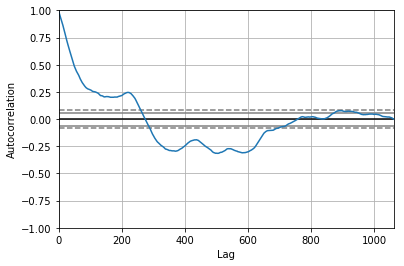

<Figure size 800x560 with 0 Axes>

Test MSE: 0.246


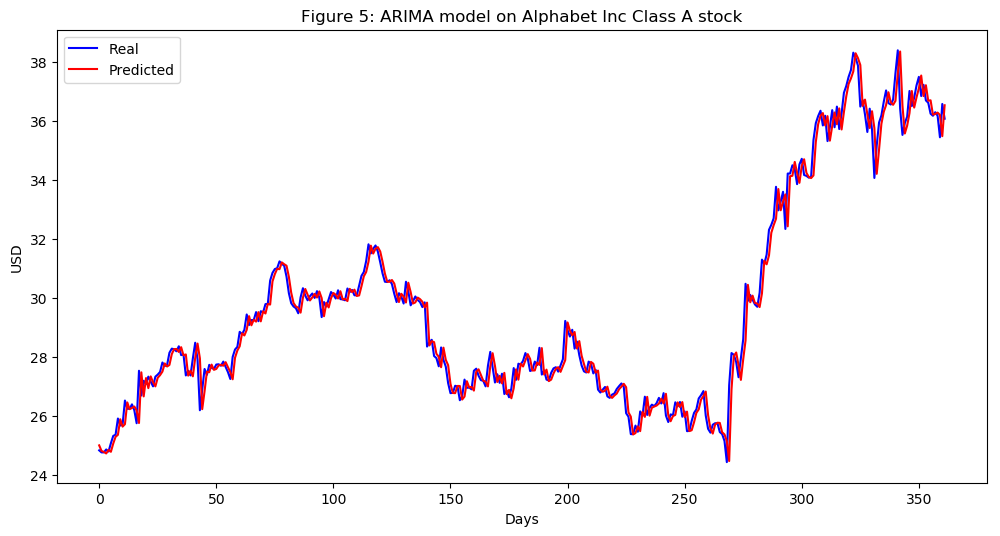

In [11]:
TwentyFirst_Century_Fox_B_series = SP500_TechIndicator['TwentyFirst_Century_Fox_B_Close']
TwentyFirst_Century_Fox_B_series_model = ARIMA(TwentyFirst_Century_Fox_B_series, order=(5, 1, 0))
TwentyFirst_Century_Fox_B_model_fit = TwentyFirst_Century_Fox_B_series_model.fit(disp=0)
print(TwentyFirst_Century_Fox_B_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(TwentyFirst_Century_Fox_B_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = TwentyFirst_Century_Fox_B_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
TwentyFirst_Century_Fox_B_predictions = list()
for t in range(len(test)):
    TwentyFirst_Century_Fox_B_series_model = ARIMA(history, order=(5,1,0))
    TwentyFirst_Century_Fox_B_series_model_fit = TwentyFirst_Century_Fox_B_series_model.fit(disp=0)
    TwentyFirst_Century_Fox_B_output = TwentyFirst_Century_Fox_B_series_model_fit.forecast()
    yhat = TwentyFirst_Century_Fox_B_output[0]
    TwentyFirst_Century_Fox_B_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, TwentyFirst_Century_Fox_B_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(TwentyFirst_Century_Fox_B_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
TwentyFirst_Century_Fox_B_predictions = pd.DataFrame({'TwentyFirst_Century_Fox_B_predictions':TwentyFirst_Century_Fox_B_predictions})
#TwentyFirst_Century_Fox_B_predictions.to_csv('TwentyFirst_Century_Fox_B_predictions.csv')




                                   ARIMA Model Results                                    
Dep. Variable:     D.Verizon_Communications_Close   No. Observations:                 1061
Model:                             ARIMA(5, 1, 0)   Log Likelihood                -774.233
Method:                                   css-mle   S.D. of innovations              0.502
Date:                            Mon, 18 Mar 2019   AIC                           1562.466
Time:                                    15:02:03   BIC                           1597.235
Sample:                                         1   HQIC                          1575.643
                                                                                          
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                   -0.0018      0.017    

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


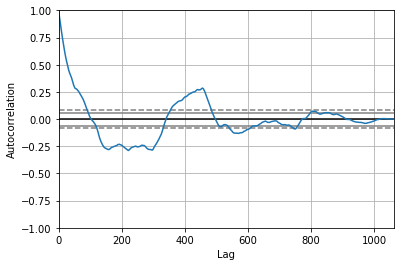

<Figure size 800x560 with 0 Axes>

Test MSE: 0.312


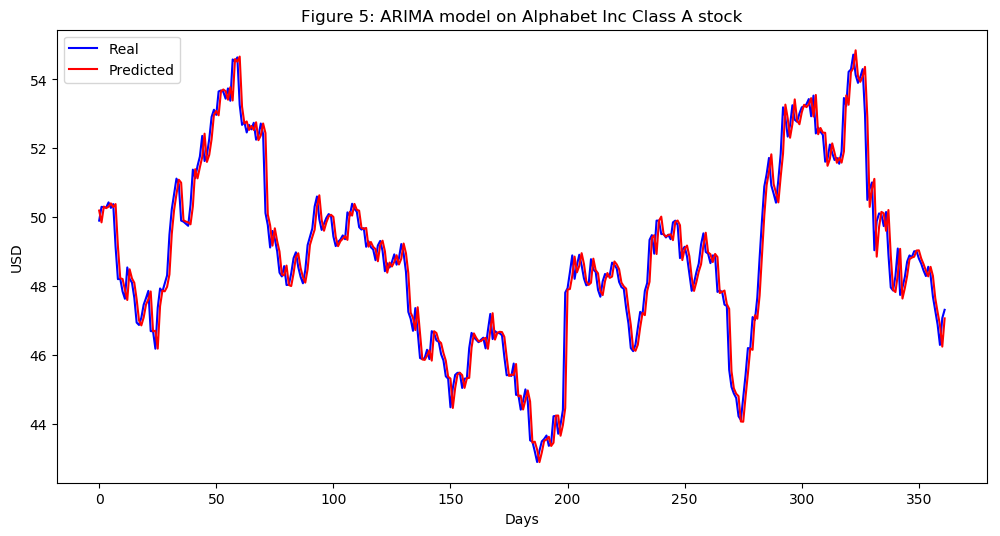

In [12]:
Verizon_Communications_series = SP500_TechIndicator['Verizon_Communications_Close']
Verizon_Communications_series_model = ARIMA(Verizon_Communications_series, order=(5, 1, 0))
Verizon_Communications_model_fit = Verizon_Communications_series_model.fit(disp=0)
print(Verizon_Communications_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Verizon_Communications_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Verizon_Communications_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Verizon_Communications_predictions = list()
for t in range(len(test)):
    Verizon_Communications_series_model = ARIMA(history, order=(5,1,0))
    Verizon_Communications_series_model_fit = Verizon_Communications_series_model.fit(disp=0)
    Verizon_Communications_output = Verizon_Communications_series_model_fit.forecast()
    yhat = Verizon_Communications_output[0]
    Verizon_Communications_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Verizon_Communications_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Verizon_Communications_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
Verizon_Communications_predictions = pd.DataFrame({'Verizon_Communications_predictions':Verizon_Communications_predictions})
#Verizon_Communications_predictions.to_csv('Verizon_Communications_predictions.csv')




                             ARIMA Model Results                              
Dep. Variable:         D.Viacom_Close   No. Observations:                 1061
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1496.412
Method:                       css-mle   S.D. of innovations              0.991
Date:                Mon, 18 Mar 2019   AIC                           3006.824
Time:                        15:03:09   BIC                           3041.593
Sample:                             1   HQIC                          3020.001
                                                                              
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -0.0533      0.031     -1.744      0.081      -0.113       0.007
ar.L1.D.Viacom_Close     0.0400      0.031      1.305      0.192      -0.020       0.100
ar.L2.D.Viac

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


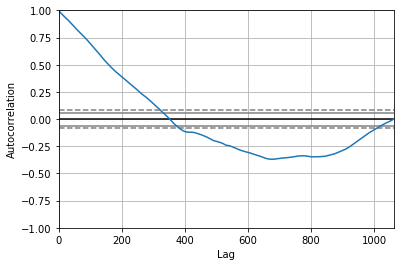

<Figure size 800x560 with 0 Axes>

Test MSE: 0.553


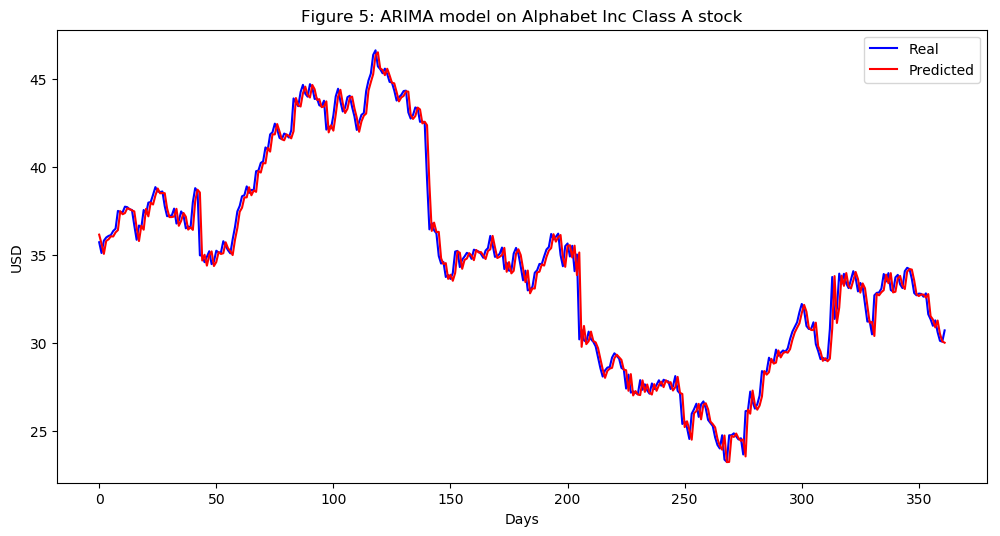

In [13]:
Viacom_series = SP500_TechIndicator['Viacom_Close']
Viacom_series_model = ARIMA(Viacom_series, order=(5, 1, 0))
Viacom_model_fit = Viacom_series_model.fit(disp=0)
print(Viacom_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(Viacom_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = Viacom_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
Viacom_predictions = list()
for t in range(len(test)):
    Viacom_series_model = ARIMA(history, order=(5,1,0))
    Viacom_series_model_fit = Viacom_series_model.fit(disp=0)
    Viacom_output = Viacom_series_model_fit.forecast()
    yhat = Viacom_output[0]
    Viacom_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, Viacom_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(Viacom_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
Viacom_predictions = pd.DataFrame({'Viacom_predictions':Viacom_predictions})
#Viacom_predictions.to_csv('Viacom_predictions.csv')




                                ARIMA Model Results                                
Dep. Variable:     D.The_Walt_Disney_Close   No. Observations:                 1061
Model:                      ARIMA(5, 1, 0)   Log Likelihood               -1685.791
Method:                            css-mle   S.D. of innovations              1.185
Date:                     Mon, 18 Mar 2019   AIC                           3385.583
Time:                             15:04:14   BIC                           3420.352
Sample:                                  1   HQIC                          3398.759
                                                                                   
                                    coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                             0.0219      0.032      0.673      0.501      -0.042       0.086
ar.L1.D.The_Walt_Disney_Close -9.6

/Users/ujash/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: 'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.
  import sys


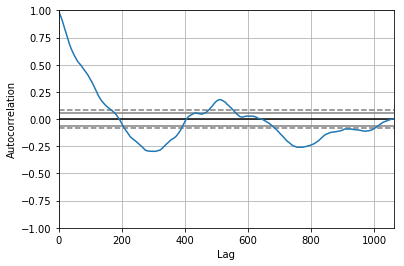

<Figure size 800x560 with 0 Axes>

Test MSE: 1.286


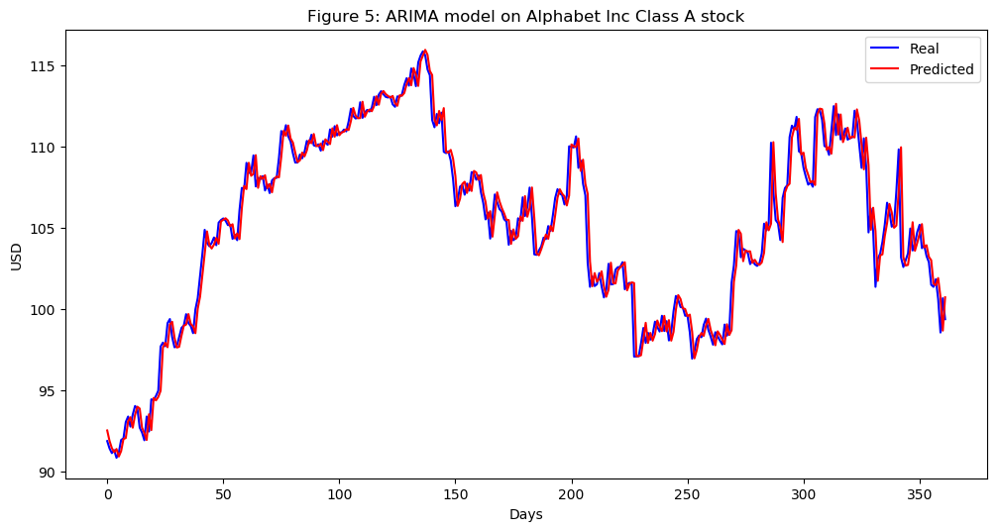

In [14]:
The_Walt_Disney_series = SP500_TechIndicator['The_Walt_Disney_Close']
The_Walt_Disney_series_model = ARIMA(The_Walt_Disney_series, order=(5, 1, 0))
The_Walt_Disney_model_fit = The_Walt_Disney_series_model.fit(disp=0)
print(The_Walt_Disney_model_fit.summary())

from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(The_Walt_Disney_series)
plt.figure(figsize=(10, 7), dpi=80)
plt.show()


X = The_Walt_Disney_series.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
The_Walt_Disney_predictions = list()
for t in range(len(test)):
    The_Walt_Disney_series_model = ARIMA(history, order=(5,1,0))
    The_Walt_Disney_series_model_fit = The_Walt_Disney_series_model.fit(disp=0)
    The_Walt_Disney_output = The_Walt_Disney_series_model_fit.forecast()
    yhat = The_Walt_Disney_output[0]
    The_Walt_Disney_predictions.append(yhat)
    obs = test[t]
    history.append(obs)


error = mean_squared_error(test, The_Walt_Disney_predictions)
print('Test MSE: %.3f' % error)


# Plot the predicted (from ARIMA) and real prices
plt.figure(figsize=(12, 6), dpi=100)
plt.plot(test, label='Real',color = 'blue')
plt.plot(The_Walt_Disney_predictions, color='red', label='Predicted')
plt.xlabel('Days')
plt.ylabel('USD')
plt.title('Figure 5: ARIMA model on Alphabet Inc Class A stock')
plt.legend()
plt.show()


#predictions
The_Walt_Disney_predictions = pd.DataFrame({'The_Walt_Disney_predictions':The_Walt_Disney_predictions})
#The_Walt_Disney_predictions.to_csv('The_Walt_Disney_predictions.csv')




In [16]:
Remaining_ARIMA = pd.concat((Conagra_Brands_predictions, Kimberly_Clark_predictions,MetLife_predictions,Raymond_James_Financial_predictions,Flowserve_Corporation_predictions,TripAdvisor_predictions,TwentyFirst_Century_Fox_A_predictions,TwentyFirst_Century_Fox_B_predictions,Verizon_Communications_predictions,Viacom_predictions,The_Walt_Disney_predictions),axis=1, join='inner')

Remaining_ARIMA.to_csv('Remaining_ARIMA.csv')


In [467]:
Consumer_Discretionary_ARIMA = pd.concat((Advance_Auto_Parts_predictions,Amazon_predictions,AutoZone_predictions,Best_Buy_Co_predictions,BlockHR_predictions,BorgWarner_predictions,Carmax_predictions,Carnival_predictions,Chipotle_Mexican_Grill_predictions,D_R_Horton_predictions,Darden_Restaurants_predictions,Dollar_General_predictions,Dollar_Tree_predictions,eBay_predictions,Expedia_Group_predictions,Ford_Motor_predictions,Gap_predictions,Garmin_predictions,General_Motors_predictions,Genuine_Parts_predictions,Goodyear_Tire_Rubber_predictions,Hanesbrands_predictions,Harley_Davidson_predictions,Hasbro_predictions,Home_Depot_predictions,Kohls_predictions,L_Brands_predictions,Leggett_Platt_predictions,Lennar_predictions,LKQ_predictions,Lowes_Cos_predictions,Macys_predictions,Marriott_Int_predictions,Mattel_predictions,McDonalds_predictions,MGM_Resorts_International_predictions,Mohawk_Industries_predictions,Newell_Brands_predictions,Nike_predictions,Nordstrom_predictions,Norwegian_Cruise_Line_predictions,OReilly_Automotive_predictions,Polo_Ralph_Lauren_predictions,Pulte_Homes_predictions,PVH_Corp_predictions,Ross_Stores_predictions,Starbucks_predictions,Target_predictions,Tiffany_predictions,TJX_Companies_predictions,Tractor_Supply_Company_predictions,Ulta_Beauty_predictions,Under_Armour_Class_A_predictions,V_F_Corp_predictions,Whirlpool_predictions,Wynn_Resorts_predictions,Yum_Brands_predictions),axis=1, join='inner')

#Communication_Services_FFT = pd.concat((Activision_Blizzard_predictions,ATT_predictions,CBS_predictions,CenturyLink_predictions,Comcast_predictions, Discovery_Class_A_predictions, Discovery_Class_C_predictions,Dish_predictions,Electronic_Arts_predictions,Facebook_predictions, Interpublic_Group_predictions, Netflix_predictions, News_Corp_Class_A_predictions, News_Corp_Class_B_predictions, Omnicom_Group_predictions, Take_Two_Interactive_predictions, Twitter_predictions, TripAdvisor_predictions, TwentyFirst_Century_Fox_A_predictions, TwentyFirst_Century_Fox_B_predictions, Verizon_Communications_predictions, Viacom_predictions, The_Walt_Disney_predictions), axis=1, join='inner')

#Communication_Services_FFT

Consumer_Discretionary_ARIMA.to_csv('Consumer_Discretionary_ARIMA.csv')




In [470]:
Consumer_Staples_ARIMA = pd.concat((Altria_Group_predictions,Archer_Daniels_Midland_Co_predictions,Brown_Forman_predictions,Campbell_Soup_predictions,Church_Dwight_predictions,The_Clorox_Company_predictions,Coca_Cola_Company_predictions,Colgate_Palmolive_predictions,Constellation_Brands_predictions,Costco_Wholesale_predictions,Coty_predictions,General_Mills_predictions,The_Hershey_Company_predictions,Hormel_Foods_predictions,JM_Smucker_predictions,Kellogg_predictions,Kroger_predictions,McCormick_predictions,Molson_Coors_Brewing_Company_predictions,Mondelez_International_predictions,Monster_Beverage_predictions,PepsiCo_predictions,Philip_Morris_International_predictions,Procter_Gamble_predictions,Sysco_predictions,Tyson_Foods_predictions,Walmart_predictions,Walgreens_Boots_Alliance_predictions),axis=1, join='inner')
#Conagra_Brands_predictions
#Kimberly_Clark_predictions
Consumer_Staples_ARIMA.to_csv('Consumer_Staples_ARIMA.csv')




In [492]:
Energy_ARIMA = pd.concat ((Anadarko_Petroleum_predictions,Apache_Corporation_predictions,Campbell_Soup_predictions,Cabot_Oil_Gas_predictions,Chevron_predictions,Cimarex_Energy_predictions,Concho_Resources_predictions,ConocoPhillips_predictions,Devon_Energy_predictions,Diamondback_Energy_predictions,EOG_Resources_predictions,Exxon_Mobil_predictions,Halliburton_predictions,Helmerich_Payne_predictions,Hess_Corporation_predictions,Kinder_Morgan_predictions,Marathon_Oil_predictions,Marathon_Petroleum_predictions,National_Oilwell_Varco_predictions,Newfield_Exploration_predictions,Noble_Energy_predictions,Occidental_Petroleum_predictions,ONEOK_predictions,Phillips_SixtySix_predictions,Schlumberger_predictions,TechnipFMC_predictions,Valero_Energy_predictions,Williams_Cos_predictions) ,axis=1, join='inner') 


Energy_ARIMA.to_csv('Energy_ ARIMA.csv')




In [474]:
Financials_ARIMA = pd.concat((Affiliated_Managers_Group_predictions,AFLAC_predictions,Allstate_Corp_predictions,American_Express_predictions,American_International_Group_predictions,Ameriprise_Financial_predictions,Aon_predictions,Arthur_J_Gallagher_predictions,Assurant_predictions,Bank_of_America_predictions,The_Bank_of_NewYork_predictions,BBT_predictions,Berkshire_Hathaway_predictions,BlackRock_predictions,Capital_One_Financial_predictions,Cboe_Global_Markets_predictions,Charles_Schwab_Corporation_predictions,Chubb_predictions,Cincinnati_Financial_predictions,Citigroup_predictions,CME_Group_predictions,Comerica_predictions,Discover_Financial_Services_predictions,ETrade_predictions,Everest_Re_Group_predictions,Fifth_Third_Bancorp_predictions,First_Republic_Bank_predictions,Franklin_Resources_predictions,Goldman_Sachs_Group_predictions,Hartford_Financial_predictions,Huntington_Bancshares_predictions,Intercontinental_Exchange_predictions,Invesco_predictions,JPMorgan_Chase_predictions,KeyCorp_predictions,Lincoln_National_predictions,Loews_predictions,MT_Bank_predictions,Marsh_McLennan_predictions,Moodys_predictions,Morgan_Stanley_predictions,MSCI_predictions,Nasdaq_predictions,Northern_Trust_predictions,Peoples_United_Financial_predictions,PNC_Financial_Services_predictions,Principal_Financial_Group_predictions,Progressive_predictions,Prudential_Financial_predictions,Regions_Financial_predictions,State_Street_predictions,SunTrust_Banks_predictions,SVB_Financial_predictions,T_Rowe_Price_Group_predictions,Torchmark_predictions,US_Bancorp_predictions,Unum_Group_predictions,Wells_Fargo_predictions,Zions_Bancorp_predictions), axis=1, join= 'inner')
#MetLife_predictions
#Raymond_James_Financial_predictions

Financials_ARIMA.to_csv('Financials_ARIMA.csv')



In [475]:
HealthCare_ARIMA = pd.concat((Abbott_Laboratories_predictions,AbbVie_predictions,ABIOMED_predictions,Agilent_predictions,Align_Technology_predictions,Allergan_predictions,AmerisourceBergen_Corp_predictions,Amgen_predictions,Baxter_International_predictions,Becton_Dickinson_predictions,Biogen_predictions,Boston_Scientific_predictions,Bristol_Myers_Squibb_predictions,Cardinal_Health_predictions,Celgene_predictions,Centene_Corporation_predictions,Cerner_predictions,CIGNA_predictions,The_Cooper_Companies_predictions,CVS_Health_predictions,Danaher_predictions,DaVita_predictions,Dentsply_Sirona_predictions,Edwards_Lifesciences_predictions,Gilead_Sciences_predictions,HCA_Holdings_predictions,Henry_Schein_predictions,Hologic_predictions,Humana_predictions,IDEXX_Laboratories_predictions,Illumina_predictions,Incyte_predictions,Intuitive_Surgical_predictions,Johnson_Johnson_predictions,Laboratory_America_Holding_predictions,Lilly_predictions,McKesson_predictions,Medtronic_predictions,Merck_predictions,Mylan_NV_predictions,Nektar_Therapeutics_predictions,PerkinElmer_predictions,Perrigo_predictions,Pfizer_predictions,Quest_Diagnostics_predictions,Regeneron_predictions,ResMed_predictions,Stryker_predictions,Teleflex_predictions,Thermo_Fisher_Scientific_predictions,United_Health_Group_predictions,Universal_Health_Services_predictions,Varian_Medical_Systems_predictions,Vertex_Pharmaceuticals_predictions,Waters_Corporation_predictions,WellCare_predictions,Zimmer_Biomet_Holdings_predictions,Zoetis_predictions), axis=1, join='inner')


HealthCare_ARIMA.to_csv('HealthCare_ARIMA.csv')




In [477]:
Industrials_ARIMA = pd.concat((Alaska_Air_Group_predictions,Allegion_predictions,American_Airlines_predictions,AMETEK_predictions,A_O_Smith_predictions,Arconic_predictions,Boeing_Company_predictions,C_H_Robinson_Worldwide_predictions,Caterpillar_predictions,Cintas_Corporation_predictions,Copart_predictions,CSX_predictions,Cummins_predictions,Deere_predictions,Delta_Air_Lines_predictions,Dover_predictions,Eaton_Corporation_predictions,Emerson_Electric_Company_predictions,Equifax_predictions,Expeditors_predictions,Fastenal_predictions,FedEx_predictions,Fluor_predictions,Fortune_Brands_Home_Security_predictions,General_Dynamics_predictions,General_Electric_predictions,Grainger_predictions,Harris_predictions,Huntington_Ingalls_Industries_predictions,Ingersoll_Rand_predictions,Jacobs_Engineering_Group_predictions,J_B_Hunt_Transport_predictions,Johnson_Controls_International_predictions,Kansas_City_Southern_predictions,L_3_Communications_Holdings_predictions,Lockheed_Martin_predictions,Masco_predictions,Nielsen_Holdings_predictions,Norfolk_Southern_predictions,Northrop_Grumman_predictions,PACCAR_predictions,Parker_Hannifin_predictions,Pentair_predictions,Quanta_Services_predictions,Raytheon_predictions,Republic_Services_predictions,Robert_Half_International_predictions,Rockwell_Automation_predictions,Rollins_predictions,Roper_Technologies_predictions,Snap_on_predictions,Southwest_Airlines_predictions,Stanley_Black_Decker_predictions,Textron_predictions,TransDigm_Group_predictions,Union_Pacific_predictions,United_Continental_Holdings_predictions,United_Parcel_Service_predictions,United_Rentals_predictions,United_Technologies_predictions,Verisk_Analytics_predictions,Waste_Management_predictions,Xylem_predictions), axis=1, join='inner')
#Flowserve_Corporation_predictions
Industrials_ARIMA.to_csv('Industrials_ARIMA.csv')




In [479]:
Information_Technology_ARIMA = pd.concat((Accenture_predictions,Adobe_Systems_predictions,Advanced_Micro_Devices_predictions,Akamai_Technologies_predictions,Alliance_Data_Systems_predictions,Amphenol_Corp_predictions,Analog_Devices_predictions,ANSYS_predictions,Apple_predictions,Applied_Materials_predictions,Autodesk_predictions,Automatic_Data_Processing_predictions,Broadcom_predictions,Broadridge_Financial_Solutions_predictions,Cadence_Design_Systems_predictions,Cisco_Systems_predictions,Citrix_Systems_predictions,Cognizant_Technology_Solutions_predictions,Corning_predictions,F5_Networks_predictions,Fidelity_National_Information_Services_predictions,Fiserv_predictions,FleetCor_Technologies_predictions,FLIR_Systems_predictions,Fortinet_predictions,Global_Payments_predictions,HP_predictions,Intel_predictions,International_Business_Machines_predictions,Intuit_predictions,IPG_Photonics_predictions,Jack_Henry_Associates_predictions,Juniper_Networks_predictions,Keysight_Technologies_predictions,KLA_Tencor_Corp_predictions,Lam_Research_predictions,Mastercard_predictions,Microchip_Technology_predictions,Micron_Technology_predictions,Microsoft_predictions,Motorola_Solutions_predictions,NetApp_predictions,Nvidia_Corporation_predictions,Oracle_predictions,Paychex_predictions,QUALCOMM_predictions,Red_Hat_predictions,Salesforce_predictions,Rollins_predictions,Seagate_Technology_predictions,Skyworks_Solution_predictions,Symantec_predictions,Synopsys_predictions,TE_Connectivity_predictions,Texas_Instruments_predictions,Total_System_Services_predictions,Verisign_predictions,Visa_predictions,Western_Digital_predictions,Western_Union_predictions,Xerox_predictions,Xilinx_predictions), axis=1, join='inner')

Information_Technology_ARIMA.to_csv('Information_Technology_ARIMA .csv')




In [480]:
Materials_ARIMA = pd.concat((Air_Products_Chemicals_predictions,Albemarle_Corp_predictions,Avery_Dennison_predictions,Ball_predictions,Celanese_predictions,CF_Industries_Holdings_predictions,Eastman_Chemical_predictions,Ecolab_predictions,FMC_Corporation_predictions,Freeport_McMoRan_predictions,International_Paper_predictions,LyondellBasell_predictions,Martin_Marietta_Materials_predictions,The_Mosaic_Company_predictions,Newmont_Mining_Corporation_predictions,Nucor_predictions,Packaging_Corporation_of_America_predictions,Sealed_Air_predictions,Sherwin_Williams_predictions,Vulcan_Materials_predictions), axis=1, join = 'inner')

Materials_ARIMA.to_csv('Materials_ARIMA.csv')




In [482]:
Real_Estate_ARIMA = pd.concat((American_Tower_Corp_predictions,Alexandria_Real_Estate_Equities_predictions,Apartment_Investment_Management_predictions,AvalonBay_Communities_predictions,Boston_Properties_predictions,Crown_Castle_International_predictions,Digital_Realty_Trust_predictions,Duke_Realty_predictions,Equinix_predictions,Equity_Residential_predictions,Essex_Property_Trust_predictions,Extra_Space_Storage_predictions,Federal_Realty_Investment_Trust_predictions,HCP_predictions,Host_Hotels_Resorts_predictions,Iron_Mountain_predictions,Kimco_Realty_predictions,Macerich_predictions,Mid_America_Apartments_predictions,Prologis_predictions,Public_Storage_predictions,Realty_Income_Corporation_predictions,Regency_Centers_Corporation_predictions,SBA_Communications_predictions,Simon_Property_Group_predictions,SL_Green_Realty_predictions,UDR_predictions,Ventas_predictions,Vornado_Realty_Trust_predictions,Weyerhaeuser_predictions),axis=1, join='inner')

Real_Estate_ARIMA.to_csv('Real_Estate_ARIMA.csv')



In [483]:
Utilities_ARIMA =  pd.concat((AES_predictions,Alliant_Energy_Corp_predictions,Ameren_Corp_predictions,American_Electric_Power_predictions,American_Water_Works_Company_predictions,CMS_Energy_predictions,Consolidated_Edison_predictions,DTE_Energy_predictions,Duke_Energy_predictions,Dominion_Energy_predictions,Edison_Int_predictions,Entergy_predictions,Evergy_predictions,Eversource_Energy_predictions,Exelon_predictions,FirstEnergy_predictions,NextEra_Energy_predictions,NiSource_predictions,NRG_Energy_predictions,Pinnacle_West_Capital_predictions,PPL_Corp_predictions,Public_Serv_Enterprise_predictions,Southern_predictions,Sempra_Energy_predictions,Wec_Energy_Group_predictions,Xcel_Energy_predictions), axis=1, join= 'inner')

Utilities_ARIMA.to_csv('Utilities_ARIMA.csv')



In [491]:
Communication_Services_ARIMA = pd.concat((Activision_Blizzard_predictions,ATT_predictions,CBS_predictions,CenturyLink_predictions,Comcast_predictions, Discovery_Class_A_predictions, Discovery_Class_C_predictions,Dish_predictions,Electronic_Arts_predictions,Facebook_predictions, Interpublic_Group_predictions, Netflix_predictions, News_Corp_Class_A_predictions, News_Corp_Class_B_predictions, Omnicom_Group_predictions, Take_Two_Interactive_predictions, Twitter_predictions), axis=1, join='inner')
#TripAdvisor_predictions
#Communication_Services_FFT
#TwentyFirst_Century_Fox_A_predictions
#TwentyFirst_Century_Fox_B_predictions
#Verizon_Communications_predictions
#Viacom_predictions
#The_Walt_Disney_predictions

Communication_Services_ARIMA.to_csv('Communication_Services_ARIMA.csv')



In [19]:

Communication_Services_ARIMA = read_csv('Communication_Services_ARIMA.csv')
Communication_Services_ARIMA = Communication_Services_ARIMA.drop(['Unnamed: 0'], axis=1)
Communication_Services_ARIMA.shape


(362, 17)

In [22]:

Utilities_ARIMA = read_csv('Utilities_ARIMA.csv')
Utilities_ARIMA = Utilities_ARIMA.drop(['Unnamed: 0'], axis=1)
Utilities_ARIMA.shape


(362, 26)

In [21]:
Remaining_ARIMA = read_csv('Remaining_ARIMA.csv')
Remaining_ARIMA = Remaining_ARIMA.drop(['Unnamed: 0'], axis=1)
Remaining_ARIMA.shape



(362, 11)

In [23]:
Consumer_Discretionary_ARIMA = read_csv('Consumer_Discretionary_ARIMA.csv')
Consumer_Discretionary_ARIMA = Consumer_Discretionary_ARIMA.drop(['Unnamed: 0'], axis=1)
Consumer_Discretionary_ARIMA.shape



(362, 57)

In [24]:

Consumer_Staples_ARIMA = read_csv('Consumer_Staples_ARIMA.csv')
Consumer_Staples_ARIMA = Consumer_Staples_ARIMA.drop(['Unnamed: 0'], axis=1)
Consumer_Staples_ARIMA.shape



(362, 28)

In [27]:

Energy_ARIMA = read_csv('Energy_ARIMA.csv')
Energy_ARIMA = Energy_ARIMA.drop(['Unnamed: 0'], axis=1)
Energy_ARIMA.shape



(362, 28)

In [31]:

Financials_ARIMA = read_csv('Financials_ARIMA.csv')
Financials_ARIMA = Financials_ARIMA.drop(['Unnamed: 0'], axis=1)
Financials_ARIMA.shape

(362, 59)

In [32]:
HealthCare_ARIMA = read_csv('HealthCare_ARIMA.csv')
HealthCare_ARIMA = HealthCare_ARIMA.drop(['Unnamed: 0'], axis=1)HealthCare_ARIMA.shap

(362, 58)

In [33]:
Industrials_ARIMA = read_csv('Industrials_ARIMA.csv')
Industrials_ARIMA = Industrials_ARIMA.drop(['Unnamed: 0'], axis=1)
Industrials_ARIMA.shape

(362, 63)

In [37]:
Information_Technology_ARIMA = read_csv('Information_Technology_ARIMA.csv')
Information_Technology_ARIMA = Information_Technology_ARIMA.drop(['Unnamed: 0'], axis=1)
Information_Technology_ARIMA.shape

(362, 62)

In [38]:
Materials_ARIMA = read_csv('Materials_ARIMA.csv')
Materials_ARIMA = Materials_ARIMA.drop(['Unnamed: 0'], axis=1)
Materials_ARIMA.shape


(362, 20)

In [39]:
Real_Estate_ARIMA = read_csv('Real_Estate_ARIMA.csv')
Real_Estate_ARIMA = Real_Estate_ARIMA.drop(['Unnamed: 0'], axis=1)
Real_Estate_ARIMA.shape


(362, 30)

In [40]:
Utilities_ARIMA = read_csv('Utilities_ARIMA.csv')
Utilities_ARIMA = Utilities_ARIMA.drop(['Unnamed: 0'], axis=1)
Utilities_ARIMA.shape

(362, 26)

In [45]:
SP500_ARIMA = pd.concat((Communication_Services_ARIMA,Consumer_Discretionary_ARIMA,Consumer_Staples_ARIMA,Energy_ARIMA,Financials_ARIMA,HealthCare_ARIMA,Information_Technology_ARIMA,Materials_ARIMA,Real_Estate_ARIMA,Utilities_ARIMA, Remaining_ARIMA), axis=1, join='inner')

SP500_ARIMA.to_csv('SP500_ARIMA.csv')

In [44]:
FastFourierTransform_TechIndicator = read_csv('SP500_TechIndicator_FFT.csv')
FastFourierTransform_TechIndicator = FastFourierTransform_TechIndicator.drop(['Unnamed: 0'], axis=1)
FastFourierTransform_TechIndicator.shape

(1062, 5795)

In [46]:
FFT_ARIMA = pd.concat((FastFourierTransform_TechIndicator,SP500_ARIMA), axis=1, join='inner')
FFT_ARIMA.to_csv('FFT_ARIMA.csv')

In [47]:
FFT_ARIMA

,Unnamed: 0.1,Date,Activision_Blizzard_Open,Activision_Blizzard_Close,CBS_Open,CBS_Close,CenturyLink_Open,CenturyLink_Close,ATT_Open,ATT_Close,...,Kimberly_Clark_predictions,MetLife_predictions,Raymond_James_Financial_predictions,Flowserve_Corporation_predictions,TripAdvisor_predictions,TwentyFirst_Century_Fox_A_predictions,TwentyFirst_Century_Fox_B_predictions,Verizon_Communications_predictions,Viacom_predictions,The_Walt_Disney_predictions
0,0,2013-12-31,17.800,17.830,63.66,63.74,31.94,31.85,35.17,35.16,...,[122.17312526],[47.55115506],[58.96444786],[46.17578672],[64.60646139],[24.70200141],[24.99918104],[50.19221339],[36.16280801],[92.51437536]
1,1,2014-01-02,17.910,18.070,63.25,63.25,31.74,31.65,35.24,34.95,...,[121.38494581],[47.22162875],[58.29636796],[44.90001518],[63.4801041],[24.62229481],[24.81099593],[49.84866896],[35.65043459],[91.87027367]
2,2,2014-01-03,17.800,18.290,63.19,63.14,31.78,31.60,35.15,34.80,...,[121.91248134],[47.47871335],[58.11745841],[44.57805876],[62.88842775],[24.55635124],[24.77605729],[50.30794665],[35.06918606],[91.4276818]
3,3,2014-01-06,18.380,18.080,63.71,63.01,31.73,31.67,35.01,34.96,...,[121.70837385],[46.62913208],[57.38965681],[43.67221258],[62.16505841],[24.52763539],[24.72402783],[50.26257368],[35.80549646],[91.18049434]
4,4,2014-01-07,18.200,18.315,63.29,63.38,31.76,31.41,35.13,34.95,...,[120.58764814],[46.89500447],[58.23102431],[43.42819601],[61.29022882],[24.71323346],[24.84654168],[50.30505437],[35.89734958],[91.37302993]
5,5,2014-01-08,18.320,18.340,63.22,62.74,31.35,31.24,34.45,34.24,...,[120.62338829],[46.65325144],[58.04028765],[43.12315448],[61.38096757],[24.66836914],[24.78091058],[50.4004426],[36.06629271],[90.9110538]
6,6,2014-01-09,18.410,18.300,63.00,62.49,31.25,30.79,34.24,33.54,...,[120.6019598],[46.80128155],[58.52243472],[42.95192522],[63.20435091],[24.95698913],[25.0581609],[50.29475421],[36.05773794],[91.24821289]
7,7,2014-01-10,18.380,18.180,62.50,62.99,31.05,31.02,33.74,33.62,...,[120.30863929],[46.86965481],[58.9659123],[44.52992196],[63.87947111],[25.09603868],[25.29000375],[50.38055838],[36.29046554],[91.98437815]
8,8,2014-01-13,18.020,17.870,62.49,60.94,30.99,30.87,33.59,33.30,...,[119.16904364],[46.66789866],[58.83363753],[43.722966],[61.92066206],[25.26682344],[25.35496056],[49.1543173],[36.41757349],[92.04979921]
9,9,2014-01-14,17.780,17.490,61.55,60.65,30.95,30.69,33.33,33.48,...,[119.58907852],[46.37056643],[58.76400593],[43.52907035],[62.88169592],[25.81852005],[25.8854666],[48.22743223],[37.49350757],[93.07363908]
